In [85]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import math

%matplotlib inline

## 1. DATA IMPORT

In [86]:
file = 'diabetes.csv'
data = pd.read_csv(file)

In [89]:
data.shape

(768, 9)

## 2. DATA EXPLORATION

In [87]:
data.head()

,Pregnancies,Glucose,BloodPressure,SkinThickness,Insulin,BMI,DiabetesPedigreeFunction,Age,Outcome
0,6,148,72,35,0,33.6,0.627,50,1
1,1,85,66,29,0,26.6,0.351,31,0
2,8,183,64,0,0,23.3,0.672,32,1
3,1,89,66,23,94,28.1,0.167,21,0
4,0,137,40,35,168,43.1,2.288,33,1


In [235]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 768 entries, 0 to 767
Data columns (total 9 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   Pregnancies               768 non-null    float64
 1   Glucose                   768 non-null    float64
 2   BloodPressure             768 non-null    float64
 3   SkinThickness             768 non-null    float64
 4   Insulin                   768 non-null    float64
 5   BMI                       768 non-null    float64
 6   DiabetesPedigreeFunction  768 non-null    float64
 7   Age                       768 non-null    float64
 8   Outcome                   768 non-null    int64  
dtypes: float64(8), int64(1)
memory usage: 54.1 KB


In [88]:
data.describe()

,Pregnancies,Glucose,BloodPressure,SkinThickness,Insulin,BMI,DiabetesPedigreeFunction,Age,Outcome
count,768.000000,768.000000,768.000000,768.000000,768.000000,768.000000,768.000000,768.000000,768.000000
mean,3.845052,120.894531,69.105469,20.536458,79.799479,31.992578,0.471876,33.240885,0.348958
std,3.369578,31.972618,19.355807,15.952218,115.244002,7.884160,0.331329,11.760232,0.476951
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.078000,21.000000,0.000000
25%,1.000000,99.000000,62.000000,0.000000,0.000000,27.300000,0.243750,24.000000,0.000000
50%,3.000000,117.000000,72.000000,23.000000,30.500000,32.000000,0.372500,29.000000,0.000000
75%,6.000000,140.250000,80.000000,32.000000,127.250000,36.600000,0.626250,41.000000,1.000000
max,17.000000,199.000000,122.000000,99.000000,846.000000,67.100000,2.420000,81.000000,1.000000


<AxesSubplot:xlabel='Outcome', ylabel='count'>

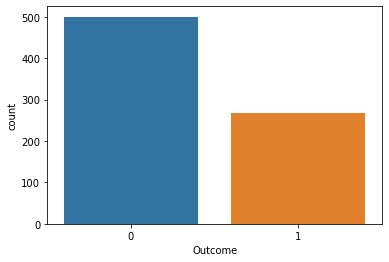

In [90]:
sns.countplot(x = data['Outcome'])

In [106]:
data['Outcome'].value_counts()

0    500
1    268
Name: Outcome, dtype: int64

In [107]:
data['Outcome'].value_counts(normalize = True)

0    0.651042
1    0.348958
Name: Outcome, dtype: float64

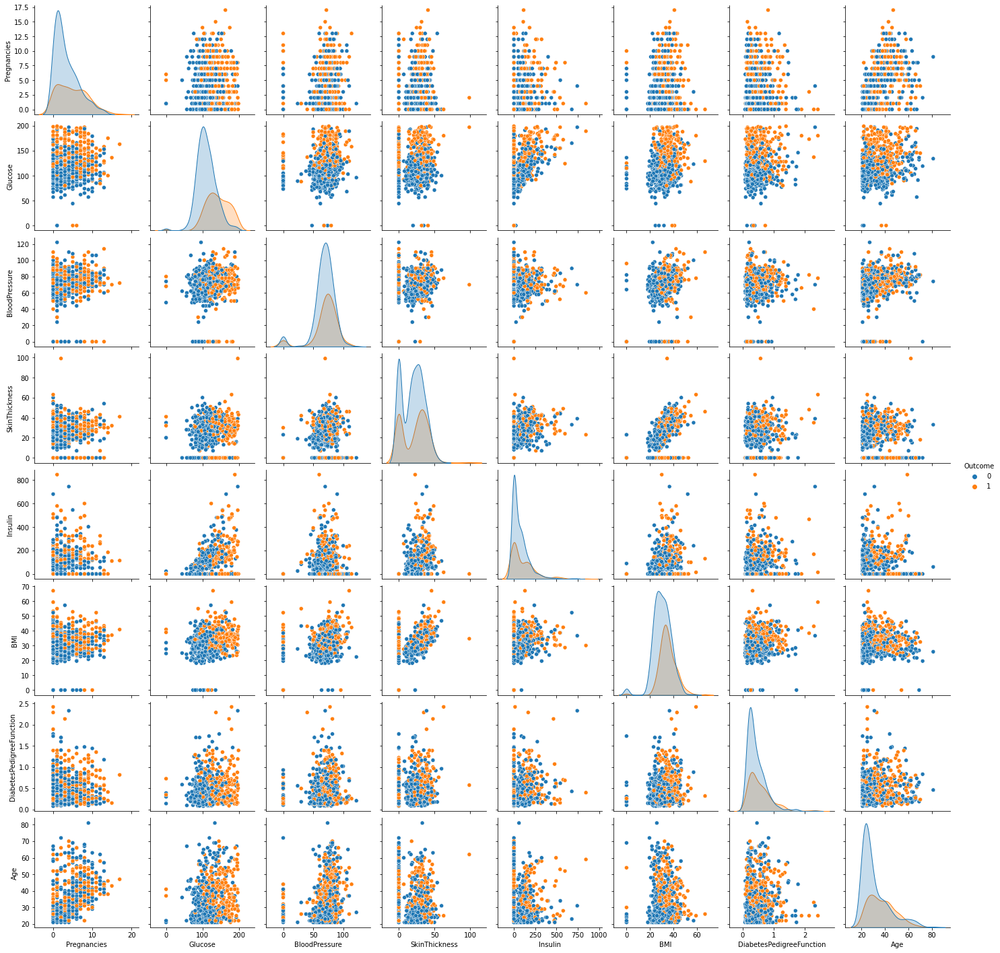

In [91]:
sns.pairplot(data, hue = 'Outcome')

In [92]:
feat_cols = data.columns.drop('Outcome')
feat_cols

Index(['Pregnancies', 'Glucose', 'BloodPressure', 'SkinThickness', 'Insulin',
       'BMI', 'DiabetesPedigreeFunction', 'Age'],
      dtype='object')

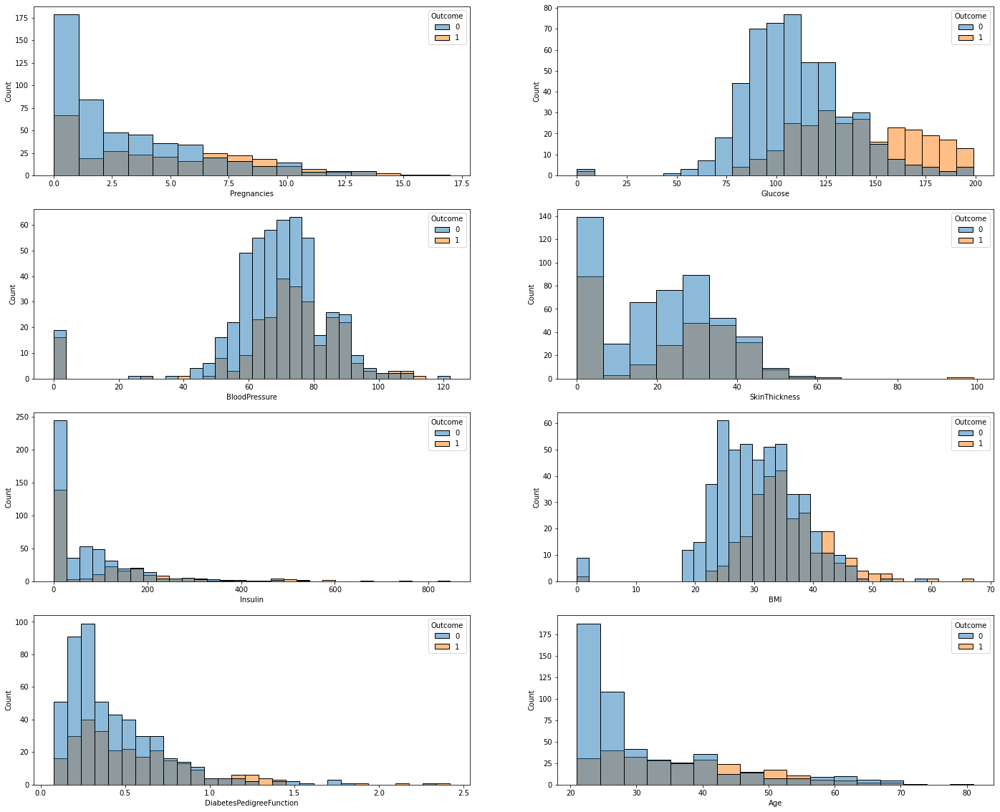

In [93]:
fig, axes = plt.subplots(4, 2, figsize=(24, 20))

for idx, feat in enumerate([*feat_cols]):
    row = math.floor(idx/2)
    col = idx - math.floor(idx/2)*2
    sns.histplot(x = data[feat], hue = data['Outcome'], ax = axes[row, col])

## 3. DATA SCALING

In [94]:
from sklearn.preprocessing import MinMaxScaler

mm_scaler = MinMaxScaler()
data[feat_cols] = mm_scaler.fit_transform(data[feat_cols])

In [95]:
data.describe()

,Pregnancies,Glucose,BloodPressure,SkinThickness,Insulin,BMI,DiabetesPedigreeFunction,Age,Outcome
count,768.000000,768.000000,768.000000,768.000000,768.000000,768.000000,768.000000,768.000000,768.000000
mean,0.226180,0.607510,0.566438,0.207439,0.094326,0.476790,0.168179,0.204015,0.348958
std,0.198210,0.160666,0.158654,0.161134,0.136222,0.117499,0.141473,0.196004,0.476951
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.058824,0.497487,0.508197,0.000000,0.000000,0.406855,0.070773,0.050000,0.000000
50%,0.176471,0.587940,0.590164,0.232323,0.036052,0.476900,0.125747,0.133333,0.000000
75%,0.352941,0.704774,0.655738,0.323232,0.150414,0.545455,0.234095,0.333333,1.000000
max,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000


## 4. TRAIN, TEST SPLIT

In [99]:
from sklearn.model_selection import train_test_split

X = data.drop('Outcome', axis = 1)
y = data['Outcome']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.25, random_state = 42, stratify = y)

In [104]:
X_train.shape, y_train.shape

((576, 8), (576,))

In [105]:
X_test.shape, y_test.shape

((192, 8), (192,))

In [101]:
pd.DataFrame(y_train).value_counts(normalize = True)

Outcome
0          0.651042
1          0.348958
dtype: float64

In [102]:
pd.DataFrame(y_test).value_counts(normalize = True)

Outcome
0          0.651042
1          0.348958
dtype: float64

## 5. MODEL TRAINING

In [208]:
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense
from tensorflow.keras.optimizers import Adam, SGD, RMSprop

In [209]:
n_model = 4
n_epoch = 10000

### 5.1. OPTIMIZER = SGD

In [231]:
model_SGD = []
run_hist_SGD = []

for i in range(0, n_model):
    # initialize the model
    model_SGD.append(Sequential())
    
    # add hidden layer
    for j in range(0, i + 1):
        model_SGD[i].add(Dense(12,input_shape = (8,),activation = 'sigmoid'))
    
    # add output layer
    model_SGD[i].add(Dense(1,activation='sigmoid'))
    
    model_SGD[i].compile(SGD(lr = .003), "binary_crossentropy", metrics = ["accuracy"])
    run_hist_SGD.append(model_SGD[i].fit(X_train, y_train, validation_data = (X_test, y_test), epochs = n_epoch))

Train on 576 samples, validate on 192 samples
Epoch 1/10000
576/576 [==============================] - 0s 490us/sample - loss: 0.9372 - accuracy: 0.3490 - val_loss: 0.9215 - val_accuracy: 0.3490
Epoch 2/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.9074 - accuracy: 0.3490 - val_loss: 0.8932 - val_accuracy: 0.3490
Epoch 3/10000
576/576 [==============================] - 0s 68us/sample - loss: 0.8805 - accuracy: 0.3490 - val_loss: 0.8677 - val_accuracy: 0.3490
Epoch 4/10000
576/576 [==============================] - 0s 69us/sample - loss: 0.8561 - accuracy: 0.3490 - val_loss: 0.8446 - val_accuracy: 0.3490
Epoch 5/10000
576/576 [==============================] - 0s 62us/sample - loss: 0.8342 - accuracy: 0.3490 - val_loss: 0.8239 - val_accuracy: 0.3490
Epoch 6/10000
576/576 [==============================] - 0s 68us/sample - loss: 0.8145 - accuracy: 0.3490 - val_loss: 0.8053 - val_accuracy: 0.3490
Epoch 7/10000
576/576 [==============================] - 0s 62us/

Epoch 56/10000
576/576 [==============================] - 0s 56us/sample - loss: 0.6492 - accuracy: 0.6510 - val_loss: 0.6493 - val_accuracy: 0.6510
Epoch 57/10000
576/576 [==============================] - 0s 56us/sample - loss: 0.6491 - accuracy: 0.6510 - val_loss: 0.6493 - val_accuracy: 0.6510
Epoch 58/10000
576/576 [==============================] - 0s 56us/sample - loss: 0.6490 - accuracy: 0.6510 - val_loss: 0.6492 - val_accuracy: 0.6510
Epoch 59/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.6490 - accuracy: 0.6510 - val_loss: 0.6491 - val_accuracy: 0.6510
Epoch 60/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.6489 - accuracy: 0.6510 - val_loss: 0.6490 - val_accuracy: 0.6510
Epoch 61/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.6488 - accuracy: 0.6510 - val_loss: 0.6490 - val_accuracy: 0.6510
Epoch 62/10000
576/576 [==============================] - 0s 52us/sample - loss: 0.6487 - accuracy: 0.6510

Epoch 165/10000
576/576 [==============================] - 0s 66us/sample - loss: 0.6461 - accuracy: 0.6510 - val_loss: 0.6463 - val_accuracy: 0.6510
Epoch 166/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.6460 - accuracy: 0.6510 - val_loss: 0.6463 - val_accuracy: 0.6510
Epoch 167/10000
576/576 [==============================] - 0s 66us/sample - loss: 0.6460 - accuracy: 0.6510 - val_loss: 0.6462 - val_accuracy: 0.6510
Epoch 168/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.6460 - accuracy: 0.6510 - val_loss: 0.6462 - val_accuracy: 0.6510
Epoch 169/10000
576/576 [==============================] - 0s 52us/sample - loss: 0.6460 - accuracy: 0.6510 - val_loss: 0.6462 - val_accuracy: 0.6510
Epoch 170/10000
576/576 [==============================] - 0s 54us/sample - loss: 0.6459 - accuracy: 0.6510 - val_loss: 0.6462 - val_accuracy: 0.6510
Epoch 171/10000
576/576 [==============================] - 0s 54us/sample - loss: 0.6459 - accuracy:

Epoch 274/10000
576/576 [==============================] - 0s 52us/sample - loss: 0.6436 - accuracy: 0.6510 - val_loss: 0.6439 - val_accuracy: 0.6510
Epoch 275/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.6436 - accuracy: 0.6510 - val_loss: 0.6439 - val_accuracy: 0.6510
Epoch 276/10000
576/576 [==============================] - 0s 49us/sample - loss: 0.6436 - accuracy: 0.6510 - val_loss: 0.6439 - val_accuracy: 0.6510
Epoch 277/10000
576/576 [==============================] - 0s 50us/sample - loss: 0.6436 - accuracy: 0.6510 - val_loss: 0.6438 - val_accuracy: 0.6510
Epoch 278/10000
576/576 [==============================] - 0s 52us/sample - loss: 0.6435 - accuracy: 0.6510 - val_loss: 0.6438 - val_accuracy: 0.6510
Epoch 279/10000
576/576 [==============================] - 0s 52us/sample - loss: 0.6435 - accuracy: 0.6510 - val_loss: 0.6438 - val_accuracy: 0.6510
Epoch 280/10000
576/576 [==============================] - 0s 54us/sample - loss: 0.6435 - accuracy:

Epoch 383/10000
576/576 [==============================] - 0s 49us/sample - loss: 0.6412 - accuracy: 0.6510 - val_loss: 0.6415 - val_accuracy: 0.6510
Epoch 384/10000
576/576 [==============================] - 0s 52us/sample - loss: 0.6412 - accuracy: 0.6510 - val_loss: 0.6415 - val_accuracy: 0.6510
Epoch 385/10000
576/576 [==============================] - 0s 50us/sample - loss: 0.6411 - accuracy: 0.6510 - val_loss: 0.6415 - val_accuracy: 0.6510
Epoch 386/10000
576/576 [==============================] - 0s 52us/sample - loss: 0.6411 - accuracy: 0.6510 - val_loss: 0.6415 - val_accuracy: 0.6510
Epoch 387/10000
576/576 [==============================] - 0s 50us/sample - loss: 0.6411 - accuracy: 0.6510 - val_loss: 0.6415 - val_accuracy: 0.6510
Epoch 388/10000
576/576 [==============================] - 0s 50us/sample - loss: 0.6411 - accuracy: 0.6510 - val_loss: 0.6414 - val_accuracy: 0.6510
Epoch 389/10000
576/576 [==============================] - 0s 52us/sample - loss: 0.6411 - accuracy:

576/576 [==============================] - 0s 54us/sample - loss: 0.6388 - accuracy: 0.6510 - val_loss: 0.6392 - val_accuracy: 0.6510
Epoch 492/10000
576/576 [==============================] - 0s 54us/sample - loss: 0.6387 - accuracy: 0.6510 - val_loss: 0.6391 - val_accuracy: 0.6510
Epoch 493/10000
576/576 [==============================] - 0s 50us/sample - loss: 0.6387 - accuracy: 0.6510 - val_loss: 0.6391 - val_accuracy: 0.6510
Epoch 494/10000
576/576 [==============================] - 0s 52us/sample - loss: 0.6387 - accuracy: 0.6510 - val_loss: 0.6391 - val_accuracy: 0.6510
Epoch 495/10000
576/576 [==============================] - 0s 52us/sample - loss: 0.6387 - accuracy: 0.6510 - val_loss: 0.6391 - val_accuracy: 0.6510
Epoch 496/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.6387 - accuracy: 0.6510 - val_loss: 0.6390 - val_accuracy: 0.6510
Epoch 497/10000
576/576 [==============================] - 0s 56us/sample - loss: 0.6386 - accuracy: 0.6510 - val_lo

576/576 [==============================] - 0s 54us/sample - loss: 0.6362 - accuracy: 0.6510 - val_loss: 0.6367 - val_accuracy: 0.6510
Epoch 600/10000
576/576 [==============================] - 0s 50us/sample - loss: 0.6362 - accuracy: 0.6510 - val_loss: 0.6367 - val_accuracy: 0.6510
Epoch 601/10000
576/576 [==============================] - 0s 50us/sample - loss: 0.6362 - accuracy: 0.6510 - val_loss: 0.6367 - val_accuracy: 0.6510
Epoch 602/10000
576/576 [==============================] - 0s 71us/sample - loss: 0.6362 - accuracy: 0.6510 - val_loss: 0.6366 - val_accuracy: 0.6510
Epoch 603/10000
576/576 [==============================] - 0s 85us/sample - loss: 0.6361 - accuracy: 0.6510 - val_loss: 0.6366 - val_accuracy: 0.6510
Epoch 604/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.6361 - accuracy: 0.6510 - val_loss: 0.6366 - val_accuracy: 0.6510
Epoch 605/10000
576/576 [==============================] - 0s 66us/sample - loss: 0.6361 - accuracy: 0.6510 - val_lo

576/576 [==============================] - 0s 52us/sample - loss: 0.6336 - accuracy: 0.6510 - val_loss: 0.6342 - val_accuracy: 0.6510
Epoch 708/10000
576/576 [==============================] - 0s 54us/sample - loss: 0.6336 - accuracy: 0.6510 - val_loss: 0.6342 - val_accuracy: 0.6510
Epoch 709/10000
576/576 [==============================] - 0s 50us/sample - loss: 0.6336 - accuracy: 0.6510 - val_loss: 0.6341 - val_accuracy: 0.6510
Epoch 710/10000
576/576 [==============================] - 0s 50us/sample - loss: 0.6336 - accuracy: 0.6510 - val_loss: 0.6341 - val_accuracy: 0.6510
Epoch 711/10000
576/576 [==============================] - 0s 54us/sample - loss: 0.6335 - accuracy: 0.6510 - val_loss: 0.6341 - val_accuracy: 0.6510
Epoch 712/10000
576/576 [==============================] - 0s 52us/sample - loss: 0.6335 - accuracy: 0.6510 - val_loss: 0.6341 - val_accuracy: 0.6510
Epoch 713/10000
576/576 [==============================] - 0s 52us/sample - loss: 0.6335 - accuracy: 0.6510 - val_lo

Epoch 762/10000
576/576 [==============================] - 0s 54us/sample - loss: 0.6323 - accuracy: 0.6510 - val_loss: 0.6328 - val_accuracy: 0.6510
Epoch 763/10000
576/576 [==============================] - 0s 50us/sample - loss: 0.6322 - accuracy: 0.6510 - val_loss: 0.6328 - val_accuracy: 0.6510
Epoch 764/10000
576/576 [==============================] - 0s 50us/sample - loss: 0.6322 - accuracy: 0.6510 - val_loss: 0.6328 - val_accuracy: 0.6510
Epoch 765/10000
576/576 [==============================] - 0s 52us/sample - loss: 0.6322 - accuracy: 0.6510 - val_loss: 0.6328 - val_accuracy: 0.6510
Epoch 766/10000
576/576 [==============================] - 0s 52us/sample - loss: 0.6322 - accuracy: 0.6510 - val_loss: 0.6328 - val_accuracy: 0.6510
Epoch 767/10000
576/576 [==============================] - 0s 52us/sample - loss: 0.6321 - accuracy: 0.6510 - val_loss: 0.6327 - val_accuracy: 0.6510
Epoch 768/10000
576/576 [==============================] - 0s 52us/sample - loss: 0.6321 - accuracy:

Epoch 871/10000
576/576 [==============================] - 0s 52us/sample - loss: 0.6295 - accuracy: 0.6510 - val_loss: 0.6301 - val_accuracy: 0.6510
Epoch 872/10000
576/576 [==============================] - 0s 52us/sample - loss: 0.6294 - accuracy: 0.6510 - val_loss: 0.6301 - val_accuracy: 0.6510
Epoch 873/10000
576/576 [==============================] - 0s 52us/sample - loss: 0.6294 - accuracy: 0.6510 - val_loss: 0.6301 - val_accuracy: 0.6510
Epoch 874/10000
576/576 [==============================] - 0s 50us/sample - loss: 0.6294 - accuracy: 0.6510 - val_loss: 0.6300 - val_accuracy: 0.6510
Epoch 875/10000
576/576 [==============================] - 0s 50us/sample - loss: 0.6294 - accuracy: 0.6510 - val_loss: 0.6300 - val_accuracy: 0.6510
Epoch 876/10000
576/576 [==============================] - 0s 52us/sample - loss: 0.6293 - accuracy: 0.6510 - val_loss: 0.6300 - val_accuracy: 0.6510
Epoch 877/10000
576/576 [==============================] - 0s 50us/sample - loss: 0.6293 - accuracy:

Epoch 980/10000
576/576 [==============================] - 0s 49us/sample - loss: 0.6265 - accuracy: 0.6510 - val_loss: 0.6272 - val_accuracy: 0.6510
Epoch 981/10000
576/576 [==============================] - 0s 50us/sample - loss: 0.6265 - accuracy: 0.6510 - val_loss: 0.6272 - val_accuracy: 0.6510
Epoch 982/10000
576/576 [==============================] - 0s 50us/sample - loss: 0.6265 - accuracy: 0.6510 - val_loss: 0.6272 - val_accuracy: 0.6510
Epoch 983/10000
576/576 [==============================] - 0s 50us/sample - loss: 0.6264 - accuracy: 0.6510 - val_loss: 0.6272 - val_accuracy: 0.6510
Epoch 984/10000
576/576 [==============================] - 0s 50us/sample - loss: 0.6264 - accuracy: 0.6510 - val_loss: 0.6271 - val_accuracy: 0.6510
Epoch 985/10000
576/576 [==============================] - 0s 52us/sample - loss: 0.6264 - accuracy: 0.6510 - val_loss: 0.6271 - val_accuracy: 0.6510
Epoch 986/10000
576/576 [==============================] - 0s 52us/sample - loss: 0.6263 - accuracy:

576/576 [==============================] - 0s 52us/sample - loss: 0.6250 - accuracy: 0.6510 - val_loss: 0.6258 - val_accuracy: 0.6510
Epoch 1035/10000
576/576 [==============================] - 0s 50us/sample - loss: 0.6250 - accuracy: 0.6510 - val_loss: 0.6257 - val_accuracy: 0.6510
Epoch 1036/10000
576/576 [==============================] - 0s 50us/sample - loss: 0.6249 - accuracy: 0.6510 - val_loss: 0.6257 - val_accuracy: 0.6510
Epoch 1037/10000
576/576 [==============================] - 0s 50us/sample - loss: 0.6249 - accuracy: 0.6510 - val_loss: 0.6257 - val_accuracy: 0.6510
Epoch 1038/10000
576/576 [==============================] - 0s 50us/sample - loss: 0.6249 - accuracy: 0.6510 - val_loss: 0.6257 - val_accuracy: 0.6510
Epoch 1039/10000
576/576 [==============================] - 0s 52us/sample - loss: 0.6248 - accuracy: 0.6510 - val_loss: 0.6256 - val_accuracy: 0.6510
Epoch 1040/10000
576/576 [==============================] - 0s 50us/sample - loss: 0.6248 - accuracy: 0.6510 - 

576/576 [==============================] - 0s 50us/sample - loss: 0.6218 - accuracy: 0.6510 - val_loss: 0.6227 - val_accuracy: 0.6510
Epoch 1143/10000
576/576 [==============================] - 0s 52us/sample - loss: 0.6218 - accuracy: 0.6510 - val_loss: 0.6227 - val_accuracy: 0.6510
Epoch 1144/10000
576/576 [==============================] - 0s 56us/sample - loss: 0.6218 - accuracy: 0.6510 - val_loss: 0.6226 - val_accuracy: 0.6510
Epoch 1145/10000
576/576 [==============================] - 0s 54us/sample - loss: 0.6218 - accuracy: 0.6510 - val_loss: 0.6226 - val_accuracy: 0.6510
Epoch 1146/10000
576/576 [==============================] - 0s 52us/sample - loss: 0.6217 - accuracy: 0.6510 - val_loss: 0.6226 - val_accuracy: 0.6510
Epoch 1147/10000
576/576 [==============================] - 0s 52us/sample - loss: 0.6217 - accuracy: 0.6510 - val_loss: 0.6225 - val_accuracy: 0.6510
Epoch 1148/10000
576/576 [==============================] - 0s 50us/sample - loss: 0.6217 - accuracy: 0.6510 - 

576/576 [==============================] - 0s 50us/sample - loss: 0.6202 - accuracy: 0.6510 - val_loss: 0.6211 - val_accuracy: 0.6510
Epoch 1197/10000
576/576 [==============================] - 0s 52us/sample - loss: 0.6202 - accuracy: 0.6510 - val_loss: 0.6211 - val_accuracy: 0.6510
Epoch 1198/10000
576/576 [==============================] - 0s 49us/sample - loss: 0.6201 - accuracy: 0.6510 - val_loss: 0.6210 - val_accuracy: 0.6510
Epoch 1199/10000
576/576 [==============================] - 0s 52us/sample - loss: 0.6201 - accuracy: 0.6510 - val_loss: 0.6210 - val_accuracy: 0.6510
Epoch 1200/10000
576/576 [==============================] - 0s 52us/sample - loss: 0.6201 - accuracy: 0.6510 - val_loss: 0.6210 - val_accuracy: 0.6510
Epoch 1201/10000
576/576 [==============================] - 0s 50us/sample - loss: 0.6201 - accuracy: 0.6510 - val_loss: 0.6209 - val_accuracy: 0.6510
Epoch 1202/10000
576/576 [==============================] - 0s 52us/sample - loss: 0.6200 - accuracy: 0.6510 - 

576/576 [==============================] - 0s 50us/sample - loss: 0.6168 - accuracy: 0.6510 - val_loss: 0.6178 - val_accuracy: 0.6510
Epoch 1305/10000
576/576 [==============================] - 0s 50us/sample - loss: 0.6168 - accuracy: 0.6510 - val_loss: 0.6178 - val_accuracy: 0.6510
Epoch 1306/10000
576/576 [==============================] - 0s 52us/sample - loss: 0.6167 - accuracy: 0.6510 - val_loss: 0.6177 - val_accuracy: 0.6510
Epoch 1307/10000
576/576 [==============================] - 0s 49us/sample - loss: 0.6167 - accuracy: 0.6510 - val_loss: 0.6177 - val_accuracy: 0.6510
Epoch 1308/10000
576/576 [==============================] - 0s 52us/sample - loss: 0.6167 - accuracy: 0.6510 - val_loss: 0.6177 - val_accuracy: 0.6510
Epoch 1309/10000
576/576 [==============================] - 0s 50us/sample - loss: 0.6167 - accuracy: 0.6510 - val_loss: 0.6176 - val_accuracy: 0.6510
Epoch 1310/10000
576/576 [==============================] - 0s 50us/sample - loss: 0.6167 - accuracy: 0.6510 - 

Epoch 1412/10000
576/576 [==============================] - 0s 52us/sample - loss: 0.6133 - accuracy: 0.6510 - val_loss: 0.6143 - val_accuracy: 0.6510
Epoch 1413/10000
576/576 [==============================] - 0s 50us/sample - loss: 0.6132 - accuracy: 0.6510 - val_loss: 0.6143 - val_accuracy: 0.6510
Epoch 1414/10000
576/576 [==============================] - 0s 54us/sample - loss: 0.6132 - accuracy: 0.6510 - val_loss: 0.6143 - val_accuracy: 0.6510
Epoch 1415/10000
576/576 [==============================] - 0s 52us/sample - loss: 0.6132 - accuracy: 0.6510 - val_loss: 0.6142 - val_accuracy: 0.6510
Epoch 1416/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.6131 - accuracy: 0.6510 - val_loss: 0.6142 - val_accuracy: 0.6510
Epoch 1417/10000
576/576 [==============================] - 0s 54us/sample - loss: 0.6131 - accuracy: 0.6510 - val_loss: 0.6142 - val_accuracy: 0.6510
Epoch 1418/10000
576/576 [==============================] - 0s 50us/sample - loss: 0.6130 - ac

576/576 [==============================] - 0s 52us/sample - loss: 0.6095 - accuracy: 0.6510 - val_loss: 0.6107 - val_accuracy: 0.6510
Epoch 1521/10000
576/576 [==============================] - 0s 50us/sample - loss: 0.6095 - accuracy: 0.6510 - val_loss: 0.6107 - val_accuracy: 0.6510
Epoch 1522/10000
576/576 [==============================] - 0s 50us/sample - loss: 0.6095 - accuracy: 0.6510 - val_loss: 0.6106 - val_accuracy: 0.6510
Epoch 1523/10000
576/576 [==============================] - 0s 50us/sample - loss: 0.6094 - accuracy: 0.6510 - val_loss: 0.6106 - val_accuracy: 0.6510
Epoch 1524/10000
576/576 [==============================] - 0s 52us/sample - loss: 0.6094 - accuracy: 0.6510 - val_loss: 0.6106 - val_accuracy: 0.6510
Epoch 1525/10000
576/576 [==============================] - 0s 52us/sample - loss: 0.6094 - accuracy: 0.6510 - val_loss: 0.6105 - val_accuracy: 0.6510
Epoch 1526/10000
576/576 [==============================] - 0s 50us/sample - loss: 0.6093 - accuracy: 0.6510 - 

576/576 [==============================] - 0s 47us/sample - loss: 0.6057 - accuracy: 0.6510 - val_loss: 0.6069 - val_accuracy: 0.6510
Epoch 1629/10000
576/576 [==============================] - 0s 52us/sample - loss: 0.6056 - accuracy: 0.6510 - val_loss: 0.6069 - val_accuracy: 0.6510
Epoch 1630/10000
576/576 [==============================] - 0s 50us/sample - loss: 0.6056 - accuracy: 0.6510 - val_loss: 0.6069 - val_accuracy: 0.6510
Epoch 1631/10000
576/576 [==============================] - 0s 50us/sample - loss: 0.6055 - accuracy: 0.6510 - val_loss: 0.6068 - val_accuracy: 0.6510
Epoch 1632/10000
576/576 [==============================] - 0s 54us/sample - loss: 0.6055 - accuracy: 0.6510 - val_loss: 0.6068 - val_accuracy: 0.6510
Epoch 1633/10000
576/576 [==============================] - 0s 50us/sample - loss: 0.6055 - accuracy: 0.6510 - val_loss: 0.6067 - val_accuracy: 0.6510
Epoch 1634/10000
576/576 [==============================] - 0s 52us/sample - loss: 0.6054 - accuracy: 0.6510 - 

576/576 [==============================] - 0s 54us/sample - loss: 0.6037 - accuracy: 0.6510 - val_loss: 0.6050 - val_accuracy: 0.6510
Epoch 1683/10000
576/576 [==============================] - 0s 50us/sample - loss: 0.6036 - accuracy: 0.6510 - val_loss: 0.6049 - val_accuracy: 0.6510
Epoch 1684/10000
576/576 [==============================] - 0s 50us/sample - loss: 0.6036 - accuracy: 0.6510 - val_loss: 0.6049 - val_accuracy: 0.6510
Epoch 1685/10000
576/576 [==============================] - 0s 52us/sample - loss: 0.6036 - accuracy: 0.6510 - val_loss: 0.6049 - val_accuracy: 0.6510
Epoch 1686/10000
576/576 [==============================] - 0s 52us/sample - loss: 0.6035 - accuracy: 0.6510 - val_loss: 0.6048 - val_accuracy: 0.6510
Epoch 1687/10000
576/576 [==============================] - 0s 50us/sample - loss: 0.6035 - accuracy: 0.6510 - val_loss: 0.6048 - val_accuracy: 0.6510
Epoch 1688/10000
576/576 [==============================] - 0s 52us/sample - loss: 0.6035 - accuracy: 0.6510 - 

576/576 [==============================] - 0s 49us/sample - loss: 0.5996 - accuracy: 0.6510 - val_loss: 0.6010 - val_accuracy: 0.6510
Epoch 1791/10000
576/576 [==============================] - 0s 50us/sample - loss: 0.5996 - accuracy: 0.6510 - val_loss: 0.6010 - val_accuracy: 0.6510
Epoch 1792/10000
576/576 [==============================] - 0s 52us/sample - loss: 0.5995 - accuracy: 0.6510 - val_loss: 0.6009 - val_accuracy: 0.6510
Epoch 1793/10000
576/576 [==============================] - 0s 50us/sample - loss: 0.5995 - accuracy: 0.6510 - val_loss: 0.6009 - val_accuracy: 0.6510
Epoch 1794/10000
576/576 [==============================] - 0s 54us/sample - loss: 0.5995 - accuracy: 0.6510 - val_loss: 0.6009 - val_accuracy: 0.6510
Epoch 1795/10000
576/576 [==============================] - 0s 52us/sample - loss: 0.5995 - accuracy: 0.6510 - val_loss: 0.6008 - val_accuracy: 0.6510
Epoch 1796/10000
576/576 [==============================] - 0s 56us/sample - loss: 0.5994 - accuracy: 0.6510 - 

576/576 [==============================] - 0s 50us/sample - loss: 0.5975 - accuracy: 0.6510 - val_loss: 0.5990 - val_accuracy: 0.6510
Epoch 1845/10000
576/576 [==============================] - 0s 50us/sample - loss: 0.5975 - accuracy: 0.6510 - val_loss: 0.5990 - val_accuracy: 0.6510
Epoch 1846/10000
576/576 [==============================] - 0s 54us/sample - loss: 0.5975 - accuracy: 0.6510 - val_loss: 0.5989 - val_accuracy: 0.6510
Epoch 1847/10000
576/576 [==============================] - 0s 50us/sample - loss: 0.5974 - accuracy: 0.6510 - val_loss: 0.5989 - val_accuracy: 0.6510
Epoch 1848/10000
576/576 [==============================] - 0s 50us/sample - loss: 0.5974 - accuracy: 0.6528 - val_loss: 0.5988 - val_accuracy: 0.6510
Epoch 1849/10000
576/576 [==============================] - 0s 52us/sample - loss: 0.5973 - accuracy: 0.6528 - val_loss: 0.5988 - val_accuracy: 0.6510
Epoch 1850/10000
576/576 [==============================] - 0s 50us/sample - loss: 0.5973 - accuracy: 0.6528 - 

576/576 [==============================] - 0s 49us/sample - loss: 0.5933 - accuracy: 0.6562 - val_loss: 0.5949 - val_accuracy: 0.6458
Epoch 1953/10000
576/576 [==============================] - 0s 56us/sample - loss: 0.5933 - accuracy: 0.6562 - val_loss: 0.5948 - val_accuracy: 0.6458
Epoch 1954/10000
576/576 [==============================] - 0s 50us/sample - loss: 0.5932 - accuracy: 0.6562 - val_loss: 0.5948 - val_accuracy: 0.6458
Epoch 1955/10000
576/576 [==============================] - 0s 54us/sample - loss: 0.5932 - accuracy: 0.6562 - val_loss: 0.5948 - val_accuracy: 0.6458
Epoch 1956/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.5932 - accuracy: 0.6562 - val_loss: 0.5947 - val_accuracy: 0.6458
Epoch 1957/10000
576/576 [==============================] - 0s 83us/sample - loss: 0.5931 - accuracy: 0.6562 - val_loss: 0.5947 - val_accuracy: 0.6458
Epoch 1958/10000
576/576 [==============================] - 0s 75us/sample - loss: 0.5931 - accuracy: 0.6562 - 

576/576 [==============================] - 0s 49us/sample - loss: 0.5890 - accuracy: 0.6632 - val_loss: 0.5907 - val_accuracy: 0.6458
Epoch 2061/10000
576/576 [==============================] - 0s 50us/sample - loss: 0.5890 - accuracy: 0.6615 - val_loss: 0.5906 - val_accuracy: 0.6458
Epoch 2062/10000
576/576 [==============================] - 0s 52us/sample - loss: 0.5889 - accuracy: 0.6632 - val_loss: 0.5906 - val_accuracy: 0.6458
Epoch 2063/10000
576/576 [==============================] - 0s 50us/sample - loss: 0.5889 - accuracy: 0.6632 - val_loss: 0.5906 - val_accuracy: 0.6458
Epoch 2064/10000
576/576 [==============================] - 0s 50us/sample - loss: 0.5888 - accuracy: 0.6632 - val_loss: 0.5905 - val_accuracy: 0.6458
Epoch 2065/10000
576/576 [==============================] - 0s 49us/sample - loss: 0.5888 - accuracy: 0.6632 - val_loss: 0.5905 - val_accuracy: 0.6458
Epoch 2066/10000
576/576 [==============================] - 0s 49us/sample - loss: 0.5888 - accuracy: 0.6649 - 

576/576 [==============================] - 0s 50us/sample - loss: 0.5868 - accuracy: 0.6649 - val_loss: 0.5885 - val_accuracy: 0.6458
Epoch 2115/10000
576/576 [==============================] - 0s 52us/sample - loss: 0.5868 - accuracy: 0.6649 - val_loss: 0.5885 - val_accuracy: 0.6510
Epoch 2116/10000
576/576 [==============================] - 0s 52us/sample - loss: 0.5867 - accuracy: 0.6649 - val_loss: 0.5885 - val_accuracy: 0.6510
Epoch 2117/10000
576/576 [==============================] - 0s 50us/sample - loss: 0.5867 - accuracy: 0.6649 - val_loss: 0.5884 - val_accuracy: 0.6510
Epoch 2118/10000
576/576 [==============================] - 0s 52us/sample - loss: 0.5867 - accuracy: 0.6649 - val_loss: 0.5884 - val_accuracy: 0.6510
Epoch 2119/10000
576/576 [==============================] - 0s 50us/sample - loss: 0.5866 - accuracy: 0.6649 - val_loss: 0.5884 - val_accuracy: 0.6510
Epoch 2120/10000
576/576 [==============================] - 0s 50us/sample - loss: 0.5866 - accuracy: 0.6649 - 

Epoch 2168/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.5846 - accuracy: 0.6649 - val_loss: 0.5864 - val_accuracy: 0.6510
Epoch 2169/10000
576/576 [==============================] - 0s 56us/sample - loss: 0.5846 - accuracy: 0.6649 - val_loss: 0.5864 - val_accuracy: 0.6510
Epoch 2170/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.5846 - accuracy: 0.6649 - val_loss: 0.5863 - val_accuracy: 0.6510
Epoch 2171/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.5845 - accuracy: 0.6667 - val_loss: 0.5863 - val_accuracy: 0.6510
Epoch 2172/10000
576/576 [==============================] - 0s 80us/sample - loss: 0.5845 - accuracy: 0.6649 - val_loss: 0.5863 - val_accuracy: 0.6510
Epoch 2173/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.5844 - accuracy: 0.6649 - val_loss: 0.5862 - val_accuracy: 0.6510
Epoch 2174/10000
576/576 [==============================] - 0s 56us/sample - loss: 0.5844 - ac

576/576 [==============================] - 0s 66us/sample - loss: 0.5802 - accuracy: 0.6753 - val_loss: 0.5821 - val_accuracy: 0.6562
Epoch 2277/10000
576/576 [==============================] - 0s 54us/sample - loss: 0.5802 - accuracy: 0.6753 - val_loss: 0.5821 - val_accuracy: 0.6562
Epoch 2278/10000
576/576 [==============================] - 0s 52us/sample - loss: 0.5802 - accuracy: 0.6753 - val_loss: 0.5820 - val_accuracy: 0.6562
Epoch 2279/10000
576/576 [==============================] - 0s 54us/sample - loss: 0.5801 - accuracy: 0.6753 - val_loss: 0.5820 - val_accuracy: 0.6562
Epoch 2280/10000
576/576 [==============================] - 0s 54us/sample - loss: 0.5801 - accuracy: 0.6736 - val_loss: 0.5820 - val_accuracy: 0.6562
Epoch 2281/10000
576/576 [==============================] - 0s 49us/sample - loss: 0.5801 - accuracy: 0.6771 - val_loss: 0.5819 - val_accuracy: 0.6615
Epoch 2282/10000
576/576 [==============================] - 0s 49us/sample - loss: 0.5800 - accuracy: 0.6753 - 

576/576 [==============================] - 0s 47us/sample - loss: 0.5758 - accuracy: 0.6788 - val_loss: 0.5778 - val_accuracy: 0.6719
Epoch 2385/10000
576/576 [==============================] - 0s 50us/sample - loss: 0.5758 - accuracy: 0.6788 - val_loss: 0.5778 - val_accuracy: 0.6719
Epoch 2386/10000
576/576 [==============================] - 0s 52us/sample - loss: 0.5758 - accuracy: 0.6788 - val_loss: 0.5777 - val_accuracy: 0.6719
Epoch 2387/10000
576/576 [==============================] - 0s 50us/sample - loss: 0.5757 - accuracy: 0.6788 - val_loss: 0.5777 - val_accuracy: 0.6719
Epoch 2388/10000
576/576 [==============================] - 0s 52us/sample - loss: 0.5757 - accuracy: 0.6788 - val_loss: 0.5777 - val_accuracy: 0.6719
Epoch 2389/10000
576/576 [==============================] - 0s 50us/sample - loss: 0.5756 - accuracy: 0.6788 - val_loss: 0.5776 - val_accuracy: 0.6719
Epoch 2390/10000
576/576 [==============================] - 0s 50us/sample - loss: 0.5756 - accuracy: 0.6788 - 

Epoch 2492/10000
576/576 [==============================] - 0s 52us/sample - loss: 0.5714 - accuracy: 0.6806 - val_loss: 0.5735 - val_accuracy: 0.6823
Epoch 2493/10000
576/576 [==============================] - 0s 52us/sample - loss: 0.5714 - accuracy: 0.6823 - val_loss: 0.5735 - val_accuracy: 0.6823
Epoch 2494/10000
576/576 [==============================] - 0s 50us/sample - loss: 0.5714 - accuracy: 0.6806 - val_loss: 0.5734 - val_accuracy: 0.6823
Epoch 2495/10000
576/576 [==============================] - 0s 52us/sample - loss: 0.5713 - accuracy: 0.6806 - val_loss: 0.5734 - val_accuracy: 0.6823
Epoch 2496/10000
576/576 [==============================] - 0s 50us/sample - loss: 0.5713 - accuracy: 0.6806 - val_loss: 0.5734 - val_accuracy: 0.6823
Epoch 2497/10000
576/576 [==============================] - 0s 52us/sample - loss: 0.5712 - accuracy: 0.6806 - val_loss: 0.5733 - val_accuracy: 0.6823
Epoch 2498/10000
576/576 [==============================] - 0s 50us/sample - loss: 0.5712 - ac

576/576 [==============================] - 0s 50us/sample - loss: 0.5670 - accuracy: 0.6892 - val_loss: 0.5693 - val_accuracy: 0.6823
Epoch 2601/10000
576/576 [==============================] - 0s 49us/sample - loss: 0.5670 - accuracy: 0.6927 - val_loss: 0.5692 - val_accuracy: 0.6823
Epoch 2602/10000
576/576 [==============================] - 0s 52us/sample - loss: 0.5670 - accuracy: 0.6892 - val_loss: 0.5692 - val_accuracy: 0.6823
Epoch 2603/10000
576/576 [==============================] - 0s 52us/sample - loss: 0.5669 - accuracy: 0.6944 - val_loss: 0.5691 - val_accuracy: 0.6823
Epoch 2604/10000
576/576 [==============================] - 0s 52us/sample - loss: 0.5669 - accuracy: 0.6944 - val_loss: 0.5691 - val_accuracy: 0.6823
Epoch 2605/10000
576/576 [==============================] - 0s 50us/sample - loss: 0.5669 - accuracy: 0.6892 - val_loss: 0.5691 - val_accuracy: 0.6823
Epoch 2606/10000
576/576 [==============================] - 0s 54us/sample - loss: 0.5668 - accuracy: 0.6927 - 

576/576 [==============================] - 0s 49us/sample - loss: 0.5649 - accuracy: 0.6944 - val_loss: 0.5671 - val_accuracy: 0.6927
Epoch 2655/10000
576/576 [==============================] - 0s 52us/sample - loss: 0.5649 - accuracy: 0.6944 - val_loss: 0.5671 - val_accuracy: 0.6927
Epoch 2656/10000
576/576 [==============================] - 0s 52us/sample - loss: 0.5648 - accuracy: 0.6944 - val_loss: 0.5671 - val_accuracy: 0.6927
Epoch 2657/10000
576/576 [==============================] - 0s 52us/sample - loss: 0.5648 - accuracy: 0.6944 - val_loss: 0.5670 - val_accuracy: 0.6927
Epoch 2658/10000
576/576 [==============================] - 0s 50us/sample - loss: 0.5647 - accuracy: 0.6944 - val_loss: 0.5670 - val_accuracy: 0.6927
Epoch 2659/10000
576/576 [==============================] - 0s 50us/sample - loss: 0.5647 - accuracy: 0.6944 - val_loss: 0.5669 - val_accuracy: 0.6927
Epoch 2660/10000
576/576 [==============================] - 0s 50us/sample - loss: 0.5647 - accuracy: 0.6944 - 

576/576 [==============================] - 0s 52us/sample - loss: 0.5606 - accuracy: 0.6979 - val_loss: 0.5630 - val_accuracy: 0.6979
Epoch 2763/10000
576/576 [==============================] - 0s 52us/sample - loss: 0.5606 - accuracy: 0.6979 - val_loss: 0.5629 - val_accuracy: 0.6979
Epoch 2764/10000
576/576 [==============================] - 0s 52us/sample - loss: 0.5605 - accuracy: 0.6979 - val_loss: 0.5629 - val_accuracy: 0.6979
Epoch 2765/10000
576/576 [==============================] - 0s 50us/sample - loss: 0.5605 - accuracy: 0.6979 - val_loss: 0.5629 - val_accuracy: 0.6979
Epoch 2766/10000
576/576 [==============================] - 0s 51us/sample - loss: 0.5604 - accuracy: 0.6979 - val_loss: 0.5628 - val_accuracy: 0.6979
Epoch 2767/10000
576/576 [==============================] - 0s 50us/sample - loss: 0.5604 - accuracy: 0.6979 - val_loss: 0.5628 - val_accuracy: 0.6979
Epoch 2768/10000
576/576 [==============================] - 0s 52us/sample - loss: 0.5604 - accuracy: 0.6979 - 

576/576 [==============================] - 0s 50us/sample - loss: 0.5564 - accuracy: 0.7101 - val_loss: 0.5589 - val_accuracy: 0.7083
Epoch 2871/10000
576/576 [==============================] - 0s 52us/sample - loss: 0.5564 - accuracy: 0.7101 - val_loss: 0.5588 - val_accuracy: 0.7083
Epoch 2872/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.5563 - accuracy: 0.7101 - val_loss: 0.5588 - val_accuracy: 0.7083
Epoch 2873/10000
576/576 [==============================] - 0s 49us/sample - loss: 0.5563 - accuracy: 0.7101 - val_loss: 0.5588 - val_accuracy: 0.7083
Epoch 2874/10000
576/576 [==============================] - 0s 49us/sample - loss: 0.5563 - accuracy: 0.7101 - val_loss: 0.5587 - val_accuracy: 0.7083
Epoch 2875/10000
576/576 [==============================] - 0s 49us/sample - loss: 0.5562 - accuracy: 0.7101 - val_loss: 0.5587 - val_accuracy: 0.7083
Epoch 2876/10000
576/576 [==============================] - 0s 50us/sample - loss: 0.5562 - accuracy: 0.7101 - 

576/576 [==============================] - 0s 59us/sample - loss: 0.5523 - accuracy: 0.7101 - val_loss: 0.5549 - val_accuracy: 0.7031
Epoch 2979/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.5523 - accuracy: 0.7101 - val_loss: 0.5549 - val_accuracy: 0.7031
Epoch 2980/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.5523 - accuracy: 0.7118 - val_loss: 0.5548 - val_accuracy: 0.7031
Epoch 2981/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.5522 - accuracy: 0.7118 - val_loss: 0.5548 - val_accuracy: 0.7031
Epoch 2982/10000
576/576 [==============================] - 0s 56us/sample - loss: 0.5522 - accuracy: 0.7118 - val_loss: 0.5547 - val_accuracy: 0.7031
Epoch 2983/10000
576/576 [==============================] - 0s 55us/sample - loss: 0.5521 - accuracy: 0.7101 - val_loss: 0.5547 - val_accuracy: 0.7031
Epoch 2984/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.5521 - accuracy: 0.7101 - 

576/576 [==============================] - 0s 54us/sample - loss: 0.5503 - accuracy: 0.7188 - val_loss: 0.5529 - val_accuracy: 0.7083
Epoch 3033/10000
576/576 [==============================] - 0s 50us/sample - loss: 0.5503 - accuracy: 0.7188 - val_loss: 0.5529 - val_accuracy: 0.7083
Epoch 3034/10000
576/576 [==============================] - 0s 50us/sample - loss: 0.5503 - accuracy: 0.7188 - val_loss: 0.5529 - val_accuracy: 0.7083
Epoch 3035/10000
576/576 [==============================] - 0s 49us/sample - loss: 0.5502 - accuracy: 0.7188 - val_loss: 0.5528 - val_accuracy: 0.7083
Epoch 3036/10000
576/576 [==============================] - 0s 68us/sample - loss: 0.5502 - accuracy: 0.7188 - val_loss: 0.5528 - val_accuracy: 0.7083
Epoch 3037/10000
576/576 [==============================] - 0s 54us/sample - loss: 0.5502 - accuracy: 0.7188 - val_loss: 0.5528 - val_accuracy: 0.7083
Epoch 3038/10000
576/576 [==============================] - 0s 49us/sample - loss: 0.5501 - accuracy: 0.7188 - 

576/576 [==============================] - 0s 57us/sample - loss: 0.5464 - accuracy: 0.7274 - val_loss: 0.5491 - val_accuracy: 0.7135
Epoch 3141/10000
576/576 [==============================] - 0s 69us/sample - loss: 0.5464 - accuracy: 0.7274 - val_loss: 0.5491 - val_accuracy: 0.7135
Epoch 3142/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.5463 - accuracy: 0.7292 - val_loss: 0.5491 - val_accuracy: 0.7135
Epoch 3143/10000
576/576 [==============================] - 0s 52us/sample - loss: 0.5463 - accuracy: 0.7292 - val_loss: 0.5490 - val_accuracy: 0.7135
Epoch 3144/10000
576/576 [==============================] - 0s 52us/sample - loss: 0.5463 - accuracy: 0.7292 - val_loss: 0.5490 - val_accuracy: 0.7135
Epoch 3145/10000
576/576 [==============================] - 0s 50us/sample - loss: 0.5462 - accuracy: 0.7292 - val_loss: 0.5490 - val_accuracy: 0.7135
Epoch 3146/10000
576/576 [==============================] - 0s 52us/sample - loss: 0.5462 - accuracy: 0.7292 - 

576/576 [==============================] - 0s 50us/sample - loss: 0.5426 - accuracy: 0.7361 - val_loss: 0.5454 - val_accuracy: 0.7188
Epoch 3249/10000
576/576 [==============================] - 0s 56us/sample - loss: 0.5426 - accuracy: 0.7378 - val_loss: 0.5454 - val_accuracy: 0.7188
Epoch 3250/10000
576/576 [==============================] - 0s 54us/sample - loss: 0.5425 - accuracy: 0.7361 - val_loss: 0.5454 - val_accuracy: 0.7188
Epoch 3251/10000
576/576 [==============================] - 0s 68us/sample - loss: 0.5425 - accuracy: 0.7378 - val_loss: 0.5453 - val_accuracy: 0.7188
Epoch 3252/10000
576/576 [==============================] - 0s 50us/sample - loss: 0.5425 - accuracy: 0.7361 - val_loss: 0.5453 - val_accuracy: 0.7188
Epoch 3253/10000
576/576 [==============================] - 0s 54us/sample - loss: 0.5424 - accuracy: 0.7378 - val_loss: 0.5453 - val_accuracy: 0.7188
Epoch 3254/10000
576/576 [==============================] - 0s 50us/sample - loss: 0.5424 - accuracy: 0.7378 - 

576/576 [==============================] - 0s 52us/sample - loss: 0.5390 - accuracy: 0.7361 - val_loss: 0.5419 - val_accuracy: 0.7344
Epoch 3357/10000
576/576 [==============================] - 0s 50us/sample - loss: 0.5389 - accuracy: 0.7361 - val_loss: 0.5419 - val_accuracy: 0.7344
Epoch 3358/10000
576/576 [==============================] - 0s 49us/sample - loss: 0.5389 - accuracy: 0.7361 - val_loss: 0.5418 - val_accuracy: 0.7344
Epoch 3359/10000
576/576 [==============================] - 0s 49us/sample - loss: 0.5388 - accuracy: 0.7361 - val_loss: 0.5418 - val_accuracy: 0.7344
Epoch 3360/10000
576/576 [==============================] - 0s 54us/sample - loss: 0.5388 - accuracy: 0.7361 - val_loss: 0.5418 - val_accuracy: 0.7344
Epoch 3361/10000
576/576 [==============================] - 0s 52us/sample - loss: 0.5388 - accuracy: 0.7361 - val_loss: 0.5417 - val_accuracy: 0.7344
Epoch 3362/10000
576/576 [==============================] - 0s 50us/sample - loss: 0.5388 - accuracy: 0.7361 - 

576/576 [==============================] - 0s 57us/sample - loss: 0.5355 - accuracy: 0.7361 - val_loss: 0.5385 - val_accuracy: 0.7292
Epoch 3465/10000
576/576 [==============================] - 0s 50us/sample - loss: 0.5354 - accuracy: 0.7413 - val_loss: 0.5385 - val_accuracy: 0.7292
Epoch 3466/10000
576/576 [==============================] - 0s 50us/sample - loss: 0.5354 - accuracy: 0.7396 - val_loss: 0.5384 - val_accuracy: 0.7292
Epoch 3467/10000
576/576 [==============================] - 0s 52us/sample - loss: 0.5354 - accuracy: 0.7396 - val_loss: 0.5384 - val_accuracy: 0.7292
Epoch 3468/10000
576/576 [==============================] - 0s 50us/sample - loss: 0.5354 - accuracy: 0.7413 - val_loss: 0.5384 - val_accuracy: 0.7292
Epoch 3469/10000
576/576 [==============================] - 0s 52us/sample - loss: 0.5353 - accuracy: 0.7396 - val_loss: 0.5383 - val_accuracy: 0.7292
Epoch 3470/10000
576/576 [==============================] - 0s 50us/sample - loss: 0.5353 - accuracy: 0.7413 - 

576/576 [==============================] - 0s 50us/sample - loss: 0.5321 - accuracy: 0.7344 - val_loss: 0.5352 - val_accuracy: 0.7188
Epoch 3573/10000
576/576 [==============================] - 0s 52us/sample - loss: 0.5321 - accuracy: 0.7361 - val_loss: 0.5352 - val_accuracy: 0.7188
Epoch 3574/10000
576/576 [==============================] - 0s 50us/sample - loss: 0.5320 - accuracy: 0.7361 - val_loss: 0.5352 - val_accuracy: 0.7188
Epoch 3575/10000
576/576 [==============================] - 0s 54us/sample - loss: 0.5320 - accuracy: 0.7361 - val_loss: 0.5351 - val_accuracy: 0.7188
Epoch 3576/10000
576/576 [==============================] - 0s 50us/sample - loss: 0.5320 - accuracy: 0.7378 - val_loss: 0.5351 - val_accuracy: 0.7188
Epoch 3577/10000
576/576 [==============================] - 0s 54us/sample - loss: 0.5320 - accuracy: 0.7378 - val_loss: 0.5351 - val_accuracy: 0.7188
Epoch 3578/10000
576/576 [==============================] - 0s 50us/sample - loss: 0.5319 - accuracy: 0.7378 - 

576/576 [==============================] - 0s 54us/sample - loss: 0.5288 - accuracy: 0.7326 - val_loss: 0.5321 - val_accuracy: 0.7188
Epoch 3681/10000
576/576 [==============================] - 0s 71us/sample - loss: 0.5288 - accuracy: 0.7326 - val_loss: 0.5321 - val_accuracy: 0.7188
Epoch 3682/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.5288 - accuracy: 0.7344 - val_loss: 0.5320 - val_accuracy: 0.7188
Epoch 3683/10000
576/576 [==============================] - 0s 58us/sample - loss: 0.5288 - accuracy: 0.7326 - val_loss: 0.5320 - val_accuracy: 0.7188
Epoch 3684/10000
576/576 [==============================] - 0s 56us/sample - loss: 0.5288 - accuracy: 0.7326 - val_loss: 0.5320 - val_accuracy: 0.7188
Epoch 3685/10000
576/576 [==============================] - 0s 50us/sample - loss: 0.5287 - accuracy: 0.7344 - val_loss: 0.5320 - val_accuracy: 0.7188
Epoch 3686/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.5287 - accuracy: 0.7344 - 

576/576 [==============================] - 0s 52us/sample - loss: 0.5258 - accuracy: 0.7361 - val_loss: 0.5291 - val_accuracy: 0.7188
Epoch 3789/10000
576/576 [==============================] - 0s 52us/sample - loss: 0.5258 - accuracy: 0.7361 - val_loss: 0.5291 - val_accuracy: 0.7188
Epoch 3790/10000
576/576 [==============================] - 0s 49us/sample - loss: 0.5258 - accuracy: 0.7361 - val_loss: 0.5291 - val_accuracy: 0.7188
Epoch 3791/10000
576/576 [==============================] - 0s 50us/sample - loss: 0.5258 - accuracy: 0.7378 - val_loss: 0.5291 - val_accuracy: 0.7188
Epoch 3792/10000
576/576 [==============================] - 0s 50us/sample - loss: 0.5257 - accuracy: 0.7361 - val_loss: 0.5290 - val_accuracy: 0.7188
Epoch 3793/10000
576/576 [==============================] - 0s 54us/sample - loss: 0.5256 - accuracy: 0.7361 - val_loss: 0.5290 - val_accuracy: 0.7188
Epoch 3794/10000
576/576 [==============================] - 0s 50us/sample - loss: 0.5257 - accuracy: 0.7361 - 

576/576 [==============================] - 0s 102us/sample - loss: 0.5229 - accuracy: 0.7431 - val_loss: 0.5263 - val_accuracy: 0.7188
Epoch 3897/10000
576/576 [==============================] - 0s 128us/sample - loss: 0.5229 - accuracy: 0.7431 - val_loss: 0.5263 - val_accuracy: 0.7188
Epoch 3898/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.5228 - accuracy: 0.7431 - val_loss: 0.5263 - val_accuracy: 0.7188
Epoch 3899/10000
576/576 [==============================] - 0s 132us/sample - loss: 0.5228 - accuracy: 0.7431 - val_loss: 0.5262 - val_accuracy: 0.7188
Epoch 3900/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.5228 - accuracy: 0.7431 - val_loss: 0.5262 - val_accuracy: 0.7188
Epoch 3901/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.5227 - accuracy: 0.7396 - val_loss: 0.5262 - val_accuracy: 0.7188
Epoch 3902/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.5227 - accuracy: 0.

576/576 [==============================] - 0s 139us/sample - loss: 0.5215 - accuracy: 0.7431 - val_loss: 0.5249 - val_accuracy: 0.7240
Epoch 3951/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.5214 - accuracy: 0.7431 - val_loss: 0.5249 - val_accuracy: 0.7240
Epoch 3952/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.5214 - accuracy: 0.7431 - val_loss: 0.5249 - val_accuracy: 0.7240
Epoch 3953/10000
576/576 [==============================] - 0s 134us/sample - loss: 0.5214 - accuracy: 0.7431 - val_loss: 0.5249 - val_accuracy: 0.7240
Epoch 3954/10000
576/576 [==============================] - 0s 158us/sample - loss: 0.5214 - accuracy: 0.7431 - val_loss: 0.5248 - val_accuracy: 0.7240
Epoch 3955/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.5213 - accuracy: 0.7431 - val_loss: 0.5248 - val_accuracy: 0.7292
Epoch 3956/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.5213 - accuracy: 0.

576/576 [==============================] - 0s 101us/sample - loss: 0.5201 - accuracy: 0.7431 - val_loss: 0.5236 - val_accuracy: 0.7344
Epoch 4005/10000
576/576 [==============================] - 0s 101us/sample - loss: 0.5201 - accuracy: 0.7431 - val_loss: 0.5236 - val_accuracy: 0.7344
Epoch 4006/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.5200 - accuracy: 0.7431 - val_loss: 0.5236 - val_accuracy: 0.7344
Epoch 4007/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.5200 - accuracy: 0.7431 - val_loss: 0.5235 - val_accuracy: 0.7344
Epoch 4008/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.5200 - accuracy: 0.7431 - val_loss: 0.5235 - val_accuracy: 0.7344
Epoch 4009/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.5200 - accuracy: 0.7431 - val_loss: 0.5235 - val_accuracy: 0.7344
Epoch 4010/10000
576/576 [==============================] - 0s 128us/sample - loss: 0.5199 - accuracy: 0.

576/576 [==============================] - 0s 135us/sample - loss: 0.5188 - accuracy: 0.7431 - val_loss: 0.5223 - val_accuracy: 0.7344
Epoch 4059/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.5187 - accuracy: 0.7431 - val_loss: 0.5223 - val_accuracy: 0.7344
Epoch 4060/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.5187 - accuracy: 0.7431 - val_loss: 0.5223 - val_accuracy: 0.7344
Epoch 4061/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.5187 - accuracy: 0.7431 - val_loss: 0.5223 - val_accuracy: 0.7344
Epoch 4062/10000
576/576 [==============================] - 0s 101us/sample - loss: 0.5186 - accuracy: 0.7431 - val_loss: 0.5222 - val_accuracy: 0.7344
Epoch 4063/10000
576/576 [==============================] - 0s 102us/sample - loss: 0.5186 - accuracy: 0.7431 - val_loss: 0.5222 - val_accuracy: 0.7344
Epoch 4064/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.5186 - accuracy: 0.

576/576 [==============================] - 0s 106us/sample - loss: 0.5174 - accuracy: 0.7431 - val_loss: 0.5211 - val_accuracy: 0.7344
Epoch 4113/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.5174 - accuracy: 0.7431 - val_loss: 0.5210 - val_accuracy: 0.7344
Epoch 4114/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.5174 - accuracy: 0.7431 - val_loss: 0.5210 - val_accuracy: 0.7344
Epoch 4115/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.5174 - accuracy: 0.7431 - val_loss: 0.5210 - val_accuracy: 0.7344
Epoch 4116/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.5173 - accuracy: 0.7431 - val_loss: 0.5210 - val_accuracy: 0.7344
Epoch 4117/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.5173 - accuracy: 0.7431 - val_loss: 0.5210 - val_accuracy: 0.7344
Epoch 4118/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.5173 - accuracy: 0.

576/576 [==============================] - 0s 111us/sample - loss: 0.5161 - accuracy: 0.7431 - val_loss: 0.5198 - val_accuracy: 0.7344
Epoch 4167/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.5161 - accuracy: 0.7448 - val_loss: 0.5198 - val_accuracy: 0.7344
Epoch 4168/10000
576/576 [==============================] - 0s 102us/sample - loss: 0.5161 - accuracy: 0.7465 - val_loss: 0.5198 - val_accuracy: 0.7344
Epoch 4169/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.5161 - accuracy: 0.7431 - val_loss: 0.5198 - val_accuracy: 0.7344
Epoch 4170/10000
576/576 [==============================] - 0s 103us/sample - loss: 0.5161 - accuracy: 0.7465 - val_loss: 0.5198 - val_accuracy: 0.7344
Epoch 4171/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.5160 - accuracy: 0.7448 - val_loss: 0.5197 - val_accuracy: 0.7344
Epoch 4172/10000
576/576 [==============================] - 0s 101us/sample - loss: 0.5160 - accuracy: 0.

Epoch 4220/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.5149 - accuracy: 0.7465 - val_loss: 0.5187 - val_accuracy: 0.7344
Epoch 4221/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.5149 - accuracy: 0.7448 - val_loss: 0.5186 - val_accuracy: 0.7344
Epoch 4222/10000
576/576 [==============================] - 0s 101us/sample - loss: 0.5148 - accuracy: 0.7465 - val_loss: 0.5186 - val_accuracy: 0.7344
Epoch 4223/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.5148 - accuracy: 0.7465 - val_loss: 0.5186 - val_accuracy: 0.7344
Epoch 4224/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.5148 - accuracy: 0.7465 - val_loss: 0.5186 - val_accuracy: 0.7344
Epoch 4225/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.5148 - accuracy: 0.7465 - val_loss: 0.5185 - val_accuracy: 0.7344
Epoch 4226/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.51

Epoch 4274/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.5137 - accuracy: 0.7483 - val_loss: 0.5175 - val_accuracy: 0.7396
Epoch 4275/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.5136 - accuracy: 0.7483 - val_loss: 0.5175 - val_accuracy: 0.7396
Epoch 4276/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.5136 - accuracy: 0.7465 - val_loss: 0.5175 - val_accuracy: 0.7396
Epoch 4277/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.5136 - accuracy: 0.7465 - val_loss: 0.5174 - val_accuracy: 0.7396
Epoch 4278/10000
576/576 [==============================] - 0s 102us/sample - loss: 0.5136 - accuracy: 0.7483 - val_loss: 0.5174 - val_accuracy: 0.7396
Epoch 4279/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.5136 - accuracy: 0.7483 - val_loss: 0.5174 - val_accuracy: 0.7396
Epoch 4280/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.51

Epoch 4328/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.5125 - accuracy: 0.7483 - val_loss: 0.5164 - val_accuracy: 0.7396
Epoch 4329/10000
576/576 [==============================] - 0s 101us/sample - loss: 0.5125 - accuracy: 0.7483 - val_loss: 0.5163 - val_accuracy: 0.7396
Epoch 4330/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.5124 - accuracy: 0.7483 - val_loss: 0.5163 - val_accuracy: 0.7396
Epoch 4331/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.5125 - accuracy: 0.7483 - val_loss: 0.5163 - val_accuracy: 0.7396
Epoch 4332/10000
576/576 [==============================] - 0s 102us/sample - loss: 0.5124 - accuracy: 0.7483 - val_loss: 0.5163 - val_accuracy: 0.7396
Epoch 4333/10000
576/576 [==============================] - 0s 102us/sample - loss: 0.5124 - accuracy: 0.7483 - val_loss: 0.5163 - val_accuracy: 0.7396
Epoch 4334/10000
576/576 [==============================] - 0s 102us/sample - loss: 0.51

576/576 [==============================] - 0s 109us/sample - loss: 0.5103 - accuracy: 0.7500 - val_loss: 0.5142 - val_accuracy: 0.7344
Epoch 4436/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.5102 - accuracy: 0.7500 - val_loss: 0.5142 - val_accuracy: 0.7344
Epoch 4437/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.5102 - accuracy: 0.7500 - val_loss: 0.5142 - val_accuracy: 0.7344
Epoch 4438/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.5102 - accuracy: 0.7500 - val_loss: 0.5142 - val_accuracy: 0.7344
Epoch 4439/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.5101 - accuracy: 0.7500 - val_loss: 0.5141 - val_accuracy: 0.7344
Epoch 4440/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.5102 - accuracy: 0.7500 - val_loss: 0.5141 - val_accuracy: 0.7344
Epoch 4441/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.5101 - accuracy: 0.

576/576 [==============================] - 0s 125us/sample - loss: 0.5092 - accuracy: 0.7500 - val_loss: 0.5132 - val_accuracy: 0.7344
Epoch 4490/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.5091 - accuracy: 0.7500 - val_loss: 0.5132 - val_accuracy: 0.7344
Epoch 4491/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.5091 - accuracy: 0.7500 - val_loss: 0.5131 - val_accuracy: 0.7344
Epoch 4492/10000
576/576 [==============================] - 0s 141us/sample - loss: 0.5091 - accuracy: 0.7500 - val_loss: 0.5131 - val_accuracy: 0.7344
Epoch 4493/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.5091 - accuracy: 0.7500 - val_loss: 0.5131 - val_accuracy: 0.7344
Epoch 4494/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.5091 - accuracy: 0.7500 - val_loss: 0.5131 - val_accuracy: 0.7344
Epoch 4495/10000
576/576 [==============================] - 0s 105us/sample - loss: 0.5090 - accuracy: 0.

Epoch 4543/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.5081 - accuracy: 0.7535 - val_loss: 0.5122 - val_accuracy: 0.7344
Epoch 4544/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.5081 - accuracy: 0.7535 - val_loss: 0.5122 - val_accuracy: 0.7344
Epoch 4545/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.5081 - accuracy: 0.7535 - val_loss: 0.5121 - val_accuracy: 0.7344
Epoch 4546/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.5080 - accuracy: 0.7535 - val_loss: 0.5121 - val_accuracy: 0.7344
Epoch 4547/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.5080 - accuracy: 0.7535 - val_loss: 0.5121 - val_accuracy: 0.7344
Epoch 4548/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.5080 - accuracy: 0.7535 - val_loss: 0.5121 - val_accuracy: 0.7344
Epoch 4549/10000
576/576 [==============================] - 0s 103us/sample - loss: 0.50

Epoch 4597/10000
576/576 [==============================] - 0s 99us/sample - loss: 0.5070 - accuracy: 0.7535 - val_loss: 0.5112 - val_accuracy: 0.7396
Epoch 4598/10000
576/576 [==============================] - 0s 101us/sample - loss: 0.5070 - accuracy: 0.7535 - val_loss: 0.5112 - val_accuracy: 0.7396
Epoch 4599/10000
576/576 [==============================] - 0s 101us/sample - loss: 0.5070 - accuracy: 0.7552 - val_loss: 0.5112 - val_accuracy: 0.7396
Epoch 4600/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.5070 - accuracy: 0.7552 - val_loss: 0.5111 - val_accuracy: 0.7396
Epoch 4601/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.5070 - accuracy: 0.7552 - val_loss: 0.5111 - val_accuracy: 0.7396
Epoch 4602/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.5069 - accuracy: 0.7535 - val_loss: 0.5111 - val_accuracy: 0.7396
Epoch 4603/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.506

Epoch 4651/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.5060 - accuracy: 0.7552 - val_loss: 0.5102 - val_accuracy: 0.7396
Epoch 4652/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.5060 - accuracy: 0.7552 - val_loss: 0.5102 - val_accuracy: 0.7396
Epoch 4653/10000
576/576 [==============================] - 0s 148us/sample - loss: 0.5060 - accuracy: 0.7552 - val_loss: 0.5102 - val_accuracy: 0.7396
Epoch 4654/10000
576/576 [==============================] - 0s 134us/sample - loss: 0.5060 - accuracy: 0.7552 - val_loss: 0.5102 - val_accuracy: 0.7396
Epoch 4655/10000
576/576 [==============================] - 0s 134us/sample - loss: 0.5059 - accuracy: 0.7552 - val_loss: 0.5102 - val_accuracy: 0.7396
Epoch 4656/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.5059 - accuracy: 0.7552 - val_loss: 0.5102 - val_accuracy: 0.7396
Epoch 4657/10000
576/576 [==============================] - 0s 99us/sample - loss: 0.505

Epoch 4705/10000
576/576 [==============================] - 0s 103us/sample - loss: 0.5050 - accuracy: 0.7569 - val_loss: 0.5093 - val_accuracy: 0.7344
Epoch 4706/10000
576/576 [==============================] - 0s 101us/sample - loss: 0.5050 - accuracy: 0.7552 - val_loss: 0.5093 - val_accuracy: 0.7344
Epoch 4707/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.5050 - accuracy: 0.7552 - val_loss: 0.5093 - val_accuracy: 0.7344
Epoch 4708/10000
576/576 [==============================] - 0s 103us/sample - loss: 0.5050 - accuracy: 0.7552 - val_loss: 0.5093 - val_accuracy: 0.7344
Epoch 4709/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.5050 - accuracy: 0.7552 - val_loss: 0.5093 - val_accuracy: 0.7344
Epoch 4710/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.5049 - accuracy: 0.7552 - val_loss: 0.5092 - val_accuracy: 0.7344
Epoch 4711/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.50

Epoch 4759/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.5041 - accuracy: 0.7587 - val_loss: 0.5084 - val_accuracy: 0.7292
Epoch 4760/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.5041 - accuracy: 0.7604 - val_loss: 0.5084 - val_accuracy: 0.7292
Epoch 4761/10000
576/576 [==============================] - 0s 92us/sample - loss: 0.5040 - accuracy: 0.7587 - val_loss: 0.5084 - val_accuracy: 0.7292
Epoch 4762/10000
576/576 [==============================] - 0s 99us/sample - loss: 0.5040 - accuracy: 0.7587 - val_loss: 0.5084 - val_accuracy: 0.7292
Epoch 4763/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.5040 - accuracy: 0.7587 - val_loss: 0.5084 - val_accuracy: 0.7292
Epoch 4764/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.5040 - accuracy: 0.7587 - val_loss: 0.5083 - val_accuracy: 0.7292
Epoch 4765/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.5040

Epoch 4813/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.5031 - accuracy: 0.7622 - val_loss: 0.5075 - val_accuracy: 0.7292
Epoch 4814/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.5031 - accuracy: 0.7622 - val_loss: 0.5075 - val_accuracy: 0.7292
Epoch 4815/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.5031 - accuracy: 0.7604 - val_loss: 0.5075 - val_accuracy: 0.7292
Epoch 4816/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.5031 - accuracy: 0.7622 - val_loss: 0.5075 - val_accuracy: 0.7292
Epoch 4817/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.5031 - accuracy: 0.7604 - val_loss: 0.5075 - val_accuracy: 0.7292
Epoch 4818/10000
576/576 [==============================] - 0s 110us/sample - loss: 0.5031 - accuracy: 0.7604 - val_loss: 0.5075 - val_accuracy: 0.7292
Epoch 4819/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.50

Epoch 4867/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.5022 - accuracy: 0.7622 - val_loss: 0.5067 - val_accuracy: 0.7292
Epoch 4868/10000
576/576 [==============================] - 0s 102us/sample - loss: 0.5022 - accuracy: 0.7622 - val_loss: 0.5067 - val_accuracy: 0.7292
Epoch 4869/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.5022 - accuracy: 0.7622 - val_loss: 0.5067 - val_accuracy: 0.7292
Epoch 4870/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.5022 - accuracy: 0.7639 - val_loss: 0.5067 - val_accuracy: 0.7292
Epoch 4871/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.5022 - accuracy: 0.7639 - val_loss: 0.5066 - val_accuracy: 0.7292
Epoch 4872/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.5021 - accuracy: 0.7622 - val_loss: 0.5066 - val_accuracy: 0.7292
Epoch 4873/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.50

Epoch 4921/10000
576/576 [==============================] - 0s 101us/sample - loss: 0.5014 - accuracy: 0.7656 - val_loss: 0.5059 - val_accuracy: 0.7292
Epoch 4922/10000
576/576 [==============================] - 0s 119us/sample - loss: 0.5013 - accuracy: 0.7639 - val_loss: 0.5059 - val_accuracy: 0.7292
Epoch 4923/10000
576/576 [==============================] - 0s 112us/sample - loss: 0.5013 - accuracy: 0.7656 - val_loss: 0.5058 - val_accuracy: 0.7292
Epoch 4924/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.5013 - accuracy: 0.7639 - val_loss: 0.5058 - val_accuracy: 0.7292
Epoch 4925/10000
576/576 [==============================] - 0s 51us/sample - loss: 0.5013 - accuracy: 0.7639 - val_loss: 0.5058 - val_accuracy: 0.7292
Epoch 4926/10000
576/576 [==============================] - 0s 49us/sample - loss: 0.5013 - accuracy: 0.7639 - val_loss: 0.5058 - val_accuracy: 0.7292
Epoch 4927/10000
576/576 [==============================] - 0s 52us/sample - loss: 0.5013 -

576/576 [==============================] - 0s 54us/sample - loss: 0.4996 - accuracy: 0.7639 - val_loss: 0.5043 - val_accuracy: 0.7292
Epoch 5030/10000
576/576 [==============================] - 0s 51us/sample - loss: 0.4996 - accuracy: 0.7639 - val_loss: 0.5043 - val_accuracy: 0.7292
Epoch 5031/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.4996 - accuracy: 0.7639 - val_loss: 0.5043 - val_accuracy: 0.7292
Epoch 5032/10000
576/576 [==============================] - 0s 52us/sample - loss: 0.4996 - accuracy: 0.7639 - val_loss: 0.5043 - val_accuracy: 0.7292
Epoch 5033/10000
576/576 [==============================] - 0s 50us/sample - loss: 0.4996 - accuracy: 0.7639 - val_loss: 0.5042 - val_accuracy: 0.7292
Epoch 5034/10000
576/576 [==============================] - 0s 52us/sample - loss: 0.4996 - accuracy: 0.7639 - val_loss: 0.5042 - val_accuracy: 0.7292
Epoch 5035/10000
576/576 [==============================] - 0s 47us/sample - loss: 0.4995 - accuracy: 0.7639 - 

576/576 [==============================] - 0s 50us/sample - loss: 0.4981 - accuracy: 0.7656 - val_loss: 0.5028 - val_accuracy: 0.7292
Epoch 5138/10000
576/576 [==============================] - 0s 50us/sample - loss: 0.4981 - accuracy: 0.7656 - val_loss: 0.5028 - val_accuracy: 0.7292
Epoch 5139/10000
576/576 [==============================] - 0s 49us/sample - loss: 0.4980 - accuracy: 0.7656 - val_loss: 0.5028 - val_accuracy: 0.7292
Epoch 5140/10000
576/576 [==============================] - 0s 54us/sample - loss: 0.4980 - accuracy: 0.7656 - val_loss: 0.5028 - val_accuracy: 0.7292
Epoch 5141/10000
576/576 [==============================] - 0s 54us/sample - loss: 0.4980 - accuracy: 0.7656 - val_loss: 0.5028 - val_accuracy: 0.7292
Epoch 5142/10000
576/576 [==============================] - 0s 52us/sample - loss: 0.4980 - accuracy: 0.7656 - val_loss: 0.5027 - val_accuracy: 0.7292
Epoch 5143/10000
576/576 [==============================] - 0s 52us/sample - loss: 0.4979 - accuracy: 0.7656 - 

576/576 [==============================] - 0s 52us/sample - loss: 0.4965 - accuracy: 0.7656 - val_loss: 0.5014 - val_accuracy: 0.7292
Epoch 5246/10000
576/576 [==============================] - 0s 50us/sample - loss: 0.4965 - accuracy: 0.7639 - val_loss: 0.5014 - val_accuracy: 0.7292
Epoch 5247/10000
576/576 [==============================] - 0s 49us/sample - loss: 0.4965 - accuracy: 0.7656 - val_loss: 0.5014 - val_accuracy: 0.7292
Epoch 5248/10000
576/576 [==============================] - 0s 50us/sample - loss: 0.4965 - accuracy: 0.7656 - val_loss: 0.5014 - val_accuracy: 0.7292
Epoch 5249/10000
576/576 [==============================] - 0s 49us/sample - loss: 0.4965 - accuracy: 0.7656 - val_loss: 0.5014 - val_accuracy: 0.7292
Epoch 5250/10000
576/576 [==============================] - 0s 52us/sample - loss: 0.4965 - accuracy: 0.7656 - val_loss: 0.5013 - val_accuracy: 0.7292
Epoch 5251/10000
576/576 [==============================] - 0s 50us/sample - loss: 0.4964 - accuracy: 0.7674 - 

576/576 [==============================] - 0s 49us/sample - loss: 0.4950 - accuracy: 0.7674 - val_loss: 0.5001 - val_accuracy: 0.7292
Epoch 5354/10000
576/576 [==============================] - 0s 50us/sample - loss: 0.4951 - accuracy: 0.7691 - val_loss: 0.5001 - val_accuracy: 0.7292
Epoch 5355/10000
576/576 [==============================] - 0s 50us/sample - loss: 0.4950 - accuracy: 0.7691 - val_loss: 0.5001 - val_accuracy: 0.7292
Epoch 5356/10000
576/576 [==============================] - 0s 50us/sample - loss: 0.4950 - accuracy: 0.7691 - val_loss: 0.5000 - val_accuracy: 0.7292
Epoch 5357/10000
576/576 [==============================] - 0s 52us/sample - loss: 0.4950 - accuracy: 0.7674 - val_loss: 0.5000 - val_accuracy: 0.7292
Epoch 5358/10000
576/576 [==============================] - 0s 52us/sample - loss: 0.4950 - accuracy: 0.7691 - val_loss: 0.5000 - val_accuracy: 0.7292
Epoch 5359/10000
576/576 [==============================] - 0s 54us/sample - loss: 0.4950 - accuracy: 0.7691 - 

576/576 [==============================] - 0s 50us/sample - loss: 0.4943 - accuracy: 0.7691 - val_loss: 0.4994 - val_accuracy: 0.7292
Epoch 5408/10000
576/576 [==============================] - 0s 52us/sample - loss: 0.4943 - accuracy: 0.7674 - val_loss: 0.4994 - val_accuracy: 0.7292
Epoch 5409/10000
576/576 [==============================] - 0s 50us/sample - loss: 0.4943 - accuracy: 0.7691 - val_loss: 0.4994 - val_accuracy: 0.7292
Epoch 5410/10000
576/576 [==============================] - 0s 49us/sample - loss: 0.4943 - accuracy: 0.7656 - val_loss: 0.4994 - val_accuracy: 0.7292
Epoch 5411/10000
576/576 [==============================] - 0s 49us/sample - loss: 0.4943 - accuracy: 0.7674 - val_loss: 0.4994 - val_accuracy: 0.7292
Epoch 5412/10000
576/576 [==============================] - 0s 49us/sample - loss: 0.4943 - accuracy: 0.7674 - val_loss: 0.4994 - val_accuracy: 0.7292
Epoch 5413/10000
576/576 [==============================] - 0s 50us/sample - loss: 0.4943 - accuracy: 0.7674 - 

576/576 [==============================] - 0s 47us/sample - loss: 0.4930 - accuracy: 0.7691 - val_loss: 0.4982 - val_accuracy: 0.7292
Epoch 5516/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.4931 - accuracy: 0.7691 - val_loss: 0.4982 - val_accuracy: 0.7292
Epoch 5517/10000
576/576 [==============================] - 0s 50us/sample - loss: 0.4930 - accuracy: 0.7691 - val_loss: 0.4982 - val_accuracy: 0.7292
Epoch 5518/10000
576/576 [==============================] - 0s 50us/sample - loss: 0.4930 - accuracy: 0.7674 - val_loss: 0.4982 - val_accuracy: 0.7292
Epoch 5519/10000
576/576 [==============================] - 0s 52us/sample - loss: 0.4930 - accuracy: 0.7691 - val_loss: 0.4982 - val_accuracy: 0.7292
Epoch 5520/10000
576/576 [==============================] - 0s 49us/sample - loss: 0.4930 - accuracy: 0.7691 - val_loss: 0.4982 - val_accuracy: 0.7292
Epoch 5521/10000
576/576 [==============================] - 0s 50us/sample - loss: 0.4930 - accuracy: 0.7691 - 

576/576 [==============================] - 0s 50us/sample - loss: 0.4918 - accuracy: 0.7674 - val_loss: 0.4971 - val_accuracy: 0.7344
Epoch 5624/10000
576/576 [==============================] - 0s 52us/sample - loss: 0.4918 - accuracy: 0.7674 - val_loss: 0.4971 - val_accuracy: 0.7344
Epoch 5625/10000
576/576 [==============================] - 0s 49us/sample - loss: 0.4918 - accuracy: 0.7691 - val_loss: 0.4971 - val_accuracy: 0.7344
Epoch 5626/10000
576/576 [==============================] - 0s 52us/sample - loss: 0.4917 - accuracy: 0.7691 - val_loss: 0.4971 - val_accuracy: 0.7344
Epoch 5627/10000
576/576 [==============================] - 0s 52us/sample - loss: 0.4917 - accuracy: 0.7691 - val_loss: 0.4971 - val_accuracy: 0.7344
Epoch 5628/10000
576/576 [==============================] - 0s 49us/sample - loss: 0.4917 - accuracy: 0.7674 - val_loss: 0.4970 - val_accuracy: 0.7344
Epoch 5629/10000
576/576 [==============================] - 0s 50us/sample - loss: 0.4917 - accuracy: 0.7674 - 

576/576 [==============================] - 0s 56us/sample - loss: 0.4906 - accuracy: 0.7674 - val_loss: 0.4960 - val_accuracy: 0.7344
Epoch 5732/10000
576/576 [==============================] - 0s 51us/sample - loss: 0.4906 - accuracy: 0.7674 - val_loss: 0.4960 - val_accuracy: 0.7344
Epoch 5733/10000
576/576 [==============================] - 0s 50us/sample - loss: 0.4906 - accuracy: 0.7674 - val_loss: 0.4960 - val_accuracy: 0.7344
Epoch 5734/10000
576/576 [==============================] - 0s 49us/sample - loss: 0.4905 - accuracy: 0.7674 - val_loss: 0.4960 - val_accuracy: 0.7344
Epoch 5735/10000
576/576 [==============================] - 0s 50us/sample - loss: 0.4905 - accuracy: 0.7674 - val_loss: 0.4960 - val_accuracy: 0.7344
Epoch 5736/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.4905 - accuracy: 0.7674 - val_loss: 0.4960 - val_accuracy: 0.7344
Epoch 5737/10000
576/576 [==============================] - 0s 56us/sample - loss: 0.4905 - accuracy: 0.7691 - 

576/576 [==============================] - 0s 49us/sample - loss: 0.4900 - accuracy: 0.7674 - val_loss: 0.4955 - val_accuracy: 0.7344
Epoch 5786/10000
576/576 [==============================] - 0s 50us/sample - loss: 0.4900 - accuracy: 0.7674 - val_loss: 0.4955 - val_accuracy: 0.7344
Epoch 5787/10000
576/576 [==============================] - 0s 49us/sample - loss: 0.4900 - accuracy: 0.7674 - val_loss: 0.4955 - val_accuracy: 0.7344
Epoch 5788/10000
576/576 [==============================] - 0s 47us/sample - loss: 0.4900 - accuracy: 0.7674 - val_loss: 0.4955 - val_accuracy: 0.7344
Epoch 5789/10000
576/576 [==============================] - 0s 50us/sample - loss: 0.4899 - accuracy: 0.7674 - val_loss: 0.4955 - val_accuracy: 0.7344
Epoch 5790/10000
576/576 [==============================] - 0s 49us/sample - loss: 0.4899 - accuracy: 0.7674 - val_loss: 0.4955 - val_accuracy: 0.7344
Epoch 5791/10000
576/576 [==============================] - 0s 50us/sample - loss: 0.4899 - accuracy: 0.7674 - 

576/576 [==============================] - 0s 52us/sample - loss: 0.4889 - accuracy: 0.7674 - val_loss: 0.4945 - val_accuracy: 0.7344
Epoch 5894/10000
576/576 [==============================] - 0s 52us/sample - loss: 0.4889 - accuracy: 0.7674 - val_loss: 0.4945 - val_accuracy: 0.7344
Epoch 5895/10000
576/576 [==============================] - 0s 50us/sample - loss: 0.4889 - accuracy: 0.7674 - val_loss: 0.4945 - val_accuracy: 0.7344
Epoch 5896/10000
576/576 [==============================] - 0s 50us/sample - loss: 0.4889 - accuracy: 0.7674 - val_loss: 0.4945 - val_accuracy: 0.7344
Epoch 5897/10000
576/576 [==============================] - 0s 49us/sample - loss: 0.4889 - accuracy: 0.7674 - val_loss: 0.4945 - val_accuracy: 0.7344
Epoch 5898/10000
576/576 [==============================] - 0s 49us/sample - loss: 0.4888 - accuracy: 0.7691 - val_loss: 0.4945 - val_accuracy: 0.7344
Epoch 5899/10000
576/576 [==============================] - 0s 50us/sample - loss: 0.4888 - accuracy: 0.7674 - 

576/576 [==============================] - 0s 104us/sample - loss: 0.4878 - accuracy: 0.7691 - val_loss: 0.4936 - val_accuracy: 0.7344
Epoch 6002/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.4878 - accuracy: 0.7674 - val_loss: 0.4936 - val_accuracy: 0.7344
Epoch 6003/10000
576/576 [==============================] - 0s 95us/sample - loss: 0.4878 - accuracy: 0.7674 - val_loss: 0.4936 - val_accuracy: 0.7344
Epoch 6004/10000
576/576 [==============================] - 0s 85us/sample - loss: 0.4878 - accuracy: 0.7691 - val_loss: 0.4936 - val_accuracy: 0.7344
Epoch 6005/10000
576/576 [==============================] - 0s 66us/sample - loss: 0.4878 - accuracy: 0.7691 - val_loss: 0.4935 - val_accuracy: 0.7344
Epoch 6006/10000
576/576 [==============================] - 0s 68us/sample - loss: 0.4878 - accuracy: 0.7691 - val_loss: 0.4935 - val_accuracy: 0.7344
Epoch 6007/10000
576/576 [==============================] - 0s 71us/sample - loss: 0.4878 - accuracy: 0.7708 

576/576 [==============================] - 0s 52us/sample - loss: 0.4868 - accuracy: 0.7708 - val_loss: 0.4927 - val_accuracy: 0.7292
Epoch 6110/10000
576/576 [==============================] - 0s 52us/sample - loss: 0.4868 - accuracy: 0.7726 - val_loss: 0.4927 - val_accuracy: 0.7292
Epoch 6111/10000
576/576 [==============================] - 0s 69us/sample - loss: 0.4868 - accuracy: 0.7691 - val_loss: 0.4927 - val_accuracy: 0.7292
Epoch 6112/10000
576/576 [==============================] - 0s 80us/sample - loss: 0.4868 - accuracy: 0.7708 - val_loss: 0.4927 - val_accuracy: 0.7292
Epoch 6113/10000
576/576 [==============================] - 0s 85us/sample - loss: 0.4868 - accuracy: 0.7708 - val_loss: 0.4927 - val_accuracy: 0.7292
Epoch 6114/10000
576/576 [==============================] - 0s 82us/sample - loss: 0.4868 - accuracy: 0.7726 - val_loss: 0.4927 - val_accuracy: 0.7292
Epoch 6115/10000
576/576 [==============================] - 0s 148us/sample - loss: 0.4868 - accuracy: 0.7691 -

576/576 [==============================] - 0s 49us/sample - loss: 0.4859 - accuracy: 0.7691 - val_loss: 0.4919 - val_accuracy: 0.7292
Epoch 6218/10000
576/576 [==============================] - 0s 52us/sample - loss: 0.4859 - accuracy: 0.7691 - val_loss: 0.4919 - val_accuracy: 0.7292
Epoch 6219/10000
576/576 [==============================] - 0s 88us/sample - loss: 0.4859 - accuracy: 0.7691 - val_loss: 0.4919 - val_accuracy: 0.7292
Epoch 6220/10000
576/576 [==============================] - 0s 71us/sample - loss: 0.4859 - accuracy: 0.7691 - val_loss: 0.4919 - val_accuracy: 0.7292
Epoch 6221/10000
576/576 [==============================] - 0s 78us/sample - loss: 0.4859 - accuracy: 0.7691 - val_loss: 0.4918 - val_accuracy: 0.7292
Epoch 6222/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.4859 - accuracy: 0.7708 - val_loss: 0.4918 - val_accuracy: 0.7292
Epoch 6223/10000
576/576 [==============================] - 0s 50us/sample - loss: 0.4858 - accuracy: 0.7691 - 

576/576 [==============================] - 0s 50us/sample - loss: 0.4850 - accuracy: 0.7708 - val_loss: 0.4911 - val_accuracy: 0.7292
Epoch 6326/10000
576/576 [==============================] - 0s 50us/sample - loss: 0.4850 - accuracy: 0.7708 - val_loss: 0.4911 - val_accuracy: 0.7292
Epoch 6327/10000
576/576 [==============================] - 0s 50us/sample - loss: 0.4850 - accuracy: 0.7708 - val_loss: 0.4911 - val_accuracy: 0.7292
Epoch 6328/10000
576/576 [==============================] - 0s 50us/sample - loss: 0.4849 - accuracy: 0.7708 - val_loss: 0.4911 - val_accuracy: 0.7292
Epoch 6329/10000
576/576 [==============================] - 0s 50us/sample - loss: 0.4850 - accuracy: 0.7708 - val_loss: 0.4911 - val_accuracy: 0.7292
Epoch 6330/10000
576/576 [==============================] - 0s 49us/sample - loss: 0.4850 - accuracy: 0.7708 - val_loss: 0.4911 - val_accuracy: 0.7292
Epoch 6331/10000
576/576 [==============================] - 0s 52us/sample - loss: 0.4850 - accuracy: 0.7708 - 

576/576 [==============================] - 0s 52us/sample - loss: 0.4842 - accuracy: 0.7726 - val_loss: 0.4903 - val_accuracy: 0.7240
Epoch 6434/10000
576/576 [==============================] - 0s 49us/sample - loss: 0.4841 - accuracy: 0.7726 - val_loss: 0.4903 - val_accuracy: 0.7240
Epoch 6435/10000
576/576 [==============================] - 0s 56us/sample - loss: 0.4841 - accuracy: 0.7726 - val_loss: 0.4903 - val_accuracy: 0.7240
Epoch 6436/10000
576/576 [==============================] - 0s 54us/sample - loss: 0.4842 - accuracy: 0.7726 - val_loss: 0.4903 - val_accuracy: 0.7240
Epoch 6437/10000
576/576 [==============================] - 0s 50us/sample - loss: 0.4841 - accuracy: 0.7726 - val_loss: 0.4903 - val_accuracy: 0.7240
Epoch 6438/10000
576/576 [==============================] - 0s 52us/sample - loss: 0.4841 - accuracy: 0.7726 - val_loss: 0.4903 - val_accuracy: 0.7240
Epoch 6439/10000
576/576 [==============================] - 0s 50us/sample - loss: 0.4841 - accuracy: 0.7726 - 

576/576 [==============================] - 0s 54us/sample - loss: 0.4837 - accuracy: 0.7726 - val_loss: 0.4900 - val_accuracy: 0.7240
Epoch 6488/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.4837 - accuracy: 0.7726 - val_loss: 0.4900 - val_accuracy: 0.7240
Epoch 6489/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.4837 - accuracy: 0.7726 - val_loss: 0.4900 - val_accuracy: 0.7240
Epoch 6490/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.4837 - accuracy: 0.7726 - val_loss: 0.4900 - val_accuracy: 0.7240
Epoch 6491/10000
576/576 [==============================] - 0s 49us/sample - loss: 0.4837 - accuracy: 0.7726 - val_loss: 0.4900 - val_accuracy: 0.7240
Epoch 6492/10000
576/576 [==============================] - 0s 50us/sample - loss: 0.4837 - accuracy: 0.7726 - val_loss: 0.4900 - val_accuracy: 0.7240
Epoch 6493/10000
576/576 [==============================] - 0s 52us/sample - loss: 0.4837 - accuracy: 0.7726 - 

576/576 [==============================] - 0s 54us/sample - loss: 0.4830 - accuracy: 0.7760 - val_loss: 0.4893 - val_accuracy: 0.7240
Epoch 6596/10000
576/576 [==============================] - 0s 50us/sample - loss: 0.4829 - accuracy: 0.7743 - val_loss: 0.4893 - val_accuracy: 0.7240
Epoch 6597/10000
576/576 [==============================] - 0s 50us/sample - loss: 0.4829 - accuracy: 0.7743 - val_loss: 0.4893 - val_accuracy: 0.7240
Epoch 6598/10000
576/576 [==============================] - 0s 50us/sample - loss: 0.4829 - accuracy: 0.7743 - val_loss: 0.4893 - val_accuracy: 0.7292
Epoch 6599/10000
576/576 [==============================] - 0s 50us/sample - loss: 0.4829 - accuracy: 0.7743 - val_loss: 0.4893 - val_accuracy: 0.7292
Epoch 6600/10000
576/576 [==============================] - 0s 49us/sample - loss: 0.4829 - accuracy: 0.7743 - val_loss: 0.4893 - val_accuracy: 0.7292
Epoch 6601/10000
576/576 [==============================] - 0s 49us/sample - loss: 0.4829 - accuracy: 0.7743 - 

576/576 [==============================] - 0s 52us/sample - loss: 0.4822 - accuracy: 0.7760 - val_loss: 0.4887 - val_accuracy: 0.7292
Epoch 6704/10000
576/576 [==============================] - 0s 56us/sample - loss: 0.4822 - accuracy: 0.7760 - val_loss: 0.4887 - val_accuracy: 0.7292
Epoch 6705/10000
576/576 [==============================] - 0s 50us/sample - loss: 0.4822 - accuracy: 0.7760 - val_loss: 0.4887 - val_accuracy: 0.7292
Epoch 6706/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.4822 - accuracy: 0.7760 - val_loss: 0.4886 - val_accuracy: 0.7292
Epoch 6707/10000
576/576 [==============================] - 0s 54us/sample - loss: 0.4822 - accuracy: 0.7760 - val_loss: 0.4886 - val_accuracy: 0.7292
Epoch 6708/10000
576/576 [==============================] - 0s 76us/sample - loss: 0.4822 - accuracy: 0.7760 - val_loss: 0.4886 - val_accuracy: 0.7292
Epoch 6709/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.4822 - accuracy: 0.7760 - 

576/576 [==============================] - 0s 94us/sample - loss: 0.4815 - accuracy: 0.7760 - val_loss: 0.4881 - val_accuracy: 0.7292
Epoch 6812/10000
576/576 [==============================] - 0s 99us/sample - loss: 0.4815 - accuracy: 0.7760 - val_loss: 0.4880 - val_accuracy: 0.7292
Epoch 6813/10000
576/576 [==============================] - 0s 69us/sample - loss: 0.4815 - accuracy: 0.7760 - val_loss: 0.4880 - val_accuracy: 0.7292
Epoch 6814/10000
576/576 [==============================] - 0s 75us/sample - loss: 0.4815 - accuracy: 0.7760 - val_loss: 0.4880 - val_accuracy: 0.7292
Epoch 6815/10000
576/576 [==============================] - 0s 92us/sample - loss: 0.4815 - accuracy: 0.7760 - val_loss: 0.4880 - val_accuracy: 0.7292
Epoch 6816/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.4814 - accuracy: 0.7760 - val_loss: 0.4880 - val_accuracy: 0.7292
Epoch 6817/10000
576/576 [==============================] - 0s 85us/sample - loss: 0.4814 - accuracy: 0.7760 - 

576/576 [==============================] - 0s 49us/sample - loss: 0.4811 - accuracy: 0.7778 - val_loss: 0.4878 - val_accuracy: 0.7292
Epoch 6866/10000
576/576 [==============================] - 0s 49us/sample - loss: 0.4811 - accuracy: 0.7760 - val_loss: 0.4878 - val_accuracy: 0.7292
Epoch 6867/10000
576/576 [==============================] - 0s 50us/sample - loss: 0.4812 - accuracy: 0.7760 - val_loss: 0.4878 - val_accuracy: 0.7292
Epoch 6868/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.4812 - accuracy: 0.7778 - val_loss: 0.4877 - val_accuracy: 0.7292
Epoch 6869/10000
576/576 [==============================] - 0s 50us/sample - loss: 0.4811 - accuracy: 0.7760 - val_loss: 0.4877 - val_accuracy: 0.7292
Epoch 6870/10000
576/576 [==============================] - 0s 50us/sample - loss: 0.4811 - accuracy: 0.7760 - val_loss: 0.4877 - val_accuracy: 0.7292
Epoch 6871/10000
576/576 [==============================] - 0s 50us/sample - loss: 0.4811 - accuracy: 0.7760 - 

576/576 [==============================] - 0s 106us/sample - loss: 0.4805 - accuracy: 0.7778 - val_loss: 0.4872 - val_accuracy: 0.7292
Epoch 6974/10000
576/576 [==============================] - 0s 76us/sample - loss: 0.4805 - accuracy: 0.7760 - val_loss: 0.4872 - val_accuracy: 0.7292
Epoch 6975/10000
576/576 [==============================] - 0s 97us/sample - loss: 0.4805 - accuracy: 0.7778 - val_loss: 0.4872 - val_accuracy: 0.7292
Epoch 6976/10000
576/576 [==============================] - 0s 80us/sample - loss: 0.4805 - accuracy: 0.7778 - val_loss: 0.4872 - val_accuracy: 0.7292
Epoch 6977/10000
576/576 [==============================] - 0s 46us/sample - loss: 0.4805 - accuracy: 0.7778 - val_loss: 0.4872 - val_accuracy: 0.7292
Epoch 6978/10000
576/576 [==============================] - 0s 47us/sample - loss: 0.4804 - accuracy: 0.7778 - val_loss: 0.4872 - val_accuracy: 0.7292
Epoch 6979/10000
576/576 [==============================] - 0s 52us/sample - loss: 0.4805 - accuracy: 0.7778 -

576/576 [==============================] - 0s 49us/sample - loss: 0.4798 - accuracy: 0.7795 - val_loss: 0.4867 - val_accuracy: 0.7344
Epoch 7082/10000
576/576 [==============================] - 0s 54us/sample - loss: 0.4799 - accuracy: 0.7795 - val_loss: 0.4867 - val_accuracy: 0.7344
Epoch 7083/10000
576/576 [==============================] - 0s 54us/sample - loss: 0.4799 - accuracy: 0.7778 - val_loss: 0.4867 - val_accuracy: 0.7344
Epoch 7084/10000
576/576 [==============================] - 0s 52us/sample - loss: 0.4799 - accuracy: 0.7795 - val_loss: 0.4867 - val_accuracy: 0.7344
Epoch 7085/10000
576/576 [==============================] - 0s 54us/sample - loss: 0.4798 - accuracy: 0.7795 - val_loss: 0.4866 - val_accuracy: 0.7344
Epoch 7086/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.4799 - accuracy: 0.7795 - val_loss: 0.4866 - val_accuracy: 0.7344
Epoch 7087/10000
576/576 [==============================] - 0s 89us/sample - loss: 0.4798 - accuracy: 0.7795 - 

576/576 [==============================] - 0s 95us/sample - loss: 0.4793 - accuracy: 0.7795 - val_loss: 0.4862 - val_accuracy: 0.7344
Epoch 7190/10000
576/576 [==============================] - 0s 101us/sample - loss: 0.4793 - accuracy: 0.7795 - val_loss: 0.4862 - val_accuracy: 0.7344
Epoch 7191/10000
576/576 [==============================] - 0s 75us/sample - loss: 0.4793 - accuracy: 0.7795 - val_loss: 0.4862 - val_accuracy: 0.7344
Epoch 7192/10000
576/576 [==============================] - 0s 75us/sample - loss: 0.4793 - accuracy: 0.7795 - val_loss: 0.4861 - val_accuracy: 0.7344
Epoch 7193/10000
576/576 [==============================] - 0s 68us/sample - loss: 0.4793 - accuracy: 0.7795 - val_loss: 0.4861 - val_accuracy: 0.7344
Epoch 7194/10000
576/576 [==============================] - 0s 68us/sample - loss: 0.4792 - accuracy: 0.7812 - val_loss: 0.4861 - val_accuracy: 0.7344
Epoch 7195/10000
576/576 [==============================] - 0s 85us/sample - loss: 0.4792 - accuracy: 0.7795 -

576/576 [==============================] - 0s 50us/sample - loss: 0.4787 - accuracy: 0.7795 - val_loss: 0.4857 - val_accuracy: 0.7396
Epoch 7298/10000
576/576 [==============================] - 0s 50us/sample - loss: 0.4787 - accuracy: 0.7795 - val_loss: 0.4857 - val_accuracy: 0.7396
Epoch 7299/10000
576/576 [==============================] - 0s 50us/sample - loss: 0.4787 - accuracy: 0.7795 - val_loss: 0.4857 - val_accuracy: 0.7396
Epoch 7300/10000
576/576 [==============================] - 0s 50us/sample - loss: 0.4787 - accuracy: 0.7812 - val_loss: 0.4857 - val_accuracy: 0.7396
Epoch 7301/10000
576/576 [==============================] - 0s 52us/sample - loss: 0.4787 - accuracy: 0.7812 - val_loss: 0.4857 - val_accuracy: 0.7396
Epoch 7302/10000
576/576 [==============================] - 0s 54us/sample - loss: 0.4787 - accuracy: 0.7795 - val_loss: 0.4857 - val_accuracy: 0.7396
Epoch 7303/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.4787 - accuracy: 0.7812 - 

576/576 [==============================] - 0s 52us/sample - loss: 0.4782 - accuracy: 0.7812 - val_loss: 0.4852 - val_accuracy: 0.7396
Epoch 7406/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.4782 - accuracy: 0.7830 - val_loss: 0.4852 - val_accuracy: 0.7396
Epoch 7407/10000
576/576 [==============================] - 0s 56us/sample - loss: 0.4782 - accuracy: 0.7812 - val_loss: 0.4852 - val_accuracy: 0.7396
Epoch 7408/10000
576/576 [==============================] - 0s 54us/sample - loss: 0.4781 - accuracy: 0.7795 - val_loss: 0.4852 - val_accuracy: 0.7396
Epoch 7409/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.4781 - accuracy: 0.7812 - val_loss: 0.4852 - val_accuracy: 0.7396
Epoch 7410/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.4781 - accuracy: 0.7812 - val_loss: 0.4852 - val_accuracy: 0.7396
Epoch 7411/10000
576/576 [==============================] - 0s 50us/sample - loss: 0.4782 - accuracy: 0.7812 - 

576/576 [==============================] - 0s 62us/sample - loss: 0.4777 - accuracy: 0.7830 - val_loss: 0.4848 - val_accuracy: 0.7396
Epoch 7514/10000
576/576 [==============================] - 0s 52us/sample - loss: 0.4777 - accuracy: 0.7830 - val_loss: 0.4848 - val_accuracy: 0.7396
Epoch 7515/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.4776 - accuracy: 0.7812 - val_loss: 0.4848 - val_accuracy: 0.7396
Epoch 7516/10000
576/576 [==============================] - 0s 56us/sample - loss: 0.4777 - accuracy: 0.7812 - val_loss: 0.4848 - val_accuracy: 0.7396
Epoch 7517/10000
576/576 [==============================] - 0s 50us/sample - loss: 0.4776 - accuracy: 0.7830 - val_loss: 0.4848 - val_accuracy: 0.7396
Epoch 7518/10000
576/576 [==============================] - 0s 54us/sample - loss: 0.4776 - accuracy: 0.7830 - val_loss: 0.4848 - val_accuracy: 0.7396
Epoch 7519/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.4776 - accuracy: 0.7830 - 

576/576 [==============================] - 0s 50us/sample - loss: 0.4772 - accuracy: 0.7847 - val_loss: 0.4844 - val_accuracy: 0.7448
Epoch 7622/10000
576/576 [==============================] - 0s 52us/sample - loss: 0.4772 - accuracy: 0.7830 - val_loss: 0.4844 - val_accuracy: 0.7448
Epoch 7623/10000
576/576 [==============================] - 0s 54us/sample - loss: 0.4772 - accuracy: 0.7847 - val_loss: 0.4844 - val_accuracy: 0.7448
Epoch 7624/10000
576/576 [==============================] - 0s 50us/sample - loss: 0.4772 - accuracy: 0.7847 - val_loss: 0.4844 - val_accuracy: 0.7448
Epoch 7625/10000
576/576 [==============================] - 0s 50us/sample - loss: 0.4772 - accuracy: 0.7847 - val_loss: 0.4844 - val_accuracy: 0.7448
Epoch 7626/10000
576/576 [==============================] - 0s 50us/sample - loss: 0.4771 - accuracy: 0.7847 - val_loss: 0.4844 - val_accuracy: 0.7448
Epoch 7627/10000
576/576 [==============================] - 0s 50us/sample - loss: 0.4772 - accuracy: 0.7847 - 

576/576 [==============================] - 0s 54us/sample - loss: 0.4767 - accuracy: 0.7847 - val_loss: 0.4840 - val_accuracy: 0.7448
Epoch 7730/10000
576/576 [==============================] - 0s 52us/sample - loss: 0.4767 - accuracy: 0.7847 - val_loss: 0.4840 - val_accuracy: 0.7448
Epoch 7731/10000
576/576 [==============================] - 0s 54us/sample - loss: 0.4767 - accuracy: 0.7847 - val_loss: 0.4840 - val_accuracy: 0.7448
Epoch 7732/10000
576/576 [==============================] - 0s 50us/sample - loss: 0.4767 - accuracy: 0.7830 - val_loss: 0.4840 - val_accuracy: 0.7448
Epoch 7733/10000
576/576 [==============================] - 0s 56us/sample - loss: 0.4767 - accuracy: 0.7847 - val_loss: 0.4840 - val_accuracy: 0.7448
Epoch 7734/10000
576/576 [==============================] - 0s 54us/sample - loss: 0.4767 - accuracy: 0.7847 - val_loss: 0.4840 - val_accuracy: 0.7448
Epoch 7735/10000
576/576 [==============================] - 0s 49us/sample - loss: 0.4767 - accuracy: 0.7847 - 

576/576 [==============================] - 0s 50us/sample - loss: 0.4763 - accuracy: 0.7847 - val_loss: 0.4836 - val_accuracy: 0.7396
Epoch 7838/10000
576/576 [==============================] - 0s 50us/sample - loss: 0.4763 - accuracy: 0.7847 - val_loss: 0.4836 - val_accuracy: 0.7396
Epoch 7839/10000
576/576 [==============================] - 0s 49us/sample - loss: 0.4763 - accuracy: 0.7830 - val_loss: 0.4836 - val_accuracy: 0.7396
Epoch 7840/10000
576/576 [==============================] - 0s 52us/sample - loss: 0.4763 - accuracy: 0.7847 - val_loss: 0.4836 - val_accuracy: 0.7396
Epoch 7841/10000
576/576 [==============================] - 0s 50us/sample - loss: 0.4763 - accuracy: 0.7847 - val_loss: 0.4836 - val_accuracy: 0.7396
Epoch 7842/10000
576/576 [==============================] - 0s 50us/sample - loss: 0.4762 - accuracy: 0.7847 - val_loss: 0.4836 - val_accuracy: 0.7396
Epoch 7843/10000
576/576 [==============================] - 0s 50us/sample - loss: 0.4763 - accuracy: 0.7847 - 

576/576 [==============================] - 0s 57us/sample - loss: 0.4759 - accuracy: 0.7847 - val_loss: 0.4833 - val_accuracy: 0.7396
Epoch 7946/10000
576/576 [==============================] - 0s 54us/sample - loss: 0.4758 - accuracy: 0.7847 - val_loss: 0.4833 - val_accuracy: 0.7396
Epoch 7947/10000
576/576 [==============================] - 0s 49us/sample - loss: 0.4759 - accuracy: 0.7847 - val_loss: 0.4833 - val_accuracy: 0.7396
Epoch 7948/10000
576/576 [==============================] - 0s 54us/sample - loss: 0.4759 - accuracy: 0.7847 - val_loss: 0.4832 - val_accuracy: 0.7396
Epoch 7949/10000
576/576 [==============================] - 0s 52us/sample - loss: 0.4758 - accuracy: 0.7847 - val_loss: 0.4832 - val_accuracy: 0.7396
Epoch 7950/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.4759 - accuracy: 0.7847 - val_loss: 0.4832 - val_accuracy: 0.7396
Epoch 7951/10000
576/576 [==============================] - 0s 50us/sample - loss: 0.4759 - accuracy: 0.7847 - 

576/576 [==============================] - 0s 61us/sample - loss: 0.4755 - accuracy: 0.7847 - val_loss: 0.4829 - val_accuracy: 0.7396
Epoch 8054/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.4755 - accuracy: 0.7847 - val_loss: 0.4829 - val_accuracy: 0.7396
Epoch 8055/10000
576/576 [==============================] - 0s 75us/sample - loss: 0.4754 - accuracy: 0.7847 - val_loss: 0.4829 - val_accuracy: 0.7396
Epoch 8056/10000
576/576 [==============================] - 0s 69us/sample - loss: 0.4754 - accuracy: 0.7847 - val_loss: 0.4829 - val_accuracy: 0.7396
Epoch 8057/10000
576/576 [==============================] - 0s 76us/sample - loss: 0.4754 - accuracy: 0.7847 - val_loss: 0.4829 - val_accuracy: 0.7396
Epoch 8058/10000
576/576 [==============================] - 0s 78us/sample - loss: 0.4754 - accuracy: 0.7847 - val_loss: 0.4829 - val_accuracy: 0.7396
Epoch 8059/10000
576/576 [==============================] - 0s 66us/sample - loss: 0.4754 - accuracy: 0.7847 - 

576/576 [==============================] - 0s 61us/sample - loss: 0.4751 - accuracy: 0.7830 - val_loss: 0.4826 - val_accuracy: 0.7396
Epoch 8162/10000
576/576 [==============================] - ETA: 0s - loss: 0.4389 - accuracy: 0.81 - 0s 56us/sample - loss: 0.4751 - accuracy: 0.7847 - val_loss: 0.4826 - val_accuracy: 0.7396
Epoch 8163/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.4751 - accuracy: 0.7847 - val_loss: 0.4826 - val_accuracy: 0.7396
Epoch 8164/10000
576/576 [==============================] - 0s 52us/sample - loss: 0.4751 - accuracy: 0.7847 - val_loss: 0.4826 - val_accuracy: 0.7396
Epoch 8165/10000
576/576 [==============================] - 0s 62us/sample - loss: 0.4751 - accuracy: 0.7847 - val_loss: 0.4826 - val_accuracy: 0.7396
Epoch 8166/10000
576/576 [==============================] - 0s 56us/sample - loss: 0.4750 - accuracy: 0.7847 - val_loss: 0.4826 - val_accuracy: 0.7396
Epoch 8167/10000
576/576 [==============================] - 0s 52us/s

576/576 [==============================] - 0s 76us/sample - loss: 0.4749 - accuracy: 0.7830 - val_loss: 0.4824 - val_accuracy: 0.7396
Epoch 8216/10000
576/576 [==============================] - 0s 63us/sample - loss: 0.4749 - accuracy: 0.7847 - val_loss: 0.4824 - val_accuracy: 0.7396
Epoch 8217/10000
576/576 [==============================] - 0s 66us/sample - loss: 0.4749 - accuracy: 0.7847 - val_loss: 0.4824 - val_accuracy: 0.7396
Epoch 8218/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.4749 - accuracy: 0.7830 - val_loss: 0.4824 - val_accuracy: 0.7396
Epoch 8219/10000
576/576 [==============================] - 0s 82us/sample - loss: 0.4749 - accuracy: 0.7830 - val_loss: 0.4824 - val_accuracy: 0.7396
Epoch 8220/10000
576/576 [==============================] - 0s 101us/sample - loss: 0.4749 - accuracy: 0.7830 - val_loss: 0.4824 - val_accuracy: 0.7396
Epoch 8221/10000
576/576 [==============================] - 0s 80us/sample - loss: 0.4749 - accuracy: 0.7847 -

576/576 [==============================] - 0s 78us/sample - loss: 0.4745 - accuracy: 0.7847 - val_loss: 0.4821 - val_accuracy: 0.7396
Epoch 8324/10000
576/576 [==============================] - 0s 56us/sample - loss: 0.4745 - accuracy: 0.7830 - val_loss: 0.4821 - val_accuracy: 0.7396
Epoch 8325/10000
576/576 [==============================] - 0s 63us/sample - loss: 0.4745 - accuracy: 0.7830 - val_loss: 0.4821 - val_accuracy: 0.7396
Epoch 8326/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.4745 - accuracy: 0.7830 - val_loss: 0.4821 - val_accuracy: 0.7396
Epoch 8327/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.4746 - accuracy: 0.7830 - val_loss: 0.4821 - val_accuracy: 0.7396
Epoch 8328/10000
576/576 [==============================] - 0s 64us/sample - loss: 0.4745 - accuracy: 0.7830 - val_loss: 0.4821 - val_accuracy: 0.7396
Epoch 8329/10000
576/576 [==============================] - 0s 75us/sample - loss: 0.4745 - accuracy: 0.7830 - 

576/576 [==============================] - 0s 61us/sample - loss: 0.4742 - accuracy: 0.7830 - val_loss: 0.4819 - val_accuracy: 0.7396
Epoch 8432/10000
576/576 [==============================] - 0s 52us/sample - loss: 0.4742 - accuracy: 0.7830 - val_loss: 0.4819 - val_accuracy: 0.7396
Epoch 8433/10000
576/576 [==============================] - 0s 52us/sample - loss: 0.4742 - accuracy: 0.7830 - val_loss: 0.4819 - val_accuracy: 0.7396
Epoch 8434/10000
576/576 [==============================] - 0s 51us/sample - loss: 0.4742 - accuracy: 0.7830 - val_loss: 0.4819 - val_accuracy: 0.7396
Epoch 8435/10000
576/576 [==============================] - 0s 50us/sample - loss: 0.4742 - accuracy: 0.7830 - val_loss: 0.4819 - val_accuracy: 0.7396
Epoch 8436/10000
576/576 [==============================] - 0s 56us/sample - loss: 0.4742 - accuracy: 0.7830 - val_loss: 0.4818 - val_accuracy: 0.7396
Epoch 8437/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.4741 - accuracy: 0.7830 - 

576/576 [==============================] - 0s 68us/sample - loss: 0.4739 - accuracy: 0.7830 - val_loss: 0.4816 - val_accuracy: 0.7396
Epoch 8540/10000
576/576 [==============================] - 0s 78us/sample - loss: 0.4739 - accuracy: 0.7830 - val_loss: 0.4816 - val_accuracy: 0.7396
Epoch 8541/10000
576/576 [==============================] - 0s 78us/sample - loss: 0.4739 - accuracy: 0.7830 - val_loss: 0.4816 - val_accuracy: 0.7396
Epoch 8542/10000
576/576 [==============================] - 0s 68us/sample - loss: 0.4738 - accuracy: 0.7830 - val_loss: 0.4816 - val_accuracy: 0.7396
Epoch 8543/10000
576/576 [==============================] - 0s 78us/sample - loss: 0.4739 - accuracy: 0.7830 - val_loss: 0.4816 - val_accuracy: 0.7396
Epoch 8544/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.4739 - accuracy: 0.7830 - val_loss: 0.4816 - val_accuracy: 0.7396
Epoch 8545/10000
576/576 [==============================] - 0s 63us/sample - loss: 0.4738 - accuracy: 0.7847 - 

576/576 [==============================] - 0s 82us/sample - loss: 0.4737 - accuracy: 0.7847 - val_loss: 0.4815 - val_accuracy: 0.7396
Epoch 8594/10000
576/576 [==============================] - 0s 90us/sample - loss: 0.4737 - accuracy: 0.7847 - val_loss: 0.4815 - val_accuracy: 0.7396
Epoch 8595/10000
576/576 [==============================] - 0s 85us/sample - loss: 0.4737 - accuracy: 0.7847 - val_loss: 0.4815 - val_accuracy: 0.7396
Epoch 8596/10000
576/576 [==============================] - 0s 52us/sample - loss: 0.4737 - accuracy: 0.7847 - val_loss: 0.4815 - val_accuracy: 0.7396
Epoch 8597/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.4737 - accuracy: 0.7847 - val_loss: 0.4815 - val_accuracy: 0.7396
Epoch 8598/10000
576/576 [==============================] - 0s 62us/sample - loss: 0.4737 - accuracy: 0.7847 - val_loss: 0.4815 - val_accuracy: 0.7396
Epoch 8599/10000
576/576 [==============================] - 0s 56us/sample - loss: 0.4737 - accuracy: 0.7847 - 

576/576 [==============================] - 0s 330us/sample - loss: 0.4734 - accuracy: 0.7847 - val_loss: 0.4812 - val_accuracy: 0.7344
Epoch 8702/10000
576/576 [==============================] - 0s 212us/sample - loss: 0.4734 - accuracy: 0.7830 - val_loss: 0.4812 - val_accuracy: 0.7344
Epoch 8703/10000
576/576 [==============================] - 0s 155us/sample - loss: 0.4734 - accuracy: 0.7847 - val_loss: 0.4812 - val_accuracy: 0.7344
Epoch 8704/10000
576/576 [==============================] - 0s 172us/sample - loss: 0.4734 - accuracy: 0.7847 - val_loss: 0.4812 - val_accuracy: 0.7344
Epoch 8705/10000
576/576 [==============================] - 0s 227us/sample - loss: 0.4734 - accuracy: 0.7847 - val_loss: 0.4812 - val_accuracy: 0.7344
Epoch 8706/10000
576/576 [==============================] - 0s 165us/sample - loss: 0.4734 - accuracy: 0.7847 - val_loss: 0.4812 - val_accuracy: 0.7344
Epoch 8707/10000
576/576 [==============================] - 0s 188us/sample - loss: 0.4734 - accuracy: 0.

576/576 [==============================] - 0s 102us/sample - loss: 0.4733 - accuracy: 0.7847 - val_loss: 0.4811 - val_accuracy: 0.7344
Epoch 8756/10000
576/576 [==============================] - 0s 99us/sample - loss: 0.4733 - accuracy: 0.7847 - val_loss: 0.4811 - val_accuracy: 0.7344
Epoch 8757/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.4732 - accuracy: 0.7847 - val_loss: 0.4811 - val_accuracy: 0.7344
Epoch 8758/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.4733 - accuracy: 0.7847 - val_loss: 0.4811 - val_accuracy: 0.7344
Epoch 8759/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.4733 - accuracy: 0.7847 - val_loss: 0.4811 - val_accuracy: 0.7344
Epoch 8760/10000
576/576 [==============================] - 0s 99us/sample - loss: 0.4732 - accuracy: 0.7847 - val_loss: 0.4811 - val_accuracy: 0.7344
Epoch 8761/10000
576/576 [==============================] - 0s 83us/sample - loss: 0.4733 - accuracy: 0.784

576/576 [==============================] - 0s 57us/sample - loss: 0.4730 - accuracy: 0.7847 - val_loss: 0.4809 - val_accuracy: 0.7344
Epoch 8864/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.4730 - accuracy: 0.7847 - val_loss: 0.4808 - val_accuracy: 0.7344
Epoch 8865/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.4730 - accuracy: 0.7830 - val_loss: 0.4808 - val_accuracy: 0.7344
Epoch 8866/10000
576/576 [==============================] - 0s 64us/sample - loss: 0.4730 - accuracy: 0.7865 - val_loss: 0.4808 - val_accuracy: 0.7344
Epoch 8867/10000
576/576 [==============================] - 0s 62us/sample - loss: 0.4730 - accuracy: 0.7865 - val_loss: 0.4808 - val_accuracy: 0.7344
Epoch 8868/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.4730 - accuracy: 0.7847 - val_loss: 0.4808 - val_accuracy: 0.7344
Epoch 8869/10000
576/576 [==============================] - 0s 63us/sample - loss: 0.4730 - accuracy: 0.7830 - 

576/576 [==============================] - 0s 69us/sample - loss: 0.4727 - accuracy: 0.7847 - val_loss: 0.4806 - val_accuracy: 0.7344
Epoch 8972/10000
576/576 [==============================] - 0s 64us/sample - loss: 0.4727 - accuracy: 0.7847 - val_loss: 0.4806 - val_accuracy: 0.7344
Epoch 8973/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.4727 - accuracy: 0.7847 - val_loss: 0.4806 - val_accuracy: 0.7344
Epoch 8974/10000
576/576 [==============================] - 0s 78us/sample - loss: 0.4727 - accuracy: 0.7830 - val_loss: 0.4806 - val_accuracy: 0.7344
Epoch 8975/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4727 - accuracy: 0.7830 - val_loss: 0.4806 - val_accuracy: 0.7344
Epoch 8976/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.4727 - accuracy: 0.7830 - val_loss: 0.4806 - val_accuracy: 0.7344
Epoch 8977/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4727 - accuracy: 0.7830

576/576 [==============================] - 0s 89us/sample - loss: 0.4725 - accuracy: 0.7830 - val_loss: 0.4804 - val_accuracy: 0.7344
Epoch 9080/10000
576/576 [==============================] - 0s 68us/sample - loss: 0.4725 - accuracy: 0.7847 - val_loss: 0.4804 - val_accuracy: 0.7344
Epoch 9081/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.4724 - accuracy: 0.7830 - val_loss: 0.4804 - val_accuracy: 0.7344
Epoch 9082/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.4724 - accuracy: 0.7847 - val_loss: 0.4804 - val_accuracy: 0.7344
Epoch 9083/10000
576/576 [==============================] - 0s 62us/sample - loss: 0.4725 - accuracy: 0.7847 - val_loss: 0.4804 - val_accuracy: 0.7344
Epoch 9084/10000
576/576 [==============================] - 0s 62us/sample - loss: 0.4724 - accuracy: 0.7830 - val_loss: 0.4804 - val_accuracy: 0.7344
Epoch 9085/10000
576/576 [==============================] - 0s 63us/sample - loss: 0.4724 - accuracy: 0.7847 - 

576/576 [==============================] - 0s 66us/sample - loss: 0.4722 - accuracy: 0.7830 - val_loss: 0.4802 - val_accuracy: 0.7344
Epoch 9188/10000
576/576 [==============================] - 0s 73us/sample - loss: 0.4722 - accuracy: 0.7830 - val_loss: 0.4802 - val_accuracy: 0.7344
Epoch 9189/10000
576/576 [==============================] - 0s 71us/sample - loss: 0.4722 - accuracy: 0.7830 - val_loss: 0.4802 - val_accuracy: 0.7344
Epoch 9190/10000
576/576 [==============================] - 0s 73us/sample - loss: 0.4722 - accuracy: 0.7830 - val_loss: 0.4802 - val_accuracy: 0.7344
Epoch 9191/10000
576/576 [==============================] - 0s 64us/sample - loss: 0.4722 - accuracy: 0.7830 - val_loss: 0.4802 - val_accuracy: 0.7344
Epoch 9192/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.4722 - accuracy: 0.7830 - val_loss: 0.4802 - val_accuracy: 0.7344
Epoch 9193/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.4722 - accuracy: 0.7830 - 

576/576 [==============================] - 0s 62us/sample - loss: 0.4720 - accuracy: 0.7830 - val_loss: 0.4800 - val_accuracy: 0.7344
Epoch 9296/10000
576/576 [==============================] - 0s 73us/sample - loss: 0.4720 - accuracy: 0.7847 - val_loss: 0.4800 - val_accuracy: 0.7344
Epoch 9297/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.4720 - accuracy: 0.7847 - val_loss: 0.4800 - val_accuracy: 0.7344
Epoch 9298/10000
576/576 [==============================] - 0s 56us/sample - loss: 0.4719 - accuracy: 0.7830 - val_loss: 0.4800 - val_accuracy: 0.7344
Epoch 9299/10000
576/576 [==============================] - 0s 62us/sample - loss: 0.4720 - accuracy: 0.7847 - val_loss: 0.4800 - val_accuracy: 0.7344
Epoch 9300/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.4720 - accuracy: 0.7847 - val_loss: 0.4800 - val_accuracy: 0.7344
Epoch 9301/10000
576/576 [==============================] - 0s 55us/sample - loss: 0.4720 - accuracy: 0.7847 - 

Epoch 9403/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.4718 - accuracy: 0.7847 - val_loss: 0.4798 - val_accuracy: 0.7396
Epoch 9404/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.4718 - accuracy: 0.7847 - val_loss: 0.4798 - val_accuracy: 0.7396
Epoch 9405/10000
576/576 [==============================] - 0s 56us/sample - loss: 0.4717 - accuracy: 0.7847 - val_loss: 0.4798 - val_accuracy: 0.7396
Epoch 9406/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.4717 - accuracy: 0.7847 - val_loss: 0.4798 - val_accuracy: 0.7396
Epoch 9407/10000
576/576 [==============================] - 0s 64us/sample - loss: 0.4717 - accuracy: 0.7847 - val_loss: 0.4798 - val_accuracy: 0.7396
Epoch 9408/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.4717 - accuracy: 0.7847 - val_loss: 0.4798 - val_accuracy: 0.7396
Epoch 9409/10000
576/576 [==============================] - 0s 56us/sample - loss: 0.4717 - ac

576/576 [==============================] - 0s 97us/sample - loss: 0.4715 - accuracy: 0.7847 - val_loss: 0.4796 - val_accuracy: 0.7396
Epoch 9512/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4715 - accuracy: 0.7847 - val_loss: 0.4796 - val_accuracy: 0.7396
Epoch 9513/10000
576/576 [==============================] - 0s 78us/sample - loss: 0.4715 - accuracy: 0.7847 - val_loss: 0.4796 - val_accuracy: 0.7396
Epoch 9514/10000
576/576 [==============================] - 0s 75us/sample - loss: 0.4715 - accuracy: 0.7847 - val_loss: 0.4796 - val_accuracy: 0.7396
Epoch 9515/10000
576/576 [==============================] - 0s 69us/sample - loss: 0.4715 - accuracy: 0.7847 - val_loss: 0.4796 - val_accuracy: 0.7396
Epoch 9516/10000
576/576 [==============================] - 0s 66us/sample - loss: 0.4716 - accuracy: 0.7830 - val_loss: 0.4796 - val_accuracy: 0.7396
Epoch 9517/10000
576/576 [==============================] - 0s 62us/sample - loss: 0.4715 - accuracy: 0.7847 -

576/576 [==============================] - 0s 59us/sample - loss: 0.4713 - accuracy: 0.7865 - val_loss: 0.4795 - val_accuracy: 0.7396
Epoch 9620/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.4713 - accuracy: 0.7865 - val_loss: 0.4795 - val_accuracy: 0.7396
Epoch 9621/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.4713 - accuracy: 0.7847 - val_loss: 0.4795 - val_accuracy: 0.7396
Epoch 9622/10000
576/576 [==============================] - 0s 62us/sample - loss: 0.4713 - accuracy: 0.7830 - val_loss: 0.4795 - val_accuracy: 0.7396
Epoch 9623/10000
576/576 [==============================] - 0s 66us/sample - loss: 0.4713 - accuracy: 0.7865 - val_loss: 0.4795 - val_accuracy: 0.7396
Epoch 9624/10000
576/576 [==============================] - 0s 70us/sample - loss: 0.4713 - accuracy: 0.7865 - val_loss: 0.4795 - val_accuracy: 0.7396
Epoch 9625/10000
576/576 [==============================] - 0s 60us/sample - loss: 0.4713 - accuracy: 0.7847 - 

576/576 [==============================] - 0s 142us/sample - loss: 0.4711 - accuracy: 0.7830 - val_loss: 0.4793 - val_accuracy: 0.7396
Epoch 9728/10000
576/576 [==============================] - 0s 172us/sample - loss: 0.4711 - accuracy: 0.7847 - val_loss: 0.4793 - val_accuracy: 0.7396
Epoch 9729/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.4711 - accuracy: 0.7847 - val_loss: 0.4793 - val_accuracy: 0.7396
Epoch 9730/10000
576/576 [==============================] - 0s 89us/sample - loss: 0.4711 - accuracy: 0.7847 - val_loss: 0.4793 - val_accuracy: 0.7396
Epoch 9731/10000
576/576 [==============================] - 0s 89us/sample - loss: 0.4711 - accuracy: 0.7847 - val_loss: 0.4793 - val_accuracy: 0.7396
Epoch 9732/10000
576/576 [==============================] - 0s 82us/sample - loss: 0.4711 - accuracy: 0.7847 - val_loss: 0.4793 - val_accuracy: 0.7396
Epoch 9733/10000
576/576 [==============================] - 0s 75us/sample - loss: 0.4711 - accuracy: 0.7847

576/576 [==============================] - 0s 56us/sample - loss: 0.4710 - accuracy: 0.7847 - val_loss: 0.4792 - val_accuracy: 0.7396
Epoch 9836/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.4709 - accuracy: 0.7847 - val_loss: 0.4792 - val_accuracy: 0.7396
Epoch 9837/10000
576/576 [==============================] - 0s 71us/sample - loss: 0.4709 - accuracy: 0.7847 - val_loss: 0.4792 - val_accuracy: 0.7396
Epoch 9838/10000
576/576 [==============================] - 0s 62us/sample - loss: 0.4709 - accuracy: 0.7847 - val_loss: 0.4792 - val_accuracy: 0.7396
Epoch 9839/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.4709 - accuracy: 0.7830 - val_loss: 0.4792 - val_accuracy: 0.7396
Epoch 9840/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.4709 - accuracy: 0.7847 - val_loss: 0.4792 - val_accuracy: 0.7396
Epoch 9841/10000
576/576 [==============================] - 0s 56us/sample - loss: 0.4709 - accuracy: 0.7812 - 

576/576 [==============================] - 0s 59us/sample - loss: 0.4707 - accuracy: 0.7847 - val_loss: 0.4790 - val_accuracy: 0.7396
Epoch 9944/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.4707 - accuracy: 0.7830 - val_loss: 0.4790 - val_accuracy: 0.7396
Epoch 9945/10000
576/576 [==============================] - 0s 62us/sample - loss: 0.4707 - accuracy: 0.7830 - val_loss: 0.4790 - val_accuracy: 0.7396
Epoch 9946/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.4708 - accuracy: 0.7847 - val_loss: 0.4790 - val_accuracy: 0.7396
Epoch 9947/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.4707 - accuracy: 0.7830 - val_loss: 0.4790 - val_accuracy: 0.7396
Epoch 9948/10000
576/576 [==============================] - 0s 56us/sample - loss: 0.4707 - accuracy: 0.7830 - val_loss: 0.4790 - val_accuracy: 0.7396
Epoch 9949/10000
576/576 [==============================] - 0s 54us/sample - loss: 0.4708 - accuracy: 0.7830 - 

Epoch 52/10000
576/576 [==============================] - 0s 54us/sample - loss: 0.6461 - accuracy: 0.6510 - val_loss: 0.6455 - val_accuracy: 0.6510
Epoch 53/10000
576/576 [==============================] - 0s 54us/sample - loss: 0.6461 - accuracy: 0.6510 - val_loss: 0.6455 - val_accuracy: 0.6510
Epoch 54/10000
576/576 [==============================] - 0s 54us/sample - loss: 0.6461 - accuracy: 0.6510 - val_loss: 0.6455 - val_accuracy: 0.6510
Epoch 55/10000
576/576 [==============================] - 0s 54us/sample - loss: 0.6460 - accuracy: 0.6510 - val_loss: 0.6455 - val_accuracy: 0.6510
Epoch 56/10000
576/576 [==============================] - 0s 52us/sample - loss: 0.6460 - accuracy: 0.6510 - val_loss: 0.6455 - val_accuracy: 0.6510
Epoch 57/10000
576/576 [==============================] - 0s 52us/sample - loss: 0.6460 - accuracy: 0.6510 - val_loss: 0.6455 - val_accuracy: 0.6510
Epoch 58/10000
576/576 [==============================] - 0s 52us/sample - loss: 0.6460 - accuracy: 0.6510

Epoch 107/10000
576/576 [==============================] - 0s 54us/sample - loss: 0.6458 - accuracy: 0.6510 - val_loss: 0.6453 - val_accuracy: 0.6510
Epoch 108/10000
576/576 [==============================] - 0s 52us/sample - loss: 0.6458 - accuracy: 0.6510 - val_loss: 0.6453 - val_accuracy: 0.6510
Epoch 109/10000
576/576 [==============================] - 0s 52us/sample - loss: 0.6458 - accuracy: 0.6510 - val_loss: 0.6453 - val_accuracy: 0.6510
Epoch 110/10000
576/576 [==============================] - 0s 54us/sample - loss: 0.6458 - accuracy: 0.6510 - val_loss: 0.6453 - val_accuracy: 0.6510
Epoch 111/10000
576/576 [==============================] - 0s 50us/sample - loss: 0.6458 - accuracy: 0.6510 - val_loss: 0.6453 - val_accuracy: 0.6510
Epoch 112/10000
576/576 [==============================] - 0s 54us/sample - loss: 0.6458 - accuracy: 0.6510 - val_loss: 0.6453 - val_accuracy: 0.6510
Epoch 113/10000
576/576 [==============================] - 0s 54us/sample - loss: 0.6458 - accuracy:

Epoch 216/10000
576/576 [==============================] - 0s 52us/sample - loss: 0.6455 - accuracy: 0.6510 - val_loss: 0.6450 - val_accuracy: 0.6510
Epoch 217/10000
576/576 [==============================] - 0s 52us/sample - loss: 0.6454 - accuracy: 0.6510 - val_loss: 0.6449 - val_accuracy: 0.6510
Epoch 218/10000
576/576 [==============================] - 0s 64us/sample - loss: 0.6455 - accuracy: 0.6510 - val_loss: 0.6449 - val_accuracy: 0.6510
Epoch 219/10000
576/576 [==============================] - 0s 75us/sample - loss: 0.6454 - accuracy: 0.6510 - val_loss: 0.6449 - val_accuracy: 0.6510
Epoch 220/10000
576/576 [==============================] - 0s 64us/sample - loss: 0.6455 - accuracy: 0.6510 - val_loss: 0.6449 - val_accuracy: 0.6510
Epoch 221/10000
576/576 [==============================] - 0s 71us/sample - loss: 0.6454 - accuracy: 0.6510 - val_loss: 0.6449 - val_accuracy: 0.6510
Epoch 222/10000
576/576 [==============================] - 0s 62us/sample - loss: 0.6455 - accuracy:

576/576 [==============================] - 0s 106us/sample - loss: 0.6451 - accuracy: 0.6510 - val_loss: 0.6446 - val_accuracy: 0.6510
Epoch 325/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.6451 - accuracy: 0.6510 - val_loss: 0.6446 - val_accuracy: 0.6510
Epoch 326/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.6451 - accuracy: 0.6510 - val_loss: 0.6446 - val_accuracy: 0.6510
Epoch 327/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.6451 - accuracy: 0.6510 - val_loss: 0.6446 - val_accuracy: 0.6510
Epoch 328/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.6451 - accuracy: 0.6510 - val_loss: 0.6446 - val_accuracy: 0.6510
Epoch 329/10000
576/576 [==============================] - 0s 128us/sample - loss: 0.6451 - accuracy: 0.6510 - val_loss: 0.6446 - val_accuracy: 0.6510
Epoch 330/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.6451 - accuracy: 0.6510 -

576/576 [==============================] - 0s 109us/sample - loss: 0.6448 - accuracy: 0.6510 - val_loss: 0.6443 - val_accuracy: 0.6510
Epoch 433/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.6448 - accuracy: 0.6510 - val_loss: 0.6443 - val_accuracy: 0.6510
Epoch 434/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.6448 - accuracy: 0.6510 - val_loss: 0.6443 - val_accuracy: 0.6510
Epoch 435/10000
576/576 [==============================] - 0s 102us/sample - loss: 0.6448 - accuracy: 0.6510 - val_loss: 0.6443 - val_accuracy: 0.6510
Epoch 436/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6448 - accuracy: 0.6510 - val_loss: 0.6443 - val_accuracy: 0.6510
Epoch 437/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.6447 - accuracy: 0.6510 - val_loss: 0.6443 - val_accuracy: 0.6510
Epoch 438/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.6448 - accuracy: 0.6510 -

576/576 [==============================] - 0s 135us/sample - loss: 0.6444 - accuracy: 0.6510 - val_loss: 0.6440 - val_accuracy: 0.6510
Epoch 541/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.6444 - accuracy: 0.6510 - val_loss: 0.6440 - val_accuracy: 0.6510
Epoch 542/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.6444 - accuracy: 0.6510 - val_loss: 0.6440 - val_accuracy: 0.6510
Epoch 543/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.6444 - accuracy: 0.6510 - val_loss: 0.6439 - val_accuracy: 0.6510
Epoch 544/10000
576/576 [==============================] - 0s 103us/sample - loss: 0.6444 - accuracy: 0.6510 - val_loss: 0.6439 - val_accuracy: 0.6510
Epoch 545/10000
576/576 [==============================] - 0s 101us/sample - loss: 0.6444 - accuracy: 0.6510 - val_loss: 0.6439 - val_accuracy: 0.6510
Epoch 546/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.6444 - accuracy: 0.6510 -

576/576 [==============================] - 0s 151us/sample - loss: 0.6441 - accuracy: 0.6510 - val_loss: 0.6436 - val_accuracy: 0.6510
Epoch 649/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.6441 - accuracy: 0.6510 - val_loss: 0.6436 - val_accuracy: 0.6510
Epoch 650/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.6440 - accuracy: 0.6510 - val_loss: 0.6436 - val_accuracy: 0.6510
Epoch 651/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6440 - accuracy: 0.6510 - val_loss: 0.6436 - val_accuracy: 0.6510
Epoch 652/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6440 - accuracy: 0.6510 - val_loss: 0.6436 - val_accuracy: 0.6510
Epoch 653/10000
576/576 [==============================] - 0s 139us/sample - loss: 0.6440 - accuracy: 0.6510 - val_loss: 0.6436 - val_accuracy: 0.6510
Epoch 654/10000
576/576 [==============================] - 0s 134us/sample - loss: 0.6440 - accuracy: 0.6510 -

576/576 [==============================] - 0s 125us/sample - loss: 0.6437 - accuracy: 0.6510 - val_loss: 0.6432 - val_accuracy: 0.6510
Epoch 757/10000
576/576 [==============================] - 0s 124us/sample - loss: 0.6437 - accuracy: 0.6510 - val_loss: 0.6432 - val_accuracy: 0.6510
Epoch 758/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6436 - accuracy: 0.6510 - val_loss: 0.6432 - val_accuracy: 0.6510
Epoch 759/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.6436 - accuracy: 0.6510 - val_loss: 0.6432 - val_accuracy: 0.6510
Epoch 760/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.6437 - accuracy: 0.6510 - val_loss: 0.6432 - val_accuracy: 0.6510
Epoch 761/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.6436 - accuracy: 0.6510 - val_loss: 0.6432 - val_accuracy: 0.6510
Epoch 762/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.6436 - accuracy: 0.6510 -

576/576 [==============================] - 0s 115us/sample - loss: 0.6432 - accuracy: 0.6510 - val_loss: 0.6428 - val_accuracy: 0.6510
Epoch 865/10000
576/576 [==============================] - 0s 99us/sample - loss: 0.6432 - accuracy: 0.6510 - val_loss: 0.6428 - val_accuracy: 0.6510
Epoch 866/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.6432 - accuracy: 0.6510 - val_loss: 0.6428 - val_accuracy: 0.6510
Epoch 867/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.6432 - accuracy: 0.6510 - val_loss: 0.6428 - val_accuracy: 0.6510
Epoch 868/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.6433 - accuracy: 0.6510 - val_loss: 0.6428 - val_accuracy: 0.6510
Epoch 869/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.6432 - accuracy: 0.6510 - val_loss: 0.6428 - val_accuracy: 0.6510
Epoch 870/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.6432 - accuracy: 0.6510 - 

576/576 [==============================] - 0s 165us/sample - loss: 0.6428 - accuracy: 0.6510 - val_loss: 0.6424 - val_accuracy: 0.6510
Epoch 973/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.6428 - accuracy: 0.6510 - val_loss: 0.6424 - val_accuracy: 0.6510
Epoch 974/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.6428 - accuracy: 0.6510 - val_loss: 0.6424 - val_accuracy: 0.6510
Epoch 975/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.6428 - accuracy: 0.6510 - val_loss: 0.6424 - val_accuracy: 0.6510
Epoch 976/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.6428 - accuracy: 0.6510 - val_loss: 0.6424 - val_accuracy: 0.6510
Epoch 977/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.6428 - accuracy: 0.6510 - val_loss: 0.6424 - val_accuracy: 0.6510
Epoch 978/10000
576/576 [==============================] - 0s 103us/sample - loss: 0.6428 - accuracy: 0.6510 -

Epoch 1026/10000
576/576 [==============================] - 0s 137us/sample - loss: 0.6426 - accuracy: 0.6510 - val_loss: 0.6422 - val_accuracy: 0.6510
Epoch 1027/10000
576/576 [==============================] - 0s 177us/sample - loss: 0.6426 - accuracy: 0.6510 - val_loss: 0.6422 - val_accuracy: 0.6510
Epoch 1028/10000
576/576 [==============================] - 0s 158us/sample - loss: 0.6426 - accuracy: 0.6510 - val_loss: 0.6422 - val_accuracy: 0.6510
Epoch 1029/10000
576/576 [==============================] - 0s 141us/sample - loss: 0.6426 - accuracy: 0.6510 - val_loss: 0.6422 - val_accuracy: 0.6510
Epoch 1030/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.6426 - accuracy: 0.6510 - val_loss: 0.6422 - val_accuracy: 0.6510
Epoch 1031/10000
576/576 [==============================] - 0s 139us/sample - loss: 0.6426 - accuracy: 0.6510 - val_loss: 0.6422 - val_accuracy: 0.6510
Epoch 1032/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.64

Epoch 1080/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.6424 - accuracy: 0.6510 - val_loss: 0.6420 - val_accuracy: 0.6510
Epoch 1081/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.6424 - accuracy: 0.6510 - val_loss: 0.6420 - val_accuracy: 0.6510
Epoch 1082/10000
576/576 [==============================] - 0s 102us/sample - loss: 0.6423 - accuracy: 0.6510 - val_loss: 0.6420 - val_accuracy: 0.6510
Epoch 1083/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.6423 - accuracy: 0.6510 - val_loss: 0.6420 - val_accuracy: 0.6510
Epoch 1084/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.6423 - accuracy: 0.6510 - val_loss: 0.6420 - val_accuracy: 0.6510
Epoch 1085/10000
576/576 [==============================] - 0s 141us/sample - loss: 0.6424 - accuracy: 0.6510 - val_loss: 0.6419 - val_accuracy: 0.6510
Epoch 1086/10000
576/576 [==============================] - 0s 217us/sample - loss: 0.64

Epoch 1134/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.6421 - accuracy: 0.6510 - val_loss: 0.6417 - val_accuracy: 0.6510
Epoch 1135/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6421 - accuracy: 0.6510 - val_loss: 0.6417 - val_accuracy: 0.6510
Epoch 1136/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.6421 - accuracy: 0.6510 - val_loss: 0.6417 - val_accuracy: 0.6510
Epoch 1137/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6421 - accuracy: 0.6510 - val_loss: 0.6417 - val_accuracy: 0.6510
Epoch 1138/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.6421 - accuracy: 0.6510 - val_loss: 0.6417 - val_accuracy: 0.6510
Epoch 1139/10000
576/576 [==============================] - 0s 137us/sample - loss: 0.6421 - accuracy: 0.6510 - val_loss: 0.6417 - val_accuracy: 0.6510
Epoch 1140/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.64

Epoch 1188/10000
576/576 [==============================] - 0s 103us/sample - loss: 0.6419 - accuracy: 0.6510 - val_loss: 0.6415 - val_accuracy: 0.6510
Epoch 1189/10000
576/576 [==============================] - 0s 101us/sample - loss: 0.6419 - accuracy: 0.6510 - val_loss: 0.6415 - val_accuracy: 0.6510
Epoch 1190/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.6419 - accuracy: 0.6510 - val_loss: 0.6415 - val_accuracy: 0.6510
Epoch 1191/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.6419 - accuracy: 0.6510 - val_loss: 0.6415 - val_accuracy: 0.6510
Epoch 1192/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.6418 - accuracy: 0.6510 - val_loss: 0.6415 - val_accuracy: 0.6510
Epoch 1193/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.6418 - accuracy: 0.6510 - val_loss: 0.6415 - val_accuracy: 0.6510
Epoch 1194/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.64

Epoch 1242/10000
576/576 [==============================] - 0s 288us/sample - loss: 0.6416 - accuracy: 0.6510 - val_loss: 0.6413 - val_accuracy: 0.6510
Epoch 1243/10000
576/576 [==============================] - 0s 337us/sample - loss: 0.6416 - accuracy: 0.6510 - val_loss: 0.6412 - val_accuracy: 0.6510
Epoch 1244/10000
576/576 [==============================] - 0s 241us/sample - loss: 0.6416 - accuracy: 0.6510 - val_loss: 0.6412 - val_accuracy: 0.6510
Epoch 1245/10000
576/576 [==============================] - 0s 304us/sample - loss: 0.6416 - accuracy: 0.6510 - val_loss: 0.6412 - val_accuracy: 0.6510
Epoch 1246/10000
576/576 [==============================] - 0s 238us/sample - loss: 0.6416 - accuracy: 0.6510 - val_loss: 0.6412 - val_accuracy: 0.6510
Epoch 1247/10000
576/576 [==============================] - 0s 212us/sample - loss: 0.6416 - accuracy: 0.6510 - val_loss: 0.6412 - val_accuracy: 0.6510
Epoch 1248/10000
576/576 [==============================] - 0s 306us/sample - loss: 0.64

Epoch 1296/10000
576/576 [==============================] - 0s 149us/sample - loss: 0.6413 - accuracy: 0.6510 - val_loss: 0.6410 - val_accuracy: 0.6510
Epoch 1297/10000
576/576 [==============================] - 0s 155us/sample - loss: 0.6413 - accuracy: 0.6510 - val_loss: 0.6410 - val_accuracy: 0.6510
Epoch 1298/10000
576/576 [==============================] - 0s 160us/sample - loss: 0.6414 - accuracy: 0.6510 - val_loss: 0.6410 - val_accuracy: 0.6510
Epoch 1299/10000
576/576 [==============================] - 0s 163us/sample - loss: 0.6413 - accuracy: 0.6510 - val_loss: 0.6410 - val_accuracy: 0.6510
Epoch 1300/10000
576/576 [==============================] - 0s 161us/sample - loss: 0.6413 - accuracy: 0.6510 - val_loss: 0.6410 - val_accuracy: 0.6510
Epoch 1301/10000
576/576 [==============================] - 0s 160us/sample - loss: 0.6413 - accuracy: 0.6510 - val_loss: 0.6410 - val_accuracy: 0.6510
Epoch 1302/10000
576/576 [==============================] - 0s 167us/sample - loss: 0.64

Epoch 1350/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.6411 - accuracy: 0.6510 - val_loss: 0.6407 - val_accuracy: 0.6510
Epoch 1351/10000
576/576 [==============================] - 0s 139us/sample - loss: 0.6411 - accuracy: 0.6510 - val_loss: 0.6407 - val_accuracy: 0.6510
Epoch 1352/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.6411 - accuracy: 0.6510 - val_loss: 0.6407 - val_accuracy: 0.6510
Epoch 1353/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.6410 - accuracy: 0.6510 - val_loss: 0.6407 - val_accuracy: 0.6510
Epoch 1354/10000
576/576 [==============================] - 0s 128us/sample - loss: 0.6410 - accuracy: 0.6510 - val_loss: 0.6407 - val_accuracy: 0.6510
Epoch 1355/10000
576/576 [==============================] - 0s 160us/sample - loss: 0.6410 - accuracy: 0.6510 - val_loss: 0.6407 - val_accuracy: 0.6510
Epoch 1356/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.64

Epoch 1404/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.6408 - accuracy: 0.6510 - val_loss: 0.6405 - val_accuracy: 0.6510
Epoch 1405/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6408 - accuracy: 0.6510 - val_loss: 0.6405 - val_accuracy: 0.6510
Epoch 1406/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6408 - accuracy: 0.6510 - val_loss: 0.6404 - val_accuracy: 0.6510
Epoch 1407/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.6408 - accuracy: 0.6510 - val_loss: 0.6404 - val_accuracy: 0.6510
Epoch 1408/10000
576/576 [==============================] - ETA: 0s - loss: 0.6155 - accuracy: 0.68 - 0s 111us/sample - loss: 0.6408 - accuracy: 0.6510 - val_loss: 0.6404 - val_accuracy: 0.6510
Epoch 1409/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.6408 - accuracy: 0.6510 - val_loss: 0.6404 - val_accuracy: 0.6510
Epoch 1410/10000
576/576 [====================

576/576 [==============================] - 0s 111us/sample - loss: 0.6402 - accuracy: 0.6510 - val_loss: 0.6399 - val_accuracy: 0.6510
Epoch 1512/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.6402 - accuracy: 0.6510 - val_loss: 0.6399 - val_accuracy: 0.6510
Epoch 1513/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6402 - accuracy: 0.6510 - val_loss: 0.6399 - val_accuracy: 0.6510
Epoch 1514/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.6402 - accuracy: 0.6510 - val_loss: 0.6399 - val_accuracy: 0.6510
Epoch 1515/10000
576/576 [==============================] - 0s 135us/sample - loss: 0.6402 - accuracy: 0.6510 - val_loss: 0.6399 - val_accuracy: 0.6510
Epoch 1516/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.6402 - accuracy: 0.6510 - val_loss: 0.6399 - val_accuracy: 0.6510
Epoch 1517/10000
576/576 [==============================] - 0s 137us/sample - loss: 0.6402 - accuracy: 0.

576/576 [==============================] - 0s 115us/sample - loss: 0.6399 - accuracy: 0.6510 - val_loss: 0.6396 - val_accuracy: 0.6510
Epoch 1566/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.6399 - accuracy: 0.6510 - val_loss: 0.6396 - val_accuracy: 0.6510
Epoch 1567/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.6399 - accuracy: 0.6510 - val_loss: 0.6396 - val_accuracy: 0.6510
Epoch 1568/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.6399 - accuracy: 0.6510 - val_loss: 0.6396 - val_accuracy: 0.6510
Epoch 1569/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.6399 - accuracy: 0.6510 - val_loss: 0.6396 - val_accuracy: 0.6510
Epoch 1570/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.6399 - accuracy: 0.6510 - val_loss: 0.6396 - val_accuracy: 0.6510
Epoch 1571/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.6399 - accuracy: 0.

576/576 [==============================] - 0s 109us/sample - loss: 0.6396 - accuracy: 0.6510 - val_loss: 0.6393 - val_accuracy: 0.6510
Epoch 1620/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.6396 - accuracy: 0.6510 - val_loss: 0.6393 - val_accuracy: 0.6510
Epoch 1621/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.6396 - accuracy: 0.6510 - val_loss: 0.6393 - val_accuracy: 0.6510
Epoch 1622/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.6396 - accuracy: 0.6510 - val_loss: 0.6393 - val_accuracy: 0.6510
Epoch 1623/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.6395 - accuracy: 0.6510 - val_loss: 0.6393 - val_accuracy: 0.6510
Epoch 1624/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.6396 - accuracy: 0.6510 - val_loss: 0.6392 - val_accuracy: 0.6510
Epoch 1625/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.6396 - accuracy: 0.

576/576 [==============================] - 0s 106us/sample - loss: 0.6393 - accuracy: 0.6510 - val_loss: 0.6389 - val_accuracy: 0.6510
Epoch 1674/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.6392 - accuracy: 0.6510 - val_loss: 0.6389 - val_accuracy: 0.6510
Epoch 1675/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.6392 - accuracy: 0.6510 - val_loss: 0.6389 - val_accuracy: 0.6510
Epoch 1676/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.6392 - accuracy: 0.6510 - val_loss: 0.6389 - val_accuracy: 0.6510
Epoch 1677/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.6392 - accuracy: 0.6510 - val_loss: 0.6389 - val_accuracy: 0.6510
Epoch 1678/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.6392 - accuracy: 0.6510 - val_loss: 0.6389 - val_accuracy: 0.6510
Epoch 1679/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.6392 - accuracy: 0.

Epoch 1781/10000
576/576 [==============================] - 0s 130us/sample - loss: 0.6385 - accuracy: 0.6510 - val_loss: 0.6383 - val_accuracy: 0.6510
Epoch 1782/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.6385 - accuracy: 0.6510 - val_loss: 0.6383 - val_accuracy: 0.6510
Epoch 1783/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.6385 - accuracy: 0.6510 - val_loss: 0.6382 - val_accuracy: 0.6510
Epoch 1784/10000
576/576 [==============================] - 0s 149us/sample - loss: 0.6385 - accuracy: 0.6510 - val_loss: 0.6382 - val_accuracy: 0.6510
Epoch 1785/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.6385 - accuracy: 0.6510 - val_loss: 0.6382 - val_accuracy: 0.6510
Epoch 1786/10000
576/576 [==============================] - 0s 149us/sample - loss: 0.6385 - accuracy: 0.6510 - val_loss: 0.6382 - val_accuracy: 0.6510
Epoch 1787/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.63

Epoch 1835/10000
576/576 [==============================] - ETA: 0s - loss: 0.5981 - accuracy: 0.71 - 0s 122us/sample - loss: 0.6382 - accuracy: 0.6510 - val_loss: 0.6379 - val_accuracy: 0.6510
Epoch 1836/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.6382 - accuracy: 0.6510 - val_loss: 0.6379 - val_accuracy: 0.6510
Epoch 1837/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.6382 - accuracy: 0.6510 - val_loss: 0.6379 - val_accuracy: 0.6510
Epoch 1838/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6381 - accuracy: 0.6510 - val_loss: 0.6379 - val_accuracy: 0.6510
Epoch 1839/10000
576/576 [==============================] - 0s 102us/sample - loss: 0.6381 - accuracy: 0.6510 - val_loss: 0.6379 - val_accuracy: 0.6510
Epoch 1840/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.6381 - accuracy: 0.6510 - val_loss: 0.6379 - val_accuracy: 0.6510
Epoch 1841/10000
576/576 [====================

576/576 [==============================] - 0s 113us/sample - loss: 0.6374 - accuracy: 0.6510 - val_loss: 0.6371 - val_accuracy: 0.6510
Epoch 1943/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6374 - accuracy: 0.6510 - val_loss: 0.6371 - val_accuracy: 0.6510
Epoch 1944/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.6374 - accuracy: 0.6510 - val_loss: 0.6371 - val_accuracy: 0.6510
Epoch 1945/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.6374 - accuracy: 0.6510 - val_loss: 0.6371 - val_accuracy: 0.6510
Epoch 1946/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.6373 - accuracy: 0.6510 - val_loss: 0.6371 - val_accuracy: 0.6510
Epoch 1947/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.6373 - accuracy: 0.6510 - val_loss: 0.6371 - val_accuracy: 0.6510
Epoch 1948/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.6373 - accuracy: 0.

576/576 [==============================] - 0s 102us/sample - loss: 0.6369 - accuracy: 0.6510 - val_loss: 0.6367 - val_accuracy: 0.6510
Epoch 1997/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6369 - accuracy: 0.6510 - val_loss: 0.6367 - val_accuracy: 0.6510
Epoch 1998/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.6369 - accuracy: 0.6510 - val_loss: 0.6367 - val_accuracy: 0.6510
Epoch 1999/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.6369 - accuracy: 0.6510 - val_loss: 0.6367 - val_accuracy: 0.6510
Epoch 2000/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.6369 - accuracy: 0.6510 - val_loss: 0.6367 - val_accuracy: 0.6510
Epoch 2001/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.6369 - accuracy: 0.6510 - val_loss: 0.6367 - val_accuracy: 0.6510
Epoch 2002/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.6369 - accuracy: 0.

576/576 [==============================] - 0s 109us/sample - loss: 0.6365 - accuracy: 0.6510 - val_loss: 0.6363 - val_accuracy: 0.6510
Epoch 2051/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.6365 - accuracy: 0.6510 - val_loss: 0.6363 - val_accuracy: 0.6510
Epoch 2052/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.6365 - accuracy: 0.6510 - val_loss: 0.6363 - val_accuracy: 0.6510
Epoch 2053/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.6365 - accuracy: 0.6510 - val_loss: 0.6363 - val_accuracy: 0.6510
Epoch 2054/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.6365 - accuracy: 0.6510 - val_loss: 0.6363 - val_accuracy: 0.6510
Epoch 2055/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6365 - accuracy: 0.6510 - val_loss: 0.6363 - val_accuracy: 0.6510
Epoch 2056/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.6365 - accuracy: 0.

576/576 [==============================] - 0s 120us/sample - loss: 0.6361 - accuracy: 0.6510 - val_loss: 0.6359 - val_accuracy: 0.6510
Epoch 2105/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.6360 - accuracy: 0.6510 - val_loss: 0.6359 - val_accuracy: 0.6510
Epoch 2106/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.6361 - accuracy: 0.6510 - val_loss: 0.6358 - val_accuracy: 0.6510
Epoch 2107/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.6360 - accuracy: 0.6510 - val_loss: 0.6358 - val_accuracy: 0.6510
Epoch 2108/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.6360 - accuracy: 0.6510 - val_loss: 0.6358 - val_accuracy: 0.6510
Epoch 2109/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6360 - accuracy: 0.6510 - val_loss: 0.6358 - val_accuracy: 0.6510
Epoch 2110/10000
576/576 [==============================] - 0s 144us/sample - loss: 0.6360 - accuracy: 0.

Epoch 2158/10000
576/576 [==============================] - 0s 172us/sample - loss: 0.6356 - accuracy: 0.6510 - val_loss: 0.6354 - val_accuracy: 0.6510
Epoch 2159/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.6356 - accuracy: 0.6510 - val_loss: 0.6354 - val_accuracy: 0.6510
Epoch 2160/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.6356 - accuracy: 0.6510 - val_loss: 0.6354 - val_accuracy: 0.6510
Epoch 2161/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.6356 - accuracy: 0.6510 - val_loss: 0.6354 - val_accuracy: 0.6510
Epoch 2162/10000
576/576 [==============================] - 0s 186us/sample - loss: 0.6355 - accuracy: 0.6510 - val_loss: 0.6354 - val_accuracy: 0.6510
Epoch 2163/10000
576/576 [==============================] - 0s 182us/sample - loss: 0.6355 - accuracy: 0.6510 - val_loss: 0.6354 - val_accuracy: 0.6510
Epoch 2164/10000
576/576 [==============================] - 0s 151us/sample - loss: 0.63

Epoch 2212/10000
576/576 [==============================] - 0s 170us/sample - loss: 0.6351 - accuracy: 0.6510 - val_loss: 0.6349 - val_accuracy: 0.6510
Epoch 2213/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.6351 - accuracy: 0.6510 - val_loss: 0.6349 - val_accuracy: 0.6510
Epoch 2214/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.6351 - accuracy: 0.6510 - val_loss: 0.6349 - val_accuracy: 0.6510
Epoch 2215/10000
576/576 [==============================] - 0s 191us/sample - loss: 0.6351 - accuracy: 0.6510 - val_loss: 0.6349 - val_accuracy: 0.6510
Epoch 2216/10000
576/576 [==============================] - 0s 139us/sample - loss: 0.6350 - accuracy: 0.6510 - val_loss: 0.6349 - val_accuracy: 0.6510
Epoch 2217/10000
576/576 [==============================] - 0s 175us/sample - loss: 0.6351 - accuracy: 0.6510 - val_loss: 0.6349 - val_accuracy: 0.6510
Epoch 2218/10000
576/576 [==============================] - 0s 177us/sample - loss: 0.63

Epoch 2266/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6346 - accuracy: 0.6510 - val_loss: 0.6344 - val_accuracy: 0.6510
Epoch 2267/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.6346 - accuracy: 0.6510 - val_loss: 0.6344 - val_accuracy: 0.6510
Epoch 2268/10000
576/576 [==============================] - 0s 137us/sample - loss: 0.6346 - accuracy: 0.6510 - val_loss: 0.6344 - val_accuracy: 0.6510
Epoch 2269/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.6346 - accuracy: 0.6510 - val_loss: 0.6344 - val_accuracy: 0.6510
Epoch 2270/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.6346 - accuracy: 0.6510 - val_loss: 0.6344 - val_accuracy: 0.6510
Epoch 2271/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.6346 - accuracy: 0.6510 - val_loss: 0.6344 - val_accuracy: 0.6510
Epoch 2272/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.63

Epoch 2320/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.6341 - accuracy: 0.6510 - val_loss: 0.6339 - val_accuracy: 0.6510
Epoch 2321/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6340 - accuracy: 0.6510 - val_loss: 0.6339 - val_accuracy: 0.6510
Epoch 2322/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6340 - accuracy: 0.6510 - val_loss: 0.6339 - val_accuracy: 0.6510
Epoch 2323/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.6340 - accuracy: 0.6510 - val_loss: 0.6339 - val_accuracy: 0.6510
Epoch 2324/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.6340 - accuracy: 0.6510 - val_loss: 0.6339 - val_accuracy: 0.6510
Epoch 2325/10000
576/576 [==============================] - 0s 102us/sample - loss: 0.6340 - accuracy: 0.6510 - val_loss: 0.6339 - val_accuracy: 0.6510
Epoch 2326/10000
576/576 [==============================] - 0s 102us/sample - loss: 0.63

Epoch 2374/10000
576/576 [==============================] - 0s 146us/sample - loss: 0.6335 - accuracy: 0.6510 - val_loss: 0.6334 - val_accuracy: 0.6510
Epoch 2375/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.6335 - accuracy: 0.6510 - val_loss: 0.6334 - val_accuracy: 0.6510
Epoch 2376/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.6335 - accuracy: 0.6510 - val_loss: 0.6334 - val_accuracy: 0.6510
Epoch 2377/10000
576/576 [==============================] - 0s 139us/sample - loss: 0.6335 - accuracy: 0.6510 - val_loss: 0.6333 - val_accuracy: 0.6510
Epoch 2378/10000
576/576 [==============================] - 0s 139us/sample - loss: 0.6335 - accuracy: 0.6510 - val_loss: 0.6333 - val_accuracy: 0.6510
Epoch 2379/10000
576/576 [==============================] - 0s 132us/sample - loss: 0.6335 - accuracy: 0.6510 - val_loss: 0.6333 - val_accuracy: 0.6510
Epoch 2380/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.63

Epoch 2428/10000
576/576 [==============================] - 0s 327us/sample - loss: 0.6329 - accuracy: 0.6510 - val_loss: 0.6328 - val_accuracy: 0.6510
Epoch 2429/10000
576/576 [==============================] - 0s 212us/sample - loss: 0.6329 - accuracy: 0.6510 - val_loss: 0.6328 - val_accuracy: 0.6510
Epoch 2430/10000
576/576 [==============================] - 0s 368us/sample - loss: 0.6329 - accuracy: 0.6510 - val_loss: 0.6328 - val_accuracy: 0.6510
Epoch 2431/10000
576/576 [==============================] - 0s 491us/sample - loss: 0.6329 - accuracy: 0.6510 - val_loss: 0.6328 - val_accuracy: 0.6510
Epoch 2432/10000
576/576 [==============================] - 0s 339us/sample - loss: 0.6329 - accuracy: 0.6510 - val_loss: 0.6328 - val_accuracy: 0.6510
Epoch 2433/10000
576/576 [==============================] - 0s 174us/sample - loss: 0.6329 - accuracy: 0.6510 - val_loss: 0.6328 - val_accuracy: 0.6510
Epoch 2434/10000
576/576 [==============================] - 0s 187us/sample - loss: 0.63

Epoch 2482/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.6323 - accuracy: 0.6510 - val_loss: 0.6322 - val_accuracy: 0.6510
Epoch 2483/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.6323 - accuracy: 0.6510 - val_loss: 0.6322 - val_accuracy: 0.6510
Epoch 2484/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.6323 - accuracy: 0.6510 - val_loss: 0.6322 - val_accuracy: 0.6510
Epoch 2485/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.6323 - accuracy: 0.6510 - val_loss: 0.6322 - val_accuracy: 0.6510
Epoch 2486/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.6323 - accuracy: 0.6510 - val_loss: 0.6322 - val_accuracy: 0.6510
Epoch 2487/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.6323 - accuracy: 0.6510 - val_loss: 0.6322 - val_accuracy: 0.6510
Epoch 2488/10000
576/576 [==============================] - 0s 102us/sample - loss: 0.63

Epoch 2536/10000
576/576 [==============================] - 0s 139us/sample - loss: 0.6317 - accuracy: 0.6510 - val_loss: 0.6316 - val_accuracy: 0.6510
Epoch 2537/10000
576/576 [==============================] - 0s 167us/sample - loss: 0.6317 - accuracy: 0.6510 - val_loss: 0.6316 - val_accuracy: 0.6510
Epoch 2538/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6317 - accuracy: 0.6510 - val_loss: 0.6316 - val_accuracy: 0.6510
Epoch 2539/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.6317 - accuracy: 0.6510 - val_loss: 0.6316 - val_accuracy: 0.6510
Epoch 2540/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.6317 - accuracy: 0.6510 - val_loss: 0.6316 - val_accuracy: 0.6510
Epoch 2541/10000
576/576 [==============================] - 0s 184us/sample - loss: 0.6317 - accuracy: 0.6510 - val_loss: 0.6316 - val_accuracy: 0.6510
Epoch 2542/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.63

576/576 [==============================] - 0s 207us/sample - loss: 0.6304 - accuracy: 0.6510 - val_loss: 0.6303 - val_accuracy: 0.6510
Epoch 2644/10000
576/576 [==============================] - 0s 179us/sample - loss: 0.6304 - accuracy: 0.6510 - val_loss: 0.6303 - val_accuracy: 0.6510
Epoch 2645/10000
576/576 [==============================] - 0s 255us/sample - loss: 0.6304 - accuracy: 0.6510 - val_loss: 0.6303 - val_accuracy: 0.6510
Epoch 2646/10000
576/576 [==============================] - 0s 170us/sample - loss: 0.6304 - accuracy: 0.6510 - val_loss: 0.6303 - val_accuracy: 0.6510
Epoch 2647/10000
576/576 [==============================] - 0s 174us/sample - loss: 0.6303 - accuracy: 0.6510 - val_loss: 0.6303 - val_accuracy: 0.6510
Epoch 2648/10000
576/576 [==============================] - 0s 144us/sample - loss: 0.6303 - accuracy: 0.6510 - val_loss: 0.6303 - val_accuracy: 0.6510
Epoch 2649/10000
576/576 [==============================] - 0s 175us/sample - loss: 0.6303 - accuracy: 0.

576/576 [==============================] - 0s 108us/sample - loss: 0.6297 - accuracy: 0.6510 - val_loss: 0.6297 - val_accuracy: 0.6510
Epoch 2698/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.6297 - accuracy: 0.6510 - val_loss: 0.6296 - val_accuracy: 0.6510
Epoch 2699/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6296 - accuracy: 0.6510 - val_loss: 0.6296 - val_accuracy: 0.6510
Epoch 2700/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6297 - accuracy: 0.6510 - val_loss: 0.6296 - val_accuracy: 0.6510
Epoch 2701/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6296 - accuracy: 0.6510 - val_loss: 0.6296 - val_accuracy: 0.6510
Epoch 2702/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.6296 - accuracy: 0.6510 - val_loss: 0.6296 - val_accuracy: 0.6510
Epoch 2703/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.6296 - accuracy: 0.

576/576 [==============================] - 0s 115us/sample - loss: 0.6290 - accuracy: 0.6510 - val_loss: 0.6289 - val_accuracy: 0.6510
Epoch 2752/10000
576/576 [==============================] - 0s 156us/sample - loss: 0.6289 - accuracy: 0.6510 - val_loss: 0.6289 - val_accuracy: 0.6510
Epoch 2753/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6289 - accuracy: 0.6510 - val_loss: 0.6289 - val_accuracy: 0.6510
Epoch 2754/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.6289 - accuracy: 0.6510 - val_loss: 0.6289 - val_accuracy: 0.6510
Epoch 2755/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.6289 - accuracy: 0.6510 - val_loss: 0.6289 - val_accuracy: 0.6510
Epoch 2756/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6289 - accuracy: 0.6510 - val_loss: 0.6289 - val_accuracy: 0.6510
Epoch 2757/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6289 - accuracy: 0.

576/576 [==============================] - 0s 151us/sample - loss: 0.6282 - accuracy: 0.6510 - val_loss: 0.6282 - val_accuracy: 0.6510
Epoch 2806/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6282 - accuracy: 0.6510 - val_loss: 0.6282 - val_accuracy: 0.6510
Epoch 2807/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.6282 - accuracy: 0.6510 - val_loss: 0.6282 - val_accuracy: 0.6510
Epoch 2808/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.6281 - accuracy: 0.6510 - val_loss: 0.6282 - val_accuracy: 0.6510
Epoch 2809/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.6281 - accuracy: 0.6510 - val_loss: 0.6281 - val_accuracy: 0.6510
Epoch 2810/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.6281 - accuracy: 0.6510 - val_loss: 0.6281 - val_accuracy: 0.6510
Epoch 2811/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.6281 - accuracy: 0.

576/576 [==============================] - 0s 111us/sample - loss: 0.6274 - accuracy: 0.6510 - val_loss: 0.6274 - val_accuracy: 0.6510
Epoch 2860/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.6274 - accuracy: 0.6510 - val_loss: 0.6274 - val_accuracy: 0.6510
Epoch 2861/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.6274 - accuracy: 0.6510 - val_loss: 0.6274 - val_accuracy: 0.6510
Epoch 2862/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.6274 - accuracy: 0.6510 - val_loss: 0.6274 - val_accuracy: 0.6510
Epoch 2863/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.6273 - accuracy: 0.6510 - val_loss: 0.6274 - val_accuracy: 0.6510
Epoch 2864/10000
576/576 [==============================] - 0s 135us/sample - loss: 0.6274 - accuracy: 0.6510 - val_loss: 0.6273 - val_accuracy: 0.6510
Epoch 2865/10000
576/576 [==============================] - 0s 146us/sample - loss: 0.6273 - accuracy: 0.

576/576 [==============================] - 0s 120us/sample - loss: 0.6266 - accuracy: 0.6510 - val_loss: 0.6266 - val_accuracy: 0.6510
Epoch 2914/10000
576/576 [==============================] - 0s 148us/sample - loss: 0.6265 - accuracy: 0.6510 - val_loss: 0.6266 - val_accuracy: 0.6510
Epoch 2915/10000
576/576 [==============================] - 0s 160us/sample - loss: 0.6265 - accuracy: 0.6510 - val_loss: 0.6266 - val_accuracy: 0.6510
Epoch 2916/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.6266 - accuracy: 0.6510 - val_loss: 0.6266 - val_accuracy: 0.6510
Epoch 2917/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.6265 - accuracy: 0.6510 - val_loss: 0.6265 - val_accuracy: 0.6510
Epoch 2918/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.6265 - accuracy: 0.6510 - val_loss: 0.6265 - val_accuracy: 0.6510
Epoch 2919/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6265 - accuracy: 0.

576/576 [==============================] - 0s 104us/sample - loss: 0.6257 - accuracy: 0.6510 - val_loss: 0.6258 - val_accuracy: 0.6510
Epoch 2968/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6257 - accuracy: 0.6510 - val_loss: 0.6258 - val_accuracy: 0.6510
Epoch 2969/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.6257 - accuracy: 0.6510 - val_loss: 0.6257 - val_accuracy: 0.6510
Epoch 2970/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.6257 - accuracy: 0.6510 - val_loss: 0.6257 - val_accuracy: 0.6510
Epoch 2971/10000
576/576 [==============================] - 0s 128us/sample - loss: 0.6256 - accuracy: 0.6510 - val_loss: 0.6257 - val_accuracy: 0.6510
Epoch 2972/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.6257 - accuracy: 0.6510 - val_loss: 0.6257 - val_accuracy: 0.6510
Epoch 2973/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6256 - accuracy: 0.

576/576 [==============================] - 0s 116us/sample - loss: 0.6248 - accuracy: 0.6510 - val_loss: 0.6249 - val_accuracy: 0.6510
Epoch 3022/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.6248 - accuracy: 0.6510 - val_loss: 0.6249 - val_accuracy: 0.6510
Epoch 3023/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.6247 - accuracy: 0.6510 - val_loss: 0.6249 - val_accuracy: 0.6510
Epoch 3024/10000
576/576 [==============================] - 0s 130us/sample - loss: 0.6247 - accuracy: 0.6510 - val_loss: 0.6248 - val_accuracy: 0.6510
Epoch 3025/10000
576/576 [==============================] - 0s 194us/sample - loss: 0.6247 - accuracy: 0.6510 - val_loss: 0.6248 - val_accuracy: 0.6510
Epoch 3026/10000
576/576 [==============================] - 0s 156us/sample - loss: 0.6247 - accuracy: 0.6510 - val_loss: 0.6248 - val_accuracy: 0.6510
Epoch 3027/10000
576/576 [==============================] - 0s 153us/sample - loss: 0.6247 - accuracy: 0.

576/576 [==============================] - 0s 151us/sample - loss: 0.6238 - accuracy: 0.6510 - val_loss: 0.6240 - val_accuracy: 0.6510
Epoch 3076/10000
576/576 [==============================] - 0s 165us/sample - loss: 0.6238 - accuracy: 0.6510 - val_loss: 0.6240 - val_accuracy: 0.6510
Epoch 3077/10000
576/576 [==============================] - 0s 170us/sample - loss: 0.6238 - accuracy: 0.6510 - val_loss: 0.6239 - val_accuracy: 0.6510
Epoch 3078/10000
576/576 [==============================] - 0s 167us/sample - loss: 0.6238 - accuracy: 0.6510 - val_loss: 0.6239 - val_accuracy: 0.6510
Epoch 3079/10000
576/576 [==============================] - 0s 146us/sample - loss: 0.6238 - accuracy: 0.6510 - val_loss: 0.6239 - val_accuracy: 0.6510
Epoch 3080/10000
576/576 [==============================] - 0s 181us/sample - loss: 0.6237 - accuracy: 0.6510 - val_loss: 0.6239 - val_accuracy: 0.6510
Epoch 3081/10000
576/576 [==============================] - 0s 160us/sample - loss: 0.6237 - accuracy: 0.

576/576 [==============================] - 0s 106us/sample - loss: 0.6229 - accuracy: 0.6510 - val_loss: 0.6230 - val_accuracy: 0.6510
Epoch 3130/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6229 - accuracy: 0.6510 - val_loss: 0.6230 - val_accuracy: 0.6510
Epoch 3131/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.6228 - accuracy: 0.6510 - val_loss: 0.6230 - val_accuracy: 0.6510
Epoch 3132/10000
576/576 [==============================] - 0s 128us/sample - loss: 0.6228 - accuracy: 0.6510 - val_loss: 0.6230 - val_accuracy: 0.6510
Epoch 3133/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.6228 - accuracy: 0.6510 - val_loss: 0.6230 - val_accuracy: 0.6510
Epoch 3134/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6228 - accuracy: 0.6510 - val_loss: 0.6229 - val_accuracy: 0.6510
Epoch 3135/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.6228 - accuracy: 0.

576/576 [==============================] - 0s 109us/sample - loss: 0.6219 - accuracy: 0.6510 - val_loss: 0.6220 - val_accuracy: 0.6510
Epoch 3184/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.6218 - accuracy: 0.6510 - val_loss: 0.6220 - val_accuracy: 0.6510
Epoch 3185/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6218 - accuracy: 0.6510 - val_loss: 0.6220 - val_accuracy: 0.6510
Epoch 3186/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.6218 - accuracy: 0.6510 - val_loss: 0.6220 - val_accuracy: 0.6510
Epoch 3187/10000
576/576 [==============================] - 0s 146us/sample - loss: 0.6218 - accuracy: 0.6510 - val_loss: 0.6220 - val_accuracy: 0.6510
Epoch 3188/10000
576/576 [==============================] - 0s 189us/sample - loss: 0.6218 - accuracy: 0.6510 - val_loss: 0.6220 - val_accuracy: 0.6510
Epoch 3189/10000
576/576 [==============================] - 0s 174us/sample - loss: 0.6217 - accuracy: 0.

Epoch 3237/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.6208 - accuracy: 0.6510 - val_loss: 0.6210 - val_accuracy: 0.6510
Epoch 3238/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6208 - accuracy: 0.6510 - val_loss: 0.6210 - val_accuracy: 0.6510
Epoch 3239/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.6208 - accuracy: 0.6510 - val_loss: 0.6210 - val_accuracy: 0.6510
Epoch 3240/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.6208 - accuracy: 0.6510 - val_loss: 0.6210 - val_accuracy: 0.6510
Epoch 3241/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.6207 - accuracy: 0.6510 - val_loss: 0.6209 - val_accuracy: 0.6510
Epoch 3242/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.6207 - accuracy: 0.6510 - val_loss: 0.6209 - val_accuracy: 0.6510
Epoch 3243/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.62

Epoch 3291/10000
576/576 [==============================] - 0s 172us/sample - loss: 0.6197 - accuracy: 0.6510 - val_loss: 0.6200 - val_accuracy: 0.6510
Epoch 3292/10000
576/576 [==============================] - 0s 132us/sample - loss: 0.6197 - accuracy: 0.6510 - val_loss: 0.6199 - val_accuracy: 0.6510
Epoch 3293/10000
576/576 [==============================] - 0s 148us/sample - loss: 0.6197 - accuracy: 0.6510 - val_loss: 0.6199 - val_accuracy: 0.6510
Epoch 3294/10000
576/576 [==============================] - ETA: 0s - loss: 0.5845 - accuracy: 0.71 - 0s 151us/sample - loss: 0.6196 - accuracy: 0.6510 - val_loss: 0.6199 - val_accuracy: 0.6510
Epoch 3295/10000
576/576 [==============================] - 0s 137us/sample - loss: 0.6196 - accuracy: 0.6510 - val_loss: 0.6199 - val_accuracy: 0.6510
Epoch 3296/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.6196 - accuracy: 0.6510 - val_loss: 0.6199 - val_accuracy: 0.6510
Epoch 3297/10000
576/576 [====================

576/576 [==============================] - 0s 165us/sample - loss: 0.6186 - accuracy: 0.6510 - val_loss: 0.6189 - val_accuracy: 0.6510
Epoch 3345/10000
576/576 [==============================] - 0s 203us/sample - loss: 0.6186 - accuracy: 0.6510 - val_loss: 0.6188 - val_accuracy: 0.6510
Epoch 3346/10000
576/576 [==============================] - 0s 170us/sample - loss: 0.6185 - accuracy: 0.6510 - val_loss: 0.6188 - val_accuracy: 0.6510
Epoch 3347/10000
576/576 [==============================] - 0s 142us/sample - loss: 0.6185 - accuracy: 0.6510 - val_loss: 0.6188 - val_accuracy: 0.6510
Epoch 3348/10000
576/576 [==============================] - 0s 130us/sample - loss: 0.6185 - accuracy: 0.6510 - val_loss: 0.6188 - val_accuracy: 0.6510
Epoch 3349/10000
576/576 [==============================] - 0s 155us/sample - loss: 0.6185 - accuracy: 0.6510 - val_loss: 0.6188 - val_accuracy: 0.6510
Epoch 3350/10000
576/576 [==============================] - 0s 207us/sample - loss: 0.6185 - accuracy: 0.

576/576 [==============================] - 0s 149us/sample - loss: 0.6174 - accuracy: 0.6510 - val_loss: 0.6177 - val_accuracy: 0.6510
Epoch 3399/10000
576/576 [==============================] - 0s 139us/sample - loss: 0.6174 - accuracy: 0.6510 - val_loss: 0.6177 - val_accuracy: 0.6510
Epoch 3400/10000
576/576 [==============================] - 0s 128us/sample - loss: 0.6174 - accuracy: 0.6510 - val_loss: 0.6177 - val_accuracy: 0.6510
Epoch 3401/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.6173 - accuracy: 0.6510 - val_loss: 0.6176 - val_accuracy: 0.6510
Epoch 3402/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6173 - accuracy: 0.6510 - val_loss: 0.6176 - val_accuracy: 0.6510
Epoch 3403/10000
576/576 [==============================] - 0s 134us/sample - loss: 0.6173 - accuracy: 0.6510 - val_loss: 0.6176 - val_accuracy: 0.6510
Epoch 3404/10000
576/576 [==============================] - 0s 139us/sample - loss: 0.6173 - accuracy: 0.

576/576 [==============================] - 0s 109us/sample - loss: 0.6162 - accuracy: 0.6510 - val_loss: 0.6165 - val_accuracy: 0.6510
Epoch 3453/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.6161 - accuracy: 0.6510 - val_loss: 0.6165 - val_accuracy: 0.6510
Epoch 3454/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.6161 - accuracy: 0.6510 - val_loss: 0.6165 - val_accuracy: 0.6510
Epoch 3455/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.6161 - accuracy: 0.6510 - val_loss: 0.6165 - val_accuracy: 0.6510
Epoch 3456/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.6161 - accuracy: 0.6510 - val_loss: 0.6164 - val_accuracy: 0.6510
Epoch 3457/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.6160 - accuracy: 0.6510 - val_loss: 0.6164 - val_accuracy: 0.6510
Epoch 3458/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.6160 - accuracy: 0.

576/576 [==============================] - 0s 106us/sample - loss: 0.6149 - accuracy: 0.6510 - val_loss: 0.6153 - val_accuracy: 0.6510
Epoch 3507/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6148 - accuracy: 0.6510 - val_loss: 0.6153 - val_accuracy: 0.6510
Epoch 3508/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.6148 - accuracy: 0.6510 - val_loss: 0.6152 - val_accuracy: 0.6510
Epoch 3509/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.6148 - accuracy: 0.6510 - val_loss: 0.6152 - val_accuracy: 0.6510
Epoch 3510/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.6148 - accuracy: 0.6510 - val_loss: 0.6152 - val_accuracy: 0.6510
Epoch 3511/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.6148 - accuracy: 0.6510 - val_loss: 0.6152 - val_accuracy: 0.6510
Epoch 3512/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6147 - accuracy: 0.

Epoch 3560/10000
576/576 [==============================] - 0s 144us/sample - loss: 0.6135 - accuracy: 0.6510 - val_loss: 0.6140 - val_accuracy: 0.6510
Epoch 3561/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.6135 - accuracy: 0.6510 - val_loss: 0.6140 - val_accuracy: 0.6510
Epoch 3562/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.6135 - accuracy: 0.6510 - val_loss: 0.6139 - val_accuracy: 0.6510
Epoch 3563/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.6135 - accuracy: 0.6510 - val_loss: 0.6139 - val_accuracy: 0.6510
Epoch 3564/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.6135 - accuracy: 0.6510 - val_loss: 0.6139 - val_accuracy: 0.6510
Epoch 3565/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.6134 - accuracy: 0.6510 - val_loss: 0.6139 - val_accuracy: 0.6510
Epoch 3566/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.61

Epoch 3614/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.6122 - accuracy: 0.6510 - val_loss: 0.6127 - val_accuracy: 0.6510
Epoch 3615/10000
576/576 [==============================] - 0s 146us/sample - loss: 0.6121 - accuracy: 0.6510 - val_loss: 0.6126 - val_accuracy: 0.6510
Epoch 3616/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.6121 - accuracy: 0.6510 - val_loss: 0.6126 - val_accuracy: 0.6510
Epoch 3617/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6121 - accuracy: 0.6510 - val_loss: 0.6126 - val_accuracy: 0.6510
Epoch 3618/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6121 - accuracy: 0.6510 - val_loss: 0.6126 - val_accuracy: 0.6510
Epoch 3619/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6121 - accuracy: 0.6510 - val_loss: 0.6125 - val_accuracy: 0.6510
Epoch 3620/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.61

Epoch 3668/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6107 - accuracy: 0.6510 - val_loss: 0.6113 - val_accuracy: 0.6510
Epoch 3669/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.6107 - accuracy: 0.6510 - val_loss: 0.6112 - val_accuracy: 0.6510
Epoch 3670/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.6107 - accuracy: 0.6510 - val_loss: 0.6112 - val_accuracy: 0.6510
Epoch 3671/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6107 - accuracy: 0.6510 - val_loss: 0.6112 - val_accuracy: 0.6510
Epoch 3672/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.6106 - accuracy: 0.6510 - val_loss: 0.6112 - val_accuracy: 0.6510
Epoch 3673/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.6107 - accuracy: 0.6510 - val_loss: 0.6111 - val_accuracy: 0.6510
Epoch 3674/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.61

Epoch 3722/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.6093 - accuracy: 0.6510 - val_loss: 0.6098 - val_accuracy: 0.6510
Epoch 3723/10000
576/576 [==============================] - 0s 130us/sample - loss: 0.6092 - accuracy: 0.6510 - val_loss: 0.6098 - val_accuracy: 0.6510
Epoch 3724/10000
576/576 [==============================] - 0s 135us/sample - loss: 0.6092 - accuracy: 0.6510 - val_loss: 0.6098 - val_accuracy: 0.6510
Epoch 3725/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.6092 - accuracy: 0.6510 - val_loss: 0.6098 - val_accuracy: 0.6510
Epoch 3726/10000
576/576 [==============================] - 0s 101us/sample - loss: 0.6091 - accuracy: 0.6510 - val_loss: 0.6097 - val_accuracy: 0.6510
Epoch 3727/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.6091 - accuracy: 0.6510 - val_loss: 0.6097 - val_accuracy: 0.6510
Epoch 3728/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.60

Epoch 3776/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6077 - accuracy: 0.6510 - val_loss: 0.6084 - val_accuracy: 0.6510
Epoch 3777/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.6077 - accuracy: 0.6510 - val_loss: 0.6083 - val_accuracy: 0.6510
Epoch 3778/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.6077 - accuracy: 0.6510 - val_loss: 0.6083 - val_accuracy: 0.6510
Epoch 3779/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6077 - accuracy: 0.6510 - val_loss: 0.6083 - val_accuracy: 0.6510
Epoch 3780/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.6076 - accuracy: 0.6510 - val_loss: 0.6083 - val_accuracy: 0.6510
Epoch 3781/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.6076 - accuracy: 0.6510 - val_loss: 0.6082 - val_accuracy: 0.6510
Epoch 3782/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.60

Epoch 3830/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.6062 - accuracy: 0.6510 - val_loss: 0.6068 - val_accuracy: 0.6510
Epoch 3831/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.6061 - accuracy: 0.6510 - val_loss: 0.6068 - val_accuracy: 0.6510
Epoch 3832/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.6061 - accuracy: 0.6510 - val_loss: 0.6068 - val_accuracy: 0.6510
Epoch 3833/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.6061 - accuracy: 0.6510 - val_loss: 0.6067 - val_accuracy: 0.6510
Epoch 3834/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.6061 - accuracy: 0.6510 - val_loss: 0.6067 - val_accuracy: 0.6510
Epoch 3835/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.6060 - accuracy: 0.6510 - val_loss: 0.6067 - val_accuracy: 0.6510
Epoch 3836/10000
576/576 [==============================] - 0s 158us/sample - loss: 0.60

Epoch 3884/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.6045 - accuracy: 0.6528 - val_loss: 0.6053 - val_accuracy: 0.6510
Epoch 3885/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.6045 - accuracy: 0.6528 - val_loss: 0.6052 - val_accuracy: 0.6510
Epoch 3886/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.6044 - accuracy: 0.6528 - val_loss: 0.6052 - val_accuracy: 0.6510
Epoch 3887/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6044 - accuracy: 0.6528 - val_loss: 0.6052 - val_accuracy: 0.6510
Epoch 3888/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.6044 - accuracy: 0.6528 - val_loss: 0.6051 - val_accuracy: 0.6510
Epoch 3889/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6043 - accuracy: 0.6528 - val_loss: 0.6051 - val_accuracy: 0.6510
Epoch 3890/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.60

Epoch 3938/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.6028 - accuracy: 0.6528 - val_loss: 0.6036 - val_accuracy: 0.6510
Epoch 3939/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.6028 - accuracy: 0.6528 - val_loss: 0.6036 - val_accuracy: 0.6510
Epoch 3940/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.6027 - accuracy: 0.6528 - val_loss: 0.6036 - val_accuracy: 0.6510
Epoch 3941/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.6027 - accuracy: 0.6528 - val_loss: 0.6035 - val_accuracy: 0.6510
Epoch 3942/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.6027 - accuracy: 0.6528 - val_loss: 0.6035 - val_accuracy: 0.6510
Epoch 3943/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6026 - accuracy: 0.6528 - val_loss: 0.6035 - val_accuracy: 0.6510
Epoch 3944/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.60

Epoch 3992/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6010 - accuracy: 0.6528 - val_loss: 0.6019 - val_accuracy: 0.6510
Epoch 3993/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.6010 - accuracy: 0.6528 - val_loss: 0.6019 - val_accuracy: 0.6510
Epoch 3994/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.6010 - accuracy: 0.6528 - val_loss: 0.6019 - val_accuracy: 0.6510
Epoch 3995/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.6010 - accuracy: 0.6528 - val_loss: 0.6018 - val_accuracy: 0.6510
Epoch 3996/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6009 - accuracy: 0.6528 - val_loss: 0.6018 - val_accuracy: 0.6510
Epoch 3997/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.6009 - accuracy: 0.6528 - val_loss: 0.6018 - val_accuracy: 0.6510
Epoch 3998/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.60

Epoch 4046/10000
576/576 [==============================] - 0s 163us/sample - loss: 0.5993 - accuracy: 0.6528 - val_loss: 0.6002 - val_accuracy: 0.6510
Epoch 4047/10000
576/576 [==============================] - 0s 158us/sample - loss: 0.5992 - accuracy: 0.6545 - val_loss: 0.6002 - val_accuracy: 0.6510
Epoch 4048/10000
576/576 [==============================] - 0s 170us/sample - loss: 0.5992 - accuracy: 0.6545 - val_loss: 0.6001 - val_accuracy: 0.6510
Epoch 4049/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.5991 - accuracy: 0.6545 - val_loss: 0.6001 - val_accuracy: 0.6510
Epoch 4050/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.5991 - accuracy: 0.6545 - val_loss: 0.6001 - val_accuracy: 0.6510
Epoch 4051/10000
576/576 [==============================] - 0s 191us/sample - loss: 0.5991 - accuracy: 0.6545 - val_loss: 0.6000 - val_accuracy: 0.6510
Epoch 4052/10000
576/576 [==============================] - 0s 186us/sample - loss: 0.59

Epoch 4100/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.5974 - accuracy: 0.6528 - val_loss: 0.5984 - val_accuracy: 0.6510
Epoch 4101/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.5974 - accuracy: 0.6528 - val_loss: 0.5984 - val_accuracy: 0.6510
Epoch 4102/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.5973 - accuracy: 0.6528 - val_loss: 0.5984 - val_accuracy: 0.6510
Epoch 4103/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.5973 - accuracy: 0.6528 - val_loss: 0.5983 - val_accuracy: 0.6510
Epoch 4104/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.5973 - accuracy: 0.6528 - val_loss: 0.5983 - val_accuracy: 0.6510
Epoch 4105/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.5973 - accuracy: 0.6528 - val_loss: 0.5983 - val_accuracy: 0.6510
Epoch 4106/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.59

Epoch 4154/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.5955 - accuracy: 0.6562 - val_loss: 0.5966 - val_accuracy: 0.6562
Epoch 4155/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.5955 - accuracy: 0.6580 - val_loss: 0.5966 - val_accuracy: 0.6562
Epoch 4156/10000
576/576 [==============================] - 0s 110us/sample - loss: 0.5955 - accuracy: 0.6562 - val_loss: 0.5965 - val_accuracy: 0.6562
Epoch 4157/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.5954 - accuracy: 0.6562 - val_loss: 0.5965 - val_accuracy: 0.6562
Epoch 4158/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.5954 - accuracy: 0.6562 - val_loss: 0.5965 - val_accuracy: 0.6562
Epoch 4159/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.5953 - accuracy: 0.6562 - val_loss: 0.5964 - val_accuracy: 0.6562
Epoch 4160/10000
576/576 [==============================] - 0s 144us/sample - loss: 0.59

Epoch 4208/10000
576/576 [==============================] - 0s 155us/sample - loss: 0.5936 - accuracy: 0.6580 - val_loss: 0.5947 - val_accuracy: 0.6562
Epoch 4209/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.5935 - accuracy: 0.6580 - val_loss: 0.5947 - val_accuracy: 0.6562
Epoch 4210/10000
576/576 [==============================] - 0s 130us/sample - loss: 0.5935 - accuracy: 0.6580 - val_loss: 0.5947 - val_accuracy: 0.6562
Epoch 4211/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.5935 - accuracy: 0.6580 - val_loss: 0.5946 - val_accuracy: 0.6562
Epoch 4212/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.5934 - accuracy: 0.6580 - val_loss: 0.5946 - val_accuracy: 0.6562
Epoch 4213/10000
576/576 [==============================] - 0s 101us/sample - loss: 0.5934 - accuracy: 0.6580 - val_loss: 0.5946 - val_accuracy: 0.6562
Epoch 4214/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.59

Epoch 4315/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.5895 - accuracy: 0.6597 - val_loss: 0.5909 - val_accuracy: 0.6615
Epoch 4316/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.5895 - accuracy: 0.6597 - val_loss: 0.5908 - val_accuracy: 0.6615
Epoch 4317/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.5894 - accuracy: 0.6597 - val_loss: 0.5908 - val_accuracy: 0.6615
Epoch 4318/10000
576/576 [==============================] - 0s 102us/sample - loss: 0.5894 - accuracy: 0.6597 - val_loss: 0.5908 - val_accuracy: 0.6615
Epoch 4319/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.5894 - accuracy: 0.6597 - val_loss: 0.5907 - val_accuracy: 0.6615
Epoch 4320/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.5893 - accuracy: 0.6597 - val_loss: 0.5907 - val_accuracy: 0.6615
Epoch 4321/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.58

Epoch 4369/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.5874 - accuracy: 0.6580 - val_loss: 0.5889 - val_accuracy: 0.6615
Epoch 4370/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.5874 - accuracy: 0.6580 - val_loss: 0.5888 - val_accuracy: 0.6615
Epoch 4371/10000
576/576 [==============================] - 0s 132us/sample - loss: 0.5874 - accuracy: 0.6580 - val_loss: 0.5888 - val_accuracy: 0.6615
Epoch 4372/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.5874 - accuracy: 0.6580 - val_loss: 0.5888 - val_accuracy: 0.6615
Epoch 4373/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.5873 - accuracy: 0.6580 - val_loss: 0.5887 - val_accuracy: 0.6615
Epoch 4374/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.5872 - accuracy: 0.6580 - val_loss: 0.5887 - val_accuracy: 0.6615
Epoch 4375/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.58

Epoch 4423/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.5853 - accuracy: 0.6580 - val_loss: 0.5868 - val_accuracy: 0.6719
Epoch 4424/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.5852 - accuracy: 0.6580 - val_loss: 0.5868 - val_accuracy: 0.6719
Epoch 4425/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.5852 - accuracy: 0.6580 - val_loss: 0.5868 - val_accuracy: 0.6719
Epoch 4426/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.5852 - accuracy: 0.6580 - val_loss: 0.5867 - val_accuracy: 0.6719
Epoch 4427/10000
576/576 [==============================] - 0s 141us/sample - loss: 0.5851 - accuracy: 0.6580 - val_loss: 0.5867 - val_accuracy: 0.6719
Epoch 4428/10000
576/576 [==============================] - 0s 128us/sample - loss: 0.5851 - accuracy: 0.6580 - val_loss: 0.5866 - val_accuracy: 0.6719
Epoch 4429/10000
576/576 [==============================] - 0s 103us/sample - loss: 0.58

Epoch 4477/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.5831 - accuracy: 0.6684 - val_loss: 0.5847 - val_accuracy: 0.6823
Epoch 4478/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.5831 - accuracy: 0.6615 - val_loss: 0.5847 - val_accuracy: 0.6823
Epoch 4479/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.5830 - accuracy: 0.6632 - val_loss: 0.5847 - val_accuracy: 0.6823
Epoch 4480/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.5830 - accuracy: 0.6667 - val_loss: 0.5846 - val_accuracy: 0.6823
Epoch 4481/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.5829 - accuracy: 0.6649 - val_loss: 0.5846 - val_accuracy: 0.6823
Epoch 4482/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.5829 - accuracy: 0.6632 - val_loss: 0.5846 - val_accuracy: 0.6823
Epoch 4483/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.58

Epoch 4531/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.5809 - accuracy: 0.6719 - val_loss: 0.5826 - val_accuracy: 0.6875
Epoch 4532/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.5808 - accuracy: 0.6719 - val_loss: 0.5826 - val_accuracy: 0.6875
Epoch 4533/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.5808 - accuracy: 0.6701 - val_loss: 0.5826 - val_accuracy: 0.6875
Epoch 4534/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.5808 - accuracy: 0.6719 - val_loss: 0.5825 - val_accuracy: 0.6875
Epoch 4535/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.5807 - accuracy: 0.6719 - val_loss: 0.5825 - val_accuracy: 0.6875
Epoch 4536/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.5806 - accuracy: 0.6753 - val_loss: 0.5824 - val_accuracy: 0.6875
Epoch 4537/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.58

Epoch 4585/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.5786 - accuracy: 0.6753 - val_loss: 0.5805 - val_accuracy: 0.6927
Epoch 4586/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.5786 - accuracy: 0.6753 - val_loss: 0.5804 - val_accuracy: 0.6927
Epoch 4587/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.5786 - accuracy: 0.6753 - val_loss: 0.5804 - val_accuracy: 0.6927
Epoch 4588/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.5785 - accuracy: 0.6753 - val_loss: 0.5804 - val_accuracy: 0.6927
Epoch 4589/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.5785 - accuracy: 0.6753 - val_loss: 0.5803 - val_accuracy: 0.6927
Epoch 4590/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.5784 - accuracy: 0.6753 - val_loss: 0.5803 - val_accuracy: 0.6927
Epoch 4591/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.57

Epoch 4639/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.5763 - accuracy: 0.6823 - val_loss: 0.5783 - val_accuracy: 0.6927
Epoch 4640/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.5763 - accuracy: 0.6806 - val_loss: 0.5783 - val_accuracy: 0.6927
Epoch 4641/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.5762 - accuracy: 0.6823 - val_loss: 0.5782 - val_accuracy: 0.6927
Epoch 4642/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.5762 - accuracy: 0.6823 - val_loss: 0.5782 - val_accuracy: 0.6927
Epoch 4643/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.5762 - accuracy: 0.6823 - val_loss: 0.5781 - val_accuracy: 0.6927
Epoch 4644/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.5761 - accuracy: 0.6823 - val_loss: 0.5781 - val_accuracy: 0.6927
Epoch 4645/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.57

Epoch 4693/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.5740 - accuracy: 0.6840 - val_loss: 0.5761 - val_accuracy: 0.6979
Epoch 4694/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.5740 - accuracy: 0.6875 - val_loss: 0.5761 - val_accuracy: 0.6979
Epoch 4695/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.5739 - accuracy: 0.6875 - val_loss: 0.5760 - val_accuracy: 0.6979
Epoch 4696/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.5739 - accuracy: 0.6858 - val_loss: 0.5760 - val_accuracy: 0.7031
Epoch 4697/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.5739 - accuracy: 0.6875 - val_loss: 0.5760 - val_accuracy: 0.7031
Epoch 4698/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.5738 - accuracy: 0.6858 - val_loss: 0.5759 - val_accuracy: 0.7031
Epoch 4699/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.57

Epoch 4747/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.5717 - accuracy: 0.6944 - val_loss: 0.5739 - val_accuracy: 0.7031
Epoch 4748/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.5716 - accuracy: 0.6944 - val_loss: 0.5739 - val_accuracy: 0.7031
Epoch 4749/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.5716 - accuracy: 0.6962 - val_loss: 0.5738 - val_accuracy: 0.7031
Epoch 4750/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.5715 - accuracy: 0.6944 - val_loss: 0.5738 - val_accuracy: 0.7031
Epoch 4751/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.5715 - accuracy: 0.6944 - val_loss: 0.5737 - val_accuracy: 0.7031
Epoch 4752/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.5715 - accuracy: 0.6944 - val_loss: 0.5737 - val_accuracy: 0.7031
Epoch 4753/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.57

Epoch 4801/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.5693 - accuracy: 0.6979 - val_loss: 0.5717 - val_accuracy: 0.7031
Epoch 4802/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.5693 - accuracy: 0.6962 - val_loss: 0.5716 - val_accuracy: 0.7031
Epoch 4803/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.5692 - accuracy: 0.6962 - val_loss: 0.5716 - val_accuracy: 0.7031
Epoch 4804/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.5692 - accuracy: 0.6979 - val_loss: 0.5715 - val_accuracy: 0.6979
Epoch 4805/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.5691 - accuracy: 0.6962 - val_loss: 0.5715 - val_accuracy: 0.6979
Epoch 4806/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.5691 - accuracy: 0.6962 - val_loss: 0.5715 - val_accuracy: 0.6979
Epoch 4807/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.56

Epoch 4855/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.5669 - accuracy: 0.7031 - val_loss: 0.5694 - val_accuracy: 0.6979
Epoch 4856/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.5669 - accuracy: 0.7031 - val_loss: 0.5694 - val_accuracy: 0.6979
Epoch 4857/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.5668 - accuracy: 0.7031 - val_loss: 0.5693 - val_accuracy: 0.6979
Epoch 4858/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.5668 - accuracy: 0.7014 - val_loss: 0.5693 - val_accuracy: 0.6979
Epoch 4859/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.5668 - accuracy: 0.7031 - val_loss: 0.5693 - val_accuracy: 0.6979
Epoch 4860/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.5667 - accuracy: 0.7031 - val_loss: 0.5692 - val_accuracy: 0.6979
Epoch 4861/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.56

Epoch 4909/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.5646 - accuracy: 0.6997 - val_loss: 0.5672 - val_accuracy: 0.7031
Epoch 4910/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.5645 - accuracy: 0.7014 - val_loss: 0.5671 - val_accuracy: 0.7031
Epoch 4911/10000
576/576 [==============================] - 0s 103us/sample - loss: 0.5645 - accuracy: 0.7014 - val_loss: 0.5671 - val_accuracy: 0.7031
Epoch 4912/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.5644 - accuracy: 0.7031 - val_loss: 0.5671 - val_accuracy: 0.7031
Epoch 4913/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.5644 - accuracy: 0.7014 - val_loss: 0.5670 - val_accuracy: 0.7031
Epoch 4914/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.5643 - accuracy: 0.7031 - val_loss: 0.5670 - val_accuracy: 0.7031
Epoch 4915/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.56

Epoch 4963/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.5622 - accuracy: 0.7083 - val_loss: 0.5649 - val_accuracy: 0.7031
Epoch 4964/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.5621 - accuracy: 0.7083 - val_loss: 0.5649 - val_accuracy: 0.7031
Epoch 4965/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.5621 - accuracy: 0.7083 - val_loss: 0.5649 - val_accuracy: 0.7031
Epoch 4966/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.5620 - accuracy: 0.7066 - val_loss: 0.5648 - val_accuracy: 0.7031
Epoch 4967/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.5620 - accuracy: 0.7066 - val_loss: 0.5648 - val_accuracy: 0.7031
Epoch 4968/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.5619 - accuracy: 0.7083 - val_loss: 0.5647 - val_accuracy: 0.6979
Epoch 4969/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.56

Epoch 5017/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.5598 - accuracy: 0.7118 - val_loss: 0.5627 - val_accuracy: 0.6979
Epoch 5018/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.5597 - accuracy: 0.7083 - val_loss: 0.5626 - val_accuracy: 0.6979
Epoch 5019/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.5597 - accuracy: 0.7118 - val_loss: 0.5626 - val_accuracy: 0.6979
Epoch 5020/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.5597 - accuracy: 0.7083 - val_loss: 0.5626 - val_accuracy: 0.6979
Epoch 5021/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.5596 - accuracy: 0.7101 - val_loss: 0.5625 - val_accuracy: 0.6979
Epoch 5022/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.5596 - accuracy: 0.7118 - val_loss: 0.5625 - val_accuracy: 0.6979
Epoch 5023/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.55

Epoch 5071/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.5574 - accuracy: 0.7101 - val_loss: 0.5605 - val_accuracy: 0.6875
Epoch 5072/10000
576/576 [==============================] - 0s 130us/sample - loss: 0.5574 - accuracy: 0.7118 - val_loss: 0.5604 - val_accuracy: 0.6875
Epoch 5073/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.5573 - accuracy: 0.7118 - val_loss: 0.5604 - val_accuracy: 0.6875
Epoch 5074/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.5573 - accuracy: 0.7118 - val_loss: 0.5603 - val_accuracy: 0.6875
Epoch 5075/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.5573 - accuracy: 0.7118 - val_loss: 0.5603 - val_accuracy: 0.6875
Epoch 5076/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.5571 - accuracy: 0.7118 - val_loss: 0.5602 - val_accuracy: 0.6875
Epoch 5077/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.55

Epoch 5125/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.5550 - accuracy: 0.7188 - val_loss: 0.5582 - val_accuracy: 0.6927
Epoch 5126/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.5550 - accuracy: 0.7188 - val_loss: 0.5582 - val_accuracy: 0.6927
Epoch 5127/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.5549 - accuracy: 0.7222 - val_loss: 0.5581 - val_accuracy: 0.6927
Epoch 5128/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.5549 - accuracy: 0.7188 - val_loss: 0.5581 - val_accuracy: 0.6927
Epoch 5129/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.5549 - accuracy: 0.7205 - val_loss: 0.5581 - val_accuracy: 0.6927
Epoch 5130/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.5548 - accuracy: 0.7222 - val_loss: 0.5580 - val_accuracy: 0.6927
Epoch 5131/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.55

Epoch 5179/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.5527 - accuracy: 0.7205 - val_loss: 0.5560 - val_accuracy: 0.6979
Epoch 5180/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.5527 - accuracy: 0.7222 - val_loss: 0.5560 - val_accuracy: 0.6979
Epoch 5181/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.5526 - accuracy: 0.7222 - val_loss: 0.5559 - val_accuracy: 0.6979
Epoch 5182/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.5526 - accuracy: 0.7240 - val_loss: 0.5559 - val_accuracy: 0.6979
Epoch 5183/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.5525 - accuracy: 0.7222 - val_loss: 0.5559 - val_accuracy: 0.6979
Epoch 5184/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.5525 - accuracy: 0.7205 - val_loss: 0.5558 - val_accuracy: 0.6979
Epoch 5185/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.55

Epoch 5233/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.5503 - accuracy: 0.7205 - val_loss: 0.5538 - val_accuracy: 0.6927
Epoch 5234/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.5503 - accuracy: 0.7188 - val_loss: 0.5538 - val_accuracy: 0.6927
Epoch 5235/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.5502 - accuracy: 0.7188 - val_loss: 0.5537 - val_accuracy: 0.6927
Epoch 5236/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.5502 - accuracy: 0.7205 - val_loss: 0.5537 - val_accuracy: 0.6927
Epoch 5237/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.5502 - accuracy: 0.7205 - val_loss: 0.5537 - val_accuracy: 0.6927
Epoch 5238/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.5501 - accuracy: 0.7222 - val_loss: 0.5536 - val_accuracy: 0.6927
Epoch 5239/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.55

Epoch 5287/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.5480 - accuracy: 0.7205 - val_loss: 0.5517 - val_accuracy: 0.6927
Epoch 5288/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.5480 - accuracy: 0.7222 - val_loss: 0.5516 - val_accuracy: 0.6927
Epoch 5289/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.5479 - accuracy: 0.7205 - val_loss: 0.5516 - val_accuracy: 0.6927
Epoch 5290/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.5479 - accuracy: 0.7205 - val_loss: 0.5515 - val_accuracy: 0.6927
Epoch 5291/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.5478 - accuracy: 0.7205 - val_loss: 0.5515 - val_accuracy: 0.6927
Epoch 5292/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.5478 - accuracy: 0.7205 - val_loss: 0.5515 - val_accuracy: 0.6927
Epoch 5293/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.54

Epoch 5341/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.5457 - accuracy: 0.7222 - val_loss: 0.5495 - val_accuracy: 0.6927
Epoch 5342/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.5457 - accuracy: 0.7222 - val_loss: 0.5495 - val_accuracy: 0.6927
Epoch 5343/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.5456 - accuracy: 0.7222 - val_loss: 0.5494 - val_accuracy: 0.6927
Epoch 5344/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.5456 - accuracy: 0.7222 - val_loss: 0.5494 - val_accuracy: 0.6927
Epoch 5345/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.5456 - accuracy: 0.7222 - val_loss: 0.5494 - val_accuracy: 0.6927
Epoch 5346/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.5455 - accuracy: 0.7222 - val_loss: 0.5493 - val_accuracy: 0.6927
Epoch 5347/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.54

Epoch 5395/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.5435 - accuracy: 0.7240 - val_loss: 0.5474 - val_accuracy: 0.7031
Epoch 5396/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.5434 - accuracy: 0.7240 - val_loss: 0.5474 - val_accuracy: 0.7031
Epoch 5397/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.5434 - accuracy: 0.7257 - val_loss: 0.5473 - val_accuracy: 0.7031
Epoch 5398/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.5433 - accuracy: 0.7274 - val_loss: 0.5473 - val_accuracy: 0.7031
Epoch 5399/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.5434 - accuracy: 0.7240 - val_loss: 0.5473 - val_accuracy: 0.7031
Epoch 5400/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.5432 - accuracy: 0.7240 - val_loss: 0.5472 - val_accuracy: 0.7031
Epoch 5401/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.54

Epoch 5449/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.5412 - accuracy: 0.7292 - val_loss: 0.5453 - val_accuracy: 0.6979
Epoch 5450/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.5412 - accuracy: 0.7309 - val_loss: 0.5453 - val_accuracy: 0.6979
Epoch 5451/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.5411 - accuracy: 0.7309 - val_loss: 0.5452 - val_accuracy: 0.7031
Epoch 5452/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.5412 - accuracy: 0.7292 - val_loss: 0.5452 - val_accuracy: 0.6979
Epoch 5453/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.5411 - accuracy: 0.7309 - val_loss: 0.5452 - val_accuracy: 0.7031
Epoch 5454/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.5410 - accuracy: 0.7292 - val_loss: 0.5451 - val_accuracy: 0.7031
Epoch 5455/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.54

Epoch 5503/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.5391 - accuracy: 0.7292 - val_loss: 0.5433 - val_accuracy: 0.6979
Epoch 5504/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.5390 - accuracy: 0.7292 - val_loss: 0.5432 - val_accuracy: 0.6979
Epoch 5505/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.5390 - accuracy: 0.7274 - val_loss: 0.5432 - val_accuracy: 0.6979
Epoch 5506/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.5389 - accuracy: 0.7309 - val_loss: 0.5432 - val_accuracy: 0.6979
Epoch 5507/10000
576/576 [==============================] - 0s 134us/sample - loss: 0.5389 - accuracy: 0.7292 - val_loss: 0.5431 - val_accuracy: 0.6979
Epoch 5508/10000
576/576 [==============================] - 0s 163us/sample - loss: 0.5388 - accuracy: 0.7292 - val_loss: 0.5431 - val_accuracy: 0.6979
Epoch 5509/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.53

Epoch 5557/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.5368 - accuracy: 0.7292 - val_loss: 0.5413 - val_accuracy: 0.6979
Epoch 5558/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.5368 - accuracy: 0.7292 - val_loss: 0.5412 - val_accuracy: 0.6979
Epoch 5559/10000
576/576 [==============================] - 0s 141us/sample - loss: 0.5368 - accuracy: 0.7292 - val_loss: 0.5412 - val_accuracy: 0.6979
Epoch 5560/10000
576/576 [==============================] - 0s 135us/sample - loss: 0.5368 - accuracy: 0.7292 - val_loss: 0.5412 - val_accuracy: 0.6979
Epoch 5561/10000
576/576 [==============================] - 0s 130us/sample - loss: 0.5367 - accuracy: 0.7292 - val_loss: 0.5411 - val_accuracy: 0.6979
Epoch 5562/10000
576/576 [==============================] - 0s 135us/sample - loss: 0.5367 - accuracy: 0.7292 - val_loss: 0.5411 - val_accuracy: 0.6979
Epoch 5563/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.53

Epoch 5611/10000
576/576 [==============================] - 0s 132us/sample - loss: 0.5347 - accuracy: 0.7326 - val_loss: 0.5393 - val_accuracy: 0.6979
Epoch 5612/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.5347 - accuracy: 0.7309 - val_loss: 0.5393 - val_accuracy: 0.6979
Epoch 5613/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.5346 - accuracy: 0.7309 - val_loss: 0.5392 - val_accuracy: 0.6979
Epoch 5614/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.5346 - accuracy: 0.7309 - val_loss: 0.5392 - val_accuracy: 0.6979
Epoch 5615/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.5346 - accuracy: 0.7292 - val_loss: 0.5392 - val_accuracy: 0.6979
Epoch 5616/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.5345 - accuracy: 0.7326 - val_loss: 0.5391 - val_accuracy: 0.6979
Epoch 5617/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.53

Epoch 5665/10000
576/576 [==============================] - 0s 132us/sample - loss: 0.5327 - accuracy: 0.7292 - val_loss: 0.5374 - val_accuracy: 0.6979
Epoch 5666/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.5327 - accuracy: 0.7274 - val_loss: 0.5373 - val_accuracy: 0.6979
Epoch 5667/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.5326 - accuracy: 0.7326 - val_loss: 0.5373 - val_accuracy: 0.6979
Epoch 5668/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.5325 - accuracy: 0.7309 - val_loss: 0.5373 - val_accuracy: 0.6979
Epoch 5669/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.5325 - accuracy: 0.7292 - val_loss: 0.5372 - val_accuracy: 0.6979
Epoch 5670/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.5325 - accuracy: 0.7292 - val_loss: 0.5372 - val_accuracy: 0.6979
Epoch 5671/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.53

Epoch 5719/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.5306 - accuracy: 0.7326 - val_loss: 0.5355 - val_accuracy: 0.6979
Epoch 5720/10000
576/576 [==============================] - 0s 174us/sample - loss: 0.5306 - accuracy: 0.7326 - val_loss: 0.5354 - val_accuracy: 0.6979
Epoch 5721/10000
576/576 [==============================] - 0s 128us/sample - loss: 0.5305 - accuracy: 0.7344 - val_loss: 0.5354 - val_accuracy: 0.6979
Epoch 5722/10000
576/576 [==============================] - 0s 128us/sample - loss: 0.5305 - accuracy: 0.7326 - val_loss: 0.5354 - val_accuracy: 0.6979
Epoch 5723/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.5305 - accuracy: 0.7326 - val_loss: 0.5353 - val_accuracy: 0.6979
Epoch 5724/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.5305 - accuracy: 0.7326 - val_loss: 0.5353 - val_accuracy: 0.6979
Epoch 5725/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.53

Epoch 5773/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.5286 - accuracy: 0.7344 - val_loss: 0.5336 - val_accuracy: 0.6979
Epoch 5774/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.5286 - accuracy: 0.7344 - val_loss: 0.5336 - val_accuracy: 0.6979
Epoch 5775/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.5285 - accuracy: 0.7361 - val_loss: 0.5336 - val_accuracy: 0.6979
Epoch 5776/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.5285 - accuracy: 0.7361 - val_loss: 0.5335 - val_accuracy: 0.6979
Epoch 5777/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.5285 - accuracy: 0.7344 - val_loss: 0.5335 - val_accuracy: 0.6979
Epoch 5778/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.5285 - accuracy: 0.7344 - val_loss: 0.5335 - val_accuracy: 0.6979
Epoch 5779/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.52

Epoch 5827/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.5267 - accuracy: 0.7344 - val_loss: 0.5318 - val_accuracy: 0.7031
Epoch 5828/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.5267 - accuracy: 0.7344 - val_loss: 0.5318 - val_accuracy: 0.7031
Epoch 5829/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.5266 - accuracy: 0.7344 - val_loss: 0.5318 - val_accuracy: 0.7031
Epoch 5830/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.5266 - accuracy: 0.7344 - val_loss: 0.5317 - val_accuracy: 0.7031
Epoch 5831/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.5265 - accuracy: 0.7361 - val_loss: 0.5317 - val_accuracy: 0.7031
Epoch 5832/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.5265 - accuracy: 0.7361 - val_loss: 0.5317 - val_accuracy: 0.7031
Epoch 5833/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.52

Epoch 5881/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.5248 - accuracy: 0.7344 - val_loss: 0.5301 - val_accuracy: 0.7031
Epoch 5882/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.5247 - accuracy: 0.7344 - val_loss: 0.5300 - val_accuracy: 0.7031
Epoch 5883/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.5247 - accuracy: 0.7344 - val_loss: 0.5300 - val_accuracy: 0.7031
Epoch 5884/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.5247 - accuracy: 0.7344 - val_loss: 0.5300 - val_accuracy: 0.7031
Epoch 5885/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.5246 - accuracy: 0.7344 - val_loss: 0.5299 - val_accuracy: 0.7031
Epoch 5886/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.5246 - accuracy: 0.7344 - val_loss: 0.5299 - val_accuracy: 0.7031
Epoch 5887/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.52

Epoch 5935/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.5229 - accuracy: 0.7344 - val_loss: 0.5284 - val_accuracy: 0.7031
Epoch 5936/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.5229 - accuracy: 0.7326 - val_loss: 0.5283 - val_accuracy: 0.7031
Epoch 5937/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.5229 - accuracy: 0.7344 - val_loss: 0.5283 - val_accuracy: 0.7031
Epoch 5938/10000
576/576 [==============================] - 0s 110us/sample - loss: 0.5228 - accuracy: 0.7326 - val_loss: 0.5283 - val_accuracy: 0.7031
Epoch 5939/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.5228 - accuracy: 0.7344 - val_loss: 0.5282 - val_accuracy: 0.7031
Epoch 5940/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.5227 - accuracy: 0.7344 - val_loss: 0.5282 - val_accuracy: 0.7031
Epoch 5941/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.52

Epoch 5989/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.5211 - accuracy: 0.7361 - val_loss: 0.5267 - val_accuracy: 0.7083
Epoch 5990/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.5211 - accuracy: 0.7361 - val_loss: 0.5266 - val_accuracy: 0.7083
Epoch 5991/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.5210 - accuracy: 0.7361 - val_loss: 0.5266 - val_accuracy: 0.7083
Epoch 5992/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.5210 - accuracy: 0.7361 - val_loss: 0.5266 - val_accuracy: 0.7083
Epoch 5993/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.5210 - accuracy: 0.7361 - val_loss: 0.5266 - val_accuracy: 0.7083
Epoch 5994/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.5209 - accuracy: 0.7361 - val_loss: 0.5265 - val_accuracy: 0.7083
Epoch 5995/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.52

Epoch 6043/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.5193 - accuracy: 0.7361 - val_loss: 0.5250 - val_accuracy: 0.7083
Epoch 6044/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.5193 - accuracy: 0.7378 - val_loss: 0.5250 - val_accuracy: 0.7083
Epoch 6045/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.5192 - accuracy: 0.7361 - val_loss: 0.5250 - val_accuracy: 0.7135
Epoch 6046/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.5192 - accuracy: 0.7361 - val_loss: 0.5250 - val_accuracy: 0.7135
Epoch 6047/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.5192 - accuracy: 0.7378 - val_loss: 0.5249 - val_accuracy: 0.7135
Epoch 6048/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.5192 - accuracy: 0.7361 - val_loss: 0.5249 - val_accuracy: 0.7135
Epoch 6049/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.51

Epoch 6097/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.5176 - accuracy: 0.7413 - val_loss: 0.5235 - val_accuracy: 0.7135
Epoch 6098/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.5176 - accuracy: 0.7413 - val_loss: 0.5234 - val_accuracy: 0.7135
Epoch 6099/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.5175 - accuracy: 0.7431 - val_loss: 0.5234 - val_accuracy: 0.7135
Epoch 6100/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.5175 - accuracy: 0.7413 - val_loss: 0.5234 - val_accuracy: 0.7135
Epoch 6101/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.5175 - accuracy: 0.7413 - val_loss: 0.5233 - val_accuracy: 0.7135
Epoch 6102/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.5175 - accuracy: 0.7413 - val_loss: 0.5233 - val_accuracy: 0.7135
Epoch 6103/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.51

Epoch 6151/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.5159 - accuracy: 0.7465 - val_loss: 0.5219 - val_accuracy: 0.7083
Epoch 6152/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.5160 - accuracy: 0.7483 - val_loss: 0.5219 - val_accuracy: 0.7083
Epoch 6153/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.5158 - accuracy: 0.7465 - val_loss: 0.5219 - val_accuracy: 0.7083
Epoch 6154/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.5158 - accuracy: 0.7483 - val_loss: 0.5218 - val_accuracy: 0.7083
Epoch 6155/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.5158 - accuracy: 0.7465 - val_loss: 0.5218 - val_accuracy: 0.7083
Epoch 6156/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.5157 - accuracy: 0.7500 - val_loss: 0.5218 - val_accuracy: 0.7083
Epoch 6157/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.51

Epoch 6205/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.5143 - accuracy: 0.7500 - val_loss: 0.5204 - val_accuracy: 0.7031
Epoch 6206/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.5142 - accuracy: 0.7483 - val_loss: 0.5204 - val_accuracy: 0.7031
Epoch 6207/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.5143 - accuracy: 0.7500 - val_loss: 0.5204 - val_accuracy: 0.7031
Epoch 6208/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.5141 - accuracy: 0.7500 - val_loss: 0.5203 - val_accuracy: 0.7031
Epoch 6209/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.5142 - accuracy: 0.7517 - val_loss: 0.5203 - val_accuracy: 0.7031
Epoch 6210/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.5141 - accuracy: 0.7500 - val_loss: 0.5203 - val_accuracy: 0.7031
Epoch 6211/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.51

576/576 [==============================] - 0s 52us/sample - loss: 0.5127 - accuracy: 0.7535 - val_loss: 0.5189 - val_accuracy: 0.6979
Epoch 6260/10000
576/576 [==============================] - 0s 54us/sample - loss: 0.5127 - accuracy: 0.7517 - val_loss: 0.5189 - val_accuracy: 0.6979
Epoch 6261/10000
576/576 [==============================] - 0s 54us/sample - loss: 0.5127 - accuracy: 0.7500 - val_loss: 0.5189 - val_accuracy: 0.6979
Epoch 6262/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.5126 - accuracy: 0.7517 - val_loss: 0.5189 - val_accuracy: 0.6979
Epoch 6263/10000
576/576 [==============================] - 0s 63us/sample - loss: 0.5126 - accuracy: 0.7535 - val_loss: 0.5188 - val_accuracy: 0.6979
Epoch 6264/10000
576/576 [==============================] - 0s 56us/sample - loss: 0.5125 - accuracy: 0.7535 - val_loss: 0.5188 - val_accuracy: 0.6979
Epoch 6265/10000
576/576 [==============================] - 0s 75us/sample - loss: 0.5125 - accuracy: 0.7569 - 

576/576 [==============================] - 0s 63us/sample - loss: 0.5111 - accuracy: 0.7535 - val_loss: 0.5175 - val_accuracy: 0.6979
Epoch 6314/10000
576/576 [==============================] - 0s 64us/sample - loss: 0.5111 - accuracy: 0.7535 - val_loss: 0.5175 - val_accuracy: 0.6979
Epoch 6315/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.5111 - accuracy: 0.7517 - val_loss: 0.5175 - val_accuracy: 0.6979
Epoch 6316/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.5110 - accuracy: 0.7517 - val_loss: 0.5174 - val_accuracy: 0.6979
Epoch 6317/10000
576/576 [==============================] - 0s 68us/sample - loss: 0.5110 - accuracy: 0.7517 - val_loss: 0.5174 - val_accuracy: 0.6979
Epoch 6318/10000
576/576 [==============================] - 0s 64us/sample - loss: 0.5110 - accuracy: 0.7535 - val_loss: 0.5174 - val_accuracy: 0.6979
Epoch 6319/10000
576/576 [==============================] - 0s 73us/sample - loss: 0.5109 - accuracy: 0.7535 - 

576/576 [==============================] - 0s 56us/sample - loss: 0.5097 - accuracy: 0.7517 - val_loss: 0.5161 - val_accuracy: 0.6979
Epoch 6368/10000
576/576 [==============================] - 0s 56us/sample - loss: 0.5096 - accuracy: 0.7517 - val_loss: 0.5161 - val_accuracy: 0.6979
Epoch 6369/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.5096 - accuracy: 0.7517 - val_loss: 0.5161 - val_accuracy: 0.6979
Epoch 6370/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.5095 - accuracy: 0.7517 - val_loss: 0.5161 - val_accuracy: 0.6979
Epoch 6371/10000
576/576 [==============================] - 0s 50us/sample - loss: 0.5095 - accuracy: 0.7500 - val_loss: 0.5160 - val_accuracy: 0.6979
Epoch 6372/10000
576/576 [==============================] - 0s 54us/sample - loss: 0.5095 - accuracy: 0.7517 - val_loss: 0.5160 - val_accuracy: 0.6979
Epoch 6373/10000
576/576 [==============================] - 0s 56us/sample - loss: 0.5095 - accuracy: 0.7517 - 

576/576 [==============================] - 0s 54us/sample - loss: 0.5067 - accuracy: 0.7500 - val_loss: 0.5135 - val_accuracy: 0.6979
Epoch 6476/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.5068 - accuracy: 0.7500 - val_loss: 0.5135 - val_accuracy: 0.6979
Epoch 6477/10000
576/576 [==============================] - 0s 76us/sample - loss: 0.5067 - accuracy: 0.7500 - val_loss: 0.5134 - val_accuracy: 0.6979
Epoch 6478/10000
576/576 [==============================] - 0s 73us/sample - loss: 0.5067 - accuracy: 0.7500 - val_loss: 0.5134 - val_accuracy: 0.6979
Epoch 6479/10000
576/576 [==============================] - 0s 63us/sample - loss: 0.5066 - accuracy: 0.7500 - val_loss: 0.5134 - val_accuracy: 0.6979
Epoch 6480/10000
576/576 [==============================] - 0s 54us/sample - loss: 0.5066 - accuracy: 0.7517 - val_loss: 0.5134 - val_accuracy: 0.6979
Epoch 6481/10000
576/576 [==============================] - 0s 50us/sample - loss: 0.5066 - accuracy: 0.7500 -

576/576 [==============================] - 0s 56us/sample - loss: 0.5040 - accuracy: 0.7517 - val_loss: 0.5110 - val_accuracy: 0.6979
Epoch 6584/10000
576/576 [==============================] - 0s 54us/sample - loss: 0.5040 - accuracy: 0.7517 - val_loss: 0.5110 - val_accuracy: 0.6979
Epoch 6585/10000
576/576 [==============================] - 0s 52us/sample - loss: 0.5040 - accuracy: 0.7517 - val_loss: 0.5110 - val_accuracy: 0.6979
Epoch 6586/10000
576/576 [==============================] - 0s 55us/sample - loss: 0.5040 - accuracy: 0.7517 - val_loss: 0.5109 - val_accuracy: 0.6979
Epoch 6587/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.5039 - accuracy: 0.7517 - val_loss: 0.5109 - val_accuracy: 0.6979
Epoch 6588/10000
576/576 [==============================] - 0s 69us/sample - loss: 0.5039 - accuracy: 0.7517 - val_loss: 0.5109 - val_accuracy: 0.6979
Epoch 6589/10000
576/576 [==============================] - 0s 73us/sample - loss: 0.5039 - accuracy: 0.7517 -

576/576 [==============================] - 0s 56us/sample - loss: 0.5015 - accuracy: 0.7483 - val_loss: 0.5087 - val_accuracy: 0.7031
Epoch 6692/10000
576/576 [==============================] - 0s 54us/sample - loss: 0.5014 - accuracy: 0.7465 - val_loss: 0.5086 - val_accuracy: 0.7031
Epoch 6693/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.5014 - accuracy: 0.7483 - val_loss: 0.5086 - val_accuracy: 0.7031
Epoch 6694/10000
576/576 [==============================] - 0s 56us/sample - loss: 0.5013 - accuracy: 0.7483 - val_loss: 0.5086 - val_accuracy: 0.7031
Epoch 6695/10000
576/576 [==============================] - 0s 56us/sample - loss: 0.5013 - accuracy: 0.7465 - val_loss: 0.5086 - val_accuracy: 0.7031
Epoch 6696/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.5013 - accuracy: 0.7465 - val_loss: 0.5086 - val_accuracy: 0.7031
Epoch 6697/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.5013 - accuracy: 0.7465 - 

576/576 [==============================] - 0s 68us/sample - loss: 0.4990 - accuracy: 0.7483 - val_loss: 0.5065 - val_accuracy: 0.7083
Epoch 6800/10000
576/576 [==============================] - 0s 63us/sample - loss: 0.4990 - accuracy: 0.7500 - val_loss: 0.5064 - val_accuracy: 0.7083
Epoch 6801/10000
576/576 [==============================] - 0s 69us/sample - loss: 0.4990 - accuracy: 0.7483 - val_loss: 0.5064 - val_accuracy: 0.7083
Epoch 6802/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.4989 - accuracy: 0.7483 - val_loss: 0.5064 - val_accuracy: 0.7083
Epoch 6803/10000
576/576 [==============================] - 0s 64us/sample - loss: 0.4989 - accuracy: 0.7483 - val_loss: 0.5064 - val_accuracy: 0.7083
Epoch 6804/10000
576/576 [==============================] - 0s 62us/sample - loss: 0.4989 - accuracy: 0.7483 - val_loss: 0.5064 - val_accuracy: 0.7083
Epoch 6805/10000
576/576 [==============================] - 0s 62us/sample - loss: 0.4989 - accuracy: 0.7483 - 

576/576 [==============================] - 0s 56us/sample - loss: 0.4967 - accuracy: 0.7535 - val_loss: 0.5044 - val_accuracy: 0.7083
Epoch 6908/10000
576/576 [==============================] - 0s 54us/sample - loss: 0.4967 - accuracy: 0.7535 - val_loss: 0.5044 - val_accuracy: 0.7083
Epoch 6909/10000
576/576 [==============================] - 0s 56us/sample - loss: 0.4967 - accuracy: 0.7552 - val_loss: 0.5044 - val_accuracy: 0.7083
Epoch 6910/10000
576/576 [==============================] - 0s 56us/sample - loss: 0.4966 - accuracy: 0.7517 - val_loss: 0.5044 - val_accuracy: 0.7083
Epoch 6911/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.4967 - accuracy: 0.7552 - val_loss: 0.5043 - val_accuracy: 0.7083
Epoch 6912/10000
576/576 [==============================] - 0s 52us/sample - loss: 0.4966 - accuracy: 0.7552 - val_loss: 0.5043 - val_accuracy: 0.7083
Epoch 6913/10000
576/576 [==============================] - 0s 54us/sample - loss: 0.4966 - accuracy: 0.7552 - 

576/576 [==============================] - 0s 54us/sample - loss: 0.4946 - accuracy: 0.7604 - val_loss: 0.5025 - val_accuracy: 0.7083
Epoch 7016/10000
576/576 [==============================] - 0s 52us/sample - loss: 0.4946 - accuracy: 0.7604 - val_loss: 0.5025 - val_accuracy: 0.7083
Epoch 7017/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.4945 - accuracy: 0.7604 - val_loss: 0.5024 - val_accuracy: 0.7083
Epoch 7018/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.4945 - accuracy: 0.7604 - val_loss: 0.5024 - val_accuracy: 0.7083
Epoch 7019/10000
576/576 [==============================] - 0s 54us/sample - loss: 0.4945 - accuracy: 0.7604 - val_loss: 0.5024 - val_accuracy: 0.7083
Epoch 7020/10000
576/576 [==============================] - 0s 56us/sample - loss: 0.4946 - accuracy: 0.7604 - val_loss: 0.5024 - val_accuracy: 0.7083
Epoch 7021/10000
576/576 [==============================] - 0s 56us/sample - loss: 0.4945 - accuracy: 0.7587 - 

576/576 [==============================] - 0s 56us/sample - loss: 0.4927 - accuracy: 0.7587 - val_loss: 0.5007 - val_accuracy: 0.7083
Epoch 7124/10000
576/576 [==============================] - 0s 54us/sample - loss: 0.4926 - accuracy: 0.7587 - val_loss: 0.5007 - val_accuracy: 0.7083
Epoch 7125/10000
576/576 [==============================] - 0s 54us/sample - loss: 0.4925 - accuracy: 0.7587 - val_loss: 0.5007 - val_accuracy: 0.7083
Epoch 7126/10000
576/576 [==============================] - 0s 52us/sample - loss: 0.4925 - accuracy: 0.7587 - val_loss: 0.5006 - val_accuracy: 0.7083
Epoch 7127/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.4924 - accuracy: 0.7587 - val_loss: 0.5006 - val_accuracy: 0.7083
Epoch 7128/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.4925 - accuracy: 0.7587 - val_loss: 0.5006 - val_accuracy: 0.7083
Epoch 7129/10000
576/576 [==============================] - 0s 56us/sample - loss: 0.4925 - accuracy: 0.7587 - 

576/576 [==============================] - 0s 54us/sample - loss: 0.4907 - accuracy: 0.7622 - val_loss: 0.4990 - val_accuracy: 0.7135
Epoch 7232/10000
576/576 [==============================] - 0s 56us/sample - loss: 0.4907 - accuracy: 0.7622 - val_loss: 0.4990 - val_accuracy: 0.7135
Epoch 7233/10000
576/576 [==============================] - 0s 66us/sample - loss: 0.4907 - accuracy: 0.7622 - val_loss: 0.4990 - val_accuracy: 0.7135
Epoch 7234/10000
576/576 [==============================] - 0s 68us/sample - loss: 0.4907 - accuracy: 0.7622 - val_loss: 0.4990 - val_accuracy: 0.7135
Epoch 7235/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.4907 - accuracy: 0.7604 - val_loss: 0.4990 - val_accuracy: 0.7135
Epoch 7236/10000
576/576 [==============================] - 0s 56us/sample - loss: 0.4907 - accuracy: 0.7604 - val_loss: 0.4989 - val_accuracy: 0.7135
Epoch 7237/10000
576/576 [==============================] - 0s 54us/sample - loss: 0.4906 - accuracy: 0.7622 - 

576/576 [==============================] - 0s 54us/sample - loss: 0.4890 - accuracy: 0.7656 - val_loss: 0.4975 - val_accuracy: 0.7240
Epoch 7340/10000
576/576 [==============================] - 0s 54us/sample - loss: 0.4890 - accuracy: 0.7656 - val_loss: 0.4974 - val_accuracy: 0.7240
Epoch 7341/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.4890 - accuracy: 0.7622 - val_loss: 0.4974 - val_accuracy: 0.7240
Epoch 7342/10000
576/576 [==============================] - 0s 56us/sample - loss: 0.4890 - accuracy: 0.7622 - val_loss: 0.4974 - val_accuracy: 0.7240
Epoch 7343/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.4889 - accuracy: 0.7656 - val_loss: 0.4974 - val_accuracy: 0.7240
Epoch 7344/10000
576/576 [==============================] - 0s 54us/sample - loss: 0.4889 - accuracy: 0.7622 - val_loss: 0.4974 - val_accuracy: 0.7240
Epoch 7345/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.4889 - accuracy: 0.7639 - 

576/576 [==============================] - 0s 56us/sample - loss: 0.4881 - accuracy: 0.7674 - val_loss: 0.4967 - val_accuracy: 0.7240
Epoch 7394/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.4882 - accuracy: 0.7674 - val_loss: 0.4967 - val_accuracy: 0.7240
Epoch 7395/10000
576/576 [==============================] - 0s 56us/sample - loss: 0.4882 - accuracy: 0.7656 - val_loss: 0.4967 - val_accuracy: 0.7240
Epoch 7396/10000
576/576 [==============================] - 0s 54us/sample - loss: 0.4882 - accuracy: 0.7656 - val_loss: 0.4967 - val_accuracy: 0.7240
Epoch 7397/10000
576/576 [==============================] - 0s 56us/sample - loss: 0.4881 - accuracy: 0.7656 - val_loss: 0.4967 - val_accuracy: 0.7240
Epoch 7398/10000
576/576 [==============================] - 0s 56us/sample - loss: 0.4881 - accuracy: 0.7656 - val_loss: 0.4967 - val_accuracy: 0.7240
Epoch 7399/10000
576/576 [==============================] - 0s 54us/sample - loss: 0.4881 - accuracy: 0.7656 - 

576/576 [==============================] - 0s 57us/sample - loss: 0.4866 - accuracy: 0.7674 - val_loss: 0.4953 - val_accuracy: 0.7188
Epoch 7502/10000
576/576 [==============================] - 0s 54us/sample - loss: 0.4866 - accuracy: 0.7674 - val_loss: 0.4953 - val_accuracy: 0.7188
Epoch 7503/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.4866 - accuracy: 0.7691 - val_loss: 0.4953 - val_accuracy: 0.7188
Epoch 7504/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.4866 - accuracy: 0.7674 - val_loss: 0.4953 - val_accuracy: 0.7188
Epoch 7505/10000
576/576 [==============================] - 0s 54us/sample - loss: 0.4866 - accuracy: 0.7674 - val_loss: 0.4953 - val_accuracy: 0.7188
Epoch 7506/10000
576/576 [==============================] - 0s 56us/sample - loss: 0.4866 - accuracy: 0.7708 - val_loss: 0.4953 - val_accuracy: 0.7188
Epoch 7507/10000
576/576 [==============================] - 0s 55us/sample - loss: 0.4865 - accuracy: 0.7691 - 

576/576 [==============================] - 0s 54us/sample - loss: 0.4851 - accuracy: 0.7708 - val_loss: 0.4940 - val_accuracy: 0.7188
Epoch 7610/10000
576/576 [==============================] - 0s 56us/sample - loss: 0.4851 - accuracy: 0.7726 - val_loss: 0.4940 - val_accuracy: 0.7188
Epoch 7611/10000
576/576 [==============================] - 0s 54us/sample - loss: 0.4851 - accuracy: 0.7743 - val_loss: 0.4940 - val_accuracy: 0.7188
Epoch 7612/10000
576/576 [==============================] - 0s 56us/sample - loss: 0.4852 - accuracy: 0.7708 - val_loss: 0.4940 - val_accuracy: 0.7188
Epoch 7613/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.4851 - accuracy: 0.7726 - val_loss: 0.4940 - val_accuracy: 0.7188
Epoch 7614/10000
576/576 [==============================] - 0s 54us/sample - loss: 0.4851 - accuracy: 0.7760 - val_loss: 0.4940 - val_accuracy: 0.7188
Epoch 7615/10000
576/576 [==============================] - 0s 66us/sample - loss: 0.4851 - accuracy: 0.7726 - 

576/576 [==============================] - 0s 52us/sample - loss: 0.4838 - accuracy: 0.7743 - val_loss: 0.4928 - val_accuracy: 0.7188
Epoch 7718/10000
576/576 [==============================] - 0s 56us/sample - loss: 0.4838 - accuracy: 0.7743 - val_loss: 0.4928 - val_accuracy: 0.7188
Epoch 7719/10000
576/576 [==============================] - 0s 56us/sample - loss: 0.4838 - accuracy: 0.7743 - val_loss: 0.4928 - val_accuracy: 0.7188
Epoch 7720/10000
576/576 [==============================] - 0s 56us/sample - loss: 0.4837 - accuracy: 0.7760 - val_loss: 0.4928 - val_accuracy: 0.7188
Epoch 7721/10000
576/576 [==============================] - 0s 56us/sample - loss: 0.4838 - accuracy: 0.7795 - val_loss: 0.4928 - val_accuracy: 0.7188
Epoch 7722/10000
576/576 [==============================] - 0s 56us/sample - loss: 0.4838 - accuracy: 0.7743 - val_loss: 0.4928 - val_accuracy: 0.7188
Epoch 7723/10000
576/576 [==============================] - 0s 56us/sample - loss: 0.4837 - accuracy: 0.7760 - 

576/576 [==============================] - 0s 56us/sample - loss: 0.4826 - accuracy: 0.7760 - val_loss: 0.4917 - val_accuracy: 0.7188
Epoch 7826/10000
576/576 [==============================] - 0s 54us/sample - loss: 0.4826 - accuracy: 0.7760 - val_loss: 0.4917 - val_accuracy: 0.7188
Epoch 7827/10000
576/576 [==============================] - 0s 56us/sample - loss: 0.4826 - accuracy: 0.7778 - val_loss: 0.4917 - val_accuracy: 0.7188
Epoch 7828/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.4825 - accuracy: 0.7778 - val_loss: 0.4917 - val_accuracy: 0.7188
Epoch 7829/10000
576/576 [==============================] - 0s 54us/sample - loss: 0.4825 - accuracy: 0.7778 - val_loss: 0.4917 - val_accuracy: 0.7188
Epoch 7830/10000
576/576 [==============================] - 0s 56us/sample - loss: 0.4825 - accuracy: 0.7760 - val_loss: 0.4917 - val_accuracy: 0.7188
Epoch 7831/10000
576/576 [==============================] - 0s 89us/sample - loss: 0.4825 - accuracy: 0.7760 - 

Epoch 7933/10000
576/576 [==============================] - 0s 52us/sample - loss: 0.4814 - accuracy: 0.7795 - val_loss: 0.4907 - val_accuracy: 0.7188
Epoch 7934/10000
576/576 [==============================] - 0s 49us/sample - loss: 0.4814 - accuracy: 0.7778 - val_loss: 0.4907 - val_accuracy: 0.7188
Epoch 7935/10000
576/576 [==============================] - 0s 47us/sample - loss: 0.4814 - accuracy: 0.7795 - val_loss: 0.4907 - val_accuracy: 0.7188
Epoch 7936/10000
576/576 [==============================] - ETA: 0s - loss: 0.3464 - accuracy: 0.87 - 0s 61us/sample - loss: 0.4814 - accuracy: 0.7795 - val_loss: 0.4907 - val_accuracy: 0.7188
Epoch 7937/10000
576/576 [==============================] - 0s 49us/sample - loss: 0.4813 - accuracy: 0.7778 - val_loss: 0.4907 - val_accuracy: 0.7188
Epoch 7938/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.4814 - accuracy: 0.7795 - val_loss: 0.4907 - val_accuracy: 0.7188
Epoch 7939/10000
576/576 [==========================

Epoch 7987/10000
576/576 [==============================] - 0s 56us/sample - loss: 0.4808 - accuracy: 0.7795 - val_loss: 0.4902 - val_accuracy: 0.7188
Epoch 7988/10000
576/576 [==============================] - 0s 52us/sample - loss: 0.4808 - accuracy: 0.7778 - val_loss: 0.4902 - val_accuracy: 0.7188
Epoch 7989/10000
576/576 [==============================] - 0s 52us/sample - loss: 0.4808 - accuracy: 0.7795 - val_loss: 0.4902 - val_accuracy: 0.7188
Epoch 7990/10000
576/576 [==============================] - 0s 56us/sample - loss: 0.4808 - accuracy: 0.7795 - val_loss: 0.4902 - val_accuracy: 0.7188
Epoch 7991/10000
576/576 [==============================] - 0s 54us/sample - loss: 0.4808 - accuracy: 0.7795 - val_loss: 0.4902 - val_accuracy: 0.7188
Epoch 7992/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.4808 - accuracy: 0.7795 - val_loss: 0.4902 - val_accuracy: 0.7188
Epoch 7993/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.4808 - ac

Epoch 8041/10000
576/576 [==============================] - 0s 52us/sample - loss: 0.4803 - accuracy: 0.7795 - val_loss: 0.4898 - val_accuracy: 0.7188
Epoch 8042/10000
576/576 [==============================] - 0s 54us/sample - loss: 0.4803 - accuracy: 0.7812 - val_loss: 0.4897 - val_accuracy: 0.7188
Epoch 8043/10000
576/576 [==============================] - 0s 56us/sample - loss: 0.4803 - accuracy: 0.7812 - val_loss: 0.4897 - val_accuracy: 0.7188
Epoch 8044/10000
576/576 [==============================] - 0s 54us/sample - loss: 0.4803 - accuracy: 0.7812 - val_loss: 0.4897 - val_accuracy: 0.7188
Epoch 8045/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.4803 - accuracy: 0.7830 - val_loss: 0.4897 - val_accuracy: 0.7188
Epoch 8046/10000
576/576 [==============================] - 0s 56us/sample - loss: 0.4803 - accuracy: 0.7812 - val_loss: 0.4897 - val_accuracy: 0.7188
Epoch 8047/10000
576/576 [==============================] - 0s 56us/sample - loss: 0.4804 - ac

576/576 [==============================] - 0s 54us/sample - loss: 0.4794 - accuracy: 0.7830 - val_loss: 0.4889 - val_accuracy: 0.7188
Epoch 8150/10000
576/576 [==============================] - 0s 54us/sample - loss: 0.4793 - accuracy: 0.7812 - val_loss: 0.4889 - val_accuracy: 0.7188
Epoch 8151/10000
576/576 [==============================] - 0s 54us/sample - loss: 0.4793 - accuracy: 0.7830 - val_loss: 0.4889 - val_accuracy: 0.7188
Epoch 8152/10000
576/576 [==============================] - 0s 54us/sample - loss: 0.4793 - accuracy: 0.7830 - val_loss: 0.4889 - val_accuracy: 0.7188
Epoch 8153/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.4793 - accuracy: 0.7830 - val_loss: 0.4889 - val_accuracy: 0.7188
Epoch 8154/10000
576/576 [==============================] - 0s 56us/sample - loss: 0.4792 - accuracy: 0.7830 - val_loss: 0.4888 - val_accuracy: 0.7188
Epoch 8155/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.4792 - accuracy: 0.7830 - 

576/576 [==============================] - 0s 111us/sample - loss: 0.4784 - accuracy: 0.7865 - val_loss: 0.4881 - val_accuracy: 0.7188
Epoch 8258/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.4784 - accuracy: 0.7847 - val_loss: 0.4881 - val_accuracy: 0.7188
Epoch 8259/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.4784 - accuracy: 0.7882 - val_loss: 0.4881 - val_accuracy: 0.7188
Epoch 8260/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.4784 - accuracy: 0.7865 - val_loss: 0.4881 - val_accuracy: 0.7188
Epoch 8261/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.4784 - accuracy: 0.7847 - val_loss: 0.4880 - val_accuracy: 0.7188
Epoch 8262/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.4784 - accuracy: 0.7847 - val_loss: 0.4880 - val_accuracy: 0.7188
Epoch 8263/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.4784 - accuracy: 0.

576/576 [==============================] - 0s 109us/sample - loss: 0.4780 - accuracy: 0.7847 - val_loss: 0.4877 - val_accuracy: 0.7240
Epoch 8312/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4780 - accuracy: 0.7847 - val_loss: 0.4877 - val_accuracy: 0.7240
Epoch 8313/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.4779 - accuracy: 0.7847 - val_loss: 0.4877 - val_accuracy: 0.7240
Epoch 8314/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4779 - accuracy: 0.7847 - val_loss: 0.4877 - val_accuracy: 0.7240
Epoch 8315/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.4779 - accuracy: 0.7865 - val_loss: 0.4876 - val_accuracy: 0.7240
Epoch 8316/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.4779 - accuracy: 0.7882 - val_loss: 0.4876 - val_accuracy: 0.7240
Epoch 8317/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4779 - accuracy: 0.

576/576 [==============================] - 0s 108us/sample - loss: 0.4776 - accuracy: 0.7865 - val_loss: 0.4873 - val_accuracy: 0.7240
Epoch 8366/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4775 - accuracy: 0.7882 - val_loss: 0.4873 - val_accuracy: 0.7240
Epoch 8367/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4775 - accuracy: 0.7865 - val_loss: 0.4873 - val_accuracy: 0.7240
Epoch 8368/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.4775 - accuracy: 0.7882 - val_loss: 0.4873 - val_accuracy: 0.7240
Epoch 8369/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.4776 - accuracy: 0.7882 - val_loss: 0.4873 - val_accuracy: 0.7240
Epoch 8370/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4775 - accuracy: 0.7847 - val_loss: 0.4873 - val_accuracy: 0.7240
Epoch 8371/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4775 - accuracy: 0.

576/576 [==============================] - 0s 116us/sample - loss: 0.4772 - accuracy: 0.7865 - val_loss: 0.4870 - val_accuracy: 0.7240
Epoch 8420/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4772 - accuracy: 0.7865 - val_loss: 0.4869 - val_accuracy: 0.7240
Epoch 8421/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.4771 - accuracy: 0.7865 - val_loss: 0.4869 - val_accuracy: 0.7240
Epoch 8422/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.4771 - accuracy: 0.7865 - val_loss: 0.4869 - val_accuracy: 0.7240
Epoch 8423/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.4772 - accuracy: 0.7865 - val_loss: 0.4869 - val_accuracy: 0.7240
Epoch 8424/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.4771 - accuracy: 0.7882 - val_loss: 0.4869 - val_accuracy: 0.7240
Epoch 8425/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.4771 - accuracy: 0.

576/576 [==============================] - 0s 113us/sample - loss: 0.4768 - accuracy: 0.7882 - val_loss: 0.4866 - val_accuracy: 0.7240
Epoch 8474/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.4768 - accuracy: 0.7882 - val_loss: 0.4866 - val_accuracy: 0.7240
Epoch 8475/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4768 - accuracy: 0.7865 - val_loss: 0.4866 - val_accuracy: 0.7240
Epoch 8476/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.4767 - accuracy: 0.7865 - val_loss: 0.4866 - val_accuracy: 0.7240
Epoch 8477/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.4768 - accuracy: 0.7847 - val_loss: 0.4866 - val_accuracy: 0.7240
Epoch 8478/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.4767 - accuracy: 0.7865 - val_loss: 0.4866 - val_accuracy: 0.7240
Epoch 8479/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.4767 - accuracy: 0.

576/576 [==============================] - 0s 115us/sample - loss: 0.4764 - accuracy: 0.7865 - val_loss: 0.4863 - val_accuracy: 0.7240
Epoch 8528/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.4764 - accuracy: 0.7882 - val_loss: 0.4863 - val_accuracy: 0.7240
Epoch 8529/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4764 - accuracy: 0.7865 - val_loss: 0.4863 - val_accuracy: 0.7240
Epoch 8530/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4764 - accuracy: 0.7882 - val_loss: 0.4863 - val_accuracy: 0.7240
Epoch 8531/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.4764 - accuracy: 0.7865 - val_loss: 0.4863 - val_accuracy: 0.7240
Epoch 8532/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4764 - accuracy: 0.7882 - val_loss: 0.4862 - val_accuracy: 0.7240
Epoch 8533/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.4764 - accuracy: 0.

576/576 [==============================] - 0s 118us/sample - loss: 0.4760 - accuracy: 0.7847 - val_loss: 0.4860 - val_accuracy: 0.7292
Epoch 8582/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.4760 - accuracy: 0.7847 - val_loss: 0.4860 - val_accuracy: 0.7292
Epoch 8583/10000
576/576 [==============================] - 0s 130us/sample - loss: 0.4760 - accuracy: 0.7865 - val_loss: 0.4859 - val_accuracy: 0.7292
Epoch 8584/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.4761 - accuracy: 0.7865 - val_loss: 0.4859 - val_accuracy: 0.7292
Epoch 8585/10000
576/576 [==============================] - 0s 184us/sample - loss: 0.4760 - accuracy: 0.7865 - val_loss: 0.4859 - val_accuracy: 0.7292
Epoch 8586/10000
576/576 [==============================] - 0s 217us/sample - loss: 0.4760 - accuracy: 0.7847 - val_loss: 0.4859 - val_accuracy: 0.7292
Epoch 8587/10000
576/576 [==============================] - 0s 198us/sample - loss: 0.4760 - accuracy: 0.

576/576 [==============================] - 0s 112us/sample - loss: 0.4757 - accuracy: 0.7865 - val_loss: 0.4856 - val_accuracy: 0.7344
Epoch 8636/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.4756 - accuracy: 0.7865 - val_loss: 0.4856 - val_accuracy: 0.7344
Epoch 8637/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.4757 - accuracy: 0.7865 - val_loss: 0.4856 - val_accuracy: 0.7344
Epoch 8638/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4757 - accuracy: 0.7865 - val_loss: 0.4856 - val_accuracy: 0.7344
Epoch 8639/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.4757 - accuracy: 0.7847 - val_loss: 0.4856 - val_accuracy: 0.7344
Epoch 8640/10000
576/576 [==============================] - 0s 128us/sample - loss: 0.4757 - accuracy: 0.7847 - val_loss: 0.4856 - val_accuracy: 0.7344
Epoch 8641/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.4757 - accuracy: 0.

576/576 [==============================] - 0s 139us/sample - loss: 0.4754 - accuracy: 0.7865 - val_loss: 0.4853 - val_accuracy: 0.7292
Epoch 8690/10000
576/576 [==============================] - 0s 196us/sample - loss: 0.4754 - accuracy: 0.7865 - val_loss: 0.4853 - val_accuracy: 0.7292
Epoch 8691/10000
576/576 [==============================] - 0s 168us/sample - loss: 0.4754 - accuracy: 0.7865 - val_loss: 0.4853 - val_accuracy: 0.7292
Epoch 8692/10000
576/576 [==============================] - 0s 168us/sample - loss: 0.4753 - accuracy: 0.7865 - val_loss: 0.4853 - val_accuracy: 0.7292
Epoch 8693/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.4753 - accuracy: 0.7865 - val_loss: 0.4853 - val_accuracy: 0.7292
Epoch 8694/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.4754 - accuracy: 0.7847 - val_loss: 0.4853 - val_accuracy: 0.7292
Epoch 8695/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4753 - accuracy: 0.

576/576 [==============================] - 0s 148us/sample - loss: 0.4751 - accuracy: 0.7865 - val_loss: 0.4851 - val_accuracy: 0.7292
Epoch 8744/10000
576/576 [==============================] - 0s 149us/sample - loss: 0.4750 - accuracy: 0.7865 - val_loss: 0.4851 - val_accuracy: 0.7292
Epoch 8745/10000
576/576 [==============================] - 0s 170us/sample - loss: 0.4751 - accuracy: 0.7865 - val_loss: 0.4851 - val_accuracy: 0.7292
Epoch 8746/10000
576/576 [==============================] - 0s 189us/sample - loss: 0.4751 - accuracy: 0.7847 - val_loss: 0.4851 - val_accuracy: 0.7292
Epoch 8747/10000
576/576 [==============================] - 0s 165us/sample - loss: 0.4750 - accuracy: 0.7865 - val_loss: 0.4850 - val_accuracy: 0.7292
Epoch 8748/10000
576/576 [==============================] - 0s 181us/sample - loss: 0.4750 - accuracy: 0.7847 - val_loss: 0.4850 - val_accuracy: 0.7292
Epoch 8749/10000
576/576 [==============================] - 0s 349us/sample - loss: 0.4750 - accuracy: 0.

576/576 [==============================] - 0s 174us/sample - loss: 0.4747 - accuracy: 0.7865 - val_loss: 0.4848 - val_accuracy: 0.7292
Epoch 8798/10000
576/576 [==============================] - 0s 165us/sample - loss: 0.4748 - accuracy: 0.7830 - val_loss: 0.4848 - val_accuracy: 0.7292
Epoch 8799/10000
576/576 [==============================] - 0s 153us/sample - loss: 0.4747 - accuracy: 0.7847 - val_loss: 0.4848 - val_accuracy: 0.7292
Epoch 8800/10000
576/576 [==============================] - 0s 172us/sample - loss: 0.4747 - accuracy: 0.7865 - val_loss: 0.4848 - val_accuracy: 0.7292
Epoch 8801/10000
576/576 [==============================] - 0s 151us/sample - loss: 0.4747 - accuracy: 0.7847 - val_loss: 0.4848 - val_accuracy: 0.7292
Epoch 8802/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.4747 - accuracy: 0.7847 - val_loss: 0.4848 - val_accuracy: 0.7292
Epoch 8803/10000
576/576 [==============================] - 0s 135us/sample - loss: 0.4747 - accuracy: 0.

576/576 [==============================] - 0s 163us/sample - loss: 0.4744 - accuracy: 0.7847 - val_loss: 0.4845 - val_accuracy: 0.7292
Epoch 8852/10000
576/576 [==============================] - 0s 167us/sample - loss: 0.4745 - accuracy: 0.7847 - val_loss: 0.4845 - val_accuracy: 0.7292
Epoch 8853/10000
576/576 [==============================] - 0s 177us/sample - loss: 0.4744 - accuracy: 0.7847 - val_loss: 0.4845 - val_accuracy: 0.7292
Epoch 8854/10000
576/576 [==============================] - 0s 163us/sample - loss: 0.4744 - accuracy: 0.7847 - val_loss: 0.4845 - val_accuracy: 0.7292
Epoch 8855/10000
576/576 [==============================] - 0s 141us/sample - loss: 0.4744 - accuracy: 0.7847 - val_loss: 0.4845 - val_accuracy: 0.7292
Epoch 8856/10000
576/576 [==============================] - 0s 155us/sample - loss: 0.4744 - accuracy: 0.7865 - val_loss: 0.4845 - val_accuracy: 0.7292
Epoch 8857/10000
576/576 [==============================] - 0s 141us/sample - loss: 0.4744 - accuracy: 0.

576/576 [==============================] - 0s 128us/sample - loss: 0.4741 - accuracy: 0.7847 - val_loss: 0.4843 - val_accuracy: 0.7292
Epoch 8906/10000
576/576 [==============================] - 0s 128us/sample - loss: 0.4742 - accuracy: 0.7847 - val_loss: 0.4843 - val_accuracy: 0.7292
Epoch 8907/10000
576/576 [==============================] - 0s 132us/sample - loss: 0.4741 - accuracy: 0.7847 - val_loss: 0.4843 - val_accuracy: 0.7292
Epoch 8908/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.4741 - accuracy: 0.7847 - val_loss: 0.4842 - val_accuracy: 0.7292
Epoch 8909/10000
576/576 [==============================] - 0s 130us/sample - loss: 0.4742 - accuracy: 0.7847 - val_loss: 0.4842 - val_accuracy: 0.7292
Epoch 8910/10000
576/576 [==============================] - 0s 132us/sample - loss: 0.4742 - accuracy: 0.7830 - val_loss: 0.4842 - val_accuracy: 0.7292
Epoch 8911/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.4741 - accuracy: 0.

576/576 [==============================] - 0s 132us/sample - loss: 0.4739 - accuracy: 0.7830 - val_loss: 0.4840 - val_accuracy: 0.7344
Epoch 8960/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.4738 - accuracy: 0.7865 - val_loss: 0.4840 - val_accuracy: 0.7344
Epoch 8961/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.4739 - accuracy: 0.7847 - val_loss: 0.4840 - val_accuracy: 0.7344
Epoch 8962/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.4738 - accuracy: 0.7865 - val_loss: 0.4840 - val_accuracy: 0.7344
Epoch 8963/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.4738 - accuracy: 0.7830 - val_loss: 0.4840 - val_accuracy: 0.7344
Epoch 8964/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.4738 - accuracy: 0.7830 - val_loss: 0.4840 - val_accuracy: 0.7344
Epoch 8965/10000
576/576 [==============================] - 0s 128us/sample - loss: 0.4738 - accuracy: 0.

576/576 [==============================] - 0s 123us/sample - loss: 0.4736 - accuracy: 0.7812 - val_loss: 0.4838 - val_accuracy: 0.7344
Epoch 9014/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.4737 - accuracy: 0.7812 - val_loss: 0.4838 - val_accuracy: 0.7344
Epoch 9015/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.4736 - accuracy: 0.7847 - val_loss: 0.4838 - val_accuracy: 0.7344
Epoch 9016/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.4736 - accuracy: 0.7847 - val_loss: 0.4838 - val_accuracy: 0.7344
Epoch 9017/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.4735 - accuracy: 0.7812 - val_loss: 0.4838 - val_accuracy: 0.7344
Epoch 9018/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.4735 - accuracy: 0.7830 - val_loss: 0.4838 - val_accuracy: 0.7344
Epoch 9019/10000
576/576 [==============================] - 0s 130us/sample - loss: 0.4737 - accuracy: 0.

576/576 [==============================] - 0s 134us/sample - loss: 0.4733 - accuracy: 0.7847 - val_loss: 0.4835 - val_accuracy: 0.7344
Epoch 9068/10000
576/576 [==============================] - 0s 130us/sample - loss: 0.4734 - accuracy: 0.7830 - val_loss: 0.4835 - val_accuracy: 0.7344
Epoch 9069/10000
576/576 [==============================] - 0s 137us/sample - loss: 0.4733 - accuracy: 0.7830 - val_loss: 0.4835 - val_accuracy: 0.7344
Epoch 9070/10000
576/576 [==============================] - 0s 130us/sample - loss: 0.4733 - accuracy: 0.7830 - val_loss: 0.4835 - val_accuracy: 0.7344
Epoch 9071/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.4734 - accuracy: 0.7812 - val_loss: 0.4835 - val_accuracy: 0.7344
Epoch 9072/10000
576/576 [==============================] - 0s 135us/sample - loss: 0.4733 - accuracy: 0.7830 - val_loss: 0.4835 - val_accuracy: 0.7344
Epoch 9073/10000
576/576 [==============================] - 0s 151us/sample - loss: 0.4733 - accuracy: 0.

576/576 [==============================] - 0s 127us/sample - loss: 0.4731 - accuracy: 0.7830 - val_loss: 0.4833 - val_accuracy: 0.7344
Epoch 9122/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.4731 - accuracy: 0.7812 - val_loss: 0.4833 - val_accuracy: 0.7344
Epoch 9123/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.4731 - accuracy: 0.7830 - val_loss: 0.4833 - val_accuracy: 0.7344
Epoch 9124/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4731 - accuracy: 0.7830 - val_loss: 0.4833 - val_accuracy: 0.7344
Epoch 9125/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.4731 - accuracy: 0.7830 - val_loss: 0.4833 - val_accuracy: 0.7344
Epoch 9126/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.4731 - accuracy: 0.7830 - val_loss: 0.4833 - val_accuracy: 0.7344
Epoch 9127/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.4731 - accuracy: 0.

576/576 [==============================] - 0s 116us/sample - loss: 0.4728 - accuracy: 0.7830 - val_loss: 0.4831 - val_accuracy: 0.7344
Epoch 9176/10000
576/576 [==============================] - 0s 141us/sample - loss: 0.4729 - accuracy: 0.7830 - val_loss: 0.4831 - val_accuracy: 0.7344
Epoch 9177/10000
576/576 [==============================] - 0s 137us/sample - loss: 0.4728 - accuracy: 0.7847 - val_loss: 0.4831 - val_accuracy: 0.7344
Epoch 9178/10000
576/576 [==============================] - 0s 135us/sample - loss: 0.4728 - accuracy: 0.7812 - val_loss: 0.4831 - val_accuracy: 0.7344
Epoch 9179/10000
576/576 [==============================] - 0s 137us/sample - loss: 0.4729 - accuracy: 0.7830 - val_loss: 0.4831 - val_accuracy: 0.7344
Epoch 9180/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.4728 - accuracy: 0.7847 - val_loss: 0.4831 - val_accuracy: 0.7344
Epoch 9181/10000
576/576 [==============================] - 0s 132us/sample - loss: 0.4728 - accuracy: 0.

576/576 [==============================] - 0s 113us/sample - loss: 0.4727 - accuracy: 0.7847 - val_loss: 0.4829 - val_accuracy: 0.7344
Epoch 9230/10000
576/576 [==============================] - 0s 136us/sample - loss: 0.4727 - accuracy: 0.7830 - val_loss: 0.4829 - val_accuracy: 0.7344
Epoch 9231/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.4726 - accuracy: 0.7830 - val_loss: 0.4829 - val_accuracy: 0.7344
Epoch 9232/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.4726 - accuracy: 0.7865 - val_loss: 0.4829 - val_accuracy: 0.7344
Epoch 9233/10000
576/576 [==============================] - 0s 136us/sample - loss: 0.4726 - accuracy: 0.7847 - val_loss: 0.4829 - val_accuracy: 0.7344
Epoch 9234/10000
576/576 [==============================] - 0s 132us/sample - loss: 0.4727 - accuracy: 0.7865 - val_loss: 0.4829 - val_accuracy: 0.7344
Epoch 9235/10000
576/576 [==============================] - 0s 135us/sample - loss: 0.4726 - accuracy: 0.

576/576 [==============================] - 0s 131us/sample - loss: 0.4725 - accuracy: 0.7830 - val_loss: 0.4827 - val_accuracy: 0.7344
Epoch 9284/10000
576/576 [==============================] - 0s 148us/sample - loss: 0.4724 - accuracy: 0.7830 - val_loss: 0.4827 - val_accuracy: 0.7344
Epoch 9285/10000
576/576 [==============================] - 0s 135us/sample - loss: 0.4724 - accuracy: 0.7847 - val_loss: 0.4827 - val_accuracy: 0.7344
Epoch 9286/10000
576/576 [==============================] - 0s 149us/sample - loss: 0.4723 - accuracy: 0.7882 - val_loss: 0.4827 - val_accuracy: 0.7344
Epoch 9287/10000
576/576 [==============================] - 0s 128us/sample - loss: 0.4724 - accuracy: 0.7830 - val_loss: 0.4827 - val_accuracy: 0.7344
Epoch 9288/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.4723 - accuracy: 0.7847 - val_loss: 0.4827 - val_accuracy: 0.7344
Epoch 9289/10000
576/576 [==============================] - 0s 134us/sample - loss: 0.4724 - accuracy: 0.

576/576 [==============================] - 0s 130us/sample - loss: 0.4722 - accuracy: 0.7847 - val_loss: 0.4825 - val_accuracy: 0.7344
Epoch 9338/10000
576/576 [==============================] - 0s 128us/sample - loss: 0.4722 - accuracy: 0.7847 - val_loss: 0.4825 - val_accuracy: 0.7344
Epoch 9339/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.4722 - accuracy: 0.7847 - val_loss: 0.4825 - val_accuracy: 0.7344
Epoch 9340/10000
576/576 [==============================] - 0s 132us/sample - loss: 0.4723 - accuracy: 0.7830 - val_loss: 0.4825 - val_accuracy: 0.7344
Epoch 9341/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.4722 - accuracy: 0.7865 - val_loss: 0.4825 - val_accuracy: 0.7344
Epoch 9342/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.4722 - accuracy: 0.7847 - val_loss: 0.4825 - val_accuracy: 0.7344
Epoch 9343/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.4723 - accuracy: 0.

576/576 [==============================] - 0s 115us/sample - loss: 0.4720 - accuracy: 0.7865 - val_loss: 0.4823 - val_accuracy: 0.7344
Epoch 9392/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.4721 - accuracy: 0.7847 - val_loss: 0.4823 - val_accuracy: 0.7344
Epoch 9393/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.4720 - accuracy: 0.7847 - val_loss: 0.4823 - val_accuracy: 0.7344
Epoch 9394/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.4721 - accuracy: 0.7865 - val_loss: 0.4823 - val_accuracy: 0.7344
Epoch 9395/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.4720 - accuracy: 0.7847 - val_loss: 0.4823 - val_accuracy: 0.7344
Epoch 9396/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.4721 - accuracy: 0.7847 - val_loss: 0.4823 - val_accuracy: 0.7344
Epoch 9397/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.4719 - accuracy: 0.

576/576 [==============================] - 0s 118us/sample - loss: 0.4718 - accuracy: 0.7865 - val_loss: 0.4821 - val_accuracy: 0.7344
Epoch 9446/10000
576/576 [==============================] - 0s 128us/sample - loss: 0.4718 - accuracy: 0.7865 - val_loss: 0.4821 - val_accuracy: 0.7344
Epoch 9447/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.4719 - accuracy: 0.7865 - val_loss: 0.4821 - val_accuracy: 0.7344
Epoch 9448/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.4719 - accuracy: 0.7847 - val_loss: 0.4821 - val_accuracy: 0.7344
Epoch 9449/10000
576/576 [==============================] - 0s 137us/sample - loss: 0.4719 - accuracy: 0.7865 - val_loss: 0.4821 - val_accuracy: 0.7344
Epoch 9450/10000
576/576 [==============================] - 0s 135us/sample - loss: 0.4718 - accuracy: 0.7865 - val_loss: 0.4821 - val_accuracy: 0.7344
Epoch 9451/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.4718 - accuracy: 0.

Epoch 9499/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.4716 - accuracy: 0.7865 - val_loss: 0.4820 - val_accuracy: 0.7344
Epoch 9500/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.4716 - accuracy: 0.7865 - val_loss: 0.4820 - val_accuracy: 0.7344
Epoch 9501/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4718 - accuracy: 0.7865 - val_loss: 0.4820 - val_accuracy: 0.7344
Epoch 9502/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.4717 - accuracy: 0.7847 - val_loss: 0.4820 - val_accuracy: 0.7344
Epoch 9503/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.4716 - accuracy: 0.7847 - val_loss: 0.4819 - val_accuracy: 0.7344
Epoch 9504/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4716 - accuracy: 0.7865 - val_loss: 0.4819 - val_accuracy: 0.7344
Epoch 9505/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.47

Epoch 9553/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.4715 - accuracy: 0.7865 - val_loss: 0.4818 - val_accuracy: 0.7292
Epoch 9554/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4715 - accuracy: 0.7865 - val_loss: 0.4818 - val_accuracy: 0.7292
Epoch 9555/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.4714 - accuracy: 0.7865 - val_loss: 0.4818 - val_accuracy: 0.7344
Epoch 9556/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4715 - accuracy: 0.7865 - val_loss: 0.4818 - val_accuracy: 0.7344
Epoch 9557/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.4714 - accuracy: 0.7865 - val_loss: 0.4818 - val_accuracy: 0.7344
Epoch 9558/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.4714 - accuracy: 0.7865 - val_loss: 0.4818 - val_accuracy: 0.7344
Epoch 9559/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.47

Epoch 9607/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.4712 - accuracy: 0.7865 - val_loss: 0.4816 - val_accuracy: 0.7344
Epoch 9608/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.4713 - accuracy: 0.7865 - val_loss: 0.4816 - val_accuracy: 0.7344
Epoch 9609/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.4712 - accuracy: 0.7865 - val_loss: 0.4816 - val_accuracy: 0.7344
Epoch 9610/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.4712 - accuracy: 0.7865 - val_loss: 0.4816 - val_accuracy: 0.7344
Epoch 9611/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.4712 - accuracy: 0.7865 - val_loss: 0.4816 - val_accuracy: 0.7344
Epoch 9612/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.4713 - accuracy: 0.7865 - val_loss: 0.4816 - val_accuracy: 0.7292
Epoch 9613/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.47

Epoch 9661/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.4711 - accuracy: 0.7865 - val_loss: 0.4815 - val_accuracy: 0.7292
Epoch 9662/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.4712 - accuracy: 0.7865 - val_loss: 0.4815 - val_accuracy: 0.7292
Epoch 9663/10000
576/576 [==============================] - 0s 134us/sample - loss: 0.4712 - accuracy: 0.7865 - val_loss: 0.4815 - val_accuracy: 0.7292
Epoch 9664/10000
576/576 [==============================] - 0s 144us/sample - loss: 0.4711 - accuracy: 0.7865 - val_loss: 0.4815 - val_accuracy: 0.7292
Epoch 9665/10000
576/576 [==============================] - 0s 177us/sample - loss: 0.4710 - accuracy: 0.7865 - val_loss: 0.4815 - val_accuracy: 0.7292
Epoch 9666/10000
576/576 [==============================] - 0s 163us/sample - loss: 0.4710 - accuracy: 0.7847 - val_loss: 0.4815 - val_accuracy: 0.7292
Epoch 9667/10000
576/576 [==============================] - 0s 137us/sample - loss: 0.47

Epoch 9715/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4710 - accuracy: 0.7847 - val_loss: 0.4813 - val_accuracy: 0.7292
Epoch 9716/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4709 - accuracy: 0.7865 - val_loss: 0.4813 - val_accuracy: 0.7292
Epoch 9717/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4709 - accuracy: 0.7847 - val_loss: 0.4813 - val_accuracy: 0.7292
Epoch 9718/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4709 - accuracy: 0.7865 - val_loss: 0.4813 - val_accuracy: 0.7292
Epoch 9719/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4709 - accuracy: 0.7847 - val_loss: 0.4813 - val_accuracy: 0.7292
Epoch 9720/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.4710 - accuracy: 0.7847 - val_loss: 0.4813 - val_accuracy: 0.7292
Epoch 9721/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.47

Epoch 9769/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.4708 - accuracy: 0.7865 - val_loss: 0.4812 - val_accuracy: 0.7292
Epoch 9770/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4708 - accuracy: 0.7865 - val_loss: 0.4812 - val_accuracy: 0.7292
Epoch 9771/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.4708 - accuracy: 0.7847 - val_loss: 0.4812 - val_accuracy: 0.7292
Epoch 9772/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4708 - accuracy: 0.7847 - val_loss: 0.4812 - val_accuracy: 0.7292
Epoch 9773/10000
576/576 [==============================] - 0s 196us/sample - loss: 0.4708 - accuracy: 0.7865 - val_loss: 0.4812 - val_accuracy: 0.7292
Epoch 9774/10000
576/576 [==============================] - 0s 141us/sample - loss: 0.4708 - accuracy: 0.7847 - val_loss: 0.4812 - val_accuracy: 0.7292
Epoch 9775/10000
576/576 [==============================] - 0s 128us/sample - loss: 0.47

Epoch 9823/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4707 - accuracy: 0.7847 - val_loss: 0.4810 - val_accuracy: 0.7292
Epoch 9824/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.4706 - accuracy: 0.7865 - val_loss: 0.4810 - val_accuracy: 0.7292
Epoch 9825/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.4706 - accuracy: 0.7865 - val_loss: 0.4810 - val_accuracy: 0.7292
Epoch 9826/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.4706 - accuracy: 0.7865 - val_loss: 0.4810 - val_accuracy: 0.7292
Epoch 9827/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.4706 - accuracy: 0.7847 - val_loss: 0.4810 - val_accuracy: 0.7292
Epoch 9828/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.4707 - accuracy: 0.7865 - val_loss: 0.4810 - val_accuracy: 0.7292
Epoch 9829/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.47

Epoch 9877/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.4705 - accuracy: 0.7865 - val_loss: 0.4809 - val_accuracy: 0.7292
Epoch 9878/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.4705 - accuracy: 0.7865 - val_loss: 0.4809 - val_accuracy: 0.7292
Epoch 9879/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.4705 - accuracy: 0.7865 - val_loss: 0.4809 - val_accuracy: 0.7292
Epoch 9880/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4705 - accuracy: 0.7865 - val_loss: 0.4809 - val_accuracy: 0.7292
Epoch 9881/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4704 - accuracy: 0.7847 - val_loss: 0.4809 - val_accuracy: 0.7344
Epoch 9882/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4705 - accuracy: 0.7865 - val_loss: 0.4809 - val_accuracy: 0.7344
Epoch 9883/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.47

Epoch 9931/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.4704 - accuracy: 0.7865 - val_loss: 0.4807 - val_accuracy: 0.7344
Epoch 9932/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.4704 - accuracy: 0.7882 - val_loss: 0.4807 - val_accuracy: 0.7344
Epoch 9933/10000
576/576 [==============================] - 0s 119us/sample - loss: 0.4703 - accuracy: 0.7865 - val_loss: 0.4807 - val_accuracy: 0.7344
Epoch 9934/10000
576/576 [==============================] - 0s 188us/sample - loss: 0.4705 - accuracy: 0.7865 - val_loss: 0.4807 - val_accuracy: 0.7344
Epoch 9935/10000
576/576 [==============================] - 0s 146us/sample - loss: 0.4703 - accuracy: 0.7865 - val_loss: 0.4807 - val_accuracy: 0.7344
Epoch 9936/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.4703 - accuracy: 0.7865 - val_loss: 0.4807 - val_accuracy: 0.7344
Epoch 9937/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.47

Epoch 9985/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4702 - accuracy: 0.7865 - val_loss: 0.4806 - val_accuracy: 0.7344
Epoch 9986/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.4703 - accuracy: 0.7847 - val_loss: 0.4806 - val_accuracy: 0.7344
Epoch 9987/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.4703 - accuracy: 0.7882 - val_loss: 0.4806 - val_accuracy: 0.7344
Epoch 9988/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4702 - accuracy: 0.7882 - val_loss: 0.4806 - val_accuracy: 0.7344
Epoch 9989/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.4702 - accuracy: 0.7865 - val_loss: 0.4806 - val_accuracy: 0.7344
Epoch 9990/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4703 - accuracy: 0.7847 - val_loss: 0.4806 - val_accuracy: 0.7344
Epoch 9991/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.47

Epoch 94/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6467 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 95/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.6467 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 96/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.6467 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 97/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.6467 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 98/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6467 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 99/10000
576/576 [==============================] - 0s 139us/sample - loss: 0.6467 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 100/10000
576/576 [==============================] - 0s 134us/sample - loss: 0.6467 - accuracy

576/576 [==============================] - 0s 118us/sample - loss: 0.6467 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 203/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6467 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 204/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.6467 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 205/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.6467 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 206/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6467 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 207/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6467 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 208/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6467 - accuracy: 0.6510 -

576/576 [==============================] - 0s 139us/sample - loss: 0.6467 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 311/10000
576/576 [==============================] - 0s 171us/sample - loss: 0.6467 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 312/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.6467 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 313/10000
576/576 [==============================] - 0s 139us/sample - loss: 0.6467 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 314/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.6467 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 315/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.6467 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 316/10000
576/576 [==============================] - 0s 156us/sample - loss: 0.6467 - accuracy: 0.6510 -

576/576 [==============================] - 0s 109us/sample - loss: 0.6467 - accuracy: 0.6510 - val_loss: 0.6466 - val_accuracy: 0.6510
Epoch 419/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.6467 - accuracy: 0.6510 - val_loss: 0.6466 - val_accuracy: 0.6510
Epoch 420/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.6467 - accuracy: 0.6510 - val_loss: 0.6466 - val_accuracy: 0.6510
Epoch 421/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6467 - accuracy: 0.6510 - val_loss: 0.6466 - val_accuracy: 0.6510
Epoch 422/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.6467 - accuracy: 0.6510 - val_loss: 0.6466 - val_accuracy: 0.6510
Epoch 423/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.6467 - accuracy: 0.6510 - val_loss: 0.6466 - val_accuracy: 0.6510
Epoch 424/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.6467 - accuracy: 0.6510 -

576/576 [==============================] - 0s 141us/sample - loss: 0.6466 - accuracy: 0.6510 - val_loss: 0.6466 - val_accuracy: 0.6510
Epoch 473/10000
576/576 [==============================] - 0s 128us/sample - loss: 0.6467 - accuracy: 0.6510 - val_loss: 0.6466 - val_accuracy: 0.6510
Epoch 474/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.6466 - accuracy: 0.6510 - val_loss: 0.6466 - val_accuracy: 0.6510
Epoch 475/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6467 - accuracy: 0.6510 - val_loss: 0.6466 - val_accuracy: 0.6510
Epoch 476/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.6467 - accuracy: 0.6510 - val_loss: 0.6466 - val_accuracy: 0.6510
Epoch 477/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.6466 - accuracy: 0.6510 - val_loss: 0.6466 - val_accuracy: 0.6510
Epoch 478/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6467 - accuracy: 0.6510 -

576/576 [==============================] - 0s 111us/sample - loss: 0.6466 - accuracy: 0.6510 - val_loss: 0.6466 - val_accuracy: 0.6510
Epoch 581/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.6466 - accuracy: 0.6510 - val_loss: 0.6466 - val_accuracy: 0.6510
Epoch 582/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.6466 - accuracy: 0.6510 - val_loss: 0.6466 - val_accuracy: 0.6510
Epoch 583/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.6466 - accuracy: 0.6510 - val_loss: 0.6466 - val_accuracy: 0.6510
Epoch 584/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.6466 - accuracy: 0.6510 - val_loss: 0.6466 - val_accuracy: 0.6510
Epoch 585/10000
576/576 [==============================] - 0s 130us/sample - loss: 0.6466 - accuracy: 0.6510 - val_loss: 0.6466 - val_accuracy: 0.6510
Epoch 586/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.6466 - accuracy: 0.6510 -

576/576 [==============================] - 0s 108us/sample - loss: 0.6466 - accuracy: 0.6510 - val_loss: 0.6466 - val_accuracy: 0.6510
Epoch 689/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6467 - accuracy: 0.6510 - val_loss: 0.6466 - val_accuracy: 0.6510
Epoch 690/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.6466 - accuracy: 0.6510 - val_loss: 0.6466 - val_accuracy: 0.6510
Epoch 691/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.6466 - accuracy: 0.6510 - val_loss: 0.6466 - val_accuracy: 0.6510
Epoch 692/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.6466 - accuracy: 0.6510 - val_loss: 0.6466 - val_accuracy: 0.6510
Epoch 693/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6466 - accuracy: 0.6510 - val_loss: 0.6466 - val_accuracy: 0.6510
Epoch 694/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.6467 - accuracy: 0.6510 -

576/576 [==============================] - 0s 113us/sample - loss: 0.6466 - accuracy: 0.6510 - val_loss: 0.6466 - val_accuracy: 0.6510
Epoch 797/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.6466 - accuracy: 0.6510 - val_loss: 0.6466 - val_accuracy: 0.6510
Epoch 798/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.6466 - accuracy: 0.6510 - val_loss: 0.6466 - val_accuracy: 0.6510
Epoch 799/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.6466 - accuracy: 0.6510 - val_loss: 0.6466 - val_accuracy: 0.6510
Epoch 800/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.6466 - accuracy: 0.6510 - val_loss: 0.6466 - val_accuracy: 0.6510
Epoch 801/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.6466 - accuracy: 0.6510 - val_loss: 0.6466 - val_accuracy: 0.6510
Epoch 802/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.6466 - accuracy: 0.6510 -

576/576 [==============================] - 0s 116us/sample - loss: 0.6466 - accuracy: 0.6510 - val_loss: 0.6466 - val_accuracy: 0.6510
Epoch 905/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.6466 - accuracy: 0.6510 - val_loss: 0.6466 - val_accuracy: 0.6510
Epoch 906/10000
576/576 [==============================] - 0s 121us/sample - loss: 0.6466 - accuracy: 0.6510 - val_loss: 0.6466 - val_accuracy: 0.6510
Epoch 907/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6466 - accuracy: 0.6510 - val_loss: 0.6466 - val_accuracy: 0.6510
Epoch 908/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.6466 - accuracy: 0.6510 - val_loss: 0.6466 - val_accuracy: 0.6510
Epoch 909/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.6466 - accuracy: 0.6510 - val_loss: 0.6466 - val_accuracy: 0.6510
Epoch 910/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.6466 - accuracy: 0.6510 -

576/576 [==============================] - 0s 109us/sample - loss: 0.6466 - accuracy: 0.6510 - val_loss: 0.6466 - val_accuracy: 0.6510
Epoch 1013/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.6466 - accuracy: 0.6510 - val_loss: 0.6466 - val_accuracy: 0.6510
Epoch 1014/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6466 - accuracy: 0.6510 - val_loss: 0.6466 - val_accuracy: 0.6510
Epoch 1015/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6466 - accuracy: 0.6510 - val_loss: 0.6466 - val_accuracy: 0.6510
Epoch 1016/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.6466 - accuracy: 0.6510 - val_loss: 0.6466 - val_accuracy: 0.6510
Epoch 1017/10000
576/576 [==============================] - 0s 158us/sample - loss: 0.6466 - accuracy: 0.6510 - val_loss: 0.6466 - val_accuracy: 0.6510
Epoch 1018/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.6466 - accuracy: 0.

576/576 [==============================] - 0s 153us/sample - loss: 0.6466 - accuracy: 0.6510 - val_loss: 0.6466 - val_accuracy: 0.6510
Epoch 1067/10000
576/576 [==============================] - 0s 130us/sample - loss: 0.6466 - accuracy: 0.6510 - val_loss: 0.6466 - val_accuracy: 0.6510
Epoch 1068/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.6466 - accuracy: 0.6510 - val_loss: 0.6466 - val_accuracy: 0.6510
Epoch 1069/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.6466 - accuracy: 0.6510 - val_loss: 0.6466 - val_accuracy: 0.6510
Epoch 1070/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.6466 - accuracy: 0.6510 - val_loss: 0.6466 - val_accuracy: 0.6510
Epoch 1071/10000
576/576 [==============================] - 0s 102us/sample - loss: 0.6466 - accuracy: 0.6510 - val_loss: 0.6466 - val_accuracy: 0.6510
Epoch 1072/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.6466 - accuracy: 0.

576/576 [==============================] - 0s 111us/sample - loss: 0.6466 - accuracy: 0.6510 - val_loss: 0.6466 - val_accuracy: 0.6510
Epoch 1121/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6466 - accuracy: 0.6510 - val_loss: 0.6466 - val_accuracy: 0.6510
Epoch 1122/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.6465 - accuracy: 0.6510 - val_loss: 0.6466 - val_accuracy: 0.6510
Epoch 1123/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.6465 - accuracy: 0.6510 - val_loss: 0.6466 - val_accuracy: 0.6510
Epoch 1124/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6466 - accuracy: 0.6510 - val_loss: 0.6466 - val_accuracy: 0.6510
Epoch 1125/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6466 - accuracy: 0.6510 - val_loss: 0.6466 - val_accuracy: 0.6510
Epoch 1126/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.6466 - accuracy: 0.

576/576 [==============================] - 0s 111us/sample - loss: 0.6466 - accuracy: 0.6510 - val_loss: 0.6466 - val_accuracy: 0.6510
Epoch 1175/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6466 - accuracy: 0.6510 - val_loss: 0.6466 - val_accuracy: 0.6510
Epoch 1176/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.6466 - accuracy: 0.6510 - val_loss: 0.6465 - val_accuracy: 0.6510
Epoch 1177/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.6465 - accuracy: 0.6510 - val_loss: 0.6465 - val_accuracy: 0.6510
Epoch 1178/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.6466 - accuracy: 0.6510 - val_loss: 0.6465 - val_accuracy: 0.6510
Epoch 1179/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.6466 - accuracy: 0.6510 - val_loss: 0.6465 - val_accuracy: 0.6510
Epoch 1180/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6466 - accuracy: 0.

576/576 [==============================] - 0s 108us/sample - loss: 0.6465 - accuracy: 0.6510 - val_loss: 0.6465 - val_accuracy: 0.6510
Epoch 1229/10000
576/576 [==============================] - 0s 102us/sample - loss: 0.6466 - accuracy: 0.6510 - val_loss: 0.6465 - val_accuracy: 0.6510
Epoch 1230/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.6465 - accuracy: 0.6510 - val_loss: 0.6465 - val_accuracy: 0.6510
Epoch 1231/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.6465 - accuracy: 0.6510 - val_loss: 0.6465 - val_accuracy: 0.6510
Epoch 1232/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.6466 - accuracy: 0.6510 - val_loss: 0.6465 - val_accuracy: 0.6510
Epoch 1233/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.6466 - accuracy: 0.6510 - val_loss: 0.6465 - val_accuracy: 0.6510
Epoch 1234/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.6466 - accuracy: 0.

576/576 [==============================] - 0s 115us/sample - loss: 0.6465 - accuracy: 0.6510 - val_loss: 0.6465 - val_accuracy: 0.6510
Epoch 1283/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.6465 - accuracy: 0.6510 - val_loss: 0.6465 - val_accuracy: 0.6510
Epoch 1284/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6465 - accuracy: 0.6510 - val_loss: 0.6465 - val_accuracy: 0.6510
Epoch 1285/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.6466 - accuracy: 0.6510 - val_loss: 0.6465 - val_accuracy: 0.6510
Epoch 1286/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.6465 - accuracy: 0.6510 - val_loss: 0.6465 - val_accuracy: 0.6510
Epoch 1287/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.6466 - accuracy: 0.6510 - val_loss: 0.6465 - val_accuracy: 0.6510
Epoch 1288/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.6465 - accuracy: 0.

576/576 [==============================] - 0s 115us/sample - loss: 0.6465 - accuracy: 0.6510 - val_loss: 0.6465 - val_accuracy: 0.6510
Epoch 1337/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.6466 - accuracy: 0.6510 - val_loss: 0.6465 - val_accuracy: 0.6510
Epoch 1338/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.6465 - accuracy: 0.6510 - val_loss: 0.6465 - val_accuracy: 0.6510
Epoch 1339/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.6465 - accuracy: 0.6510 - val_loss: 0.6465 - val_accuracy: 0.6510
Epoch 1340/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.6465 - accuracy: 0.6510 - val_loss: 0.6465 - val_accuracy: 0.6510
Epoch 1341/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6466 - accuracy: 0.6510 - val_loss: 0.6465 - val_accuracy: 0.6510
Epoch 1342/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.6465 - accuracy: 0.

Epoch 1390/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.6465 - accuracy: 0.6510 - val_loss: 0.6465 - val_accuracy: 0.6510
Epoch 1391/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6466 - accuracy: 0.6510 - val_loss: 0.6465 - val_accuracy: 0.6510
Epoch 1392/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6465 - accuracy: 0.6510 - val_loss: 0.6465 - val_accuracy: 0.6510
Epoch 1393/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.6465 - accuracy: 0.6510 - val_loss: 0.6465 - val_accuracy: 0.6510
Epoch 1394/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.6465 - accuracy: 0.6510 - val_loss: 0.6465 - val_accuracy: 0.6510
Epoch 1395/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.6465 - accuracy: 0.6510 - val_loss: 0.6465 - val_accuracy: 0.6510
Epoch 1396/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.64

Epoch 1444/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.6465 - accuracy: 0.6510 - val_loss: 0.6465 - val_accuracy: 0.6510
Epoch 1445/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.6465 - accuracy: 0.6510 - val_loss: 0.6465 - val_accuracy: 0.6510
Epoch 1446/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.6465 - accuracy: 0.6510 - val_loss: 0.6465 - val_accuracy: 0.6510
Epoch 1447/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6465 - accuracy: 0.6510 - val_loss: 0.6465 - val_accuracy: 0.6510
Epoch 1448/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.6465 - accuracy: 0.6510 - val_loss: 0.6465 - val_accuracy: 0.6510
Epoch 1449/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6465 - accuracy: 0.6510 - val_loss: 0.6465 - val_accuracy: 0.6510
Epoch 1450/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.64

Epoch 1498/10000
576/576 [==============================] - 0s 142us/sample - loss: 0.6465 - accuracy: 0.6510 - val_loss: 0.6465 - val_accuracy: 0.6510
Epoch 1499/10000
576/576 [==============================] - 0s 130us/sample - loss: 0.6465 - accuracy: 0.6510 - val_loss: 0.6465 - val_accuracy: 0.6510
Epoch 1500/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.6465 - accuracy: 0.6510 - val_loss: 0.6465 - val_accuracy: 0.6510
Epoch 1501/10000
576/576 [==============================] - 0s 121us/sample - loss: 0.6465 - accuracy: 0.6510 - val_loss: 0.6465 - val_accuracy: 0.6510
Epoch 1502/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.6465 - accuracy: 0.6510 - val_loss: 0.6465 - val_accuracy: 0.6510
Epoch 1503/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.6465 - accuracy: 0.6510 - val_loss: 0.6465 - val_accuracy: 0.6510
Epoch 1504/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.64

Epoch 1552/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.6465 - accuracy: 0.6510 - val_loss: 0.6465 - val_accuracy: 0.6510
Epoch 1553/10000
576/576 [==============================] - 0s 134us/sample - loss: 0.6465 - accuracy: 0.6510 - val_loss: 0.6465 - val_accuracy: 0.6510
Epoch 1554/10000
576/576 [==============================] - 0s 135us/sample - loss: 0.6465 - accuracy: 0.6510 - val_loss: 0.6465 - val_accuracy: 0.6510
Epoch 1555/10000
576/576 [==============================] - 0s 130us/sample - loss: 0.6465 - accuracy: 0.6510 - val_loss: 0.6465 - val_accuracy: 0.6510
Epoch 1556/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.6465 - accuracy: 0.6510 - val_loss: 0.6465 - val_accuracy: 0.6510
Epoch 1557/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.6465 - accuracy: 0.6510 - val_loss: 0.6465 - val_accuracy: 0.6510
Epoch 1558/10000
576/576 [==============================] - 0s 137us/sample - loss: 0.64

Epoch 1606/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.6465 - accuracy: 0.6510 - val_loss: 0.6465 - val_accuracy: 0.6510
Epoch 1607/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6465 - accuracy: 0.6510 - val_loss: 0.6465 - val_accuracy: 0.6510
Epoch 1608/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6465 - accuracy: 0.6510 - val_loss: 0.6465 - val_accuracy: 0.6510
Epoch 1609/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.6465 - accuracy: 0.6510 - val_loss: 0.6465 - val_accuracy: 0.6510
Epoch 1610/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.6465 - accuracy: 0.6510 - val_loss: 0.6465 - val_accuracy: 0.6510
Epoch 1611/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.6465 - accuracy: 0.6510 - val_loss: 0.6465 - val_accuracy: 0.6510
Epoch 1612/10000
576/576 [==============================] - 0s 158us/sample - loss: 0.64

Epoch 1660/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.6465 - accuracy: 0.6510 - val_loss: 0.6465 - val_accuracy: 0.6510
Epoch 1661/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.6465 - accuracy: 0.6510 - val_loss: 0.6465 - val_accuracy: 0.6510
Epoch 1662/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.6465 - accuracy: 0.6510 - val_loss: 0.6465 - val_accuracy: 0.6510
Epoch 1663/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6465 - accuracy: 0.6510 - val_loss: 0.6465 - val_accuracy: 0.6510
Epoch 1664/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.6465 - accuracy: 0.6510 - val_loss: 0.6465 - val_accuracy: 0.6510
Epoch 1665/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.6465 - accuracy: 0.6510 - val_loss: 0.6465 - val_accuracy: 0.6510
Epoch 1666/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.64

Epoch 1714/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.6465 - accuracy: 0.6510 - val_loss: 0.6465 - val_accuracy: 0.6510
Epoch 1715/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6465 - accuracy: 0.6510 - val_loss: 0.6465 - val_accuracy: 0.6510
Epoch 1716/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.6465 - accuracy: 0.6510 - val_loss: 0.6465 - val_accuracy: 0.6510
Epoch 1717/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.6465 - accuracy: 0.6510 - val_loss: 0.6465 - val_accuracy: 0.6510
Epoch 1718/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.6465 - accuracy: 0.6510 - val_loss: 0.6465 - val_accuracy: 0.6510
Epoch 1719/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.6465 - accuracy: 0.6510 - val_loss: 0.6465 - val_accuracy: 0.6510
Epoch 1720/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.64

Epoch 1768/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.6465 - accuracy: 0.6510 - val_loss: 0.6465 - val_accuracy: 0.6510
Epoch 1769/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.6465 - accuracy: 0.6510 - val_loss: 0.6465 - val_accuracy: 0.6510
Epoch 1770/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.6465 - accuracy: 0.6510 - val_loss: 0.6465 - val_accuracy: 0.6510
Epoch 1771/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.6465 - accuracy: 0.6510 - val_loss: 0.6465 - val_accuracy: 0.6510
Epoch 1772/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.6465 - accuracy: 0.6510 - val_loss: 0.6465 - val_accuracy: 0.6510
Epoch 1773/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.6465 - accuracy: 0.6510 - val_loss: 0.6465 - val_accuracy: 0.6510
Epoch 1774/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.64

576/576 [==============================] - 0s 116us/sample - loss: 0.6465 - accuracy: 0.6510 - val_loss: 0.6465 - val_accuracy: 0.6510
Epoch 1876/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6465 - accuracy: 0.6510 - val_loss: 0.6465 - val_accuracy: 0.6510
Epoch 1877/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.6465 - accuracy: 0.6510 - val_loss: 0.6465 - val_accuracy: 0.6510
Epoch 1878/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.6464 - accuracy: 0.6510 - val_loss: 0.6465 - val_accuracy: 0.6510
Epoch 1879/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.6465 - accuracy: 0.6510 - val_loss: 0.6465 - val_accuracy: 0.6510
Epoch 1880/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.6465 - accuracy: 0.6510 - val_loss: 0.6464 - val_accuracy: 0.6510
Epoch 1881/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.6465 - accuracy: 0.

576/576 [==============================] - 0s 132us/sample - loss: 0.6465 - accuracy: 0.6510 - val_loss: 0.6464 - val_accuracy: 0.6510
Epoch 1930/10000
576/576 [==============================] - 0s 158us/sample - loss: 0.6465 - accuracy: 0.6510 - val_loss: 0.6464 - val_accuracy: 0.6510
Epoch 1931/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.6464 - accuracy: 0.6510 - val_loss: 0.6464 - val_accuracy: 0.6510
Epoch 1932/10000
576/576 [==============================] - 0s 137us/sample - loss: 0.6464 - accuracy: 0.6510 - val_loss: 0.6464 - val_accuracy: 0.6510
Epoch 1933/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.6465 - accuracy: 0.6510 - val_loss: 0.6464 - val_accuracy: 0.6510
Epoch 1934/10000
576/576 [==============================] - 0s 134us/sample - loss: 0.6465 - accuracy: 0.6510 - val_loss: 0.6464 - val_accuracy: 0.6510
Epoch 1935/10000
576/576 [==============================] - 0s 128us/sample - loss: 0.6465 - accuracy: 0.

576/576 [==============================] - 0s 118us/sample - loss: 0.6464 - accuracy: 0.6510 - val_loss: 0.6464 - val_accuracy: 0.6510
Epoch 1984/10000
576/576 [==============================] - 0s 243us/sample - loss: 0.6465 - accuracy: 0.6510 - val_loss: 0.6464 - val_accuracy: 0.6510
Epoch 1985/10000
576/576 [==============================] - 0s 178us/sample - loss: 0.6465 - accuracy: 0.6510 - val_loss: 0.6464 - val_accuracy: 0.6510
Epoch 1986/10000
576/576 [==============================] - 0s 149us/sample - loss: 0.6464 - accuracy: 0.6510 - val_loss: 0.6464 - val_accuracy: 0.6510
Epoch 1987/10000
576/576 [==============================] - 0s 158us/sample - loss: 0.6465 - accuracy: 0.6510 - val_loss: 0.6464 - val_accuracy: 0.6510
Epoch 1988/10000
576/576 [==============================] - 0s 128us/sample - loss: 0.6464 - accuracy: 0.6510 - val_loss: 0.6464 - val_accuracy: 0.6510
Epoch 1989/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.6465 - accuracy: 0.

576/576 [==============================] - 0s 132us/sample - loss: 0.6464 - accuracy: 0.6510 - val_loss: 0.6464 - val_accuracy: 0.6510
Epoch 2038/10000
576/576 [==============================] - 0s 137us/sample - loss: 0.6465 - accuracy: 0.6510 - val_loss: 0.6464 - val_accuracy: 0.6510
Epoch 2039/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.6464 - accuracy: 0.6510 - val_loss: 0.6464 - val_accuracy: 0.6510
Epoch 2040/10000
576/576 [==============================] - 0s 128us/sample - loss: 0.6464 - accuracy: 0.6510 - val_loss: 0.6464 - val_accuracy: 0.6510
Epoch 2041/10000
576/576 [==============================] - 0s 135us/sample - loss: 0.6465 - accuracy: 0.6510 - val_loss: 0.6464 - val_accuracy: 0.6510
Epoch 2042/10000
576/576 [==============================] - 0s 137us/sample - loss: 0.6465 - accuracy: 0.6510 - val_loss: 0.6464 - val_accuracy: 0.6510
Epoch 2043/10000
576/576 [==============================] - 0s 134us/sample - loss: 0.6464 - accuracy: 0.

576/576 [==============================] - 0s 132us/sample - loss: 0.6464 - accuracy: 0.6510 - val_loss: 0.6464 - val_accuracy: 0.6510
Epoch 2092/10000
576/576 [==============================] - 0s 139us/sample - loss: 0.6465 - accuracy: 0.6510 - val_loss: 0.6464 - val_accuracy: 0.6510
Epoch 2093/10000
576/576 [==============================] - 0s 134us/sample - loss: 0.6464 - accuracy: 0.6510 - val_loss: 0.6464 - val_accuracy: 0.6510
Epoch 2094/10000
576/576 [==============================] - 0s 130us/sample - loss: 0.6464 - accuracy: 0.6510 - val_loss: 0.6464 - val_accuracy: 0.6510
Epoch 2095/10000
576/576 [==============================] - 0s 130us/sample - loss: 0.6464 - accuracy: 0.6510 - val_loss: 0.6464 - val_accuracy: 0.6510
Epoch 2096/10000
576/576 [==============================] - 0s 135us/sample - loss: 0.6464 - accuracy: 0.6510 - val_loss: 0.6464 - val_accuracy: 0.6510
Epoch 2097/10000
576/576 [==============================] - 0s 132us/sample - loss: 0.6464 - accuracy: 0.

576/576 [==============================] - 0s 125us/sample - loss: 0.6464 - accuracy: 0.6510 - val_loss: 0.6464 - val_accuracy: 0.6510
Epoch 2146/10000
576/576 [==============================] - 0s 130us/sample - loss: 0.6464 - accuracy: 0.6510 - val_loss: 0.6464 - val_accuracy: 0.6510
Epoch 2147/10000
576/576 [==============================] - 0s 134us/sample - loss: 0.6464 - accuracy: 0.6510 - val_loss: 0.6464 - val_accuracy: 0.6510
Epoch 2148/10000
576/576 [==============================] - 0s 142us/sample - loss: 0.6464 - accuracy: 0.6510 - val_loss: 0.6464 - val_accuracy: 0.6510
Epoch 2149/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.6464 - accuracy: 0.6510 - val_loss: 0.6464 - val_accuracy: 0.6510
Epoch 2150/10000
576/576 [==============================] - 0s 132us/sample - loss: 0.6464 - accuracy: 0.6510 - val_loss: 0.6464 - val_accuracy: 0.6510
Epoch 2151/10000
576/576 [==============================] - 0s 132us/sample - loss: 0.6464 - accuracy: 0.

576/576 [==============================] - 0s 118us/sample - loss: 0.6464 - accuracy: 0.6510 - val_loss: 0.6464 - val_accuracy: 0.6510
Epoch 2200/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.6464 - accuracy: 0.6510 - val_loss: 0.6464 - val_accuracy: 0.6510
Epoch 2201/10000
576/576 [==============================] - 0s 128us/sample - loss: 0.6464 - accuracy: 0.6510 - val_loss: 0.6464 - val_accuracy: 0.6510
Epoch 2202/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.6464 - accuracy: 0.6510 - val_loss: 0.6464 - val_accuracy: 0.6510
Epoch 2203/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.6465 - accuracy: 0.6510 - val_loss: 0.6464 - val_accuracy: 0.6510
Epoch 2204/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.6464 - accuracy: 0.6510 - val_loss: 0.6464 - val_accuracy: 0.6510
Epoch 2205/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.6464 - accuracy: 0.

576/576 [==============================] - 0s 125us/sample - loss: 0.6464 - accuracy: 0.6510 - val_loss: 0.6464 - val_accuracy: 0.6510
Epoch 2254/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.6464 - accuracy: 0.6510 - val_loss: 0.6464 - val_accuracy: 0.6510
Epoch 2255/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.6464 - accuracy: 0.6510 - val_loss: 0.6464 - val_accuracy: 0.6510
Epoch 2256/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.6464 - accuracy: 0.6510 - val_loss: 0.6464 - val_accuracy: 0.6510
Epoch 2257/10000
576/576 [==============================] - 0s 130us/sample - loss: 0.6464 - accuracy: 0.6510 - val_loss: 0.6464 - val_accuracy: 0.6510
Epoch 2258/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.6464 - accuracy: 0.6510 - val_loss: 0.6464 - val_accuracy: 0.6510
Epoch 2259/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.6464 - accuracy: 0.

576/576 [==============================] - 0s 116us/sample - loss: 0.6464 - accuracy: 0.6510 - val_loss: 0.6464 - val_accuracy: 0.6510
Epoch 2308/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.6464 - accuracy: 0.6510 - val_loss: 0.6464 - val_accuracy: 0.6510
Epoch 2309/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.6464 - accuracy: 0.6510 - val_loss: 0.6464 - val_accuracy: 0.6510
Epoch 2310/10000
576/576 [==============================] - 0s 130us/sample - loss: 0.6464 - accuracy: 0.6510 - val_loss: 0.6464 - val_accuracy: 0.6510
Epoch 2311/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6464 - accuracy: 0.6510 - val_loss: 0.6464 - val_accuracy: 0.6510
Epoch 2312/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.6464 - accuracy: 0.6510 - val_loss: 0.6464 - val_accuracy: 0.6510
Epoch 2313/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.6464 - accuracy: 0.

576/576 [==============================] - 0s 123us/sample - loss: 0.6464 - accuracy: 0.6510 - val_loss: 0.6464 - val_accuracy: 0.6510
Epoch 2362/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.6464 - accuracy: 0.6510 - val_loss: 0.6464 - val_accuracy: 0.6510
Epoch 2363/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.6464 - accuracy: 0.6510 - val_loss: 0.6464 - val_accuracy: 0.6510
Epoch 2364/10000
576/576 [==============================] - 0s 129us/sample - loss: 0.6464 - accuracy: 0.6510 - val_loss: 0.6464 - val_accuracy: 0.6510
Epoch 2365/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.6464 - accuracy: 0.6510 - val_loss: 0.6464 - val_accuracy: 0.6510
Epoch 2366/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.6464 - accuracy: 0.6510 - val_loss: 0.6464 - val_accuracy: 0.6510
Epoch 2367/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.6464 - accuracy: 0.

576/576 [==============================] - 0s 122us/sample - loss: 0.6464 - accuracy: 0.6510 - val_loss: 0.6464 - val_accuracy: 0.6510
Epoch 2416/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.6464 - accuracy: 0.6510 - val_loss: 0.6464 - val_accuracy: 0.6510
Epoch 2417/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.6464 - accuracy: 0.6510 - val_loss: 0.6464 - val_accuracy: 0.6510
Epoch 2418/10000
576/576 [==============================] - 0s 137us/sample - loss: 0.6464 - accuracy: 0.6510 - val_loss: 0.6464 - val_accuracy: 0.6510
Epoch 2419/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.6464 - accuracy: 0.6510 - val_loss: 0.6464 - val_accuracy: 0.6510
Epoch 2420/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.6464 - accuracy: 0.6510 - val_loss: 0.6464 - val_accuracy: 0.6510
Epoch 2421/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.6464 - accuracy: 0.

576/576 [==============================] - 0s 122us/sample - loss: 0.6464 - accuracy: 0.6510 - val_loss: 0.6464 - val_accuracy: 0.6510
Epoch 2470/10000
576/576 [==============================] - 0s 130us/sample - loss: 0.6464 - accuracy: 0.6510 - val_loss: 0.6464 - val_accuracy: 0.6510
Epoch 2471/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.6464 - accuracy: 0.6510 - val_loss: 0.6464 - val_accuracy: 0.6510
Epoch 2472/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.6464 - accuracy: 0.6510 - val_loss: 0.6464 - val_accuracy: 0.6510
Epoch 2473/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.6464 - accuracy: 0.6510 - val_loss: 0.6464 - val_accuracy: 0.6510
Epoch 2474/10000
576/576 [==============================] - 0s 135us/sample - loss: 0.6464 - accuracy: 0.6510 - val_loss: 0.6464 - val_accuracy: 0.6510
Epoch 2475/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.6464 - accuracy: 0.

576/576 [==============================] - 0s 123us/sample - loss: 0.6464 - accuracy: 0.6510 - val_loss: 0.6463 - val_accuracy: 0.6510
Epoch 2524/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.6464 - accuracy: 0.6510 - val_loss: 0.6463 - val_accuracy: 0.6510
Epoch 2525/10000
576/576 [==============================] - 0s 132us/sample - loss: 0.6464 - accuracy: 0.6510 - val_loss: 0.6463 - val_accuracy: 0.6510
Epoch 2526/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.6464 - accuracy: 0.6510 - val_loss: 0.6463 - val_accuracy: 0.6510
Epoch 2527/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.6464 - accuracy: 0.6510 - val_loss: 0.6463 - val_accuracy: 0.6510
Epoch 2528/10000
576/576 [==============================] - 0s 128us/sample - loss: 0.6464 - accuracy: 0.6510 - val_loss: 0.6463 - val_accuracy: 0.6510
Epoch 2529/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.6464 - accuracy: 0.

576/576 [==============================] - 0s 118us/sample - loss: 0.6463 - accuracy: 0.6510 - val_loss: 0.6463 - val_accuracy: 0.6510
Epoch 2578/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.6463 - accuracy: 0.6510 - val_loss: 0.6463 - val_accuracy: 0.6510
Epoch 2579/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.6464 - accuracy: 0.6510 - val_loss: 0.6463 - val_accuracy: 0.6510
Epoch 2580/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.6464 - accuracy: 0.6510 - val_loss: 0.6463 - val_accuracy: 0.6510
Epoch 2581/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.6463 - accuracy: 0.6510 - val_loss: 0.6463 - val_accuracy: 0.6510
Epoch 2582/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.6464 - accuracy: 0.6510 - val_loss: 0.6463 - val_accuracy: 0.6510
Epoch 2583/10000
576/576 [==============================] - 0s 130us/sample - loss: 0.6463 - accuracy: 0.

576/576 [==============================] - 0s 118us/sample - loss: 0.6464 - accuracy: 0.6510 - val_loss: 0.6463 - val_accuracy: 0.6510
Epoch 2632/10000
576/576 [==============================] - 0s 130us/sample - loss: 0.6463 - accuracy: 0.6510 - val_loss: 0.6463 - val_accuracy: 0.6510
Epoch 2633/10000
576/576 [==============================] - 0s 129us/sample - loss: 0.6463 - accuracy: 0.6510 - val_loss: 0.6463 - val_accuracy: 0.6510
Epoch 2634/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.6464 - accuracy: 0.6510 - val_loss: 0.6463 - val_accuracy: 0.6510
Epoch 2635/10000
576/576 [==============================] - 0s 132us/sample - loss: 0.6464 - accuracy: 0.6510 - val_loss: 0.6463 - val_accuracy: 0.6510
Epoch 2636/10000
576/576 [==============================] - 0s 134us/sample - loss: 0.6463 - accuracy: 0.6510 - val_loss: 0.6463 - val_accuracy: 0.6510
Epoch 2637/10000
576/576 [==============================] - 0s 128us/sample - loss: 0.6464 - accuracy: 0.

576/576 [==============================] - 0s 118us/sample - loss: 0.6463 - accuracy: 0.6510 - val_loss: 0.6463 - val_accuracy: 0.6510
Epoch 2686/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.6463 - accuracy: 0.6510 - val_loss: 0.6463 - val_accuracy: 0.6510
Epoch 2687/10000
576/576 [==============================] - 0s 128us/sample - loss: 0.6464 - accuracy: 0.6510 - val_loss: 0.6463 - val_accuracy: 0.6510
Epoch 2688/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.6463 - accuracy: 0.6510 - val_loss: 0.6463 - val_accuracy: 0.6510
Epoch 2689/10000
576/576 [==============================] - 0s 128us/sample - loss: 0.6463 - accuracy: 0.6510 - val_loss: 0.6463 - val_accuracy: 0.6510
Epoch 2690/10000
576/576 [==============================] - 0s 135us/sample - loss: 0.6463 - accuracy: 0.6510 - val_loss: 0.6463 - val_accuracy: 0.6510
Epoch 2691/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.6463 - accuracy: 0.

576/576 [==============================] - 0s 120us/sample - loss: 0.6463 - accuracy: 0.6510 - val_loss: 0.6463 - val_accuracy: 0.6510
Epoch 2740/10000
576/576 [==============================] - 0s 148us/sample - loss: 0.6463 - accuracy: 0.6510 - val_loss: 0.6463 - val_accuracy: 0.6510
Epoch 2741/10000
576/576 [==============================] - 0s 130us/sample - loss: 0.6463 - accuracy: 0.6510 - val_loss: 0.6463 - val_accuracy: 0.6510
Epoch 2742/10000
576/576 [==============================] - 0s 128us/sample - loss: 0.6463 - accuracy: 0.6510 - val_loss: 0.6463 - val_accuracy: 0.6510
Epoch 2743/10000
576/576 [==============================] - 0s 142us/sample - loss: 0.6463 - accuracy: 0.6510 - val_loss: 0.6463 - val_accuracy: 0.6510
Epoch 2744/10000
576/576 [==============================] - 0s 146us/sample - loss: 0.6463 - accuracy: 0.6510 - val_loss: 0.6463 - val_accuracy: 0.6510
Epoch 2745/10000
576/576 [==============================] - 0s 142us/sample - loss: 0.6463 - accuracy: 0.

576/576 [==============================] - 0s 125us/sample - loss: 0.6463 - accuracy: 0.6510 - val_loss: 0.6463 - val_accuracy: 0.6510
Epoch 2794/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.6463 - accuracy: 0.6510 - val_loss: 0.6463 - val_accuracy: 0.6510
Epoch 2795/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.6463 - accuracy: 0.6510 - val_loss: 0.6463 - val_accuracy: 0.6510
Epoch 2796/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.6463 - accuracy: 0.6510 - val_loss: 0.6463 - val_accuracy: 0.6510
Epoch 2797/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.6463 - accuracy: 0.6510 - val_loss: 0.6463 - val_accuracy: 0.6510
Epoch 2798/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.6463 - accuracy: 0.6510 - val_loss: 0.6463 - val_accuracy: 0.6510
Epoch 2799/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.6463 - accuracy: 0.

576/576 [==============================] - 0s 123us/sample - loss: 0.6463 - accuracy: 0.6510 - val_loss: 0.6463 - val_accuracy: 0.6510
Epoch 2848/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.6463 - accuracy: 0.6510 - val_loss: 0.6463 - val_accuracy: 0.6510
Epoch 2849/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.6463 - accuracy: 0.6510 - val_loss: 0.6463 - val_accuracy: 0.6510
Epoch 2850/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.6463 - accuracy: 0.6510 - val_loss: 0.6463 - val_accuracy: 0.6510
Epoch 2851/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.6463 - accuracy: 0.6510 - val_loss: 0.6463 - val_accuracy: 0.6510
Epoch 2852/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6463 - accuracy: 0.6510 - val_loss: 0.6463 - val_accuracy: 0.6510
Epoch 2853/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.6463 - accuracy: 0.

576/576 [==============================] - 0s 116us/sample - loss: 0.6463 - accuracy: 0.6510 - val_loss: 0.6463 - val_accuracy: 0.6510
Epoch 2902/10000
576/576 [==============================] - 0s 128us/sample - loss: 0.6463 - accuracy: 0.6510 - val_loss: 0.6463 - val_accuracy: 0.6510
Epoch 2903/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.6463 - accuracy: 0.6510 - val_loss: 0.6463 - val_accuracy: 0.6510
Epoch 2904/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.6463 - accuracy: 0.6510 - val_loss: 0.6463 - val_accuracy: 0.6510
Epoch 2905/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.6463 - accuracy: 0.6510 - val_loss: 0.6463 - val_accuracy: 0.6510
Epoch 2906/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.6463 - accuracy: 0.6510 - val_loss: 0.6463 - val_accuracy: 0.6510
Epoch 2907/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.6463 - accuracy: 0.

576/576 [==============================] - 0s 160us/sample - loss: 0.6463 - accuracy: 0.6510 - val_loss: 0.6463 - val_accuracy: 0.6510
Epoch 2956/10000
576/576 [==============================] - 0s 144us/sample - loss: 0.6463 - accuracy: 0.6510 - val_loss: 0.6463 - val_accuracy: 0.6510
Epoch 2957/10000
576/576 [==============================] - 0s 141us/sample - loss: 0.6463 - accuracy: 0.6510 - val_loss: 0.6463 - val_accuracy: 0.6510
Epoch 2958/10000
576/576 [==============================] - 0s 139us/sample - loss: 0.6463 - accuracy: 0.6510 - val_loss: 0.6463 - val_accuracy: 0.6510
Epoch 2959/10000
576/576 [==============================] - 0s 139us/sample - loss: 0.6463 - accuracy: 0.6510 - val_loss: 0.6463 - val_accuracy: 0.6510
Epoch 2960/10000
576/576 [==============================] - 0s 130us/sample - loss: 0.6463 - accuracy: 0.6510 - val_loss: 0.6463 - val_accuracy: 0.6510
Epoch 2961/10000
576/576 [==============================] - 0s 137us/sample - loss: 0.6463 - accuracy: 0.

576/576 [==============================] - 0s 125us/sample - loss: 0.6463 - accuracy: 0.6510 - val_loss: 0.6463 - val_accuracy: 0.6510
Epoch 3010/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.6463 - accuracy: 0.6510 - val_loss: 0.6463 - val_accuracy: 0.6510
Epoch 3011/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.6463 - accuracy: 0.6510 - val_loss: 0.6463 - val_accuracy: 0.6510
Epoch 3012/10000
576/576 [==============================] - 0s 124us/sample - loss: 0.6463 - accuracy: 0.6510 - val_loss: 0.6463 - val_accuracy: 0.6510
Epoch 3013/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.6463 - accuracy: 0.6510 - val_loss: 0.6463 - val_accuracy: 0.6510
Epoch 3014/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.6463 - accuracy: 0.6510 - val_loss: 0.6463 - val_accuracy: 0.6510
Epoch 3015/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.6463 - accuracy: 0.

576/576 [==============================] - 0s 156us/sample - loss: 0.6462 - accuracy: 0.6510 - val_loss: 0.6463 - val_accuracy: 0.6510
Epoch 3064/10000
576/576 [==============================] - 0s 146us/sample - loss: 0.6463 - accuracy: 0.6510 - val_loss: 0.6463 - val_accuracy: 0.6510
Epoch 3065/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.6463 - accuracy: 0.6510 - val_loss: 0.6463 - val_accuracy: 0.6510
Epoch 3066/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.6463 - accuracy: 0.6510 - val_loss: 0.6463 - val_accuracy: 0.6510
Epoch 3067/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6463 - accuracy: 0.6510 - val_loss: 0.6463 - val_accuracy: 0.6510
Epoch 3068/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.6463 - accuracy: 0.6510 - val_loss: 0.6463 - val_accuracy: 0.6510
Epoch 3069/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.6462 - accuracy: 0.

576/576 [==============================] - 0s 111us/sample - loss: 0.6463 - accuracy: 0.6510 - val_loss: 0.6462 - val_accuracy: 0.6510
Epoch 3118/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6463 - accuracy: 0.6510 - val_loss: 0.6462 - val_accuracy: 0.6510
Epoch 3119/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.6463 - accuracy: 0.6510 - val_loss: 0.6462 - val_accuracy: 0.6510
Epoch 3120/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6462 - accuracy: 0.6510 - val_loss: 0.6462 - val_accuracy: 0.6510
Epoch 3121/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.6462 - accuracy: 0.6510 - val_loss: 0.6462 - val_accuracy: 0.6510
Epoch 3122/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6463 - accuracy: 0.6510 - val_loss: 0.6462 - val_accuracy: 0.6510
Epoch 3123/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6462 - accuracy: 0.

Epoch 3171/10000
576/576 [==============================] - 0s 139us/sample - loss: 0.6462 - accuracy: 0.6510 - val_loss: 0.6462 - val_accuracy: 0.6510
Epoch 3172/10000
576/576 [==============================] - 0s 135us/sample - loss: 0.6463 - accuracy: 0.6510 - val_loss: 0.6462 - val_accuracy: 0.6510
Epoch 3173/10000
576/576 [==============================] - 0s 139us/sample - loss: 0.6462 - accuracy: 0.6510 - val_loss: 0.6462 - val_accuracy: 0.6510
Epoch 3174/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.6463 - accuracy: 0.6510 - val_loss: 0.6462 - val_accuracy: 0.6510
Epoch 3175/10000
576/576 [==============================] - 0s 135us/sample - loss: 0.6463 - accuracy: 0.6510 - val_loss: 0.6462 - val_accuracy: 0.6510
Epoch 3176/10000
576/576 [==============================] - 0s 139us/sample - loss: 0.6462 - accuracy: 0.6510 - val_loss: 0.6462 - val_accuracy: 0.6510
Epoch 3177/10000
576/576 [==============================] - 0s 130us/sample - loss: 0.64

Epoch 3225/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.6462 - accuracy: 0.6510 - val_loss: 0.6462 - val_accuracy: 0.6510
Epoch 3226/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.6462 - accuracy: 0.6510 - val_loss: 0.6462 - val_accuracy: 0.6510
Epoch 3227/10000
576/576 [==============================] - 0s 128us/sample - loss: 0.6462 - accuracy: 0.6510 - val_loss: 0.6462 - val_accuracy: 0.6510
Epoch 3228/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.6463 - accuracy: 0.6510 - val_loss: 0.6462 - val_accuracy: 0.6510
Epoch 3229/10000
576/576 [==============================] - 0s 134us/sample - loss: 0.6463 - accuracy: 0.6510 - val_loss: 0.6462 - val_accuracy: 0.6510
Epoch 3230/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.6463 - accuracy: 0.6510 - val_loss: 0.6462 - val_accuracy: 0.6510
Epoch 3231/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.64

Epoch 3279/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.6462 - accuracy: 0.6510 - val_loss: 0.6462 - val_accuracy: 0.6510
Epoch 3280/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.6462 - accuracy: 0.6510 - val_loss: 0.6462 - val_accuracy: 0.6510
Epoch 3281/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.6462 - accuracy: 0.6510 - val_loss: 0.6462 - val_accuracy: 0.6510
Epoch 3282/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.6462 - accuracy: 0.6510 - val_loss: 0.6462 - val_accuracy: 0.6510
Epoch 3283/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.6462 - accuracy: 0.6510 - val_loss: 0.6462 - val_accuracy: 0.6510
Epoch 3284/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.6462 - accuracy: 0.6510 - val_loss: 0.6462 - val_accuracy: 0.6510
Epoch 3285/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.64

Epoch 3333/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.6462 - accuracy: 0.6510 - val_loss: 0.6462 - val_accuracy: 0.6510
Epoch 3334/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.6462 - accuracy: 0.6510 - val_loss: 0.6462 - val_accuracy: 0.6510
Epoch 3335/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.6462 - accuracy: 0.6510 - val_loss: 0.6462 - val_accuracy: 0.6510
Epoch 3336/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.6462 - accuracy: 0.6510 - val_loss: 0.6462 - val_accuracy: 0.6510
Epoch 3337/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.6462 - accuracy: 0.6510 - val_loss: 0.6462 - val_accuracy: 0.6510
Epoch 3338/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.6462 - accuracy: 0.6510 - val_loss: 0.6462 - val_accuracy: 0.6510
Epoch 3339/10000
576/576 [==============================] - 0s 132us/sample - loss: 0.64

Epoch 3387/10000
576/576 [==============================] - 0s 135us/sample - loss: 0.6462 - accuracy: 0.6510 - val_loss: 0.6462 - val_accuracy: 0.6510
Epoch 3388/10000
576/576 [==============================] - 0s 134us/sample - loss: 0.6462 - accuracy: 0.6510 - val_loss: 0.6462 - val_accuracy: 0.6510
Epoch 3389/10000
576/576 [==============================] - 0s 135us/sample - loss: 0.6462 - accuracy: 0.6510 - val_loss: 0.6462 - val_accuracy: 0.6510
Epoch 3390/10000
576/576 [==============================] - 0s 135us/sample - loss: 0.6462 - accuracy: 0.6510 - val_loss: 0.6462 - val_accuracy: 0.6510
Epoch 3391/10000
576/576 [==============================] - 0s 135us/sample - loss: 0.6462 - accuracy: 0.6510 - val_loss: 0.6462 - val_accuracy: 0.6510
Epoch 3392/10000
576/576 [==============================] - 0s 135us/sample - loss: 0.6462 - accuracy: 0.6510 - val_loss: 0.6462 - val_accuracy: 0.6510
Epoch 3393/10000
576/576 [==============================] - 0s 134us/sample - loss: 0.64

Epoch 3441/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.6462 - accuracy: 0.6510 - val_loss: 0.6462 - val_accuracy: 0.6510
Epoch 3442/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.6462 - accuracy: 0.6510 - val_loss: 0.6462 - val_accuracy: 0.6510
Epoch 3443/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.6462 - accuracy: 0.6510 - val_loss: 0.6462 - val_accuracy: 0.6510
Epoch 3444/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.6462 - accuracy: 0.6510 - val_loss: 0.6462 - val_accuracy: 0.6510
Epoch 3445/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.6462 - accuracy: 0.6510 - val_loss: 0.6462 - val_accuracy: 0.6510
Epoch 3446/10000
576/576 [==============================] - 0s 130us/sample - loss: 0.6462 - accuracy: 0.6510 - val_loss: 0.6462 - val_accuracy: 0.6510
Epoch 3447/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.64

Epoch 3495/10000
576/576 [==============================] - 0s 128us/sample - loss: 0.6462 - accuracy: 0.6510 - val_loss: 0.6462 - val_accuracy: 0.6510
Epoch 3496/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.6462 - accuracy: 0.6510 - val_loss: 0.6462 - val_accuracy: 0.6510
Epoch 3497/10000
576/576 [==============================] - 0s 132us/sample - loss: 0.6462 - accuracy: 0.6510 - val_loss: 0.6462 - val_accuracy: 0.6510
Epoch 3498/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.6462 - accuracy: 0.6510 - val_loss: 0.6462 - val_accuracy: 0.6510
Epoch 3499/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.6462 - accuracy: 0.6510 - val_loss: 0.6462 - val_accuracy: 0.6510
Epoch 3500/10000
576/576 [==============================] - 0s 130us/sample - loss: 0.6462 - accuracy: 0.6510 - val_loss: 0.6462 - val_accuracy: 0.6510
Epoch 3501/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.64

Epoch 3549/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.6462 - accuracy: 0.6510 - val_loss: 0.6462 - val_accuracy: 0.6510
Epoch 3550/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.6462 - accuracy: 0.6510 - val_loss: 0.6462 - val_accuracy: 0.6510
Epoch 3551/10000
576/576 [==============================] - 0s 135us/sample - loss: 0.6462 - accuracy: 0.6510 - val_loss: 0.6462 - val_accuracy: 0.6510
Epoch 3552/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.6462 - accuracy: 0.6510 - val_loss: 0.6462 - val_accuracy: 0.6510
Epoch 3553/10000
576/576 [==============================] - 0s 128us/sample - loss: 0.6462 - accuracy: 0.6510 - val_loss: 0.6462 - val_accuracy: 0.6510
Epoch 3554/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.6462 - accuracy: 0.6510 - val_loss: 0.6462 - val_accuracy: 0.6510
Epoch 3555/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.64

Epoch 3603/10000
576/576 [==============================] - 0s 134us/sample - loss: 0.6462 - accuracy: 0.6510 - val_loss: 0.6461 - val_accuracy: 0.6510
Epoch 3604/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.6462 - accuracy: 0.6510 - val_loss: 0.6461 - val_accuracy: 0.6510
Epoch 3605/10000
576/576 [==============================] - 0s 134us/sample - loss: 0.6462 - accuracy: 0.6510 - val_loss: 0.6461 - val_accuracy: 0.6510
Epoch 3606/10000
576/576 [==============================] - 0s 141us/sample - loss: 0.6462 - accuracy: 0.6510 - val_loss: 0.6461 - val_accuracy: 0.6510
Epoch 3607/10000
576/576 [==============================] - 0s 134us/sample - loss: 0.6462 - accuracy: 0.6510 - val_loss: 0.6461 - val_accuracy: 0.6510
Epoch 3608/10000
576/576 [==============================] - 0s 135us/sample - loss: 0.6461 - accuracy: 0.6510 - val_loss: 0.6461 - val_accuracy: 0.6510
Epoch 3609/10000
576/576 [==============================] - 0s 128us/sample - loss: 0.64

Epoch 3657/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.6462 - accuracy: 0.6510 - val_loss: 0.6461 - val_accuracy: 0.6510
Epoch 3658/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.6461 - accuracy: 0.6510 - val_loss: 0.6461 - val_accuracy: 0.6510
Epoch 3659/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.6461 - accuracy: 0.6510 - val_loss: 0.6461 - val_accuracy: 0.6510
Epoch 3660/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.6461 - accuracy: 0.6510 - val_loss: 0.6461 - val_accuracy: 0.6510
Epoch 3661/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.6461 - accuracy: 0.6510 - val_loss: 0.6461 - val_accuracy: 0.6510
Epoch 3662/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.6461 - accuracy: 0.6510 - val_loss: 0.6461 - val_accuracy: 0.6510
Epoch 3663/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.64

Epoch 3711/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.6461 - accuracy: 0.6510 - val_loss: 0.6461 - val_accuracy: 0.6510
Epoch 3712/10000
576/576 [==============================] - 0s 132us/sample - loss: 0.6461 - accuracy: 0.6510 - val_loss: 0.6461 - val_accuracy: 0.6510
Epoch 3713/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.6461 - accuracy: 0.6510 - val_loss: 0.6461 - val_accuracy: 0.6510
Epoch 3714/10000
576/576 [==============================] - 0s 128us/sample - loss: 0.6461 - accuracy: 0.6510 - val_loss: 0.6461 - val_accuracy: 0.6510
Epoch 3715/10000
576/576 [==============================] - 0s 128us/sample - loss: 0.6462 - accuracy: 0.6510 - val_loss: 0.6461 - val_accuracy: 0.6510
Epoch 3716/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.6461 - accuracy: 0.6510 - val_loss: 0.6461 - val_accuracy: 0.6510
Epoch 3717/10000
576/576 [==============================] - 0s 128us/sample - loss: 0.64

Epoch 3765/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.6461 - accuracy: 0.6510 - val_loss: 0.6461 - val_accuracy: 0.6510
Epoch 3766/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.6461 - accuracy: 0.6510 - val_loss: 0.6461 - val_accuracy: 0.6510
Epoch 3767/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.6461 - accuracy: 0.6510 - val_loss: 0.6461 - val_accuracy: 0.6510
Epoch 3768/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.6461 - accuracy: 0.6510 - val_loss: 0.6461 - val_accuracy: 0.6510
Epoch 3769/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.6461 - accuracy: 0.6510 - val_loss: 0.6461 - val_accuracy: 0.6510
Epoch 3770/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.6461 - accuracy: 0.6510 - val_loss: 0.6461 - val_accuracy: 0.6510
Epoch 3771/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.64

Epoch 3819/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.6461 - accuracy: 0.6510 - val_loss: 0.6461 - val_accuracy: 0.6510
Epoch 3820/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.6461 - accuracy: 0.6510 - val_loss: 0.6461 - val_accuracy: 0.6510
Epoch 3821/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.6461 - accuracy: 0.6510 - val_loss: 0.6461 - val_accuracy: 0.6510
Epoch 3822/10000
576/576 [==============================] - 0s 141us/sample - loss: 0.6461 - accuracy: 0.6510 - val_loss: 0.6461 - val_accuracy: 0.6510
Epoch 3823/10000
576/576 [==============================] - 0s 137us/sample - loss: 0.6461 - accuracy: 0.6510 - val_loss: 0.6461 - val_accuracy: 0.6510
Epoch 3824/10000
576/576 [==============================] - 0s 137us/sample - loss: 0.6461 - accuracy: 0.6510 - val_loss: 0.6461 - val_accuracy: 0.6510
Epoch 3825/10000
576/576 [==============================] - 0s 128us/sample - loss: 0.64

Epoch 3873/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.6461 - accuracy: 0.6510 - val_loss: 0.6461 - val_accuracy: 0.6510
Epoch 3874/10000
576/576 [==============================] - 0s 128us/sample - loss: 0.6461 - accuracy: 0.6510 - val_loss: 0.6461 - val_accuracy: 0.6510
Epoch 3875/10000
576/576 [==============================] - 0s 128us/sample - loss: 0.6461 - accuracy: 0.6510 - val_loss: 0.6461 - val_accuracy: 0.6510
Epoch 3876/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.6461 - accuracy: 0.6510 - val_loss: 0.6461 - val_accuracy: 0.6510
Epoch 3877/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6461 - accuracy: 0.6510 - val_loss: 0.6461 - val_accuracy: 0.6510
Epoch 3878/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.6461 - accuracy: 0.6510 - val_loss: 0.6461 - val_accuracy: 0.6510
Epoch 3879/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.64

Epoch 3927/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.6461 - accuracy: 0.6510 - val_loss: 0.6461 - val_accuracy: 0.6510
Epoch 3928/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.6461 - accuracy: 0.6510 - val_loss: 0.6461 - val_accuracy: 0.6510
Epoch 3929/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.6461 - accuracy: 0.6510 - val_loss: 0.6461 - val_accuracy: 0.6510
Epoch 3930/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.6461 - accuracy: 0.6510 - val_loss: 0.6461 - val_accuracy: 0.6510
Epoch 3931/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.6461 - accuracy: 0.6510 - val_loss: 0.6461 - val_accuracy: 0.6510
Epoch 3932/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.6461 - accuracy: 0.6510 - val_loss: 0.6461 - val_accuracy: 0.6510
Epoch 3933/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.64

Epoch 3981/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.6461 - accuracy: 0.6510 - val_loss: 0.6461 - val_accuracy: 0.6510
Epoch 3982/10000
576/576 [==============================] - 0s 130us/sample - loss: 0.6461 - accuracy: 0.6510 - val_loss: 0.6461 - val_accuracy: 0.6510
Epoch 3983/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.6461 - accuracy: 0.6510 - val_loss: 0.6461 - val_accuracy: 0.6510
Epoch 3984/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.6461 - accuracy: 0.6510 - val_loss: 0.6461 - val_accuracy: 0.6510
Epoch 3985/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.6461 - accuracy: 0.6510 - val_loss: 0.6461 - val_accuracy: 0.6510
Epoch 3986/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.6461 - accuracy: 0.6510 - val_loss: 0.6461 - val_accuracy: 0.6510
Epoch 3987/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.64

Epoch 4035/10000
576/576 [==============================] - 0s 134us/sample - loss: 0.6461 - accuracy: 0.6510 - val_loss: 0.6461 - val_accuracy: 0.6510
Epoch 4036/10000
576/576 [==============================] - 0s 132us/sample - loss: 0.6461 - accuracy: 0.6510 - val_loss: 0.6461 - val_accuracy: 0.6510
Epoch 4037/10000
576/576 [==============================] - 0s 134us/sample - loss: 0.6461 - accuracy: 0.6510 - val_loss: 0.6461 - val_accuracy: 0.6510
Epoch 4038/10000
576/576 [==============================] - 0s 139us/sample - loss: 0.6461 - accuracy: 0.6510 - val_loss: 0.6461 - val_accuracy: 0.6510
Epoch 4039/10000
576/576 [==============================] - 0s 132us/sample - loss: 0.6460 - accuracy: 0.6510 - val_loss: 0.6461 - val_accuracy: 0.6510
Epoch 4040/10000
576/576 [==============================] - 0s 134us/sample - loss: 0.6460 - accuracy: 0.6510 - val_loss: 0.6461 - val_accuracy: 0.6510
Epoch 4041/10000
576/576 [==============================] - 0s 139us/sample - loss: 0.64

Epoch 4089/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.6460 - accuracy: 0.6510 - val_loss: 0.6460 - val_accuracy: 0.6510
Epoch 4090/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.6461 - accuracy: 0.6510 - val_loss: 0.6460 - val_accuracy: 0.6510
Epoch 4091/10000
576/576 [==============================] - 0s 139us/sample - loss: 0.6461 - accuracy: 0.6510 - val_loss: 0.6460 - val_accuracy: 0.6510
Epoch 4092/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.6461 - accuracy: 0.6510 - val_loss: 0.6460 - val_accuracy: 0.6510
Epoch 4093/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6461 - accuracy: 0.6510 - val_loss: 0.6460 - val_accuracy: 0.6510
Epoch 4094/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.6460 - accuracy: 0.6510 - val_loss: 0.6460 - val_accuracy: 0.6510
Epoch 4095/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.64

Epoch 4143/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.6460 - accuracy: 0.6510 - val_loss: 0.6460 - val_accuracy: 0.6510
Epoch 4144/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.6460 - accuracy: 0.6510 - val_loss: 0.6460 - val_accuracy: 0.6510
Epoch 4145/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.6460 - accuracy: 0.6510 - val_loss: 0.6460 - val_accuracy: 0.6510
Epoch 4146/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.6460 - accuracy: 0.6510 - val_loss: 0.6460 - val_accuracy: 0.6510
Epoch 4147/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6460 - accuracy: 0.6510 - val_loss: 0.6460 - val_accuracy: 0.6510
Epoch 4148/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.6460 - accuracy: 0.6510 - val_loss: 0.6460 - val_accuracy: 0.6510
Epoch 4149/10000
576/576 [==============================] - 0s 168us/sample - loss: 0.64

Epoch 4197/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.6460 - accuracy: 0.6510 - val_loss: 0.6460 - val_accuracy: 0.6510
Epoch 4198/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.6460 - accuracy: 0.6510 - val_loss: 0.6460 - val_accuracy: 0.6510
Epoch 4199/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.6460 - accuracy: 0.6510 - val_loss: 0.6460 - val_accuracy: 0.6510
Epoch 4200/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.6460 - accuracy: 0.6510 - val_loss: 0.6460 - val_accuracy: 0.6510
Epoch 4201/10000
576/576 [==============================] - 0s 121us/sample - loss: 0.6460 - accuracy: 0.6510 - val_loss: 0.6460 - val_accuracy: 0.6510
Epoch 4202/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.6460 - accuracy: 0.6510 - val_loss: 0.6460 - val_accuracy: 0.6510
Epoch 4203/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.64

Epoch 4251/10000
576/576 [==============================] - 0s 134us/sample - loss: 0.6460 - accuracy: 0.6510 - val_loss: 0.6460 - val_accuracy: 0.6510
Epoch 4252/10000
576/576 [==============================] - 0s 135us/sample - loss: 0.6460 - accuracy: 0.6510 - val_loss: 0.6460 - val_accuracy: 0.6510
Epoch 4253/10000
576/576 [==============================] - 0s 137us/sample - loss: 0.6460 - accuracy: 0.6510 - val_loss: 0.6460 - val_accuracy: 0.6510
Epoch 4254/10000
576/576 [==============================] - 0s 132us/sample - loss: 0.6460 - accuracy: 0.6510 - val_loss: 0.6460 - val_accuracy: 0.6510
Epoch 4255/10000
576/576 [==============================] - 0s 132us/sample - loss: 0.6460 - accuracy: 0.6510 - val_loss: 0.6460 - val_accuracy: 0.6510
Epoch 4256/10000
576/576 [==============================] - 0s 139us/sample - loss: 0.6460 - accuracy: 0.6510 - val_loss: 0.6460 - val_accuracy: 0.6510
Epoch 4257/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.64

Epoch 4305/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.6460 - accuracy: 0.6510 - val_loss: 0.6460 - val_accuracy: 0.6510
Epoch 4306/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.6460 - accuracy: 0.6510 - val_loss: 0.6460 - val_accuracy: 0.6510
Epoch 4307/10000
576/576 [==============================] - 0s 128us/sample - loss: 0.6460 - accuracy: 0.6510 - val_loss: 0.6460 - val_accuracy: 0.6510
Epoch 4308/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.6460 - accuracy: 0.6510 - val_loss: 0.6460 - val_accuracy: 0.6510
Epoch 4309/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.6460 - accuracy: 0.6510 - val_loss: 0.6460 - val_accuracy: 0.6510
Epoch 4310/10000
576/576 [==============================] - 0s 132us/sample - loss: 0.6460 - accuracy: 0.6510 - val_loss: 0.6460 - val_accuracy: 0.6510
Epoch 4311/10000
576/576 [==============================] - 0s 128us/sample - loss: 0.64

Epoch 4359/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.6460 - accuracy: 0.6510 - val_loss: 0.6460 - val_accuracy: 0.6510
Epoch 4360/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.6460 - accuracy: 0.6510 - val_loss: 0.6460 - val_accuracy: 0.6510
Epoch 4361/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.6460 - accuracy: 0.6510 - val_loss: 0.6460 - val_accuracy: 0.6510
Epoch 4362/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6460 - accuracy: 0.6510 - val_loss: 0.6460 - val_accuracy: 0.6510
Epoch 4363/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.6460 - accuracy: 0.6510 - val_loss: 0.6460 - val_accuracy: 0.6510
Epoch 4364/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6460 - accuracy: 0.6510 - val_loss: 0.6460 - val_accuracy: 0.6510
Epoch 4365/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.64

Epoch 4413/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.6459 - accuracy: 0.6510 - val_loss: 0.6460 - val_accuracy: 0.6510
Epoch 4414/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.6460 - accuracy: 0.6510 - val_loss: 0.6460 - val_accuracy: 0.6510
Epoch 4415/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.6460 - accuracy: 0.6510 - val_loss: 0.6460 - val_accuracy: 0.6510
Epoch 4416/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.6460 - accuracy: 0.6510 - val_loss: 0.6460 - val_accuracy: 0.6510
Epoch 4417/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.6460 - accuracy: 0.6510 - val_loss: 0.6460 - val_accuracy: 0.6510
Epoch 4418/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6460 - accuracy: 0.6510 - val_loss: 0.6460 - val_accuracy: 0.6510
Epoch 4419/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.64

Epoch 4467/10000
576/576 [==============================] - 0s 132us/sample - loss: 0.6460 - accuracy: 0.6510 - val_loss: 0.6460 - val_accuracy: 0.6510
Epoch 4468/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.6460 - accuracy: 0.6510 - val_loss: 0.6460 - val_accuracy: 0.6510
Epoch 4469/10000
576/576 [==============================] - 0s 135us/sample - loss: 0.6459 - accuracy: 0.6510 - val_loss: 0.6460 - val_accuracy: 0.6510
Epoch 4470/10000
576/576 [==============================] - 0s 132us/sample - loss: 0.6460 - accuracy: 0.6510 - val_loss: 0.6460 - val_accuracy: 0.6510
Epoch 4471/10000
576/576 [==============================] - 0s 128us/sample - loss: 0.6459 - accuracy: 0.6510 - val_loss: 0.6460 - val_accuracy: 0.6510
Epoch 4472/10000
576/576 [==============================] - 0s 130us/sample - loss: 0.6460 - accuracy: 0.6510 - val_loss: 0.6460 - val_accuracy: 0.6510
Epoch 4473/10000
576/576 [==============================] - 0s 135us/sample - loss: 0.64

Epoch 4521/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6459 - accuracy: 0.6510 - val_loss: 0.6459 - val_accuracy: 0.6510
Epoch 4522/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.6459 - accuracy: 0.6510 - val_loss: 0.6459 - val_accuracy: 0.6510
Epoch 4523/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.6459 - accuracy: 0.6510 - val_loss: 0.6459 - val_accuracy: 0.6510
Epoch 4524/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.6460 - accuracy: 0.6510 - val_loss: 0.6459 - val_accuracy: 0.6510
Epoch 4525/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.6459 - accuracy: 0.6510 - val_loss: 0.6459 - val_accuracy: 0.6510
Epoch 4526/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.6459 - accuracy: 0.6510 - val_loss: 0.6459 - val_accuracy: 0.6510
Epoch 4527/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.64

Epoch 4575/10000
576/576 [==============================] - 0s 134us/sample - loss: 0.6459 - accuracy: 0.6510 - val_loss: 0.6459 - val_accuracy: 0.6510
Epoch 4576/10000
576/576 [==============================] - 0s 137us/sample - loss: 0.6459 - accuracy: 0.6510 - val_loss: 0.6459 - val_accuracy: 0.6510
Epoch 4577/10000
576/576 [==============================] - 0s 156us/sample - loss: 0.6459 - accuracy: 0.6510 - val_loss: 0.6459 - val_accuracy: 0.6510
Epoch 4578/10000
576/576 [==============================] - 0s 135us/sample - loss: 0.6459 - accuracy: 0.6510 - val_loss: 0.6459 - val_accuracy: 0.6510
Epoch 4579/10000
576/576 [==============================] - 0s 149us/sample - loss: 0.6459 - accuracy: 0.6510 - val_loss: 0.6459 - val_accuracy: 0.6510
Epoch 4580/10000
576/576 [==============================] - 0s 135us/sample - loss: 0.6459 - accuracy: 0.6510 - val_loss: 0.6459 - val_accuracy: 0.6510
Epoch 4581/10000
576/576 [==============================] - 0s 130us/sample - loss: 0.64

Epoch 4629/10000
576/576 [==============================] - 0s 214us/sample - loss: 0.6459 - accuracy: 0.6510 - val_loss: 0.6459 - val_accuracy: 0.6510
Epoch 4630/10000
576/576 [==============================] - 0s 149us/sample - loss: 0.6459 - accuracy: 0.6510 - val_loss: 0.6459 - val_accuracy: 0.6510
Epoch 4631/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.6459 - accuracy: 0.6510 - val_loss: 0.6459 - val_accuracy: 0.6510
Epoch 4632/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.6459 - accuracy: 0.6510 - val_loss: 0.6459 - val_accuracy: 0.6510
Epoch 4633/10000
576/576 [==============================] - 0s 137us/sample - loss: 0.6459 - accuracy: 0.6510 - val_loss: 0.6459 - val_accuracy: 0.6510
Epoch 4634/10000
576/576 [==============================] - 0s 141us/sample - loss: 0.6459 - accuracy: 0.6510 - val_loss: 0.6459 - val_accuracy: 0.6510
Epoch 4635/10000
576/576 [==============================] - 0s 142us/sample - loss: 0.64

Epoch 4683/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.6459 - accuracy: 0.6510 - val_loss: 0.6459 - val_accuracy: 0.6510
Epoch 4684/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6459 - accuracy: 0.6510 - val_loss: 0.6459 - val_accuracy: 0.6510
Epoch 4685/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6459 - accuracy: 0.6510 - val_loss: 0.6459 - val_accuracy: 0.6510
Epoch 4686/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.6459 - accuracy: 0.6510 - val_loss: 0.6459 - val_accuracy: 0.6510
Epoch 4687/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.6459 - accuracy: 0.6510 - val_loss: 0.6459 - val_accuracy: 0.6510
Epoch 4688/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.6459 - accuracy: 0.6510 - val_loss: 0.6459 - val_accuracy: 0.6510
Epoch 4689/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.64

Epoch 4737/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.6459 - accuracy: 0.6510 - val_loss: 0.6459 - val_accuracy: 0.6510
Epoch 4738/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.6459 - accuracy: 0.6510 - val_loss: 0.6459 - val_accuracy: 0.6510
Epoch 4739/10000
576/576 [==============================] - 0s 128us/sample - loss: 0.6459 - accuracy: 0.6510 - val_loss: 0.6459 - val_accuracy: 0.6510
Epoch 4740/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.6459 - accuracy: 0.6510 - val_loss: 0.6459 - val_accuracy: 0.6510
Epoch 4741/10000
576/576 [==============================] - 0s 130us/sample - loss: 0.6459 - accuracy: 0.6510 - val_loss: 0.6459 - val_accuracy: 0.6510
Epoch 4742/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.6459 - accuracy: 0.6510 - val_loss: 0.6459 - val_accuracy: 0.6510
Epoch 4743/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.64

Epoch 4791/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.6459 - accuracy: 0.6510 - val_loss: 0.6459 - val_accuracy: 0.6510
Epoch 4792/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.6459 - accuracy: 0.6510 - val_loss: 0.6459 - val_accuracy: 0.6510
Epoch 4793/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.6459 - accuracy: 0.6510 - val_loss: 0.6459 - val_accuracy: 0.6510
Epoch 4794/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.6459 - accuracy: 0.6510 - val_loss: 0.6459 - val_accuracy: 0.6510
Epoch 4795/10000
576/576 [==============================] - 0s 129us/sample - loss: 0.6459 - accuracy: 0.6510 - val_loss: 0.6459 - val_accuracy: 0.6510
Epoch 4796/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.6459 - accuracy: 0.6510 - val_loss: 0.6459 - val_accuracy: 0.6510
Epoch 4797/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.64

Epoch 4845/10000
576/576 [==============================] - 0s 128us/sample - loss: 0.6459 - accuracy: 0.6510 - val_loss: 0.6459 - val_accuracy: 0.6510
Epoch 4846/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.6459 - accuracy: 0.6510 - val_loss: 0.6459 - val_accuracy: 0.6510
Epoch 4847/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.6459 - accuracy: 0.6510 - val_loss: 0.6459 - val_accuracy: 0.6510
Epoch 4848/10000
576/576 [==============================] - 0s 130us/sample - loss: 0.6459 - accuracy: 0.6510 - val_loss: 0.6459 - val_accuracy: 0.6510
Epoch 4849/10000
576/576 [==============================] - 0s 130us/sample - loss: 0.6459 - accuracy: 0.6510 - val_loss: 0.6459 - val_accuracy: 0.6510
Epoch 4850/10000
576/576 [==============================] - 0s 137us/sample - loss: 0.6459 - accuracy: 0.6510 - val_loss: 0.6459 - val_accuracy: 0.6510
Epoch 4851/10000
576/576 [==============================] - 0s 153us/sample - loss: 0.64

Epoch 4899/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.6458 - accuracy: 0.6510 - val_loss: 0.6458 - val_accuracy: 0.6510
Epoch 4900/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.6459 - accuracy: 0.6510 - val_loss: 0.6458 - val_accuracy: 0.6510
Epoch 4901/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.6458 - accuracy: 0.6510 - val_loss: 0.6458 - val_accuracy: 0.6510
Epoch 4902/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.6458 - accuracy: 0.6510 - val_loss: 0.6458 - val_accuracy: 0.6510
Epoch 4903/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.6459 - accuracy: 0.6510 - val_loss: 0.6458 - val_accuracy: 0.6510
Epoch 4904/10000
576/576 [==============================] - 0s 135us/sample - loss: 0.6458 - accuracy: 0.6510 - val_loss: 0.6458 - val_accuracy: 0.6510
Epoch 4905/10000
576/576 [==============================] - 0s 128us/sample - loss: 0.64

Epoch 4953/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6458 - accuracy: 0.6510 - val_loss: 0.6458 - val_accuracy: 0.6510
Epoch 4954/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.6458 - accuracy: 0.6510 - val_loss: 0.6458 - val_accuracy: 0.6510
Epoch 4955/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.6459 - accuracy: 0.6510 - val_loss: 0.6458 - val_accuracy: 0.6510
Epoch 4956/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.6458 - accuracy: 0.6510 - val_loss: 0.6458 - val_accuracy: 0.6510
Epoch 4957/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.6458 - accuracy: 0.6510 - val_loss: 0.6458 - val_accuracy: 0.6510
Epoch 4958/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.6459 - accuracy: 0.6510 - val_loss: 0.6458 - val_accuracy: 0.6510
Epoch 4959/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.64

Epoch 5007/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.6458 - accuracy: 0.6510 - val_loss: 0.6458 - val_accuracy: 0.6510
Epoch 5008/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.6458 - accuracy: 0.6510 - val_loss: 0.6458 - val_accuracy: 0.6510
Epoch 5009/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.6458 - accuracy: 0.6510 - val_loss: 0.6458 - val_accuracy: 0.6510
Epoch 5010/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.6458 - accuracy: 0.6510 - val_loss: 0.6458 - val_accuracy: 0.6510
Epoch 5011/10000
576/576 [==============================] - 0s 128us/sample - loss: 0.6458 - accuracy: 0.6510 - val_loss: 0.6458 - val_accuracy: 0.6510
Epoch 5012/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.6458 - accuracy: 0.6510 - val_loss: 0.6458 - val_accuracy: 0.6510
Epoch 5013/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.64

Epoch 5061/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.6458 - accuracy: 0.6510 - val_loss: 0.6458 - val_accuracy: 0.6510
Epoch 5062/10000
576/576 [==============================] - 0s 135us/sample - loss: 0.6458 - accuracy: 0.6510 - val_loss: 0.6458 - val_accuracy: 0.6510
Epoch 5063/10000
576/576 [==============================] - 0s 134us/sample - loss: 0.6458 - accuracy: 0.6510 - val_loss: 0.6458 - val_accuracy: 0.6510
Epoch 5064/10000
576/576 [==============================] - 0s 139us/sample - loss: 0.6458 - accuracy: 0.6510 - val_loss: 0.6458 - val_accuracy: 0.6510
Epoch 5065/10000
576/576 [==============================] - 0s 134us/sample - loss: 0.6458 - accuracy: 0.6510 - val_loss: 0.6458 - val_accuracy: 0.6510
Epoch 5066/10000
576/576 [==============================] - 0s 253us/sample - loss: 0.6458 - accuracy: 0.6510 - val_loss: 0.6458 - val_accuracy: 0.6510
Epoch 5067/10000
576/576 [==============================] - 0s 146us/sample - loss: 0.64

Epoch 5115/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6458 - accuracy: 0.6510 - val_loss: 0.6458 - val_accuracy: 0.6510
Epoch 5116/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.6457 - accuracy: 0.6510 - val_loss: 0.6458 - val_accuracy: 0.6510
Epoch 5117/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.6458 - accuracy: 0.6510 - val_loss: 0.6458 - val_accuracy: 0.6510
Epoch 5118/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.6458 - accuracy: 0.6510 - val_loss: 0.6458 - val_accuracy: 0.6510
Epoch 5119/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.6458 - accuracy: 0.6510 - val_loss: 0.6458 - val_accuracy: 0.6510
Epoch 5120/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6458 - accuracy: 0.6510 - val_loss: 0.6458 - val_accuracy: 0.6510
Epoch 5121/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.64

Epoch 5169/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.6458 - accuracy: 0.6510 - val_loss: 0.6458 - val_accuracy: 0.6510
Epoch 5170/10000
576/576 [==============================] - 0s 130us/sample - loss: 0.6458 - accuracy: 0.6510 - val_loss: 0.6458 - val_accuracy: 0.6510
Epoch 5171/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.6457 - accuracy: 0.6510 - val_loss: 0.6458 - val_accuracy: 0.6510
Epoch 5172/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.6458 - accuracy: 0.6510 - val_loss: 0.6458 - val_accuracy: 0.6510
Epoch 5173/10000
576/576 [==============================] - 0s 128us/sample - loss: 0.6457 - accuracy: 0.6510 - val_loss: 0.6458 - val_accuracy: 0.6510
Epoch 5174/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.6458 - accuracy: 0.6510 - val_loss: 0.6458 - val_accuracy: 0.6510
Epoch 5175/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.64

Epoch 5223/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6457 - accuracy: 0.6510 - val_loss: 0.6457 - val_accuracy: 0.6510
Epoch 5224/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.6458 - accuracy: 0.6510 - val_loss: 0.6457 - val_accuracy: 0.6510
Epoch 5225/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.6458 - accuracy: 0.6510 - val_loss: 0.6457 - val_accuracy: 0.6510
Epoch 5226/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.6457 - accuracy: 0.6510 - val_loss: 0.6457 - val_accuracy: 0.6510
Epoch 5227/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.6457 - accuracy: 0.6510 - val_loss: 0.6457 - val_accuracy: 0.6510
Epoch 5228/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.6457 - accuracy: 0.6510 - val_loss: 0.6457 - val_accuracy: 0.6510
Epoch 5229/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.64

Epoch 5277/10000
576/576 [==============================] - 0s 137us/sample - loss: 0.6457 - accuracy: 0.6510 - val_loss: 0.6457 - val_accuracy: 0.6510
Epoch 5278/10000
576/576 [==============================] - 0s 142us/sample - loss: 0.6458 - accuracy: 0.6510 - val_loss: 0.6457 - val_accuracy: 0.6510
Epoch 5279/10000
576/576 [==============================] - 0s 134us/sample - loss: 0.6457 - accuracy: 0.6510 - val_loss: 0.6457 - val_accuracy: 0.6510
Epoch 5280/10000
576/576 [==============================] - 0s 144us/sample - loss: 0.6457 - accuracy: 0.6510 - val_loss: 0.6457 - val_accuracy: 0.6510
Epoch 5281/10000
576/576 [==============================] - 0s 141us/sample - loss: 0.6457 - accuracy: 0.6510 - val_loss: 0.6457 - val_accuracy: 0.6510
Epoch 5282/10000
576/576 [==============================] - 0s 141us/sample - loss: 0.6457 - accuracy: 0.6510 - val_loss: 0.6457 - val_accuracy: 0.6510
Epoch 5283/10000
576/576 [==============================] - 0s 146us/sample - loss: 0.64

Epoch 5331/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.6457 - accuracy: 0.6510 - val_loss: 0.6457 - val_accuracy: 0.6510
Epoch 5332/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.6457 - accuracy: 0.6510 - val_loss: 0.6457 - val_accuracy: 0.6510
Epoch 5333/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.6457 - accuracy: 0.6510 - val_loss: 0.6457 - val_accuracy: 0.6510
Epoch 5334/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.6457 - accuracy: 0.6510 - val_loss: 0.6457 - val_accuracy: 0.6510
Epoch 5335/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.6457 - accuracy: 0.6510 - val_loss: 0.6457 - val_accuracy: 0.6510
Epoch 5336/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.6457 - accuracy: 0.6510 - val_loss: 0.6457 - val_accuracy: 0.6510
Epoch 5337/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.64

Epoch 5385/10000
576/576 [==============================] - 0s 132us/sample - loss: 0.6457 - accuracy: 0.6510 - val_loss: 0.6457 - val_accuracy: 0.6510
Epoch 5386/10000
576/576 [==============================] - 0s 142us/sample - loss: 0.6457 - accuracy: 0.6510 - val_loss: 0.6457 - val_accuracy: 0.6510
Epoch 5387/10000
576/576 [==============================] - 0s 141us/sample - loss: 0.6457 - accuracy: 0.6510 - val_loss: 0.6457 - val_accuracy: 0.6510
Epoch 5388/10000
576/576 [==============================] - 0s 130us/sample - loss: 0.6457 - accuracy: 0.6510 - val_loss: 0.6457 - val_accuracy: 0.6510
Epoch 5389/10000
576/576 [==============================] - 0s 132us/sample - loss: 0.6457 - accuracy: 0.6510 - val_loss: 0.6457 - val_accuracy: 0.6510
Epoch 5390/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.6457 - accuracy: 0.6510 - val_loss: 0.6457 - val_accuracy: 0.6510
Epoch 5391/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.64

Epoch 5439/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.6457 - accuracy: 0.6510 - val_loss: 0.6457 - val_accuracy: 0.6510
Epoch 5440/10000
576/576 [==============================] - 0s 128us/sample - loss: 0.6457 - accuracy: 0.6510 - val_loss: 0.6457 - val_accuracy: 0.6510
Epoch 5441/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.6457 - accuracy: 0.6510 - val_loss: 0.6457 - val_accuracy: 0.6510
Epoch 5442/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.6457 - accuracy: 0.6510 - val_loss: 0.6457 - val_accuracy: 0.6510
Epoch 5443/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6457 - accuracy: 0.6510 - val_loss: 0.6457 - val_accuracy: 0.6510
Epoch 5444/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.6457 - accuracy: 0.6510 - val_loss: 0.6457 - val_accuracy: 0.6510
Epoch 5445/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.64

Epoch 5493/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.6457 - accuracy: 0.6510 - val_loss: 0.6457 - val_accuracy: 0.6510
Epoch 5494/10000
576/576 [==============================] - 0s 134us/sample - loss: 0.6457 - accuracy: 0.6510 - val_loss: 0.6457 - val_accuracy: 0.6510
Epoch 5495/10000
576/576 [==============================] - 0s 135us/sample - loss: 0.6457 - accuracy: 0.6510 - val_loss: 0.6457 - val_accuracy: 0.6510
Epoch 5496/10000
576/576 [==============================] - 0s 137us/sample - loss: 0.6457 - accuracy: 0.6510 - val_loss: 0.6457 - val_accuracy: 0.6510
Epoch 5497/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.6456 - accuracy: 0.6510 - val_loss: 0.6457 - val_accuracy: 0.6510
Epoch 5498/10000
576/576 [==============================] - 0s 141us/sample - loss: 0.6457 - accuracy: 0.6510 - val_loss: 0.6457 - val_accuracy: 0.6510
Epoch 5499/10000
576/576 [==============================] - 0s 153us/sample - loss: 0.64

Epoch 5547/10000
576/576 [==============================] - 0s 130us/sample - loss: 0.6456 - accuracy: 0.6510 - val_loss: 0.6456 - val_accuracy: 0.6510
Epoch 5548/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.6456 - accuracy: 0.6510 - val_loss: 0.6456 - val_accuracy: 0.6510
Epoch 5549/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.6456 - accuracy: 0.6510 - val_loss: 0.6456 - val_accuracy: 0.6510
Epoch 5550/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.6457 - accuracy: 0.6510 - val_loss: 0.6456 - val_accuracy: 0.6510
Epoch 5551/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.6457 - accuracy: 0.6510 - val_loss: 0.6456 - val_accuracy: 0.6510
Epoch 5552/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.6457 - accuracy: 0.6510 - val_loss: 0.6456 - val_accuracy: 0.6510
Epoch 5553/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.64

Epoch 5601/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6456 - accuracy: 0.6510 - val_loss: 0.6456 - val_accuracy: 0.6510
Epoch 5602/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.6456 - accuracy: 0.6510 - val_loss: 0.6456 - val_accuracy: 0.6510
Epoch 5603/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.6456 - accuracy: 0.6510 - val_loss: 0.6456 - val_accuracy: 0.6510
Epoch 5604/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.6456 - accuracy: 0.6510 - val_loss: 0.6456 - val_accuracy: 0.6510
Epoch 5605/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.6456 - accuracy: 0.6510 - val_loss: 0.6456 - val_accuracy: 0.6510
Epoch 5606/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.6456 - accuracy: 0.6510 - val_loss: 0.6456 - val_accuracy: 0.6510
Epoch 5607/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.64

Epoch 5708/10000
576/576 [==============================] - 0s 142us/sample - loss: 0.6456 - accuracy: 0.6510 - val_loss: 0.6456 - val_accuracy: 0.6510
Epoch 5709/10000
576/576 [==============================] - 0s 167us/sample - loss: 0.6456 - accuracy: 0.6510 - val_loss: 0.6456 - val_accuracy: 0.6510
Epoch 5710/10000
576/576 [==============================] - 0s 148us/sample - loss: 0.6456 - accuracy: 0.6510 - val_loss: 0.6456 - val_accuracy: 0.6510
Epoch 5711/10000
576/576 [==============================] - 0s 141us/sample - loss: 0.6456 - accuracy: 0.6510 - val_loss: 0.6456 - val_accuracy: 0.6510
Epoch 5712/10000
576/576 [==============================] - 0s 148us/sample - loss: 0.6456 - accuracy: 0.6510 - val_loss: 0.6456 - val_accuracy: 0.6510
Epoch 5713/10000
576/576 [==============================] - 0s 139us/sample - loss: 0.6456 - accuracy: 0.6510 - val_loss: 0.6456 - val_accuracy: 0.6510
Epoch 5714/10000
576/576 [==============================] - 0s 139us/sample - loss: 0.64

Epoch 5762/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.6455 - accuracy: 0.6510 - val_loss: 0.6456 - val_accuracy: 0.6510
Epoch 5763/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.6455 - accuracy: 0.6510 - val_loss: 0.6456 - val_accuracy: 0.6510
Epoch 5764/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.6456 - accuracy: 0.6510 - val_loss: 0.6456 - val_accuracy: 0.6510
Epoch 5765/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.6456 - accuracy: 0.6510 - val_loss: 0.6456 - val_accuracy: 0.6510
Epoch 5766/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.6456 - accuracy: 0.6510 - val_loss: 0.6456 - val_accuracy: 0.6510
Epoch 5767/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6456 - accuracy: 0.6510 - val_loss: 0.6456 - val_accuracy: 0.6510
Epoch 5768/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.64

Epoch 5816/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6455 - accuracy: 0.6510 - val_loss: 0.6455 - val_accuracy: 0.6510
Epoch 5817/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.6455 - accuracy: 0.6510 - val_loss: 0.6455 - val_accuracy: 0.6510
Epoch 5818/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.6456 - accuracy: 0.6510 - val_loss: 0.6455 - val_accuracy: 0.6510
Epoch 5819/10000
576/576 [==============================] - 0s 130us/sample - loss: 0.6455 - accuracy: 0.6510 - val_loss: 0.6455 - val_accuracy: 0.6510
Epoch 5820/10000
576/576 [==============================] - 0s 128us/sample - loss: 0.6455 - accuracy: 0.6510 - val_loss: 0.6455 - val_accuracy: 0.6510
Epoch 5821/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.6455 - accuracy: 0.6510 - val_loss: 0.6455 - val_accuracy: 0.6510
Epoch 5822/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.64

Epoch 5870/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.6455 - accuracy: 0.6510 - val_loss: 0.6455 - val_accuracy: 0.6510
Epoch 5871/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.6455 - accuracy: 0.6510 - val_loss: 0.6455 - val_accuracy: 0.6510
Epoch 5872/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.6455 - accuracy: 0.6510 - val_loss: 0.6455 - val_accuracy: 0.6510
Epoch 5873/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.6455 - accuracy: 0.6510 - val_loss: 0.6455 - val_accuracy: 0.6510
Epoch 5874/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.6455 - accuracy: 0.6510 - val_loss: 0.6455 - val_accuracy: 0.6510
Epoch 5875/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.6455 - accuracy: 0.6510 - val_loss: 0.6455 - val_accuracy: 0.6510
Epoch 5876/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.64

Epoch 5924/10000
576/576 [==============================] - 0s 135us/sample - loss: 0.6455 - accuracy: 0.6510 - val_loss: 0.6455 - val_accuracy: 0.6510
Epoch 5925/10000
576/576 [==============================] - 0s 130us/sample - loss: 0.6455 - accuracy: 0.6510 - val_loss: 0.6455 - val_accuracy: 0.6510
Epoch 5926/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.6455 - accuracy: 0.6510 - val_loss: 0.6455 - val_accuracy: 0.6510
Epoch 5927/10000
576/576 [==============================] - 0s 135us/sample - loss: 0.6455 - accuracy: 0.6510 - val_loss: 0.6455 - val_accuracy: 0.6510
Epoch 5928/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.6455 - accuracy: 0.6510 - val_loss: 0.6455 - val_accuracy: 0.6510
Epoch 5929/10000
576/576 [==============================] - 0s 137us/sample - loss: 0.6455 - accuracy: 0.6510 - val_loss: 0.6455 - val_accuracy: 0.6510
Epoch 5930/10000
576/576 [==============================] - 0s 141us/sample - loss: 0.64

Epoch 5978/10000
576/576 [==============================] - 0s 201us/sample - loss: 0.6455 - accuracy: 0.6510 - val_loss: 0.6455 - val_accuracy: 0.6510
Epoch 5979/10000
576/576 [==============================] - 0s 241us/sample - loss: 0.6455 - accuracy: 0.6510 - val_loss: 0.6455 - val_accuracy: 0.6510
Epoch 5980/10000
576/576 [==============================] - 0s 201us/sample - loss: 0.6455 - accuracy: 0.6510 - val_loss: 0.6455 - val_accuracy: 0.6510
Epoch 5981/10000
576/576 [==============================] - 0s 167us/sample - loss: 0.6455 - accuracy: 0.6510 - val_loss: 0.6455 - val_accuracy: 0.6510
Epoch 5982/10000
576/576 [==============================] - 0s 167us/sample - loss: 0.6455 - accuracy: 0.6510 - val_loss: 0.6455 - val_accuracy: 0.6510
Epoch 5983/10000
576/576 [==============================] - 0s 142us/sample - loss: 0.6455 - accuracy: 0.6510 - val_loss: 0.6455 - val_accuracy: 0.6510
Epoch 5984/10000
576/576 [==============================] - 0s 132us/sample - loss: 0.64

Epoch 6032/10000
576/576 [==============================] - 0s 177us/sample - loss: 0.6455 - accuracy: 0.6510 - val_loss: 0.6455 - val_accuracy: 0.6510
Epoch 6033/10000
576/576 [==============================] - 0s 151us/sample - loss: 0.6455 - accuracy: 0.6510 - val_loss: 0.6455 - val_accuracy: 0.6510
Epoch 6034/10000
576/576 [==============================] - 0s 137us/sample - loss: 0.6455 - accuracy: 0.6510 - val_loss: 0.6455 - val_accuracy: 0.6510
Epoch 6035/10000
576/576 [==============================] - 0s 233us/sample - loss: 0.6455 - accuracy: 0.6510 - val_loss: 0.6455 - val_accuracy: 0.6510
Epoch 6036/10000
576/576 [==============================] - 0s 134us/sample - loss: 0.6455 - accuracy: 0.6510 - val_loss: 0.6455 - val_accuracy: 0.6510
Epoch 6037/10000
576/576 [==============================] - 0s 160us/sample - loss: 0.6455 - accuracy: 0.6510 - val_loss: 0.6455 - val_accuracy: 0.6510
Epoch 6038/10000
576/576 [==============================] - 0s 163us/sample - loss: 0.64

Epoch 6086/10000
576/576 [==============================] - 0s 199us/sample - loss: 0.6454 - accuracy: 0.6510 - val_loss: 0.6454 - val_accuracy: 0.6510
Epoch 6087/10000
576/576 [==============================] - 0s 184us/sample - loss: 0.6454 - accuracy: 0.6510 - val_loss: 0.6454 - val_accuracy: 0.6510
Epoch 6088/10000
576/576 [==============================] - 0s 194us/sample - loss: 0.6454 - accuracy: 0.6510 - val_loss: 0.6454 - val_accuracy: 0.6510
Epoch 6089/10000
576/576 [==============================] - 0s 179us/sample - loss: 0.6454 - accuracy: 0.6510 - val_loss: 0.6454 - val_accuracy: 0.6510
Epoch 6090/10000
576/576 [==============================] - 0s 170us/sample - loss: 0.6454 - accuracy: 0.6510 - val_loss: 0.6454 - val_accuracy: 0.6510
Epoch 6091/10000
576/576 [==============================] - 0s 181us/sample - loss: 0.6454 - accuracy: 0.6510 - val_loss: 0.6454 - val_accuracy: 0.6510
Epoch 6092/10000
576/576 [==============================] - 0s 172us/sample - loss: 0.64

Epoch 6140/10000
576/576 [==============================] - 0s 130us/sample - loss: 0.6454 - accuracy: 0.6510 - val_loss: 0.6454 - val_accuracy: 0.6510
Epoch 6141/10000
576/576 [==============================] - 0s 144us/sample - loss: 0.6455 - accuracy: 0.6510 - val_loss: 0.6454 - val_accuracy: 0.6510
Epoch 6142/10000
576/576 [==============================] - 0s 146us/sample - loss: 0.6454 - accuracy: 0.6510 - val_loss: 0.6454 - val_accuracy: 0.6510
Epoch 6143/10000
576/576 [==============================] - 0s 167us/sample - loss: 0.6454 - accuracy: 0.6510 - val_loss: 0.6454 - val_accuracy: 0.6510
Epoch 6144/10000
576/576 [==============================] - 0s 132us/sample - loss: 0.6454 - accuracy: 0.6510 - val_loss: 0.6454 - val_accuracy: 0.6510
Epoch 6145/10000
576/576 [==============================] - 0s 132us/sample - loss: 0.6454 - accuracy: 0.6510 - val_loss: 0.6454 - val_accuracy: 0.6510
Epoch 6146/10000
576/576 [==============================] - 0s 146us/sample - loss: 0.64

Epoch 6194/10000
576/576 [==============================] - 0s 132us/sample - loss: 0.6454 - accuracy: 0.6510 - val_loss: 0.6454 - val_accuracy: 0.6510
Epoch 6195/10000
576/576 [==============================] - 0s 168us/sample - loss: 0.6454 - accuracy: 0.6510 - val_loss: 0.6454 - val_accuracy: 0.6510
Epoch 6196/10000
576/576 [==============================] - 0s 163us/sample - loss: 0.6454 - accuracy: 0.6510 - val_loss: 0.6454 - val_accuracy: 0.6510
Epoch 6197/10000
576/576 [==============================] - 0s 148us/sample - loss: 0.6454 - accuracy: 0.6510 - val_loss: 0.6454 - val_accuracy: 0.6510
Epoch 6198/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.6454 - accuracy: 0.6510 - val_loss: 0.6454 - val_accuracy: 0.6510
Epoch 6199/10000
576/576 [==============================] - 0s 146us/sample - loss: 0.6454 - accuracy: 0.6510 - val_loss: 0.6454 - val_accuracy: 0.6510
Epoch 6200/10000
576/576 [==============================] - 0s 158us/sample - loss: 0.64

Epoch 6248/10000
576/576 [==============================] - 0s 163us/sample - loss: 0.6454 - accuracy: 0.6510 - val_loss: 0.6454 - val_accuracy: 0.6510
Epoch 6249/10000
576/576 [==============================] - 0s 141us/sample - loss: 0.6454 - accuracy: 0.6510 - val_loss: 0.6454 - val_accuracy: 0.6510
Epoch 6250/10000
576/576 [==============================] - 0s 144us/sample - loss: 0.6454 - accuracy: 0.6510 - val_loss: 0.6454 - val_accuracy: 0.6510
Epoch 6251/10000
576/576 [==============================] - 0s 167us/sample - loss: 0.6454 - accuracy: 0.6510 - val_loss: 0.6454 - val_accuracy: 0.6510
Epoch 6252/10000
576/576 [==============================] - 0s 155us/sample - loss: 0.6454 - accuracy: 0.6510 - val_loss: 0.6454 - val_accuracy: 0.6510
Epoch 6253/10000
576/576 [==============================] - 0s 151us/sample - loss: 0.6454 - accuracy: 0.6510 - val_loss: 0.6454 - val_accuracy: 0.6510
Epoch 6254/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.64

Epoch 6302/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.6454 - accuracy: 0.6510 - val_loss: 0.6454 - val_accuracy: 0.6510
Epoch 6303/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.6453 - accuracy: 0.6510 - val_loss: 0.6454 - val_accuracy: 0.6510
Epoch 6304/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.6453 - accuracy: 0.6510 - val_loss: 0.6454 - val_accuracy: 0.6510
Epoch 6305/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.6454 - accuracy: 0.6510 - val_loss: 0.6454 - val_accuracy: 0.6510
Epoch 6306/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6454 - accuracy: 0.6510 - val_loss: 0.6454 - val_accuracy: 0.6510
Epoch 6307/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6453 - accuracy: 0.6510 - val_loss: 0.6454 - val_accuracy: 0.6510
Epoch 6308/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.64

Epoch 6356/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.6453 - accuracy: 0.6510 - val_loss: 0.6453 - val_accuracy: 0.6510
Epoch 6357/10000
576/576 [==============================] - 0s 201us/sample - loss: 0.6453 - accuracy: 0.6510 - val_loss: 0.6453 - val_accuracy: 0.6510
Epoch 6358/10000
576/576 [==============================] - 0s 155us/sample - loss: 0.6453 - accuracy: 0.6510 - val_loss: 0.6453 - val_accuracy: 0.6510
Epoch 6359/10000
576/576 [==============================] - 0s 141us/sample - loss: 0.6454 - accuracy: 0.6510 - val_loss: 0.6453 - val_accuracy: 0.6510
Epoch 6360/10000
576/576 [==============================] - 0s 189us/sample - loss: 0.6453 - accuracy: 0.6510 - val_loss: 0.6453 - val_accuracy: 0.6510
Epoch 6361/10000
576/576 [==============================] - 0s 174us/sample - loss: 0.6453 - accuracy: 0.6510 - val_loss: 0.6453 - val_accuracy: 0.6510
Epoch 6362/10000
576/576 [==============================] - 0s 170us/sample - loss: 0.64

Epoch 6410/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.6453 - accuracy: 0.6510 - val_loss: 0.6453 - val_accuracy: 0.6510
Epoch 6411/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6453 - accuracy: 0.6510 - val_loss: 0.6453 - val_accuracy: 0.6510
Epoch 6412/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.6453 - accuracy: 0.6510 - val_loss: 0.6453 - val_accuracy: 0.6510
Epoch 6413/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.6453 - accuracy: 0.6510 - val_loss: 0.6453 - val_accuracy: 0.6510
Epoch 6414/10000
576/576 [==============================] - 0s 130us/sample - loss: 0.6453 - accuracy: 0.6510 - val_loss: 0.6453 - val_accuracy: 0.6510
Epoch 6415/10000
576/576 [==============================] - 0s 128us/sample - loss: 0.6453 - accuracy: 0.6510 - val_loss: 0.6453 - val_accuracy: 0.6510
Epoch 6416/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.64

Epoch 6464/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.6453 - accuracy: 0.6510 - val_loss: 0.6453 - val_accuracy: 0.6510
Epoch 6465/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.6453 - accuracy: 0.6510 - val_loss: 0.6453 - val_accuracy: 0.6510
Epoch 6466/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.6453 - accuracy: 0.6510 - val_loss: 0.6453 - val_accuracy: 0.6510
Epoch 6467/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.6453 - accuracy: 0.6510 - val_loss: 0.6453 - val_accuracy: 0.6510
Epoch 6468/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.6453 - accuracy: 0.6510 - val_loss: 0.6453 - val_accuracy: 0.6510
Epoch 6469/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6453 - accuracy: 0.6510 - val_loss: 0.6453 - val_accuracy: 0.6510
Epoch 6470/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.64

Epoch 6518/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.6453 - accuracy: 0.6510 - val_loss: 0.6453 - val_accuracy: 0.6510
Epoch 6519/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.6453 - accuracy: 0.6510 - val_loss: 0.6453 - val_accuracy: 0.6510
Epoch 6520/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.6453 - accuracy: 0.6510 - val_loss: 0.6453 - val_accuracy: 0.6510
Epoch 6521/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.6452 - accuracy: 0.6510 - val_loss: 0.6453 - val_accuracy: 0.6510
Epoch 6522/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6453 - accuracy: 0.6510 - val_loss: 0.6453 - val_accuracy: 0.6510
Epoch 6523/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.6452 - accuracy: 0.6510 - val_loss: 0.6453 - val_accuracy: 0.6510
Epoch 6524/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.64

Epoch 6572/10000
576/576 [==============================] - 0s 135us/sample - loss: 0.6452 - accuracy: 0.6510 - val_loss: 0.6452 - val_accuracy: 0.6510
Epoch 6573/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.6452 - accuracy: 0.6510 - val_loss: 0.6452 - val_accuracy: 0.6510
Epoch 6574/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.6452 - accuracy: 0.6510 - val_loss: 0.6452 - val_accuracy: 0.6510
Epoch 6575/10000
576/576 [==============================] - 0s 198us/sample - loss: 0.6452 - accuracy: 0.6510 - val_loss: 0.6452 - val_accuracy: 0.6510
Epoch 6576/10000
576/576 [==============================] - 0s 151us/sample - loss: 0.6452 - accuracy: 0.6510 - val_loss: 0.6452 - val_accuracy: 0.6510
Epoch 6577/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.6452 - accuracy: 0.6510 - val_loss: 0.6452 - val_accuracy: 0.6510
Epoch 6578/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.64

Epoch 6626/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.6452 - accuracy: 0.6510 - val_loss: 0.6452 - val_accuracy: 0.6510
Epoch 6627/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.6452 - accuracy: 0.6510 - val_loss: 0.6452 - val_accuracy: 0.6510
Epoch 6628/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.6452 - accuracy: 0.6510 - val_loss: 0.6452 - val_accuracy: 0.6510
Epoch 6629/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.6452 - accuracy: 0.6510 - val_loss: 0.6452 - val_accuracy: 0.6510
Epoch 6630/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.6452 - accuracy: 0.6510 - val_loss: 0.6452 - val_accuracy: 0.6510
Epoch 6631/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.6452 - accuracy: 0.6510 - val_loss: 0.6452 - val_accuracy: 0.6510
Epoch 6632/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.64

Epoch 6680/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6452 - accuracy: 0.6510 - val_loss: 0.6452 - val_accuracy: 0.6510
Epoch 6681/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.6452 - accuracy: 0.6510 - val_loss: 0.6452 - val_accuracy: 0.6510
Epoch 6682/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6452 - accuracy: 0.6510 - val_loss: 0.6452 - val_accuracy: 0.6510
Epoch 6683/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.6452 - accuracy: 0.6510 - val_loss: 0.6452 - val_accuracy: 0.6510
Epoch 6684/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6452 - accuracy: 0.6510 - val_loss: 0.6452 - val_accuracy: 0.6510
Epoch 6685/10000
576/576 [==============================] - 0s 135us/sample - loss: 0.6452 - accuracy: 0.6510 - val_loss: 0.6452 - val_accuracy: 0.6510
Epoch 6686/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.64

Epoch 6734/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6452 - accuracy: 0.6510 - val_loss: 0.6452 - val_accuracy: 0.6510
Epoch 6735/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6451 - accuracy: 0.6510 - val_loss: 0.6452 - val_accuracy: 0.6510
Epoch 6736/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6451 - accuracy: 0.6510 - val_loss: 0.6452 - val_accuracy: 0.6510
Epoch 6737/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.6452 - accuracy: 0.6510 - val_loss: 0.6452 - val_accuracy: 0.6510
Epoch 6738/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.6451 - accuracy: 0.6510 - val_loss: 0.6452 - val_accuracy: 0.6510
Epoch 6739/10000
576/576 [==============================] - 0s 144us/sample - loss: 0.6452 - accuracy: 0.6510 - val_loss: 0.6452 - val_accuracy: 0.6510
Epoch 6740/10000
576/576 [==============================] - 0s 135us/sample - loss: 0.64

Epoch 6788/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.6451 - accuracy: 0.6510 - val_loss: 0.6451 - val_accuracy: 0.6510
Epoch 6789/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.6451 - accuracy: 0.6510 - val_loss: 0.6451 - val_accuracy: 0.6510
Epoch 6790/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.6451 - accuracy: 0.6510 - val_loss: 0.6451 - val_accuracy: 0.6510
Epoch 6791/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.6451 - accuracy: 0.6510 - val_loss: 0.6451 - val_accuracy: 0.6510
Epoch 6792/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.6451 - accuracy: 0.6510 - val_loss: 0.6451 - val_accuracy: 0.6510
Epoch 6793/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6451 - accuracy: 0.6510 - val_loss: 0.6451 - val_accuracy: 0.6510
Epoch 6794/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.64

Epoch 6842/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6451 - accuracy: 0.6510 - val_loss: 0.6451 - val_accuracy: 0.6510
Epoch 6843/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.6451 - accuracy: 0.6510 - val_loss: 0.6451 - val_accuracy: 0.6510
Epoch 6844/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6451 - accuracy: 0.6510 - val_loss: 0.6451 - val_accuracy: 0.6510
Epoch 6845/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.6451 - accuracy: 0.6510 - val_loss: 0.6451 - val_accuracy: 0.6510
Epoch 6846/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.6451 - accuracy: 0.6510 - val_loss: 0.6451 - val_accuracy: 0.6510
Epoch 6847/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.6451 - accuracy: 0.6510 - val_loss: 0.6451 - val_accuracy: 0.6510
Epoch 6848/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.64

Epoch 6896/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.6451 - accuracy: 0.6510 - val_loss: 0.6451 - val_accuracy: 0.6510
Epoch 6897/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6451 - accuracy: 0.6510 - val_loss: 0.6451 - val_accuracy: 0.6510
Epoch 6898/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6451 - accuracy: 0.6510 - val_loss: 0.6451 - val_accuracy: 0.6510
Epoch 6899/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.6451 - accuracy: 0.6510 - val_loss: 0.6451 - val_accuracy: 0.6510
Epoch 6900/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.6451 - accuracy: 0.6510 - val_loss: 0.6451 - val_accuracy: 0.6510
Epoch 6901/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6451 - accuracy: 0.6510 - val_loss: 0.6451 - val_accuracy: 0.6510
Epoch 6902/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.64

Epoch 6950/10000
576/576 [==============================] - 0s 156us/sample - loss: 0.6451 - accuracy: 0.6510 - val_loss: 0.6451 - val_accuracy: 0.6510
Epoch 6951/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.6450 - accuracy: 0.6510 - val_loss: 0.6451 - val_accuracy: 0.6510
Epoch 6952/10000
576/576 [==============================] - 0s 170us/sample - loss: 0.6450 - accuracy: 0.6510 - val_loss: 0.6451 - val_accuracy: 0.6510
Epoch 6953/10000
576/576 [==============================] - 0s 181us/sample - loss: 0.6451 - accuracy: 0.6510 - val_loss: 0.6451 - val_accuracy: 0.6510
Epoch 6954/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.6450 - accuracy: 0.6510 - val_loss: 0.6451 - val_accuracy: 0.6510
Epoch 6955/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.6450 - accuracy: 0.6510 - val_loss: 0.6451 - val_accuracy: 0.6510
Epoch 6956/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.64

Epoch 7004/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.6450 - accuracy: 0.6510 - val_loss: 0.6450 - val_accuracy: 0.6510
Epoch 7005/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.6450 - accuracy: 0.6510 - val_loss: 0.6450 - val_accuracy: 0.6510
Epoch 7006/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.6450 - accuracy: 0.6510 - val_loss: 0.6450 - val_accuracy: 0.6510
Epoch 7007/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6450 - accuracy: 0.6510 - val_loss: 0.6450 - val_accuracy: 0.6510
Epoch 7008/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.6450 - accuracy: 0.6510 - val_loss: 0.6450 - val_accuracy: 0.6510
Epoch 7009/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6450 - accuracy: 0.6510 - val_loss: 0.6450 - val_accuracy: 0.6510
Epoch 7010/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.64

Epoch 7058/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.6450 - accuracy: 0.6510 - val_loss: 0.6450 - val_accuracy: 0.6510
Epoch 7059/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.6450 - accuracy: 0.6510 - val_loss: 0.6450 - val_accuracy: 0.6510
Epoch 7060/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.6450 - accuracy: 0.6510 - val_loss: 0.6450 - val_accuracy: 0.6510
Epoch 7061/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.6450 - accuracy: 0.6510 - val_loss: 0.6450 - val_accuracy: 0.6510
Epoch 7062/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.6450 - accuracy: 0.6510 - val_loss: 0.6450 - val_accuracy: 0.6510
Epoch 7063/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.6450 - accuracy: 0.6510 - val_loss: 0.6450 - val_accuracy: 0.6510
Epoch 7064/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.64

Epoch 7112/10000
576/576 [==============================] - 0s 132us/sample - loss: 0.6450 - accuracy: 0.6510 - val_loss: 0.6450 - val_accuracy: 0.6510
Epoch 7113/10000
576/576 [==============================] - 0s 130us/sample - loss: 0.6450 - accuracy: 0.6510 - val_loss: 0.6450 - val_accuracy: 0.6510
Epoch 7114/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.6449 - accuracy: 0.6510 - val_loss: 0.6450 - val_accuracy: 0.6510
Epoch 7115/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.6450 - accuracy: 0.6510 - val_loss: 0.6450 - val_accuracy: 0.6510
Epoch 7116/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.6449 - accuracy: 0.6510 - val_loss: 0.6450 - val_accuracy: 0.6510
Epoch 7117/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6449 - accuracy: 0.6510 - val_loss: 0.6450 - val_accuracy: 0.6510
Epoch 7118/10000
576/576 [==============================] - 0s 130us/sample - loss: 0.64

576/576 [==============================] - 0s 115us/sample - loss: 0.6449 - accuracy: 0.6510 - val_loss: 0.6449 - val_accuracy: 0.6510
Epoch 7220/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6449 - accuracy: 0.6510 - val_loss: 0.6449 - val_accuracy: 0.6510
Epoch 7221/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6449 - accuracy: 0.6510 - val_loss: 0.6449 - val_accuracy: 0.6510
Epoch 7222/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.6449 - accuracy: 0.6510 - val_loss: 0.6449 - val_accuracy: 0.6510
Epoch 7223/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.6449 - accuracy: 0.6510 - val_loss: 0.6449 - val_accuracy: 0.6510
Epoch 7224/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.6449 - accuracy: 0.6510 - val_loss: 0.6449 - val_accuracy: 0.6510
Epoch 7225/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.6449 - accuracy: 0.

576/576 [==============================] - 0s 106us/sample - loss: 0.6449 - accuracy: 0.6510 - val_loss: 0.6449 - val_accuracy: 0.6510
Epoch 7274/10000
576/576 [==============================] - 0s 186us/sample - loss: 0.6449 - accuracy: 0.6510 - val_loss: 0.6449 - val_accuracy: 0.6510
Epoch 7275/10000
576/576 [==============================] - 0s 134us/sample - loss: 0.6448 - accuracy: 0.6510 - val_loss: 0.6449 - val_accuracy: 0.6510
Epoch 7276/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.6449 - accuracy: 0.6510 - val_loss: 0.6449 - val_accuracy: 0.6510
Epoch 7277/10000
576/576 [==============================] - 0s 128us/sample - loss: 0.6448 - accuracy: 0.6510 - val_loss: 0.6449 - val_accuracy: 0.6510
Epoch 7278/10000
576/576 [==============================] - 0s 175us/sample - loss: 0.6449 - accuracy: 0.6510 - val_loss: 0.6449 - val_accuracy: 0.6510
Epoch 7279/10000
576/576 [==============================] - 0s 156us/sample - loss: 0.6449 - accuracy: 0.

576/576 [==============================] - 0s 111us/sample - loss: 0.6448 - accuracy: 0.6510 - val_loss: 0.6448 - val_accuracy: 0.6510
Epoch 7328/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.6448 - accuracy: 0.6510 - val_loss: 0.6448 - val_accuracy: 0.6510
Epoch 7329/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6448 - accuracy: 0.6510 - val_loss: 0.6448 - val_accuracy: 0.6510
Epoch 7330/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6448 - accuracy: 0.6510 - val_loss: 0.6448 - val_accuracy: 0.6510
Epoch 7331/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.6448 - accuracy: 0.6510 - val_loss: 0.6448 - val_accuracy: 0.6510
Epoch 7332/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.6448 - accuracy: 0.6510 - val_loss: 0.6448 - val_accuracy: 0.6510
Epoch 7333/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.6448 - accuracy: 0.

576/576 [==============================] - 0s 111us/sample - loss: 0.6448 - accuracy: 0.6510 - val_loss: 0.6448 - val_accuracy: 0.6510
Epoch 7382/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.6448 - accuracy: 0.6510 - val_loss: 0.6448 - val_accuracy: 0.6510
Epoch 7383/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.6448 - accuracy: 0.6510 - val_loss: 0.6448 - val_accuracy: 0.6510
Epoch 7384/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.6448 - accuracy: 0.6510 - val_loss: 0.6448 - val_accuracy: 0.6510
Epoch 7385/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.6448 - accuracy: 0.6510 - val_loss: 0.6448 - val_accuracy: 0.6510
Epoch 7386/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.6448 - accuracy: 0.6510 - val_loss: 0.6448 - val_accuracy: 0.6510
Epoch 7387/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6448 - accuracy: 0.

Epoch 7435/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.6448 - accuracy: 0.6510 - val_loss: 0.6448 - val_accuracy: 0.6510
Epoch 7436/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.6448 - accuracy: 0.6510 - val_loss: 0.6448 - val_accuracy: 0.6510
Epoch 7437/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.6448 - accuracy: 0.6510 - val_loss: 0.6448 - val_accuracy: 0.6510
Epoch 7438/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.6448 - accuracy: 0.6510 - val_loss: 0.6448 - val_accuracy: 0.6510
Epoch 7439/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.6447 - accuracy: 0.6510 - val_loss: 0.6448 - val_accuracy: 0.6510
Epoch 7440/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.6448 - accuracy: 0.6510 - val_loss: 0.6448 - val_accuracy: 0.6510
Epoch 7441/10000
576/576 [==============================] - 0s 132us/sample - loss: 0.64

Epoch 7489/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6447 - accuracy: 0.6510 - val_loss: 0.6447 - val_accuracy: 0.6510
Epoch 7490/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.6447 - accuracy: 0.6510 - val_loss: 0.6447 - val_accuracy: 0.6510
Epoch 7491/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.6447 - accuracy: 0.6510 - val_loss: 0.6447 - val_accuracy: 0.6510
Epoch 7492/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6447 - accuracy: 0.6510 - val_loss: 0.6447 - val_accuracy: 0.6510
Epoch 7493/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6447 - accuracy: 0.6510 - val_loss: 0.6447 - val_accuracy: 0.6510
Epoch 7494/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6447 - accuracy: 0.6510 - val_loss: 0.6447 - val_accuracy: 0.6510
Epoch 7495/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.64

Epoch 7543/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6447 - accuracy: 0.6510 - val_loss: 0.6447 - val_accuracy: 0.6510
Epoch 7544/10000
576/576 [==============================] - 0s 121us/sample - loss: 0.6447 - accuracy: 0.6510 - val_loss: 0.6447 - val_accuracy: 0.6510
Epoch 7545/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6447 - accuracy: 0.6510 - val_loss: 0.6447 - val_accuracy: 0.6510
Epoch 7546/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.6447 - accuracy: 0.6510 - val_loss: 0.6447 - val_accuracy: 0.6510
Epoch 7547/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.6447 - accuracy: 0.6510 - val_loss: 0.6447 - val_accuracy: 0.6510
Epoch 7548/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6447 - accuracy: 0.6510 - val_loss: 0.6447 - val_accuracy: 0.6510
Epoch 7549/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.64

Epoch 7597/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.6446 - accuracy: 0.6510 - val_loss: 0.6447 - val_accuracy: 0.6510
Epoch 7598/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.6447 - accuracy: 0.6510 - val_loss: 0.6447 - val_accuracy: 0.6510
Epoch 7599/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.6447 - accuracy: 0.6510 - val_loss: 0.6447 - val_accuracy: 0.6510
Epoch 7600/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.6447 - accuracy: 0.6510 - val_loss: 0.6447 - val_accuracy: 0.6510
Epoch 7601/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.6446 - accuracy: 0.6510 - val_loss: 0.6447 - val_accuracy: 0.6510
Epoch 7602/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.6447 - accuracy: 0.6510 - val_loss: 0.6447 - val_accuracy: 0.6510
Epoch 7603/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.64

Epoch 7651/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.6446 - accuracy: 0.6510 - val_loss: 0.6446 - val_accuracy: 0.6510
Epoch 7652/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.6446 - accuracy: 0.6510 - val_loss: 0.6446 - val_accuracy: 0.6510
Epoch 7653/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.6446 - accuracy: 0.6510 - val_loss: 0.6446 - val_accuracy: 0.6510
Epoch 7654/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.6446 - accuracy: 0.6510 - val_loss: 0.6446 - val_accuracy: 0.6510
Epoch 7655/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.6446 - accuracy: 0.6510 - val_loss: 0.6446 - val_accuracy: 0.6510
Epoch 7656/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6446 - accuracy: 0.6510 - val_loss: 0.6446 - val_accuracy: 0.6510
Epoch 7657/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.64

Epoch 7705/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.6446 - accuracy: 0.6510 - val_loss: 0.6446 - val_accuracy: 0.6510
Epoch 7706/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.6446 - accuracy: 0.6510 - val_loss: 0.6446 - val_accuracy: 0.6510
Epoch 7707/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6446 - accuracy: 0.6510 - val_loss: 0.6446 - val_accuracy: 0.6510
Epoch 7708/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.6446 - accuracy: 0.6510 - val_loss: 0.6446 - val_accuracy: 0.6510
Epoch 7709/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6446 - accuracy: 0.6510 - val_loss: 0.6446 - val_accuracy: 0.6510
Epoch 7710/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.6446 - accuracy: 0.6510 - val_loss: 0.6446 - val_accuracy: 0.6510
Epoch 7711/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.64

576/576 [==============================] - 0s 109us/sample - loss: 0.6445 - accuracy: 0.6510 - val_loss: 0.6445 - val_accuracy: 0.6510
Epoch 7813/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.6445 - accuracy: 0.6510 - val_loss: 0.6445 - val_accuracy: 0.6510
Epoch 7814/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.6445 - accuracy: 0.6510 - val_loss: 0.6445 - val_accuracy: 0.6510
Epoch 7815/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6445 - accuracy: 0.6510 - val_loss: 0.6445 - val_accuracy: 0.6510
Epoch 7816/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6445 - accuracy: 0.6510 - val_loss: 0.6445 - val_accuracy: 0.6510
Epoch 7817/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6445 - accuracy: 0.6510 - val_loss: 0.6445 - val_accuracy: 0.6510
Epoch 7818/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.6445 - accuracy: 0.

576/576 [==============================] - 0s 109us/sample - loss: 0.6445 - accuracy: 0.6510 - val_loss: 0.6445 - val_accuracy: 0.6510
Epoch 7867/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.6445 - accuracy: 0.6510 - val_loss: 0.6445 - val_accuracy: 0.6510
Epoch 7868/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.6445 - accuracy: 0.6510 - val_loss: 0.6445 - val_accuracy: 0.6510
Epoch 7869/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6445 - accuracy: 0.6510 - val_loss: 0.6445 - val_accuracy: 0.6510
Epoch 7870/10000
576/576 [==============================] - 0s 189us/sample - loss: 0.6445 - accuracy: 0.6510 - val_loss: 0.6445 - val_accuracy: 0.6510
Epoch 7871/10000
576/576 [==============================] - 0s 139us/sample - loss: 0.6445 - accuracy: 0.6510 - val_loss: 0.6445 - val_accuracy: 0.6510
Epoch 7872/10000
576/576 [==============================] - 0s 134us/sample - loss: 0.6445 - accuracy: 0.

576/576 [==============================] - 0s 160us/sample - loss: 0.6444 - accuracy: 0.6510 - val_loss: 0.6445 - val_accuracy: 0.6510
Epoch 7921/10000
576/576 [==============================] - 0s 121us/sample - loss: 0.6445 - accuracy: 0.6510 - val_loss: 0.6445 - val_accuracy: 0.6510
Epoch 7922/10000
576/576 [==============================] - 0s 167us/sample - loss: 0.6444 - accuracy: 0.6510 - val_loss: 0.6445 - val_accuracy: 0.6510
Epoch 7923/10000
576/576 [==============================] - 0s 194us/sample - loss: 0.6444 - accuracy: 0.6510 - val_loss: 0.6445 - val_accuracy: 0.6510
Epoch 7924/10000
576/576 [==============================] - 0s 151us/sample - loss: 0.6444 - accuracy: 0.6510 - val_loss: 0.6445 - val_accuracy: 0.6510
Epoch 7925/10000
576/576 [==============================] - 0s 128us/sample - loss: 0.6444 - accuracy: 0.6510 - val_loss: 0.6445 - val_accuracy: 0.6510
Epoch 7926/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.6444 - accuracy: 0.

576/576 [==============================] - 0s 109us/sample - loss: 0.6444 - accuracy: 0.6510 - val_loss: 0.6444 - val_accuracy: 0.6510
Epoch 7975/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.6444 - accuracy: 0.6510 - val_loss: 0.6444 - val_accuracy: 0.6510
Epoch 7976/10000
576/576 [==============================] - 0s 129us/sample - loss: 0.6444 - accuracy: 0.6510 - val_loss: 0.6444 - val_accuracy: 0.6510
Epoch 7977/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.6444 - accuracy: 0.6510 - val_loss: 0.6444 - val_accuracy: 0.6510
Epoch 7978/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.6444 - accuracy: 0.6510 - val_loss: 0.6444 - val_accuracy: 0.6510
Epoch 7979/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.6444 - accuracy: 0.6510 - val_loss: 0.6444 - val_accuracy: 0.6510
Epoch 7980/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6444 - accuracy: 0.

576/576 [==============================] - 0s 108us/sample - loss: 0.6443 - accuracy: 0.6510 - val_loss: 0.6444 - val_accuracy: 0.6510
Epoch 8029/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.6443 - accuracy: 0.6510 - val_loss: 0.6444 - val_accuracy: 0.6510
Epoch 8030/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.6444 - accuracy: 0.6510 - val_loss: 0.6444 - val_accuracy: 0.6510
Epoch 8031/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.6444 - accuracy: 0.6510 - val_loss: 0.6444 - val_accuracy: 0.6510
Epoch 8032/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.6444 - accuracy: 0.6510 - val_loss: 0.6444 - val_accuracy: 0.6510
Epoch 8033/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.6443 - accuracy: 0.6510 - val_loss: 0.6444 - val_accuracy: 0.6510
Epoch 8034/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.6444 - accuracy: 0.

576/576 [==============================] - 0s 111us/sample - loss: 0.6443 - accuracy: 0.6510 - val_loss: 0.6443 - val_accuracy: 0.6510
Epoch 8083/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.6443 - accuracy: 0.6510 - val_loss: 0.6443 - val_accuracy: 0.6510
Epoch 8084/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.6443 - accuracy: 0.6510 - val_loss: 0.6443 - val_accuracy: 0.6510
Epoch 8085/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6443 - accuracy: 0.6510 - val_loss: 0.6443 - val_accuracy: 0.6510
Epoch 8086/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6443 - accuracy: 0.6510 - val_loss: 0.6443 - val_accuracy: 0.6510
Epoch 8087/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.6443 - accuracy: 0.6510 - val_loss: 0.6443 - val_accuracy: 0.6510
Epoch 8088/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.6443 - accuracy: 0.

576/576 [==============================] - 0s 111us/sample - loss: 0.6443 - accuracy: 0.6510 - val_loss: 0.6443 - val_accuracy: 0.6510
Epoch 8137/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.6443 - accuracy: 0.6510 - val_loss: 0.6443 - val_accuracy: 0.6510
Epoch 8138/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6443 - accuracy: 0.6510 - val_loss: 0.6443 - val_accuracy: 0.6510
Epoch 8139/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6443 - accuracy: 0.6510 - val_loss: 0.6443 - val_accuracy: 0.6510
Epoch 8140/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.6443 - accuracy: 0.6510 - val_loss: 0.6443 - val_accuracy: 0.6510
Epoch 8141/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.6443 - accuracy: 0.6510 - val_loss: 0.6443 - val_accuracy: 0.6510
Epoch 8142/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6443 - accuracy: 0.

576/576 [==============================] - 0s 113us/sample - loss: 0.6442 - accuracy: 0.6510 - val_loss: 0.6442 - val_accuracy: 0.6510
Epoch 8191/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6442 - accuracy: 0.6510 - val_loss: 0.6442 - val_accuracy: 0.6510
Epoch 8192/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.6442 - accuracy: 0.6510 - val_loss: 0.6442 - val_accuracy: 0.6510
Epoch 8193/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.6442 - accuracy: 0.6510 - val_loss: 0.6442 - val_accuracy: 0.6510
Epoch 8194/10000
576/576 [==============================] - 0s 167us/sample - loss: 0.6442 - accuracy: 0.6510 - val_loss: 0.6442 - val_accuracy: 0.6510
Epoch 8195/10000
576/576 [==============================] - 0s 193us/sample - loss: 0.6442 - accuracy: 0.6510 - val_loss: 0.6442 - val_accuracy: 0.6510
Epoch 8196/10000
576/576 [==============================] - 0s 181us/sample - loss: 0.6442 - accuracy: 0.

576/576 [==============================] - 0s 108us/sample - loss: 0.6442 - accuracy: 0.6510 - val_loss: 0.6442 - val_accuracy: 0.6510
Epoch 8245/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.6442 - accuracy: 0.6510 - val_loss: 0.6442 - val_accuracy: 0.6510
Epoch 8246/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.6442 - accuracy: 0.6510 - val_loss: 0.6442 - val_accuracy: 0.6510
Epoch 8247/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.6442 - accuracy: 0.6510 - val_loss: 0.6442 - val_accuracy: 0.6510
Epoch 8248/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.6442 - accuracy: 0.6510 - val_loss: 0.6442 - val_accuracy: 0.6510
Epoch 8249/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.6442 - accuracy: 0.6510 - val_loss: 0.6442 - val_accuracy: 0.6510
Epoch 8250/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6442 - accuracy: 0.

576/576 [==============================] - 0s 128us/sample - loss: 0.6441 - accuracy: 0.6510 - val_loss: 0.6442 - val_accuracy: 0.6510
Epoch 8299/10000
576/576 [==============================] - 0s 158us/sample - loss: 0.6441 - accuracy: 0.6510 - val_loss: 0.6442 - val_accuracy: 0.6510
Epoch 8300/10000
576/576 [==============================] - 0s 132us/sample - loss: 0.6441 - accuracy: 0.6510 - val_loss: 0.6442 - val_accuracy: 0.6510
Epoch 8301/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.6441 - accuracy: 0.6510 - val_loss: 0.6442 - val_accuracy: 0.6510
Epoch 8302/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.6441 - accuracy: 0.6510 - val_loss: 0.6442 - val_accuracy: 0.6510
Epoch 8303/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.6441 - accuracy: 0.6510 - val_loss: 0.6442 - val_accuracy: 0.6510
Epoch 8304/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.6441 - accuracy: 0.

576/576 [==============================] - 0s 109us/sample - loss: 0.6441 - accuracy: 0.6510 - val_loss: 0.6441 - val_accuracy: 0.6510
Epoch 8353/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.6441 - accuracy: 0.6510 - val_loss: 0.6441 - val_accuracy: 0.6510
Epoch 8354/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.6441 - accuracy: 0.6510 - val_loss: 0.6441 - val_accuracy: 0.6510
Epoch 8355/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.6441 - accuracy: 0.6510 - val_loss: 0.6441 - val_accuracy: 0.6510
Epoch 8356/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.6441 - accuracy: 0.6510 - val_loss: 0.6441 - val_accuracy: 0.6510
Epoch 8357/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.6441 - accuracy: 0.6510 - val_loss: 0.6441 - val_accuracy: 0.6510
Epoch 8358/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.6441 - accuracy: 0.

576/576 [==============================] - 0s 120us/sample - loss: 0.6440 - accuracy: 0.6510 - val_loss: 0.6441 - val_accuracy: 0.6510
Epoch 8407/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.6441 - accuracy: 0.6510 - val_loss: 0.6441 - val_accuracy: 0.6510
Epoch 8408/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.6440 - accuracy: 0.6510 - val_loss: 0.6441 - val_accuracy: 0.6510
Epoch 8409/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.6440 - accuracy: 0.6510 - val_loss: 0.6441 - val_accuracy: 0.6510
Epoch 8410/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.6440 - accuracy: 0.6510 - val_loss: 0.6441 - val_accuracy: 0.6510
Epoch 8411/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.6440 - accuracy: 0.6510 - val_loss: 0.6441 - val_accuracy: 0.6510
Epoch 8412/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.6440 - accuracy: 0.

576/576 [==============================] - 0s 115us/sample - loss: 0.6440 - accuracy: 0.6510 - val_loss: 0.6440 - val_accuracy: 0.6510
Epoch 8461/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.6440 - accuracy: 0.6510 - val_loss: 0.6440 - val_accuracy: 0.6510
Epoch 8462/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.6440 - accuracy: 0.6510 - val_loss: 0.6440 - val_accuracy: 0.6510
Epoch 8463/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.6440 - accuracy: 0.6510 - val_loss: 0.6440 - val_accuracy: 0.6510
Epoch 8464/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6440 - accuracy: 0.6510 - val_loss: 0.6440 - val_accuracy: 0.6510
Epoch 8465/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.6440 - accuracy: 0.6510 - val_loss: 0.6440 - val_accuracy: 0.6510
Epoch 8466/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.6440 - accuracy: 0.

Epoch 8514/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6439 - accuracy: 0.6510 - val_loss: 0.6440 - val_accuracy: 0.6510
Epoch 8515/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.6440 - accuracy: 0.6510 - val_loss: 0.6440 - val_accuracy: 0.6510
Epoch 8516/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.6439 - accuracy: 0.6510 - val_loss: 0.6440 - val_accuracy: 0.6510
Epoch 8517/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.6439 - accuracy: 0.6510 - val_loss: 0.6440 - val_accuracy: 0.6510
Epoch 8518/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.6439 - accuracy: 0.6510 - val_loss: 0.6440 - val_accuracy: 0.6510
Epoch 8519/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.6439 - accuracy: 0.6510 - val_loss: 0.6440 - val_accuracy: 0.6510
Epoch 8520/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.64

Epoch 8568/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.6439 - accuracy: 0.6510 - val_loss: 0.6439 - val_accuracy: 0.6510
Epoch 8569/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6439 - accuracy: 0.6510 - val_loss: 0.6439 - val_accuracy: 0.6510
Epoch 8570/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.6439 - accuracy: 0.6510 - val_loss: 0.6439 - val_accuracy: 0.6510
Epoch 8571/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.6439 - accuracy: 0.6510 - val_loss: 0.6439 - val_accuracy: 0.6510
Epoch 8572/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.6439 - accuracy: 0.6510 - val_loss: 0.6439 - val_accuracy: 0.6510
Epoch 8573/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.6439 - accuracy: 0.6510 - val_loss: 0.6439 - val_accuracy: 0.6510
Epoch 8574/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.64

Epoch 8622/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.6438 - accuracy: 0.6510 - val_loss: 0.6439 - val_accuracy: 0.6510
Epoch 8623/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6438 - accuracy: 0.6510 - val_loss: 0.6439 - val_accuracy: 0.6510
Epoch 8624/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.6438 - accuracy: 0.6510 - val_loss: 0.6439 - val_accuracy: 0.6510
Epoch 8625/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.6438 - accuracy: 0.6510 - val_loss: 0.6439 - val_accuracy: 0.6510
Epoch 8626/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6438 - accuracy: 0.6510 - val_loss: 0.6439 - val_accuracy: 0.6510
Epoch 8627/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6439 - accuracy: 0.6510 - val_loss: 0.6439 - val_accuracy: 0.6510
Epoch 8628/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.64

Epoch 8676/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.6438 - accuracy: 0.6510 - val_loss: 0.6438 - val_accuracy: 0.6510
Epoch 8677/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.6438 - accuracy: 0.6510 - val_loss: 0.6438 - val_accuracy: 0.6510
Epoch 8678/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.6438 - accuracy: 0.6510 - val_loss: 0.6438 - val_accuracy: 0.6510
Epoch 8679/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6438 - accuracy: 0.6510 - val_loss: 0.6438 - val_accuracy: 0.6510
Epoch 8680/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.6438 - accuracy: 0.6510 - val_loss: 0.6438 - val_accuracy: 0.6510
Epoch 8681/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.6438 - accuracy: 0.6510 - val_loss: 0.6438 - val_accuracy: 0.6510
Epoch 8682/10000
576/576 [==============================] - 0s 135us/sample - loss: 0.64

Epoch 8730/10000
576/576 [==============================] - 0s 137us/sample - loss: 0.6437 - accuracy: 0.6510 - val_loss: 0.6438 - val_accuracy: 0.6510
Epoch 8731/10000
576/576 [==============================] - 0s 151us/sample - loss: 0.6437 - accuracy: 0.6510 - val_loss: 0.6438 - val_accuracy: 0.6510
Epoch 8732/10000
576/576 [==============================] - 0s 135us/sample - loss: 0.6438 - accuracy: 0.6510 - val_loss: 0.6438 - val_accuracy: 0.6510
Epoch 8733/10000
576/576 [==============================] - 0s 128us/sample - loss: 0.6437 - accuracy: 0.6510 - val_loss: 0.6438 - val_accuracy: 0.6510
Epoch 8734/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.6437 - accuracy: 0.6510 - val_loss: 0.6438 - val_accuracy: 0.6510
Epoch 8735/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6437 - accuracy: 0.6510 - val_loss: 0.6438 - val_accuracy: 0.6510
Epoch 8736/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.64

Epoch 8784/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6436 - accuracy: 0.6510 - val_loss: 0.6437 - val_accuracy: 0.6510
Epoch 8785/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.6437 - accuracy: 0.6510 - val_loss: 0.6437 - val_accuracy: 0.6510
Epoch 8786/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6437 - accuracy: 0.6510 - val_loss: 0.6437 - val_accuracy: 0.6510
Epoch 8787/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6437 - accuracy: 0.6510 - val_loss: 0.6437 - val_accuracy: 0.6510
Epoch 8788/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6437 - accuracy: 0.6510 - val_loss: 0.6437 - val_accuracy: 0.6510
Epoch 8789/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6437 - accuracy: 0.6510 - val_loss: 0.6437 - val_accuracy: 0.6510
Epoch 8790/10000
576/576 [==============================] - 0s 170us/sample - loss: 0.64

Epoch 8838/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6436 - accuracy: 0.6510 - val_loss: 0.6436 - val_accuracy: 0.6510
Epoch 8839/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6436 - accuracy: 0.6510 - val_loss: 0.6436 - val_accuracy: 0.6510
Epoch 8840/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6436 - accuracy: 0.6510 - val_loss: 0.6436 - val_accuracy: 0.6510
Epoch 8841/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.6436 - accuracy: 0.6510 - val_loss: 0.6436 - val_accuracy: 0.6510
Epoch 8842/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6436 - accuracy: 0.6510 - val_loss: 0.6436 - val_accuracy: 0.6510
Epoch 8843/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.6436 - accuracy: 0.6510 - val_loss: 0.6436 - val_accuracy: 0.6510
Epoch 8844/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.64

Epoch 8892/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6436 - accuracy: 0.6510 - val_loss: 0.6436 - val_accuracy: 0.6510
Epoch 8893/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6436 - accuracy: 0.6510 - val_loss: 0.6436 - val_accuracy: 0.6510
Epoch 8894/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.6435 - accuracy: 0.6510 - val_loss: 0.6436 - val_accuracy: 0.6510
Epoch 8895/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6435 - accuracy: 0.6510 - val_loss: 0.6436 - val_accuracy: 0.6510
Epoch 8896/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6436 - accuracy: 0.6510 - val_loss: 0.6436 - val_accuracy: 0.6510
Epoch 8897/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6435 - accuracy: 0.6510 - val_loss: 0.6436 - val_accuracy: 0.6510
Epoch 8898/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.64

Epoch 8946/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.6435 - accuracy: 0.6510 - val_loss: 0.6435 - val_accuracy: 0.6510
Epoch 8947/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6435 - accuracy: 0.6510 - val_loss: 0.6435 - val_accuracy: 0.6510
Epoch 8948/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.6435 - accuracy: 0.6510 - val_loss: 0.6435 - val_accuracy: 0.6510
Epoch 8949/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.6435 - accuracy: 0.6510 - val_loss: 0.6435 - val_accuracy: 0.6510
Epoch 8950/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6435 - accuracy: 0.6510 - val_loss: 0.6435 - val_accuracy: 0.6510
Epoch 8951/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.6435 - accuracy: 0.6510 - val_loss: 0.6435 - val_accuracy: 0.6510
Epoch 8952/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.64

Epoch 9000/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6434 - accuracy: 0.6510 - val_loss: 0.6435 - val_accuracy: 0.6510
Epoch 9001/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.6434 - accuracy: 0.6510 - val_loss: 0.6435 - val_accuracy: 0.6510
Epoch 9002/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6434 - accuracy: 0.6510 - val_loss: 0.6435 - val_accuracy: 0.6510
Epoch 9003/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.6434 - accuracy: 0.6510 - val_loss: 0.6435 - val_accuracy: 0.6510
Epoch 9004/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.6435 - accuracy: 0.6510 - val_loss: 0.6435 - val_accuracy: 0.6510
Epoch 9005/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.6434 - accuracy: 0.6510 - val_loss: 0.6435 - val_accuracy: 0.6510
Epoch 9006/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.64

Epoch 9054/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.6434 - accuracy: 0.6510 - val_loss: 0.6434 - val_accuracy: 0.6510
Epoch 9055/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.6434 - accuracy: 0.6510 - val_loss: 0.6434 - val_accuracy: 0.6510
Epoch 9056/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.6434 - accuracy: 0.6510 - val_loss: 0.6434 - val_accuracy: 0.6510
Epoch 9057/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.6434 - accuracy: 0.6510 - val_loss: 0.6434 - val_accuracy: 0.6510
Epoch 9058/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.6434 - accuracy: 0.6510 - val_loss: 0.6434 - val_accuracy: 0.6510
Epoch 9059/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.6434 - accuracy: 0.6510 - val_loss: 0.6434 - val_accuracy: 0.6510
Epoch 9060/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.64

Epoch 9108/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.6433 - accuracy: 0.6510 - val_loss: 0.6433 - val_accuracy: 0.6510
Epoch 9109/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.6433 - accuracy: 0.6510 - val_loss: 0.6433 - val_accuracy: 0.6510
Epoch 9110/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6433 - accuracy: 0.6510 - val_loss: 0.6433 - val_accuracy: 0.6510
Epoch 9111/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6433 - accuracy: 0.6510 - val_loss: 0.6433 - val_accuracy: 0.6510
Epoch 9112/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6433 - accuracy: 0.6510 - val_loss: 0.6433 - val_accuracy: 0.6510
Epoch 9113/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6433 - accuracy: 0.6510 - val_loss: 0.6433 - val_accuracy: 0.6510
Epoch 9114/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.64

Epoch 9162/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.6432 - accuracy: 0.6510 - val_loss: 0.6433 - val_accuracy: 0.6510
Epoch 9163/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6433 - accuracy: 0.6510 - val_loss: 0.6433 - val_accuracy: 0.6510
Epoch 9164/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.6432 - accuracy: 0.6510 - val_loss: 0.6433 - val_accuracy: 0.6510
Epoch 9165/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.6432 - accuracy: 0.6510 - val_loss: 0.6433 - val_accuracy: 0.6510
Epoch 9166/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.6433 - accuracy: 0.6510 - val_loss: 0.6433 - val_accuracy: 0.6510
Epoch 9167/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6432 - accuracy: 0.6510 - val_loss: 0.6433 - val_accuracy: 0.6510
Epoch 9168/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.64

Epoch 9216/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6432 - accuracy: 0.6510 - val_loss: 0.6432 - val_accuracy: 0.6510
Epoch 9217/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.6432 - accuracy: 0.6510 - val_loss: 0.6432 - val_accuracy: 0.6510
Epoch 9218/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.6432 - accuracy: 0.6510 - val_loss: 0.6432 - val_accuracy: 0.6510
Epoch 9219/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.6432 - accuracy: 0.6510 - val_loss: 0.6432 - val_accuracy: 0.6510
Epoch 9220/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.6432 - accuracy: 0.6510 - val_loss: 0.6432 - val_accuracy: 0.6510
Epoch 9221/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.6432 - accuracy: 0.6510 - val_loss: 0.6432 - val_accuracy: 0.6510
Epoch 9222/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.64

Epoch 9270/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.6431 - accuracy: 0.6510 - val_loss: 0.6431 - val_accuracy: 0.6510
Epoch 9271/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.6431 - accuracy: 0.6510 - val_loss: 0.6431 - val_accuracy: 0.6510
Epoch 9272/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6431 - accuracy: 0.6510 - val_loss: 0.6431 - val_accuracy: 0.6510
Epoch 9273/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.6431 - accuracy: 0.6510 - val_loss: 0.6431 - val_accuracy: 0.6510
Epoch 9274/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6431 - accuracy: 0.6510 - val_loss: 0.6431 - val_accuracy: 0.6510
Epoch 9275/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6431 - accuracy: 0.6510 - val_loss: 0.6431 - val_accuracy: 0.6510
Epoch 9276/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.64

Epoch 9324/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6430 - accuracy: 0.6510 - val_loss: 0.6431 - val_accuracy: 0.6510
Epoch 9325/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6430 - accuracy: 0.6510 - val_loss: 0.6431 - val_accuracy: 0.6510
Epoch 9326/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.6431 - accuracy: 0.6510 - val_loss: 0.6431 - val_accuracy: 0.6510
Epoch 9327/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6430 - accuracy: 0.6510 - val_loss: 0.6431 - val_accuracy: 0.6510
Epoch 9328/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6430 - accuracy: 0.6510 - val_loss: 0.6431 - val_accuracy: 0.6510
Epoch 9329/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.6430 - accuracy: 0.6510 - val_loss: 0.6431 - val_accuracy: 0.6510
Epoch 9330/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.64

Epoch 9378/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6430 - accuracy: 0.6510 - val_loss: 0.6430 - val_accuracy: 0.6510
Epoch 9379/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.6430 - accuracy: 0.6510 - val_loss: 0.6430 - val_accuracy: 0.6510
Epoch 9380/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.6429 - accuracy: 0.6510 - val_loss: 0.6430 - val_accuracy: 0.6510
Epoch 9381/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.6429 - accuracy: 0.6510 - val_loss: 0.6430 - val_accuracy: 0.6510
Epoch 9382/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.6430 - accuracy: 0.6510 - val_loss: 0.6430 - val_accuracy: 0.6510
Epoch 9383/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.6430 - accuracy: 0.6510 - val_loss: 0.6430 - val_accuracy: 0.6510
Epoch 9384/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.64

Epoch 9432/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.6429 - accuracy: 0.6510 - val_loss: 0.6429 - val_accuracy: 0.6510
Epoch 9433/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.6429 - accuracy: 0.6510 - val_loss: 0.6429 - val_accuracy: 0.6510
Epoch 9434/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6429 - accuracy: 0.6510 - val_loss: 0.6429 - val_accuracy: 0.6510
Epoch 9435/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6429 - accuracy: 0.6510 - val_loss: 0.6429 - val_accuracy: 0.6510
Epoch 9436/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.6429 - accuracy: 0.6510 - val_loss: 0.6429 - val_accuracy: 0.6510
Epoch 9437/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.6429 - accuracy: 0.6510 - val_loss: 0.6429 - val_accuracy: 0.6510
Epoch 9438/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.64

Epoch 9486/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6428 - accuracy: 0.6510 - val_loss: 0.6428 - val_accuracy: 0.6510
Epoch 9487/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.6428 - accuracy: 0.6510 - val_loss: 0.6428 - val_accuracy: 0.6510
Epoch 9488/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6428 - accuracy: 0.6510 - val_loss: 0.6428 - val_accuracy: 0.6510
Epoch 9489/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.6428 - accuracy: 0.6510 - val_loss: 0.6428 - val_accuracy: 0.6510
Epoch 9490/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6428 - accuracy: 0.6510 - val_loss: 0.6428 - val_accuracy: 0.6510
Epoch 9491/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6428 - accuracy: 0.6510 - val_loss: 0.6428 - val_accuracy: 0.6510
Epoch 9492/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.64

Epoch 9540/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.6427 - accuracy: 0.6510 - val_loss: 0.6428 - val_accuracy: 0.6510
Epoch 9541/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.6427 - accuracy: 0.6510 - val_loss: 0.6428 - val_accuracy: 0.6510
Epoch 9542/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.6427 - accuracy: 0.6510 - val_loss: 0.6428 - val_accuracy: 0.6510
Epoch 9543/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.6427 - accuracy: 0.6510 - val_loss: 0.6428 - val_accuracy: 0.6510
Epoch 9544/10000
576/576 [==============================] - 0s 135us/sample - loss: 0.6427 - accuracy: 0.6510 - val_loss: 0.6428 - val_accuracy: 0.6510
Epoch 9545/10000
576/576 [==============================] - 0s 137us/sample - loss: 0.6427 - accuracy: 0.6510 - val_loss: 0.6428 - val_accuracy: 0.6510
Epoch 9546/10000
576/576 [==============================] - 0s 134us/sample - loss: 0.64

Epoch 9594/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6426 - accuracy: 0.6510 - val_loss: 0.6427 - val_accuracy: 0.6510
Epoch 9595/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6427 - accuracy: 0.6510 - val_loss: 0.6427 - val_accuracy: 0.6510
Epoch 9596/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.6426 - accuracy: 0.6510 - val_loss: 0.6427 - val_accuracy: 0.6510
Epoch 9597/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.6426 - accuracy: 0.6510 - val_loss: 0.6427 - val_accuracy: 0.6510
Epoch 9598/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.6426 - accuracy: 0.6510 - val_loss: 0.6427 - val_accuracy: 0.6510
Epoch 9599/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.6427 - accuracy: 0.6510 - val_loss: 0.6427 - val_accuracy: 0.6510
Epoch 9600/10000
576/576 [==============================] - 0s 161us/sample - loss: 0.64

Epoch 9648/10000
576/576 [==============================] - 0s 132us/sample - loss: 0.6426 - accuracy: 0.6510 - val_loss: 0.6426 - val_accuracy: 0.6510
Epoch 9649/10000
576/576 [==============================] - 0s 129us/sample - loss: 0.6425 - accuracy: 0.6510 - val_loss: 0.6426 - val_accuracy: 0.6510
Epoch 9650/10000
576/576 [==============================] - 0s 128us/sample - loss: 0.6426 - accuracy: 0.6510 - val_loss: 0.6426 - val_accuracy: 0.6510
Epoch 9651/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.6426 - accuracy: 0.6510 - val_loss: 0.6426 - val_accuracy: 0.6510
Epoch 9652/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.6426 - accuracy: 0.6510 - val_loss: 0.6426 - val_accuracy: 0.6510
Epoch 9653/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.6426 - accuracy: 0.6510 - val_loss: 0.6426 - val_accuracy: 0.6510
Epoch 9654/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.64

Epoch 9702/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6425 - accuracy: 0.6510 - val_loss: 0.6425 - val_accuracy: 0.6510
Epoch 9703/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.6425 - accuracy: 0.6510 - val_loss: 0.6425 - val_accuracy: 0.6510
Epoch 9704/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6425 - accuracy: 0.6510 - val_loss: 0.6425 - val_accuracy: 0.6510
Epoch 9705/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.6425 - accuracy: 0.6510 - val_loss: 0.6425 - val_accuracy: 0.6510
Epoch 9706/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6425 - accuracy: 0.6510 - val_loss: 0.6425 - val_accuracy: 0.6510
Epoch 9707/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.6425 - accuracy: 0.6510 - val_loss: 0.6425 - val_accuracy: 0.6510
Epoch 9708/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.64

Epoch 9756/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.6424 - accuracy: 0.6510 - val_loss: 0.6424 - val_accuracy: 0.6510
Epoch 9757/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6424 - accuracy: 0.6510 - val_loss: 0.6424 - val_accuracy: 0.6510
Epoch 9758/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6424 - accuracy: 0.6510 - val_loss: 0.6424 - val_accuracy: 0.6510
Epoch 9759/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.6424 - accuracy: 0.6510 - val_loss: 0.6424 - val_accuracy: 0.6510
Epoch 9760/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6424 - accuracy: 0.6510 - val_loss: 0.6424 - val_accuracy: 0.6510
Epoch 9761/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.6424 - accuracy: 0.6510 - val_loss: 0.6424 - val_accuracy: 0.6510
Epoch 9762/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.64

Epoch 9810/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.6423 - accuracy: 0.6510 - val_loss: 0.6424 - val_accuracy: 0.6510
Epoch 9811/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.6423 - accuracy: 0.6510 - val_loss: 0.6423 - val_accuracy: 0.6510
Epoch 9812/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6423 - accuracy: 0.6510 - val_loss: 0.6423 - val_accuracy: 0.6510
Epoch 9813/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6423 - accuracy: 0.6510 - val_loss: 0.6423 - val_accuracy: 0.6510
Epoch 9814/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6423 - accuracy: 0.6510 - val_loss: 0.6423 - val_accuracy: 0.6510
Epoch 9815/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.6423 - accuracy: 0.6510 - val_loss: 0.6423 - val_accuracy: 0.6510
Epoch 9816/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.64

Epoch 9864/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.6422 - accuracy: 0.6510 - val_loss: 0.6423 - val_accuracy: 0.6510
Epoch 9865/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.6422 - accuracy: 0.6510 - val_loss: 0.6423 - val_accuracy: 0.6510
Epoch 9866/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.6422 - accuracy: 0.6510 - val_loss: 0.6423 - val_accuracy: 0.6510
Epoch 9867/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.6422 - accuracy: 0.6510 - val_loss: 0.6423 - val_accuracy: 0.6510
Epoch 9868/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6422 - accuracy: 0.6510 - val_loss: 0.6423 - val_accuracy: 0.6510
Epoch 9869/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.6422 - accuracy: 0.6510 - val_loss: 0.6423 - val_accuracy: 0.6510
Epoch 9870/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.64

Epoch 9918/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6421 - accuracy: 0.6510 - val_loss: 0.6422 - val_accuracy: 0.6510
Epoch 9919/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6421 - accuracy: 0.6510 - val_loss: 0.6422 - val_accuracy: 0.6510
Epoch 9920/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.6421 - accuracy: 0.6510 - val_loss: 0.6422 - val_accuracy: 0.6510
Epoch 9921/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.6421 - accuracy: 0.6510 - val_loss: 0.6422 - val_accuracy: 0.6510
Epoch 9922/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.6421 - accuracy: 0.6510 - val_loss: 0.6422 - val_accuracy: 0.6510
Epoch 9923/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.6421 - accuracy: 0.6510 - val_loss: 0.6422 - val_accuracy: 0.6510
Epoch 9924/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.64

Epoch 9972/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.6420 - accuracy: 0.6510 - val_loss: 0.6421 - val_accuracy: 0.6510
Epoch 9973/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.6420 - accuracy: 0.6510 - val_loss: 0.6421 - val_accuracy: 0.6510
Epoch 9974/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.6420 - accuracy: 0.6510 - val_loss: 0.6421 - val_accuracy: 0.6510
Epoch 9975/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6420 - accuracy: 0.6510 - val_loss: 0.6421 - val_accuracy: 0.6510
Epoch 9976/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.6420 - accuracy: 0.6510 - val_loss: 0.6421 - val_accuracy: 0.6510
Epoch 9977/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.6420 - accuracy: 0.6510 - val_loss: 0.6421 - val_accuracy: 0.6510
Epoch 9978/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.64

Epoch 26/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.6506 - accuracy: 0.6510 - val_loss: 0.6503 - val_accuracy: 0.6510
Epoch 27/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.6502 - accuracy: 0.6510 - val_loss: 0.6500 - val_accuracy: 0.6510
Epoch 28/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.6499 - accuracy: 0.6510 - val_loss: 0.6497 - val_accuracy: 0.6510
Epoch 29/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6496 - accuracy: 0.6510 - val_loss: 0.6494 - val_accuracy: 0.6510
Epoch 30/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.6493 - accuracy: 0.6510 - val_loss: 0.6491 - val_accuracy: 0.6510
Epoch 31/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.6491 - accuracy: 0.6510 - val_loss: 0.6489 - val_accuracy: 0.6510
Epoch 32/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.6489 - accuracy:

576/576 [==============================] - 0s 109us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 135/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.6469 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 136/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.6469 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 137/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 138/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 139/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6469 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 140/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6468 - accuracy: 0.6510 -

576/576 [==============================] - 0s 116us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 243/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 244/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.6469 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 245/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 246/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.6469 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 247/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6469 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 248/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.6468 - accuracy: 0.6510 -

576/576 [==============================] - 0s 153us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 351/10000
576/576 [==============================] - 0s 141us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 352/10000
576/576 [==============================] - 0s 128us/sample - loss: 0.6469 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 353/10000
576/576 [==============================] - 0s 128us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 354/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 355/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 356/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6468 - accuracy: 0.6510 -

576/576 [==============================] - 0s 113us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 459/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 460/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6469 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 461/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 462/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 463/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6469 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 464/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6468 - accuracy: 0.6510 -

576/576 [==============================] - 0s 128us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 567/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 568/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.6469 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 569/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 570/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 571/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.6469 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 572/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.6468 - accuracy: 0.6510 -

576/576 [==============================] - 0s 118us/sample - loss: 0.6469 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 675/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 676/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 677/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6469 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 678/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 679/10000
576/576 [==============================] - 0s 128us/sample - loss: 0.6469 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 680/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.6469 - accuracy: 0.6510 -

576/576 [==============================] - 0s 118us/sample - loss: 0.6469 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 783/10000
576/576 [==============================] - 0s 130us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 784/10000
576/576 [==============================] - 0s 179us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 785/10000
576/576 [==============================] - 0s 149us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 786/10000
576/576 [==============================] - 0s 137us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 787/10000
576/576 [==============================] - 0s 151us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 788/10000
576/576 [==============================] - 0s 130us/sample - loss: 0.6469 - accuracy: 0.6510 -

576/576 [==============================] - 0s 179us/sample - loss: 0.6469 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 891/10000
576/576 [==============================] - 0s 135us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 892/10000
576/576 [==============================] - 0s 128us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 893/10000
576/576 [==============================] - 0s 137us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 894/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 895/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 896/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.6468 - accuracy: 0.6510 -

576/576 [==============================] - 0s 177us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 999/10000
576/576 [==============================] - 0s 151us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 1000/10000
576/576 [==============================] - 0s 139us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 1001/10000
576/576 [==============================] - 0s 135us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 1002/10000
576/576 [==============================] - 0s 146us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 1003/10000
576/576 [==============================] - 0s 132us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 1004/10000
576/576 [==============================] - 0s 141us/sample - loss: 0.6468 - accuracy: 0.6

576/576 [==============================] - 0s 116us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 1053/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 1054/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 1055/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.6469 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 1056/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6469 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 1057/10000
576/576 [==============================] - 0s 130us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 1058/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.6468 - accuracy: 0.

576/576 [==============================] - 0s 128us/sample - loss: 0.6469 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 1160/10000
576/576 [==============================] - 0s 231us/sample - loss: 0.6469 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 1161/10000
576/576 [==============================] - 0s 182us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 1162/10000
576/576 [==============================] - 0s 198us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 1163/10000
576/576 [==============================] - 0s 170us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 1164/10000
576/576 [==============================] - 0s 137us/sample - loss: 0.6469 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 1165/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.6469 - accuracy: 0.

Epoch 1213/10000
576/576 [==============================] - 0s 137us/sample - loss: 0.6469 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 1214/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 1215/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 1216/10000
576/576 [==============================] - 0s 128us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 1217/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 1218/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 1219/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.64

Epoch 1267/10000
576/576 [==============================] - 0s 134us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 1268/10000
576/576 [==============================] - 0s 132us/sample - loss: 0.6469 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 1269/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 1270/10000
576/576 [==============================] - 0s 128us/sample - loss: 0.6469 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 1271/10000
576/576 [==============================] - 0s 139us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 1272/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.6469 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 1273/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.64

Epoch 1321/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 1322/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.6469 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 1323/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 1324/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6469 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 1325/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 1326/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.6469 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 1327/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.64

Epoch 1375/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6469 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 1376/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 1377/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 1378/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.6469 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 1379/10000
576/576 [==============================] - 0s 203us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 1380/10000
576/576 [==============================] - 0s 132us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 1381/10000
576/576 [==============================] - 0s 132us/sample - loss: 0.64

Epoch 1429/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 1430/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 1431/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6469 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 1432/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 1433/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 1434/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 1435/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.64

Epoch 1483/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 1484/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.6469 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 1485/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.6469 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 1486/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 1487/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 1488/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.6469 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 1489/10000
576/576 [==============================] - 0s 137us/sample - loss: 0.64

Epoch 1537/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 1538/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 1539/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 1540/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6469 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 1541/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 1542/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 1543/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.64

Epoch 1591/10000
576/576 [==============================] - 0s 148us/sample - loss: 0.6469 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 1592/10000
576/576 [==============================] - 0s 160us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 1593/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 1594/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 1595/10000
576/576 [==============================] - 0s 146us/sample - loss: 0.6469 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 1596/10000
576/576 [==============================] - 0s 151us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 1597/10000
576/576 [==============================] - 0s 137us/sample - loss: 0.64

Epoch 1645/10000
576/576 [==============================] - 0s 139us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 1646/10000
576/576 [==============================] - 0s 135us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 1647/10000
576/576 [==============================] - 0s 149us/sample - loss: 0.6469 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 1648/10000
576/576 [==============================] - 0s 160us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 1649/10000
576/576 [==============================] - 0s 146us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 1650/10000
576/576 [==============================] - 0s 170us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 1651/10000
576/576 [==============================] - 0s 163us/sample - loss: 0.64

Epoch 1699/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 1700/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 1701/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 1702/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 1703/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 1704/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 1705/10000
576/576 [==============================] - 0s 121us/sample - loss: 0.64

Epoch 1753/10000
576/576 [==============================] - 0s 134us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 1754/10000
576/576 [==============================] - 0s 306us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 1755/10000
576/576 [==============================] - 0s 203us/sample - loss: 0.6469 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 1756/10000
576/576 [==============================] - 0s 149us/sample - loss: 0.6469 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 1757/10000
576/576 [==============================] - 0s 174us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 1758/10000
576/576 [==============================] - 0s 156us/sample - loss: 0.6469 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 1759/10000
576/576 [==============================] - 0s 158us/sample - loss: 0.64

Epoch 1807/10000
576/576 [==============================] - 0s 144us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 1808/10000
576/576 [==============================] - 0s 142us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 1809/10000
576/576 [==============================] - 0s 137us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 1810/10000
576/576 [==============================] - 0s 175us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 1811/10000
576/576 [==============================] - 0s 163us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 1812/10000
576/576 [==============================] - 0s 132us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 1813/10000
576/576 [==============================] - 0s 156us/sample - loss: 0.64

Epoch 1861/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 1862/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 1863/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.6469 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 1864/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 1865/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 1866/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 1867/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.64

Epoch 1915/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6469 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 1916/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 1917/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 1918/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 1919/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.6469 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 1920/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 1921/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.64

Epoch 1969/10000
576/576 [==============================] - 0s 121us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 1970/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6469 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 1971/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 1972/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6469 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 1973/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 1974/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 1975/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.64

576/576 [==============================] - 0s 165us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 2077/10000
576/576 [==============================] - 0s 141us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 2078/10000
576/576 [==============================] - 0s 148us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 2079/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6469 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 2080/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 2081/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 2082/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.6468 - accuracy: 0.

576/576 [==============================] - 0s 224us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 2131/10000
576/576 [==============================] - 0s 172us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 2132/10000
576/576 [==============================] - 0s 160us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 2133/10000
576/576 [==============================] - 0s 163us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 2134/10000
576/576 [==============================] - 0s 182us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 2135/10000
576/576 [==============================] - 0s 196us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 2136/10000
576/576 [==============================] - 0s 170us/sample - loss: 0.6468 - accuracy: 0.

576/576 [==============================] - 0s 132us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 2185/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 2186/10000
576/576 [==============================] - 0s 141us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 2187/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.6469 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 2188/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 2189/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 2190/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.6468 - accuracy: 0.

576/576 [==============================] - 0s 130us/sample - loss: 0.6469 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 2239/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 2240/10000
576/576 [==============================] - 0s 130us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 2241/10000
576/576 [==============================] - 0s 141us/sample - loss: 0.6469 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 2242/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 2243/10000
576/576 [==============================] - 0s 142us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 2244/10000
576/576 [==============================] - 0s 172us/sample - loss: 0.6468 - accuracy: 0.

576/576 [==============================] - 0s 116us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 2293/10000
576/576 [==============================] - 0s 130us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 2294/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 2295/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 2296/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.6469 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 2297/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 2298/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6468 - accuracy: 0.

576/576 [==============================] - 0s 153us/sample - loss: 0.6469 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 2347/10000
576/576 [==============================] - ETA: 0s - loss: 0.6436 - accuracy: 0.65 - 0s 139us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 2348/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 2349/10000
576/576 [==============================] - 0s 135us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 2350/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 2351/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 2352/10000
576/576 [==============================] - 0s 

Epoch 2400/10000
576/576 [==============================] - 0s 146us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 2401/10000
576/576 [==============================] - 0s 148us/sample - loss: 0.6469 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 2402/10000
576/576 [==============================] - 0s 215us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 2403/10000
576/576 [==============================] - 0s 283us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 2404/10000
576/576 [==============================] - 0s 219us/sample - loss: 0.6469 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 2405/10000
576/576 [==============================] - 0s 153us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 2406/10000
576/576 [==============================] - 0s 198us/sample - loss: 0.64

576/576 [==============================] - 0s 194us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 2508/10000
576/576 [==============================] - 0s 200us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 2509/10000
576/576 [==============================] - 0s 179us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 2510/10000
576/576 [==============================] - 0s 142us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 2511/10000
576/576 [==============================] - 0s 139us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 2512/10000
576/576 [==============================] - 0s 161us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 2513/10000
576/576 [==============================] - 0s 146us/sample - loss: 0.6468 - accuracy: 0.

576/576 [==============================] - 0s 127us/sample - loss: 0.6469 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 2562/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.6469 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 2563/10000
576/576 [==============================] - 0s 134us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 2564/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 2565/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.6469 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 2566/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 2567/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.6468 - accuracy: 0.

576/576 [==============================] - 0s 116us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 2616/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 2617/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 2618/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 2619/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 2620/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 2621/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.6469 - accuracy: 0.

576/576 [==============================] - 0s 153us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 2670/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 2671/10000
576/576 [==============================] - 0s 128us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 2672/10000
576/576 [==============================] - 0s 139us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 2673/10000
576/576 [==============================] - 0s 137us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 2674/10000
576/576 [==============================] - 0s 196us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 2675/10000
576/576 [==============================] - 0s 172us/sample - loss: 0.6468 - accuracy: 0.

576/576 [==============================] - 0s 127us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 2724/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 2725/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 2726/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.6469 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 2727/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 2728/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 2729/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6468 - accuracy: 0.

576/576 [==============================] - 0s 148us/sample - loss: 0.6469 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 2778/10000
576/576 [==============================] - 0s 148us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 2779/10000
576/576 [==============================] - 0s 137us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 2780/10000
576/576 [==============================] - 0s 135us/sample - loss: 0.6469 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 2781/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 2782/10000
576/576 [==============================] - 0s 155us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 2783/10000
576/576 [==============================] - 0s 134us/sample - loss: 0.6468 - accuracy: 0.

576/576 [==============================] - 0s 122us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 2832/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 2833/10000
576/576 [==============================] - 0s 134us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 2834/10000
576/576 [==============================] - 0s 130us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 2835/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 2836/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 2837/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6468 - accuracy: 0.

576/576 [==============================] - 0s 148us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 2886/10000
576/576 [==============================] - 0s 161us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 2887/10000
576/576 [==============================] - 0s 205us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 2888/10000
576/576 [==============================] - 0s 547us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 2889/10000
576/576 [==============================] - 0s 264us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 2890/10000
576/576 [==============================] - 0s 226us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 2891/10000
576/576 [==============================] - 0s 285us/sample - loss: 0.6468 - accuracy: 0.

Epoch 2939/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 2940/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 2941/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 2942/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 2943/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 2944/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 2945/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.64

Epoch 2993/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.6469 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 2994/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 2995/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 2996/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 2997/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 2998/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 2999/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.64

Epoch 3047/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 3048/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 3049/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 3050/10000
576/576 [==============================] - 0s 288us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 3051/10000
576/576 [==============================] - 0s 184us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 3052/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6469 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 3053/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.64

Epoch 3101/10000
576/576 [==============================] - 0s 128us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 3102/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 3103/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 3104/10000
576/576 [==============================] - 0s 132us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 3105/10000
576/576 [==============================] - 0s 139us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 3106/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.6469 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 3107/10000
576/576 [==============================] - 0s 128us/sample - loss: 0.64

Epoch 3155/10000
576/576 [==============================] - 0s 144us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 3156/10000
576/576 [==============================] - 0s 155us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 3157/10000
576/576 [==============================] - 0s 141us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 3158/10000
576/576 [==============================] - 0s 161us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 3159/10000
576/576 [==============================] - 0s 177us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 3160/10000
576/576 [==============================] - 0s 172us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 3161/10000
576/576 [==============================] - 0s 146us/sample - loss: 0.64

Epoch 3209/10000
576/576 [==============================] - 0s 132us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 3210/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 3211/10000
576/576 [==============================] - 0s 130us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 3212/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 3213/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 3214/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 3215/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.64

Epoch 3263/10000
576/576 [==============================] - 0s 128us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 3264/10000
576/576 [==============================] - 0s 128us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 3265/10000
576/576 [==============================] - 0s 144us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 3266/10000
576/576 [==============================] - 0s 132us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 3267/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 3268/10000
576/576 [==============================] - 0s 132us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 3269/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.64

Epoch 3317/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 3318/10000
576/576 [==============================] - 0s 201us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 3319/10000
576/576 [==============================] - 0s 217us/sample - loss: 0.6469 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 3320/10000
576/576 [==============================] - 0s 298us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 3321/10000
576/576 [==============================] - 0s 165us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 3322/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 3323/10000
576/576 [==============================] - 0s 142us/sample - loss: 0.64

576/576 [==============================] - 0s 128us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 3425/10000
576/576 [==============================] - 0s 153us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 3426/10000
576/576 [==============================] - 0s 175us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 3427/10000
576/576 [==============================] - 0s 165us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 3428/10000
576/576 [==============================] - 0s 139us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 3429/10000
576/576 [==============================] - 0s 132us/sample - loss: 0.6469 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 3430/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.6468 - accuracy: 0.

Epoch 3478/10000
576/576 [==============================] - 0s 132us/sample - loss: 0.6469 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 3479/10000
576/576 [==============================] - 0s 128us/sample - loss: 0.6469 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 3480/10000
576/576 [==============================] - 0s 130us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 3481/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 3482/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.6469 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 3483/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 3484/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.64

Epoch 3532/10000
576/576 [==============================] - 0s 134us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 3533/10000
576/576 [==============================] - 0s 135us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 3534/10000
576/576 [==============================] - 0s 156us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 3535/10000
576/576 [==============================] - 0s 139us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 3536/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 3537/10000
576/576 [==============================] - 0s 128us/sample - loss: 0.6469 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 3538/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.64

Epoch 3586/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 3587/10000
576/576 [==============================] - 0s 130us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 3588/10000
576/576 [==============================] - 0s 130us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 3589/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 3590/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 3591/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 3592/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.64

Epoch 3640/10000
576/576 [==============================] - 0s 135us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 3641/10000
576/576 [==============================] - 0s 132us/sample - loss: 0.6469 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 3642/10000
576/576 [==============================] - 0s 130us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 3643/10000
576/576 [==============================] - 0s 128us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 3644/10000
576/576 [==============================] - 0s 153us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 3645/10000
576/576 [==============================] - 0s 156us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 3646/10000
576/576 [==============================] - 0s 139us/sample - loss: 0.64

Epoch 3694/10000
576/576 [==============================] - 0s 240us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 3695/10000
576/576 [==============================] - 0s 130us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 3696/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 3697/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 3698/10000
576/576 [==============================] - 0s 130us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 3699/10000
576/576 [==============================] - 0s 132us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 3700/10000
576/576 [==============================] - 0s 134us/sample - loss: 0.64

Epoch 3748/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 3749/10000
576/576 [==============================] - 0s 146us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 3750/10000
576/576 [==============================] - 0s 135us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 3751/10000
576/576 [==============================] - 0s 124us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 3752/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 3753/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 3754/10000
576/576 [==============================] - 0s 114us/sample - loss: 0.64

Epoch 3802/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 3803/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.6469 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 3804/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 3805/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 3806/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 3807/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 3808/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.64

Epoch 3856/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 3857/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6469 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 3858/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 3859/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 3860/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 3861/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 3862/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.64

Epoch 3910/10000
576/576 [==============================] - 0s 194us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 3911/10000
576/576 [==============================] - 0s 174us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 3912/10000
576/576 [==============================] - 0s 135us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 3913/10000
576/576 [==============================] - 0s 134us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 3914/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 3915/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 3916/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.64

576/576 [==============================] - 0s 109us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 4018/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 4019/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 4020/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 4021/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 4022/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 4023/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.6468 - accuracy: 0.

576/576 [==============================] - 0s 106us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 4072/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 4073/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 4074/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 4075/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 4076/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 4077/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.6468 - accuracy: 0.

576/576 [==============================] - 0s 123us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 4126/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 4127/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 4128/10000
576/576 [==============================] - 0s 134us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 4129/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 4130/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 4131/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.6468 - accuracy: 0.

576/576 [==============================] - 0s 134us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 4180/10000
576/576 [==============================] - 0s 160us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 4181/10000
576/576 [==============================] - 0s 170us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 4182/10000
576/576 [==============================] - 0s 184us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 4183/10000
576/576 [==============================] - 0s 144us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 4184/10000
576/576 [==============================] - 0s 146us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 4185/10000
576/576 [==============================] - 0s 141us/sample - loss: 0.6468 - accuracy: 0.

576/576 [==============================] - 0s 115us/sample - loss: 0.6469 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 4234/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 4235/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 4236/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 4237/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 4238/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 4239/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.6468 - accuracy: 0.

576/576 [==============================] - 0s 113us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 4288/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 4289/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 4290/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 4291/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 4292/10000
576/576 [==============================] - 0s 130us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 4293/10000
576/576 [==============================] - 0s 146us/sample - loss: 0.6468 - accuracy: 0.

576/576 [==============================] - 0s 120us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 4342/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 4343/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 4344/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 4345/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 4346/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.6469 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 4347/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.6468 - accuracy: 0.

576/576 [==============================] - 0s 125us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 4396/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 4397/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 4398/10000
576/576 [==============================] - 0s 132us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 4399/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 4400/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 4401/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.6468 - accuracy: 0.

576/576 [==============================] - 0s 142us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 4450/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 4451/10000
576/576 [==============================] - 0s 135us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 4452/10000
576/576 [==============================] - 0s 134us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 4453/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 4454/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 4455/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.6468 - accuracy: 0.

576/576 [==============================] - 0s 120us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 4504/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 4505/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 4506/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 4507/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 4508/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 4509/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.6468 - accuracy: 0.

576/576 [==============================] - 0s 108us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 4558/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 4559/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 4560/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 4561/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 4562/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 4563/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.6468 - accuracy: 0.

576/576 [==============================] - 0s 120us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 4612/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 4613/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 4614/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 4615/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 4616/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.6469 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 4617/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.6468 - accuracy: 0.

576/576 [==============================] - 0s 115us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 4666/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 4667/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 4668/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.6469 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 4669/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 4670/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 4671/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6468 - accuracy: 0.

576/576 [==============================] - 0s 113us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 4720/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 4721/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 4722/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.6469 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 4723/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 4724/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 4725/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6468 - accuracy: 0.

576/576 [==============================] - 0s 115us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 4774/10000
576/576 [==============================] - 0s 132us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 4775/10000
576/576 [==============================] - 0s 156us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 4776/10000
576/576 [==============================] - 0s 135us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 4777/10000
576/576 [==============================] - 0s 130us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 4778/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 4779/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.6468 - accuracy: 0.

Epoch 4827/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 4828/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 4829/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 4830/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 4831/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 4832/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 4833/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.64

Epoch 4881/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 4882/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 4883/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 4884/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 4885/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 4886/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 4887/10000
576/576 [==============================] - 0s 128us/sample - loss: 0.64

Epoch 4935/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 4936/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 4937/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 4938/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 4939/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 4940/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 4941/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.64

Epoch 4989/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 4990/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.6469 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 4991/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 4992/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 4993/10000
576/576 [==============================] - 0s 200us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 4994/10000
576/576 [==============================] - 0s 182us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 4995/10000
576/576 [==============================] - 0s 175us/sample - loss: 0.64

Epoch 5043/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 5044/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 5045/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 5046/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 5047/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 5048/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 5049/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.64

Epoch 5097/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 5098/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 5099/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 5100/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.6469 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 5101/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 5102/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 5103/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.64

Epoch 5151/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 5152/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 5153/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 5154/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 5155/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 5156/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 5157/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.64

Epoch 5205/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 5206/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 5207/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 5208/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 5209/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 5210/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 5211/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.64

Epoch 5259/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 5260/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 5261/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 5262/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 5263/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 5264/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 5265/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.64

Epoch 5313/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 5314/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 5315/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 5316/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 5317/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 5318/10000
576/576 [==============================] - 0s 117us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 5319/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.64

Epoch 5367/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 5368/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 5369/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 5370/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 5371/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 5372/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 5373/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.64

Epoch 5421/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 5422/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 5423/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 5424/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 5425/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.6469 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 5426/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 5427/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.64

Epoch 5475/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 5476/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 5477/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 5478/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 5479/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 5480/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 5481/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.64

Epoch 5529/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 5530/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 5531/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 5532/10000
576/576 [==============================] - 0s 134us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 5533/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 5534/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 5535/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.64

Epoch 5583/10000
576/576 [==============================] - 0s 191us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 5584/10000
576/576 [==============================] - 0s 160us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 5585/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 5586/10000
576/576 [==============================] - 0s 128us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 5587/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 5588/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 5589/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.64

Epoch 5637/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 5638/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 5639/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 5640/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 5641/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 5642/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 5643/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.64

Epoch 5691/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 5692/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 5693/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 5694/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 5695/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 5696/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 5697/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.64

Epoch 5745/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 5746/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 5747/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 5748/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 5749/10000
576/576 [==============================] - 0s 135us/sample - loss: 0.6469 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 5750/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 5751/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.64

Epoch 5799/10000
576/576 [==============================] - 0s 137us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 5800/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 5801/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 5802/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.6469 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 5803/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 5804/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 5805/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.64

576/576 [==============================] - 0s 120us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 5907/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 5908/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 5909/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 5910/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 5911/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 5912/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6468 - accuracy: 0.

576/576 [==============================] - 0s 122us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 5961/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 5962/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 5963/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 5964/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 5965/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 5966/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.6468 - accuracy: 0.

576/576 [==============================] - 0s 113us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 6015/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 6016/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 6017/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 6018/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 6019/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 6020/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6468 - accuracy: 0.

576/576 [==============================] - 0s 125us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 6069/10000
576/576 [==============================] - 0s 135us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 6070/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 6071/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 6072/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 6073/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 6074/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.6468 - accuracy: 0.

576/576 [==============================] - 0s 115us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 6123/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 6124/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 6125/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 6126/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 6127/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 6128/10000
576/576 [==============================] - 0s 130us/sample - loss: 0.6468 - accuracy: 0.

576/576 [==============================] - 0s 122us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 6177/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 6178/10000
576/576 [==============================] - 0s 137us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 6179/10000
576/576 [==============================] - 0s 203us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 6180/10000
576/576 [==============================] - 0s 193us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 6181/10000
576/576 [==============================] - 0s 141us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 6182/10000
576/576 [==============================] - 0s 156us/sample - loss: 0.6468 - accuracy: 0.

576/576 [==============================] - 0s 113us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 6231/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 6232/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 6233/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 6234/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 6235/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 6236/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.6468 - accuracy: 0.

576/576 [==============================] - 0s 113us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 6285/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 6286/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 6287/10000
576/576 [==============================] - 0s 137us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 6288/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 6289/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 6290/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.6468 - accuracy: 0.

576/576 [==============================] - 0s 123us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 6339/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 6340/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 6341/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 6342/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 6343/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 6344/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6468 - accuracy: 0.

576/576 [==============================] - 0s 160us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 6393/10000
576/576 [==============================] - 0s 182us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 6394/10000
576/576 [==============================] - 0s 181us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 6395/10000
576/576 [==============================] - 0s 153us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 6396/10000
576/576 [==============================] - 0s 158us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 6397/10000
576/576 [==============================] - 0s 160us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 6398/10000
576/576 [==============================] - 0s 156us/sample - loss: 0.6468 - accuracy: 0.

576/576 [==============================] - 0s 128us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 6447/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 6448/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 6449/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 6450/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 6451/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 6452/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6468 - accuracy: 0.

576/576 [==============================] - 0s 187us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 6501/10000
576/576 [==============================] - 0s 177us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 6502/10000
576/576 [==============================] - 0s 274us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 6503/10000
576/576 [==============================] - 0s 130us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 6504/10000
576/576 [==============================] - 0s 149us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 6505/10000
576/576 [==============================] - 0s 161us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 6506/10000
576/576 [==============================] - 0s 132us/sample - loss: 0.6468 - accuracy: 0.

576/576 [==============================] - 0s 116us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 6555/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 6556/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 6557/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 6558/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 6559/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 6560/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6468 - accuracy: 0.

576/576 [==============================] - 0s 139us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 6609/10000
576/576 [==============================] - 0s 132us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 6610/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 6611/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 6612/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 6613/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 6614/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.6468 - accuracy: 0.

576/576 [==============================] - 0s 115us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 6663/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 6664/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 6665/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 6666/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 6667/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 6668/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.6468 - accuracy: 0.

576/576 [==============================] - 0s 111us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 6717/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 6718/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 6719/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 6720/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 6721/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 6722/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6468 - accuracy: 0.

576/576 [==============================] - 0s 115us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 6771/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 6772/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 6773/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 6774/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 6775/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 6776/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.6468 - accuracy: 0.

576/576 [==============================] - 0s 111us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 6825/10000
576/576 [==============================] - 0s 121us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 6826/10000
576/576 [==============================] - 0s 128us/sample - loss: 0.6469 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 6827/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 6828/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 6829/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 6830/10000
576/576 [==============================] - 0s 137us/sample - loss: 0.6468 - accuracy: 0.

576/576 [==============================] - 0s 115us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 6879/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 6880/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 6881/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 6882/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 6883/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 6884/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.6468 - accuracy: 0.

576/576 [==============================] - 0s 115us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 6933/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 6934/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 6935/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 6936/10000
576/576 [==============================] - 0s 132us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 6937/10000
576/576 [==============================] - 0s 158us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 6938/10000
576/576 [==============================] - 0s 137us/sample - loss: 0.6468 - accuracy: 0.

576/576 [==============================] - 0s 113us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 6987/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 6988/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 6989/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 6990/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 6991/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 6992/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.6468 - accuracy: 0.

576/576 [==============================] - 0s 109us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 7041/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 7042/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 7043/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 7044/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 7045/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 7046/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.6468 - accuracy: 0.

576/576 [==============================] - 0s 115us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 7095/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 7096/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 7097/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 7098/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 7099/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 7100/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.6468 - accuracy: 0.

576/576 [==============================] - 0s 115us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 7149/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 7150/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 7151/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 7152/10000
576/576 [==============================] - 0s 189us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 7153/10000
576/576 [==============================] - 0s 181us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 7154/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.6468 - accuracy: 0.

576/576 [==============================] - 0s 120us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 7203/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 7204/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 7205/10000
576/576 [==============================] - 0s 142us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 7206/10000
576/576 [==============================] - 0s 167us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 7207/10000
576/576 [==============================] - 0s 134us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 7208/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.6468 - accuracy: 0.

576/576 [==============================] - 0s 113us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 7257/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 7258/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 7259/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 7260/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 7261/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 7262/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.6468 - accuracy: 0.

576/576 [==============================] - 0s 118us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 7311/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 7312/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 7313/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 7314/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 7315/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 7316/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.6468 - accuracy: 0.

576/576 [==============================] - 0s 108us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 7365/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 7366/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 7367/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 7368/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 7369/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 7370/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.6468 - accuracy: 0.

576/576 [==============================] - 0s 115us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 7419/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 7420/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 7421/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 7422/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 7423/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 7424/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.6468 - accuracy: 0.

576/576 [==============================] - 0s 115us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 7473/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 7474/10000
576/576 [==============================] - 0s 205us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 7475/10000
576/576 [==============================] - 0s 172us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 7476/10000
576/576 [==============================] - 0s 137us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 7477/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 7478/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.6468 - accuracy: 0.

Epoch 7526/10000
576/576 [==============================] - 0s 141us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 7527/10000
576/576 [==============================] - 0s 135us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 7528/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 7529/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 7530/10000
576/576 [==============================] - 0s 110us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 7531/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 7532/10000
576/576 [==============================] - 0s 135us/sample - loss: 0.64

576/576 [==============================] - 0s 111us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 7634/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 7635/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 7636/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 7637/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 7638/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 7639/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.6468 - accuracy: 0.

576/576 [==============================] - 0s 116us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 7688/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 7689/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 7690/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 7691/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 7692/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6468 - val_accuracy: 0.6510
Epoch 7693/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.6468 - accuracy: 0.

Epoch 7741/10000
576/576 [==============================] - 0s 134us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 7742/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 7743/10000
576/576 [==============================] - 0s 137us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 7744/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 7745/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 7746/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 7747/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.64

Epoch 7795/10000
576/576 [==============================] - 0s 137us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 7796/10000
576/576 [==============================] - 0s 134us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 7797/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 7798/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 7799/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 7800/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 7801/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.64

Epoch 7849/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 7850/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 7851/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 7852/10000
576/576 [==============================] - 0s 132us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 7853/10000
576/576 [==============================] - 0s 156us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 7854/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 7855/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.64

Epoch 7903/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 7904/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 7905/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 7906/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 7907/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 7908/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 7909/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.64

Epoch 7957/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 7958/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 7959/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 7960/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 7961/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 7962/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 7963/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.64

576/576 [==============================] - 0s 108us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 8065/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 8066/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 8067/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 8068/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 8069/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 8070/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.6468 - accuracy: 0.

576/576 [==============================] - 0s 120us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 8119/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 8120/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 8121/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 8122/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 8123/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 8124/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6468 - accuracy: 0.

576/576 [==============================] - 0s 130us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 8173/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 8174/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 8175/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 8176/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 8177/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 8178/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.6468 - accuracy: 0.

576/576 [==============================] - 0s 118us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 8227/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 8228/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 8229/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 8230/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 8231/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 8232/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6468 - accuracy: 0.

576/576 [==============================] - 0s 118us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 8281/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 8282/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 8283/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 8284/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 8285/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 8286/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.6468 - accuracy: 0.

576/576 [==============================] - 0s 116us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 8335/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 8336/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 8337/10000
576/576 [==============================] - 0s 121us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 8338/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 8339/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 8340/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.6468 - accuracy: 0.

576/576 [==============================] - 0s 128us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 8389/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 8390/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 8391/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 8392/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 8393/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 8394/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.6468 - accuracy: 0.

576/576 [==============================] - 0s 113us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 8443/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 8444/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 8445/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 8446/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 8447/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 8448/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.6468 - accuracy: 0.

576/576 [==============================] - 0s 115us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 8497/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 8498/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 8499/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 8500/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 8501/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 8502/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.6468 - accuracy: 0.

576/576 [==============================] - 0s 120us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 8551/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 8552/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 8553/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 8554/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 8555/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 8556/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.6468 - accuracy: 0.

576/576 [==============================] - 0s 113us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 8605/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 8606/10000
576/576 [==============================] - 0s 114us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 8607/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 8608/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 8609/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 8610/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6468 - accuracy: 0.

576/576 [==============================] - 0s 118us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 8659/10000
576/576 [==============================] - 0s 114us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 8660/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 8661/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 8662/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 8663/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 8664/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6468 - accuracy: 0.

576/576 [==============================] - 0s 122us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 8713/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 8714/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 8715/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 8716/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 8717/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 8718/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.6468 - accuracy: 0.

576/576 [==============================] - 0s 116us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 8767/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 8768/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 8769/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 8770/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 8771/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 8772/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.6468 - accuracy: 0.

Epoch 8820/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 8821/10000
576/576 [==============================] - 0s 64us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 8822/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 8823/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 8824/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 8825/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 8826/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.6468 - ac

576/576 [==============================] - 0s 59us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 8929/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 8930/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 8931/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 8932/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 8933/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 8934/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.6468 - accuracy: 0.6510 - 

576/576 [==============================] - 0s 59us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 9037/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 9038/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 9039/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 9040/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 9041/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 9042/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.6468 - accuracy: 0.6510 - 

576/576 [==============================] - 0s 57us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 9145/10000
576/576 [==============================] - 0s 56us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 9146/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 9147/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 9148/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 9149/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 9150/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.6468 - accuracy: 0.6510 - 

576/576 [==============================] - 0s 57us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 9253/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 9254/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 9255/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 9256/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 9257/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 9258/10000
576/576 [==============================] - 0s 56us/sample - loss: 0.6468 - accuracy: 0.6510 - 

576/576 [==============================] - 0s 64us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 9361/10000
576/576 [==============================] - 0s 62us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 9362/10000
576/576 [==============================] - 0s 68us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 9363/10000
576/576 [==============================] - 0s 62us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 9364/10000
576/576 [==============================] - 0s 64us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 9365/10000
576/576 [==============================] - 0s 78us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 9366/10000
576/576 [==============================] - 0s 64us/sample - loss: 0.6468 - accuracy: 0.6510 - 

576/576 [==============================] - 0s 63us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 9469/10000
576/576 [==============================] - 0s 73us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 9470/10000
576/576 [==============================] - 0s 73us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 9471/10000
576/576 [==============================] - 0s 80us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 9472/10000
576/576 [==============================] - 0s 63us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 9473/10000
576/576 [==============================] - 0s 68us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 9474/10000
576/576 [==============================] - 0s 66us/sample - loss: 0.6468 - accuracy: 0.6510 - 

576/576 [==============================] - 0s 68us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 9577/10000
576/576 [==============================] - 0s 64us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 9578/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 9579/10000
576/576 [==============================] - 0s 73us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 9580/10000
576/576 [==============================] - 0s 63us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 9581/10000
576/576 [==============================] - 0s 54us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 9582/10000
576/576 [==============================] - 0s 54us/sample - loss: 0.6468 - accuracy: 0.6510 - 

576/576 [==============================] - 0s 69us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 9685/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 9686/10000
576/576 [==============================] - 0s 54us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 9687/10000
576/576 [==============================] - 0s 54us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 9688/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 9689/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 9690/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.6468 - accuracy: 0.6510 - 

576/576 [==============================] - 0s 76us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 9793/10000
576/576 [==============================] - 0s 101us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 9794/10000
576/576 [==============================] - 0s 101us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 9795/10000
576/576 [==============================] - 0s 95us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 9796/10000
576/576 [==============================] - 0s 80us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 9797/10000
576/576 [==============================] - 0s 69us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 9798/10000
576/576 [==============================] - 0s 75us/sample - loss: 0.6468 - accuracy: 0.6510 

576/576 [==============================] - 0s 56us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 9901/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 9902/10000
576/576 [==============================] - 0s 56us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 9903/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 9904/10000
576/576 [==============================] - 0s 56us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 9905/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 9906/10000
576/576 [==============================] - 0s 62us/sample - loss: 0.6468 - accuracy: 0.6510 - 

576/576 [==============================] - 0s 63us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 9955/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 9956/10000
576/576 [==============================] - 0s 56us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 9957/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 9958/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 9959/10000
576/576 [==============================] - 0s 56us/sample - loss: 0.6468 - accuracy: 0.6510 - val_loss: 0.6467 - val_accuracy: 0.6510
Epoch 9960/10000
576/576 [==============================] - 0s 56us/sample - loss: 0.6468 - accuracy: 0.6510 - 

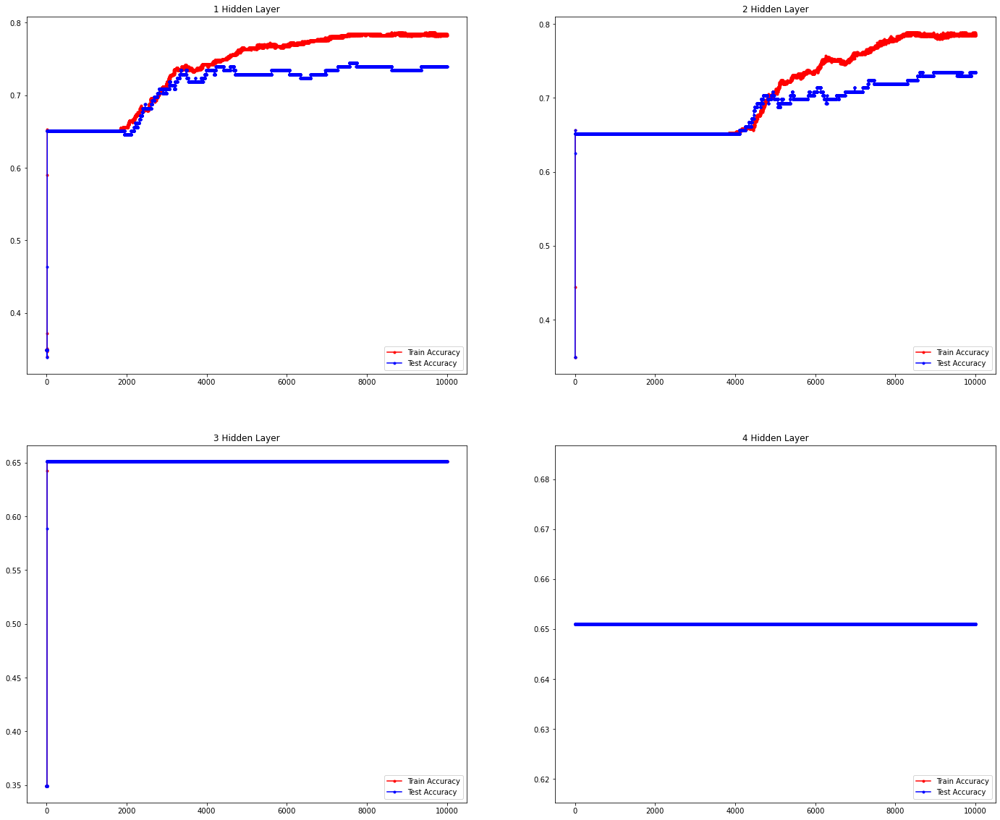

In [273]:
fig, axes = plt.subplots(2, 2, figsize=(24, 20))

for i in range (0, n_model):
    ax = plt.subplot(2, 2, i+1) 
    ax.plot(run_hist_SGD[i].history["accuracy"],'r', marker='.', label="Train Accuracy")
    ax.plot(run_hist_SGD[i].history["val_accuracy"],'b', marker='.', label="Test Accuracy")
    ax.legend(loc = 'lower right')
    title = str(i + 1) + ' Hidden Layer'
    ax.title.set_text(title)

In [233]:
print('Optimizer = SGD:\n')
for i in range (0, 4):
    print('Model [', i, '] (', str(i + 1), 'Hidden Layer(s)):')
    print(model_SGD[i].summary())
    print('\n')

Optimizer = SGD:

Model [ 0 ] ( 1 Hidden Layer(s)):
Model: "sequential_28"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_71 (Dense)             (None, 12)                108       
_________________________________________________________________
dense_72 (Dense)             (None, 1)                 13        
Total params: 121
Trainable params: 121
Non-trainable params: 0
_________________________________________________________________
None


Model [ 1 ] ( 2 Hidden Layer(s)):
Model: "sequential_29"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_73 (Dense)             (None, 12)                108       
_________________________________________________________________
dense_74 (Dense)             (None, 12)                156       
_________________________________________________________________
dense

In [274]:
print('Optimizer = SGD:\n')
print('SGD Train Accuracy:')
for i in range (0, 4):
    print(str(i + 1), ' Hidden Layer: ', max(run_hist_SGD[i].history["accuracy"]))
print('\n')
print('SGD Test Accuracy:')
for i in range (0, 4):
    print(str(i + 1), ' Hidden Layer: ', max(run_hist_SGD[i].history["val_accuracy"]))

Optimizer = SGD:

SGD Train Accuracy:
1  Hidden Layer:  0.7864583
2  Hidden Layer:  0.7881944
3  Hidden Layer:  0.6510417
4  Hidden Layer:  0.6510417


SGD Test Accuracy:
1  Hidden Layer:  0.7447917
2  Hidden Layer:  0.734375
3  Hidden Layer:  0.6510417
4  Hidden Layer:  0.6510417


### 5.2. OPTIMIZER = ADAM

In [200]:
model_Adam = []
run_hist_Adam = []

for i in range(0, n_model):
    # initialize the model
    model_Adam.append(Sequential())
    
    # add hidden layer
    for j in range(0, i + 1):
        model_Adam[i].add(Dense(12,input_shape = (8,),activation = 'sigmoid'))
    
    # add output layer
    model_Adam[i].add(Dense(1,activation='sigmoid'))
    
    model_Adam[i].compile(Adam(lr = .003), "binary_crossentropy", metrics = ["accuracy"])
    run_hist_Adam.append(model_Adam[i].fit(X_train, y_train, validation_data = (X_test, y_test), epochs = n_epoch))

Train on 576 samples, validate on 192 samples
Epoch 1/10000
576/576 [==============================] - 0s 528us/sample - loss: 0.6516 - accuracy: 0.6510 - val_loss: 0.6429 - val_accuracy: 0.6510
Epoch 2/10000
576/576 [==============================] - 0s 76us/sample - loss: 0.6423 - accuracy: 0.6510 - val_loss: 0.6399 - val_accuracy: 0.6510
Epoch 3/10000
576/576 [==============================] - 0s 67us/sample - loss: 0.6395 - accuracy: 0.6510 - val_loss: 0.6367 - val_accuracy: 0.6510
Epoch 4/10000
576/576 [==============================] - 0s 83us/sample - loss: 0.6363 - accuracy: 0.6510 - val_loss: 0.6337 - val_accuracy: 0.6510
Epoch 5/10000
576/576 [==============================] - 0s 74us/sample - loss: 0.6333 - accuracy: 0.6510 - val_loss: 0.6306 - val_accuracy: 0.6510
Epoch 6/10000
576/576 [==============================] - 0s 83us/sample - loss: 0.6300 - accuracy: 0.6510 - val_loss: 0.6276 - val_accuracy: 0.6510
Epoch 7/10000
576/576 [==============================] - 0s 90us/

Epoch 56/10000
576/576 [==============================] - 0s 64us/sample - loss: 0.5162 - accuracy: 0.7483 - val_loss: 0.5211 - val_accuracy: 0.7188
Epoch 57/10000
576/576 [==============================] - 0s 67us/sample - loss: 0.5153 - accuracy: 0.7396 - val_loss: 0.5199 - val_accuracy: 0.7083
Epoch 58/10000
576/576 [==============================] - 0s 56us/sample - loss: 0.5145 - accuracy: 0.7396 - val_loss: 0.5189 - val_accuracy: 0.7135
Epoch 59/10000
576/576 [==============================] - 0s 62us/sample - loss: 0.5132 - accuracy: 0.7413 - val_loss: 0.5186 - val_accuracy: 0.7240
Epoch 60/10000
576/576 [==============================] - 0s 64us/sample - loss: 0.5136 - accuracy: 0.7344 - val_loss: 0.5169 - val_accuracy: 0.7083
Epoch 61/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.5112 - accuracy: 0.7448 - val_loss: 0.5166 - val_accuracy: 0.7240
Epoch 62/10000
576/576 [==============================] - 0s 56us/sample - loss: 0.5107 - accuracy: 0.7517

576/576 [==============================] - 0s 57us/sample - loss: 0.4709 - accuracy: 0.7847 - val_loss: 0.4734 - val_accuracy: 0.7500
Epoch 165/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.4708 - accuracy: 0.7865 - val_loss: 0.4732 - val_accuracy: 0.7396
Epoch 166/10000
576/576 [==============================] - 0s 60us/sample - loss: 0.4715 - accuracy: 0.7899 - val_loss: 0.4733 - val_accuracy: 0.7500
Epoch 167/10000
576/576 [==============================] - 0s 62us/sample - loss: 0.4706 - accuracy: 0.7899 - val_loss: 0.4732 - val_accuracy: 0.7500
Epoch 168/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.4710 - accuracy: 0.7847 - val_loss: 0.4730 - val_accuracy: 0.7396
Epoch 169/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.4709 - accuracy: 0.7917 - val_loss: 0.4729 - val_accuracy: 0.7500
Epoch 170/10000
576/576 [==============================] - 0s 68us/sample - loss: 0.4703 - accuracy: 0.7917 - val_lo

Epoch 273/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.4644 - accuracy: 0.7882 - val_loss: 0.4676 - val_accuracy: 0.7240
Epoch 274/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.4636 - accuracy: 0.7882 - val_loss: 0.4682 - val_accuracy: 0.7396
Epoch 275/10000
576/576 [==============================] - 0s 63us/sample - loss: 0.4639 - accuracy: 0.7951 - val_loss: 0.4679 - val_accuracy: 0.7396
Epoch 276/10000
576/576 [==============================] - 0s 62us/sample - loss: 0.4640 - accuracy: 0.7899 - val_loss: 0.4676 - val_accuracy: 0.7344
Epoch 277/10000
576/576 [==============================] - 0s 62us/sample - loss: 0.4641 - accuracy: 0.7899 - val_loss: 0.4673 - val_accuracy: 0.7240
Epoch 278/10000
576/576 [==============================] - 0s 75us/sample - loss: 0.4646 - accuracy: 0.7917 - val_loss: 0.4680 - val_accuracy: 0.7396
Epoch 279/10000
576/576 [==============================] - 0s 73us/sample - loss: 0.4636 - accuracy:

576/576 [==============================] - 0s 70us/sample - loss: 0.4577 - accuracy: 0.7969 - val_loss: 0.4631 - val_accuracy: 0.7188
Epoch 382/10000
576/576 [==============================] - 0s 67us/sample - loss: 0.4578 - accuracy: 0.7969 - val_loss: 0.4624 - val_accuracy: 0.7188
Epoch 383/10000
576/576 [==============================] - 0s 60us/sample - loss: 0.4579 - accuracy: 0.7951 - val_loss: 0.4625 - val_accuracy: 0.7188
Epoch 384/10000
576/576 [==============================] - 0s 58us/sample - loss: 0.4577 - accuracy: 0.7951 - val_loss: 0.4630 - val_accuracy: 0.7188
Epoch 385/10000
576/576 [==============================] - 0s 62us/sample - loss: 0.4573 - accuracy: 0.7986 - val_loss: 0.4622 - val_accuracy: 0.7188
Epoch 386/10000
576/576 [==============================] - 0s 64us/sample - loss: 0.4583 - accuracy: 0.7969 - val_loss: 0.4625 - val_accuracy: 0.7188
Epoch 387/10000
576/576 [==============================] - 0s 67us/sample - loss: 0.4587 - accuracy: 0.7934 - val_lo

576/576 [==============================] - 0s 57us/sample - loss: 0.4516 - accuracy: 0.7986 - val_loss: 0.4579 - val_accuracy: 0.7292
Epoch 490/10000
576/576 [==============================] - 0s 56us/sample - loss: 0.4520 - accuracy: 0.7917 - val_loss: 0.4578 - val_accuracy: 0.7448
Epoch 491/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.4515 - accuracy: 0.8003 - val_loss: 0.4578 - val_accuracy: 0.7448
Epoch 492/10000
576/576 [==============================] - 0s 56us/sample - loss: 0.4514 - accuracy: 0.8038 - val_loss: 0.4580 - val_accuracy: 0.7188
Epoch 493/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.4514 - accuracy: 0.7951 - val_loss: 0.4575 - val_accuracy: 0.7500
Epoch 494/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.4534 - accuracy: 0.7986 - val_loss: 0.4579 - val_accuracy: 0.7292
Epoch 495/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.4523 - accuracy: 0.7899 - val_lo

576/576 [==============================] - 0s 59us/sample - loss: 0.4468 - accuracy: 0.8021 - val_loss: 0.4564 - val_accuracy: 0.7344
Epoch 598/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.4472 - accuracy: 0.8021 - val_loss: 0.4560 - val_accuracy: 0.7344
Epoch 599/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.4471 - accuracy: 0.7986 - val_loss: 0.4559 - val_accuracy: 0.7448
Epoch 600/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.4472 - accuracy: 0.8021 - val_loss: 0.4563 - val_accuracy: 0.7344
Epoch 601/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.4477 - accuracy: 0.8021 - val_loss: 0.4563 - val_accuracy: 0.7344
Epoch 602/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.4467 - accuracy: 0.8056 - val_loss: 0.4556 - val_accuracy: 0.7396
Epoch 603/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.4472 - accuracy: 0.7969 - val_lo

Epoch 652/10000
576/576 [==============================] - 0s 73us/sample - loss: 0.4458 - accuracy: 0.7986 - val_loss: 0.4558 - val_accuracy: 0.7448
Epoch 653/10000
576/576 [==============================] - 0s 76us/sample - loss: 0.4453 - accuracy: 0.8056 - val_loss: 0.4560 - val_accuracy: 0.7448
Epoch 654/10000
576/576 [==============================] - 0s 75us/sample - loss: 0.4450 - accuracy: 0.7969 - val_loss: 0.4556 - val_accuracy: 0.7448
Epoch 655/10000
576/576 [==============================] - 0s 75us/sample - loss: 0.4459 - accuracy: 0.8021 - val_loss: 0.4555 - val_accuracy: 0.7448
Epoch 656/10000
576/576 [==============================] - 0s 64us/sample - loss: 0.4483 - accuracy: 0.7951 - val_loss: 0.4555 - val_accuracy: 0.7396
Epoch 657/10000
576/576 [==============================] - 0s 66us/sample - loss: 0.4451 - accuracy: 0.8038 - val_loss: 0.4565 - val_accuracy: 0.7292
Epoch 658/10000
576/576 [==============================] - 0s 68us/sample - loss: 0.4456 - accuracy:

576/576 [==============================] - 0s 61us/sample - loss: 0.4428 - accuracy: 0.7986 - val_loss: 0.4570 - val_accuracy: 0.7344
Epoch 761/10000
576/576 [==============================] - 0s 66us/sample - loss: 0.4427 - accuracy: 0.8038 - val_loss: 0.4566 - val_accuracy: 0.7448
Epoch 762/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.4427 - accuracy: 0.8003 - val_loss: 0.4563 - val_accuracy: 0.7448
Epoch 763/10000
576/576 [==============================] - 0s 56us/sample - loss: 0.4427 - accuracy: 0.7986 - val_loss: 0.4563 - val_accuracy: 0.7448
Epoch 764/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.4425 - accuracy: 0.7969 - val_loss: 0.4562 - val_accuracy: 0.7396
Epoch 765/10000
576/576 [==============================] - 0s 56us/sample - loss: 0.4439 - accuracy: 0.8003 - val_loss: 0.4563 - val_accuracy: 0.7396
Epoch 766/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.4430 - accuracy: 0.7986 - val_lo

576/576 [==============================] - 0s 54us/sample - loss: 0.4405 - accuracy: 0.7969 - val_loss: 0.4574 - val_accuracy: 0.7396
Epoch 869/10000
576/576 [==============================] - 0s 50us/sample - loss: 0.4407 - accuracy: 0.8021 - val_loss: 0.4580 - val_accuracy: 0.7292
Epoch 870/10000
576/576 [==============================] - 0s 50us/sample - loss: 0.4423 - accuracy: 0.8021 - val_loss: 0.4570 - val_accuracy: 0.7396
Epoch 871/10000
576/576 [==============================] - 0s 47us/sample - loss: 0.4401 - accuracy: 0.7986 - val_loss: 0.4576 - val_accuracy: 0.7396
Epoch 872/10000
576/576 [==============================] - ETA: 0s - loss: 0.3909 - accuracy: 0.81 - 0s 50us/sample - loss: 0.4411 - accuracy: 0.7986 - val_loss: 0.4584 - val_accuracy: 0.7292
Epoch 873/10000
576/576 [==============================] - 0s 54us/sample - loss: 0.4405 - accuracy: 0.7986 - val_loss: 0.4571 - val_accuracy: 0.7396
Epoch 874/10000
576/576 [==============================] - 0s 49us/sample 

576/576 [==============================] - 0s 61us/sample - loss: 0.4393 - accuracy: 0.8038 - val_loss: 0.4582 - val_accuracy: 0.7448
Epoch 977/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.4384 - accuracy: 0.7986 - val_loss: 0.4579 - val_accuracy: 0.7448
Epoch 978/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.4394 - accuracy: 0.7951 - val_loss: 0.4580 - val_accuracy: 0.7448
Epoch 979/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.4381 - accuracy: 0.7969 - val_loss: 0.4581 - val_accuracy: 0.7448
Epoch 980/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.4381 - accuracy: 0.7986 - val_loss: 0.4584 - val_accuracy: 0.7292
Epoch 981/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.4382 - accuracy: 0.7986 - val_loss: 0.4582 - val_accuracy: 0.7344
Epoch 982/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.4381 - accuracy: 0.7969 - val_lo

Epoch 1030/10000
576/576 [==============================] - 0s 64us/sample - loss: 0.4378 - accuracy: 0.7934 - val_loss: 0.4583 - val_accuracy: 0.7500
Epoch 1031/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.4374 - accuracy: 0.7986 - val_loss: 0.4584 - val_accuracy: 0.7396
Epoch 1032/10000
576/576 [==============================] - ETA: 0s - loss: 0.5758 - accuracy: 0.65 - 0s 59us/sample - loss: 0.4374 - accuracy: 0.8003 - val_loss: 0.4587 - val_accuracy: 0.7292
Epoch 1033/10000
576/576 [==============================] - 0s 66us/sample - loss: 0.4387 - accuracy: 0.8003 - val_loss: 0.4590 - val_accuracy: 0.7344
Epoch 1034/10000
576/576 [==============================] - 0s 56us/sample - loss: 0.4371 - accuracy: 0.7986 - val_loss: 0.4583 - val_accuracy: 0.7448
Epoch 1035/10000
576/576 [==============================] - 0s 64us/sample - loss: 0.4384 - accuracy: 0.7986 - val_loss: 0.4584 - val_accuracy: 0.7396
Epoch 1036/10000
576/576 [==========================

Epoch 1084/10000
576/576 [==============================] - 0s 64us/sample - loss: 0.4378 - accuracy: 0.7934 - val_loss: 0.4586 - val_accuracy: 0.7500
Epoch 1085/10000
576/576 [==============================] - 0s 60us/sample - loss: 0.4397 - accuracy: 0.8038 - val_loss: 0.4599 - val_accuracy: 0.7292
Epoch 1086/10000
576/576 [==============================] - 0s 60us/sample - loss: 0.4384 - accuracy: 0.8021 - val_loss: 0.4588 - val_accuracy: 0.7552
Epoch 1087/10000
576/576 [==============================] - 0s 76us/sample - loss: 0.4370 - accuracy: 0.7951 - val_loss: 0.4592 - val_accuracy: 0.7344
Epoch 1088/10000
576/576 [==============================] - 0s 76us/sample - loss: 0.4364 - accuracy: 0.8003 - val_loss: 0.4588 - val_accuracy: 0.7344
Epoch 1089/10000
576/576 [==============================] - 0s 64us/sample - loss: 0.4360 - accuracy: 0.8021 - val_loss: 0.4589 - val_accuracy: 0.7344
Epoch 1090/10000
576/576 [==============================] - 0s 71us/sample - loss: 0.4366 - ac

576/576 [==============================] - 0s 62us/sample - loss: 0.4343 - accuracy: 0.8021 - val_loss: 0.4592 - val_accuracy: 0.7344
Epoch 1193/10000
576/576 [==============================] - 0s 69us/sample - loss: 0.4347 - accuracy: 0.8003 - val_loss: 0.4593 - val_accuracy: 0.7344
Epoch 1194/10000
576/576 [==============================] - 0s 71us/sample - loss: 0.4344 - accuracy: 0.8003 - val_loss: 0.4593 - val_accuracy: 0.7344
Epoch 1195/10000
576/576 [==============================] - 0s 62us/sample - loss: 0.4348 - accuracy: 0.8003 - val_loss: 0.4591 - val_accuracy: 0.7396
Epoch 1196/10000
576/576 [==============================] - 0s 71us/sample - loss: 0.4360 - accuracy: 0.8021 - val_loss: 0.4593 - val_accuracy: 0.7344
Epoch 1197/10000
576/576 [==============================] - 0s 66us/sample - loss: 0.4355 - accuracy: 0.8021 - val_loss: 0.4592 - val_accuracy: 0.7344
Epoch 1198/10000
576/576 [==============================] - 0s 68us/sample - loss: 0.4339 - accuracy: 0.8021 - 

576/576 [==============================] - 0s 66us/sample - loss: 0.4323 - accuracy: 0.8038 - val_loss: 0.4594 - val_accuracy: 0.7292
Epoch 1301/10000
576/576 [==============================] - 0s 75us/sample - loss: 0.4328 - accuracy: 0.8003 - val_loss: 0.4603 - val_accuracy: 0.7344
Epoch 1302/10000
576/576 [==============================] - 0s 66us/sample - loss: 0.4337 - accuracy: 0.8021 - val_loss: 0.4595 - val_accuracy: 0.7448
Epoch 1303/10000
576/576 [==============================] - 0s 66us/sample - loss: 0.4321 - accuracy: 0.8038 - val_loss: 0.4596 - val_accuracy: 0.7344
Epoch 1304/10000
576/576 [==============================] - 0s 68us/sample - loss: 0.4336 - accuracy: 0.8021 - val_loss: 0.4595 - val_accuracy: 0.7344
Epoch 1305/10000
576/576 [==============================] - 0s 63us/sample - loss: 0.4324 - accuracy: 0.8038 - val_loss: 0.4593 - val_accuracy: 0.7292
Epoch 1306/10000
576/576 [==============================] - 0s 63us/sample - loss: 0.4330 - accuracy: 0.8038 - 

576/576 [==============================] - 0s 62us/sample - loss: 0.4309 - accuracy: 0.8003 - val_loss: 0.4600 - val_accuracy: 0.7448
Epoch 1409/10000
576/576 [==============================] - 0s 73us/sample - loss: 0.4312 - accuracy: 0.8038 - val_loss: 0.4593 - val_accuracy: 0.7292
Epoch 1410/10000
576/576 [==============================] - 0s 66us/sample - loss: 0.4312 - accuracy: 0.8038 - val_loss: 0.4595 - val_accuracy: 0.7344
Epoch 1411/10000
576/576 [==============================] - 0s 69us/sample - loss: 0.4309 - accuracy: 0.7986 - val_loss: 0.4595 - val_accuracy: 0.7292
Epoch 1412/10000
576/576 [==============================] - 0s 75us/sample - loss: 0.4313 - accuracy: 0.7986 - val_loss: 0.4597 - val_accuracy: 0.7344
Epoch 1413/10000
576/576 [==============================] - 0s 73us/sample - loss: 0.4316 - accuracy: 0.8003 - val_loss: 0.4597 - val_accuracy: 0.7448
Epoch 1414/10000
576/576 [==============================] - 0s 62us/sample - loss: 0.4306 - accuracy: 0.8003 - 

576/576 [==============================] - 0s 78us/sample - loss: 0.4293 - accuracy: 0.7986 - val_loss: 0.4599 - val_accuracy: 0.7448
Epoch 1517/10000
576/576 [==============================] - 0s 76us/sample - loss: 0.4293 - accuracy: 0.8003 - val_loss: 0.4594 - val_accuracy: 0.7448
Epoch 1518/10000
576/576 [==============================] - 0s 72us/sample - loss: 0.4300 - accuracy: 0.7986 - val_loss: 0.4595 - val_accuracy: 0.7396
Epoch 1519/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.4293 - accuracy: 0.8003 - val_loss: 0.4593 - val_accuracy: 0.7396
Epoch 1520/10000
576/576 [==============================] - 0s 63us/sample - loss: 0.4290 - accuracy: 0.8038 - val_loss: 0.4598 - val_accuracy: 0.7448
Epoch 1521/10000
576/576 [==============================] - 0s 64us/sample - loss: 0.4292 - accuracy: 0.8021 - val_loss: 0.4597 - val_accuracy: 0.7448
Epoch 1522/10000
576/576 [==============================] - 0s 63us/sample - loss: 0.4295 - accuracy: 0.8003 - 

576/576 [==============================] - 0s 68us/sample - loss: 0.4271 - accuracy: 0.8021 - val_loss: 0.4593 - val_accuracy: 0.7448
Epoch 1625/10000
576/576 [==============================] - 0s 62us/sample - loss: 0.4273 - accuracy: 0.8056 - val_loss: 0.4597 - val_accuracy: 0.7500
Epoch 1626/10000
576/576 [==============================] - 0s 68us/sample - loss: 0.4280 - accuracy: 0.8021 - val_loss: 0.4591 - val_accuracy: 0.7448
Epoch 1627/10000
576/576 [==============================] - 0s 68us/sample - loss: 0.4271 - accuracy: 0.8021 - val_loss: 0.4596 - val_accuracy: 0.7500
Epoch 1628/10000
576/576 [==============================] - 0s 66us/sample - loss: 0.4280 - accuracy: 0.8056 - val_loss: 0.4590 - val_accuracy: 0.7396
Epoch 1629/10000
576/576 [==============================] - 0s 63us/sample - loss: 0.4273 - accuracy: 0.8021 - val_loss: 0.4595 - val_accuracy: 0.7500
Epoch 1630/10000
576/576 [==============================] - 0s 68us/sample - loss: 0.4271 - accuracy: 0.8038 - 

Epoch 1678/10000
576/576 [==============================] - 0s 76us/sample - loss: 0.4259 - accuracy: 0.8090 - val_loss: 0.4597 - val_accuracy: 0.7500
Epoch 1679/10000
576/576 [==============================] - 0s 63us/sample - loss: 0.4272 - accuracy: 0.8021 - val_loss: 0.4596 - val_accuracy: 0.7448
Epoch 1680/10000
576/576 [==============================] - 0s 66us/sample - loss: 0.4267 - accuracy: 0.8038 - val_loss: 0.4592 - val_accuracy: 0.7448
Epoch 1681/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.4260 - accuracy: 0.8038 - val_loss: 0.4592 - val_accuracy: 0.7448
Epoch 1682/10000
576/576 [==============================] - 0s 66us/sample - loss: 0.4272 - accuracy: 0.8021 - val_loss: 0.4600 - val_accuracy: 0.7448
Epoch 1683/10000
576/576 [==============================] - 0s 68us/sample - loss: 0.4267 - accuracy: 0.7986 - val_loss: 0.4596 - val_accuracy: 0.7552
Epoch 1684/10000
576/576 [==============================] - 0s 69us/sample - loss: 0.4263 - ac

576/576 [==============================] - 0s 66us/sample - loss: 0.4264 - accuracy: 0.8056 - val_loss: 0.4604 - val_accuracy: 0.7448
Epoch 1787/10000
576/576 [==============================] - 0s 63us/sample - loss: 0.4237 - accuracy: 0.8003 - val_loss: 0.4595 - val_accuracy: 0.7500
Epoch 1788/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.4244 - accuracy: 0.8090 - val_loss: 0.4596 - val_accuracy: 0.7604
Epoch 1789/10000
576/576 [==============================] - 0s 62us/sample - loss: 0.4257 - accuracy: 0.8003 - val_loss: 0.4596 - val_accuracy: 0.7500
Epoch 1790/10000
576/576 [==============================] - 0s 66us/sample - loss: 0.4243 - accuracy: 0.8073 - val_loss: 0.4596 - val_accuracy: 0.7604
Epoch 1791/10000
576/576 [==============================] - 0s 64us/sample - loss: 0.4242 - accuracy: 0.8056 - val_loss: 0.4597 - val_accuracy: 0.7448
Epoch 1792/10000
576/576 [==============================] - 0s 63us/sample - loss: 0.4253 - accuracy: 0.8090 - 

576/576 [==============================] - 0s 64us/sample - loss: 0.4231 - accuracy: 0.8073 - val_loss: 0.4604 - val_accuracy: 0.7552
Epoch 1895/10000
576/576 [==============================] - 0s 62us/sample - loss: 0.4252 - accuracy: 0.8038 - val_loss: 0.4601 - val_accuracy: 0.7448
Epoch 1896/10000
576/576 [==============================] - 0s 62us/sample - loss: 0.4221 - accuracy: 0.8073 - val_loss: 0.4603 - val_accuracy: 0.7500
Epoch 1897/10000
576/576 [==============================] - 0s 64us/sample - loss: 0.4228 - accuracy: 0.8056 - val_loss: 0.4600 - val_accuracy: 0.7448
Epoch 1898/10000
576/576 [==============================] - 0s 66us/sample - loss: 0.4228 - accuracy: 0.8021 - val_loss: 0.4604 - val_accuracy: 0.7500
Epoch 1899/10000
576/576 [==============================] - 0s 63us/sample - loss: 0.4223 - accuracy: 0.8090 - val_loss: 0.4600 - val_accuracy: 0.7396
Epoch 1900/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.4221 - accuracy: 0.8073 - 

576/576 [==============================] - 0s 64us/sample - loss: 0.4205 - accuracy: 0.8090 - val_loss: 0.4611 - val_accuracy: 0.7448
Epoch 2003/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.4199 - accuracy: 0.8090 - val_loss: 0.4614 - val_accuracy: 0.7500
Epoch 2004/10000
576/576 [==============================] - 0s 66us/sample - loss: 0.4206 - accuracy: 0.8038 - val_loss: 0.4614 - val_accuracy: 0.7500
Epoch 2005/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.4199 - accuracy: 0.8073 - val_loss: 0.4611 - val_accuracy: 0.7448
Epoch 2006/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.4229 - accuracy: 0.8073 - val_loss: 0.4611 - val_accuracy: 0.7396
Epoch 2007/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.4228 - accuracy: 0.8073 - val_loss: 0.4616 - val_accuracy: 0.7552
Epoch 2008/10000
576/576 [==============================] - 0s 63us/sample - loss: 0.4200 - accuracy: 0.8056 - 

576/576 [==============================] - 0s 73us/sample - loss: 0.4182 - accuracy: 0.8108 - val_loss: 0.4624 - val_accuracy: 0.7500
Epoch 2111/10000
576/576 [==============================] - 0s 71us/sample - loss: 0.4192 - accuracy: 0.8056 - val_loss: 0.4623 - val_accuracy: 0.7448
Epoch 2112/10000
576/576 [==============================] - 0s 62us/sample - loss: 0.4179 - accuracy: 0.8090 - val_loss: 0.4624 - val_accuracy: 0.7396
Epoch 2113/10000
576/576 [==============================] - 0s 66us/sample - loss: 0.4189 - accuracy: 0.8108 - val_loss: 0.4623 - val_accuracy: 0.7396
Epoch 2114/10000
576/576 [==============================] - 0s 66us/sample - loss: 0.4187 - accuracy: 0.8108 - val_loss: 0.4624 - val_accuracy: 0.7448
Epoch 2115/10000
576/576 [==============================] - 0s 64us/sample - loss: 0.4185 - accuracy: 0.8108 - val_loss: 0.4624 - val_accuracy: 0.7448
Epoch 2116/10000
576/576 [==============================] - 0s 75us/sample - loss: 0.4180 - accuracy: 0.8090 - 

576/576 [==============================] - 0s 62us/sample - loss: 0.4170 - accuracy: 0.8108 - val_loss: 0.4631 - val_accuracy: 0.7448
Epoch 2165/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.4176 - accuracy: 0.8073 - val_loss: 0.4629 - val_accuracy: 0.7448
Epoch 2166/10000
576/576 [==============================] - 0s 64us/sample - loss: 0.4168 - accuracy: 0.8073 - val_loss: 0.4637 - val_accuracy: 0.7448
Epoch 2167/10000
576/576 [==============================] - 0s 64us/sample - loss: 0.4179 - accuracy: 0.8073 - val_loss: 0.4632 - val_accuracy: 0.7396
Epoch 2168/10000
576/576 [==============================] - 0s 71us/sample - loss: 0.4183 - accuracy: 0.8073 - val_loss: 0.4637 - val_accuracy: 0.7500
Epoch 2169/10000
576/576 [==============================] - 0s 73us/sample - loss: 0.4169 - accuracy: 0.8090 - val_loss: 0.4633 - val_accuracy: 0.7448
Epoch 2170/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.4171 - accuracy: 0.8108 - 

576/576 [==============================] - 0s 73us/sample - loss: 0.4153 - accuracy: 0.8090 - val_loss: 0.4643 - val_accuracy: 0.7448
Epoch 2273/10000
576/576 [==============================] - 0s 68us/sample - loss: 0.4148 - accuracy: 0.8125 - val_loss: 0.4643 - val_accuracy: 0.7396
Epoch 2274/10000
576/576 [==============================] - 0s 78us/sample - loss: 0.4147 - accuracy: 0.8090 - val_loss: 0.4644 - val_accuracy: 0.7448
Epoch 2275/10000
576/576 [==============================] - 0s 73us/sample - loss: 0.4148 - accuracy: 0.8108 - val_loss: 0.4644 - val_accuracy: 0.7448
Epoch 2276/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.4150 - accuracy: 0.8073 - val_loss: 0.4646 - val_accuracy: 0.7448
Epoch 2277/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.4150 - accuracy: 0.8108 - val_loss: 0.4647 - val_accuracy: 0.7448
Epoch 2278/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.4144 - accuracy: 0.8125 - 

576/576 [==============================] - 0s 64us/sample - loss: 0.4129 - accuracy: 0.8142 - val_loss: 0.4659 - val_accuracy: 0.7396
Epoch 2381/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.4132 - accuracy: 0.8090 - val_loss: 0.4658 - val_accuracy: 0.7448
Epoch 2382/10000
576/576 [==============================] - 0s 64us/sample - loss: 0.4139 - accuracy: 0.8090 - val_loss: 0.4663 - val_accuracy: 0.7448
Epoch 2383/10000
576/576 [==============================] - 0s 64us/sample - loss: 0.4123 - accuracy: 0.8090 - val_loss: 0.4660 - val_accuracy: 0.7448
Epoch 2384/10000
576/576 [==============================] - 0s 69us/sample - loss: 0.4154 - accuracy: 0.8142 - val_loss: 0.4666 - val_accuracy: 0.7448
Epoch 2385/10000
576/576 [==============================] - 0s 66us/sample - loss: 0.4130 - accuracy: 0.8090 - val_loss: 0.4662 - val_accuracy: 0.7396
Epoch 2386/10000
576/576 [==============================] - 0s 71us/sample - loss: 0.4129 - accuracy: 0.8125 - 

Epoch 2488/10000
576/576 [==============================] - 0s 68us/sample - loss: 0.4107 - accuracy: 0.8108 - val_loss: 0.4679 - val_accuracy: 0.7448
Epoch 2489/10000
576/576 [==============================] - 0s 69us/sample - loss: 0.4111 - accuracy: 0.8108 - val_loss: 0.4678 - val_accuracy: 0.7396
Epoch 2490/10000
576/576 [==============================] - 0s 64us/sample - loss: 0.4103 - accuracy: 0.8108 - val_loss: 0.4675 - val_accuracy: 0.7448
Epoch 2491/10000
576/576 [==============================] - 0s 68us/sample - loss: 0.4103 - accuracy: 0.8073 - val_loss: 0.4676 - val_accuracy: 0.7448
Epoch 2492/10000
576/576 [==============================] - 0s 68us/sample - loss: 0.4100 - accuracy: 0.8073 - val_loss: 0.4675 - val_accuracy: 0.7448
Epoch 2493/10000
576/576 [==============================] - 0s 64us/sample - loss: 0.4101 - accuracy: 0.8125 - val_loss: 0.4680 - val_accuracy: 0.7448
Epoch 2494/10000
576/576 [==============================] - 0s 68us/sample - loss: 0.4105 - ac

576/576 [==============================] - 0s 64us/sample - loss: 0.4093 - accuracy: 0.8073 - val_loss: 0.4697 - val_accuracy: 0.7344
Epoch 2597/10000
576/576 [==============================] - 0s 64us/sample - loss: 0.4095 - accuracy: 0.8090 - val_loss: 0.4694 - val_accuracy: 0.7500
Epoch 2598/10000
576/576 [==============================] - 0s 63us/sample - loss: 0.4078 - accuracy: 0.8108 - val_loss: 0.4699 - val_accuracy: 0.7344
Epoch 2599/10000
576/576 [==============================] - 0s 64us/sample - loss: 0.4083 - accuracy: 0.8125 - val_loss: 0.4696 - val_accuracy: 0.7396
Epoch 2600/10000
576/576 [==============================] - 0s 66us/sample - loss: 0.4083 - accuracy: 0.8125 - val_loss: 0.4695 - val_accuracy: 0.7344
Epoch 2601/10000
576/576 [==============================] - 0s 64us/sample - loss: 0.4106 - accuracy: 0.8056 - val_loss: 0.4694 - val_accuracy: 0.7396
Epoch 2602/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.4078 - accuracy: 0.8108 - 

576/576 [==============================] - 0s 75us/sample - loss: 0.4071 - accuracy: 0.8073 - val_loss: 0.4704 - val_accuracy: 0.7344
Epoch 2651/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.4072 - accuracy: 0.8125 - val_loss: 0.4700 - val_accuracy: 0.7396
Epoch 2652/10000
576/576 [==============================] - 0s 63us/sample - loss: 0.4073 - accuracy: 0.8073 - val_loss: 0.4702 - val_accuracy: 0.7344
Epoch 2653/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.4069 - accuracy: 0.8108 - val_loss: 0.4701 - val_accuracy: 0.7396
Epoch 2654/10000
576/576 [==============================] - 0s 66us/sample - loss: 0.4074 - accuracy: 0.8108 - val_loss: 0.4700 - val_accuracy: 0.7344
Epoch 2655/10000
576/576 [==============================] - 0s 62us/sample - loss: 0.4072 - accuracy: 0.8090 - val_loss: 0.4704 - val_accuracy: 0.7344
Epoch 2656/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.4069 - accuracy: 0.8073 - 

576/576 [==============================] - 0s 68us/sample - loss: 0.4052 - accuracy: 0.8090 - val_loss: 0.4727 - val_accuracy: 0.7396
Epoch 2759/10000
576/576 [==============================] - 0s 64us/sample - loss: 0.4049 - accuracy: 0.8073 - val_loss: 0.4723 - val_accuracy: 0.7344
Epoch 2760/10000
576/576 [==============================] - 0s 73us/sample - loss: 0.4056 - accuracy: 0.8125 - val_loss: 0.4720 - val_accuracy: 0.7396
Epoch 2761/10000
576/576 [==============================] - 0s 75us/sample - loss: 0.4056 - accuracy: 0.8090 - val_loss: 0.4727 - val_accuracy: 0.7396
Epoch 2762/10000
576/576 [==============================] - 0s 69us/sample - loss: 0.4046 - accuracy: 0.8056 - val_loss: 0.4722 - val_accuracy: 0.7448
Epoch 2763/10000
576/576 [==============================] - 0s 73us/sample - loss: 0.4048 - accuracy: 0.8073 - val_loss: 0.4718 - val_accuracy: 0.7396
Epoch 2764/10000
576/576 [==============================] - 0s 71us/sample - loss: 0.4047 - accuracy: 0.8073 - 

576/576 [==============================] - 0s 63us/sample - loss: 0.4027 - accuracy: 0.8021 - val_loss: 0.4744 - val_accuracy: 0.7448
Epoch 2867/10000
576/576 [==============================] - 0s 62us/sample - loss: 0.4029 - accuracy: 0.8142 - val_loss: 0.4742 - val_accuracy: 0.7396
Epoch 2868/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.4033 - accuracy: 0.8038 - val_loss: 0.4744 - val_accuracy: 0.7448
Epoch 2869/10000
576/576 [==============================] - 0s 73us/sample - loss: 0.4025 - accuracy: 0.8073 - val_loss: 0.4743 - val_accuracy: 0.7396
Epoch 2870/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.4026 - accuracy: 0.8090 - val_loss: 0.4749 - val_accuracy: 0.7448
Epoch 2871/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.4029 - accuracy: 0.8108 - val_loss: 0.4745 - val_accuracy: 0.7500
Epoch 2872/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.4029 - accuracy: 0.8090 - 

576/576 [==============================] - 0s 64us/sample - loss: 0.4014 - accuracy: 0.8090 - val_loss: 0.4765 - val_accuracy: 0.7448
Epoch 2975/10000
576/576 [==============================] - 0s 64us/sample - loss: 0.4007 - accuracy: 0.8038 - val_loss: 0.4770 - val_accuracy: 0.7396
Epoch 2976/10000
576/576 [==============================] - 0s 64us/sample - loss: 0.4011 - accuracy: 0.8090 - val_loss: 0.4763 - val_accuracy: 0.7500
Epoch 2977/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.4007 - accuracy: 0.8073 - val_loss: 0.4765 - val_accuracy: 0.7500
Epoch 2978/10000
576/576 [==============================] - 0s 66us/sample - loss: 0.4004 - accuracy: 0.8090 - val_loss: 0.4767 - val_accuracy: 0.7500
Epoch 2979/10000
576/576 [==============================] - 0s 64us/sample - loss: 0.4010 - accuracy: 0.8056 - val_loss: 0.4766 - val_accuracy: 0.7448
Epoch 2980/10000
576/576 [==============================] - 0s 63us/sample - loss: 0.4006 - accuracy: 0.8108 - 

576/576 [==============================] - 0s 61us/sample - loss: 0.3995 - accuracy: 0.8108 - val_loss: 0.4780 - val_accuracy: 0.7500
Epoch 3029/10000
576/576 [==============================] - 0s 64us/sample - loss: 0.4000 - accuracy: 0.8073 - val_loss: 0.4783 - val_accuracy: 0.7448
Epoch 3030/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.4003 - accuracy: 0.8090 - val_loss: 0.4783 - val_accuracy: 0.7448
Epoch 3031/10000
576/576 [==============================] - 0s 64us/sample - loss: 0.3994 - accuracy: 0.8108 - val_loss: 0.4779 - val_accuracy: 0.7500
Epoch 3032/10000
576/576 [==============================] - 0s 63us/sample - loss: 0.4011 - accuracy: 0.8108 - val_loss: 0.4782 - val_accuracy: 0.7448
Epoch 3033/10000
576/576 [==============================] - 0s 64us/sample - loss: 0.3999 - accuracy: 0.8090 - val_loss: 0.4780 - val_accuracy: 0.7500
Epoch 3034/10000
576/576 [==============================] - 0s 64us/sample - loss: 0.3996 - accuracy: 0.8090 - 

576/576 [==============================] - 0s 59us/sample - loss: 0.3979 - accuracy: 0.8108 - val_loss: 0.4802 - val_accuracy: 0.7500
Epoch 3137/10000
576/576 [==============================] - 0s 64us/sample - loss: 0.3980 - accuracy: 0.8056 - val_loss: 0.4808 - val_accuracy: 0.7448
Epoch 3138/10000
576/576 [==============================] - 0s 63us/sample - loss: 0.3976 - accuracy: 0.8125 - val_loss: 0.4805 - val_accuracy: 0.7448
Epoch 3139/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.3984 - accuracy: 0.8021 - val_loss: 0.4807 - val_accuracy: 0.7448
Epoch 3140/10000
576/576 [==============================] - 0s 64us/sample - loss: 0.3975 - accuracy: 0.8056 - val_loss: 0.4805 - val_accuracy: 0.7500
Epoch 3141/10000
576/576 [==============================] - 0s 64us/sample - loss: 0.3990 - accuracy: 0.8177 - val_loss: 0.4815 - val_accuracy: 0.7500
Epoch 3142/10000
576/576 [==============================] - 0s 76us/sample - loss: 0.3983 - accuracy: 0.8056 - 

576/576 [==============================] - 0s 66us/sample - loss: 0.3960 - accuracy: 0.8177 - val_loss: 0.4827 - val_accuracy: 0.7500
Epoch 3245/10000
576/576 [==============================] - 0s 64us/sample - loss: 0.3958 - accuracy: 0.8177 - val_loss: 0.4830 - val_accuracy: 0.7448
Epoch 3246/10000
576/576 [==============================] - 0s 62us/sample - loss: 0.3953 - accuracy: 0.8142 - val_loss: 0.4832 - val_accuracy: 0.7448
Epoch 3247/10000
576/576 [==============================] - 0s 63us/sample - loss: 0.3958 - accuracy: 0.8073 - val_loss: 0.4833 - val_accuracy: 0.7448
Epoch 3248/10000
576/576 [==============================] - 0s 62us/sample - loss: 0.3963 - accuracy: 0.8194 - val_loss: 0.4833 - val_accuracy: 0.7500
Epoch 3249/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.3957 - accuracy: 0.8125 - val_loss: 0.4836 - val_accuracy: 0.7500
Epoch 3250/10000
576/576 [==============================] - 0s 69us/sample - loss: 0.3964 - accuracy: 0.8142 - 

576/576 [==============================] - 0s 64us/sample - loss: 0.3936 - accuracy: 0.8142 - val_loss: 0.4861 - val_accuracy: 0.7448
Epoch 3353/10000
576/576 [==============================] - 0s 73us/sample - loss: 0.3936 - accuracy: 0.8090 - val_loss: 0.4858 - val_accuracy: 0.7500
Epoch 3354/10000
576/576 [==============================] - 0s 62us/sample - loss: 0.3936 - accuracy: 0.8142 - val_loss: 0.4858 - val_accuracy: 0.7448
Epoch 3355/10000
576/576 [==============================] - 0s 64us/sample - loss: 0.3935 - accuracy: 0.8160 - val_loss: 0.4858 - val_accuracy: 0.7448
Epoch 3356/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.3936 - accuracy: 0.8160 - val_loss: 0.4859 - val_accuracy: 0.7500
Epoch 3357/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.3957 - accuracy: 0.8056 - val_loss: 0.4862 - val_accuracy: 0.7500
Epoch 3358/10000
576/576 [==============================] - 0s 68us/sample - loss: 0.3941 - accuracy: 0.8177 - 

576/576 [==============================] - 0s 64us/sample - loss: 0.3915 - accuracy: 0.8194 - val_loss: 0.4888 - val_accuracy: 0.7448
Epoch 3461/10000
576/576 [==============================] - 0s 62us/sample - loss: 0.3914 - accuracy: 0.8177 - val_loss: 0.4886 - val_accuracy: 0.7500
Epoch 3462/10000
576/576 [==============================] - 0s 64us/sample - loss: 0.3916 - accuracy: 0.8073 - val_loss: 0.4892 - val_accuracy: 0.7500
Epoch 3463/10000
576/576 [==============================] - 0s 63us/sample - loss: 0.3910 - accuracy: 0.8108 - val_loss: 0.4886 - val_accuracy: 0.7448
Epoch 3464/10000
576/576 [==============================] - 0s 68us/sample - loss: 0.3919 - accuracy: 0.8194 - val_loss: 0.4885 - val_accuracy: 0.7448
Epoch 3465/10000
576/576 [==============================] - 0s 63us/sample - loss: 0.3913 - accuracy: 0.8125 - val_loss: 0.4893 - val_accuracy: 0.7500
Epoch 3466/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.3914 - accuracy: 0.8125 - 

576/576 [==============================] - 0s 63us/sample - loss: 0.3907 - accuracy: 0.8194 - val_loss: 0.4914 - val_accuracy: 0.7500
Epoch 3569/10000
576/576 [==============================] - 0s 64us/sample - loss: 0.3901 - accuracy: 0.8142 - val_loss: 0.4912 - val_accuracy: 0.7500
Epoch 3570/10000
576/576 [==============================] - 0s 62us/sample - loss: 0.3909 - accuracy: 0.8073 - val_loss: 0.4917 - val_accuracy: 0.7500
Epoch 3571/10000
576/576 [==============================] - 0s 69us/sample - loss: 0.3897 - accuracy: 0.8212 - val_loss: 0.4916 - val_accuracy: 0.7448
Epoch 3572/10000
576/576 [==============================] - 0s 63us/sample - loss: 0.3894 - accuracy: 0.8177 - val_loss: 0.4915 - val_accuracy: 0.7500
Epoch 3573/10000
576/576 [==============================] - 0s 62us/sample - loss: 0.3893 - accuracy: 0.8160 - val_loss: 0.4916 - val_accuracy: 0.7500
Epoch 3574/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.3896 - accuracy: 0.8194 - 

576/576 [==============================] - 0s 69us/sample - loss: 0.3879 - accuracy: 0.8194 - val_loss: 0.4942 - val_accuracy: 0.7500
Epoch 3677/10000
576/576 [==============================] - 0s 68us/sample - loss: 0.3879 - accuracy: 0.8212 - val_loss: 0.4940 - val_accuracy: 0.7500
Epoch 3678/10000
576/576 [==============================] - 0s 71us/sample - loss: 0.3886 - accuracy: 0.8056 - val_loss: 0.4946 - val_accuracy: 0.7500
Epoch 3679/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.3885 - accuracy: 0.8142 - val_loss: 0.4944 - val_accuracy: 0.7552
Epoch 3680/10000
576/576 [==============================] - 0s 64us/sample - loss: 0.3878 - accuracy: 0.8229 - val_loss: 0.4936 - val_accuracy: 0.7500
Epoch 3681/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.3880 - accuracy: 0.8125 - val_loss: 0.4946 - val_accuracy: 0.7500
Epoch 3682/10000
576/576 [==============================] - 0s 64us/sample - loss: 0.3873 - accuracy: 0.8142 - 

576/576 [==============================] - 0s 62us/sample - loss: 0.3862 - accuracy: 0.8160 - val_loss: 0.4951 - val_accuracy: 0.7500
Epoch 3731/10000
576/576 [==============================] - 0s 64us/sample - loss: 0.3869 - accuracy: 0.8212 - val_loss: 0.4954 - val_accuracy: 0.7500
Epoch 3732/10000
576/576 [==============================] - 0s 66us/sample - loss: 0.3869 - accuracy: 0.8212 - val_loss: 0.4954 - val_accuracy: 0.7552
Epoch 3733/10000
576/576 [==============================] - 0s 64us/sample - loss: 0.3863 - accuracy: 0.8177 - val_loss: 0.4956 - val_accuracy: 0.7500
Epoch 3734/10000
576/576 [==============================] - 0s 68us/sample - loss: 0.3870 - accuracy: 0.8073 - val_loss: 0.4956 - val_accuracy: 0.7500
Epoch 3735/10000
576/576 [==============================] - 0s 64us/sample - loss: 0.3863 - accuracy: 0.8194 - val_loss: 0.4958 - val_accuracy: 0.7500
Epoch 3736/10000
576/576 [==============================] - 0s 68us/sample - loss: 0.3868 - accuracy: 0.8212 - 

576/576 [==============================] - 0s 73us/sample - loss: 0.3863 - accuracy: 0.8194 - val_loss: 0.4965 - val_accuracy: 0.7500
Epoch 3785/10000
576/576 [==============================] - 0s 71us/sample - loss: 0.3862 - accuracy: 0.8194 - val_loss: 0.4965 - val_accuracy: 0.7552
Epoch 3786/10000
576/576 [==============================] - 0s 76us/sample - loss: 0.3856 - accuracy: 0.8177 - val_loss: 0.4965 - val_accuracy: 0.7500
Epoch 3787/10000
576/576 [==============================] - 0s 78us/sample - loss: 0.3864 - accuracy: 0.8108 - val_loss: 0.4972 - val_accuracy: 0.7500
Epoch 3788/10000
576/576 [==============================] - 0s 66us/sample - loss: 0.3869 - accuracy: 0.8177 - val_loss: 0.4966 - val_accuracy: 0.7552
Epoch 3789/10000
576/576 [==============================] - 0s 64us/sample - loss: 0.3855 - accuracy: 0.8177 - val_loss: 0.4965 - val_accuracy: 0.7500
Epoch 3790/10000
576/576 [==============================] - 0s 68us/sample - loss: 0.3861 - accuracy: 0.8142 - 

576/576 [==============================] - 0s 59us/sample - loss: 0.3848 - accuracy: 0.8142 - val_loss: 0.4980 - val_accuracy: 0.7500
Epoch 3839/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.3853 - accuracy: 0.8160 - val_loss: 0.4979 - val_accuracy: 0.7552
Epoch 3840/10000
576/576 [==============================] - 0s 66us/sample - loss: 0.3845 - accuracy: 0.8177 - val_loss: 0.4976 - val_accuracy: 0.7500
Epoch 3841/10000
576/576 [==============================] - 0s 64us/sample - loss: 0.3855 - accuracy: 0.8108 - val_loss: 0.4981 - val_accuracy: 0.7500
Epoch 3842/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.3850 - accuracy: 0.8142 - val_loss: 0.4978 - val_accuracy: 0.7552
Epoch 3843/10000
576/576 [==============================] - 0s 62us/sample - loss: 0.3845 - accuracy: 0.8177 - val_loss: 0.4983 - val_accuracy: 0.7552
Epoch 3844/10000
576/576 [==============================] - 0s 66us/sample - loss: 0.3845 - accuracy: 0.8177 - 

576/576 [==============================] - 0s 61us/sample - loss: 0.3843 - accuracy: 0.8142 - val_loss: 0.4994 - val_accuracy: 0.7552
Epoch 3893/10000
576/576 [==============================] - 0s 66us/sample - loss: 0.3839 - accuracy: 0.8212 - val_loss: 0.4998 - val_accuracy: 0.7500
Epoch 3894/10000
576/576 [==============================] - 0s 64us/sample - loss: 0.3842 - accuracy: 0.8177 - val_loss: 0.4992 - val_accuracy: 0.7552
Epoch 3895/10000
576/576 [==============================] - 0s 64us/sample - loss: 0.3853 - accuracy: 0.8073 - val_loss: 0.4991 - val_accuracy: 0.7500
Epoch 3896/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.3838 - accuracy: 0.8177 - val_loss: 0.4995 - val_accuracy: 0.7552
Epoch 3897/10000
576/576 [==============================] - 0s 64us/sample - loss: 0.3853 - accuracy: 0.8125 - val_loss: 0.5000 - val_accuracy: 0.7500
Epoch 3898/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.3839 - accuracy: 0.8194 - 

576/576 [==============================] - 0s 141us/sample - loss: 0.3823 - accuracy: 0.8177 - val_loss: 0.5018 - val_accuracy: 0.7604
Epoch 4001/10000
576/576 [==============================] - 0s 149us/sample - loss: 0.3821 - accuracy: 0.8212 - val_loss: 0.5019 - val_accuracy: 0.7604
Epoch 4002/10000
576/576 [==============================] - 0s 170us/sample - loss: 0.3815 - accuracy: 0.8212 - val_loss: 0.5018 - val_accuracy: 0.7552
Epoch 4003/10000
576/576 [==============================] - 0s 170us/sample - loss: 0.3817 - accuracy: 0.8194 - val_loss: 0.5020 - val_accuracy: 0.7552
Epoch 4004/10000
576/576 [==============================] - 0s 160us/sample - loss: 0.3820 - accuracy: 0.8194 - val_loss: 0.5021 - val_accuracy: 0.7552
Epoch 4005/10000
576/576 [==============================] - 0s 128us/sample - loss: 0.3820 - accuracy: 0.8194 - val_loss: 0.5021 - val_accuracy: 0.7552
Epoch 4006/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.3819 - accuracy: 0.

576/576 [==============================] - 0s 111us/sample - loss: 0.3809 - accuracy: 0.8229 - val_loss: 0.5036 - val_accuracy: 0.7552
Epoch 4055/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3813 - accuracy: 0.8142 - val_loss: 0.5035 - val_accuracy: 0.7604
Epoch 4056/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.3827 - accuracy: 0.8108 - val_loss: 0.5038 - val_accuracy: 0.7500
Epoch 4057/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3809 - accuracy: 0.8177 - val_loss: 0.5031 - val_accuracy: 0.7604
Epoch 4058/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3809 - accuracy: 0.8177 - val_loss: 0.5032 - val_accuracy: 0.7604
Epoch 4059/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3814 - accuracy: 0.8177 - val_loss: 0.5033 - val_accuracy: 0.7604
Epoch 4060/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3822 - accuracy: 0.

576/576 [==============================] - 0s 115us/sample - loss: 0.3803 - accuracy: 0.8212 - val_loss: 0.5042 - val_accuracy: 0.7604
Epoch 4109/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.3808 - accuracy: 0.8177 - val_loss: 0.5044 - val_accuracy: 0.7604
Epoch 4110/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3805 - accuracy: 0.8160 - val_loss: 0.5050 - val_accuracy: 0.7604
Epoch 4111/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3802 - accuracy: 0.8160 - val_loss: 0.5051 - val_accuracy: 0.7500
Epoch 4112/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3800 - accuracy: 0.8194 - val_loss: 0.5051 - val_accuracy: 0.7552
Epoch 4113/10000
576/576 [==============================] - 0s 129us/sample - loss: 0.3800 - accuracy: 0.8177 - val_loss: 0.5050 - val_accuracy: 0.7604
Epoch 4114/10000
576/576 [==============================] - 0s 102us/sample - loss: 0.3806 - accuracy: 0.

576/576 [==============================] - 0s 115us/sample - loss: 0.3793 - accuracy: 0.8177 - val_loss: 0.5059 - val_accuracy: 0.7604
Epoch 4163/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3789 - accuracy: 0.8194 - val_loss: 0.5063 - val_accuracy: 0.7604
Epoch 4164/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3792 - accuracy: 0.8229 - val_loss: 0.5061 - val_accuracy: 0.7656
Epoch 4165/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3804 - accuracy: 0.8194 - val_loss: 0.5057 - val_accuracy: 0.7604
Epoch 4166/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3798 - accuracy: 0.8194 - val_loss: 0.5065 - val_accuracy: 0.7552
Epoch 4167/10000
576/576 [==============================] - 0s 134us/sample - loss: 0.3790 - accuracy: 0.8229 - val_loss: 0.5061 - val_accuracy: 0.7604
Epoch 4168/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.3788 - accuracy: 0.

576/576 [==============================] - 0s 122us/sample - loss: 0.3790 - accuracy: 0.8142 - val_loss: 0.5073 - val_accuracy: 0.7604
Epoch 4217/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.3783 - accuracy: 0.8194 - val_loss: 0.5079 - val_accuracy: 0.7604
Epoch 4218/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3784 - accuracy: 0.8229 - val_loss: 0.5071 - val_accuracy: 0.7604
Epoch 4219/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3780 - accuracy: 0.8212 - val_loss: 0.5068 - val_accuracy: 0.7604
Epoch 4220/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3785 - accuracy: 0.8194 - val_loss: 0.5074 - val_accuracy: 0.7656
Epoch 4221/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.3785 - accuracy: 0.8247 - val_loss: 0.5073 - val_accuracy: 0.7604
Epoch 4222/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.3792 - accuracy: 0.

576/576 [==============================] - 0s 116us/sample - loss: 0.3777 - accuracy: 0.8177 - val_loss: 0.5085 - val_accuracy: 0.7604
Epoch 4271/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3785 - accuracy: 0.8177 - val_loss: 0.5090 - val_accuracy: 0.7604
Epoch 4272/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3776 - accuracy: 0.8229 - val_loss: 0.5091 - val_accuracy: 0.7604
Epoch 4273/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3782 - accuracy: 0.8177 - val_loss: 0.5086 - val_accuracy: 0.7604
Epoch 4274/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3781 - accuracy: 0.8247 - val_loss: 0.5092 - val_accuracy: 0.7604
Epoch 4275/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3779 - accuracy: 0.8212 - val_loss: 0.5087 - val_accuracy: 0.7604
Epoch 4276/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3786 - accuracy: 0.

576/576 [==============================] - 0s 108us/sample - loss: 0.3770 - accuracy: 0.8212 - val_loss: 0.5108 - val_accuracy: 0.7604
Epoch 4325/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3775 - accuracy: 0.8229 - val_loss: 0.5103 - val_accuracy: 0.7604
Epoch 4326/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3766 - accuracy: 0.8160 - val_loss: 0.5102 - val_accuracy: 0.7604
Epoch 4327/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3771 - accuracy: 0.8247 - val_loss: 0.5103 - val_accuracy: 0.7656
Epoch 4328/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3769 - accuracy: 0.8212 - val_loss: 0.5101 - val_accuracy: 0.7604
Epoch 4329/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3771 - accuracy: 0.8212 - val_loss: 0.5101 - val_accuracy: 0.7656
Epoch 4330/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3765 - accuracy: 0.

576/576 [==============================] - 0s 118us/sample - loss: 0.3757 - accuracy: 0.8247 - val_loss: 0.5120 - val_accuracy: 0.7656
Epoch 4379/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3758 - accuracy: 0.8247 - val_loss: 0.5117 - val_accuracy: 0.7604
Epoch 4380/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3757 - accuracy: 0.8194 - val_loss: 0.5114 - val_accuracy: 0.7604
Epoch 4381/10000
576/576 [==============================] - 0s 132us/sample - loss: 0.3766 - accuracy: 0.8194 - val_loss: 0.5115 - val_accuracy: 0.7656
Epoch 4382/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.3763 - accuracy: 0.8247 - val_loss: 0.5122 - val_accuracy: 0.7656
Epoch 4383/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3762 - accuracy: 0.8194 - val_loss: 0.5123 - val_accuracy: 0.7604
Epoch 4384/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3760 - accuracy: 0.

576/576 [==============================] - 0s 115us/sample - loss: 0.3749 - accuracy: 0.8247 - val_loss: 0.5135 - val_accuracy: 0.7552
Epoch 4433/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3753 - accuracy: 0.8229 - val_loss: 0.5129 - val_accuracy: 0.7604
Epoch 4434/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3754 - accuracy: 0.8247 - val_loss: 0.5136 - val_accuracy: 0.7656
Epoch 4435/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3752 - accuracy: 0.8247 - val_loss: 0.5133 - val_accuracy: 0.7656
Epoch 4436/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3760 - accuracy: 0.8229 - val_loss: 0.5129 - val_accuracy: 0.7604
Epoch 4437/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3752 - accuracy: 0.8264 - val_loss: 0.5133 - val_accuracy: 0.7604
Epoch 4438/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3748 - accuracy: 0.

576/576 [==============================] - 0s 115us/sample - loss: 0.3751 - accuracy: 0.8177 - val_loss: 0.5160 - val_accuracy: 0.7500
Epoch 4487/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3742 - accuracy: 0.8281 - val_loss: 0.5152 - val_accuracy: 0.7656
Epoch 4488/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.3740 - accuracy: 0.8177 - val_loss: 0.5151 - val_accuracy: 0.7604
Epoch 4489/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3753 - accuracy: 0.8177 - val_loss: 0.5148 - val_accuracy: 0.7656
Epoch 4490/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.3741 - accuracy: 0.8229 - val_loss: 0.5150 - val_accuracy: 0.7604
Epoch 4491/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3742 - accuracy: 0.8194 - val_loss: 0.5149 - val_accuracy: 0.7656
Epoch 4492/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3748 - accuracy: 0.

576/576 [==============================] - 0s 116us/sample - loss: 0.3738 - accuracy: 0.8299 - val_loss: 0.5165 - val_accuracy: 0.7656
Epoch 4541/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3732 - accuracy: 0.8229 - val_loss: 0.5164 - val_accuracy: 0.7604
Epoch 4542/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3738 - accuracy: 0.8264 - val_loss: 0.5163 - val_accuracy: 0.7604
Epoch 4543/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3733 - accuracy: 0.8177 - val_loss: 0.5166 - val_accuracy: 0.7656
Epoch 4544/10000
576/576 [==============================] - 0s 102us/sample - loss: 0.3734 - accuracy: 0.8316 - val_loss: 0.5166 - val_accuracy: 0.7604
Epoch 4545/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3742 - accuracy: 0.8212 - val_loss: 0.5164 - val_accuracy: 0.7604
Epoch 4546/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3740 - accuracy: 0.

576/576 [==============================] - 0s 115us/sample - loss: 0.3726 - accuracy: 0.8212 - val_loss: 0.5179 - val_accuracy: 0.7552
Epoch 4595/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.3734 - accuracy: 0.8247 - val_loss: 0.5185 - val_accuracy: 0.7552
Epoch 4596/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3728 - accuracy: 0.8194 - val_loss: 0.5186 - val_accuracy: 0.7552
Epoch 4597/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.3736 - accuracy: 0.8299 - val_loss: 0.5187 - val_accuracy: 0.7500
Epoch 4598/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3737 - accuracy: 0.8160 - val_loss: 0.5181 - val_accuracy: 0.7604
Epoch 4599/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3724 - accuracy: 0.8177 - val_loss: 0.5179 - val_accuracy: 0.7604
Epoch 4600/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3732 - accuracy: 0.

576/576 [==============================] - 0s 111us/sample - loss: 0.3729 - accuracy: 0.8281 - val_loss: 0.5198 - val_accuracy: 0.7656
Epoch 4649/10000
576/576 [==============================] - 0s 189us/sample - loss: 0.3728 - accuracy: 0.8194 - val_loss: 0.5211 - val_accuracy: 0.7552
Epoch 4650/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.3729 - accuracy: 0.8229 - val_loss: 0.5203 - val_accuracy: 0.7656
Epoch 4651/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3714 - accuracy: 0.8299 - val_loss: 0.5199 - val_accuracy: 0.7604
Epoch 4652/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3716 - accuracy: 0.8316 - val_loss: 0.5199 - val_accuracy: 0.7604
Epoch 4653/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3719 - accuracy: 0.8212 - val_loss: 0.5199 - val_accuracy: 0.7552
Epoch 4654/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3715 - accuracy: 0.

576/576 [==============================] - 0s 111us/sample - loss: 0.3720 - accuracy: 0.8351 - val_loss: 0.5223 - val_accuracy: 0.7448
Epoch 4703/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3714 - accuracy: 0.8212 - val_loss: 0.5218 - val_accuracy: 0.7552
Epoch 4704/10000
576/576 [==============================] - 0s 134us/sample - loss: 0.3713 - accuracy: 0.8229 - val_loss: 0.5214 - val_accuracy: 0.7604
Epoch 4705/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3706 - accuracy: 0.8229 - val_loss: 0.5221 - val_accuracy: 0.7604
Epoch 4706/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.3715 - accuracy: 0.8333 - val_loss: 0.5219 - val_accuracy: 0.7448
Epoch 4707/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.3741 - accuracy: 0.8177 - val_loss: 0.5214 - val_accuracy: 0.7604
Epoch 4708/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.3710 - accuracy: 0.

576/576 [==============================] - 0s 120us/sample - loss: 0.3710 - accuracy: 0.8194 - val_loss: 0.5238 - val_accuracy: 0.7500
Epoch 4757/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3698 - accuracy: 0.8247 - val_loss: 0.5237 - val_accuracy: 0.7604
Epoch 4758/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3703 - accuracy: 0.8299 - val_loss: 0.5243 - val_accuracy: 0.7448
Epoch 4759/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3702 - accuracy: 0.8299 - val_loss: 0.5236 - val_accuracy: 0.7604
Epoch 4760/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3698 - accuracy: 0.8264 - val_loss: 0.5233 - val_accuracy: 0.7552
Epoch 4761/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3699 - accuracy: 0.8247 - val_loss: 0.5233 - val_accuracy: 0.7552
Epoch 4762/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3698 - accuracy: 0.

576/576 [==============================] - 0s 160us/sample - loss: 0.3694 - accuracy: 0.8299 - val_loss: 0.5255 - val_accuracy: 0.7552
Epoch 4811/10000
576/576 [==============================] - 0s 149us/sample - loss: 0.3701 - accuracy: 0.8229 - val_loss: 0.5256 - val_accuracy: 0.7552
Epoch 4812/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.3689 - accuracy: 0.8281 - val_loss: 0.5258 - val_accuracy: 0.7604
Epoch 4813/10000
576/576 [==============================] - 0s 102us/sample - loss: 0.3700 - accuracy: 0.8351 - val_loss: 0.5260 - val_accuracy: 0.7448
Epoch 4814/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3711 - accuracy: 0.8247 - val_loss: 0.5255 - val_accuracy: 0.7500
Epoch 4815/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3704 - accuracy: 0.8351 - val_loss: 0.5267 - val_accuracy: 0.7448
Epoch 4816/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3693 - accuracy: 0.

576/576 [==============================] - 0s 113us/sample - loss: 0.3689 - accuracy: 0.8316 - val_loss: 0.5276 - val_accuracy: 0.7552
Epoch 4865/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3707 - accuracy: 0.8247 - val_loss: 0.5275 - val_accuracy: 0.7448
Epoch 4866/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3688 - accuracy: 0.8264 - val_loss: 0.5272 - val_accuracy: 0.7500
Epoch 4867/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.3686 - accuracy: 0.8333 - val_loss: 0.5280 - val_accuracy: 0.7448
Epoch 4868/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3692 - accuracy: 0.8264 - val_loss: 0.5271 - val_accuracy: 0.7500
Epoch 4869/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3687 - accuracy: 0.8281 - val_loss: 0.5274 - val_accuracy: 0.7500
Epoch 4870/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3688 - accuracy: 0.

576/576 [==============================] - 0s 111us/sample - loss: 0.3693 - accuracy: 0.8299 - val_loss: 0.5299 - val_accuracy: 0.7448
Epoch 4919/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3679 - accuracy: 0.8368 - val_loss: 0.5290 - val_accuracy: 0.7448
Epoch 4920/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3691 - accuracy: 0.8212 - val_loss: 0.5294 - val_accuracy: 0.7448
Epoch 4921/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.3681 - accuracy: 0.8333 - val_loss: 0.5299 - val_accuracy: 0.7448
Epoch 4922/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3677 - accuracy: 0.8351 - val_loss: 0.5291 - val_accuracy: 0.7396
Epoch 4923/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3678 - accuracy: 0.8299 - val_loss: 0.5294 - val_accuracy: 0.7448
Epoch 4924/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3681 - accuracy: 0.

576/576 [==============================] - 0s 106us/sample - loss: 0.3673 - accuracy: 0.8281 - val_loss: 0.5315 - val_accuracy: 0.7448
Epoch 4973/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.3674 - accuracy: 0.8368 - val_loss: 0.5318 - val_accuracy: 0.7448
Epoch 4974/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3690 - accuracy: 0.8281 - val_loss: 0.5317 - val_accuracy: 0.7396
Epoch 4975/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3694 - accuracy: 0.8299 - val_loss: 0.5315 - val_accuracy: 0.7448
Epoch 4976/10000
576/576 [==============================] - 0s 110us/sample - loss: 0.3675 - accuracy: 0.8281 - val_loss: 0.5315 - val_accuracy: 0.7500
Epoch 4977/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3666 - accuracy: 0.8316 - val_loss: 0.5313 - val_accuracy: 0.7448
Epoch 4978/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3673 - accuracy: 0.

576/576 [==============================] - 0s 118us/sample - loss: 0.3671 - accuracy: 0.8299 - val_loss: 0.5340 - val_accuracy: 0.7396
Epoch 5027/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.3667 - accuracy: 0.8333 - val_loss: 0.5337 - val_accuracy: 0.7396
Epoch 5028/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3664 - accuracy: 0.8299 - val_loss: 0.5327 - val_accuracy: 0.7396
Epoch 5029/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3661 - accuracy: 0.8264 - val_loss: 0.5332 - val_accuracy: 0.7448
Epoch 5030/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3669 - accuracy: 0.8316 - val_loss: 0.5340 - val_accuracy: 0.7396
Epoch 5031/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3672 - accuracy: 0.8351 - val_loss: 0.5330 - val_accuracy: 0.7344
Epoch 5032/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3665 - accuracy: 0.

576/576 [==============================] - 0s 116us/sample - loss: 0.3654 - accuracy: 0.8351 - val_loss: 0.5353 - val_accuracy: 0.7396
Epoch 5081/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3661 - accuracy: 0.8368 - val_loss: 0.5361 - val_accuracy: 0.7396
Epoch 5082/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3653 - accuracy: 0.8333 - val_loss: 0.5352 - val_accuracy: 0.7396
Epoch 5083/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3657 - accuracy: 0.8333 - val_loss: 0.5354 - val_accuracy: 0.7344
Epoch 5084/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3658 - accuracy: 0.8316 - val_loss: 0.5357 - val_accuracy: 0.7344
Epoch 5085/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3655 - accuracy: 0.8316 - val_loss: 0.5354 - val_accuracy: 0.7396
Epoch 5086/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3655 - accuracy: 0.

576/576 [==============================] - 0s 127us/sample - loss: 0.3649 - accuracy: 0.8333 - val_loss: 0.5379 - val_accuracy: 0.7396
Epoch 5135/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3652 - accuracy: 0.8333 - val_loss: 0.5378 - val_accuracy: 0.7396
Epoch 5136/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3648 - accuracy: 0.8351 - val_loss: 0.5376 - val_accuracy: 0.7344
Epoch 5137/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3647 - accuracy: 0.8333 - val_loss: 0.5377 - val_accuracy: 0.7344
Epoch 5138/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3656 - accuracy: 0.8333 - val_loss: 0.5377 - val_accuracy: 0.7344
Epoch 5139/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3658 - accuracy: 0.8316 - val_loss: 0.5375 - val_accuracy: 0.7396
Epoch 5140/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.3647 - accuracy: 0.

576/576 [==============================] - 0s 104us/sample - loss: 0.3642 - accuracy: 0.8316 - val_loss: 0.5392 - val_accuracy: 0.7292
Epoch 5189/10000
576/576 [==============================] - 0s 114us/sample - loss: 0.3643 - accuracy: 0.8333 - val_loss: 0.5396 - val_accuracy: 0.7396
Epoch 5190/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3638 - accuracy: 0.8316 - val_loss: 0.5396 - val_accuracy: 0.7396
Epoch 5191/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3655 - accuracy: 0.8281 - val_loss: 0.5399 - val_accuracy: 0.7292
Epoch 5192/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.3649 - accuracy: 0.8333 - val_loss: 0.5413 - val_accuracy: 0.7344
Epoch 5193/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3640 - accuracy: 0.8368 - val_loss: 0.5395 - val_accuracy: 0.7292
Epoch 5194/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.3638 - accuracy: 0.

576/576 [==============================] - 0s 113us/sample - loss: 0.3642 - accuracy: 0.8316 - val_loss: 0.5415 - val_accuracy: 0.7240
Epoch 5243/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3633 - accuracy: 0.8333 - val_loss: 0.5416 - val_accuracy: 0.7344
Epoch 5244/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3636 - accuracy: 0.8333 - val_loss: 0.5420 - val_accuracy: 0.7344
Epoch 5245/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3644 - accuracy: 0.8351 - val_loss: 0.5418 - val_accuracy: 0.7344
Epoch 5246/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.3639 - accuracy: 0.8351 - val_loss: 0.5425 - val_accuracy: 0.7344
Epoch 5247/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3637 - accuracy: 0.8351 - val_loss: 0.5418 - val_accuracy: 0.7240
Epoch 5248/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3644 - accuracy: 0.

576/576 [==============================] - 0s 118us/sample - loss: 0.3629 - accuracy: 0.8368 - val_loss: 0.5439 - val_accuracy: 0.7344
Epoch 5297/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3641 - accuracy: 0.8316 - val_loss: 0.5441 - val_accuracy: 0.7292
Epoch 5298/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3626 - accuracy: 0.8368 - val_loss: 0.5443 - val_accuracy: 0.7448
Epoch 5299/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3630 - accuracy: 0.8333 - val_loss: 0.5439 - val_accuracy: 0.7292
Epoch 5300/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3632 - accuracy: 0.8351 - val_loss: 0.5444 - val_accuracy: 0.7344
Epoch 5301/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3632 - accuracy: 0.8351 - val_loss: 0.5442 - val_accuracy: 0.7396
Epoch 5302/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3636 - accuracy: 0.

576/576 [==============================] - 0s 113us/sample - loss: 0.3624 - accuracy: 0.8351 - val_loss: 0.5467 - val_accuracy: 0.7344
Epoch 5351/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.3631 - accuracy: 0.8299 - val_loss: 0.5467 - val_accuracy: 0.7292
Epoch 5352/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3623 - accuracy: 0.8351 - val_loss: 0.5459 - val_accuracy: 0.7344
Epoch 5353/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.3639 - accuracy: 0.8299 - val_loss: 0.5459 - val_accuracy: 0.7396
Epoch 5354/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3631 - accuracy: 0.8316 - val_loss: 0.5465 - val_accuracy: 0.7240
Epoch 5355/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3626 - accuracy: 0.8368 - val_loss: 0.5466 - val_accuracy: 0.7396
Epoch 5356/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3622 - accuracy: 0.

576/576 [==============================] - 0s 125us/sample - loss: 0.3620 - accuracy: 0.8385 - val_loss: 0.5484 - val_accuracy: 0.7344
Epoch 5405/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.3616 - accuracy: 0.8351 - val_loss: 0.5483 - val_accuracy: 0.7344
Epoch 5406/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3613 - accuracy: 0.8333 - val_loss: 0.5483 - val_accuracy: 0.7344
Epoch 5407/10000
576/576 [==============================] - 0s 201us/sample - loss: 0.3621 - accuracy: 0.8333 - val_loss: 0.5487 - val_accuracy: 0.7396
Epoch 5408/10000
576/576 [==============================] - 0s 146us/sample - loss: 0.3621 - accuracy: 0.8368 - val_loss: 0.5485 - val_accuracy: 0.7292
Epoch 5409/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.3616 - accuracy: 0.8368 - val_loss: 0.5486 - val_accuracy: 0.7344
Epoch 5410/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.3615 - accuracy: 0.

Epoch 5458/10000
576/576 [==============================] - 0s 110us/sample - loss: 0.3607 - accuracy: 0.8351 - val_loss: 0.5509 - val_accuracy: 0.7344
Epoch 5459/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.3608 - accuracy: 0.8333 - val_loss: 0.5512 - val_accuracy: 0.7344
Epoch 5460/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3621 - accuracy: 0.8385 - val_loss: 0.5510 - val_accuracy: 0.7344
Epoch 5461/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3606 - accuracy: 0.8368 - val_loss: 0.5512 - val_accuracy: 0.7396
Epoch 5462/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3609 - accuracy: 0.8351 - val_loss: 0.5512 - val_accuracy: 0.7396
Epoch 5463/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3616 - accuracy: 0.8333 - val_loss: 0.5514 - val_accuracy: 0.7396
Epoch 5464/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.36

Epoch 5512/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3600 - accuracy: 0.8351 - val_loss: 0.5530 - val_accuracy: 0.7344
Epoch 5513/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3602 - accuracy: 0.8351 - val_loss: 0.5533 - val_accuracy: 0.7344
Epoch 5514/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.3607 - accuracy: 0.8351 - val_loss: 0.5532 - val_accuracy: 0.7344
Epoch 5515/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3604 - accuracy: 0.8333 - val_loss: 0.5527 - val_accuracy: 0.7396
Epoch 5516/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3608 - accuracy: 0.8368 - val_loss: 0.5530 - val_accuracy: 0.7344
Epoch 5517/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3602 - accuracy: 0.8351 - val_loss: 0.5533 - val_accuracy: 0.7396
Epoch 5518/10000
576/576 [==============================] - 0s 121us/sample - loss: 0.36

Epoch 5566/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.3597 - accuracy: 0.8368 - val_loss: 0.5549 - val_accuracy: 0.7396
Epoch 5567/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.3602 - accuracy: 0.8333 - val_loss: 0.5554 - val_accuracy: 0.7344
Epoch 5568/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3597 - accuracy: 0.8351 - val_loss: 0.5555 - val_accuracy: 0.7344
Epoch 5569/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3594 - accuracy: 0.8351 - val_loss: 0.5556 - val_accuracy: 0.7344
Epoch 5570/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3594 - accuracy: 0.8368 - val_loss: 0.5555 - val_accuracy: 0.7396
Epoch 5571/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3596 - accuracy: 0.8368 - val_loss: 0.5557 - val_accuracy: 0.7344
Epoch 5572/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.35

Epoch 5620/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.3590 - accuracy: 0.8368 - val_loss: 0.5577 - val_accuracy: 0.7396
Epoch 5621/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3596 - accuracy: 0.8420 - val_loss: 0.5576 - val_accuracy: 0.7396
Epoch 5622/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3588 - accuracy: 0.8351 - val_loss: 0.5580 - val_accuracy: 0.7396
Epoch 5623/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3595 - accuracy: 0.8333 - val_loss: 0.5581 - val_accuracy: 0.7396
Epoch 5624/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3602 - accuracy: 0.8368 - val_loss: 0.5581 - val_accuracy: 0.7396
Epoch 5625/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3587 - accuracy: 0.8368 - val_loss: 0.5580 - val_accuracy: 0.7344
Epoch 5626/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.35

Epoch 5674/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3581 - accuracy: 0.8403 - val_loss: 0.5599 - val_accuracy: 0.7344
Epoch 5675/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3586 - accuracy: 0.8403 - val_loss: 0.5600 - val_accuracy: 0.7344
Epoch 5676/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3583 - accuracy: 0.8351 - val_loss: 0.5603 - val_accuracy: 0.7396
Epoch 5677/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3598 - accuracy: 0.8299 - val_loss: 0.5618 - val_accuracy: 0.7344
Epoch 5678/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3580 - accuracy: 0.8316 - val_loss: 0.5602 - val_accuracy: 0.7344
Epoch 5679/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3590 - accuracy: 0.8333 - val_loss: 0.5606 - val_accuracy: 0.7396
Epoch 5680/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.35

Epoch 5728/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3579 - accuracy: 0.8368 - val_loss: 0.5620 - val_accuracy: 0.7344
Epoch 5729/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3583 - accuracy: 0.8420 - val_loss: 0.5628 - val_accuracy: 0.7396
Epoch 5730/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3580 - accuracy: 0.8368 - val_loss: 0.5627 - val_accuracy: 0.7344
Epoch 5731/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3592 - accuracy: 0.8403 - val_loss: 0.5624 - val_accuracy: 0.7396
Epoch 5732/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.3573 - accuracy: 0.8420 - val_loss: 0.5631 - val_accuracy: 0.7344
Epoch 5733/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.3580 - accuracy: 0.8351 - val_loss: 0.5628 - val_accuracy: 0.7396
Epoch 5734/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.35

Epoch 5782/10000
576/576 [==============================] - 0s 135us/sample - loss: 0.3575 - accuracy: 0.8351 - val_loss: 0.5650 - val_accuracy: 0.7344
Epoch 5783/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.3579 - accuracy: 0.8368 - val_loss: 0.5648 - val_accuracy: 0.7344
Epoch 5784/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.3573 - accuracy: 0.8385 - val_loss: 0.5655 - val_accuracy: 0.7344
Epoch 5785/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.3569 - accuracy: 0.8385 - val_loss: 0.5652 - val_accuracy: 0.7344
Epoch 5786/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.3571 - accuracy: 0.8333 - val_loss: 0.5648 - val_accuracy: 0.7344
Epoch 5787/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3579 - accuracy: 0.8368 - val_loss: 0.5655 - val_accuracy: 0.7396
Epoch 5788/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.35

Epoch 5836/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3566 - accuracy: 0.8351 - val_loss: 0.5675 - val_accuracy: 0.7396
Epoch 5837/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3571 - accuracy: 0.8385 - val_loss: 0.5671 - val_accuracy: 0.7344
Epoch 5838/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3570 - accuracy: 0.8385 - val_loss: 0.5677 - val_accuracy: 0.7344
Epoch 5839/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3562 - accuracy: 0.8368 - val_loss: 0.5675 - val_accuracy: 0.7344
Epoch 5840/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3568 - accuracy: 0.8351 - val_loss: 0.5675 - val_accuracy: 0.7344
Epoch 5841/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3565 - accuracy: 0.8368 - val_loss: 0.5679 - val_accuracy: 0.7344
Epoch 5842/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.35

Epoch 5890/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3565 - accuracy: 0.8351 - val_loss: 0.5700 - val_accuracy: 0.7396
Epoch 5891/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3563 - accuracy: 0.8333 - val_loss: 0.5699 - val_accuracy: 0.7344
Epoch 5892/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.3595 - accuracy: 0.8385 - val_loss: 0.5707 - val_accuracy: 0.7396
Epoch 5893/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.3561 - accuracy: 0.8385 - val_loss: 0.5707 - val_accuracy: 0.7500
Epoch 5894/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3560 - accuracy: 0.8368 - val_loss: 0.5703 - val_accuracy: 0.7344
Epoch 5895/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3576 - accuracy: 0.8333 - val_loss: 0.5713 - val_accuracy: 0.7292
Epoch 5896/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.36

Epoch 5944/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.3564 - accuracy: 0.8403 - val_loss: 0.5721 - val_accuracy: 0.7396
Epoch 5945/10000
576/576 [==============================] - 0s 102us/sample - loss: 0.3559 - accuracy: 0.8368 - val_loss: 0.5719 - val_accuracy: 0.7396
Epoch 5946/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3563 - accuracy: 0.8385 - val_loss: 0.5724 - val_accuracy: 0.7344
Epoch 5947/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3566 - accuracy: 0.8333 - val_loss: 0.5725 - val_accuracy: 0.7396
Epoch 5948/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.3555 - accuracy: 0.8368 - val_loss: 0.5723 - val_accuracy: 0.7344
Epoch 5949/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3567 - accuracy: 0.8420 - val_loss: 0.5724 - val_accuracy: 0.7396
Epoch 5950/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.35

Epoch 5998/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3547 - accuracy: 0.8368 - val_loss: 0.5749 - val_accuracy: 0.7396
Epoch 5999/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3547 - accuracy: 0.8368 - val_loss: 0.5744 - val_accuracy: 0.7344
Epoch 6000/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3556 - accuracy: 0.8385 - val_loss: 0.5743 - val_accuracy: 0.7344
Epoch 6001/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.3545 - accuracy: 0.8368 - val_loss: 0.5745 - val_accuracy: 0.7396
Epoch 6002/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.3549 - accuracy: 0.8333 - val_loss: 0.5751 - val_accuracy: 0.7396
Epoch 6003/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3547 - accuracy: 0.8333 - val_loss: 0.5745 - val_accuracy: 0.7344
Epoch 6004/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.35

Epoch 6052/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3540 - accuracy: 0.8420 - val_loss: 0.5768 - val_accuracy: 0.7344
Epoch 6053/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.3541 - accuracy: 0.8368 - val_loss: 0.5774 - val_accuracy: 0.7344
Epoch 6054/10000
576/576 [==============================] - 0s 124us/sample - loss: 0.3541 - accuracy: 0.8385 - val_loss: 0.5767 - val_accuracy: 0.7344
Epoch 6055/10000
576/576 [==============================] - 0s 124us/sample - loss: 0.3540 - accuracy: 0.8420 - val_loss: 0.5771 - val_accuracy: 0.7344
Epoch 6056/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3543 - accuracy: 0.8385 - val_loss: 0.5768 - val_accuracy: 0.7344
Epoch 6057/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3545 - accuracy: 0.8420 - val_loss: 0.5765 - val_accuracy: 0.7344
Epoch 6058/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.35

Epoch 6106/10000
576/576 [==============================] - 0s 141us/sample - loss: 0.3540 - accuracy: 0.8333 - val_loss: 0.5807 - val_accuracy: 0.7344
Epoch 6107/10000
576/576 [==============================] - 0s 128us/sample - loss: 0.3559 - accuracy: 0.8368 - val_loss: 0.5793 - val_accuracy: 0.7344
Epoch 6108/10000
576/576 [==============================] - 0s 217us/sample - loss: 0.3550 - accuracy: 0.8351 - val_loss: 0.5805 - val_accuracy: 0.7344
Epoch 6109/10000
576/576 [==============================] - 0s 134us/sample - loss: 0.3533 - accuracy: 0.8403 - val_loss: 0.5795 - val_accuracy: 0.7396
Epoch 6110/10000
576/576 [==============================] - 0s 130us/sample - loss: 0.3536 - accuracy: 0.8385 - val_loss: 0.5790 - val_accuracy: 0.7344
Epoch 6111/10000
576/576 [==============================] - 0s 130us/sample - loss: 0.3542 - accuracy: 0.8403 - val_loss: 0.5797 - val_accuracy: 0.7344
Epoch 6112/10000
576/576 [==============================] - 0s 161us/sample - loss: 0.35

Epoch 6160/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3528 - accuracy: 0.8420 - val_loss: 0.5818 - val_accuracy: 0.7292
Epoch 6161/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3536 - accuracy: 0.8316 - val_loss: 0.5822 - val_accuracy: 0.7292
Epoch 6162/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3524 - accuracy: 0.8385 - val_loss: 0.5817 - val_accuracy: 0.7344
Epoch 6163/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3537 - accuracy: 0.8385 - val_loss: 0.5817 - val_accuracy: 0.7292
Epoch 6164/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3526 - accuracy: 0.8368 - val_loss: 0.5820 - val_accuracy: 0.7344
Epoch 6165/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3528 - accuracy: 0.8420 - val_loss: 0.5824 - val_accuracy: 0.7292
Epoch 6166/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.35

Epoch 6214/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.3523 - accuracy: 0.8385 - val_loss: 0.5842 - val_accuracy: 0.7344
Epoch 6215/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3525 - accuracy: 0.8420 - val_loss: 0.5842 - val_accuracy: 0.7292
Epoch 6216/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3522 - accuracy: 0.8385 - val_loss: 0.5839 - val_accuracy: 0.7292
Epoch 6217/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3519 - accuracy: 0.8385 - val_loss: 0.5840 - val_accuracy: 0.7292
Epoch 6218/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3525 - accuracy: 0.8316 - val_loss: 0.5844 - val_accuracy: 0.7292
Epoch 6219/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3521 - accuracy: 0.8403 - val_loss: 0.5843 - val_accuracy: 0.7344
Epoch 6220/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.35

Epoch 6268/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3516 - accuracy: 0.8385 - val_loss: 0.5868 - val_accuracy: 0.7292
Epoch 6269/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.3517 - accuracy: 0.8403 - val_loss: 0.5869 - val_accuracy: 0.7292
Epoch 6270/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.3523 - accuracy: 0.8385 - val_loss: 0.5863 - val_accuracy: 0.7344
Epoch 6271/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3526 - accuracy: 0.8385 - val_loss: 0.5875 - val_accuracy: 0.7292
Epoch 6272/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3521 - accuracy: 0.8333 - val_loss: 0.5872 - val_accuracy: 0.7292
Epoch 6273/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3515 - accuracy: 0.8438 - val_loss: 0.5869 - val_accuracy: 0.7292
Epoch 6274/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.35

Epoch 6322/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3515 - accuracy: 0.8385 - val_loss: 0.5897 - val_accuracy: 0.7292
Epoch 6323/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3514 - accuracy: 0.8368 - val_loss: 0.5891 - val_accuracy: 0.7292
Epoch 6324/10000
576/576 [==============================] - 0s 110us/sample - loss: 0.3509 - accuracy: 0.8438 - val_loss: 0.5887 - val_accuracy: 0.7292
Epoch 6325/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3514 - accuracy: 0.8368 - val_loss: 0.5890 - val_accuracy: 0.7292
Epoch 6326/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3517 - accuracy: 0.8403 - val_loss: 0.5892 - val_accuracy: 0.7396
Epoch 6327/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3537 - accuracy: 0.8368 - val_loss: 0.5895 - val_accuracy: 0.7292
Epoch 6328/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.35

Epoch 6376/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3544 - accuracy: 0.8455 - val_loss: 0.5914 - val_accuracy: 0.7448
Epoch 6377/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3517 - accuracy: 0.8420 - val_loss: 0.5923 - val_accuracy: 0.7292
Epoch 6378/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3517 - accuracy: 0.8385 - val_loss: 0.5916 - val_accuracy: 0.7344
Epoch 6379/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.3509 - accuracy: 0.8385 - val_loss: 0.5915 - val_accuracy: 0.7292
Epoch 6380/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3504 - accuracy: 0.8420 - val_loss: 0.5915 - val_accuracy: 0.7292
Epoch 6381/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3521 - accuracy: 0.8333 - val_loss: 0.5922 - val_accuracy: 0.7292
Epoch 6382/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.35

Epoch 6430/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.3498 - accuracy: 0.8403 - val_loss: 0.5937 - val_accuracy: 0.7292
Epoch 6431/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.3502 - accuracy: 0.8438 - val_loss: 0.5935 - val_accuracy: 0.7292
Epoch 6432/10000
576/576 [==============================] - 0s 128us/sample - loss: 0.3498 - accuracy: 0.8385 - val_loss: 0.5940 - val_accuracy: 0.7292
Epoch 6433/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.3501 - accuracy: 0.8351 - val_loss: 0.5940 - val_accuracy: 0.7292
Epoch 6434/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.3491 - accuracy: 0.8438 - val_loss: 0.5935 - val_accuracy: 0.7292
Epoch 6435/10000
576/576 [==============================] - 0s 130us/sample - loss: 0.3511 - accuracy: 0.8472 - val_loss: 0.5940 - val_accuracy: 0.7344
Epoch 6436/10000
576/576 [==============================] - 0s 137us/sample - loss: 0.35

Epoch 6484/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3500 - accuracy: 0.8403 - val_loss: 0.5964 - val_accuracy: 0.7292
Epoch 6485/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.3491 - accuracy: 0.8403 - val_loss: 0.5966 - val_accuracy: 0.7240
Epoch 6486/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.3488 - accuracy: 0.8351 - val_loss: 0.5963 - val_accuracy: 0.7292
Epoch 6487/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3491 - accuracy: 0.8438 - val_loss: 0.5959 - val_accuracy: 0.7292
Epoch 6488/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3509 - accuracy: 0.8351 - val_loss: 0.5961 - val_accuracy: 0.7292
Epoch 6489/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3496 - accuracy: 0.8438 - val_loss: 0.5956 - val_accuracy: 0.7344
Epoch 6490/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.34

576/576 [==============================] - 0s 109us/sample - loss: 0.3478 - accuracy: 0.8420 - val_loss: 0.6004 - val_accuracy: 0.7344
Epoch 6592/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3483 - accuracy: 0.8438 - val_loss: 0.6006 - val_accuracy: 0.7344
Epoch 6593/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.3490 - accuracy: 0.8420 - val_loss: 0.6007 - val_accuracy: 0.7292
Epoch 6594/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3485 - accuracy: 0.8385 - val_loss: 0.6014 - val_accuracy: 0.7240
Epoch 6595/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3482 - accuracy: 0.8368 - val_loss: 0.6008 - val_accuracy: 0.7240
Epoch 6596/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3486 - accuracy: 0.8472 - val_loss: 0.6008 - val_accuracy: 0.7344
Epoch 6597/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3479 - accuracy: 0.

576/576 [==============================] - 0s 115us/sample - loss: 0.3471 - accuracy: 0.8403 - val_loss: 0.6031 - val_accuracy: 0.7240
Epoch 6646/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.3496 - accuracy: 0.8420 - val_loss: 0.6031 - val_accuracy: 0.7240
Epoch 6647/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3484 - accuracy: 0.8351 - val_loss: 0.6034 - val_accuracy: 0.7240
Epoch 6648/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.3468 - accuracy: 0.8403 - val_loss: 0.6034 - val_accuracy: 0.7292
Epoch 6649/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3474 - accuracy: 0.8420 - val_loss: 0.6034 - val_accuracy: 0.7292
Epoch 6650/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3473 - accuracy: 0.8455 - val_loss: 0.6030 - val_accuracy: 0.7292
Epoch 6651/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3488 - accuracy: 0.

576/576 [==============================] - 0s 111us/sample - loss: 0.3473 - accuracy: 0.8403 - val_loss: 0.6054 - val_accuracy: 0.7292
Epoch 6700/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3475 - accuracy: 0.8368 - val_loss: 0.6055 - val_accuracy: 0.7240
Epoch 6701/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3481 - accuracy: 0.8368 - val_loss: 0.6054 - val_accuracy: 0.7240
Epoch 6702/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3472 - accuracy: 0.8438 - val_loss: 0.6052 - val_accuracy: 0.7292
Epoch 6703/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3468 - accuracy: 0.8438 - val_loss: 0.6053 - val_accuracy: 0.7292
Epoch 6704/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.3476 - accuracy: 0.8403 - val_loss: 0.6059 - val_accuracy: 0.7240
Epoch 6705/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3476 - accuracy: 0.

576/576 [==============================] - 0s 109us/sample - loss: 0.3461 - accuracy: 0.8403 - val_loss: 0.6076 - val_accuracy: 0.7240
Epoch 6754/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3470 - accuracy: 0.8403 - val_loss: 0.6069 - val_accuracy: 0.7292
Epoch 6755/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3466 - accuracy: 0.8351 - val_loss: 0.6081 - val_accuracy: 0.7292
Epoch 6756/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3458 - accuracy: 0.8368 - val_loss: 0.6077 - val_accuracy: 0.7344
Epoch 6757/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3474 - accuracy: 0.8403 - val_loss: 0.6083 - val_accuracy: 0.7240
Epoch 6758/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3481 - accuracy: 0.8472 - val_loss: 0.6076 - val_accuracy: 0.7292
Epoch 6759/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3467 - accuracy: 0.

576/576 [==============================] - 0s 125us/sample - loss: 0.3455 - accuracy: 0.8385 - val_loss: 0.6102 - val_accuracy: 0.7240
Epoch 6808/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.3455 - accuracy: 0.8368 - val_loss: 0.6099 - val_accuracy: 0.7292
Epoch 6809/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.3458 - accuracy: 0.8420 - val_loss: 0.6098 - val_accuracy: 0.7292
Epoch 6810/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.3456 - accuracy: 0.8403 - val_loss: 0.6103 - val_accuracy: 0.7188
Epoch 6811/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.3453 - accuracy: 0.8403 - val_loss: 0.6100 - val_accuracy: 0.7292
Epoch 6812/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3459 - accuracy: 0.8403 - val_loss: 0.6097 - val_accuracy: 0.7292
Epoch 6813/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3461 - accuracy: 0.

576/576 [==============================] - 0s 116us/sample - loss: 0.3448 - accuracy: 0.8420 - val_loss: 0.6119 - val_accuracy: 0.7344
Epoch 6862/10000
576/576 [==============================] - 0s 99us/sample - loss: 0.3452 - accuracy: 0.8403 - val_loss: 0.6119 - val_accuracy: 0.7292
Epoch 6863/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3450 - accuracy: 0.8420 - val_loss: 0.6129 - val_accuracy: 0.7292
Epoch 6864/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3446 - accuracy: 0.8420 - val_loss: 0.6124 - val_accuracy: 0.7292
Epoch 6865/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3447 - accuracy: 0.8385 - val_loss: 0.6122 - val_accuracy: 0.7292
Epoch 6866/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3454 - accuracy: 0.8403 - val_loss: 0.6127 - val_accuracy: 0.7292
Epoch 6867/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3449 - accuracy: 0.8

576/576 [==============================] - 0s 111us/sample - loss: 0.3448 - accuracy: 0.8385 - val_loss: 0.6144 - val_accuracy: 0.7240
Epoch 6916/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3446 - accuracy: 0.8455 - val_loss: 0.6142 - val_accuracy: 0.7292
Epoch 6917/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3447 - accuracy: 0.8403 - val_loss: 0.6149 - val_accuracy: 0.7240
Epoch 6918/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3444 - accuracy: 0.8385 - val_loss: 0.6150 - val_accuracy: 0.7240
Epoch 6919/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3447 - accuracy: 0.8403 - val_loss: 0.6150 - val_accuracy: 0.7292
Epoch 6920/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3448 - accuracy: 0.8403 - val_loss: 0.6149 - val_accuracy: 0.7292
Epoch 6921/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.3441 - accuracy: 0.

576/576 [==============================] - 0s 116us/sample - loss: 0.3439 - accuracy: 0.8455 - val_loss: 0.6164 - val_accuracy: 0.7344
Epoch 6970/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.3441 - accuracy: 0.8403 - val_loss: 0.6173 - val_accuracy: 0.7292
Epoch 6971/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3441 - accuracy: 0.8368 - val_loss: 0.6168 - val_accuracy: 0.7240
Epoch 6972/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3440 - accuracy: 0.8403 - val_loss: 0.6160 - val_accuracy: 0.7292
Epoch 6973/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.3434 - accuracy: 0.8438 - val_loss: 0.6162 - val_accuracy: 0.7292
Epoch 6974/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3442 - accuracy: 0.8420 - val_loss: 0.6169 - val_accuracy: 0.7292
Epoch 6975/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3448 - accuracy: 0.

576/576 [==============================] - 0s 113us/sample - loss: 0.3436 - accuracy: 0.8438 - val_loss: 0.6189 - val_accuracy: 0.7292
Epoch 7024/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3434 - accuracy: 0.8490 - val_loss: 0.6185 - val_accuracy: 0.7292
Epoch 7025/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3433 - accuracy: 0.8403 - val_loss: 0.6192 - val_accuracy: 0.7292
Epoch 7026/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3432 - accuracy: 0.8420 - val_loss: 0.6185 - val_accuracy: 0.7344
Epoch 7027/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3434 - accuracy: 0.8455 - val_loss: 0.6190 - val_accuracy: 0.7292
Epoch 7028/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3440 - accuracy: 0.8351 - val_loss: 0.6191 - val_accuracy: 0.7292
Epoch 7029/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3432 - accuracy: 0.

576/576 [==============================] - 0s 109us/sample - loss: 0.3435 - accuracy: 0.8351 - val_loss: 0.6206 - val_accuracy: 0.7292
Epoch 7078/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3445 - accuracy: 0.8438 - val_loss: 0.6209 - val_accuracy: 0.7344
Epoch 7079/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3426 - accuracy: 0.8420 - val_loss: 0.6221 - val_accuracy: 0.7188
Epoch 7080/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3423 - accuracy: 0.8403 - val_loss: 0.6210 - val_accuracy: 0.7292
Epoch 7081/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3429 - accuracy: 0.8490 - val_loss: 0.6208 - val_accuracy: 0.7344
Epoch 7082/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3429 - accuracy: 0.8420 - val_loss: 0.6211 - val_accuracy: 0.7292
Epoch 7083/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.3435 - accuracy: 0.

576/576 [==============================] - 0s 108us/sample - loss: 0.3418 - accuracy: 0.8455 - val_loss: 0.6232 - val_accuracy: 0.7292
Epoch 7132/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3418 - accuracy: 0.8438 - val_loss: 0.6235 - val_accuracy: 0.7292
Epoch 7133/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3426 - accuracy: 0.8385 - val_loss: 0.6228 - val_accuracy: 0.7344
Epoch 7134/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3421 - accuracy: 0.8490 - val_loss: 0.6232 - val_accuracy: 0.7292
Epoch 7135/10000
576/576 [==============================] - 0s 102us/sample - loss: 0.3436 - accuracy: 0.8472 - val_loss: 0.6228 - val_accuracy: 0.7344
Epoch 7136/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3421 - accuracy: 0.8438 - val_loss: 0.6233 - val_accuracy: 0.7292
Epoch 7137/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3425 - accuracy: 0.

576/576 [==============================] - 0s 111us/sample - loss: 0.3412 - accuracy: 0.8472 - val_loss: 0.6254 - val_accuracy: 0.7292
Epoch 7186/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.3417 - accuracy: 0.8455 - val_loss: 0.6252 - val_accuracy: 0.7344
Epoch 7187/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3415 - accuracy: 0.8472 - val_loss: 0.6260 - val_accuracy: 0.7292
Epoch 7188/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3417 - accuracy: 0.8438 - val_loss: 0.6249 - val_accuracy: 0.7292
Epoch 7189/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3412 - accuracy: 0.8507 - val_loss: 0.6252 - val_accuracy: 0.7396
Epoch 7190/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3414 - accuracy: 0.8472 - val_loss: 0.6255 - val_accuracy: 0.7292
Epoch 7191/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3419 - accuracy: 0.

576/576 [==============================] - 0s 109us/sample - loss: 0.3413 - accuracy: 0.8438 - val_loss: 0.6278 - val_accuracy: 0.7292
Epoch 7240/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3421 - accuracy: 0.8472 - val_loss: 0.6272 - val_accuracy: 0.7396
Epoch 7241/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3404 - accuracy: 0.8420 - val_loss: 0.6272 - val_accuracy: 0.7292
Epoch 7242/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3416 - accuracy: 0.8455 - val_loss: 0.6278 - val_accuracy: 0.7292
Epoch 7243/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3414 - accuracy: 0.8403 - val_loss: 0.6276 - val_accuracy: 0.7292
Epoch 7244/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3411 - accuracy: 0.8438 - val_loss: 0.6280 - val_accuracy: 0.7292
Epoch 7245/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3417 - accuracy: 0.

576/576 [==============================] - 0s 132us/sample - loss: 0.3403 - accuracy: 0.8472 - val_loss: 0.6295 - val_accuracy: 0.7292
Epoch 7294/10000
576/576 [==============================] - 0s 130us/sample - loss: 0.3408 - accuracy: 0.8472 - val_loss: 0.6302 - val_accuracy: 0.7292
Epoch 7295/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.3396 - accuracy: 0.8455 - val_loss: 0.6293 - val_accuracy: 0.7344
Epoch 7296/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3407 - accuracy: 0.8507 - val_loss: 0.6297 - val_accuracy: 0.7396
Epoch 7297/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3400 - accuracy: 0.8490 - val_loss: 0.6296 - val_accuracy: 0.7292
Epoch 7298/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3420 - accuracy: 0.8385 - val_loss: 0.6294 - val_accuracy: 0.7292
Epoch 7299/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3406 - accuracy: 0.

576/576 [==============================] - 0s 109us/sample - loss: 0.3426 - accuracy: 0.8385 - val_loss: 0.6321 - val_accuracy: 0.7292
Epoch 7348/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.3392 - accuracy: 0.8542 - val_loss: 0.6317 - val_accuracy: 0.7344
Epoch 7349/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3401 - accuracy: 0.8472 - val_loss: 0.6318 - val_accuracy: 0.7292
Epoch 7350/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3397 - accuracy: 0.8472 - val_loss: 0.6321 - val_accuracy: 0.7292
Epoch 7351/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.3405 - accuracy: 0.8455 - val_loss: 0.6317 - val_accuracy: 0.7396
Epoch 7352/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.3398 - accuracy: 0.8472 - val_loss: 0.6322 - val_accuracy: 0.7292
Epoch 7353/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3392 - accuracy: 0.

576/576 [==============================] - 0s 111us/sample - loss: 0.3389 - accuracy: 0.8403 - val_loss: 0.6342 - val_accuracy: 0.7292
Epoch 7402/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3388 - accuracy: 0.8490 - val_loss: 0.6345 - val_accuracy: 0.7292
Epoch 7403/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3388 - accuracy: 0.8507 - val_loss: 0.6343 - val_accuracy: 0.7396
Epoch 7404/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3411 - accuracy: 0.8403 - val_loss: 0.6344 - val_accuracy: 0.7344
Epoch 7405/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3391 - accuracy: 0.8455 - val_loss: 0.6340 - val_accuracy: 0.7292
Epoch 7406/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3387 - accuracy: 0.8472 - val_loss: 0.6340 - val_accuracy: 0.7292
Epoch 7407/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3391 - accuracy: 0.

576/576 [==============================] - 0s 109us/sample - loss: 0.3388 - accuracy: 0.8420 - val_loss: 0.6362 - val_accuracy: 0.7396
Epoch 7456/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3384 - accuracy: 0.8490 - val_loss: 0.6367 - val_accuracy: 0.7292
Epoch 7457/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3381 - accuracy: 0.8472 - val_loss: 0.6363 - val_accuracy: 0.7292
Epoch 7458/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3381 - accuracy: 0.8420 - val_loss: 0.6365 - val_accuracy: 0.7292
Epoch 7459/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3379 - accuracy: 0.8438 - val_loss: 0.6373 - val_accuracy: 0.7292
Epoch 7460/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.3382 - accuracy: 0.8420 - val_loss: 0.6363 - val_accuracy: 0.7396
Epoch 7461/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3397 - accuracy: 0.

576/576 [==============================] - 0s 104us/sample - loss: 0.3381 - accuracy: 0.8438 - val_loss: 0.6388 - val_accuracy: 0.7344
Epoch 7510/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3384 - accuracy: 0.8507 - val_loss: 0.6391 - val_accuracy: 0.7344
Epoch 7511/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3373 - accuracy: 0.8490 - val_loss: 0.6394 - val_accuracy: 0.7292
Epoch 7512/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3378 - accuracy: 0.8472 - val_loss: 0.6388 - val_accuracy: 0.7292
Epoch 7513/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3382 - accuracy: 0.8472 - val_loss: 0.6390 - val_accuracy: 0.7292
Epoch 7514/10000
576/576 [==============================] - 0s 102us/sample - loss: 0.3393 - accuracy: 0.8455 - val_loss: 0.6391 - val_accuracy: 0.7344
Epoch 7515/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3374 - accuracy: 0.

576/576 [==============================] - 0s 108us/sample - loss: 0.3380 - accuracy: 0.8420 - val_loss: 0.6411 - val_accuracy: 0.7396
Epoch 7564/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.3370 - accuracy: 0.8490 - val_loss: 0.6410 - val_accuracy: 0.7396
Epoch 7565/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.3375 - accuracy: 0.8490 - val_loss: 0.6409 - val_accuracy: 0.7344
Epoch 7566/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3369 - accuracy: 0.8438 - val_loss: 0.6413 - val_accuracy: 0.7292
Epoch 7567/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3374 - accuracy: 0.8438 - val_loss: 0.6413 - val_accuracy: 0.7292
Epoch 7568/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.3371 - accuracy: 0.8490 - val_loss: 0.6416 - val_accuracy: 0.7344
Epoch 7569/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3382 - accuracy: 0.

576/576 [==============================] - 0s 161us/sample - loss: 0.3366 - accuracy: 0.8472 - val_loss: 0.6424 - val_accuracy: 0.7344
Epoch 7618/10000
576/576 [==============================] - 0s 149us/sample - loss: 0.3374 - accuracy: 0.8490 - val_loss: 0.6428 - val_accuracy: 0.7344
Epoch 7619/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.3366 - accuracy: 0.8455 - val_loss: 0.6430 - val_accuracy: 0.7292
Epoch 7620/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3396 - accuracy: 0.8420 - val_loss: 0.6430 - val_accuracy: 0.7344
Epoch 7621/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3374 - accuracy: 0.8472 - val_loss: 0.6430 - val_accuracy: 0.7292
Epoch 7622/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3365 - accuracy: 0.8472 - val_loss: 0.6433 - val_accuracy: 0.7292
Epoch 7623/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3364 - accuracy: 0.

576/576 [==============================] - 0s 128us/sample - loss: 0.3357 - accuracy: 0.8490 - val_loss: 0.6455 - val_accuracy: 0.7292
Epoch 7672/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3368 - accuracy: 0.8490 - val_loss: 0.6453 - val_accuracy: 0.7292
Epoch 7673/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3376 - accuracy: 0.8490 - val_loss: 0.6455 - val_accuracy: 0.7344
Epoch 7674/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3355 - accuracy: 0.8472 - val_loss: 0.6463 - val_accuracy: 0.7292
Epoch 7675/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.3364 - accuracy: 0.8455 - val_loss: 0.6460 - val_accuracy: 0.7292
Epoch 7676/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3368 - accuracy: 0.8472 - val_loss: 0.6455 - val_accuracy: 0.7344
Epoch 7677/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.3364 - accuracy: 0.

576/576 [==============================] - 0s 108us/sample - loss: 0.3367 - accuracy: 0.8455 - val_loss: 0.6481 - val_accuracy: 0.7292
Epoch 7726/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3359 - accuracy: 0.8455 - val_loss: 0.6476 - val_accuracy: 0.7344
Epoch 7727/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.3354 - accuracy: 0.8490 - val_loss: 0.6477 - val_accuracy: 0.7292
Epoch 7728/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3361 - accuracy: 0.8490 - val_loss: 0.6479 - val_accuracy: 0.7292
Epoch 7729/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3353 - accuracy: 0.8490 - val_loss: 0.6478 - val_accuracy: 0.7292
Epoch 7730/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3356 - accuracy: 0.8490 - val_loss: 0.6475 - val_accuracy: 0.7292
Epoch 7731/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3365 - accuracy: 0.

576/576 [==============================] - 0s 115us/sample - loss: 0.3356 - accuracy: 0.8455 - val_loss: 0.6491 - val_accuracy: 0.7344
Epoch 7780/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3357 - accuracy: 0.8490 - val_loss: 0.6508 - val_accuracy: 0.7292
Epoch 7781/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3355 - accuracy: 0.8490 - val_loss: 0.6500 - val_accuracy: 0.7396
Epoch 7782/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3356 - accuracy: 0.8524 - val_loss: 0.6497 - val_accuracy: 0.7344
Epoch 7783/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3346 - accuracy: 0.8507 - val_loss: 0.6500 - val_accuracy: 0.7344
Epoch 7784/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3356 - accuracy: 0.8507 - val_loss: 0.6497 - val_accuracy: 0.7396
Epoch 7785/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3350 - accuracy: 0.

576/576 [==============================] - 0s 116us/sample - loss: 0.3357 - accuracy: 0.8490 - val_loss: 0.6522 - val_accuracy: 0.7344
Epoch 7834/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3349 - accuracy: 0.8507 - val_loss: 0.6524 - val_accuracy: 0.7292
Epoch 7835/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3338 - accuracy: 0.8507 - val_loss: 0.6519 - val_accuracy: 0.7344
Epoch 7836/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3349 - accuracy: 0.8507 - val_loss: 0.6515 - val_accuracy: 0.7396
Epoch 7837/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3342 - accuracy: 0.8507 - val_loss: 0.6514 - val_accuracy: 0.7396
Epoch 7838/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3345 - accuracy: 0.8507 - val_loss: 0.6519 - val_accuracy: 0.7344
Epoch 7839/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.3347 - accuracy: 0.

576/576 [==============================] - 0s 113us/sample - loss: 0.3345 - accuracy: 0.8490 - val_loss: 0.6542 - val_accuracy: 0.7396
Epoch 7888/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3340 - accuracy: 0.8490 - val_loss: 0.6542 - val_accuracy: 0.7344
Epoch 7889/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3338 - accuracy: 0.8507 - val_loss: 0.6541 - val_accuracy: 0.7292
Epoch 7890/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3346 - accuracy: 0.8507 - val_loss: 0.6545 - val_accuracy: 0.7292
Epoch 7891/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3345 - accuracy: 0.8507 - val_loss: 0.6542 - val_accuracy: 0.7344
Epoch 7892/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3355 - accuracy: 0.8542 - val_loss: 0.6545 - val_accuracy: 0.7344
Epoch 7893/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.3340 - accuracy: 0.

576/576 [==============================] - 0s 106us/sample - loss: 0.3332 - accuracy: 0.8524 - val_loss: 0.6565 - val_accuracy: 0.7292
Epoch 7942/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.3344 - accuracy: 0.8507 - val_loss: 0.6561 - val_accuracy: 0.7344
Epoch 7943/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3347 - accuracy: 0.8455 - val_loss: 0.6564 - val_accuracy: 0.7344
Epoch 7944/10000
576/576 [==============================] - 0s 101us/sample - loss: 0.3334 - accuracy: 0.8542 - val_loss: 0.6563 - val_accuracy: 0.7292
Epoch 7945/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3335 - accuracy: 0.8542 - val_loss: 0.6566 - val_accuracy: 0.7292
Epoch 7946/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3337 - accuracy: 0.8507 - val_loss: 0.6561 - val_accuracy: 0.7396
Epoch 7947/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.3348 - accuracy: 0.

576/576 [==============================] - 0s 115us/sample - loss: 0.3335 - accuracy: 0.8507 - val_loss: 0.6580 - val_accuracy: 0.7344
Epoch 7996/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3328 - accuracy: 0.8524 - val_loss: 0.6584 - val_accuracy: 0.7344
Epoch 7997/10000
576/576 [==============================] - 0s 129us/sample - loss: 0.3330 - accuracy: 0.8542 - val_loss: 0.6582 - val_accuracy: 0.7292
Epoch 7998/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.3330 - accuracy: 0.8507 - val_loss: 0.6584 - val_accuracy: 0.7344
Epoch 7999/10000
576/576 [==============================] - 0s 112us/sample - loss: 0.3337 - accuracy: 0.8507 - val_loss: 0.6580 - val_accuracy: 0.7344
Epoch 8000/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3330 - accuracy: 0.8542 - val_loss: 0.6582 - val_accuracy: 0.7396
Epoch 8001/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3330 - accuracy: 0.

576/576 [==============================] - 0s 108us/sample - loss: 0.3333 - accuracy: 0.8524 - val_loss: 0.6604 - val_accuracy: 0.7344
Epoch 8050/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3324 - accuracy: 0.8542 - val_loss: 0.6602 - val_accuracy: 0.7344
Epoch 8051/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.3326 - accuracy: 0.8559 - val_loss: 0.6606 - val_accuracy: 0.7344
Epoch 8052/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.3327 - accuracy: 0.8559 - val_loss: 0.6608 - val_accuracy: 0.7292
Epoch 8053/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3347 - accuracy: 0.8472 - val_loss: 0.6603 - val_accuracy: 0.7344
Epoch 8054/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3326 - accuracy: 0.8542 - val_loss: 0.6606 - val_accuracy: 0.7292
Epoch 8055/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3330 - accuracy: 0.

576/576 [==============================] - 0s 108us/sample - loss: 0.3319 - accuracy: 0.8507 - val_loss: 0.6620 - val_accuracy: 0.7396
Epoch 8104/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3325 - accuracy: 0.8576 - val_loss: 0.6621 - val_accuracy: 0.7396
Epoch 8105/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.3324 - accuracy: 0.8524 - val_loss: 0.6623 - val_accuracy: 0.7396
Epoch 8106/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3322 - accuracy: 0.8542 - val_loss: 0.6623 - val_accuracy: 0.7344
Epoch 8107/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3331 - accuracy: 0.8559 - val_loss: 0.6633 - val_accuracy: 0.7292
Epoch 8108/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3323 - accuracy: 0.8542 - val_loss: 0.6625 - val_accuracy: 0.7344
Epoch 8109/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3321 - accuracy: 0.

576/576 [==============================] - 0s 106us/sample - loss: 0.3319 - accuracy: 0.8542 - val_loss: 0.6638 - val_accuracy: 0.7292
Epoch 8158/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3318 - accuracy: 0.8559 - val_loss: 0.6644 - val_accuracy: 0.7292
Epoch 8159/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3318 - accuracy: 0.8542 - val_loss: 0.6639 - val_accuracy: 0.7344
Epoch 8160/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3321 - accuracy: 0.8507 - val_loss: 0.6639 - val_accuracy: 0.7344
Epoch 8161/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3324 - accuracy: 0.8524 - val_loss: 0.6643 - val_accuracy: 0.7240
Epoch 8162/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3321 - accuracy: 0.8542 - val_loss: 0.6648 - val_accuracy: 0.7188
Epoch 8163/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3316 - accuracy: 0.

576/576 [==============================] - 0s 141us/sample - loss: 0.3318 - accuracy: 0.8524 - val_loss: 0.6664 - val_accuracy: 0.7292
Epoch 8212/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.3315 - accuracy: 0.8507 - val_loss: 0.6663 - val_accuracy: 0.7292
Epoch 8213/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.3317 - accuracy: 0.8542 - val_loss: 0.6661 - val_accuracy: 0.7240
Epoch 8214/10000
576/576 [==============================] - 0s 128us/sample - loss: 0.3318 - accuracy: 0.8507 - val_loss: 0.6663 - val_accuracy: 0.7344
Epoch 8215/10000
576/576 [==============================] - 0s 128us/sample - loss: 0.3317 - accuracy: 0.8490 - val_loss: 0.6667 - val_accuracy: 0.7292
Epoch 8216/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3333 - accuracy: 0.8455 - val_loss: 0.6683 - val_accuracy: 0.7188
Epoch 8217/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.3306 - accuracy: 0.

576/576 [==============================] - 0s 108us/sample - loss: 0.3318 - accuracy: 0.8472 - val_loss: 0.6680 - val_accuracy: 0.7188
Epoch 8266/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3305 - accuracy: 0.8524 - val_loss: 0.6673 - val_accuracy: 0.7292
Epoch 8267/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3311 - accuracy: 0.8542 - val_loss: 0.6684 - val_accuracy: 0.7292
Epoch 8268/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3315 - accuracy: 0.8507 - val_loss: 0.6679 - val_accuracy: 0.7292
Epoch 8269/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3317 - accuracy: 0.8507 - val_loss: 0.6691 - val_accuracy: 0.7135
Epoch 8270/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.3302 - accuracy: 0.8559 - val_loss: 0.6683 - val_accuracy: 0.7292
Epoch 8271/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.3308 - accuracy: 0.

576/576 [==============================] - 0s 109us/sample - loss: 0.3302 - accuracy: 0.8576 - val_loss: 0.6695 - val_accuracy: 0.7292
Epoch 8320/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.3310 - accuracy: 0.8507 - val_loss: 0.6694 - val_accuracy: 0.7292
Epoch 8321/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3301 - accuracy: 0.8542 - val_loss: 0.6704 - val_accuracy: 0.7135
Epoch 8322/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3309 - accuracy: 0.8524 - val_loss: 0.6702 - val_accuracy: 0.7135
Epoch 8323/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3303 - accuracy: 0.8542 - val_loss: 0.6700 - val_accuracy: 0.7292
Epoch 8324/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3317 - accuracy: 0.8576 - val_loss: 0.6699 - val_accuracy: 0.7188
Epoch 8325/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3308 - accuracy: 0.

576/576 [==============================] - 0s 120us/sample - loss: 0.3299 - accuracy: 0.8559 - val_loss: 0.6722 - val_accuracy: 0.7240
Epoch 8374/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3299 - accuracy: 0.8576 - val_loss: 0.6716 - val_accuracy: 0.7292
Epoch 8375/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.3304 - accuracy: 0.8542 - val_loss: 0.6713 - val_accuracy: 0.7292
Epoch 8376/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3300 - accuracy: 0.8542 - val_loss: 0.6716 - val_accuracy: 0.7135
Epoch 8377/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3301 - accuracy: 0.8559 - val_loss: 0.6719 - val_accuracy: 0.7240
Epoch 8378/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3301 - accuracy: 0.8507 - val_loss: 0.6714 - val_accuracy: 0.7292
Epoch 8379/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3301 - accuracy: 0.

576/576 [==============================] - 0s 123us/sample - loss: 0.3300 - accuracy: 0.8594 - val_loss: 0.6740 - val_accuracy: 0.7135
Epoch 8428/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3298 - accuracy: 0.8542 - val_loss: 0.6730 - val_accuracy: 0.7292
Epoch 8429/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3300 - accuracy: 0.8576 - val_loss: 0.6734 - val_accuracy: 0.7188
Epoch 8430/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3304 - accuracy: 0.8490 - val_loss: 0.6734 - val_accuracy: 0.7292
Epoch 8431/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3310 - accuracy: 0.8542 - val_loss: 0.6732 - val_accuracy: 0.7188
Epoch 8432/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3293 - accuracy: 0.8576 - val_loss: 0.6734 - val_accuracy: 0.7240
Epoch 8433/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3299 - accuracy: 0.

576/576 [==============================] - 0s 104us/sample - loss: 0.3295 - accuracy: 0.8542 - val_loss: 0.6746 - val_accuracy: 0.7292
Epoch 8482/10000
576/576 [==============================] - 0s 102us/sample - loss: 0.3292 - accuracy: 0.8559 - val_loss: 0.6748 - val_accuracy: 0.7188
Epoch 8483/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3297 - accuracy: 0.8559 - val_loss: 0.6750 - val_accuracy: 0.7188
Epoch 8484/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3299 - accuracy: 0.8524 - val_loss: 0.6754 - val_accuracy: 0.7240
Epoch 8485/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3291 - accuracy: 0.8559 - val_loss: 0.6756 - val_accuracy: 0.7240
Epoch 8486/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3298 - accuracy: 0.8542 - val_loss: 0.6753 - val_accuracy: 0.7188
Epoch 8487/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3293 - accuracy: 0.

576/576 [==============================] - 0s 109us/sample - loss: 0.3292 - accuracy: 0.8542 - val_loss: 0.6771 - val_accuracy: 0.7135
Epoch 8536/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.3286 - accuracy: 0.8559 - val_loss: 0.6766 - val_accuracy: 0.7188
Epoch 8537/10000
576/576 [==============================] - 0s 128us/sample - loss: 0.3296 - accuracy: 0.8507 - val_loss: 0.6770 - val_accuracy: 0.7240
Epoch 8538/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3287 - accuracy: 0.8559 - val_loss: 0.6769 - val_accuracy: 0.7240
Epoch 8539/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3311 - accuracy: 0.8507 - val_loss: 0.6770 - val_accuracy: 0.7240
Epoch 8540/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3309 - accuracy: 0.8472 - val_loss: 0.6774 - val_accuracy: 0.7135
Epoch 8541/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3292 - accuracy: 0.

576/576 [==============================] - 0s 108us/sample - loss: 0.3288 - accuracy: 0.8507 - val_loss: 0.6791 - val_accuracy: 0.7240
Epoch 8590/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3286 - accuracy: 0.8542 - val_loss: 0.6790 - val_accuracy: 0.7135
Epoch 8591/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3286 - accuracy: 0.8542 - val_loss: 0.6789 - val_accuracy: 0.7240
Epoch 8592/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3285 - accuracy: 0.8611 - val_loss: 0.6785 - val_accuracy: 0.7240
Epoch 8593/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3296 - accuracy: 0.8576 - val_loss: 0.6791 - val_accuracy: 0.7240
Epoch 8594/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3285 - accuracy: 0.8507 - val_loss: 0.6790 - val_accuracy: 0.7240
Epoch 8595/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3284 - accuracy: 0.

576/576 [==============================] - 0s 108us/sample - loss: 0.3280 - accuracy: 0.8490 - val_loss: 0.6805 - val_accuracy: 0.7240
Epoch 8644/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3289 - accuracy: 0.8542 - val_loss: 0.6806 - val_accuracy: 0.7240
Epoch 8645/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3282 - accuracy: 0.8542 - val_loss: 0.6804 - val_accuracy: 0.7240
Epoch 8646/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3286 - accuracy: 0.8542 - val_loss: 0.6804 - val_accuracy: 0.7188
Epoch 8647/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3283 - accuracy: 0.8542 - val_loss: 0.6801 - val_accuracy: 0.7240
Epoch 8648/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.3297 - accuracy: 0.8559 - val_loss: 0.6807 - val_accuracy: 0.7188
Epoch 8649/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3291 - accuracy: 0.

576/576 [==============================] - 0s 127us/sample - loss: 0.3280 - accuracy: 0.8524 - val_loss: 0.6819 - val_accuracy: 0.7240
Epoch 8698/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3290 - accuracy: 0.8611 - val_loss: 0.6829 - val_accuracy: 0.7135
Epoch 8699/10000
576/576 [==============================] - 0s 130us/sample - loss: 0.3287 - accuracy: 0.8524 - val_loss: 0.6821 - val_accuracy: 0.7240
Epoch 8700/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.3296 - accuracy: 0.8524 - val_loss: 0.6828 - val_accuracy: 0.7188
Epoch 8701/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3296 - accuracy: 0.8507 - val_loss: 0.6822 - val_accuracy: 0.7240
Epoch 8702/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.3278 - accuracy: 0.8611 - val_loss: 0.6824 - val_accuracy: 0.7240
Epoch 8703/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3278 - accuracy: 0.

576/576 [==============================] - 0s 109us/sample - loss: 0.3275 - accuracy: 0.8524 - val_loss: 0.6841 - val_accuracy: 0.7240
Epoch 8752/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3280 - accuracy: 0.8524 - val_loss: 0.6843 - val_accuracy: 0.7240
Epoch 8753/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3273 - accuracy: 0.8559 - val_loss: 0.6840 - val_accuracy: 0.7240
Epoch 8754/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3286 - accuracy: 0.8576 - val_loss: 0.6837 - val_accuracy: 0.7188
Epoch 8755/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3285 - accuracy: 0.8542 - val_loss: 0.6842 - val_accuracy: 0.7135
Epoch 8756/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3293 - accuracy: 0.8438 - val_loss: 0.6840 - val_accuracy: 0.7240
Epoch 8757/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.3273 - accuracy: 0.

Epoch 8805/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3275 - accuracy: 0.8559 - val_loss: 0.6860 - val_accuracy: 0.7188
Epoch 8806/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3279 - accuracy: 0.8576 - val_loss: 0.6860 - val_accuracy: 0.7240
Epoch 8807/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3299 - accuracy: 0.8507 - val_loss: 0.6858 - val_accuracy: 0.7188
Epoch 8808/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3279 - accuracy: 0.8524 - val_loss: 0.6857 - val_accuracy: 0.7292
Epoch 8809/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3289 - accuracy: 0.8507 - val_loss: 0.6865 - val_accuracy: 0.7135
Epoch 8810/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3267 - accuracy: 0.8559 - val_loss: 0.6860 - val_accuracy: 0.7188
Epoch 8811/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.32

Epoch 8859/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3275 - accuracy: 0.8472 - val_loss: 0.6876 - val_accuracy: 0.7188
Epoch 8860/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3277 - accuracy: 0.8594 - val_loss: 0.6872 - val_accuracy: 0.7188
Epoch 8861/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3265 - accuracy: 0.8611 - val_loss: 0.6871 - val_accuracy: 0.7188
Epoch 8862/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3273 - accuracy: 0.8542 - val_loss: 0.6870 - val_accuracy: 0.7240
Epoch 8863/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3280 - accuracy: 0.8542 - val_loss: 0.6869 - val_accuracy: 0.7188
Epoch 8864/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3269 - accuracy: 0.8542 - val_loss: 0.6870 - val_accuracy: 0.7240
Epoch 8865/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.32

Epoch 8913/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.3263 - accuracy: 0.8559 - val_loss: 0.6890 - val_accuracy: 0.7240
Epoch 8914/10000
576/576 [==============================] - 0s 137us/sample - loss: 0.3265 - accuracy: 0.8542 - val_loss: 0.6888 - val_accuracy: 0.7188
Epoch 8915/10000
576/576 [==============================] - 0s 135us/sample - loss: 0.3269 - accuracy: 0.8559 - val_loss: 0.6891 - val_accuracy: 0.7188
Epoch 8916/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3263 - accuracy: 0.8559 - val_loss: 0.6892 - val_accuracy: 0.7135
Epoch 8917/10000
576/576 [==============================] - 0s 139us/sample - loss: 0.3264 - accuracy: 0.8559 - val_loss: 0.6886 - val_accuracy: 0.7240
Epoch 8918/10000
576/576 [==============================] - 0s 134us/sample - loss: 0.3275 - accuracy: 0.8611 - val_loss: 0.6888 - val_accuracy: 0.7240
Epoch 8919/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.32

Epoch 8967/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3262 - accuracy: 0.8576 - val_loss: 0.6908 - val_accuracy: 0.7188
Epoch 8968/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3268 - accuracy: 0.8507 - val_loss: 0.6906 - val_accuracy: 0.7240
Epoch 8969/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3255 - accuracy: 0.8594 - val_loss: 0.6911 - val_accuracy: 0.7188
Epoch 8970/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.3271 - accuracy: 0.8576 - val_loss: 0.6909 - val_accuracy: 0.7188
Epoch 8971/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3258 - accuracy: 0.8611 - val_loss: 0.6907 - val_accuracy: 0.7292
Epoch 8972/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3269 - accuracy: 0.8524 - val_loss: 0.6902 - val_accuracy: 0.7292
Epoch 8973/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.32

Epoch 9021/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3248 - accuracy: 0.8542 - val_loss: 0.6924 - val_accuracy: 0.7135
Epoch 9022/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3262 - accuracy: 0.8576 - val_loss: 0.6922 - val_accuracy: 0.7188
Epoch 9023/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.3259 - accuracy: 0.8611 - val_loss: 0.6915 - val_accuracy: 0.7188
Epoch 9024/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3284 - accuracy: 0.8490 - val_loss: 0.6924 - val_accuracy: 0.7240
Epoch 9025/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3269 - accuracy: 0.8559 - val_loss: 0.6929 - val_accuracy: 0.7292
Epoch 9026/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3268 - accuracy: 0.8611 - val_loss: 0.6934 - val_accuracy: 0.7083
Epoch 9027/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.32

Epoch 9075/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3258 - accuracy: 0.8628 - val_loss: 0.6934 - val_accuracy: 0.7188
Epoch 9076/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.3264 - accuracy: 0.8472 - val_loss: 0.6934 - val_accuracy: 0.7240
Epoch 9077/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3270 - accuracy: 0.8507 - val_loss: 0.6940 - val_accuracy: 0.7135
Epoch 9078/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3269 - accuracy: 0.8490 - val_loss: 0.6935 - val_accuracy: 0.7344
Epoch 9079/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3263 - accuracy: 0.8559 - val_loss: 0.6948 - val_accuracy: 0.7083
Epoch 9080/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3259 - accuracy: 0.8611 - val_loss: 0.6939 - val_accuracy: 0.7188
Epoch 9081/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.32

Epoch 9129/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.3254 - accuracy: 0.8594 - val_loss: 0.6957 - val_accuracy: 0.7083
Epoch 9130/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.3252 - accuracy: 0.8559 - val_loss: 0.6951 - val_accuracy: 0.7188
Epoch 9131/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3252 - accuracy: 0.8576 - val_loss: 0.6953 - val_accuracy: 0.7292
Epoch 9132/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3251 - accuracy: 0.8611 - val_loss: 0.6957 - val_accuracy: 0.7292
Epoch 9133/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.3256 - accuracy: 0.8559 - val_loss: 0.6957 - val_accuracy: 0.7344
Epoch 9134/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3255 - accuracy: 0.8594 - val_loss: 0.6958 - val_accuracy: 0.7188
Epoch 9135/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.32

Epoch 9183/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3256 - accuracy: 0.8559 - val_loss: 0.6977 - val_accuracy: 0.7083
Epoch 9184/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3253 - accuracy: 0.8576 - val_loss: 0.6970 - val_accuracy: 0.7292
Epoch 9185/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.3251 - accuracy: 0.8594 - val_loss: 0.6976 - val_accuracy: 0.7188
Epoch 9186/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3253 - accuracy: 0.8594 - val_loss: 0.6968 - val_accuracy: 0.7240
Epoch 9187/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.3270 - accuracy: 0.8663 - val_loss: 0.6985 - val_accuracy: 0.7083
Epoch 9188/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3261 - accuracy: 0.8542 - val_loss: 0.6968 - val_accuracy: 0.7292
Epoch 9189/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.32

Epoch 9237/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3250 - accuracy: 0.8576 - val_loss: 0.6983 - val_accuracy: 0.7188
Epoch 9238/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3244 - accuracy: 0.8611 - val_loss: 0.6983 - val_accuracy: 0.7188
Epoch 9239/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3255 - accuracy: 0.8594 - val_loss: 0.6987 - val_accuracy: 0.7292
Epoch 9240/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3243 - accuracy: 0.8594 - val_loss: 0.6992 - val_accuracy: 0.7188
Epoch 9241/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3244 - accuracy: 0.8646 - val_loss: 0.6987 - val_accuracy: 0.7188
Epoch 9242/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3254 - accuracy: 0.8611 - val_loss: 0.6990 - val_accuracy: 0.7188
Epoch 9243/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.32

Epoch 9291/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.3243 - accuracy: 0.8611 - val_loss: 0.7009 - val_accuracy: 0.7135
Epoch 9292/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3245 - accuracy: 0.8594 - val_loss: 0.7000 - val_accuracy: 0.7188
Epoch 9293/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3258 - accuracy: 0.8559 - val_loss: 0.7002 - val_accuracy: 0.7240
Epoch 9294/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3254 - accuracy: 0.8507 - val_loss: 0.6999 - val_accuracy: 0.7240
Epoch 9295/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3274 - accuracy: 0.8507 - val_loss: 0.7021 - val_accuracy: 0.7135
Epoch 9296/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3254 - accuracy: 0.8594 - val_loss: 0.7007 - val_accuracy: 0.7292
Epoch 9297/10000
576/576 [==============================] - 0s 141us/sample - loss: 0.32

Epoch 9345/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.3253 - accuracy: 0.8559 - val_loss: 0.7019 - val_accuracy: 0.7240
Epoch 9346/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3238 - accuracy: 0.8611 - val_loss: 0.7016 - val_accuracy: 0.7240
Epoch 9347/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3259 - accuracy: 0.8594 - val_loss: 0.7020 - val_accuracy: 0.7188
Epoch 9348/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3239 - accuracy: 0.8611 - val_loss: 0.7016 - val_accuracy: 0.7188
Epoch 9349/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3243 - accuracy: 0.8611 - val_loss: 0.7020 - val_accuracy: 0.7188
Epoch 9350/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3241 - accuracy: 0.8611 - val_loss: 0.7022 - val_accuracy: 0.7240
Epoch 9351/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.32

Epoch 9399/10000
576/576 [==============================] - 0s 132us/sample - loss: 0.3248 - accuracy: 0.8594 - val_loss: 0.7036 - val_accuracy: 0.7188
Epoch 9400/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.3269 - accuracy: 0.8542 - val_loss: 0.7040 - val_accuracy: 0.7083
Epoch 9401/10000
576/576 [==============================] - 0s 130us/sample - loss: 0.3245 - accuracy: 0.8524 - val_loss: 0.7039 - val_accuracy: 0.7344
Epoch 9402/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.3241 - accuracy: 0.8594 - val_loss: 0.7037 - val_accuracy: 0.7083
Epoch 9403/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.3240 - accuracy: 0.8611 - val_loss: 0.7031 - val_accuracy: 0.7135
Epoch 9404/10000
576/576 [==============================] - 0s 124us/sample - loss: 0.3244 - accuracy: 0.8611 - val_loss: 0.7036 - val_accuracy: 0.7188
Epoch 9405/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.32

Epoch 9453/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3234 - accuracy: 0.8628 - val_loss: 0.7050 - val_accuracy: 0.7083
Epoch 9454/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3234 - accuracy: 0.8628 - val_loss: 0.7050 - val_accuracy: 0.7135
Epoch 9455/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3242 - accuracy: 0.8559 - val_loss: 0.7050 - val_accuracy: 0.7188
Epoch 9456/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3236 - accuracy: 0.8646 - val_loss: 0.7058 - val_accuracy: 0.7083
Epoch 9457/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3240 - accuracy: 0.8559 - val_loss: 0.7054 - val_accuracy: 0.7083
Epoch 9458/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3242 - accuracy: 0.8594 - val_loss: 0.7049 - val_accuracy: 0.7292
Epoch 9459/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.32

Epoch 9507/10000
576/576 [==============================] - 0s 198us/sample - loss: 0.3232 - accuracy: 0.8576 - val_loss: 0.7063 - val_accuracy: 0.7083
Epoch 9508/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.3237 - accuracy: 0.8594 - val_loss: 0.7071 - val_accuracy: 0.7083
Epoch 9509/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3235 - accuracy: 0.8559 - val_loss: 0.7068 - val_accuracy: 0.7188
Epoch 9510/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3242 - accuracy: 0.8628 - val_loss: 0.7072 - val_accuracy: 0.7135
Epoch 9511/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3243 - accuracy: 0.8507 - val_loss: 0.7064 - val_accuracy: 0.7292
Epoch 9512/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3246 - accuracy: 0.8559 - val_loss: 0.7071 - val_accuracy: 0.7083
Epoch 9513/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.32

Epoch 9561/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3231 - accuracy: 0.8559 - val_loss: 0.7081 - val_accuracy: 0.7188
Epoch 9562/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3227 - accuracy: 0.8628 - val_loss: 0.7089 - val_accuracy: 0.7135
Epoch 9563/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3230 - accuracy: 0.8576 - val_loss: 0.7081 - val_accuracy: 0.7135
Epoch 9564/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3226 - accuracy: 0.8576 - val_loss: 0.7082 - val_accuracy: 0.7135
Epoch 9565/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3229 - accuracy: 0.8594 - val_loss: 0.7081 - val_accuracy: 0.7188
Epoch 9566/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3237 - accuracy: 0.8611 - val_loss: 0.7083 - val_accuracy: 0.7083
Epoch 9567/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.32

Epoch 9615/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.3246 - accuracy: 0.8576 - val_loss: 0.7102 - val_accuracy: 0.7188
Epoch 9616/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.3224 - accuracy: 0.8628 - val_loss: 0.7096 - val_accuracy: 0.7083
Epoch 9617/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.3225 - accuracy: 0.8576 - val_loss: 0.7093 - val_accuracy: 0.7135
Epoch 9618/10000
576/576 [==============================] - 0s 156us/sample - loss: 0.3225 - accuracy: 0.8611 - val_loss: 0.7099 - val_accuracy: 0.7083
Epoch 9619/10000
576/576 [==============================] - 0s 137us/sample - loss: 0.3231 - accuracy: 0.8628 - val_loss: 0.7100 - val_accuracy: 0.7188
Epoch 9620/10000
576/576 [==============================] - 0s 130us/sample - loss: 0.3230 - accuracy: 0.8611 - val_loss: 0.7099 - val_accuracy: 0.7083
Epoch 9621/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.32

Epoch 9669/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.3226 - accuracy: 0.8576 - val_loss: 0.7112 - val_accuracy: 0.7135
Epoch 9670/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3219 - accuracy: 0.8628 - val_loss: 0.7111 - val_accuracy: 0.7083
Epoch 9671/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3220 - accuracy: 0.8611 - val_loss: 0.7117 - val_accuracy: 0.7083
Epoch 9672/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3219 - accuracy: 0.8611 - val_loss: 0.7114 - val_accuracy: 0.7083
Epoch 9673/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3224 - accuracy: 0.8576 - val_loss: 0.7111 - val_accuracy: 0.7083
Epoch 9674/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3231 - accuracy: 0.8576 - val_loss: 0.7113 - val_accuracy: 0.7083
Epoch 9675/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.32

Epoch 9723/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.3233 - accuracy: 0.8594 - val_loss: 0.7128 - val_accuracy: 0.7240
Epoch 9724/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.3248 - accuracy: 0.8542 - val_loss: 0.7138 - val_accuracy: 0.7135
Epoch 9725/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3235 - accuracy: 0.8576 - val_loss: 0.7135 - val_accuracy: 0.7188
Epoch 9726/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.3245 - accuracy: 0.8576 - val_loss: 0.7135 - val_accuracy: 0.7188
Epoch 9727/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3215 - accuracy: 0.8594 - val_loss: 0.7131 - val_accuracy: 0.7135
Epoch 9728/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3224 - accuracy: 0.8594 - val_loss: 0.7132 - val_accuracy: 0.7083
Epoch 9729/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.32

Epoch 9777/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3216 - accuracy: 0.8576 - val_loss: 0.7152 - val_accuracy: 0.7135
Epoch 9778/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3215 - accuracy: 0.8663 - val_loss: 0.7139 - val_accuracy: 0.7135
Epoch 9779/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3216 - accuracy: 0.8594 - val_loss: 0.7141 - val_accuracy: 0.7135
Epoch 9780/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3214 - accuracy: 0.8611 - val_loss: 0.7148 - val_accuracy: 0.7135
Epoch 9781/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3220 - accuracy: 0.8594 - val_loss: 0.7145 - val_accuracy: 0.7135
Epoch 9782/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.3227 - accuracy: 0.8559 - val_loss: 0.7157 - val_accuracy: 0.7135
Epoch 9783/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.32

Epoch 9831/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3215 - accuracy: 0.8611 - val_loss: 0.7168 - val_accuracy: 0.7135
Epoch 9832/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3229 - accuracy: 0.8576 - val_loss: 0.7157 - val_accuracy: 0.7135
Epoch 9833/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3213 - accuracy: 0.8611 - val_loss: 0.7162 - val_accuracy: 0.7188
Epoch 9834/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3218 - accuracy: 0.8576 - val_loss: 0.7162 - val_accuracy: 0.7135
Epoch 9835/10000
576/576 [==============================] - 0s 99us/sample - loss: 0.3224 - accuracy: 0.8576 - val_loss: 0.7163 - val_accuracy: 0.7188
Epoch 9836/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.3228 - accuracy: 0.8559 - val_loss: 0.7169 - val_accuracy: 0.7188
Epoch 9837/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.323

Epoch 9885/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3217 - accuracy: 0.8594 - val_loss: 0.7180 - val_accuracy: 0.7135
Epoch 9886/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3214 - accuracy: 0.8576 - val_loss: 0.7179 - val_accuracy: 0.7083
Epoch 9887/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3212 - accuracy: 0.8594 - val_loss: 0.7175 - val_accuracy: 0.7135
Epoch 9888/10000
576/576 [==============================] - 0s 201us/sample - loss: 0.3211 - accuracy: 0.8628 - val_loss: 0.7176 - val_accuracy: 0.7135
Epoch 9889/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.3208 - accuracy: 0.8611 - val_loss: 0.7178 - val_accuracy: 0.7135
Epoch 9890/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3210 - accuracy: 0.8559 - val_loss: 0.7181 - val_accuracy: 0.7188
Epoch 9891/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.32

Epoch 9939/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.3210 - accuracy: 0.8628 - val_loss: 0.7188 - val_accuracy: 0.7135
Epoch 9940/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3218 - accuracy: 0.8611 - val_loss: 0.7196 - val_accuracy: 0.7135
Epoch 9941/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3210 - accuracy: 0.8594 - val_loss: 0.7190 - val_accuracy: 0.7083
Epoch 9942/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3221 - accuracy: 0.8611 - val_loss: 0.7190 - val_accuracy: 0.7188
Epoch 9943/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3205 - accuracy: 0.8628 - val_loss: 0.7192 - val_accuracy: 0.7135
Epoch 9944/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3207 - accuracy: 0.8576 - val_loss: 0.7194 - val_accuracy: 0.7135
Epoch 9945/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.32

Epoch 9993/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3211 - accuracy: 0.8628 - val_loss: 0.7213 - val_accuracy: 0.7135
Epoch 9994/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3231 - accuracy: 0.8542 - val_loss: 0.7201 - val_accuracy: 0.7188
Epoch 9995/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3201 - accuracy: 0.8576 - val_loss: 0.7210 - val_accuracy: 0.7135
Epoch 9996/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.3209 - accuracy: 0.8611 - val_loss: 0.7211 - val_accuracy: 0.7135
Epoch 9997/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.3204 - accuracy: 0.8594 - val_loss: 0.7202 - val_accuracy: 0.7083
Epoch 9998/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.3207 - accuracy: 0.8576 - val_loss: 0.7208 - val_accuracy: 0.7135
Epoch 9999/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.32

Epoch 102/10000
576/576 [==============================] - 0s 151us/sample - loss: 0.4669 - accuracy: 0.7934 - val_loss: 0.4732 - val_accuracy: 0.7292
Epoch 103/10000
576/576 [==============================] - 0s 128us/sample - loss: 0.4661 - accuracy: 0.7865 - val_loss: 0.4732 - val_accuracy: 0.7292
Epoch 104/10000
576/576 [==============================] - 0s 128us/sample - loss: 0.4668 - accuracy: 0.7847 - val_loss: 0.4732 - val_accuracy: 0.7292
Epoch 105/10000
576/576 [==============================] - 0s 137us/sample - loss: 0.4658 - accuracy: 0.7917 - val_loss: 0.4736 - val_accuracy: 0.7396
Epoch 106/10000
576/576 [==============================] - 0s 130us/sample - loss: 0.4657 - accuracy: 0.7882 - val_loss: 0.4730 - val_accuracy: 0.7396
Epoch 107/10000
576/576 [==============================] - 0s 135us/sample - loss: 0.4659 - accuracy: 0.7899 - val_loss: 0.4726 - val_accuracy: 0.7292
Epoch 108/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.4652 - ac

Epoch 156/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.4608 - accuracy: 0.7951 - val_loss: 0.4701 - val_accuracy: 0.7240
Epoch 157/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.4615 - accuracy: 0.7865 - val_loss: 0.4700 - val_accuracy: 0.7240
Epoch 158/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.4639 - accuracy: 0.7917 - val_loss: 0.4700 - val_accuracy: 0.7188
Epoch 159/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.4629 - accuracy: 0.7847 - val_loss: 0.4700 - val_accuracy: 0.7240
Epoch 160/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.4608 - accuracy: 0.7986 - val_loss: 0.4710 - val_accuracy: 0.7292
Epoch 161/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.4602 - accuracy: 0.7969 - val_loss: 0.4699 - val_accuracy: 0.7240
Epoch 162/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.4606 - ac

576/576 [==============================] - 0s 127us/sample - loss: 0.4536 - accuracy: 0.7882 - val_loss: 0.4652 - val_accuracy: 0.7344
Epoch 265/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.4535 - accuracy: 0.7917 - val_loss: 0.4676 - val_accuracy: 0.7292
Epoch 266/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4549 - accuracy: 0.7969 - val_loss: 0.4655 - val_accuracy: 0.7135
Epoch 267/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.4537 - accuracy: 0.7934 - val_loss: 0.4652 - val_accuracy: 0.7135
Epoch 268/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.4534 - accuracy: 0.7847 - val_loss: 0.4653 - val_accuracy: 0.7135
Epoch 269/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4559 - accuracy: 0.8021 - val_loss: 0.4648 - val_accuracy: 0.7292
Epoch 270/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.4546 - accuracy: 0.7847 -

576/576 [==============================] - 0s 115us/sample - loss: 0.4466 - accuracy: 0.7934 - val_loss: 0.4621 - val_accuracy: 0.7344
Epoch 373/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.4466 - accuracy: 0.7899 - val_loss: 0.4622 - val_accuracy: 0.7292
Epoch 374/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.4483 - accuracy: 0.7951 - val_loss: 0.4622 - val_accuracy: 0.7240
Epoch 375/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.4472 - accuracy: 0.7882 - val_loss: 0.4623 - val_accuracy: 0.7448
Epoch 376/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4487 - accuracy: 0.7917 - val_loss: 0.4621 - val_accuracy: 0.7344
Epoch 377/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.4498 - accuracy: 0.7882 - val_loss: 0.4666 - val_accuracy: 0.7240
Epoch 378/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4467 - accuracy: 0.7917 -

576/576 [==============================] - 0s 115us/sample - loss: 0.4430 - accuracy: 0.7969 - val_loss: 0.4620 - val_accuracy: 0.7292
Epoch 481/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4424 - accuracy: 0.7951 - val_loss: 0.4625 - val_accuracy: 0.7292
Epoch 482/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4433 - accuracy: 0.7951 - val_loss: 0.4627 - val_accuracy: 0.7448
Epoch 483/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.4459 - accuracy: 0.7934 - val_loss: 0.4633 - val_accuracy: 0.7240
Epoch 484/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.4424 - accuracy: 0.7969 - val_loss: 0.4623 - val_accuracy: 0.7448
Epoch 485/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.4428 - accuracy: 0.8021 - val_loss: 0.4623 - val_accuracy: 0.7292
Epoch 486/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.4439 - accuracy: 0.7951 -

576/576 [==============================] - 0s 108us/sample - loss: 0.4402 - accuracy: 0.7969 - val_loss: 0.4640 - val_accuracy: 0.7292
Epoch 589/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.4394 - accuracy: 0.8003 - val_loss: 0.4637 - val_accuracy: 0.7396
Epoch 590/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.4405 - accuracy: 0.7986 - val_loss: 0.4638 - val_accuracy: 0.7396
Epoch 591/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.4403 - accuracy: 0.7969 - val_loss: 0.4643 - val_accuracy: 0.7292
Epoch 592/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.4403 - accuracy: 0.7986 - val_loss: 0.4640 - val_accuracy: 0.7292
Epoch 593/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.4395 - accuracy: 0.7951 - val_loss: 0.4640 - val_accuracy: 0.7344
Epoch 594/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.4420 - accuracy: 0.7951 -

576/576 [==============================] - 0s 113us/sample - loss: 0.4387 - accuracy: 0.7934 - val_loss: 0.4662 - val_accuracy: 0.7500
Epoch 697/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4369 - accuracy: 0.7969 - val_loss: 0.4657 - val_accuracy: 0.7344
Epoch 698/10000
576/576 [==============================] - 0s 101us/sample - loss: 0.4375 - accuracy: 0.7934 - val_loss: 0.4657 - val_accuracy: 0.7344
Epoch 699/10000
576/576 [==============================] - 0s 102us/sample - loss: 0.4382 - accuracy: 0.7934 - val_loss: 0.4658 - val_accuracy: 0.7448
Epoch 700/10000
576/576 [==============================] - 0s 101us/sample - loss: 0.4380 - accuracy: 0.8038 - val_loss: 0.4669 - val_accuracy: 0.7240
Epoch 701/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4367 - accuracy: 0.8021 - val_loss: 0.4658 - val_accuracy: 0.7396
Epoch 702/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.4371 - accuracy: 0.7969 -

576/576 [==============================] - 0s 106us/sample - loss: 0.4349 - accuracy: 0.8021 - val_loss: 0.4679 - val_accuracy: 0.7344
Epoch 805/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4357 - accuracy: 0.7951 - val_loss: 0.4677 - val_accuracy: 0.7292
Epoch 806/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4396 - accuracy: 0.7899 - val_loss: 0.4677 - val_accuracy: 0.7292
Epoch 807/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.4348 - accuracy: 0.7934 - val_loss: 0.4676 - val_accuracy: 0.7292
Epoch 808/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.4345 - accuracy: 0.8003 - val_loss: 0.4677 - val_accuracy: 0.7292
Epoch 809/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4357 - accuracy: 0.7969 - val_loss: 0.4676 - val_accuracy: 0.7292
Epoch 810/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.4363 - accuracy: 0.8003 -

576/576 [==============================] - 0s 118us/sample - loss: 0.4339 - accuracy: 0.7986 - val_loss: 0.4699 - val_accuracy: 0.7240
Epoch 913/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.4355 - accuracy: 0.7934 - val_loss: 0.4708 - val_accuracy: 0.7604
Epoch 914/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.4327 - accuracy: 0.7951 - val_loss: 0.4704 - val_accuracy: 0.7292
Epoch 915/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4331 - accuracy: 0.7986 - val_loss: 0.4700 - val_accuracy: 0.7396
Epoch 916/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4351 - accuracy: 0.7951 - val_loss: 0.4701 - val_accuracy: 0.7292
Epoch 917/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.4328 - accuracy: 0.7917 - val_loss: 0.4694 - val_accuracy: 0.7240
Epoch 918/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.4333 - accuracy: 0.7917 -

576/576 [==============================] - 0s 122us/sample - loss: 0.4330 - accuracy: 0.8038 - val_loss: 0.4704 - val_accuracy: 0.7344
Epoch 1021/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.4312 - accuracy: 0.7969 - val_loss: 0.4708 - val_accuracy: 0.7292
Epoch 1022/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4323 - accuracy: 0.8021 - val_loss: 0.4721 - val_accuracy: 0.7344
Epoch 1023/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.4337 - accuracy: 0.7917 - val_loss: 0.4707 - val_accuracy: 0.7344
Epoch 1024/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.4319 - accuracy: 0.8038 - val_loss: 0.4710 - val_accuracy: 0.7240
Epoch 1025/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.4352 - accuracy: 0.7917 - val_loss: 0.4715 - val_accuracy: 0.7292
Epoch 1026/10000
576/576 [==============================] - 0s 96us/sample - loss: 0.4305 - accuracy: 0.8

576/576 [==============================] - 0s 110us/sample - loss: 0.4320 - accuracy: 0.8038 - val_loss: 0.4719 - val_accuracy: 0.7240
Epoch 1075/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.4299 - accuracy: 0.8056 - val_loss: 0.4715 - val_accuracy: 0.7396
Epoch 1076/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.4308 - accuracy: 0.7969 - val_loss: 0.4719 - val_accuracy: 0.7292
Epoch 1077/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.4325 - accuracy: 0.7986 - val_loss: 0.4727 - val_accuracy: 0.7344
Epoch 1078/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.4305 - accuracy: 0.8056 - val_loss: 0.4718 - val_accuracy: 0.7292
Epoch 1079/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.4315 - accuracy: 0.7934 - val_loss: 0.4718 - val_accuracy: 0.7396
Epoch 1080/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4319 - accuracy: 0.

576/576 [==============================] - 0s 106us/sample - loss: 0.4321 - accuracy: 0.8073 - val_loss: 0.4728 - val_accuracy: 0.7292
Epoch 1129/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4312 - accuracy: 0.8003 - val_loss: 0.4723 - val_accuracy: 0.7344
Epoch 1130/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4299 - accuracy: 0.7986 - val_loss: 0.4724 - val_accuracy: 0.7396
Epoch 1131/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.4323 - accuracy: 0.8021 - val_loss: 0.4730 - val_accuracy: 0.7292
Epoch 1132/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.4320 - accuracy: 0.8003 - val_loss: 0.4728 - val_accuracy: 0.7396
Epoch 1133/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.4304 - accuracy: 0.8056 - val_loss: 0.4724 - val_accuracy: 0.7396
Epoch 1134/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.4313 - accuracy: 0.

Epoch 1182/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4289 - accuracy: 0.8038 - val_loss: 0.4738 - val_accuracy: 0.7396
Epoch 1183/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.4312 - accuracy: 0.7934 - val_loss: 0.4736 - val_accuracy: 0.7396
Epoch 1184/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4295 - accuracy: 0.8073 - val_loss: 0.4736 - val_accuracy: 0.7396
Epoch 1185/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4295 - accuracy: 0.7986 - val_loss: 0.4731 - val_accuracy: 0.7396
Epoch 1186/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.4287 - accuracy: 0.8038 - val_loss: 0.4733 - val_accuracy: 0.7396
Epoch 1187/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.4282 - accuracy: 0.8003 - val_loss: 0.4735 - val_accuracy: 0.7396
Epoch 1188/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.42

Epoch 1236/10000
576/576 [==============================] - 0s 101us/sample - loss: 0.4283 - accuracy: 0.8056 - val_loss: 0.4746 - val_accuracy: 0.7396
Epoch 1237/10000
576/576 [==============================] - 0s 102us/sample - loss: 0.4274 - accuracy: 0.8056 - val_loss: 0.4749 - val_accuracy: 0.7344
Epoch 1238/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.4283 - accuracy: 0.8003 - val_loss: 0.4741 - val_accuracy: 0.7396
Epoch 1239/10000
576/576 [==============================] - 0s 102us/sample - loss: 0.4277 - accuracy: 0.8003 - val_loss: 0.4738 - val_accuracy: 0.7396
Epoch 1240/10000
576/576 [==============================] - 0s 102us/sample - loss: 0.4286 - accuracy: 0.8021 - val_loss: 0.4751 - val_accuracy: 0.7448
Epoch 1241/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4284 - accuracy: 0.8021 - val_loss: 0.4745 - val_accuracy: 0.7396
Epoch 1242/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.42

Epoch 1290/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.4267 - accuracy: 0.8073 - val_loss: 0.4749 - val_accuracy: 0.7396
Epoch 1291/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.4265 - accuracy: 0.8056 - val_loss: 0.4748 - val_accuracy: 0.7396
Epoch 1292/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.4279 - accuracy: 0.8021 - val_loss: 0.4746 - val_accuracy: 0.7448
Epoch 1293/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.4290 - accuracy: 0.8056 - val_loss: 0.4754 - val_accuracy: 0.7396
Epoch 1294/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4272 - accuracy: 0.8056 - val_loss: 0.4754 - val_accuracy: 0.7396
Epoch 1295/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.4267 - accuracy: 0.8021 - val_loss: 0.4752 - val_accuracy: 0.7396
Epoch 1296/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.42

Epoch 1397/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4293 - accuracy: 0.8056 - val_loss: 0.4765 - val_accuracy: 0.7448
Epoch 1398/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4279 - accuracy: 0.8090 - val_loss: 0.4757 - val_accuracy: 0.7396
Epoch 1399/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4244 - accuracy: 0.8038 - val_loss: 0.4765 - val_accuracy: 0.7448
Epoch 1400/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.4278 - accuracy: 0.7986 - val_loss: 0.4769 - val_accuracy: 0.7396
Epoch 1401/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.4255 - accuracy: 0.8056 - val_loss: 0.4763 - val_accuracy: 0.7396
Epoch 1402/10000
576/576 [==============================] - 0s 102us/sample - loss: 0.4261 - accuracy: 0.8021 - val_loss: 0.4762 - val_accuracy: 0.7396
Epoch 1403/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.42

Epoch 1451/10000
576/576 [==============================] - ETA: 0s - loss: 0.3667 - accuracy: 0.84 - 0s 111us/sample - loss: 0.4240 - accuracy: 0.8073 - val_loss: 0.4776 - val_accuracy: 0.7396
Epoch 1452/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.4249 - accuracy: 0.8038 - val_loss: 0.4797 - val_accuracy: 0.7500
Epoch 1453/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.4251 - accuracy: 0.8056 - val_loss: 0.4773 - val_accuracy: 0.7396
Epoch 1454/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4260 - accuracy: 0.8073 - val_loss: 0.4791 - val_accuracy: 0.7500
Epoch 1455/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4243 - accuracy: 0.8038 - val_loss: 0.4778 - val_accuracy: 0.7448
Epoch 1456/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.4259 - accuracy: 0.8038 - val_loss: 0.4771 - val_accuracy: 0.7396
Epoch 1457/10000
576/576 [====================

576/576 [==============================] - 0s 102us/sample - loss: 0.4241 - accuracy: 0.8090 - val_loss: 0.4788 - val_accuracy: 0.7396
Epoch 1559/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.4223 - accuracy: 0.8038 - val_loss: 0.4795 - val_accuracy: 0.7448
Epoch 1560/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4224 - accuracy: 0.8125 - val_loss: 0.4790 - val_accuracy: 0.7396
Epoch 1561/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4220 - accuracy: 0.8073 - val_loss: 0.4800 - val_accuracy: 0.7396
Epoch 1562/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4222 - accuracy: 0.8056 - val_loss: 0.4797 - val_accuracy: 0.7396
Epoch 1563/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.4224 - accuracy: 0.8073 - val_loss: 0.4798 - val_accuracy: 0.7396
Epoch 1564/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.4231 - accuracy: 0.

576/576 [==============================] - 0s 109us/sample - loss: 0.4214 - accuracy: 0.8090 - val_loss: 0.4807 - val_accuracy: 0.7448
Epoch 1613/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4220 - accuracy: 0.8090 - val_loss: 0.4806 - val_accuracy: 0.7396
Epoch 1614/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.4223 - accuracy: 0.8038 - val_loss: 0.4795 - val_accuracy: 0.7396
Epoch 1615/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.4209 - accuracy: 0.8108 - val_loss: 0.4801 - val_accuracy: 0.7396
Epoch 1616/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4223 - accuracy: 0.8021 - val_loss: 0.4799 - val_accuracy: 0.7396
Epoch 1617/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.4218 - accuracy: 0.8090 - val_loss: 0.4796 - val_accuracy: 0.7396
Epoch 1618/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.4243 - accuracy: 0.

576/576 [==============================] - 0s 111us/sample - loss: 0.4268 - accuracy: 0.8038 - val_loss: 0.4814 - val_accuracy: 0.7396
Epoch 1667/10000
576/576 [==============================] - 0s 128us/sample - loss: 0.4211 - accuracy: 0.8038 - val_loss: 0.4799 - val_accuracy: 0.7500
Epoch 1668/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4239 - accuracy: 0.8073 - val_loss: 0.4823 - val_accuracy: 0.7448
Epoch 1669/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.4202 - accuracy: 0.8003 - val_loss: 0.4789 - val_accuracy: 0.7396
Epoch 1670/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.4205 - accuracy: 0.8056 - val_loss: 0.4802 - val_accuracy: 0.7396
Epoch 1671/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.4241 - accuracy: 0.8056 - val_loss: 0.4799 - val_accuracy: 0.7396
Epoch 1672/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.4227 - accuracy: 0.

576/576 [==============================] - 0s 118us/sample - loss: 0.4207 - accuracy: 0.8142 - val_loss: 0.4806 - val_accuracy: 0.7396
Epoch 1721/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.4191 - accuracy: 0.8090 - val_loss: 0.4813 - val_accuracy: 0.7396
Epoch 1722/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4207 - accuracy: 0.8021 - val_loss: 0.4808 - val_accuracy: 0.7396
Epoch 1723/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.4205 - accuracy: 0.8056 - val_loss: 0.4817 - val_accuracy: 0.7396
Epoch 1724/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.4200 - accuracy: 0.8108 - val_loss: 0.4815 - val_accuracy: 0.7396
Epoch 1725/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.4197 - accuracy: 0.8073 - val_loss: 0.4830 - val_accuracy: 0.7396
Epoch 1726/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.4198 - accuracy: 0.

576/576 [==============================] - 0s 167us/sample - loss: 0.4188 - accuracy: 0.8090 - val_loss: 0.4808 - val_accuracy: 0.7396
Epoch 1775/10000
576/576 [==============================] - 0s 139us/sample - loss: 0.4208 - accuracy: 0.8056 - val_loss: 0.4824 - val_accuracy: 0.7396
Epoch 1776/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.4203 - accuracy: 0.8073 - val_loss: 0.4830 - val_accuracy: 0.7396
Epoch 1777/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.4199 - accuracy: 0.8090 - val_loss: 0.4816 - val_accuracy: 0.7448
Epoch 1778/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.4196 - accuracy: 0.8073 - val_loss: 0.4839 - val_accuracy: 0.7396
Epoch 1779/10000
576/576 [==============================] - 0s 132us/sample - loss: 0.4191 - accuracy: 0.8125 - val_loss: 0.4818 - val_accuracy: 0.7396
Epoch 1780/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.4218 - accuracy: 0.

576/576 [==============================] - 0s 109us/sample - loss: 0.4182 - accuracy: 0.8073 - val_loss: 0.4846 - val_accuracy: 0.7448
Epoch 1829/10000
576/576 [==============================] - 0s 102us/sample - loss: 0.4196 - accuracy: 0.8090 - val_loss: 0.4837 - val_accuracy: 0.7396
Epoch 1830/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4180 - accuracy: 0.8073 - val_loss: 0.4837 - val_accuracy: 0.7396
Epoch 1831/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.4174 - accuracy: 0.8090 - val_loss: 0.4833 - val_accuracy: 0.7396
Epoch 1832/10000
576/576 [==============================] - 0s 102us/sample - loss: 0.4170 - accuracy: 0.8073 - val_loss: 0.4831 - val_accuracy: 0.7396
Epoch 1833/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.4175 - accuracy: 0.8056 - val_loss: 0.4825 - val_accuracy: 0.7396
Epoch 1834/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.4182 - accuracy: 0.

576/576 [==============================] - 0s 111us/sample - loss: 0.4166 - accuracy: 0.8090 - val_loss: 0.4842 - val_accuracy: 0.7344
Epoch 1883/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4176 - accuracy: 0.8056 - val_loss: 0.4834 - val_accuracy: 0.7396
Epoch 1884/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4170 - accuracy: 0.8038 - val_loss: 0.4836 - val_accuracy: 0.7396
Epoch 1885/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4165 - accuracy: 0.8073 - val_loss: 0.4844 - val_accuracy: 0.7396
Epoch 1886/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.4174 - accuracy: 0.8108 - val_loss: 0.4842 - val_accuracy: 0.7396
Epoch 1887/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.4192 - accuracy: 0.8142 - val_loss: 0.4848 - val_accuracy: 0.7396
Epoch 1888/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.4172 - accuracy: 0.

576/576 [==============================] - 0s 111us/sample - loss: 0.4162 - accuracy: 0.8090 - val_loss: 0.4872 - val_accuracy: 0.7448
Epoch 1937/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4172 - accuracy: 0.8090 - val_loss: 0.4848 - val_accuracy: 0.7396
Epoch 1938/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.4160 - accuracy: 0.8073 - val_loss: 0.4845 - val_accuracy: 0.7448
Epoch 1939/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.4176 - accuracy: 0.8073 - val_loss: 0.4851 - val_accuracy: 0.7448
Epoch 1940/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.4153 - accuracy: 0.8090 - val_loss: 0.4880 - val_accuracy: 0.7344
Epoch 1941/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.4168 - accuracy: 0.8056 - val_loss: 0.4846 - val_accuracy: 0.7396
Epoch 1942/10000
576/576 [==============================] - 0s 102us/sample - loss: 0.4164 - accuracy: 0.

Epoch 1990/10000
576/576 [==============================] - 0s 128us/sample - loss: 0.4150 - accuracy: 0.8108 - val_loss: 0.4851 - val_accuracy: 0.7396
Epoch 1991/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.4155 - accuracy: 0.8090 - val_loss: 0.4872 - val_accuracy: 0.7448
Epoch 1992/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.4156 - accuracy: 0.8108 - val_loss: 0.4869 - val_accuracy: 0.7448
Epoch 1993/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.4142 - accuracy: 0.8056 - val_loss: 0.4837 - val_accuracy: 0.7448
Epoch 1994/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.4170 - accuracy: 0.8021 - val_loss: 0.4892 - val_accuracy: 0.7396
Epoch 1995/10000
576/576 [==============================] - 0s 102us/sample - loss: 0.4140 - accuracy: 0.8108 - val_loss: 0.4847 - val_accuracy: 0.7396
Epoch 1996/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.42

Epoch 2044/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.4143 - accuracy: 0.8090 - val_loss: 0.4856 - val_accuracy: 0.7448
Epoch 2045/10000
576/576 [==============================] - 0s 102us/sample - loss: 0.4140 - accuracy: 0.8090 - val_loss: 0.4879 - val_accuracy: 0.7396
Epoch 2046/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.4133 - accuracy: 0.8073 - val_loss: 0.4860 - val_accuracy: 0.7344
Epoch 2047/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.4139 - accuracy: 0.8108 - val_loss: 0.4879 - val_accuracy: 0.7396
Epoch 2048/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4147 - accuracy: 0.8056 - val_loss: 0.4874 - val_accuracy: 0.7344
Epoch 2049/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.4143 - accuracy: 0.8108 - val_loss: 0.4868 - val_accuracy: 0.7396
Epoch 2050/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.41

Epoch 2098/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4140 - accuracy: 0.8108 - val_loss: 0.4868 - val_accuracy: 0.7344
Epoch 2099/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.4171 - accuracy: 0.8125 - val_loss: 0.4872 - val_accuracy: 0.7344
Epoch 2100/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4148 - accuracy: 0.8125 - val_loss: 0.4872 - val_accuracy: 0.7396
Epoch 2101/10000
576/576 [==============================] - 0s 101us/sample - loss: 0.4125 - accuracy: 0.8056 - val_loss: 0.4880 - val_accuracy: 0.7396
Epoch 2102/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.4133 - accuracy: 0.8056 - val_loss: 0.4867 - val_accuracy: 0.7396
Epoch 2103/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.4131 - accuracy: 0.8056 - val_loss: 0.4864 - val_accuracy: 0.7344
Epoch 2104/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.41

Epoch 2152/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4127 - accuracy: 0.8108 - val_loss: 0.4887 - val_accuracy: 0.7344
Epoch 2153/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.4121 - accuracy: 0.8056 - val_loss: 0.4890 - val_accuracy: 0.7396
Epoch 2154/10000
576/576 [==============================] - 0s 101us/sample - loss: 0.4147 - accuracy: 0.8056 - val_loss: 0.4884 - val_accuracy: 0.7344
Epoch 2155/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.4138 - accuracy: 0.8038 - val_loss: 0.4874 - val_accuracy: 0.7344
Epoch 2156/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.4124 - accuracy: 0.8038 - val_loss: 0.4877 - val_accuracy: 0.7344
Epoch 2157/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.4132 - accuracy: 0.8056 - val_loss: 0.4880 - val_accuracy: 0.7396
Epoch 2158/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.41

Epoch 2206/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.4126 - accuracy: 0.8038 - val_loss: 0.4881 - val_accuracy: 0.7396
Epoch 2207/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4108 - accuracy: 0.8056 - val_loss: 0.4904 - val_accuracy: 0.7396
Epoch 2208/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.4115 - accuracy: 0.8142 - val_loss: 0.4874 - val_accuracy: 0.7396
Epoch 2209/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4138 - accuracy: 0.8108 - val_loss: 0.4889 - val_accuracy: 0.7396
Epoch 2210/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.4130 - accuracy: 0.8090 - val_loss: 0.4900 - val_accuracy: 0.7396
Epoch 2211/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.4107 - accuracy: 0.8090 - val_loss: 0.4884 - val_accuracy: 0.7448
Epoch 2212/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.41

Epoch 2260/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4123 - accuracy: 0.8125 - val_loss: 0.4915 - val_accuracy: 0.7344
Epoch 2261/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4152 - accuracy: 0.8056 - val_loss: 0.4893 - val_accuracy: 0.7396
Epoch 2262/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4109 - accuracy: 0.8108 - val_loss: 0.4934 - val_accuracy: 0.7500
Epoch 2263/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4131 - accuracy: 0.8073 - val_loss: 0.4885 - val_accuracy: 0.7448
Epoch 2264/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.4150 - accuracy: 0.8090 - val_loss: 0.4891 - val_accuracy: 0.7448
Epoch 2265/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.4109 - accuracy: 0.8090 - val_loss: 0.4887 - val_accuracy: 0.7396
Epoch 2266/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.41

Epoch 2314/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4093 - accuracy: 0.8090 - val_loss: 0.4923 - val_accuracy: 0.7344
Epoch 2315/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.4113 - accuracy: 0.8073 - val_loss: 0.4921 - val_accuracy: 0.7396
Epoch 2316/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.4122 - accuracy: 0.8090 - val_loss: 0.4917 - val_accuracy: 0.7344
Epoch 2317/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4096 - accuracy: 0.8056 - val_loss: 0.4909 - val_accuracy: 0.7396
Epoch 2318/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.4111 - accuracy: 0.8003 - val_loss: 0.4922 - val_accuracy: 0.7344
Epoch 2319/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4101 - accuracy: 0.8073 - val_loss: 0.4895 - val_accuracy: 0.7448
Epoch 2320/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.40

Epoch 2368/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.4106 - accuracy: 0.8125 - val_loss: 0.4924 - val_accuracy: 0.7396
Epoch 2369/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.4091 - accuracy: 0.8090 - val_loss: 0.4933 - val_accuracy: 0.7396
Epoch 2370/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.4091 - accuracy: 0.8073 - val_loss: 0.4896 - val_accuracy: 0.7448
Epoch 2371/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.4099 - accuracy: 0.8125 - val_loss: 0.4918 - val_accuracy: 0.7396
Epoch 2372/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4113 - accuracy: 0.8090 - val_loss: 0.4916 - val_accuracy: 0.7396
Epoch 2373/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.4102 - accuracy: 0.8090 - val_loss: 0.4933 - val_accuracy: 0.7292
Epoch 2374/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.41

Epoch 2422/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4083 - accuracy: 0.8073 - val_loss: 0.4922 - val_accuracy: 0.7396
Epoch 2423/10000
576/576 [==============================] - 0s 102us/sample - loss: 0.4144 - accuracy: 0.8073 - val_loss: 0.4934 - val_accuracy: 0.7448
Epoch 2424/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.4097 - accuracy: 0.8073 - val_loss: 0.4941 - val_accuracy: 0.7500
Epoch 2425/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.4092 - accuracy: 0.8073 - val_loss: 0.4952 - val_accuracy: 0.7500
Epoch 2426/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.4101 - accuracy: 0.8142 - val_loss: 0.4914 - val_accuracy: 0.7448
Epoch 2427/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4086 - accuracy: 0.8090 - val_loss: 0.4942 - val_accuracy: 0.7448
Epoch 2428/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.40

Epoch 2476/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.4088 - accuracy: 0.8073 - val_loss: 0.4947 - val_accuracy: 0.7448
Epoch 2477/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.4083 - accuracy: 0.8056 - val_loss: 0.4952 - val_accuracy: 0.7396
Epoch 2478/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.4076 - accuracy: 0.8125 - val_loss: 0.4933 - val_accuracy: 0.7396
Epoch 2479/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4071 - accuracy: 0.8090 - val_loss: 0.4963 - val_accuracy: 0.7396
Epoch 2480/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.4120 - accuracy: 0.8090 - val_loss: 0.4937 - val_accuracy: 0.7396
Epoch 2481/10000
576/576 [==============================] - 0s 102us/sample - loss: 0.4102 - accuracy: 0.8073 - val_loss: 0.4967 - val_accuracy: 0.7396
Epoch 2482/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.40

Epoch 2530/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.4090 - accuracy: 0.8090 - val_loss: 0.4971 - val_accuracy: 0.7396
Epoch 2531/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.4068 - accuracy: 0.8073 - val_loss: 0.4932 - val_accuracy: 0.7448
Epoch 2532/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.4089 - accuracy: 0.8125 - val_loss: 0.4950 - val_accuracy: 0.7396
Epoch 2533/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.4071 - accuracy: 0.8125 - val_loss: 0.4948 - val_accuracy: 0.7500
Epoch 2534/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.4067 - accuracy: 0.8090 - val_loss: 0.4955 - val_accuracy: 0.7448
Epoch 2535/10000
576/576 [==============================] - 0s 102us/sample - loss: 0.4073 - accuracy: 0.8108 - val_loss: 0.4938 - val_accuracy: 0.7448
Epoch 2536/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.40

Epoch 2584/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4069 - accuracy: 0.8125 - val_loss: 0.4967 - val_accuracy: 0.7396
Epoch 2585/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.4067 - accuracy: 0.8142 - val_loss: 0.4949 - val_accuracy: 0.7396
Epoch 2586/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4070 - accuracy: 0.8056 - val_loss: 0.4968 - val_accuracy: 0.7448
Epoch 2587/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4054 - accuracy: 0.8090 - val_loss: 0.4953 - val_accuracy: 0.7448
Epoch 2588/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.4061 - accuracy: 0.8090 - val_loss: 0.4971 - val_accuracy: 0.7448
Epoch 2589/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.4064 - accuracy: 0.8142 - val_loss: 0.4943 - val_accuracy: 0.7448
Epoch 2590/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.40

Epoch 2638/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4057 - accuracy: 0.8108 - val_loss: 0.5004 - val_accuracy: 0.7344
Epoch 2639/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4057 - accuracy: 0.8108 - val_loss: 0.4967 - val_accuracy: 0.7396
Epoch 2640/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.4059 - accuracy: 0.8142 - val_loss: 0.5009 - val_accuracy: 0.7396
Epoch 2641/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4056 - accuracy: 0.8125 - val_loss: 0.4973 - val_accuracy: 0.7396
Epoch 2642/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4047 - accuracy: 0.8142 - val_loss: 0.4969 - val_accuracy: 0.7448
Epoch 2643/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.4066 - accuracy: 0.8142 - val_loss: 0.4982 - val_accuracy: 0.7448
Epoch 2644/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.40

Epoch 2692/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4052 - accuracy: 0.8142 - val_loss: 0.5007 - val_accuracy: 0.7292
Epoch 2693/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.4043 - accuracy: 0.8108 - val_loss: 0.4968 - val_accuracy: 0.7396
Epoch 2694/10000
576/576 [==============================] - 0s 102us/sample - loss: 0.4042 - accuracy: 0.8142 - val_loss: 0.5030 - val_accuracy: 0.7344
Epoch 2695/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4036 - accuracy: 0.8125 - val_loss: 0.4982 - val_accuracy: 0.7344
Epoch 2696/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.4040 - accuracy: 0.8108 - val_loss: 0.4977 - val_accuracy: 0.7448
Epoch 2697/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.4043 - accuracy: 0.8125 - val_loss: 0.5009 - val_accuracy: 0.7344
Epoch 2698/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.40

Epoch 2746/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.4075 - accuracy: 0.8194 - val_loss: 0.4997 - val_accuracy: 0.7396
Epoch 2747/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4050 - accuracy: 0.8125 - val_loss: 0.5019 - val_accuracy: 0.7344
Epoch 2748/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.4030 - accuracy: 0.8125 - val_loss: 0.4970 - val_accuracy: 0.7344
Epoch 2749/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4044 - accuracy: 0.8090 - val_loss: 0.4989 - val_accuracy: 0.7396
Epoch 2750/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.4040 - accuracy: 0.8142 - val_loss: 0.5015 - val_accuracy: 0.7292
Epoch 2751/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4042 - accuracy: 0.8108 - val_loss: 0.4983 - val_accuracy: 0.7344
Epoch 2752/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.40

Epoch 2800/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.4027 - accuracy: 0.8125 - val_loss: 0.5003 - val_accuracy: 0.7396
Epoch 2801/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4022 - accuracy: 0.8125 - val_loss: 0.5032 - val_accuracy: 0.7292
Epoch 2802/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.4073 - accuracy: 0.8160 - val_loss: 0.4993 - val_accuracy: 0.7344
Epoch 2803/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4028 - accuracy: 0.8177 - val_loss: 0.5020 - val_accuracy: 0.7240
Epoch 2804/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.4094 - accuracy: 0.8142 - val_loss: 0.5016 - val_accuracy: 0.7396
Epoch 2805/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.4037 - accuracy: 0.8194 - val_loss: 0.4997 - val_accuracy: 0.7344
Epoch 2806/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.40

Epoch 2854/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4012 - accuracy: 0.8160 - val_loss: 0.5032 - val_accuracy: 0.7344
Epoch 2855/10000
576/576 [==============================] - 0s 128us/sample - loss: 0.4009 - accuracy: 0.8142 - val_loss: 0.5059 - val_accuracy: 0.7240
Epoch 2856/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.4006 - accuracy: 0.8125 - val_loss: 0.5028 - val_accuracy: 0.7292
Epoch 2857/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.4011 - accuracy: 0.8125 - val_loss: 0.5052 - val_accuracy: 0.7344
Epoch 2858/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.4031 - accuracy: 0.8160 - val_loss: 0.4998 - val_accuracy: 0.7344
Epoch 2859/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4053 - accuracy: 0.8177 - val_loss: 0.5053 - val_accuracy: 0.7135
Epoch 2860/10000
576/576 [==============================] - 0s 95us/sample - loss: 0.402

Epoch 2908/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.4008 - accuracy: 0.8142 - val_loss: 0.5043 - val_accuracy: 0.7240
Epoch 2909/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4004 - accuracy: 0.8142 - val_loss: 0.5060 - val_accuracy: 0.7135
Epoch 2910/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.4026 - accuracy: 0.8142 - val_loss: 0.5025 - val_accuracy: 0.7240
Epoch 2911/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.4007 - accuracy: 0.8177 - val_loss: 0.5026 - val_accuracy: 0.7240
Epoch 2912/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.3991 - accuracy: 0.8142 - val_loss: 0.5057 - val_accuracy: 0.7292
Epoch 2913/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.4014 - accuracy: 0.8160 - val_loss: 0.5045 - val_accuracy: 0.7292
Epoch 2914/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.40

Epoch 2962/10000
576/576 [==============================] - 0s 98us/sample - loss: 0.3983 - accuracy: 0.8160 - val_loss: 0.5098 - val_accuracy: 0.7240
Epoch 2963/10000
576/576 [==============================] - 0s 99us/sample - loss: 0.3989 - accuracy: 0.8108 - val_loss: 0.5058 - val_accuracy: 0.7292
Epoch 2964/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.3988 - accuracy: 0.8142 - val_loss: 0.5064 - val_accuracy: 0.7292
Epoch 2965/10000
576/576 [==============================] - 0s 101us/sample - loss: 0.3991 - accuracy: 0.8142 - val_loss: 0.5063 - val_accuracy: 0.7292
Epoch 2966/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3984 - accuracy: 0.8125 - val_loss: 0.5047 - val_accuracy: 0.7240
Epoch 2967/10000
576/576 [==============================] - 0s 142us/sample - loss: 0.3992 - accuracy: 0.8142 - val_loss: 0.5048 - val_accuracy: 0.7240
Epoch 2968/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.3987

Epoch 3016/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3994 - accuracy: 0.8229 - val_loss: 0.5077 - val_accuracy: 0.7188
Epoch 3017/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.3983 - accuracy: 0.8125 - val_loss: 0.5080 - val_accuracy: 0.7292
Epoch 3018/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3965 - accuracy: 0.8177 - val_loss: 0.5054 - val_accuracy: 0.7240
Epoch 3019/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.3969 - accuracy: 0.8142 - val_loss: 0.5097 - val_accuracy: 0.7240
Epoch 3020/10000
576/576 [==============================] - 0s 102us/sample - loss: 0.3971 - accuracy: 0.8108 - val_loss: 0.5063 - val_accuracy: 0.7240
Epoch 3021/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.3979 - accuracy: 0.8177 - val_loss: 0.5073 - val_accuracy: 0.7292
Epoch 3022/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.39

Epoch 3070/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3954 - accuracy: 0.8160 - val_loss: 0.5079 - val_accuracy: 0.7240
Epoch 3071/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3950 - accuracy: 0.8142 - val_loss: 0.5091 - val_accuracy: 0.7240
Epoch 3072/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3960 - accuracy: 0.8125 - val_loss: 0.5117 - val_accuracy: 0.7135
Epoch 3073/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3943 - accuracy: 0.8142 - val_loss: 0.5095 - val_accuracy: 0.7240
Epoch 3074/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3951 - accuracy: 0.8177 - val_loss: 0.5082 - val_accuracy: 0.7240
Epoch 3075/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3959 - accuracy: 0.8142 - val_loss: 0.5122 - val_accuracy: 0.7188
Epoch 3076/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.39

Epoch 3124/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3946 - accuracy: 0.8247 - val_loss: 0.5107 - val_accuracy: 0.7240
Epoch 3125/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3967 - accuracy: 0.8125 - val_loss: 0.5101 - val_accuracy: 0.7240
Epoch 3126/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3965 - accuracy: 0.8142 - val_loss: 0.5139 - val_accuracy: 0.7240
Epoch 3127/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3946 - accuracy: 0.8229 - val_loss: 0.5102 - val_accuracy: 0.7292
Epoch 3128/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3927 - accuracy: 0.8160 - val_loss: 0.5129 - val_accuracy: 0.7240
Epoch 3129/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3955 - accuracy: 0.8142 - val_loss: 0.5150 - val_accuracy: 0.7292
Epoch 3130/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.39

Epoch 3178/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3917 - accuracy: 0.8177 - val_loss: 0.5139 - val_accuracy: 0.7292
Epoch 3179/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3906 - accuracy: 0.8194 - val_loss: 0.5174 - val_accuracy: 0.7292
Epoch 3180/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.3930 - accuracy: 0.8229 - val_loss: 0.5147 - val_accuracy: 0.7240
Epoch 3181/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3930 - accuracy: 0.8194 - val_loss: 0.5165 - val_accuracy: 0.7240
Epoch 3182/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3916 - accuracy: 0.8194 - val_loss: 0.5166 - val_accuracy: 0.7240
Epoch 3183/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.3930 - accuracy: 0.8160 - val_loss: 0.5125 - val_accuracy: 0.7240
Epoch 3184/10000
576/576 [==============================] - 0s 146us/sample - loss: 0.39

Epoch 3232/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.3915 - accuracy: 0.8229 - val_loss: 0.5174 - val_accuracy: 0.7292
Epoch 3233/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3895 - accuracy: 0.8177 - val_loss: 0.5188 - val_accuracy: 0.7240
Epoch 3234/10000
576/576 [==============================] - 0s 102us/sample - loss: 0.3897 - accuracy: 0.8212 - val_loss: 0.5179 - val_accuracy: 0.7292
Epoch 3235/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.3911 - accuracy: 0.8229 - val_loss: 0.5217 - val_accuracy: 0.7292
Epoch 3236/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.3907 - accuracy: 0.8194 - val_loss: 0.5174 - val_accuracy: 0.7240
Epoch 3237/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3897 - accuracy: 0.8212 - val_loss: 0.5172 - val_accuracy: 0.7292
Epoch 3238/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.38

Epoch 3286/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3884 - accuracy: 0.8194 - val_loss: 0.5239 - val_accuracy: 0.7240
Epoch 3287/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3868 - accuracy: 0.8212 - val_loss: 0.5191 - val_accuracy: 0.7240
Epoch 3288/10000
576/576 [==============================] - 0s 102us/sample - loss: 0.3876 - accuracy: 0.8247 - val_loss: 0.5216 - val_accuracy: 0.7292
Epoch 3289/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.3892 - accuracy: 0.8229 - val_loss: 0.5192 - val_accuracy: 0.7240
Epoch 3290/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3883 - accuracy: 0.8264 - val_loss: 0.5226 - val_accuracy: 0.7292
Epoch 3291/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3911 - accuracy: 0.8090 - val_loss: 0.5197 - val_accuracy: 0.7344
Epoch 3292/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.38

Epoch 3340/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3867 - accuracy: 0.8229 - val_loss: 0.5232 - val_accuracy: 0.7240
Epoch 3341/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3855 - accuracy: 0.8316 - val_loss: 0.5255 - val_accuracy: 0.7292
Epoch 3342/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3889 - accuracy: 0.8090 - val_loss: 0.5238 - val_accuracy: 0.7240
Epoch 3343/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3856 - accuracy: 0.8229 - val_loss: 0.5268 - val_accuracy: 0.7240
Epoch 3344/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3909 - accuracy: 0.8264 - val_loss: 0.5300 - val_accuracy: 0.7396
Epoch 3345/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3869 - accuracy: 0.8247 - val_loss: 0.5225 - val_accuracy: 0.7292
Epoch 3346/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.38

Epoch 3394/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3856 - accuracy: 0.8194 - val_loss: 0.5331 - val_accuracy: 0.7396
Epoch 3395/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3846 - accuracy: 0.8281 - val_loss: 0.5285 - val_accuracy: 0.7292
Epoch 3396/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3852 - accuracy: 0.8281 - val_loss: 0.5299 - val_accuracy: 0.7448
Epoch 3397/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3888 - accuracy: 0.8247 - val_loss: 0.5324 - val_accuracy: 0.7396
Epoch 3398/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3837 - accuracy: 0.8281 - val_loss: 0.5253 - val_accuracy: 0.7292
Epoch 3399/10000
576/576 [==============================] - 0s 102us/sample - loss: 0.3860 - accuracy: 0.8264 - val_loss: 0.5298 - val_accuracy: 0.7396
Epoch 3400/10000
576/576 [==============================] - 0s 103us/sample - loss: 0.38

Epoch 3448/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.3820 - accuracy: 0.8281 - val_loss: 0.5336 - val_accuracy: 0.7396
Epoch 3449/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.3847 - accuracy: 0.8281 - val_loss: 0.5294 - val_accuracy: 0.7292
Epoch 3450/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3819 - accuracy: 0.8247 - val_loss: 0.5362 - val_accuracy: 0.7292
Epoch 3451/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3838 - accuracy: 0.8264 - val_loss: 0.5283 - val_accuracy: 0.7344
Epoch 3452/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3874 - accuracy: 0.8212 - val_loss: 0.5285 - val_accuracy: 0.7396
Epoch 3453/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3822 - accuracy: 0.8281 - val_loss: 0.5310 - val_accuracy: 0.7292
Epoch 3454/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.38

Epoch 3502/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3797 - accuracy: 0.8264 - val_loss: 0.5386 - val_accuracy: 0.7344
Epoch 3503/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3806 - accuracy: 0.8281 - val_loss: 0.5317 - val_accuracy: 0.7292
Epoch 3504/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3824 - accuracy: 0.8351 - val_loss: 0.5369 - val_accuracy: 0.7344
Epoch 3505/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3797 - accuracy: 0.8299 - val_loss: 0.5317 - val_accuracy: 0.7344
Epoch 3506/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.3845 - accuracy: 0.8247 - val_loss: 0.5429 - val_accuracy: 0.7396
Epoch 3507/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3819 - accuracy: 0.8316 - val_loss: 0.5324 - val_accuracy: 0.7344
Epoch 3508/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.38

Epoch 3556/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3807 - accuracy: 0.8281 - val_loss: 0.5411 - val_accuracy: 0.7344
Epoch 3557/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3784 - accuracy: 0.8299 - val_loss: 0.5341 - val_accuracy: 0.7344
Epoch 3558/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3792 - accuracy: 0.8299 - val_loss: 0.5412 - val_accuracy: 0.7344
Epoch 3559/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3834 - accuracy: 0.8281 - val_loss: 0.5433 - val_accuracy: 0.7292
Epoch 3560/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3795 - accuracy: 0.8420 - val_loss: 0.5360 - val_accuracy: 0.7344
Epoch 3561/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3804 - accuracy: 0.8264 - val_loss: 0.5375 - val_accuracy: 0.7344
Epoch 3562/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.38

Epoch 3610/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3798 - accuracy: 0.8333 - val_loss: 0.5425 - val_accuracy: 0.7344
Epoch 3611/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3772 - accuracy: 0.8299 - val_loss: 0.5441 - val_accuracy: 0.7344
Epoch 3612/10000
576/576 [==============================] - 0s 130us/sample - loss: 0.3836 - accuracy: 0.8247 - val_loss: 0.5466 - val_accuracy: 0.7292
Epoch 3613/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3801 - accuracy: 0.8351 - val_loss: 0.5436 - val_accuracy: 0.7344
Epoch 3614/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3790 - accuracy: 0.8212 - val_loss: 0.5383 - val_accuracy: 0.7240
Epoch 3615/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.3864 - accuracy: 0.8299 - val_loss: 0.5514 - val_accuracy: 0.7344
Epoch 3616/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.37

Epoch 3664/10000
576/576 [==============================] - 0s 101us/sample - loss: 0.3777 - accuracy: 0.8333 - val_loss: 0.5407 - val_accuracy: 0.7292
Epoch 3665/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3789 - accuracy: 0.8247 - val_loss: 0.5405 - val_accuracy: 0.7292
Epoch 3666/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3760 - accuracy: 0.8333 - val_loss: 0.5464 - val_accuracy: 0.7240
Epoch 3667/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.3761 - accuracy: 0.8333 - val_loss: 0.5450 - val_accuracy: 0.7292
Epoch 3668/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3773 - accuracy: 0.8351 - val_loss: 0.5401 - val_accuracy: 0.7344
Epoch 3669/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3764 - accuracy: 0.8333 - val_loss: 0.5433 - val_accuracy: 0.7344
Epoch 3670/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.37

Epoch 3718/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.3748 - accuracy: 0.8281 - val_loss: 0.5456 - val_accuracy: 0.7344
Epoch 3719/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3732 - accuracy: 0.8368 - val_loss: 0.5475 - val_accuracy: 0.7396
Epoch 3720/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3732 - accuracy: 0.8351 - val_loss: 0.5467 - val_accuracy: 0.7396
Epoch 3721/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.3749 - accuracy: 0.8333 - val_loss: 0.5470 - val_accuracy: 0.7344
Epoch 3722/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3773 - accuracy: 0.8403 - val_loss: 0.5459 - val_accuracy: 0.7344
Epoch 3723/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3743 - accuracy: 0.8351 - val_loss: 0.5561 - val_accuracy: 0.7292
Epoch 3724/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.37

Epoch 3772/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3714 - accuracy: 0.8351 - val_loss: 0.5527 - val_accuracy: 0.7344
Epoch 3773/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3729 - accuracy: 0.8368 - val_loss: 0.5517 - val_accuracy: 0.7344
Epoch 3774/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3730 - accuracy: 0.8385 - val_loss: 0.5503 - val_accuracy: 0.7344
Epoch 3775/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3717 - accuracy: 0.8368 - val_loss: 0.5564 - val_accuracy: 0.7240
Epoch 3776/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3724 - accuracy: 0.8403 - val_loss: 0.5514 - val_accuracy: 0.7292
Epoch 3777/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3718 - accuracy: 0.8316 - val_loss: 0.5494 - val_accuracy: 0.7240
Epoch 3778/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.37

Epoch 3826/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3717 - accuracy: 0.8385 - val_loss: 0.5532 - val_accuracy: 0.7240
Epoch 3827/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3723 - accuracy: 0.8316 - val_loss: 0.5527 - val_accuracy: 0.7240
Epoch 3828/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3719 - accuracy: 0.8420 - val_loss: 0.5631 - val_accuracy: 0.7292
Epoch 3829/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3730 - accuracy: 0.8333 - val_loss: 0.5521 - val_accuracy: 0.7240
Epoch 3830/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.3719 - accuracy: 0.8281 - val_loss: 0.5608 - val_accuracy: 0.7240
Epoch 3831/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3808 - accuracy: 0.8299 - val_loss: 0.5525 - val_accuracy: 0.7292
Epoch 3832/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.37

Epoch 3880/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.3721 - accuracy: 0.8385 - val_loss: 0.5562 - val_accuracy: 0.7344
Epoch 3881/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3738 - accuracy: 0.8333 - val_loss: 0.5568 - val_accuracy: 0.7240
Epoch 3882/10000
576/576 [==============================] - 0s 101us/sample - loss: 0.3751 - accuracy: 0.8264 - val_loss: 0.5585 - val_accuracy: 0.7240
Epoch 3883/10000
576/576 [==============================] - 0s 101us/sample - loss: 0.3721 - accuracy: 0.8316 - val_loss: 0.5605 - val_accuracy: 0.7292
Epoch 3884/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.3697 - accuracy: 0.8351 - val_loss: 0.5623 - val_accuracy: 0.7292
Epoch 3885/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3692 - accuracy: 0.8299 - val_loss: 0.5558 - val_accuracy: 0.7240
Epoch 3886/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.37

Epoch 3934/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3730 - accuracy: 0.8420 - val_loss: 0.5649 - val_accuracy: 0.7240
Epoch 3935/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3700 - accuracy: 0.8333 - val_loss: 0.5598 - val_accuracy: 0.7240
Epoch 3936/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.3717 - accuracy: 0.8299 - val_loss: 0.5586 - val_accuracy: 0.7344
Epoch 3937/10000
576/576 [==============================] - 0s 124us/sample - loss: 0.3759 - accuracy: 0.8229 - val_loss: 0.5672 - val_accuracy: 0.7188
Epoch 3938/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.3671 - accuracy: 0.8385 - val_loss: 0.5616 - val_accuracy: 0.7188
Epoch 3939/10000
576/576 [==============================] - 0s 137us/sample - loss: 0.3706 - accuracy: 0.8281 - val_loss: 0.5704 - val_accuracy: 0.7240
Epoch 3940/10000
576/576 [==============================] - 0s 156us/sample - loss: 0.37

Epoch 3988/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3667 - accuracy: 0.8385 - val_loss: 0.5666 - val_accuracy: 0.7188
Epoch 3989/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3673 - accuracy: 0.8385 - val_loss: 0.5685 - val_accuracy: 0.7188
Epoch 3990/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.3664 - accuracy: 0.8333 - val_loss: 0.5650 - val_accuracy: 0.7188
Epoch 3991/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3695 - accuracy: 0.8351 - val_loss: 0.5624 - val_accuracy: 0.7188
Epoch 3992/10000
576/576 [==============================] - 0s 101us/sample - loss: 0.3686 - accuracy: 0.8368 - val_loss: 0.5729 - val_accuracy: 0.7188
Epoch 3993/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3696 - accuracy: 0.8420 - val_loss: 0.5676 - val_accuracy: 0.7240
Epoch 3994/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.36

Epoch 4042/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3654 - accuracy: 0.8403 - val_loss: 0.5661 - val_accuracy: 0.7135
Epoch 4043/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3656 - accuracy: 0.8403 - val_loss: 0.5688 - val_accuracy: 0.7135
Epoch 4044/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3721 - accuracy: 0.8333 - val_loss: 0.5817 - val_accuracy: 0.7188
Epoch 4045/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3694 - accuracy: 0.8316 - val_loss: 0.5696 - val_accuracy: 0.7188
Epoch 4046/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3685 - accuracy: 0.8420 - val_loss: 0.5697 - val_accuracy: 0.7135
Epoch 4047/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3670 - accuracy: 0.8333 - val_loss: 0.5679 - val_accuracy: 0.7135
Epoch 4048/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.36

Epoch 4096/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3652 - accuracy: 0.8351 - val_loss: 0.5711 - val_accuracy: 0.7135
Epoch 4097/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3655 - accuracy: 0.8385 - val_loss: 0.5703 - val_accuracy: 0.7188
Epoch 4098/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3654 - accuracy: 0.8368 - val_loss: 0.5756 - val_accuracy: 0.7188
Epoch 4099/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3636 - accuracy: 0.8368 - val_loss: 0.5700 - val_accuracy: 0.7135
Epoch 4100/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3681 - accuracy: 0.8333 - val_loss: 0.5688 - val_accuracy: 0.7188
Epoch 4101/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3653 - accuracy: 0.8403 - val_loss: 0.5729 - val_accuracy: 0.7188
Epoch 4102/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.36

Epoch 4150/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3710 - accuracy: 0.8368 - val_loss: 0.5749 - val_accuracy: 0.7135
Epoch 4151/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3678 - accuracy: 0.8333 - val_loss: 0.5830 - val_accuracy: 0.7188
Epoch 4152/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3644 - accuracy: 0.8368 - val_loss: 0.5727 - val_accuracy: 0.7188
Epoch 4153/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3658 - accuracy: 0.8385 - val_loss: 0.5749 - val_accuracy: 0.7188
Epoch 4154/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3638 - accuracy: 0.8351 - val_loss: 0.5743 - val_accuracy: 0.7188
Epoch 4155/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.3644 - accuracy: 0.8351 - val_loss: 0.5753 - val_accuracy: 0.7135
Epoch 4156/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.36

Epoch 4204/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3612 - accuracy: 0.8385 - val_loss: 0.5786 - val_accuracy: 0.7188
Epoch 4205/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3609 - accuracy: 0.8385 - val_loss: 0.5782 - val_accuracy: 0.7135
Epoch 4206/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3625 - accuracy: 0.8368 - val_loss: 0.5800 - val_accuracy: 0.7135
Epoch 4207/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3656 - accuracy: 0.8351 - val_loss: 0.5773 - val_accuracy: 0.7188
Epoch 4208/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3608 - accuracy: 0.8385 - val_loss: 0.5844 - val_accuracy: 0.7135
Epoch 4209/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3632 - accuracy: 0.8281 - val_loss: 0.5771 - val_accuracy: 0.7135
Epoch 4210/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.36

Epoch 4258/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3636 - accuracy: 0.8281 - val_loss: 0.5823 - val_accuracy: 0.7188
Epoch 4259/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3617 - accuracy: 0.8403 - val_loss: 0.5812 - val_accuracy: 0.7135
Epoch 4260/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3615 - accuracy: 0.8351 - val_loss: 0.5830 - val_accuracy: 0.7135
Epoch 4261/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3606 - accuracy: 0.8385 - val_loss: 0.5807 - val_accuracy: 0.7135
Epoch 4262/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3626 - accuracy: 0.8385 - val_loss: 0.5887 - val_accuracy: 0.7083
Epoch 4263/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3664 - accuracy: 0.8351 - val_loss: 0.5826 - val_accuracy: 0.7135
Epoch 4264/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.36

Epoch 4312/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3595 - accuracy: 0.8403 - val_loss: 0.5849 - val_accuracy: 0.7135
Epoch 4313/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3562 - accuracy: 0.8438 - val_loss: 0.5913 - val_accuracy: 0.7188
Epoch 4314/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3620 - accuracy: 0.8351 - val_loss: 0.5855 - val_accuracy: 0.7135
Epoch 4315/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3620 - accuracy: 0.8438 - val_loss: 0.5849 - val_accuracy: 0.7135
Epoch 4316/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3624 - accuracy: 0.8368 - val_loss: 0.5905 - val_accuracy: 0.7083
Epoch 4317/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3584 - accuracy: 0.8385 - val_loss: 0.5843 - val_accuracy: 0.7135
Epoch 4318/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.35

Epoch 4366/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3609 - accuracy: 0.8420 - val_loss: 0.5940 - val_accuracy: 0.7031
Epoch 4367/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3597 - accuracy: 0.8299 - val_loss: 0.5871 - val_accuracy: 0.7083
Epoch 4368/10000
576/576 [==============================] - 0s 102us/sample - loss: 0.3597 - accuracy: 0.8403 - val_loss: 0.5911 - val_accuracy: 0.7083
Epoch 4369/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3589 - accuracy: 0.8351 - val_loss: 0.5906 - val_accuracy: 0.7083
Epoch 4370/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.3576 - accuracy: 0.8438 - val_loss: 0.5888 - val_accuracy: 0.7188
Epoch 4371/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3583 - accuracy: 0.8455 - val_loss: 0.5945 - val_accuracy: 0.7083
Epoch 4372/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.35

Epoch 4420/10000
576/576 [==============================] - 0s 101us/sample - loss: 0.3587 - accuracy: 0.8333 - val_loss: 0.6036 - val_accuracy: 0.6927
Epoch 4421/10000
576/576 [==============================] - 0s 107us/sample - loss: 0.3588 - accuracy: 0.8264 - val_loss: 0.5927 - val_accuracy: 0.7135
Epoch 4422/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.3577 - accuracy: 0.8403 - val_loss: 0.5939 - val_accuracy: 0.7188
Epoch 4423/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.3572 - accuracy: 0.8438 - val_loss: 0.5967 - val_accuracy: 0.7135
Epoch 4424/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.3567 - accuracy: 0.8472 - val_loss: 0.5926 - val_accuracy: 0.7083
Epoch 4425/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.3563 - accuracy: 0.8403 - val_loss: 0.5913 - val_accuracy: 0.7083
Epoch 4426/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.35

Epoch 4474/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3572 - accuracy: 0.8385 - val_loss: 0.5949 - val_accuracy: 0.7083
Epoch 4475/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3557 - accuracy: 0.8420 - val_loss: 0.5962 - val_accuracy: 0.7083
Epoch 4476/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3594 - accuracy: 0.8351 - val_loss: 0.5947 - val_accuracy: 0.7083
Epoch 4477/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3538 - accuracy: 0.8403 - val_loss: 0.6019 - val_accuracy: 0.7083
Epoch 4478/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3600 - accuracy: 0.8368 - val_loss: 0.5968 - val_accuracy: 0.7083
Epoch 4479/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3543 - accuracy: 0.8420 - val_loss: 0.5978 - val_accuracy: 0.7083
Epoch 4480/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.35

Epoch 4528/10000
576/576 [==============================] - 0s 102us/sample - loss: 0.3533 - accuracy: 0.8420 - val_loss: 0.6004 - val_accuracy: 0.7083
Epoch 4529/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3531 - accuracy: 0.8438 - val_loss: 0.5991 - val_accuracy: 0.7083
Epoch 4530/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.3559 - accuracy: 0.8455 - val_loss: 0.6031 - val_accuracy: 0.6979
Epoch 4531/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3559 - accuracy: 0.8403 - val_loss: 0.5980 - val_accuracy: 0.7083
Epoch 4532/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.3547 - accuracy: 0.8420 - val_loss: 0.6025 - val_accuracy: 0.7188
Epoch 4533/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3563 - accuracy: 0.8385 - val_loss: 0.6047 - val_accuracy: 0.6979
Epoch 4534/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.35

Epoch 4582/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3553 - accuracy: 0.8368 - val_loss: 0.6012 - val_accuracy: 0.7188
Epoch 4583/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3573 - accuracy: 0.8385 - val_loss: 0.6050 - val_accuracy: 0.6927
Epoch 4584/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.3642 - accuracy: 0.8299 - val_loss: 0.6061 - val_accuracy: 0.7188
Epoch 4585/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3605 - accuracy: 0.8438 - val_loss: 0.6089 - val_accuracy: 0.6979
Epoch 4586/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3563 - accuracy: 0.8420 - val_loss: 0.6057 - val_accuracy: 0.6979
Epoch 4587/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3517 - accuracy: 0.8472 - val_loss: 0.6001 - val_accuracy: 0.7083
Epoch 4588/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.35

Epoch 4636/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3537 - accuracy: 0.8316 - val_loss: 0.6127 - val_accuracy: 0.6979
Epoch 4637/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3550 - accuracy: 0.8438 - val_loss: 0.6062 - val_accuracy: 0.6927
Epoch 4638/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.3585 - accuracy: 0.8351 - val_loss: 0.6059 - val_accuracy: 0.7188
Epoch 4639/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3507 - accuracy: 0.8420 - val_loss: 0.6136 - val_accuracy: 0.6927
Epoch 4640/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3546 - accuracy: 0.8438 - val_loss: 0.6070 - val_accuracy: 0.6979
Epoch 4641/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3526 - accuracy: 0.8438 - val_loss: 0.6054 - val_accuracy: 0.6979
Epoch 4642/10000
576/576 [==============================] - 0s 130us/sample - loss: 0.35

Epoch 4690/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3500 - accuracy: 0.8351 - val_loss: 0.6189 - val_accuracy: 0.6927
Epoch 4691/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3501 - accuracy: 0.8420 - val_loss: 0.6083 - val_accuracy: 0.7135
Epoch 4692/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3524 - accuracy: 0.8438 - val_loss: 0.6098 - val_accuracy: 0.7031
Epoch 4693/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3544 - accuracy: 0.8316 - val_loss: 0.6145 - val_accuracy: 0.6927
Epoch 4694/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3501 - accuracy: 0.8524 - val_loss: 0.6099 - val_accuracy: 0.6927
Epoch 4695/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3488 - accuracy: 0.8455 - val_loss: 0.6111 - val_accuracy: 0.6875
Epoch 4696/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.35

Epoch 4744/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3478 - accuracy: 0.8420 - val_loss: 0.6162 - val_accuracy: 0.6927
Epoch 4745/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3523 - accuracy: 0.8385 - val_loss: 0.6198 - val_accuracy: 0.6875
Epoch 4746/10000
576/576 [==============================] - 0s 112us/sample - loss: 0.3525 - accuracy: 0.8455 - val_loss: 0.6164 - val_accuracy: 0.6927
Epoch 4747/10000
576/576 [==============================] - 0s 102us/sample - loss: 0.3467 - accuracy: 0.8455 - val_loss: 0.6131 - val_accuracy: 0.6979
Epoch 4748/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3505 - accuracy: 0.8385 - val_loss: 0.6140 - val_accuracy: 0.6979
Epoch 4749/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3572 - accuracy: 0.8351 - val_loss: 0.6125 - val_accuracy: 0.6927
Epoch 4750/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.35

Epoch 4798/10000
576/576 [==============================] - 0s 102us/sample - loss: 0.3476 - accuracy: 0.8524 - val_loss: 0.6172 - val_accuracy: 0.6875
Epoch 4799/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.3462 - accuracy: 0.8472 - val_loss: 0.6151 - val_accuracy: 0.6979
Epoch 4800/10000
576/576 [==============================] - 0s 103us/sample - loss: 0.3529 - accuracy: 0.8490 - val_loss: 0.6188 - val_accuracy: 0.6875
Epoch 4801/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3479 - accuracy: 0.8333 - val_loss: 0.6209 - val_accuracy: 0.6927
Epoch 4802/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3504 - accuracy: 0.8472 - val_loss: 0.6176 - val_accuracy: 0.6823
Epoch 4803/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3474 - accuracy: 0.8455 - val_loss: 0.6163 - val_accuracy: 0.6979
Epoch 4804/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.34

Epoch 4852/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3556 - accuracy: 0.8264 - val_loss: 0.6197 - val_accuracy: 0.7240
Epoch 4853/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.3527 - accuracy: 0.8299 - val_loss: 0.6322 - val_accuracy: 0.6979
Epoch 4854/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.3531 - accuracy: 0.8368 - val_loss: 0.6233 - val_accuracy: 0.6875
Epoch 4855/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3469 - accuracy: 0.8507 - val_loss: 0.6207 - val_accuracy: 0.6823
Epoch 4856/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3455 - accuracy: 0.8385 - val_loss: 0.6220 - val_accuracy: 0.6875
Epoch 4857/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3478 - accuracy: 0.8438 - val_loss: 0.6182 - val_accuracy: 0.6927
Epoch 4858/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.34

Epoch 4906/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.3470 - accuracy: 0.8420 - val_loss: 0.6221 - val_accuracy: 0.6927
Epoch 4907/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.3491 - accuracy: 0.8385 - val_loss: 0.6319 - val_accuracy: 0.6875
Epoch 4908/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.3469 - accuracy: 0.8542 - val_loss: 0.6230 - val_accuracy: 0.6927
Epoch 4909/10000
576/576 [==============================] - 0s 102us/sample - loss: 0.3443 - accuracy: 0.8490 - val_loss: 0.6239 - val_accuracy: 0.6875
Epoch 4910/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3437 - accuracy: 0.8438 - val_loss: 0.6223 - val_accuracy: 0.6927
Epoch 4911/10000
576/576 [==============================] - 0s 105us/sample - loss: 0.3432 - accuracy: 0.8455 - val_loss: 0.6231 - val_accuracy: 0.6875
Epoch 4912/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.34

Epoch 4960/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.3430 - accuracy: 0.8490 - val_loss: 0.6276 - val_accuracy: 0.6875
Epoch 4961/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3420 - accuracy: 0.8490 - val_loss: 0.6267 - val_accuracy: 0.6979
Epoch 4962/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3434 - accuracy: 0.8403 - val_loss: 0.6250 - val_accuracy: 0.6979
Epoch 4963/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3453 - accuracy: 0.8299 - val_loss: 0.6403 - val_accuracy: 0.6927
Epoch 4964/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3462 - accuracy: 0.8368 - val_loss: 0.6269 - val_accuracy: 0.6875
Epoch 4965/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3441 - accuracy: 0.8420 - val_loss: 0.6247 - val_accuracy: 0.7031
Epoch 4966/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.34

Epoch 5014/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3416 - accuracy: 0.8472 - val_loss: 0.6290 - val_accuracy: 0.6927
Epoch 5015/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3428 - accuracy: 0.8472 - val_loss: 0.6271 - val_accuracy: 0.7031
Epoch 5016/10000
576/576 [==============================] - 0s 191us/sample - loss: 0.3406 - accuracy: 0.8542 - val_loss: 0.6309 - val_accuracy: 0.6875
Epoch 5017/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3406 - accuracy: 0.8507 - val_loss: 0.6275 - val_accuracy: 0.7031
Epoch 5018/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.3412 - accuracy: 0.8455 - val_loss: 0.6267 - val_accuracy: 0.6823
Epoch 5019/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.3405 - accuracy: 0.8472 - val_loss: 0.6270 - val_accuracy: 0.6979
Epoch 5020/10000
576/576 [==============================] - 0s 102us/sample - loss: 0.34

Epoch 5068/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3387 - accuracy: 0.8507 - val_loss: 0.6309 - val_accuracy: 0.6979
Epoch 5069/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3392 - accuracy: 0.8420 - val_loss: 0.6300 - val_accuracy: 0.6823
Epoch 5070/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3410 - accuracy: 0.8403 - val_loss: 0.6294 - val_accuracy: 0.7031
Epoch 5071/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3424 - accuracy: 0.8403 - val_loss: 0.6306 - val_accuracy: 0.7031
Epoch 5072/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3381 - accuracy: 0.8420 - val_loss: 0.6369 - val_accuracy: 0.6875
Epoch 5073/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3398 - accuracy: 0.8403 - val_loss: 0.6333 - val_accuracy: 0.6823
Epoch 5074/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.34

Epoch 5122/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.3376 - accuracy: 0.8403 - val_loss: 0.6433 - val_accuracy: 0.6927
Epoch 5123/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.3385 - accuracy: 0.8420 - val_loss: 0.6322 - val_accuracy: 0.6979
Epoch 5124/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3376 - accuracy: 0.8542 - val_loss: 0.6341 - val_accuracy: 0.6927
Epoch 5125/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3364 - accuracy: 0.8507 - val_loss: 0.6330 - val_accuracy: 0.6927
Epoch 5126/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3392 - accuracy: 0.8455 - val_loss: 0.6329 - val_accuracy: 0.7031
Epoch 5127/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3355 - accuracy: 0.8524 - val_loss: 0.6417 - val_accuracy: 0.6927
Epoch 5128/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.34

Epoch 5176/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3362 - accuracy: 0.8455 - val_loss: 0.6352 - val_accuracy: 0.7031
Epoch 5177/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3355 - accuracy: 0.8472 - val_loss: 0.6388 - val_accuracy: 0.6823
Epoch 5178/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3360 - accuracy: 0.8438 - val_loss: 0.6350 - val_accuracy: 0.6979
Epoch 5179/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3368 - accuracy: 0.8455 - val_loss: 0.6369 - val_accuracy: 0.6771
Epoch 5180/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3357 - accuracy: 0.8472 - val_loss: 0.6342 - val_accuracy: 0.7031
Epoch 5181/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3398 - accuracy: 0.8420 - val_loss: 0.6453 - val_accuracy: 0.6979
Epoch 5182/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.34

Epoch 5230/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.3398 - accuracy: 0.8438 - val_loss: 0.6516 - val_accuracy: 0.6979
Epoch 5231/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.3395 - accuracy: 0.8438 - val_loss: 0.6384 - val_accuracy: 0.6927
Epoch 5232/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3337 - accuracy: 0.8490 - val_loss: 0.6398 - val_accuracy: 0.6927
Epoch 5233/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3330 - accuracy: 0.8472 - val_loss: 0.6386 - val_accuracy: 0.6979
Epoch 5234/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3350 - accuracy: 0.8438 - val_loss: 0.6397 - val_accuracy: 0.6823
Epoch 5235/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3405 - accuracy: 0.8368 - val_loss: 0.6364 - val_accuracy: 0.6875
Epoch 5236/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.33

Epoch 5284/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3333 - accuracy: 0.8420 - val_loss: 0.6407 - val_accuracy: 0.6875
Epoch 5285/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3327 - accuracy: 0.8507 - val_loss: 0.6430 - val_accuracy: 0.6875
Epoch 5286/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3344 - accuracy: 0.8455 - val_loss: 0.6409 - val_accuracy: 0.6979
Epoch 5287/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3315 - accuracy: 0.8507 - val_loss: 0.6399 - val_accuracy: 0.6979
Epoch 5288/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3339 - accuracy: 0.8472 - val_loss: 0.6401 - val_accuracy: 0.6979
Epoch 5289/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3354 - accuracy: 0.8455 - val_loss: 0.6521 - val_accuracy: 0.6927
Epoch 5290/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.33

Epoch 5338/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3322 - accuracy: 0.8420 - val_loss: 0.6442 - val_accuracy: 0.6771
Epoch 5339/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3338 - accuracy: 0.8472 - val_loss: 0.6426 - val_accuracy: 0.7083
Epoch 5340/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3317 - accuracy: 0.8455 - val_loss: 0.6462 - val_accuracy: 0.6823
Epoch 5341/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3305 - accuracy: 0.8490 - val_loss: 0.6445 - val_accuracy: 0.6979
Epoch 5342/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3297 - accuracy: 0.8542 - val_loss: 0.6418 - val_accuracy: 0.6927
Epoch 5343/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3309 - accuracy: 0.8490 - val_loss: 0.6405 - val_accuracy: 0.6979
Epoch 5344/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.33

Epoch 5392/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3319 - accuracy: 0.8472 - val_loss: 0.6464 - val_accuracy: 0.7031
Epoch 5393/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3310 - accuracy: 0.8490 - val_loss: 0.6499 - val_accuracy: 0.6927
Epoch 5394/10000
576/576 [==============================] - 0s 117us/sample - loss: 0.3292 - accuracy: 0.8507 - val_loss: 0.6432 - val_accuracy: 0.7031
Epoch 5395/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3324 - accuracy: 0.8542 - val_loss: 0.6476 - val_accuracy: 0.7031
Epoch 5396/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3371 - accuracy: 0.8420 - val_loss: 0.6465 - val_accuracy: 0.6979
Epoch 5397/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3308 - accuracy: 0.8507 - val_loss: 0.6581 - val_accuracy: 0.7135
Epoch 5398/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.33

Epoch 5446/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3302 - accuracy: 0.8472 - val_loss: 0.6495 - val_accuracy: 0.6979
Epoch 5447/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3326 - accuracy: 0.8438 - val_loss: 0.6471 - val_accuracy: 0.7031
Epoch 5448/10000
576/576 [==============================] - 0s 102us/sample - loss: 0.3335 - accuracy: 0.8385 - val_loss: 0.6443 - val_accuracy: 0.7031
Epoch 5449/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3361 - accuracy: 0.8420 - val_loss: 0.6573 - val_accuracy: 0.6771
Epoch 5450/10000
576/576 [==============================] - ETA: 0s - loss: 0.3609 - accuracy: 0.81 - 0s 111us/sample - loss: 0.3262 - accuracy: 0.8542 - val_loss: 0.6500 - val_accuracy: 0.7031
Epoch 5451/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3275 - accuracy: 0.8542 - val_loss: 0.6562 - val_accuracy: 0.6875
Epoch 5452/10000
576/576 [====================

576/576 [==============================] - 0s 109us/sample - loss: 0.3250 - accuracy: 0.8507 - val_loss: 0.6532 - val_accuracy: 0.7031
Epoch 5554/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3262 - accuracy: 0.8524 - val_loss: 0.6521 - val_accuracy: 0.7083
Epoch 5555/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3279 - accuracy: 0.8472 - val_loss: 0.6618 - val_accuracy: 0.6927
Epoch 5556/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3251 - accuracy: 0.8559 - val_loss: 0.6537 - val_accuracy: 0.7135
Epoch 5557/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3247 - accuracy: 0.8559 - val_loss: 0.6564 - val_accuracy: 0.7135
Epoch 5558/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3268 - accuracy: 0.8507 - val_loss: 0.6573 - val_accuracy: 0.6875
Epoch 5559/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3232 - accuracy: 0.

576/576 [==============================] - 0s 118us/sample - loss: 0.3228 - accuracy: 0.8559 - val_loss: 0.6569 - val_accuracy: 0.7188
Epoch 5608/10000
576/576 [==============================] - 0s 101us/sample - loss: 0.3214 - accuracy: 0.8542 - val_loss: 0.6542 - val_accuracy: 0.7031
Epoch 5609/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3254 - accuracy: 0.8524 - val_loss: 0.6522 - val_accuracy: 0.6979
Epoch 5610/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3229 - accuracy: 0.8507 - val_loss: 0.6610 - val_accuracy: 0.6927
Epoch 5611/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3234 - accuracy: 0.8455 - val_loss: 0.6558 - val_accuracy: 0.7031
Epoch 5612/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3237 - accuracy: 0.8490 - val_loss: 0.6612 - val_accuracy: 0.6927
Epoch 5613/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.3230 - accuracy: 0.

576/576 [==============================] - 0s 108us/sample - loss: 0.3229 - accuracy: 0.8490 - val_loss: 0.6593 - val_accuracy: 0.7188
Epoch 5662/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3208 - accuracy: 0.8576 - val_loss: 0.6599 - val_accuracy: 0.7135
Epoch 5663/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3215 - accuracy: 0.8594 - val_loss: 0.6584 - val_accuracy: 0.7083
Epoch 5664/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3236 - accuracy: 0.8455 - val_loss: 0.6577 - val_accuracy: 0.7031
Epoch 5665/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3220 - accuracy: 0.8524 - val_loss: 0.6587 - val_accuracy: 0.7083
Epoch 5666/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3212 - accuracy: 0.8559 - val_loss: 0.6577 - val_accuracy: 0.7135
Epoch 5667/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.3223 - accuracy: 0.

576/576 [==============================] - 0s 108us/sample - loss: 0.3202 - accuracy: 0.8559 - val_loss: 0.6640 - val_accuracy: 0.7188
Epoch 5716/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.3204 - accuracy: 0.8542 - val_loss: 0.6589 - val_accuracy: 0.7083
Epoch 5717/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3216 - accuracy: 0.8524 - val_loss: 0.6611 - val_accuracy: 0.6979
Epoch 5718/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3219 - accuracy: 0.8490 - val_loss: 0.6601 - val_accuracy: 0.6979
Epoch 5719/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3209 - accuracy: 0.8542 - val_loss: 0.6635 - val_accuracy: 0.7240
Epoch 5720/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3206 - accuracy: 0.8559 - val_loss: 0.6616 - val_accuracy: 0.7031
Epoch 5721/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3232 - accuracy: 0.

576/576 [==============================] - 0s 128us/sample - loss: 0.3166 - accuracy: 0.8559 - val_loss: 0.6612 - val_accuracy: 0.7031
Epoch 5770/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3192 - accuracy: 0.8594 - val_loss: 0.6677 - val_accuracy: 0.7240
Epoch 5771/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3245 - accuracy: 0.8611 - val_loss: 0.6742 - val_accuracy: 0.7083
Epoch 5772/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3192 - accuracy: 0.8472 - val_loss: 0.6656 - val_accuracy: 0.7083
Epoch 5773/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3162 - accuracy: 0.8663 - val_loss: 0.6651 - val_accuracy: 0.7188
Epoch 5774/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3188 - accuracy: 0.8594 - val_loss: 0.6626 - val_accuracy: 0.7240
Epoch 5775/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3180 - accuracy: 0.

Epoch 5877/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3160 - accuracy: 0.8594 - val_loss: 0.6721 - val_accuracy: 0.7188
Epoch 5878/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3155 - accuracy: 0.8576 - val_loss: 0.6716 - val_accuracy: 0.7240
Epoch 5879/10000
576/576 [==============================] - 0s 114us/sample - loss: 0.3190 - accuracy: 0.8472 - val_loss: 0.6663 - val_accuracy: 0.7031
Epoch 5880/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3226 - accuracy: 0.8611 - val_loss: 0.6677 - val_accuracy: 0.6979
Epoch 5881/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3160 - accuracy: 0.8507 - val_loss: 0.6691 - val_accuracy: 0.7135
Epoch 5882/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3152 - accuracy: 0.8611 - val_loss: 0.6708 - val_accuracy: 0.7135
Epoch 5883/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.31

Epoch 5931/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3148 - accuracy: 0.8576 - val_loss: 0.6720 - val_accuracy: 0.7240
Epoch 5932/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3127 - accuracy: 0.8559 - val_loss: 0.6746 - val_accuracy: 0.7188
Epoch 5933/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3126 - accuracy: 0.8646 - val_loss: 0.6756 - val_accuracy: 0.7188
Epoch 5934/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3184 - accuracy: 0.8594 - val_loss: 0.6704 - val_accuracy: 0.7083
Epoch 5935/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3155 - accuracy: 0.8559 - val_loss: 0.6728 - val_accuracy: 0.7031
Epoch 5936/10000
576/576 [==============================] - 0s 121us/sample - loss: 0.3131 - accuracy: 0.8611 - val_loss: 0.6824 - val_accuracy: 0.7031
Epoch 5937/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.31

Epoch 5985/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3103 - accuracy: 0.8611 - val_loss: 0.6745 - val_accuracy: 0.7135
Epoch 5986/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3157 - accuracy: 0.8646 - val_loss: 0.6821 - val_accuracy: 0.7240
Epoch 5987/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3176 - accuracy: 0.8611 - val_loss: 0.6790 - val_accuracy: 0.7240
Epoch 5988/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3162 - accuracy: 0.8438 - val_loss: 0.6844 - val_accuracy: 0.7188
Epoch 5989/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3144 - accuracy: 0.8542 - val_loss: 0.6752 - val_accuracy: 0.7135
Epoch 5990/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3108 - accuracy: 0.8611 - val_loss: 0.6832 - val_accuracy: 0.7135
Epoch 5991/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.31

Epoch 6039/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3134 - accuracy: 0.8594 - val_loss: 0.6906 - val_accuracy: 0.7135
Epoch 6040/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3129 - accuracy: 0.8524 - val_loss: 0.6792 - val_accuracy: 0.7135
Epoch 6041/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3103 - accuracy: 0.8594 - val_loss: 0.6825 - val_accuracy: 0.7135
Epoch 6042/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3102 - accuracy: 0.8559 - val_loss: 0.6768 - val_accuracy: 0.7135
Epoch 6043/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3095 - accuracy: 0.8611 - val_loss: 0.6778 - val_accuracy: 0.7135
Epoch 6044/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3097 - accuracy: 0.8628 - val_loss: 0.6787 - val_accuracy: 0.7135
Epoch 6045/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.31

Epoch 6093/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.3126 - accuracy: 0.8628 - val_loss: 0.6861 - val_accuracy: 0.6875
Epoch 6094/10000
576/576 [==============================] - 0s 130us/sample - loss: 0.3158 - accuracy: 0.8542 - val_loss: 0.6811 - val_accuracy: 0.7135
Epoch 6095/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.3120 - accuracy: 0.8524 - val_loss: 0.6824 - val_accuracy: 0.7135
Epoch 6096/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.3076 - accuracy: 0.8611 - val_loss: 0.6769 - val_accuracy: 0.7135
Epoch 6097/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.3076 - accuracy: 0.8646 - val_loss: 0.6773 - val_accuracy: 0.7135
Epoch 6098/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3118 - accuracy: 0.8524 - val_loss: 0.6813 - val_accuracy: 0.6927
Epoch 6099/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.31

Epoch 6147/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3072 - accuracy: 0.8594 - val_loss: 0.6801 - val_accuracy: 0.7135
Epoch 6148/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3080 - accuracy: 0.8594 - val_loss: 0.6777 - val_accuracy: 0.7188
Epoch 6149/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3088 - accuracy: 0.8611 - val_loss: 0.6824 - val_accuracy: 0.7135
Epoch 6150/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3058 - accuracy: 0.8646 - val_loss: 0.6830 - val_accuracy: 0.7240
Epoch 6151/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3076 - accuracy: 0.8611 - val_loss: 0.6823 - val_accuracy: 0.7135
Epoch 6152/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3075 - accuracy: 0.8611 - val_loss: 0.6774 - val_accuracy: 0.7188
Epoch 6153/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.30

Epoch 6201/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3108 - accuracy: 0.8594 - val_loss: 0.6815 - val_accuracy: 0.7083
Epoch 6202/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3063 - accuracy: 0.8559 - val_loss: 0.6826 - val_accuracy: 0.7188
Epoch 6203/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.3060 - accuracy: 0.8663 - val_loss: 0.6899 - val_accuracy: 0.7188
Epoch 6204/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3063 - accuracy: 0.8646 - val_loss: 0.6845 - val_accuracy: 0.7240
Epoch 6205/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.3075 - accuracy: 0.8542 - val_loss: 0.6833 - val_accuracy: 0.7135
Epoch 6206/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3057 - accuracy: 0.8576 - val_loss: 0.6855 - val_accuracy: 0.7135
Epoch 6207/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.30

Epoch 6255/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3045 - accuracy: 0.8542 - val_loss: 0.6856 - val_accuracy: 0.6927
Epoch 6256/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3090 - accuracy: 0.8594 - val_loss: 0.6876 - val_accuracy: 0.7240
Epoch 6257/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3032 - accuracy: 0.8628 - val_loss: 0.6884 - val_accuracy: 0.7188
Epoch 6258/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3024 - accuracy: 0.8628 - val_loss: 0.6823 - val_accuracy: 0.7188
Epoch 6259/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.3028 - accuracy: 0.8663 - val_loss: 0.6841 - val_accuracy: 0.7188
Epoch 6260/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3052 - accuracy: 0.8594 - val_loss: 0.6850 - val_accuracy: 0.7083
Epoch 6261/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.30

Epoch 6309/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3017 - accuracy: 0.8611 - val_loss: 0.6896 - val_accuracy: 0.7188
Epoch 6310/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3044 - accuracy: 0.8594 - val_loss: 0.6831 - val_accuracy: 0.7083
Epoch 6311/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3015 - accuracy: 0.8542 - val_loss: 0.6852 - val_accuracy: 0.6979
Epoch 6312/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3040 - accuracy: 0.8611 - val_loss: 0.6909 - val_accuracy: 0.7240
Epoch 6313/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3048 - accuracy: 0.8663 - val_loss: 0.6921 - val_accuracy: 0.7188
Epoch 6314/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3017 - accuracy: 0.8576 - val_loss: 0.6866 - val_accuracy: 0.7031
Epoch 6315/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.30

576/576 [==============================] - 0s 109us/sample - loss: 0.2980 - accuracy: 0.8663 - val_loss: 0.6882 - val_accuracy: 0.7188
Epoch 6417/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3000 - accuracy: 0.8628 - val_loss: 0.6899 - val_accuracy: 0.7240
Epoch 6418/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.2983 - accuracy: 0.8663 - val_loss: 0.6942 - val_accuracy: 0.7188
Epoch 6419/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.2966 - accuracy: 0.8646 - val_loss: 0.6914 - val_accuracy: 0.7135
Epoch 6420/10000
576/576 [==============================] - 0s 102us/sample - loss: 0.2983 - accuracy: 0.8663 - val_loss: 0.6894 - val_accuracy: 0.7135
Epoch 6421/10000
576/576 [==============================] - 0s 102us/sample - loss: 0.2998 - accuracy: 0.8698 - val_loss: 0.6895 - val_accuracy: 0.7031
Epoch 6422/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.3003 - accuracy: 0.

576/576 [==============================] - 0s 115us/sample - loss: 0.2979 - accuracy: 0.8733 - val_loss: 0.6901 - val_accuracy: 0.7135
Epoch 6471/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.2977 - accuracy: 0.8628 - val_loss: 0.6899 - val_accuracy: 0.7188
Epoch 6472/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.2968 - accuracy: 0.8715 - val_loss: 0.6909 - val_accuracy: 0.7188
Epoch 6473/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.2987 - accuracy: 0.8663 - val_loss: 0.6928 - val_accuracy: 0.7240
Epoch 6474/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3014 - accuracy: 0.8698 - val_loss: 0.6910 - val_accuracy: 0.7240
Epoch 6475/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.2978 - accuracy: 0.8611 - val_loss: 0.6885 - val_accuracy: 0.7135
Epoch 6476/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.2959 - accuracy: 0.

576/576 [==============================] - 0s 109us/sample - loss: 0.3053 - accuracy: 0.8507 - val_loss: 0.6972 - val_accuracy: 0.7135
Epoch 6525/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.2964 - accuracy: 0.8576 - val_loss: 0.6937 - val_accuracy: 0.7135
Epoch 6526/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.2973 - accuracy: 0.8628 - val_loss: 0.6939 - val_accuracy: 0.7188
Epoch 6527/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.2942 - accuracy: 0.8785 - val_loss: 0.6988 - val_accuracy: 0.7240
Epoch 6528/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.2968 - accuracy: 0.8698 - val_loss: 0.6943 - val_accuracy: 0.7083
Epoch 6529/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.2959 - accuracy: 0.8681 - val_loss: 0.6907 - val_accuracy: 0.7188
Epoch 6530/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.2959 - accuracy: 0.

Epoch 6578/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.2952 - accuracy: 0.8698 - val_loss: 0.7038 - val_accuracy: 0.7292
Epoch 6579/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.2948 - accuracy: 0.8785 - val_loss: 0.6980 - val_accuracy: 0.6979
Epoch 6580/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.2984 - accuracy: 0.8628 - val_loss: 0.6968 - val_accuracy: 0.7135
Epoch 6581/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.2940 - accuracy: 0.8698 - val_loss: 0.7008 - val_accuracy: 0.7292
Epoch 6582/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.2940 - accuracy: 0.8698 - val_loss: 0.6963 - val_accuracy: 0.7083
Epoch 6583/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.2960 - accuracy: 0.8715 - val_loss: 0.6964 - val_accuracy: 0.7188
Epoch 6584/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.29

Epoch 6632/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.2953 - accuracy: 0.8646 - val_loss: 0.7015 - val_accuracy: 0.7240
Epoch 6633/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.2926 - accuracy: 0.8733 - val_loss: 0.7012 - val_accuracy: 0.7188
Epoch 6634/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.2913 - accuracy: 0.8733 - val_loss: 0.6984 - val_accuracy: 0.7188
Epoch 6635/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.2926 - accuracy: 0.8750 - val_loss: 0.7102 - val_accuracy: 0.7344
Epoch 6636/10000
576/576 [==============================] - 0s 137us/sample - loss: 0.2961 - accuracy: 0.8663 - val_loss: 0.6995 - val_accuracy: 0.7083
Epoch 6637/10000
576/576 [==============================] - 0s 161us/sample - loss: 0.2997 - accuracy: 0.8628 - val_loss: 0.7045 - val_accuracy: 0.7031
Epoch 6638/10000
576/576 [==============================] - 0s 139us/sample - loss: 0.29

Epoch 6686/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.2900 - accuracy: 0.8698 - val_loss: 0.7027 - val_accuracy: 0.7240
Epoch 6687/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.2948 - accuracy: 0.8681 - val_loss: 0.7066 - val_accuracy: 0.7240
Epoch 6688/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.2956 - accuracy: 0.8594 - val_loss: 0.7031 - val_accuracy: 0.6979
Epoch 6689/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.2929 - accuracy: 0.8628 - val_loss: 0.7109 - val_accuracy: 0.7292
Epoch 6690/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.2929 - accuracy: 0.8681 - val_loss: 0.7160 - val_accuracy: 0.7188
Epoch 6691/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.2944 - accuracy: 0.8681 - val_loss: 0.7052 - val_accuracy: 0.7083
Epoch 6692/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.29

Epoch 6740/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.2899 - accuracy: 0.8681 - val_loss: 0.7074 - val_accuracy: 0.7292
Epoch 6741/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.2896 - accuracy: 0.8698 - val_loss: 0.7086 - val_accuracy: 0.7135
Epoch 6742/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.2996 - accuracy: 0.8663 - val_loss: 0.7247 - val_accuracy: 0.7240
Epoch 6743/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.2869 - accuracy: 0.8750 - val_loss: 0.7049 - val_accuracy: 0.7031
Epoch 6744/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.2914 - accuracy: 0.8698 - val_loss: 0.7088 - val_accuracy: 0.7292
Epoch 6745/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.2885 - accuracy: 0.8715 - val_loss: 0.7066 - val_accuracy: 0.7240
Epoch 6746/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.28

Epoch 6794/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.2895 - accuracy: 0.8715 - val_loss: 0.7118 - val_accuracy: 0.7031
Epoch 6795/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.2884 - accuracy: 0.8698 - val_loss: 0.7137 - val_accuracy: 0.7292
Epoch 6796/10000
576/576 [==============================] - 0s 130us/sample - loss: 0.2878 - accuracy: 0.8698 - val_loss: 0.7131 - val_accuracy: 0.7292
Epoch 6797/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.2864 - accuracy: 0.8767 - val_loss: 0.7130 - val_accuracy: 0.7083
Epoch 6798/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.2912 - accuracy: 0.8681 - val_loss: 0.7102 - val_accuracy: 0.7188
Epoch 6799/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.2861 - accuracy: 0.8750 - val_loss: 0.7127 - val_accuracy: 0.7292
Epoch 6800/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.28

Epoch 6848/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.2896 - accuracy: 0.8750 - val_loss: 0.7351 - val_accuracy: 0.7240
Epoch 6849/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.2976 - accuracy: 0.8663 - val_loss: 0.7148 - val_accuracy: 0.7083
Epoch 6850/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.2838 - accuracy: 0.8750 - val_loss: 0.7244 - val_accuracy: 0.7344
Epoch 6851/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.2891 - accuracy: 0.8750 - val_loss: 0.7147 - val_accuracy: 0.7292
Epoch 6852/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.2848 - accuracy: 0.8733 - val_loss: 0.7116 - val_accuracy: 0.7240
Epoch 6853/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.2887 - accuracy: 0.8750 - val_loss: 0.7139 - val_accuracy: 0.7031
Epoch 6854/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.28

Epoch 6902/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.2851 - accuracy: 0.8767 - val_loss: 0.7201 - val_accuracy: 0.7031
Epoch 6903/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.2906 - accuracy: 0.8767 - val_loss: 0.7411 - val_accuracy: 0.7188
Epoch 6904/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.2861 - accuracy: 0.8785 - val_loss: 0.7245 - val_accuracy: 0.7135
Epoch 6905/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.2853 - accuracy: 0.8715 - val_loss: 0.7312 - val_accuracy: 0.7240
Epoch 6906/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.2867 - accuracy: 0.8698 - val_loss: 0.7201 - val_accuracy: 0.7292
Epoch 6907/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.2861 - accuracy: 0.8733 - val_loss: 0.7236 - val_accuracy: 0.7344
Epoch 6908/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.28

576/576 [==============================] - 0s 113us/sample - loss: 0.2889 - accuracy: 0.8681 - val_loss: 0.7277 - val_accuracy: 0.7135
Epoch 7010/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.2815 - accuracy: 0.8750 - val_loss: 0.7275 - val_accuracy: 0.7292
Epoch 7011/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.2815 - accuracy: 0.8767 - val_loss: 0.7250 - val_accuracy: 0.7292
Epoch 7012/10000
576/576 [==============================] - 0s 101us/sample - loss: 0.2797 - accuracy: 0.8802 - val_loss: 0.7256 - val_accuracy: 0.7292
Epoch 7013/10000
576/576 [==============================] - 0s 102us/sample - loss: 0.2838 - accuracy: 0.8750 - val_loss: 0.7309 - val_accuracy: 0.7292
Epoch 7014/10000
576/576 [==============================] - 0s 101us/sample - loss: 0.2833 - accuracy: 0.8715 - val_loss: 0.7256 - val_accuracy: 0.7344
Epoch 7015/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.2853 - accuracy: 0.

576/576 [==============================] - 0s 116us/sample - loss: 0.2866 - accuracy: 0.8663 - val_loss: 0.7319 - val_accuracy: 0.7292
Epoch 7064/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.2820 - accuracy: 0.8802 - val_loss: 0.7326 - val_accuracy: 0.7188
Epoch 7065/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.2809 - accuracy: 0.8819 - val_loss: 0.7347 - val_accuracy: 0.7292
Epoch 7066/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.2804 - accuracy: 0.8750 - val_loss: 0.7275 - val_accuracy: 0.7240
Epoch 7067/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.2788 - accuracy: 0.8750 - val_loss: 0.7330 - val_accuracy: 0.7292
Epoch 7068/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.2793 - accuracy: 0.8767 - val_loss: 0.7322 - val_accuracy: 0.7292
Epoch 7069/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.2791 - accuracy: 0.

576/576 [==============================] - 0s 122us/sample - loss: 0.2770 - accuracy: 0.8785 - val_loss: 0.7342 - val_accuracy: 0.7240
Epoch 7118/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.2857 - accuracy: 0.8802 - val_loss: 0.7504 - val_accuracy: 0.7135
Epoch 7119/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.2855 - accuracy: 0.8750 - val_loss: 0.7369 - val_accuracy: 0.7292
Epoch 7120/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.2783 - accuracy: 0.8785 - val_loss: 0.7383 - val_accuracy: 0.7188
Epoch 7121/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.2784 - accuracy: 0.8750 - val_loss: 0.7408 - val_accuracy: 0.7344
Epoch 7122/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.2809 - accuracy: 0.8715 - val_loss: 0.7321 - val_accuracy: 0.7135
Epoch 7123/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.2791 - accuracy: 0.

576/576 [==============================] - 0s 104us/sample - loss: 0.2802 - accuracy: 0.8785 - val_loss: 0.7404 - val_accuracy: 0.7344
Epoch 7172/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.2754 - accuracy: 0.8819 - val_loss: 0.7408 - val_accuracy: 0.7292
Epoch 7173/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.2784 - accuracy: 0.8767 - val_loss: 0.7538 - val_accuracy: 0.7188
Epoch 7174/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.2780 - accuracy: 0.8767 - val_loss: 0.7402 - val_accuracy: 0.7188
Epoch 7175/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.2793 - accuracy: 0.8802 - val_loss: 0.7423 - val_accuracy: 0.7344
Epoch 7176/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.2780 - accuracy: 0.8819 - val_loss: 0.7403 - val_accuracy: 0.7292
Epoch 7177/10000
576/576 [==============================] - 0s 102us/sample - loss: 0.2764 - accuracy: 0.

576/576 [==============================] - 0s 109us/sample - loss: 0.2792 - accuracy: 0.8733 - val_loss: 0.7551 - val_accuracy: 0.7240
Epoch 7226/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.2747 - accuracy: 0.8854 - val_loss: 0.7475 - val_accuracy: 0.7240
Epoch 7227/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.2767 - accuracy: 0.8785 - val_loss: 0.7482 - val_accuracy: 0.7344
Epoch 7228/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.2745 - accuracy: 0.8819 - val_loss: 0.7449 - val_accuracy: 0.7344
Epoch 7229/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.2743 - accuracy: 0.8819 - val_loss: 0.7504 - val_accuracy: 0.7240
Epoch 7230/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.2757 - accuracy: 0.8750 - val_loss: 0.7441 - val_accuracy: 0.7240
Epoch 7231/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.2810 - accuracy: 0.

576/576 [==============================] - 0s 127us/sample - loss: 0.2744 - accuracy: 0.8785 - val_loss: 0.7497 - val_accuracy: 0.7188
Epoch 7280/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.2719 - accuracy: 0.8819 - val_loss: 0.7535 - val_accuracy: 0.7344
Epoch 7281/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.2720 - accuracy: 0.8819 - val_loss: 0.7520 - val_accuracy: 0.7344
Epoch 7282/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.2716 - accuracy: 0.8837 - val_loss: 0.7540 - val_accuracy: 0.7344
Epoch 7283/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.2751 - accuracy: 0.8854 - val_loss: 0.7545 - val_accuracy: 0.7292
Epoch 7284/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.2742 - accuracy: 0.8767 - val_loss: 0.7625 - val_accuracy: 0.7292
Epoch 7285/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.2734 - accuracy: 0.

576/576 [==============================] - 0s 109us/sample - loss: 0.2731 - accuracy: 0.8802 - val_loss: 0.7549 - val_accuracy: 0.7240
Epoch 7334/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.2710 - accuracy: 0.8802 - val_loss: 0.7602 - val_accuracy: 0.7344
Epoch 7335/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.2713 - accuracy: 0.8802 - val_loss: 0.7584 - val_accuracy: 0.7292
Epoch 7336/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.2701 - accuracy: 0.8802 - val_loss: 0.7630 - val_accuracy: 0.7344
Epoch 7337/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.2832 - accuracy: 0.8715 - val_loss: 0.7581 - val_accuracy: 0.7344
Epoch 7338/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.2803 - accuracy: 0.8785 - val_loss: 0.7597 - val_accuracy: 0.7240
Epoch 7339/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.2778 - accuracy: 0.

576/576 [==============================] - 0s 109us/sample - loss: 0.2706 - accuracy: 0.8819 - val_loss: 0.7655 - val_accuracy: 0.7344
Epoch 7388/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.2677 - accuracy: 0.8819 - val_loss: 0.7625 - val_accuracy: 0.7240
Epoch 7389/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.2701 - accuracy: 0.8750 - val_loss: 0.7677 - val_accuracy: 0.7292
Epoch 7390/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.2725 - accuracy: 0.8802 - val_loss: 0.7696 - val_accuracy: 0.7396
Epoch 7391/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.2768 - accuracy: 0.8802 - val_loss: 0.7611 - val_accuracy: 0.7188
Epoch 7392/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.2694 - accuracy: 0.8837 - val_loss: 0.7665 - val_accuracy: 0.7344
Epoch 7393/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.2698 - accuracy: 0.

576/576 [==============================] - 0s 111us/sample - loss: 0.2720 - accuracy: 0.8767 - val_loss: 0.7731 - val_accuracy: 0.7344
Epoch 7442/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.2686 - accuracy: 0.8889 - val_loss: 0.7679 - val_accuracy: 0.7344
Epoch 7443/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.2701 - accuracy: 0.8837 - val_loss: 0.7760 - val_accuracy: 0.7344
Epoch 7444/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.2659 - accuracy: 0.8854 - val_loss: 0.7718 - val_accuracy: 0.7344
Epoch 7445/10000
576/576 [==============================] - 0s 161us/sample - loss: 0.2686 - accuracy: 0.8802 - val_loss: 0.7736 - val_accuracy: 0.7344
Epoch 7446/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.2678 - accuracy: 0.8802 - val_loss: 0.7677 - val_accuracy: 0.7344
Epoch 7447/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.2658 - accuracy: 0.

576/576 [==============================] - 0s 109us/sample - loss: 0.2661 - accuracy: 0.8819 - val_loss: 0.7792 - val_accuracy: 0.7344
Epoch 7496/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.2664 - accuracy: 0.8802 - val_loss: 0.7750 - val_accuracy: 0.7292
Epoch 7497/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.2646 - accuracy: 0.8802 - val_loss: 0.7786 - val_accuracy: 0.7344
Epoch 7498/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.2649 - accuracy: 0.8872 - val_loss: 0.7799 - val_accuracy: 0.7396
Epoch 7499/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.2655 - accuracy: 0.8750 - val_loss: 0.7786 - val_accuracy: 0.7344
Epoch 7500/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.2643 - accuracy: 0.8837 - val_loss: 0.7776 - val_accuracy: 0.7344
Epoch 7501/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.2642 - accuracy: 0.

576/576 [==============================] - 0s 109us/sample - loss: 0.2671 - accuracy: 0.8854 - val_loss: 0.7911 - val_accuracy: 0.7292
Epoch 7550/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.2763 - accuracy: 0.8819 - val_loss: 0.7829 - val_accuracy: 0.7344
Epoch 7551/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.2642 - accuracy: 0.8872 - val_loss: 0.7871 - val_accuracy: 0.7344
Epoch 7552/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.2623 - accuracy: 0.8819 - val_loss: 0.7830 - val_accuracy: 0.7344
Epoch 7553/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.2667 - accuracy: 0.8837 - val_loss: 0.7867 - val_accuracy: 0.7344
Epoch 7554/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.2652 - accuracy: 0.8854 - val_loss: 0.7963 - val_accuracy: 0.7240
Epoch 7555/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.2695 - accuracy: 0.

576/576 [==============================] - 0s 113us/sample - loss: 0.2654 - accuracy: 0.8750 - val_loss: 0.7981 - val_accuracy: 0.7188
Epoch 7604/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.2646 - accuracy: 0.8837 - val_loss: 0.7916 - val_accuracy: 0.7344
Epoch 7605/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.2608 - accuracy: 0.8837 - val_loss: 0.7932 - val_accuracy: 0.7396
Epoch 7606/10000
576/576 [==============================] - 0s 101us/sample - loss: 0.2605 - accuracy: 0.8837 - val_loss: 0.7851 - val_accuracy: 0.7396
Epoch 7607/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.2645 - accuracy: 0.8785 - val_loss: 0.7941 - val_accuracy: 0.7344
Epoch 7608/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.2624 - accuracy: 0.8785 - val_loss: 0.7844 - val_accuracy: 0.7396
Epoch 7609/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.2660 - accuracy: 0.

576/576 [==============================] - 0s 109us/sample - loss: 0.2589 - accuracy: 0.8802 - val_loss: 0.7969 - val_accuracy: 0.7396
Epoch 7658/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.2606 - accuracy: 0.8854 - val_loss: 0.8001 - val_accuracy: 0.7396
Epoch 7659/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.2634 - accuracy: 0.8872 - val_loss: 0.7991 - val_accuracy: 0.7396
Epoch 7660/10000
576/576 [==============================] - 0s 101us/sample - loss: 0.2616 - accuracy: 0.8819 - val_loss: 0.8007 - val_accuracy: 0.7396
Epoch 7661/10000
576/576 [==============================] - 0s 102us/sample - loss: 0.2609 - accuracy: 0.8802 - val_loss: 0.7974 - val_accuracy: 0.7396
Epoch 7662/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.2586 - accuracy: 0.8854 - val_loss: 0.7973 - val_accuracy: 0.7396
Epoch 7663/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.2610 - accuracy: 0.

576/576 [==============================] - 0s 115us/sample - loss: 0.2583 - accuracy: 0.8819 - val_loss: 0.8097 - val_accuracy: 0.7292
Epoch 7712/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.2607 - accuracy: 0.8889 - val_loss: 0.8027 - val_accuracy: 0.7344
Epoch 7713/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.2582 - accuracy: 0.8837 - val_loss: 0.8055 - val_accuracy: 0.7396
Epoch 7714/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.2598 - accuracy: 0.8837 - val_loss: 0.8167 - val_accuracy: 0.7188
Epoch 7715/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.2589 - accuracy: 0.8872 - val_loss: 0.8073 - val_accuracy: 0.7396
Epoch 7716/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.2588 - accuracy: 0.8941 - val_loss: 0.8096 - val_accuracy: 0.7344
Epoch 7717/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.2614 - accuracy: 0.

576/576 [==============================] - 0s 109us/sample - loss: 0.2625 - accuracy: 0.8767 - val_loss: 0.8290 - val_accuracy: 0.7135
Epoch 7766/10000
576/576 [==============================] - 0s 205us/sample - loss: 0.2582 - accuracy: 0.8767 - val_loss: 0.8206 - val_accuracy: 0.7292
Epoch 7767/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.2662 - accuracy: 0.8785 - val_loss: 0.8169 - val_accuracy: 0.7396
Epoch 7768/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.2570 - accuracy: 0.8924 - val_loss: 0.8281 - val_accuracy: 0.7135
Epoch 7769/10000
576/576 [==============================] - 0s 132us/sample - loss: 0.2616 - accuracy: 0.8872 - val_loss: 0.8138 - val_accuracy: 0.7396
Epoch 7770/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.2560 - accuracy: 0.8854 - val_loss: 0.8151 - val_accuracy: 0.7396
Epoch 7771/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.2590 - accuracy: 0.

576/576 [==============================] - 0s 113us/sample - loss: 0.2568 - accuracy: 0.8785 - val_loss: 0.8258 - val_accuracy: 0.7240
Epoch 7820/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.2560 - accuracy: 0.8906 - val_loss: 0.8245 - val_accuracy: 0.7240
Epoch 7821/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.2593 - accuracy: 0.8924 - val_loss: 0.8240 - val_accuracy: 0.7344
Epoch 7822/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.2625 - accuracy: 0.8854 - val_loss: 0.8246 - val_accuracy: 0.7448
Epoch 7823/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.2519 - accuracy: 0.8889 - val_loss: 0.8193 - val_accuracy: 0.7396
Epoch 7824/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.2545 - accuracy: 0.8854 - val_loss: 0.8236 - val_accuracy: 0.7292
Epoch 7825/10000
576/576 [==============================] - 0s 102us/sample - loss: 0.2557 - accuracy: 0.

576/576 [==============================] - 0s 113us/sample - loss: 0.2592 - accuracy: 0.8802 - val_loss: 0.8319 - val_accuracy: 0.7292
Epoch 7874/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.2513 - accuracy: 0.8872 - val_loss: 0.8269 - val_accuracy: 0.7396
Epoch 7875/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.2533 - accuracy: 0.8802 - val_loss: 0.8368 - val_accuracy: 0.7188
Epoch 7876/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.2556 - accuracy: 0.8889 - val_loss: 0.8346 - val_accuracy: 0.7292
Epoch 7877/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.2519 - accuracy: 0.8837 - val_loss: 0.8328 - val_accuracy: 0.7396
Epoch 7878/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.2512 - accuracy: 0.8872 - val_loss: 0.8300 - val_accuracy: 0.7344
Epoch 7879/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.2530 - accuracy: 0.

576/576 [==============================] - 0s 115us/sample - loss: 0.2521 - accuracy: 0.8924 - val_loss: 0.8363 - val_accuracy: 0.7240
Epoch 7928/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.2508 - accuracy: 0.8837 - val_loss: 0.8376 - val_accuracy: 0.7344
Epoch 7929/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.2489 - accuracy: 0.8889 - val_loss: 0.8363 - val_accuracy: 0.7344
Epoch 7930/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.2561 - accuracy: 0.8837 - val_loss: 0.8473 - val_accuracy: 0.7135
Epoch 7931/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.2506 - accuracy: 0.8854 - val_loss: 0.8373 - val_accuracy: 0.7396
Epoch 7932/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.2503 - accuracy: 0.8872 - val_loss: 0.8381 - val_accuracy: 0.7396
Epoch 7933/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.2496 - accuracy: 0.

Epoch 7981/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.2502 - accuracy: 0.8941 - val_loss: 0.8484 - val_accuracy: 0.7292
Epoch 7982/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.2474 - accuracy: 0.8854 - val_loss: 0.8449 - val_accuracy: 0.7292
Epoch 7983/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.2503 - accuracy: 0.8872 - val_loss: 0.8470 - val_accuracy: 0.7396
Epoch 7984/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.2507 - accuracy: 0.8854 - val_loss: 0.8468 - val_accuracy: 0.7396
Epoch 7985/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.2502 - accuracy: 0.8958 - val_loss: 0.8460 - val_accuracy: 0.7396
Epoch 7986/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.2540 - accuracy: 0.8906 - val_loss: 0.8444 - val_accuracy: 0.7292
Epoch 7987/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.25

Epoch 8035/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.2500 - accuracy: 0.8872 - val_loss: 0.8602 - val_accuracy: 0.7240
Epoch 8036/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.2494 - accuracy: 0.8872 - val_loss: 0.8599 - val_accuracy: 0.7135
Epoch 8037/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.2478 - accuracy: 0.8941 - val_loss: 0.8509 - val_accuracy: 0.7292
Epoch 8038/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.2457 - accuracy: 0.8941 - val_loss: 0.8538 - val_accuracy: 0.7292
Epoch 8039/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.2465 - accuracy: 0.8906 - val_loss: 0.8595 - val_accuracy: 0.7292
Epoch 8040/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.2480 - accuracy: 0.8958 - val_loss: 0.8546 - val_accuracy: 0.7396
Epoch 8041/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.24

Epoch 8089/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.2487 - accuracy: 0.8941 - val_loss: 0.8667 - val_accuracy: 0.7240
Epoch 8090/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.2475 - accuracy: 0.8906 - val_loss: 0.8660 - val_accuracy: 0.7240
Epoch 8091/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.2437 - accuracy: 0.8889 - val_loss: 0.8612 - val_accuracy: 0.7240
Epoch 8092/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.2460 - accuracy: 0.8976 - val_loss: 0.8661 - val_accuracy: 0.7240
Epoch 8093/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.2455 - accuracy: 0.8941 - val_loss: 0.8599 - val_accuracy: 0.7396
Epoch 8094/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.2479 - accuracy: 0.8906 - val_loss: 0.8720 - val_accuracy: 0.7188
Epoch 8095/10000
576/576 [==============================] - 0s 110us/sample - loss: 0.24

Epoch 8143/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.2441 - accuracy: 0.8924 - val_loss: 0.8671 - val_accuracy: 0.7292
Epoch 8144/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.2437 - accuracy: 0.8924 - val_loss: 0.8735 - val_accuracy: 0.7344
Epoch 8145/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.2425 - accuracy: 0.8976 - val_loss: 0.8709 - val_accuracy: 0.7188
Epoch 8146/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.2446 - accuracy: 0.8941 - val_loss: 0.8795 - val_accuracy: 0.7188
Epoch 8147/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.2412 - accuracy: 0.8906 - val_loss: 0.8667 - val_accuracy: 0.7396
Epoch 8148/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.2443 - accuracy: 0.8889 - val_loss: 0.8662 - val_accuracy: 0.7240
Epoch 8149/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.24

Epoch 8197/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.2503 - accuracy: 0.8958 - val_loss: 0.8819 - val_accuracy: 0.7188
Epoch 8198/10000
576/576 [==============================] - 0s 102us/sample - loss: 0.2416 - accuracy: 0.9028 - val_loss: 0.8753 - val_accuracy: 0.7396
Epoch 8199/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.2425 - accuracy: 0.8941 - val_loss: 0.8768 - val_accuracy: 0.7188
Epoch 8200/10000
576/576 [==============================] - 0s 102us/sample - loss: 0.2438 - accuracy: 0.8924 - val_loss: 0.8828 - val_accuracy: 0.7396
Epoch 8201/10000
576/576 [==============================] - 0s 102us/sample - loss: 0.2395 - accuracy: 0.8976 - val_loss: 0.8787 - val_accuracy: 0.7292
Epoch 8202/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.2443 - accuracy: 0.8976 - val_loss: 0.8842 - val_accuracy: 0.7240
Epoch 8203/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.24

Epoch 8251/10000
576/576 [==============================] - 0s 128us/sample - loss: 0.2422 - accuracy: 0.8958 - val_loss: 0.8909 - val_accuracy: 0.7240
Epoch 8252/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.2371 - accuracy: 0.9028 - val_loss: 0.8858 - val_accuracy: 0.7396
Epoch 8253/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.2412 - accuracy: 0.8889 - val_loss: 0.8925 - val_accuracy: 0.7240
Epoch 8254/10000
576/576 [==============================] - 0s 95us/sample - loss: 0.2409 - accuracy: 0.8958 - val_loss: 0.8880 - val_accuracy: 0.7188
Epoch 8255/10000
576/576 [==============================] - 0s 99us/sample - loss: 0.2393 - accuracy: 0.8958 - val_loss: 0.8871 - val_accuracy: 0.7396
Epoch 8256/10000
576/576 [==============================] - 0s 101us/sample - loss: 0.2436 - accuracy: 0.8993 - val_loss: 0.8911 - val_accuracy: 0.7396
Epoch 8257/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.2488

Epoch 8305/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.2380 - accuracy: 0.8976 - val_loss: 0.8937 - val_accuracy: 0.7292
Epoch 8306/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.2357 - accuracy: 0.8958 - val_loss: 0.8955 - val_accuracy: 0.7240
Epoch 8307/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.2374 - accuracy: 0.8924 - val_loss: 0.8956 - val_accuracy: 0.7240
Epoch 8308/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.2368 - accuracy: 0.8993 - val_loss: 0.8904 - val_accuracy: 0.7188
Epoch 8309/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.2361 - accuracy: 0.8976 - val_loss: 0.8942 - val_accuracy: 0.7240
Epoch 8310/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.2365 - accuracy: 0.8993 - val_loss: 0.8981 - val_accuracy: 0.7396
Epoch 8311/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.23

Epoch 8359/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.2398 - accuracy: 0.8993 - val_loss: 0.9030 - val_accuracy: 0.7240
Epoch 8360/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.2372 - accuracy: 0.8958 - val_loss: 0.9001 - val_accuracy: 0.7292
Epoch 8361/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.2380 - accuracy: 0.8941 - val_loss: 0.9047 - val_accuracy: 0.7292
Epoch 8362/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.2380 - accuracy: 0.8941 - val_loss: 0.9088 - val_accuracy: 0.7240
Epoch 8363/10000
576/576 [==============================] - 0s 101us/sample - loss: 0.2346 - accuracy: 0.8993 - val_loss: 0.9014 - val_accuracy: 0.7292
Epoch 8364/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.2343 - accuracy: 0.9010 - val_loss: 0.9096 - val_accuracy: 0.7188
Epoch 8365/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.24

Epoch 8413/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.2334 - accuracy: 0.9028 - val_loss: 0.9271 - val_accuracy: 0.7240
Epoch 8414/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.2358 - accuracy: 0.9062 - val_loss: 0.9070 - val_accuracy: 0.7240
Epoch 8415/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.2351 - accuracy: 0.9010 - val_loss: 0.9143 - val_accuracy: 0.7240
Epoch 8416/10000
576/576 [==============================] - 0s 102us/sample - loss: 0.2346 - accuracy: 0.8976 - val_loss: 0.9110 - val_accuracy: 0.7240
Epoch 8417/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.2341 - accuracy: 0.8976 - val_loss: 0.9129 - val_accuracy: 0.7240
Epoch 8418/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.2332 - accuracy: 0.9010 - val_loss: 0.9164 - val_accuracy: 0.7240
Epoch 8419/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.23

Epoch 8467/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.2303 - accuracy: 0.8993 - val_loss: 0.9199 - val_accuracy: 0.7240
Epoch 8468/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.2334 - accuracy: 0.9045 - val_loss: 0.9239 - val_accuracy: 0.7344
Epoch 8469/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.2371 - accuracy: 0.8993 - val_loss: 0.9231 - val_accuracy: 0.7188
Epoch 8470/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.2320 - accuracy: 0.9010 - val_loss: 0.9258 - val_accuracy: 0.7188
Epoch 8471/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.2329 - accuracy: 0.9028 - val_loss: 0.9282 - val_accuracy: 0.7240
Epoch 8472/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.2318 - accuracy: 0.9028 - val_loss: 0.9245 - val_accuracy: 0.7188
Epoch 8473/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.23

Epoch 8521/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.2327 - accuracy: 0.9010 - val_loss: 0.9394 - val_accuracy: 0.7240
Epoch 8522/10000
576/576 [==============================] - 0s 102us/sample - loss: 0.2352 - accuracy: 0.9010 - val_loss: 0.9381 - val_accuracy: 0.7240
Epoch 8523/10000
576/576 [==============================] - 0s 102us/sample - loss: 0.2295 - accuracy: 0.8993 - val_loss: 0.9320 - val_accuracy: 0.7240
Epoch 8524/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.2297 - accuracy: 0.8993 - val_loss: 0.9278 - val_accuracy: 0.7240
Epoch 8525/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.2317 - accuracy: 0.9010 - val_loss: 0.9321 - val_accuracy: 0.7240
Epoch 8526/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.2290 - accuracy: 0.8993 - val_loss: 0.9314 - val_accuracy: 0.7240
Epoch 8527/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.23

Epoch 8575/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.2275 - accuracy: 0.9010 - val_loss: 0.9404 - val_accuracy: 0.7188
Epoch 8576/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.2283 - accuracy: 0.9028 - val_loss: 0.9414 - val_accuracy: 0.7240
Epoch 8577/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.2298 - accuracy: 0.9028 - val_loss: 0.9445 - val_accuracy: 0.7188
Epoch 8578/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.2291 - accuracy: 0.9028 - val_loss: 0.9374 - val_accuracy: 0.7240
Epoch 8579/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.2311 - accuracy: 0.9028 - val_loss: 0.9543 - val_accuracy: 0.7240
Epoch 8580/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.2333 - accuracy: 0.9010 - val_loss: 0.9421 - val_accuracy: 0.7240
Epoch 8581/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.23

Epoch 8629/10000
576/576 [==============================] - 0s 107us/sample - loss: 0.2248 - accuracy: 0.9028 - val_loss: 0.9471 - val_accuracy: 0.7240
Epoch 8630/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.2280 - accuracy: 0.9028 - val_loss: 0.9576 - val_accuracy: 0.7292
Epoch 8631/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.2252 - accuracy: 0.8958 - val_loss: 0.9487 - val_accuracy: 0.7240
Epoch 8632/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.2273 - accuracy: 0.9010 - val_loss: 0.9529 - val_accuracy: 0.7188
Epoch 8633/10000
576/576 [==============================] - 0s 102us/sample - loss: 0.2252 - accuracy: 0.8976 - val_loss: 0.9488 - val_accuracy: 0.7240
Epoch 8634/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.2257 - accuracy: 0.9045 - val_loss: 0.9506 - val_accuracy: 0.7240
Epoch 8635/10000
576/576 [==============================] - 0s 102us/sample - loss: 0.23

Epoch 8683/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.2241 - accuracy: 0.8976 - val_loss: 0.9582 - val_accuracy: 0.7240
Epoch 8684/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.2251 - accuracy: 0.9028 - val_loss: 0.9567 - val_accuracy: 0.7240
Epoch 8685/10000
576/576 [==============================] - 0s 102us/sample - loss: 0.2276 - accuracy: 0.9045 - val_loss: 0.9628 - val_accuracy: 0.7240
Epoch 8686/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.2297 - accuracy: 0.8958 - val_loss: 0.9697 - val_accuracy: 0.7240
Epoch 8687/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.2313 - accuracy: 0.9062 - val_loss: 0.9645 - val_accuracy: 0.7396
Epoch 8688/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.2219 - accuracy: 0.9028 - val_loss: 0.9688 - val_accuracy: 0.7240
Epoch 8689/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.22

Epoch 8737/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.2239 - accuracy: 0.9062 - val_loss: 0.9628 - val_accuracy: 0.7240
Epoch 8738/10000
576/576 [==============================] - 0s 102us/sample - loss: 0.2218 - accuracy: 0.9115 - val_loss: 0.9784 - val_accuracy: 0.7240
Epoch 8739/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.2260 - accuracy: 0.8993 - val_loss: 0.9618 - val_accuracy: 0.7240
Epoch 8740/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.2217 - accuracy: 0.9062 - val_loss: 0.9673 - val_accuracy: 0.7240
Epoch 8741/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.2286 - accuracy: 0.9028 - val_loss: 0.9719 - val_accuracy: 0.7292
Epoch 8742/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.2307 - accuracy: 0.8976 - val_loss: 0.9791 - val_accuracy: 0.7240
Epoch 8743/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.22

Epoch 8791/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.2245 - accuracy: 0.9028 - val_loss: 0.9802 - val_accuracy: 0.7135
Epoch 8792/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.2233 - accuracy: 0.9097 - val_loss: 0.9822 - val_accuracy: 0.7188
Epoch 8793/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.2228 - accuracy: 0.9028 - val_loss: 0.9806 - val_accuracy: 0.7188
Epoch 8794/10000
576/576 [==============================] - ETA: 0s - loss: 0.0881 - accuracy: 0.96 - 0s 109us/sample - loss: 0.2252 - accuracy: 0.9080 - val_loss: 0.9875 - val_accuracy: 0.7188
Epoch 8795/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.2259 - accuracy: 0.9062 - val_loss: 0.9783 - val_accuracy: 0.7188
Epoch 8796/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.2199 - accuracy: 0.9045 - val_loss: 0.9777 - val_accuracy: 0.7188
Epoch 8797/10000
576/576 [====================

576/576 [==============================] - 0s 113us/sample - loss: 0.2225 - accuracy: 0.9080 - val_loss: 0.9955 - val_accuracy: 0.7188
Epoch 8899/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.2277 - accuracy: 0.9028 - val_loss: 1.0219 - val_accuracy: 0.7188
Epoch 8900/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.2239 - accuracy: 0.9115 - val_loss: 1.0025 - val_accuracy: 0.7188
Epoch 8901/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.2218 - accuracy: 0.9045 - val_loss: 0.9919 - val_accuracy: 0.7240
Epoch 8902/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.2212 - accuracy: 0.9045 - val_loss: 0.9897 - val_accuracy: 0.7240
Epoch 8903/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.2171 - accuracy: 0.9062 - val_loss: 0.9952 - val_accuracy: 0.7135
Epoch 8904/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.2186 - accuracy: 0.

576/576 [==============================] - 0s 116us/sample - loss: 0.2157 - accuracy: 0.9132 - val_loss: 1.0055 - val_accuracy: 0.7188
Epoch 8953/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.2186 - accuracy: 0.9045 - val_loss: 1.0056 - val_accuracy: 0.7240
Epoch 8954/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.2169 - accuracy: 0.9080 - val_loss: 1.0021 - val_accuracy: 0.7240
Epoch 8955/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.2174 - accuracy: 0.9045 - val_loss: 1.0025 - val_accuracy: 0.7188
Epoch 8956/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.2158 - accuracy: 0.9080 - val_loss: 1.0025 - val_accuracy: 0.7188
Epoch 8957/10000
576/576 [==============================] - 0s 137us/sample - loss: 0.2162 - accuracy: 0.9097 - val_loss: 0.9987 - val_accuracy: 0.7240
Epoch 8958/10000
576/576 [==============================] - 0s 139us/sample - loss: 0.2188 - accuracy: 0.

576/576 [==============================] - 0s 109us/sample - loss: 0.2140 - accuracy: 0.9080 - val_loss: 1.0053 - val_accuracy: 0.7188
Epoch 9007/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.2135 - accuracy: 0.9115 - val_loss: 1.0089 - val_accuracy: 0.7135
Epoch 9008/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.2140 - accuracy: 0.9097 - val_loss: 1.0145 - val_accuracy: 0.7135
Epoch 9009/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.2148 - accuracy: 0.9115 - val_loss: 1.0222 - val_accuracy: 0.7188
Epoch 9010/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.2180 - accuracy: 0.9062 - val_loss: 1.0094 - val_accuracy: 0.7292
Epoch 9011/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.2148 - accuracy: 0.9132 - val_loss: 1.0261 - val_accuracy: 0.7135
Epoch 9012/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.2146 - accuracy: 0.

576/576 [==============================] - 0s 111us/sample - loss: 0.2135 - accuracy: 0.9062 - val_loss: 1.0235 - val_accuracy: 0.7188
Epoch 9061/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.2126 - accuracy: 0.9010 - val_loss: 1.0182 - val_accuracy: 0.7292
Epoch 9062/10000
576/576 [==============================] - 0s 101us/sample - loss: 0.2147 - accuracy: 0.9045 - val_loss: 1.0249 - val_accuracy: 0.7188
Epoch 9063/10000
576/576 [==============================] - 0s 102us/sample - loss: 0.2135 - accuracy: 0.9097 - val_loss: 1.0187 - val_accuracy: 0.7240
Epoch 9064/10000
576/576 [==============================] - 0s 99us/sample - loss: 0.2178 - accuracy: 0.9062 - val_loss: 1.0164 - val_accuracy: 0.7240
Epoch 9065/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.2137 - accuracy: 0.9097 - val_loss: 1.0224 - val_accuracy: 0.7135
Epoch 9066/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.2114 - accuracy: 0.9

576/576 [==============================] - 0s 116us/sample - loss: 0.2118 - accuracy: 0.9132 - val_loss: 1.0301 - val_accuracy: 0.7188
Epoch 9115/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.2102 - accuracy: 0.9062 - val_loss: 1.0420 - val_accuracy: 0.7240
Epoch 9116/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.2152 - accuracy: 0.9097 - val_loss: 1.0325 - val_accuracy: 0.7240
Epoch 9117/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.2105 - accuracy: 0.9097 - val_loss: 1.0433 - val_accuracy: 0.7135
Epoch 9118/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.2080 - accuracy: 0.9080 - val_loss: 1.0332 - val_accuracy: 0.7240
Epoch 9119/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.2136 - accuracy: 0.9097 - val_loss: 1.0380 - val_accuracy: 0.7135
Epoch 9120/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.2093 - accuracy: 0.

576/576 [==============================] - 0s 108us/sample - loss: 0.2081 - accuracy: 0.9149 - val_loss: 1.0437 - val_accuracy: 0.7188
Epoch 9169/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.2088 - accuracy: 0.9080 - val_loss: 1.0388 - val_accuracy: 0.7188
Epoch 9170/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.2081 - accuracy: 0.9132 - val_loss: 1.0491 - val_accuracy: 0.7188
Epoch 9171/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.2215 - accuracy: 0.9062 - val_loss: 1.0465 - val_accuracy: 0.7188
Epoch 9172/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.2114 - accuracy: 0.9149 - val_loss: 1.0489 - val_accuracy: 0.7344
Epoch 9173/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.2077 - accuracy: 0.9184 - val_loss: 1.0623 - val_accuracy: 0.7188
Epoch 9174/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.2224 - accuracy: 0.

576/576 [==============================] - 0s 120us/sample - loss: 0.2056 - accuracy: 0.9149 - val_loss: 1.0516 - val_accuracy: 0.7188
Epoch 9223/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.2095 - accuracy: 0.9080 - val_loss: 1.0493 - val_accuracy: 0.7188
Epoch 9224/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.2095 - accuracy: 0.9115 - val_loss: 1.0577 - val_accuracy: 0.7135
Epoch 9225/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.2072 - accuracy: 0.9132 - val_loss: 1.0516 - val_accuracy: 0.7135
Epoch 9226/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.2071 - accuracy: 0.9132 - val_loss: 1.0536 - val_accuracy: 0.7188
Epoch 9227/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.2077 - accuracy: 0.9149 - val_loss: 1.0449 - val_accuracy: 0.7240
Epoch 9228/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.2099 - accuracy: 0.

576/576 [==============================] - 0s 111us/sample - loss: 0.2060 - accuracy: 0.9097 - val_loss: 1.0636 - val_accuracy: 0.7188
Epoch 9277/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.2052 - accuracy: 0.9080 - val_loss: 1.0602 - val_accuracy: 0.7188
Epoch 9278/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.2062 - accuracy: 0.9115 - val_loss: 1.0588 - val_accuracy: 0.7188
Epoch 9279/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.2059 - accuracy: 0.9080 - val_loss: 1.0581 - val_accuracy: 0.7135
Epoch 9280/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.2060 - accuracy: 0.9080 - val_loss: 1.0633 - val_accuracy: 0.7135
Epoch 9281/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.2047 - accuracy: 0.9115 - val_loss: 1.0595 - val_accuracy: 0.7188
Epoch 9282/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.2056 - accuracy: 0.

576/576 [==============================] - 0s 118us/sample - loss: 0.2052 - accuracy: 0.9132 - val_loss: 1.0748 - val_accuracy: 0.7188
Epoch 9331/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.2050 - accuracy: 0.9115 - val_loss: 1.0750 - val_accuracy: 0.7188
Epoch 9332/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.2041 - accuracy: 0.9115 - val_loss: 1.0658 - val_accuracy: 0.7188
Epoch 9333/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.2031 - accuracy: 0.9132 - val_loss: 1.0714 - val_accuracy: 0.7188
Epoch 9334/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.2052 - accuracy: 0.9132 - val_loss: 1.0725 - val_accuracy: 0.7188
Epoch 9335/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.2028 - accuracy: 0.9219 - val_loss: 1.0752 - val_accuracy: 0.7188
Epoch 9336/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.2054 - accuracy: 0.

576/576 [==============================] - 0s 109us/sample - loss: 0.2034 - accuracy: 0.9097 - val_loss: 1.0782 - val_accuracy: 0.7188
Epoch 9385/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.2014 - accuracy: 0.9167 - val_loss: 1.0819 - val_accuracy: 0.7135
Epoch 9386/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.2043 - accuracy: 0.9097 - val_loss: 1.0786 - val_accuracy: 0.7188
Epoch 9387/10000
576/576 [==============================] - 0s 102us/sample - loss: 0.2025 - accuracy: 0.9115 - val_loss: 1.0882 - val_accuracy: 0.7188
Epoch 9388/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.2018 - accuracy: 0.9167 - val_loss: 1.0799 - val_accuracy: 0.7135
Epoch 9389/10000
576/576 [==============================] - 0s 102us/sample - loss: 0.2028 - accuracy: 0.9097 - val_loss: 1.0786 - val_accuracy: 0.7135
Epoch 9390/10000
576/576 [==============================] - 0s 101us/sample - loss: 0.2022 - accuracy: 0.

576/576 [==============================] - 0s 113us/sample - loss: 0.2055 - accuracy: 0.9097 - val_loss: 1.0964 - val_accuracy: 0.7083
Epoch 9439/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.2088 - accuracy: 0.9028 - val_loss: 1.0883 - val_accuracy: 0.7083
Epoch 9440/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.2119 - accuracy: 0.9080 - val_loss: 1.0861 - val_accuracy: 0.7240
Epoch 9441/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.1973 - accuracy: 0.9167 - val_loss: 1.1074 - val_accuracy: 0.7188
Epoch 9442/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.2054 - accuracy: 0.9097 - val_loss: 1.0819 - val_accuracy: 0.7188
Epoch 9443/10000
576/576 [==============================] - 0s 135us/sample - loss: 0.2051 - accuracy: 0.9080 - val_loss: 1.0850 - val_accuracy: 0.7188
Epoch 9444/10000
576/576 [==============================] - 0s 134us/sample - loss: 0.1986 - accuracy: 0.

576/576 [==============================] - 0s 103us/sample - loss: 0.2000 - accuracy: 0.9132 - val_loss: 1.0899 - val_accuracy: 0.7188
Epoch 9493/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.1989 - accuracy: 0.9184 - val_loss: 1.0930 - val_accuracy: 0.7188
Epoch 9494/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.1987 - accuracy: 0.9149 - val_loss: 1.0953 - val_accuracy: 0.7188
Epoch 9495/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.1987 - accuracy: 0.9115 - val_loss: 1.0919 - val_accuracy: 0.7292
Epoch 9496/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.2039 - accuracy: 0.9167 - val_loss: 1.1035 - val_accuracy: 0.7188
Epoch 9497/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.1995 - accuracy: 0.9167 - val_loss: 1.1102 - val_accuracy: 0.7188
Epoch 9498/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.1983 - accuracy: 0.

Epoch 9546/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.1965 - accuracy: 0.9167 - val_loss: 1.1091 - val_accuracy: 0.7188
Epoch 9547/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.1994 - accuracy: 0.9167 - val_loss: 1.1038 - val_accuracy: 0.7344
Epoch 9548/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.2032 - accuracy: 0.9115 - val_loss: 1.1217 - val_accuracy: 0.7135
Epoch 9549/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.2039 - accuracy: 0.9115 - val_loss: 1.1180 - val_accuracy: 0.7188
Epoch 9550/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.2022 - accuracy: 0.9149 - val_loss: 1.1073 - val_accuracy: 0.7188
Epoch 9551/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.1975 - accuracy: 0.9167 - val_loss: 1.1044 - val_accuracy: 0.7188
Epoch 9552/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.19

Epoch 9600/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.1988 - accuracy: 0.9149 - val_loss: 1.1306 - val_accuracy: 0.7083
Epoch 9601/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.1986 - accuracy: 0.9097 - val_loss: 1.1145 - val_accuracy: 0.7292
Epoch 9602/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.1957 - accuracy: 0.9201 - val_loss: 1.1172 - val_accuracy: 0.7083
Epoch 9603/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.1958 - accuracy: 0.9184 - val_loss: 1.1240 - val_accuracy: 0.7083
Epoch 9604/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.1961 - accuracy: 0.9167 - val_loss: 1.1252 - val_accuracy: 0.7083
Epoch 9605/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.1961 - accuracy: 0.9219 - val_loss: 1.1118 - val_accuracy: 0.7188
Epoch 9606/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.19

Epoch 9654/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.1956 - accuracy: 0.9167 - val_loss: 1.1286 - val_accuracy: 0.7240
Epoch 9655/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.1946 - accuracy: 0.9149 - val_loss: 1.1211 - val_accuracy: 0.7188
Epoch 9656/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.1938 - accuracy: 0.9219 - val_loss: 1.1544 - val_accuracy: 0.7135
Epoch 9657/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.2005 - accuracy: 0.9149 - val_loss: 1.1265 - val_accuracy: 0.7240
Epoch 9658/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.1957 - accuracy: 0.9149 - val_loss: 1.1261 - val_accuracy: 0.7240
Epoch 9659/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.1943 - accuracy: 0.9201 - val_loss: 1.1317 - val_accuracy: 0.7083
Epoch 9660/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.19

Epoch 9708/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.1956 - accuracy: 0.9167 - val_loss: 1.1402 - val_accuracy: 0.7135
Epoch 9709/10000
576/576 [==============================] - 0s 130us/sample - loss: 0.1943 - accuracy: 0.9132 - val_loss: 1.1328 - val_accuracy: 0.7083
Epoch 9710/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.1921 - accuracy: 0.9184 - val_loss: 1.1436 - val_accuracy: 0.7083
Epoch 9711/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.1943 - accuracy: 0.9184 - val_loss: 1.1395 - val_accuracy: 0.7083
Epoch 9712/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.1931 - accuracy: 0.9253 - val_loss: 1.1484 - val_accuracy: 0.7135
Epoch 9713/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.1918 - accuracy: 0.9219 - val_loss: 1.1373 - val_accuracy: 0.7188
Epoch 9714/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.19

Epoch 9762/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.1913 - accuracy: 0.9219 - val_loss: 1.1444 - val_accuracy: 0.7188
Epoch 9763/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.1953 - accuracy: 0.9219 - val_loss: 1.1638 - val_accuracy: 0.7135
Epoch 9764/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.1910 - accuracy: 0.9201 - val_loss: 1.1467 - val_accuracy: 0.7135
Epoch 9765/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.1903 - accuracy: 0.9149 - val_loss: 1.1457 - val_accuracy: 0.7083
Epoch 9766/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.1911 - accuracy: 0.9167 - val_loss: 1.1454 - val_accuracy: 0.7240
Epoch 9767/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.1920 - accuracy: 0.9201 - val_loss: 1.1546 - val_accuracy: 0.7188
Epoch 9768/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.18

Epoch 9816/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.1882 - accuracy: 0.9167 - val_loss: 1.1585 - val_accuracy: 0.7135
Epoch 9817/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.1900 - accuracy: 0.9219 - val_loss: 1.1585 - val_accuracy: 0.7188
Epoch 9818/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.1943 - accuracy: 0.9201 - val_loss: 1.1590 - val_accuracy: 0.7188
Epoch 9819/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.1902 - accuracy: 0.9219 - val_loss: 1.1662 - val_accuracy: 0.7188
Epoch 9820/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.1916 - accuracy: 0.9201 - val_loss: 1.1630 - val_accuracy: 0.7188
Epoch 9821/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.1905 - accuracy: 0.9097 - val_loss: 1.1560 - val_accuracy: 0.7188
Epoch 9822/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.18

Epoch 9870/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.1872 - accuracy: 0.9219 - val_loss: 1.1705 - val_accuracy: 0.7240
Epoch 9871/10000
576/576 [==============================] - 0s 101us/sample - loss: 0.1883 - accuracy: 0.9201 - val_loss: 1.1645 - val_accuracy: 0.7188
Epoch 9872/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.1883 - accuracy: 0.9236 - val_loss: 1.1759 - val_accuracy: 0.7083
Epoch 9873/10000
576/576 [==============================] - 0s 99us/sample - loss: 0.1917 - accuracy: 0.9132 - val_loss: 1.1814 - val_accuracy: 0.7135
Epoch 9874/10000
576/576 [==============================] - 0s 101us/sample - loss: 0.1911 - accuracy: 0.9253 - val_loss: 1.1613 - val_accuracy: 0.7188
Epoch 9875/10000
576/576 [==============================] - 0s 102us/sample - loss: 0.1875 - accuracy: 0.9167 - val_loss: 1.1711 - val_accuracy: 0.7083
Epoch 9876/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.189

Epoch 9924/10000
576/576 [==============================] - 0s 128us/sample - loss: 0.1838 - accuracy: 0.9253 - val_loss: 1.1775 - val_accuracy: 0.7240
Epoch 9925/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.1858 - accuracy: 0.9219 - val_loss: 1.1854 - val_accuracy: 0.7083
Epoch 9926/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.1838 - accuracy: 0.9167 - val_loss: 1.1740 - val_accuracy: 0.7135
Epoch 9927/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.1863 - accuracy: 0.9253 - val_loss: 1.1755 - val_accuracy: 0.7240
Epoch 9928/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.1839 - accuracy: 0.9288 - val_loss: 1.1852 - val_accuracy: 0.7083
Epoch 9929/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.1842 - accuracy: 0.9201 - val_loss: 1.1779 - val_accuracy: 0.7240
Epoch 9930/10000
576/576 [==============================] - 0s 181us/sample - loss: 0.18

576/576 [==============================] - 0s 109us/sample - loss: 0.5862 - accuracy: 0.6615 - val_loss: 0.5832 - val_accuracy: 0.6875
Epoch 32/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.5779 - accuracy: 0.6875 - val_loss: 0.5764 - val_accuracy: 0.6823
Epoch 33/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.5716 - accuracy: 0.6927 - val_loss: 0.5692 - val_accuracy: 0.6927
Epoch 34/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.5616 - accuracy: 0.7031 - val_loss: 0.5621 - val_accuracy: 0.6927
Epoch 35/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.5555 - accuracy: 0.6979 - val_loss: 0.5575 - val_accuracy: 0.6875
Epoch 36/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.5484 - accuracy: 0.7101 - val_loss: 0.5509 - val_accuracy: 0.7240
Epoch 37/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.5432 - accuracy: 0.7049 - val_l

Epoch 86/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4723 - accuracy: 0.7778 - val_loss: 0.4781 - val_accuracy: 0.7344
Epoch 87/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.4669 - accuracy: 0.7899 - val_loss: 0.4790 - val_accuracy: 0.7448
Epoch 88/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.4675 - accuracy: 0.7830 - val_loss: 0.4775 - val_accuracy: 0.7344
Epoch 89/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.4677 - accuracy: 0.7847 - val_loss: 0.4792 - val_accuracy: 0.7396
Epoch 90/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.4655 - accuracy: 0.7882 - val_loss: 0.4773 - val_accuracy: 0.7292
Epoch 91/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4657 - accuracy: 0.7847 - val_loss: 0.4798 - val_accuracy: 0.7448
Epoch 92/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.4691 - accuracy:

576/576 [==============================] - 0s 111us/sample - loss: 0.4585 - accuracy: 0.7882 - val_loss: 0.4781 - val_accuracy: 0.7188
Epoch 195/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4577 - accuracy: 0.7934 - val_loss: 0.4760 - val_accuracy: 0.7240
Epoch 196/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4558 - accuracy: 0.7917 - val_loss: 0.4746 - val_accuracy: 0.7292
Epoch 197/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4557 - accuracy: 0.7830 - val_loss: 0.4762 - val_accuracy: 0.7240
Epoch 198/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.4599 - accuracy: 0.7951 - val_loss: 0.4749 - val_accuracy: 0.7344
Epoch 199/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.4582 - accuracy: 0.7882 - val_loss: 0.4747 - val_accuracy: 0.7240
Epoch 200/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.4564 - accuracy: 0.7934 -

576/576 [==============================] - 0s 102us/sample - loss: 0.4502 - accuracy: 0.7882 - val_loss: 0.4697 - val_accuracy: 0.7188
Epoch 303/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4509 - accuracy: 0.7986 - val_loss: 0.4693 - val_accuracy: 0.7292
Epoch 304/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.4505 - accuracy: 0.7934 - val_loss: 0.4692 - val_accuracy: 0.7292
Epoch 305/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4507 - accuracy: 0.7934 - val_loss: 0.4696 - val_accuracy: 0.7240
Epoch 306/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4508 - accuracy: 0.7934 - val_loss: 0.4696 - val_accuracy: 0.7240
Epoch 307/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.4518 - accuracy: 0.7899 - val_loss: 0.4695 - val_accuracy: 0.7240
Epoch 308/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.4507 - accuracy: 0.7951 -

576/576 [==============================] - 0s 108us/sample - loss: 0.4470 - accuracy: 0.7986 - val_loss: 0.4659 - val_accuracy: 0.7396
Epoch 411/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4461 - accuracy: 0.7917 - val_loss: 0.4662 - val_accuracy: 0.7344
Epoch 412/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4468 - accuracy: 0.8003 - val_loss: 0.4656 - val_accuracy: 0.7396
Epoch 413/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.4461 - accuracy: 0.7934 - val_loss: 0.4656 - val_accuracy: 0.7396
Epoch 414/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4464 - accuracy: 0.7969 - val_loss: 0.4664 - val_accuracy: 0.7344
Epoch 415/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4486 - accuracy: 0.7899 - val_loss: 0.4669 - val_accuracy: 0.7292
Epoch 416/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4483 - accuracy: 0.7951 -

576/576 [==============================] - 0s 111us/sample - loss: 0.4438 - accuracy: 0.7934 - val_loss: 0.4675 - val_accuracy: 0.7240
Epoch 519/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.4438 - accuracy: 0.7934 - val_loss: 0.4661 - val_accuracy: 0.7344
Epoch 520/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.4433 - accuracy: 0.7951 - val_loss: 0.4690 - val_accuracy: 0.7188
Epoch 521/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.4440 - accuracy: 0.7969 - val_loss: 0.4662 - val_accuracy: 0.7552
Epoch 522/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4471 - accuracy: 0.8021 - val_loss: 0.4693 - val_accuracy: 0.7188
Epoch 523/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.4414 - accuracy: 0.8073 - val_loss: 0.4665 - val_accuracy: 0.7604
Epoch 524/10000
576/576 [==============================] - 0s 128us/sample - loss: 0.4428 - accuracy: 0.7951 -

576/576 [==============================] - 0s 115us/sample - loss: 0.4417 - accuracy: 0.7917 - val_loss: 0.4688 - val_accuracy: 0.7344
Epoch 627/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.4406 - accuracy: 0.8021 - val_loss: 0.4705 - val_accuracy: 0.7188
Epoch 628/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.4405 - accuracy: 0.7951 - val_loss: 0.4693 - val_accuracy: 0.7344
Epoch 629/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4404 - accuracy: 0.7986 - val_loss: 0.4688 - val_accuracy: 0.7448
Epoch 630/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.4411 - accuracy: 0.7934 - val_loss: 0.4691 - val_accuracy: 0.7396
Epoch 631/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.4422 - accuracy: 0.8003 - val_loss: 0.4690 - val_accuracy: 0.7552
Epoch 632/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.4413 - accuracy: 0.7969 -

576/576 [==============================] - 0s 109us/sample - loss: 0.4387 - accuracy: 0.7951 - val_loss: 0.4717 - val_accuracy: 0.7344
Epoch 735/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.4380 - accuracy: 0.7969 - val_loss: 0.4722 - val_accuracy: 0.7344
Epoch 736/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.4408 - accuracy: 0.7951 - val_loss: 0.4719 - val_accuracy: 0.7448
Epoch 737/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.4403 - accuracy: 0.7934 - val_loss: 0.4718 - val_accuracy: 0.7500
Epoch 738/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.4382 - accuracy: 0.7969 - val_loss: 0.4717 - val_accuracy: 0.7396
Epoch 739/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.4387 - accuracy: 0.7969 - val_loss: 0.4745 - val_accuracy: 0.7188
Epoch 740/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4374 - accuracy: 0.7951 -

576/576 [==============================] - 0s 109us/sample - loss: 0.4399 - accuracy: 0.7934 - val_loss: 0.4746 - val_accuracy: 0.7292
Epoch 843/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.4378 - accuracy: 0.7969 - val_loss: 0.4751 - val_accuracy: 0.7552
Epoch 844/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4379 - accuracy: 0.8038 - val_loss: 0.4755 - val_accuracy: 0.7188
Epoch 845/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.4380 - accuracy: 0.8021 - val_loss: 0.4745 - val_accuracy: 0.7240
Epoch 846/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.4376 - accuracy: 0.8003 - val_loss: 0.4747 - val_accuracy: 0.7500
Epoch 847/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.4368 - accuracy: 0.7969 - val_loss: 0.4746 - val_accuracy: 0.7240
Epoch 848/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.4370 - accuracy: 0.7951 -

576/576 [==============================] - 0s 106us/sample - loss: 0.4380 - accuracy: 0.7934 - val_loss: 0.4773 - val_accuracy: 0.7604
Epoch 951/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.4351 - accuracy: 0.7934 - val_loss: 0.4772 - val_accuracy: 0.7240
Epoch 952/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.4397 - accuracy: 0.8038 - val_loss: 0.4795 - val_accuracy: 0.7188
Epoch 953/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.4367 - accuracy: 0.8021 - val_loss: 0.4772 - val_accuracy: 0.7396
Epoch 954/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.4388 - accuracy: 0.7934 - val_loss: 0.4782 - val_accuracy: 0.7188
Epoch 955/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.4394 - accuracy: 0.7969 - val_loss: 0.4769 - val_accuracy: 0.7292
Epoch 956/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4368 - accuracy: 0.7951 -

576/576 [==============================] - 0s 118us/sample - loss: 0.4357 - accuracy: 0.7986 - val_loss: 0.4808 - val_accuracy: 0.7188
Epoch 1059/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.4363 - accuracy: 0.8021 - val_loss: 0.4802 - val_accuracy: 0.7448
Epoch 1060/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4342 - accuracy: 0.7986 - val_loss: 0.4810 - val_accuracy: 0.7188
Epoch 1061/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4364 - accuracy: 0.7917 - val_loss: 0.4805 - val_accuracy: 0.7188
Epoch 1062/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.4341 - accuracy: 0.8003 - val_loss: 0.4807 - val_accuracy: 0.7448
Epoch 1063/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.4339 - accuracy: 0.8021 - val_loss: 0.4805 - val_accuracy: 0.7188
Epoch 1064/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.4359 - accuracy: 0.

576/576 [==============================] - 0s 127us/sample - loss: 0.4348 - accuracy: 0.8003 - val_loss: 0.4838 - val_accuracy: 0.7292
Epoch 1113/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.4380 - accuracy: 0.8021 - val_loss: 0.4828 - val_accuracy: 0.7500
Epoch 1114/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.4337 - accuracy: 0.8003 - val_loss: 0.4817 - val_accuracy: 0.7292
Epoch 1115/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4315 - accuracy: 0.7986 - val_loss: 0.4822 - val_accuracy: 0.7500
Epoch 1116/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.4326 - accuracy: 0.7969 - val_loss: 0.4826 - val_accuracy: 0.7552
Epoch 1117/10000
576/576 [==============================] - 0s 101us/sample - loss: 0.4312 - accuracy: 0.7969 - val_loss: 0.4829 - val_accuracy: 0.7240
Epoch 1118/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.4344 - accuracy: 0.

576/576 [==============================] - 0s 127us/sample - loss: 0.4316 - accuracy: 0.7934 - val_loss: 0.4844 - val_accuracy: 0.7396
Epoch 1167/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4332 - accuracy: 0.7969 - val_loss: 0.4842 - val_accuracy: 0.7344
Epoch 1168/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4318 - accuracy: 0.8003 - val_loss: 0.4838 - val_accuracy: 0.7448
Epoch 1169/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.4337 - accuracy: 0.7917 - val_loss: 0.4853 - val_accuracy: 0.7240
Epoch 1170/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.4298 - accuracy: 0.7986 - val_loss: 0.4845 - val_accuracy: 0.7448
Epoch 1171/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.4325 - accuracy: 0.7969 - val_loss: 0.4841 - val_accuracy: 0.7344
Epoch 1172/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.4338 - accuracy: 0.

576/576 [==============================] - 0s 108us/sample - loss: 0.4312 - accuracy: 0.7986 - val_loss: 0.4865 - val_accuracy: 0.7344
Epoch 1221/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4330 - accuracy: 0.7951 - val_loss: 0.4867 - val_accuracy: 0.7292
Epoch 1222/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4330 - accuracy: 0.8003 - val_loss: 0.4870 - val_accuracy: 0.7500
Epoch 1223/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.4315 - accuracy: 0.8003 - val_loss: 0.4863 - val_accuracy: 0.7344
Epoch 1224/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.4315 - accuracy: 0.7951 - val_loss: 0.4862 - val_accuracy: 0.7396
Epoch 1225/10000
576/576 [==============================] - 0s 101us/sample - loss: 0.4318 - accuracy: 0.8003 - val_loss: 0.4867 - val_accuracy: 0.7448
Epoch 1226/10000
576/576 [==============================] - 0s 102us/sample - loss: 0.4326 - accuracy: 0.

576/576 [==============================] - 0s 115us/sample - loss: 0.4311 - accuracy: 0.7969 - val_loss: 0.4900 - val_accuracy: 0.7448
Epoch 1275/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4319 - accuracy: 0.8038 - val_loss: 0.4893 - val_accuracy: 0.7344
Epoch 1276/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4287 - accuracy: 0.7969 - val_loss: 0.4895 - val_accuracy: 0.7396
Epoch 1277/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.4303 - accuracy: 0.7986 - val_loss: 0.4891 - val_accuracy: 0.7344
Epoch 1278/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4329 - accuracy: 0.8003 - val_loss: 0.4886 - val_accuracy: 0.7396
Epoch 1279/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.4316 - accuracy: 0.8073 - val_loss: 0.4888 - val_accuracy: 0.7344
Epoch 1280/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.4328 - accuracy: 0.

576/576 [==============================] - 0s 111us/sample - loss: 0.4296 - accuracy: 0.8021 - val_loss: 0.4914 - val_accuracy: 0.7396
Epoch 1329/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.4300 - accuracy: 0.8003 - val_loss: 0.4917 - val_accuracy: 0.7448
Epoch 1330/10000
576/576 [==============================] - 0s 132us/sample - loss: 0.4298 - accuracy: 0.7969 - val_loss: 0.4911 - val_accuracy: 0.7344
Epoch 1331/10000
576/576 [==============================] - 0s 128us/sample - loss: 0.4286 - accuracy: 0.8003 - val_loss: 0.4911 - val_accuracy: 0.7344
Epoch 1332/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.4282 - accuracy: 0.8056 - val_loss: 0.4920 - val_accuracy: 0.7448
Epoch 1333/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.4282 - accuracy: 0.8021 - val_loss: 0.4920 - val_accuracy: 0.7500
Epoch 1334/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.4303 - accuracy: 0.

Epoch 1382/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.4267 - accuracy: 0.8056 - val_loss: 0.4937 - val_accuracy: 0.7344
Epoch 1383/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.4309 - accuracy: 0.8090 - val_loss: 0.4947 - val_accuracy: 0.7448
Epoch 1384/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.4275 - accuracy: 0.8056 - val_loss: 0.4942 - val_accuracy: 0.7344
Epoch 1385/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.4295 - accuracy: 0.8003 - val_loss: 0.4947 - val_accuracy: 0.7448
Epoch 1386/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4282 - accuracy: 0.8021 - val_loss: 0.4943 - val_accuracy: 0.7396
Epoch 1387/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4294 - accuracy: 0.8021 - val_loss: 0.4946 - val_accuracy: 0.7448
Epoch 1388/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.42

Epoch 1436/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.4292 - accuracy: 0.8090 - val_loss: 0.4979 - val_accuracy: 0.7344
Epoch 1437/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4317 - accuracy: 0.7986 - val_loss: 0.4978 - val_accuracy: 0.7344
Epoch 1438/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.4257 - accuracy: 0.8021 - val_loss: 0.4988 - val_accuracy: 0.7396
Epoch 1439/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4301 - accuracy: 0.8056 - val_loss: 0.4977 - val_accuracy: 0.7396
Epoch 1440/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.4252 - accuracy: 0.8021 - val_loss: 0.4987 - val_accuracy: 0.7448
Epoch 1441/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4274 - accuracy: 0.8056 - val_loss: 0.4987 - val_accuracy: 0.7344
Epoch 1442/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.43

Epoch 1490/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.4268 - accuracy: 0.8021 - val_loss: 0.4998 - val_accuracy: 0.7344
Epoch 1491/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.4295 - accuracy: 0.8021 - val_loss: 0.5067 - val_accuracy: 0.7448
Epoch 1492/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4296 - accuracy: 0.8003 - val_loss: 0.5013 - val_accuracy: 0.7396
Epoch 1493/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4253 - accuracy: 0.8038 - val_loss: 0.5005 - val_accuracy: 0.7396
Epoch 1494/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.4257 - accuracy: 0.8003 - val_loss: 0.5002 - val_accuracy: 0.7448
Epoch 1495/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.4245 - accuracy: 0.8073 - val_loss: 0.5004 - val_accuracy: 0.7344
Epoch 1496/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.42

Epoch 1544/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.4240 - accuracy: 0.8038 - val_loss: 0.5030 - val_accuracy: 0.7448
Epoch 1545/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4238 - accuracy: 0.8021 - val_loss: 0.5030 - val_accuracy: 0.7448
Epoch 1546/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4231 - accuracy: 0.8056 - val_loss: 0.5024 - val_accuracy: 0.7396
Epoch 1547/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.4236 - accuracy: 0.8108 - val_loss: 0.5065 - val_accuracy: 0.7396
Epoch 1548/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.4267 - accuracy: 0.8038 - val_loss: 0.5033 - val_accuracy: 0.7396
Epoch 1549/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.4304 - accuracy: 0.8003 - val_loss: 0.5023 - val_accuracy: 0.7396
Epoch 1550/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.42

Epoch 1598/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.4219 - accuracy: 0.8056 - val_loss: 0.5066 - val_accuracy: 0.7448
Epoch 1599/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.4237 - accuracy: 0.8003 - val_loss: 0.5057 - val_accuracy: 0.7448
Epoch 1600/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.4227 - accuracy: 0.8003 - val_loss: 0.5063 - val_accuracy: 0.7448
Epoch 1601/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.4219 - accuracy: 0.8056 - val_loss: 0.5065 - val_accuracy: 0.7292
Epoch 1602/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.4245 - accuracy: 0.8021 - val_loss: 0.5069 - val_accuracy: 0.7396
Epoch 1603/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4289 - accuracy: 0.8038 - val_loss: 0.5051 - val_accuracy: 0.7396
Epoch 1604/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.42

Epoch 1652/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.4226 - accuracy: 0.8108 - val_loss: 0.5085 - val_accuracy: 0.7344
Epoch 1653/10000
576/576 [==============================] - 0s 103us/sample - loss: 0.4202 - accuracy: 0.8056 - val_loss: 0.5092 - val_accuracy: 0.7396
Epoch 1654/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.4200 - accuracy: 0.8108 - val_loss: 0.5077 - val_accuracy: 0.7396
Epoch 1655/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.4210 - accuracy: 0.8038 - val_loss: 0.5082 - val_accuracy: 0.7396
Epoch 1656/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.4207 - accuracy: 0.8038 - val_loss: 0.5092 - val_accuracy: 0.7396
Epoch 1657/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.4200 - accuracy: 0.8003 - val_loss: 0.5083 - val_accuracy: 0.7396
Epoch 1658/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.42

Epoch 1706/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.4185 - accuracy: 0.8056 - val_loss: 0.5124 - val_accuracy: 0.7240
Epoch 1707/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.4183 - accuracy: 0.8056 - val_loss: 0.5093 - val_accuracy: 0.7500
Epoch 1708/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4202 - accuracy: 0.8090 - val_loss: 0.5090 - val_accuracy: 0.7396
Epoch 1709/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4202 - accuracy: 0.8056 - val_loss: 0.5110 - val_accuracy: 0.7344
Epoch 1710/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4190 - accuracy: 0.8073 - val_loss: 0.5106 - val_accuracy: 0.7500
Epoch 1711/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4198 - accuracy: 0.8003 - val_loss: 0.5106 - val_accuracy: 0.7344
Epoch 1712/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.41

Epoch 1760/10000
576/576 [==============================] - 0s 132us/sample - loss: 0.4202 - accuracy: 0.8021 - val_loss: 0.5172 - val_accuracy: 0.7292
Epoch 1761/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.4240 - accuracy: 0.7969 - val_loss: 0.5108 - val_accuracy: 0.7396
Epoch 1762/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.4190 - accuracy: 0.8073 - val_loss: 0.5109 - val_accuracy: 0.7500
Epoch 1763/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.4167 - accuracy: 0.8073 - val_loss: 0.5098 - val_accuracy: 0.7552
Epoch 1764/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4163 - accuracy: 0.8038 - val_loss: 0.5128 - val_accuracy: 0.7500
Epoch 1765/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4165 - accuracy: 0.8125 - val_loss: 0.5104 - val_accuracy: 0.7396
Epoch 1766/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.41

576/576 [==============================] - 0s 108us/sample - loss: 0.4128 - accuracy: 0.7986 - val_loss: 0.5143 - val_accuracy: 0.7552
Epoch 1868/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.4170 - accuracy: 0.8056 - val_loss: 0.5123 - val_accuracy: 0.7344
Epoch 1869/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.4192 - accuracy: 0.8073 - val_loss: 0.5141 - val_accuracy: 0.7500
Epoch 1870/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4125 - accuracy: 0.8056 - val_loss: 0.5159 - val_accuracy: 0.7344
Epoch 1871/10000
576/576 [==============================] - 0s 102us/sample - loss: 0.4122 - accuracy: 0.8021 - val_loss: 0.5131 - val_accuracy: 0.7500
Epoch 1872/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.4137 - accuracy: 0.8056 - val_loss: 0.5139 - val_accuracy: 0.7552
Epoch 1873/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.4121 - accuracy: 0.

576/576 [==============================] - 0s 113us/sample - loss: 0.4101 - accuracy: 0.8073 - val_loss: 0.5133 - val_accuracy: 0.7500
Epoch 1922/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.4114 - accuracy: 0.8056 - val_loss: 0.5219 - val_accuracy: 0.7344
Epoch 1923/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.4109 - accuracy: 0.8038 - val_loss: 0.5169 - val_accuracy: 0.7448
Epoch 1924/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4107 - accuracy: 0.8003 - val_loss: 0.5205 - val_accuracy: 0.7448
Epoch 1925/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4124 - accuracy: 0.8090 - val_loss: 0.5166 - val_accuracy: 0.7500
Epoch 1926/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4115 - accuracy: 0.8090 - val_loss: 0.5199 - val_accuracy: 0.7500
Epoch 1927/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.4121 - accuracy: 0.

576/576 [==============================] - 0s 111us/sample - loss: 0.4087 - accuracy: 0.8090 - val_loss: 0.5208 - val_accuracy: 0.7500
Epoch 1976/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.4083 - accuracy: 0.8056 - val_loss: 0.5220 - val_accuracy: 0.7500
Epoch 1977/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.4101 - accuracy: 0.8108 - val_loss: 0.5270 - val_accuracy: 0.7344
Epoch 1978/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4102 - accuracy: 0.8090 - val_loss: 0.5230 - val_accuracy: 0.7500
Epoch 1979/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4088 - accuracy: 0.8056 - val_loss: 0.5223 - val_accuracy: 0.7500
Epoch 1980/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.4089 - accuracy: 0.8073 - val_loss: 0.5207 - val_accuracy: 0.7500
Epoch 1981/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.4083 - accuracy: 0.

576/576 [==============================] - 0s 101us/sample - loss: 0.4074 - accuracy: 0.8090 - val_loss: 0.5286 - val_accuracy: 0.7396
Epoch 2030/10000
576/576 [==============================] - 0s 103us/sample - loss: 0.4077 - accuracy: 0.8056 - val_loss: 0.5271 - val_accuracy: 0.7448
Epoch 2031/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.4066 - accuracy: 0.8073 - val_loss: 0.5250 - val_accuracy: 0.7448
Epoch 2032/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4079 - accuracy: 0.8108 - val_loss: 0.5263 - val_accuracy: 0.7396
Epoch 2033/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.4085 - accuracy: 0.8038 - val_loss: 0.5283 - val_accuracy: 0.7448
Epoch 2034/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.4101 - accuracy: 0.8038 - val_loss: 0.5245 - val_accuracy: 0.7448
Epoch 2035/10000
576/576 [==============================] - 0s 135us/sample - loss: 0.4094 - accuracy: 0.

576/576 [==============================] - 0s 111us/sample - loss: 0.4077 - accuracy: 0.8125 - val_loss: 0.5368 - val_accuracy: 0.7344
Epoch 2084/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.4079 - accuracy: 0.8073 - val_loss: 0.5333 - val_accuracy: 0.7344
Epoch 2085/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.4074 - accuracy: 0.8090 - val_loss: 0.5330 - val_accuracy: 0.7396
Epoch 2086/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4058 - accuracy: 0.8108 - val_loss: 0.5329 - val_accuracy: 0.7396
Epoch 2087/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4055 - accuracy: 0.8108 - val_loss: 0.5303 - val_accuracy: 0.7396
Epoch 2088/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.4060 - accuracy: 0.8073 - val_loss: 0.5314 - val_accuracy: 0.7396
Epoch 2089/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.4051 - accuracy: 0.

576/576 [==============================] - 0s 106us/sample - loss: 0.4040 - accuracy: 0.8160 - val_loss: 0.5389 - val_accuracy: 0.7344
Epoch 2138/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4052 - accuracy: 0.7934 - val_loss: 0.5344 - val_accuracy: 0.7396
Epoch 2139/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.4038 - accuracy: 0.8125 - val_loss: 0.5384 - val_accuracy: 0.7344
Epoch 2140/10000
576/576 [==============================] - 0s 102us/sample - loss: 0.4044 - accuracy: 0.8108 - val_loss: 0.5363 - val_accuracy: 0.7448
Epoch 2141/10000
576/576 [==============================] - 0s 102us/sample - loss: 0.4048 - accuracy: 0.8125 - val_loss: 0.5374 - val_accuracy: 0.7448
Epoch 2142/10000
576/576 [==============================] - 0s 102us/sample - loss: 0.4036 - accuracy: 0.8038 - val_loss: 0.5406 - val_accuracy: 0.7240
Epoch 2143/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.4053 - accuracy: 0.

576/576 [==============================] - 0s 111us/sample - loss: 0.4033 - accuracy: 0.8038 - val_loss: 0.5428 - val_accuracy: 0.7344
Epoch 2192/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.4027 - accuracy: 0.8108 - val_loss: 0.5439 - val_accuracy: 0.7448
Epoch 2193/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.4033 - accuracy: 0.8073 - val_loss: 0.5433 - val_accuracy: 0.7396
Epoch 2194/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.4105 - accuracy: 0.8021 - val_loss: 0.5404 - val_accuracy: 0.7240
Epoch 2195/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.4074 - accuracy: 0.8038 - val_loss: 0.5445 - val_accuracy: 0.7292
Epoch 2196/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.4040 - accuracy: 0.8021 - val_loss: 0.5414 - val_accuracy: 0.7448
Epoch 2197/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4041 - accuracy: 0.

576/576 [==============================] - 0s 115us/sample - loss: 0.4009 - accuracy: 0.8090 - val_loss: 0.5491 - val_accuracy: 0.7448
Epoch 2246/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.4012 - accuracy: 0.8108 - val_loss: 0.5491 - val_accuracy: 0.7396
Epoch 2247/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4020 - accuracy: 0.8038 - val_loss: 0.5485 - val_accuracy: 0.7396
Epoch 2248/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4024 - accuracy: 0.8056 - val_loss: 0.5514 - val_accuracy: 0.7344
Epoch 2249/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.4042 - accuracy: 0.8142 - val_loss: 0.5477 - val_accuracy: 0.7396
Epoch 2250/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.4050 - accuracy: 0.8090 - val_loss: 0.5477 - val_accuracy: 0.7448
Epoch 2251/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.4009 - accuracy: 0.

576/576 [==============================] - 0s 109us/sample - loss: 0.4010 - accuracy: 0.8090 - val_loss: 0.5564 - val_accuracy: 0.7344
Epoch 2300/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.4010 - accuracy: 0.8125 - val_loss: 0.5510 - val_accuracy: 0.7448
Epoch 2301/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.4000 - accuracy: 0.8090 - val_loss: 0.5529 - val_accuracy: 0.7448
Epoch 2302/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4006 - accuracy: 0.8160 - val_loss: 0.5550 - val_accuracy: 0.7448
Epoch 2303/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.4020 - accuracy: 0.8090 - val_loss: 0.5539 - val_accuracy: 0.7448
Epoch 2304/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.4028 - accuracy: 0.8108 - val_loss: 0.5554 - val_accuracy: 0.7344
Epoch 2305/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.4009 - accuracy: 0.

576/576 [==============================] - 0s 115us/sample - loss: 0.3996 - accuracy: 0.8142 - val_loss: 0.5594 - val_accuracy: 0.7344
Epoch 2354/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.4006 - accuracy: 0.8142 - val_loss: 0.5592 - val_accuracy: 0.7344
Epoch 2355/10000
576/576 [==============================] - 0s 101us/sample - loss: 0.3994 - accuracy: 0.8160 - val_loss: 0.5663 - val_accuracy: 0.7240
Epoch 2356/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.4057 - accuracy: 0.8021 - val_loss: 0.5590 - val_accuracy: 0.7188
Epoch 2357/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.4003 - accuracy: 0.8090 - val_loss: 0.5632 - val_accuracy: 0.7344
Epoch 2358/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4006 - accuracy: 0.8108 - val_loss: 0.5586 - val_accuracy: 0.7292
Epoch 2359/10000
576/576 [==============================] - 0s 128us/sample - loss: 0.4009 - accuracy: 0.

Epoch 2407/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4015 - accuracy: 0.8142 - val_loss: 0.5643 - val_accuracy: 0.7240
Epoch 2408/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3996 - accuracy: 0.8090 - val_loss: 0.5621 - val_accuracy: 0.7344
Epoch 2409/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.3987 - accuracy: 0.8108 - val_loss: 0.5651 - val_accuracy: 0.7344
Epoch 2410/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4004 - accuracy: 0.8073 - val_loss: 0.5665 - val_accuracy: 0.7188
Epoch 2411/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.3981 - accuracy: 0.8142 - val_loss: 0.5639 - val_accuracy: 0.7292
Epoch 2412/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.4000 - accuracy: 0.8142 - val_loss: 0.5641 - val_accuracy: 0.7396
Epoch 2413/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.40

Epoch 2461/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4016 - accuracy: 0.8160 - val_loss: 0.5685 - val_accuracy: 0.7344
Epoch 2462/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3988 - accuracy: 0.8108 - val_loss: 0.5675 - val_accuracy: 0.7240
Epoch 2463/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3988 - accuracy: 0.8177 - val_loss: 0.5684 - val_accuracy: 0.7292
Epoch 2464/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3978 - accuracy: 0.8073 - val_loss: 0.5705 - val_accuracy: 0.7396
Epoch 2465/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3984 - accuracy: 0.8142 - val_loss: 0.5717 - val_accuracy: 0.7240
Epoch 2466/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.3987 - accuracy: 0.8160 - val_loss: 0.5760 - val_accuracy: 0.7240
Epoch 2467/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.39

Epoch 2515/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.3961 - accuracy: 0.8194 - val_loss: 0.5726 - val_accuracy: 0.7292
Epoch 2516/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.3970 - accuracy: 0.8142 - val_loss: 0.5727 - val_accuracy: 0.7240
Epoch 2517/10000
576/576 [==============================] - 0s 128us/sample - loss: 0.3970 - accuracy: 0.8090 - val_loss: 0.5754 - val_accuracy: 0.7240
Epoch 2518/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.3987 - accuracy: 0.8021 - val_loss: 0.5746 - val_accuracy: 0.7240
Epoch 2519/10000
576/576 [==============================] - 0s 137us/sample - loss: 0.3986 - accuracy: 0.8108 - val_loss: 0.5738 - val_accuracy: 0.7292
Epoch 2520/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.4011 - accuracy: 0.8108 - val_loss: 0.5753 - val_accuracy: 0.7292
Epoch 2521/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.39

Epoch 2569/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3983 - accuracy: 0.8108 - val_loss: 0.5787 - val_accuracy: 0.7240
Epoch 2570/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3963 - accuracy: 0.8108 - val_loss: 0.5832 - val_accuracy: 0.7292
Epoch 2571/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.3975 - accuracy: 0.8142 - val_loss: 0.5819 - val_accuracy: 0.7188
Epoch 2572/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3963 - accuracy: 0.8073 - val_loss: 0.5817 - val_accuracy: 0.7344
Epoch 2573/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3977 - accuracy: 0.8125 - val_loss: 0.5783 - val_accuracy: 0.7292
Epoch 2574/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3972 - accuracy: 0.8142 - val_loss: 0.5836 - val_accuracy: 0.7292
Epoch 2575/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.39

Epoch 2623/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.4037 - accuracy: 0.8160 - val_loss: 0.5870 - val_accuracy: 0.7344
Epoch 2624/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4044 - accuracy: 0.8003 - val_loss: 0.5810 - val_accuracy: 0.7240
Epoch 2625/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3994 - accuracy: 0.8090 - val_loss: 0.5799 - val_accuracy: 0.7344
Epoch 2626/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3985 - accuracy: 0.8108 - val_loss: 0.5832 - val_accuracy: 0.7240
Epoch 2627/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3952 - accuracy: 0.8125 - val_loss: 0.5844 - val_accuracy: 0.7240
Epoch 2628/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3989 - accuracy: 0.8160 - val_loss: 0.5902 - val_accuracy: 0.7188
Epoch 2629/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.39

Epoch 2677/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3951 - accuracy: 0.8142 - val_loss: 0.5880 - val_accuracy: 0.7292
Epoch 2678/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3947 - accuracy: 0.8125 - val_loss: 0.5888 - val_accuracy: 0.7240
Epoch 2679/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3947 - accuracy: 0.8125 - val_loss: 0.5881 - val_accuracy: 0.7240
Epoch 2680/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3975 - accuracy: 0.8073 - val_loss: 0.5901 - val_accuracy: 0.7240
Epoch 2681/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3976 - accuracy: 0.8090 - val_loss: 0.5885 - val_accuracy: 0.7240
Epoch 2682/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3962 - accuracy: 0.8160 - val_loss: 0.5908 - val_accuracy: 0.7240
Epoch 2683/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.39

Epoch 2731/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3951 - accuracy: 0.8125 - val_loss: 0.5961 - val_accuracy: 0.7240
Epoch 2732/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3950 - accuracy: 0.8073 - val_loss: 0.5922 - val_accuracy: 0.7292
Epoch 2733/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3978 - accuracy: 0.8125 - val_loss: 0.5937 - val_accuracy: 0.7240
Epoch 2734/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3943 - accuracy: 0.8142 - val_loss: 0.5946 - val_accuracy: 0.7292
Epoch 2735/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3953 - accuracy: 0.8160 - val_loss: 0.6008 - val_accuracy: 0.7292
Epoch 2736/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3952 - accuracy: 0.8090 - val_loss: 0.5909 - val_accuracy: 0.7292
Epoch 2737/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.39

Epoch 2785/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3957 - accuracy: 0.8090 - val_loss: 0.5967 - val_accuracy: 0.7240
Epoch 2786/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3980 - accuracy: 0.8090 - val_loss: 0.5980 - val_accuracy: 0.7240
Epoch 2787/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3961 - accuracy: 0.8125 - val_loss: 0.5982 - val_accuracy: 0.7240
Epoch 2788/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3989 - accuracy: 0.8108 - val_loss: 0.5999 - val_accuracy: 0.7240
Epoch 2789/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3926 - accuracy: 0.8073 - val_loss: 0.5988 - val_accuracy: 0.7240
Epoch 2790/10000
576/576 [==============================] - 0s 101us/sample - loss: 0.3940 - accuracy: 0.8090 - val_loss: 0.5983 - val_accuracy: 0.7240
Epoch 2791/10000
576/576 [==============================] - 0s 102us/sample - loss: 0.39

Epoch 2839/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3964 - accuracy: 0.8177 - val_loss: 0.6046 - val_accuracy: 0.7240
Epoch 2840/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3938 - accuracy: 0.8056 - val_loss: 0.6061 - val_accuracy: 0.7240
Epoch 2841/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3948 - accuracy: 0.8160 - val_loss: 0.6043 - val_accuracy: 0.7240
Epoch 2842/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3931 - accuracy: 0.8160 - val_loss: 0.6092 - val_accuracy: 0.7188
Epoch 2843/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3951 - accuracy: 0.8090 - val_loss: 0.6052 - val_accuracy: 0.7240
Epoch 2844/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3941 - accuracy: 0.8108 - val_loss: 0.6039 - val_accuracy: 0.7240
Epoch 2845/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.39

576/576 [==============================] - 0s 111us/sample - loss: 0.3920 - accuracy: 0.8177 - val_loss: 0.6175 - val_accuracy: 0.7240
Epoch 2947/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3924 - accuracy: 0.8108 - val_loss: 0.6140 - val_accuracy: 0.7240
Epoch 2948/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3907 - accuracy: 0.8160 - val_loss: 0.6108 - val_accuracy: 0.7240
Epoch 2949/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3912 - accuracy: 0.8125 - val_loss: 0.6167 - val_accuracy: 0.7240
Epoch 2950/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3918 - accuracy: 0.8142 - val_loss: 0.6197 - val_accuracy: 0.7188
Epoch 2951/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3898 - accuracy: 0.8125 - val_loss: 0.6129 - val_accuracy: 0.7240
Epoch 2952/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.3901 - accuracy: 0.

576/576 [==============================] - 0s 122us/sample - loss: 0.3901 - accuracy: 0.8090 - val_loss: 0.6175 - val_accuracy: 0.7292
Epoch 3001/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.3949 - accuracy: 0.8090 - val_loss: 0.6182 - val_accuracy: 0.7240
Epoch 3002/10000
576/576 [==============================] - 0s 141us/sample - loss: 0.3911 - accuracy: 0.8125 - val_loss: 0.6212 - val_accuracy: 0.7188
Epoch 3003/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3914 - accuracy: 0.8125 - val_loss: 0.6210 - val_accuracy: 0.7240
Epoch 3004/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3906 - accuracy: 0.8142 - val_loss: 0.6204 - val_accuracy: 0.7240
Epoch 3005/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3919 - accuracy: 0.8125 - val_loss: 0.6195 - val_accuracy: 0.7240
Epoch 3006/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.3873 - accuracy: 0.

576/576 [==============================] - 0s 113us/sample - loss: 0.3885 - accuracy: 0.8142 - val_loss: 0.6245 - val_accuracy: 0.7188
Epoch 3055/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.3882 - accuracy: 0.8160 - val_loss: 0.6299 - val_accuracy: 0.7240
Epoch 3056/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3879 - accuracy: 0.8142 - val_loss: 0.6284 - val_accuracy: 0.7240
Epoch 3057/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3883 - accuracy: 0.8125 - val_loss: 0.6267 - val_accuracy: 0.7240
Epoch 3058/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3909 - accuracy: 0.8160 - val_loss: 0.6285 - val_accuracy: 0.7188
Epoch 3059/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3886 - accuracy: 0.8125 - val_loss: 0.6280 - val_accuracy: 0.7240
Epoch 3060/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.3881 - accuracy: 0.

576/576 [==============================] - 0s 109us/sample - loss: 0.3884 - accuracy: 0.8160 - val_loss: 0.6328 - val_accuracy: 0.7240
Epoch 3109/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3860 - accuracy: 0.8212 - val_loss: 0.6373 - val_accuracy: 0.7240
Epoch 3110/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.3878 - accuracy: 0.8177 - val_loss: 0.6390 - val_accuracy: 0.7240
Epoch 3111/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.3871 - accuracy: 0.8142 - val_loss: 0.6312 - val_accuracy: 0.7292
Epoch 3112/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3864 - accuracy: 0.8177 - val_loss: 0.6272 - val_accuracy: 0.7240
Epoch 3113/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.3882 - accuracy: 0.8142 - val_loss: 0.6386 - val_accuracy: 0.7240
Epoch 3114/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3868 - accuracy: 0.

576/576 [==============================] - 0s 122us/sample - loss: 0.3872 - accuracy: 0.8247 - val_loss: 0.6451 - val_accuracy: 0.7292
Epoch 3163/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3860 - accuracy: 0.8212 - val_loss: 0.6393 - val_accuracy: 0.7240
Epoch 3164/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.3845 - accuracy: 0.8229 - val_loss: 0.6401 - val_accuracy: 0.7240
Epoch 3165/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3847 - accuracy: 0.8177 - val_loss: 0.6410 - val_accuracy: 0.7240
Epoch 3166/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3876 - accuracy: 0.8212 - val_loss: 0.6509 - val_accuracy: 0.7188
Epoch 3167/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.3891 - accuracy: 0.8247 - val_loss: 0.6365 - val_accuracy: 0.7292
Epoch 3168/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3894 - accuracy: 0.

576/576 [==============================] - 0s 122us/sample - loss: 0.3826 - accuracy: 0.8212 - val_loss: 0.6460 - val_accuracy: 0.7292
Epoch 3217/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.3847 - accuracy: 0.8212 - val_loss: 0.6512 - val_accuracy: 0.7240
Epoch 3218/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3829 - accuracy: 0.8212 - val_loss: 0.6477 - val_accuracy: 0.7292
Epoch 3219/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.3851 - accuracy: 0.8264 - val_loss: 0.6460 - val_accuracy: 0.7292
Epoch 3220/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.3862 - accuracy: 0.8212 - val_loss: 0.6510 - val_accuracy: 0.7292
Epoch 3221/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.3846 - accuracy: 0.8177 - val_loss: 0.6501 - val_accuracy: 0.7240
Epoch 3222/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.3901 - accuracy: 0.

576/576 [==============================] - 0s 106us/sample - loss: 0.3829 - accuracy: 0.8229 - val_loss: 0.6558 - val_accuracy: 0.7240
Epoch 3271/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3820 - accuracy: 0.8212 - val_loss: 0.6635 - val_accuracy: 0.7292
Epoch 3272/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3820 - accuracy: 0.8177 - val_loss: 0.6594 - val_accuracy: 0.7188
Epoch 3273/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3820 - accuracy: 0.8333 - val_loss: 0.6580 - val_accuracy: 0.7292
Epoch 3274/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3838 - accuracy: 0.8212 - val_loss: 0.6524 - val_accuracy: 0.7292
Epoch 3275/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3842 - accuracy: 0.8177 - val_loss: 0.6534 - val_accuracy: 0.7240
Epoch 3276/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3827 - accuracy: 0.

576/576 [==============================] - 0s 113us/sample - loss: 0.3805 - accuracy: 0.8247 - val_loss: 0.6635 - val_accuracy: 0.7188
Epoch 3325/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3800 - accuracy: 0.8247 - val_loss: 0.6565 - val_accuracy: 0.7240
Epoch 3326/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.3834 - accuracy: 0.8316 - val_loss: 0.6573 - val_accuracy: 0.7240
Epoch 3327/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3841 - accuracy: 0.8229 - val_loss: 0.6480 - val_accuracy: 0.7292
Epoch 3328/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3815 - accuracy: 0.8281 - val_loss: 0.6617 - val_accuracy: 0.7240
Epoch 3329/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3806 - accuracy: 0.8264 - val_loss: 0.6594 - val_accuracy: 0.7292
Epoch 3330/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.3793 - accuracy: 0.

576/576 [==============================] - 0s 108us/sample - loss: 0.3790 - accuracy: 0.8247 - val_loss: 0.6656 - val_accuracy: 0.7240
Epoch 3379/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3789 - accuracy: 0.8264 - val_loss: 0.6666 - val_accuracy: 0.7292
Epoch 3380/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3773 - accuracy: 0.8229 - val_loss: 0.6677 - val_accuracy: 0.7240
Epoch 3381/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3801 - accuracy: 0.8247 - val_loss: 0.6593 - val_accuracy: 0.7292
Epoch 3382/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3814 - accuracy: 0.8281 - val_loss: 0.6692 - val_accuracy: 0.7240
Epoch 3383/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3770 - accuracy: 0.8281 - val_loss: 0.6640 - val_accuracy: 0.7292
Epoch 3384/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3784 - accuracy: 0.

576/576 [==============================] - 0s 108us/sample - loss: 0.3812 - accuracy: 0.8281 - val_loss: 0.6684 - val_accuracy: 0.7292
Epoch 3433/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3767 - accuracy: 0.8299 - val_loss: 0.6718 - val_accuracy: 0.7240
Epoch 3434/10000
576/576 [==============================] - 0s 101us/sample - loss: 0.3755 - accuracy: 0.8299 - val_loss: 0.6781 - val_accuracy: 0.7292
Epoch 3435/10000
576/576 [==============================] - 0s 161us/sample - loss: 0.3765 - accuracy: 0.8333 - val_loss: 0.6615 - val_accuracy: 0.7292
Epoch 3436/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3753 - accuracy: 0.8281 - val_loss: 0.6720 - val_accuracy: 0.7240
Epoch 3437/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.3786 - accuracy: 0.8264 - val_loss: 0.6713 - val_accuracy: 0.7292
Epoch 3438/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3806 - accuracy: 0.

576/576 [==============================] - 0s 115us/sample - loss: 0.3746 - accuracy: 0.8299 - val_loss: 0.6773 - val_accuracy: 0.7292
Epoch 3487/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3739 - accuracy: 0.8281 - val_loss: 0.6741 - val_accuracy: 0.7344
Epoch 3488/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3730 - accuracy: 0.8316 - val_loss: 0.6841 - val_accuracy: 0.7292
Epoch 3489/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3779 - accuracy: 0.8212 - val_loss: 0.6757 - val_accuracy: 0.7292
Epoch 3490/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3750 - accuracy: 0.8333 - val_loss: 0.6720 - val_accuracy: 0.7292
Epoch 3491/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3762 - accuracy: 0.8247 - val_loss: 0.6962 - val_accuracy: 0.7188
Epoch 3492/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3727 - accuracy: 0.

576/576 [==============================] - 0s 106us/sample - loss: 0.3715 - accuracy: 0.8351 - val_loss: 0.6837 - val_accuracy: 0.7292
Epoch 3541/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3713 - accuracy: 0.8281 - val_loss: 0.6864 - val_accuracy: 0.7292
Epoch 3542/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.3741 - accuracy: 0.8299 - val_loss: 0.6761 - val_accuracy: 0.7240
Epoch 3543/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3737 - accuracy: 0.8316 - val_loss: 0.6802 - val_accuracy: 0.7292
Epoch 3544/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3721 - accuracy: 0.8333 - val_loss: 0.6862 - val_accuracy: 0.7292
Epoch 3545/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3721 - accuracy: 0.8333 - val_loss: 0.6762 - val_accuracy: 0.7292
Epoch 3546/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3718 - accuracy: 0.

Epoch 3594/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.3701 - accuracy: 0.8264 - val_loss: 0.6907 - val_accuracy: 0.7188
Epoch 3595/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.3737 - accuracy: 0.8333 - val_loss: 0.6895 - val_accuracy: 0.7240
Epoch 3596/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3719 - accuracy: 0.8281 - val_loss: 0.6872 - val_accuracy: 0.7292
Epoch 3597/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.3717 - accuracy: 0.8316 - val_loss: 0.6810 - val_accuracy: 0.7292
Epoch 3598/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.3703 - accuracy: 0.8316 - val_loss: 0.6932 - val_accuracy: 0.7344
Epoch 3599/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3687 - accuracy: 0.8351 - val_loss: 0.6855 - val_accuracy: 0.7292
Epoch 3600/10000
576/576 [==============================] - 0s 134us/sample - loss: 0.36

Epoch 3648/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3685 - accuracy: 0.8247 - val_loss: 0.6972 - val_accuracy: 0.7240
Epoch 3649/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3671 - accuracy: 0.8333 - val_loss: 0.6941 - val_accuracy: 0.7240
Epoch 3650/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.3686 - accuracy: 0.8316 - val_loss: 0.6971 - val_accuracy: 0.7188
Epoch 3651/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3693 - accuracy: 0.8212 - val_loss: 0.6959 - val_accuracy: 0.7240
Epoch 3652/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.3682 - accuracy: 0.8333 - val_loss: 0.6939 - val_accuracy: 0.7344
Epoch 3653/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.3677 - accuracy: 0.8281 - val_loss: 0.6966 - val_accuracy: 0.7396
Epoch 3654/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.36

Epoch 3702/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3670 - accuracy: 0.8333 - val_loss: 0.6965 - val_accuracy: 0.7292
Epoch 3703/10000
576/576 [==============================] - 0s 117us/sample - loss: 0.3682 - accuracy: 0.8316 - val_loss: 0.7004 - val_accuracy: 0.7240
Epoch 3704/10000
576/576 [==============================] - 0s 132us/sample - loss: 0.3653 - accuracy: 0.8299 - val_loss: 0.6980 - val_accuracy: 0.7240
Epoch 3705/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3655 - accuracy: 0.8299 - val_loss: 0.7070 - val_accuracy: 0.7344
Epoch 3706/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3671 - accuracy: 0.8229 - val_loss: 0.7108 - val_accuracy: 0.7188
Epoch 3707/10000
576/576 [==============================] - 0s 99us/sample - loss: 0.3704 - accuracy: 0.8247 - val_loss: 0.6833 - val_accuracy: 0.7292
Epoch 3708/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.366

Epoch 3756/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3628 - accuracy: 0.8351 - val_loss: 0.7036 - val_accuracy: 0.7344
Epoch 3757/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3638 - accuracy: 0.8299 - val_loss: 0.7080 - val_accuracy: 0.7292
Epoch 3758/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3640 - accuracy: 0.8333 - val_loss: 0.7144 - val_accuracy: 0.7240
Epoch 3759/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3658 - accuracy: 0.8333 - val_loss: 0.6927 - val_accuracy: 0.7240
Epoch 3760/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3622 - accuracy: 0.8316 - val_loss: 0.7199 - val_accuracy: 0.7188
Epoch 3761/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3642 - accuracy: 0.8351 - val_loss: 0.7260 - val_accuracy: 0.7240
Epoch 3762/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.36

Epoch 3810/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3629 - accuracy: 0.8264 - val_loss: 0.7097 - val_accuracy: 0.7188
Epoch 3811/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.3627 - accuracy: 0.8351 - val_loss: 0.7150 - val_accuracy: 0.7188
Epoch 3812/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3638 - accuracy: 0.8333 - val_loss: 0.7078 - val_accuracy: 0.7240
Epoch 3813/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3613 - accuracy: 0.8333 - val_loss: 0.7116 - val_accuracy: 0.7240
Epoch 3814/10000
576/576 [==============================] - 0s 130us/sample - loss: 0.3642 - accuracy: 0.8264 - val_loss: 0.7151 - val_accuracy: 0.7188
Epoch 3815/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3597 - accuracy: 0.8351 - val_loss: 0.7122 - val_accuracy: 0.7240
Epoch 3816/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.36

Epoch 3864/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3581 - accuracy: 0.8351 - val_loss: 0.7132 - val_accuracy: 0.7292
Epoch 3865/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3619 - accuracy: 0.8351 - val_loss: 0.7198 - val_accuracy: 0.7135
Epoch 3866/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3586 - accuracy: 0.8316 - val_loss: 0.7125 - val_accuracy: 0.7240
Epoch 3867/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.3601 - accuracy: 0.8264 - val_loss: 0.7222 - val_accuracy: 0.7135
Epoch 3868/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3588 - accuracy: 0.8264 - val_loss: 0.7237 - val_accuracy: 0.7135
Epoch 3869/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3607 - accuracy: 0.8247 - val_loss: 0.7147 - val_accuracy: 0.7240
Epoch 3870/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.35

Epoch 3918/10000
576/576 [==============================] - 0s 130us/sample - loss: 0.3578 - accuracy: 0.8351 - val_loss: 0.7182 - val_accuracy: 0.7240
Epoch 3919/10000
576/576 [==============================] - 0s 141us/sample - loss: 0.3558 - accuracy: 0.8316 - val_loss: 0.7344 - val_accuracy: 0.7188
Epoch 3920/10000
576/576 [==============================] - 0s 128us/sample - loss: 0.3607 - accuracy: 0.8247 - val_loss: 0.7113 - val_accuracy: 0.7135
Epoch 3921/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.3597 - accuracy: 0.8316 - val_loss: 0.7223 - val_accuracy: 0.7135
Epoch 3922/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3574 - accuracy: 0.8438 - val_loss: 0.7377 - val_accuracy: 0.7188
Epoch 3923/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3564 - accuracy: 0.8368 - val_loss: 0.7109 - val_accuracy: 0.7135
Epoch 3924/10000
576/576 [==============================] - 0s 163us/sample - loss: 0.35

Epoch 3972/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.3540 - accuracy: 0.8264 - val_loss: 0.7210 - val_accuracy: 0.7135
Epoch 3973/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.3554 - accuracy: 0.8316 - val_loss: 0.7199 - val_accuracy: 0.7188
Epoch 3974/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.3542 - accuracy: 0.8403 - val_loss: 0.7326 - val_accuracy: 0.7083
Epoch 3975/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3548 - accuracy: 0.8351 - val_loss: 0.7327 - val_accuracy: 0.7083
Epoch 3976/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.3544 - accuracy: 0.8351 - val_loss: 0.7288 - val_accuracy: 0.7135
Epoch 3977/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3550 - accuracy: 0.8351 - val_loss: 0.7217 - val_accuracy: 0.7188
Epoch 3978/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.35

Epoch 4026/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.3549 - accuracy: 0.8403 - val_loss: 0.7295 - val_accuracy: 0.7135
Epoch 4027/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3533 - accuracy: 0.8299 - val_loss: 0.7256 - val_accuracy: 0.7135
Epoch 4028/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3532 - accuracy: 0.8385 - val_loss: 0.7497 - val_accuracy: 0.7135
Epoch 4029/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3541 - accuracy: 0.8333 - val_loss: 0.7092 - val_accuracy: 0.7135
Epoch 4030/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3549 - accuracy: 0.8281 - val_loss: 0.7357 - val_accuracy: 0.7083
Epoch 4031/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3535 - accuracy: 0.8420 - val_loss: 0.7148 - val_accuracy: 0.7083
Epoch 4032/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.35

Epoch 4080/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3505 - accuracy: 0.8420 - val_loss: 0.7268 - val_accuracy: 0.7083
Epoch 4081/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.3498 - accuracy: 0.8351 - val_loss: 0.7316 - val_accuracy: 0.7135
Epoch 4082/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.3501 - accuracy: 0.8385 - val_loss: 0.7235 - val_accuracy: 0.7083
Epoch 4083/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3514 - accuracy: 0.8299 - val_loss: 0.7351 - val_accuracy: 0.7240
Epoch 4084/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3534 - accuracy: 0.8316 - val_loss: 0.7369 - val_accuracy: 0.7188
Epoch 4085/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3533 - accuracy: 0.8299 - val_loss: 0.7466 - val_accuracy: 0.7240
Epoch 4086/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.34

Epoch 4134/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.3498 - accuracy: 0.8333 - val_loss: 0.7305 - val_accuracy: 0.7188
Epoch 4135/10000
576/576 [==============================] - 0s 128us/sample - loss: 0.3473 - accuracy: 0.8385 - val_loss: 0.7335 - val_accuracy: 0.7083
Epoch 4136/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3478 - accuracy: 0.8368 - val_loss: 0.7338 - val_accuracy: 0.7240
Epoch 4137/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.3491 - accuracy: 0.8351 - val_loss: 0.7497 - val_accuracy: 0.7135
Epoch 4138/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3491 - accuracy: 0.8351 - val_loss: 0.7273 - val_accuracy: 0.7135
Epoch 4139/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3481 - accuracy: 0.8368 - val_loss: 0.7219 - val_accuracy: 0.7135
Epoch 4140/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.34

Epoch 4188/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.3448 - accuracy: 0.8420 - val_loss: 0.7491 - val_accuracy: 0.7083
Epoch 4189/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.3442 - accuracy: 0.8438 - val_loss: 0.7341 - val_accuracy: 0.7188
Epoch 4190/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.3457 - accuracy: 0.8438 - val_loss: 0.7479 - val_accuracy: 0.7135
Epoch 4191/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3437 - accuracy: 0.8368 - val_loss: 0.7384 - val_accuracy: 0.7135
Epoch 4192/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3452 - accuracy: 0.8368 - val_loss: 0.7470 - val_accuracy: 0.7135
Epoch 4193/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3513 - accuracy: 0.8316 - val_loss: 0.7288 - val_accuracy: 0.7240
Epoch 4194/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.34

Epoch 4242/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3459 - accuracy: 0.8351 - val_loss: 0.7360 - val_accuracy: 0.7135
Epoch 4243/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3429 - accuracy: 0.8299 - val_loss: 0.7596 - val_accuracy: 0.7083
Epoch 4244/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3418 - accuracy: 0.8420 - val_loss: 0.7451 - val_accuracy: 0.7135
Epoch 4245/10000
576/576 [==============================] - 0s 99us/sample - loss: 0.3424 - accuracy: 0.8351 - val_loss: 0.7481 - val_accuracy: 0.7188
Epoch 4246/10000
576/576 [==============================] - 0s 101us/sample - loss: 0.3409 - accuracy: 0.8420 - val_loss: 0.7661 - val_accuracy: 0.7135
Epoch 4247/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3425 - accuracy: 0.8316 - val_loss: 0.7557 - val_accuracy: 0.7135
Epoch 4248/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.342

Epoch 4296/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.3408 - accuracy: 0.8333 - val_loss: 0.7736 - val_accuracy: 0.7135
Epoch 4297/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3434 - accuracy: 0.8385 - val_loss: 0.7850 - val_accuracy: 0.7240
Epoch 4298/10000
576/576 [==============================] - 0s 130us/sample - loss: 0.3398 - accuracy: 0.8333 - val_loss: 0.7562 - val_accuracy: 0.7135
Epoch 4299/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.3375 - accuracy: 0.8472 - val_loss: 0.7790 - val_accuracy: 0.7135
Epoch 4300/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.3371 - accuracy: 0.8385 - val_loss: 0.7604 - val_accuracy: 0.7188
Epoch 4301/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3384 - accuracy: 0.8420 - val_loss: 0.7695 - val_accuracy: 0.7083
Epoch 4302/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.33

Epoch 4350/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3379 - accuracy: 0.8351 - val_loss: 0.7676 - val_accuracy: 0.7083
Epoch 4351/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3361 - accuracy: 0.8385 - val_loss: 0.7917 - val_accuracy: 0.7083
Epoch 4352/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3349 - accuracy: 0.8385 - val_loss: 0.8081 - val_accuracy: 0.7031
Epoch 4353/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3364 - accuracy: 0.8368 - val_loss: 0.7607 - val_accuracy: 0.7135
Epoch 4354/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3361 - accuracy: 0.8403 - val_loss: 0.7780 - val_accuracy: 0.7135
Epoch 4355/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3345 - accuracy: 0.8420 - val_loss: 0.7943 - val_accuracy: 0.7135
Epoch 4356/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.33

Epoch 4404/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3327 - accuracy: 0.8385 - val_loss: 0.8142 - val_accuracy: 0.7135
Epoch 4405/10000
576/576 [==============================] - 0s 130us/sample - loss: 0.3319 - accuracy: 0.8368 - val_loss: 0.8045 - val_accuracy: 0.6979
Epoch 4406/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.3313 - accuracy: 0.8368 - val_loss: 0.7959 - val_accuracy: 0.7135
Epoch 4407/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.3329 - accuracy: 0.8403 - val_loss: 0.8142 - val_accuracy: 0.7135
Epoch 4408/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.3311 - accuracy: 0.8368 - val_loss: 0.7995 - val_accuracy: 0.7031
Epoch 4409/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.3315 - accuracy: 0.8368 - val_loss: 0.8026 - val_accuracy: 0.6979
Epoch 4410/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.33

Epoch 4458/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3289 - accuracy: 0.8351 - val_loss: 0.8195 - val_accuracy: 0.7135
Epoch 4459/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3320 - accuracy: 0.8403 - val_loss: 0.7894 - val_accuracy: 0.7083
Epoch 4460/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3310 - accuracy: 0.8351 - val_loss: 0.8211 - val_accuracy: 0.7031
Epoch 4461/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3313 - accuracy: 0.8333 - val_loss: 0.8232 - val_accuracy: 0.7188
Epoch 4462/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3274 - accuracy: 0.8351 - val_loss: 0.8376 - val_accuracy: 0.6979
Epoch 4463/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3291 - accuracy: 0.8420 - val_loss: 0.8167 - val_accuracy: 0.7240
Epoch 4464/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.33

576/576 [==============================] - 0s 115us/sample - loss: 0.3253 - accuracy: 0.8420 - val_loss: 0.8726 - val_accuracy: 0.7083
Epoch 4566/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.3227 - accuracy: 0.8455 - val_loss: 0.8515 - val_accuracy: 0.7135
Epoch 4567/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3224 - accuracy: 0.8385 - val_loss: 0.8794 - val_accuracy: 0.7031
Epoch 4568/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3228 - accuracy: 0.8455 - val_loss: 0.8685 - val_accuracy: 0.7031
Epoch 4569/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3239 - accuracy: 0.8438 - val_loss: 0.8419 - val_accuracy: 0.7083
Epoch 4570/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3268 - accuracy: 0.8455 - val_loss: 0.8717 - val_accuracy: 0.6979
Epoch 4571/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3276 - accuracy: 0.

576/576 [==============================] - 0s 193us/sample - loss: 0.3204 - accuracy: 0.8472 - val_loss: 0.8948 - val_accuracy: 0.7031
Epoch 4620/10000
576/576 [==============================] - 0s 130us/sample - loss: 0.3218 - accuracy: 0.8490 - val_loss: 0.8735 - val_accuracy: 0.7083
Epoch 4621/10000
576/576 [==============================] - 0s 144us/sample - loss: 0.3187 - accuracy: 0.8420 - val_loss: 0.8879 - val_accuracy: 0.7135
Epoch 4622/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.3192 - accuracy: 0.8438 - val_loss: 0.9005 - val_accuracy: 0.7031
Epoch 4623/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3176 - accuracy: 0.8507 - val_loss: 0.8831 - val_accuracy: 0.7031
Epoch 4624/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.3196 - accuracy: 0.8490 - val_loss: 0.9085 - val_accuracy: 0.7083
Epoch 4625/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.3213 - accuracy: 0.

576/576 [==============================] - 0s 104us/sample - loss: 0.3143 - accuracy: 0.8542 - val_loss: 0.9115 - val_accuracy: 0.7031
Epoch 4674/10000
576/576 [==============================] - 0s 102us/sample - loss: 0.3193 - accuracy: 0.8490 - val_loss: 0.9009 - val_accuracy: 0.6979
Epoch 4675/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3156 - accuracy: 0.8542 - val_loss: 0.9194 - val_accuracy: 0.6979
Epoch 4676/10000
576/576 [==============================] - 0s 102us/sample - loss: 0.3150 - accuracy: 0.8490 - val_loss: 0.8972 - val_accuracy: 0.6979
Epoch 4677/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.3153 - accuracy: 0.8472 - val_loss: 0.9061 - val_accuracy: 0.7083
Epoch 4678/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3152 - accuracy: 0.8507 - val_loss: 0.8924 - val_accuracy: 0.6979
Epoch 4679/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.3139 - accuracy: 0.

576/576 [==============================] - 0s 116us/sample - loss: 0.3099 - accuracy: 0.8542 - val_loss: 0.9025 - val_accuracy: 0.6979
Epoch 4728/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3102 - accuracy: 0.8524 - val_loss: 0.9349 - val_accuracy: 0.7031
Epoch 4729/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3112 - accuracy: 0.8542 - val_loss: 0.9386 - val_accuracy: 0.6979
Epoch 4730/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3119 - accuracy: 0.8559 - val_loss: 0.9224 - val_accuracy: 0.7031
Epoch 4731/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3112 - accuracy: 0.8524 - val_loss: 0.9271 - val_accuracy: 0.6979
Epoch 4732/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3123 - accuracy: 0.8455 - val_loss: 0.9188 - val_accuracy: 0.7031
Epoch 4733/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.3139 - accuracy: 0.

576/576 [==============================] - 0s 123us/sample - loss: 0.3088 - accuracy: 0.8490 - val_loss: 0.9400 - val_accuracy: 0.7031
Epoch 4782/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3114 - accuracy: 0.8576 - val_loss: 0.9385 - val_accuracy: 0.6979
Epoch 4783/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.3090 - accuracy: 0.8490 - val_loss: 0.9411 - val_accuracy: 0.6979
Epoch 4784/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3085 - accuracy: 0.8507 - val_loss: 0.9411 - val_accuracy: 0.6979
Epoch 4785/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3086 - accuracy: 0.8559 - val_loss: 0.9448 - val_accuracy: 0.7031
Epoch 4786/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3093 - accuracy: 0.8455 - val_loss: 0.9497 - val_accuracy: 0.7031
Epoch 4787/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3114 - accuracy: 0.

576/576 [==============================] - 0s 109us/sample - loss: 0.3050 - accuracy: 0.8559 - val_loss: 0.9625 - val_accuracy: 0.7031
Epoch 4836/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3042 - accuracy: 0.8559 - val_loss: 0.9407 - val_accuracy: 0.7031
Epoch 4837/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3063 - accuracy: 0.8594 - val_loss: 0.9670 - val_accuracy: 0.7031
Epoch 4838/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3094 - accuracy: 0.8507 - val_loss: 0.9601 - val_accuracy: 0.7031
Epoch 4839/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3125 - accuracy: 0.8524 - val_loss: 0.9726 - val_accuracy: 0.7135
Epoch 4840/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3073 - accuracy: 0.8542 - val_loss: 0.9620 - val_accuracy: 0.6979
Epoch 4841/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3053 - accuracy: 0.

576/576 [==============================] - 0s 115us/sample - loss: 0.3111 - accuracy: 0.8524 - val_loss: 0.9691 - val_accuracy: 0.7135
Epoch 4890/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3010 - accuracy: 0.8594 - val_loss: 0.9688 - val_accuracy: 0.7083
Epoch 4891/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3022 - accuracy: 0.8594 - val_loss: 0.9821 - val_accuracy: 0.7031
Epoch 4892/10000
576/576 [==============================] - 0s 102us/sample - loss: 0.3012 - accuracy: 0.8576 - val_loss: 0.9758 - val_accuracy: 0.7031
Epoch 4893/10000
576/576 [==============================] - 0s 102us/sample - loss: 0.3012 - accuracy: 0.8611 - val_loss: 0.9712 - val_accuracy: 0.7031
Epoch 4894/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3068 - accuracy: 0.8507 - val_loss: 0.9776 - val_accuracy: 0.6979
Epoch 4895/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3113 - accuracy: 0.

576/576 [==============================] - 0s 111us/sample - loss: 0.3004 - accuracy: 0.8628 - val_loss: 0.9851 - val_accuracy: 0.7083
Epoch 4944/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3012 - accuracy: 0.8628 - val_loss: 1.0067 - val_accuracy: 0.7135
Epoch 4945/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.2986 - accuracy: 0.8594 - val_loss: 0.9799 - val_accuracy: 0.7083
Epoch 4946/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.2992 - accuracy: 0.8559 - val_loss: 0.9773 - val_accuracy: 0.7031
Epoch 4947/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.3016 - accuracy: 0.8576 - val_loss: 0.9763 - val_accuracy: 0.7031
Epoch 4948/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.3022 - accuracy: 0.8594 - val_loss: 1.0028 - val_accuracy: 0.7083
Epoch 4949/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3052 - accuracy: 0.

576/576 [==============================] - 0s 111us/sample - loss: 0.2971 - accuracy: 0.8611 - val_loss: 1.0004 - val_accuracy: 0.7083
Epoch 4998/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.2995 - accuracy: 0.8542 - val_loss: 0.9974 - val_accuracy: 0.7083
Epoch 4999/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3004 - accuracy: 0.8576 - val_loss: 0.9837 - val_accuracy: 0.7135
Epoch 5000/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.2972 - accuracy: 0.8576 - val_loss: 0.9993 - val_accuracy: 0.7083
Epoch 5001/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.2981 - accuracy: 0.8576 - val_loss: 0.9910 - val_accuracy: 0.7083
Epoch 5002/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3007 - accuracy: 0.8594 - val_loss: 0.9835 - val_accuracy: 0.7135
Epoch 5003/10000
576/576 [==============================] - 0s 121us/sample - loss: 0.2947 - accuracy: 0.

576/576 [==============================] - 0s 109us/sample - loss: 0.2915 - accuracy: 0.8594 - val_loss: 1.0214 - val_accuracy: 0.7083
Epoch 5052/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.2955 - accuracy: 0.8559 - val_loss: 0.9832 - val_accuracy: 0.7135
Epoch 5053/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.2957 - accuracy: 0.8663 - val_loss: 1.0127 - val_accuracy: 0.7031
Epoch 5054/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.2943 - accuracy: 0.8628 - val_loss: 1.0162 - val_accuracy: 0.7083
Epoch 5055/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.2932 - accuracy: 0.8559 - val_loss: 1.0088 - val_accuracy: 0.7135
Epoch 5056/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.2920 - accuracy: 0.8594 - val_loss: 0.9933 - val_accuracy: 0.7135
Epoch 5057/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.2930 - accuracy: 0.

576/576 [==============================] - 0s 119us/sample - loss: 0.2894 - accuracy: 0.8663 - val_loss: 1.0235 - val_accuracy: 0.7083
Epoch 5106/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.2905 - accuracy: 0.8646 - val_loss: 1.0226 - val_accuracy: 0.7135
Epoch 5107/10000
576/576 [==============================] - 0s 131us/sample - loss: 0.2901 - accuracy: 0.8628 - val_loss: 1.0256 - val_accuracy: 0.7083
Epoch 5108/10000
576/576 [==============================] - 0s 134us/sample - loss: 0.2907 - accuracy: 0.8542 - val_loss: 1.0179 - val_accuracy: 0.7188
Epoch 5109/10000
576/576 [==============================] - 0s 146us/sample - loss: 0.2941 - accuracy: 0.8576 - val_loss: 1.0343 - val_accuracy: 0.6823
Epoch 5110/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.2934 - accuracy: 0.8507 - val_loss: 1.0212 - val_accuracy: 0.7083
Epoch 5111/10000
576/576 [==============================] - 0s 132us/sample - loss: 0.2917 - accuracy: 0.

576/576 [==============================] - 0s 111us/sample - loss: 0.2914 - accuracy: 0.8663 - val_loss: 1.0401 - val_accuracy: 0.7188
Epoch 5160/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.2882 - accuracy: 0.8594 - val_loss: 1.0080 - val_accuracy: 0.7135
Epoch 5161/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.2877 - accuracy: 0.8611 - val_loss: 1.0313 - val_accuracy: 0.7135
Epoch 5162/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.2889 - accuracy: 0.8628 - val_loss: 1.0637 - val_accuracy: 0.6667
Epoch 5163/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.2923 - accuracy: 0.8559 - val_loss: 1.0387 - val_accuracy: 0.7083
Epoch 5164/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.2885 - accuracy: 0.8628 - val_loss: 1.0393 - val_accuracy: 0.6823
Epoch 5165/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.2876 - accuracy: 0.

576/576 [==============================] - 0s 106us/sample - loss: 0.2832 - accuracy: 0.8646 - val_loss: 1.0508 - val_accuracy: 0.7031
Epoch 5214/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.2819 - accuracy: 0.8681 - val_loss: 1.0312 - val_accuracy: 0.6927
Epoch 5215/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.2814 - accuracy: 0.8646 - val_loss: 1.0339 - val_accuracy: 0.7135
Epoch 5216/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.2833 - accuracy: 0.8681 - val_loss: 1.0493 - val_accuracy: 0.6927
Epoch 5217/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.2843 - accuracy: 0.8698 - val_loss: 1.0477 - val_accuracy: 0.6719
Epoch 5218/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.2812 - accuracy: 0.8576 - val_loss: 1.0427 - val_accuracy: 0.7135
Epoch 5219/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.2799 - accuracy: 0.

576/576 [==============================] - 0s 106us/sample - loss: 0.2788 - accuracy: 0.8663 - val_loss: 1.0382 - val_accuracy: 0.6927
Epoch 5268/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.2762 - accuracy: 0.8750 - val_loss: 1.0535 - val_accuracy: 0.6927
Epoch 5269/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.2769 - accuracy: 0.8681 - val_loss: 1.0585 - val_accuracy: 0.6771
Epoch 5270/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.2770 - accuracy: 0.8611 - val_loss: 1.0284 - val_accuracy: 0.7135
Epoch 5271/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.2759 - accuracy: 0.8663 - val_loss: 1.0677 - val_accuracy: 0.6823
Epoch 5272/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.2754 - accuracy: 0.8698 - val_loss: 1.0535 - val_accuracy: 0.7031
Epoch 5273/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.2755 - accuracy: 0.

576/576 [==============================] - 0s 116us/sample - loss: 0.2758 - accuracy: 0.8750 - val_loss: 1.0417 - val_accuracy: 0.7083
Epoch 5322/10000
576/576 [==============================] - 0s 128us/sample - loss: 0.2742 - accuracy: 0.8663 - val_loss: 1.0614 - val_accuracy: 0.6823
Epoch 5323/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.2741 - accuracy: 0.8733 - val_loss: 1.0676 - val_accuracy: 0.6875
Epoch 5324/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.2714 - accuracy: 0.8750 - val_loss: 1.0642 - val_accuracy: 0.6875
Epoch 5325/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.2735 - accuracy: 0.8733 - val_loss: 1.0267 - val_accuracy: 0.7240
Epoch 5326/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.2763 - accuracy: 0.8663 - val_loss: 1.0641 - val_accuracy: 0.6875
Epoch 5327/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.2726 - accuracy: 0.

576/576 [==============================] - 0s 102us/sample - loss: 0.2670 - accuracy: 0.8819 - val_loss: 1.0618 - val_accuracy: 0.6823
Epoch 5376/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.2668 - accuracy: 0.8767 - val_loss: 1.0530 - val_accuracy: 0.6875
Epoch 5377/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.2671 - accuracy: 0.8767 - val_loss: 1.0712 - val_accuracy: 0.6927
Epoch 5378/10000
576/576 [==============================] - 0s 128us/sample - loss: 0.2706 - accuracy: 0.8802 - val_loss: 1.0634 - val_accuracy: 0.6875
Epoch 5379/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.2656 - accuracy: 0.8750 - val_loss: 1.0612 - val_accuracy: 0.6875
Epoch 5380/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.2666 - accuracy: 0.8733 - val_loss: 1.0826 - val_accuracy: 0.6979
Epoch 5381/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.2674 - accuracy: 0.

576/576 [==============================] - 0s 109us/sample - loss: 0.2649 - accuracy: 0.8837 - val_loss: 1.0728 - val_accuracy: 0.6927
Epoch 5430/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.2590 - accuracy: 0.8854 - val_loss: 1.0794 - val_accuracy: 0.6927
Epoch 5431/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.2612 - accuracy: 0.8854 - val_loss: 1.0755 - val_accuracy: 0.6875
Epoch 5432/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.2612 - accuracy: 0.8854 - val_loss: 1.1346 - val_accuracy: 0.6875
Epoch 5433/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.2641 - accuracy: 0.8837 - val_loss: 1.0858 - val_accuracy: 0.6771
Epoch 5434/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.2647 - accuracy: 0.8802 - val_loss: 1.0914 - val_accuracy: 0.6823
Epoch 5435/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.2660 - accuracy: 0.

576/576 [==============================] - 0s 123us/sample - loss: 0.2590 - accuracy: 0.8872 - val_loss: 1.0893 - val_accuracy: 0.6875
Epoch 5484/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.2586 - accuracy: 0.8906 - val_loss: 1.1033 - val_accuracy: 0.6979
Epoch 5485/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.2559 - accuracy: 0.8906 - val_loss: 1.0974 - val_accuracy: 0.6875
Epoch 5486/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.2559 - accuracy: 0.8819 - val_loss: 1.1086 - val_accuracy: 0.6927
Epoch 5487/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.2548 - accuracy: 0.8941 - val_loss: 1.0815 - val_accuracy: 0.6823
Epoch 5488/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.2555 - accuracy: 0.8889 - val_loss: 1.1165 - val_accuracy: 0.6979
Epoch 5489/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.2612 - accuracy: 0.

576/576 [==============================] - 0s 115us/sample - loss: 0.2653 - accuracy: 0.8733 - val_loss: 1.1156 - val_accuracy: 0.6927
Epoch 5538/10000
576/576 [==============================] - 0s 102us/sample - loss: 0.2540 - accuracy: 0.8872 - val_loss: 1.0849 - val_accuracy: 0.6927
Epoch 5539/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.2530 - accuracy: 0.9010 - val_loss: 1.1493 - val_accuracy: 0.6875
Epoch 5540/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.2577 - accuracy: 0.8802 - val_loss: 1.0933 - val_accuracy: 0.6979
Epoch 5541/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.2619 - accuracy: 0.8819 - val_loss: 1.1333 - val_accuracy: 0.6823
Epoch 5542/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.2526 - accuracy: 0.8941 - val_loss: 1.1030 - val_accuracy: 0.6875
Epoch 5543/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.2526 - accuracy: 0.

576/576 [==============================] - 0s 115us/sample - loss: 0.2510 - accuracy: 0.8941 - val_loss: 1.1577 - val_accuracy: 0.6823
Epoch 5592/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.2559 - accuracy: 0.8854 - val_loss: 1.1393 - val_accuracy: 0.6771
Epoch 5593/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.2508 - accuracy: 0.8906 - val_loss: 1.1450 - val_accuracy: 0.6771
Epoch 5594/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.2461 - accuracy: 0.8906 - val_loss: 1.1529 - val_accuracy: 0.6875
Epoch 5595/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.2496 - accuracy: 0.8958 - val_loss: 1.1369 - val_accuracy: 0.6875
Epoch 5596/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.2470 - accuracy: 0.8958 - val_loss: 1.1644 - val_accuracy: 0.6927
Epoch 5597/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.2494 - accuracy: 0.

576/576 [==============================] - 0s 108us/sample - loss: 0.2423 - accuracy: 0.8941 - val_loss: 1.1671 - val_accuracy: 0.6771
Epoch 5646/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.2442 - accuracy: 0.8993 - val_loss: 1.1509 - val_accuracy: 0.6823
Epoch 5647/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.2551 - accuracy: 0.8854 - val_loss: 1.1831 - val_accuracy: 0.6667
Epoch 5648/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.2527 - accuracy: 0.8906 - val_loss: 1.1513 - val_accuracy: 0.6927
Epoch 5649/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.2430 - accuracy: 0.9045 - val_loss: 1.1562 - val_accuracy: 0.6771
Epoch 5650/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.2417 - accuracy: 0.9010 - val_loss: 1.1838 - val_accuracy: 0.6823
Epoch 5651/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.2422 - accuracy: 0.

576/576 [==============================] - 0s 135us/sample - loss: 0.2391 - accuracy: 0.9010 - val_loss: 1.1816 - val_accuracy: 0.6823
Epoch 5700/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.2378 - accuracy: 0.9028 - val_loss: 1.1993 - val_accuracy: 0.6667
Epoch 5701/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.2420 - accuracy: 0.9028 - val_loss: 1.2076 - val_accuracy: 0.6667
Epoch 5702/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.2425 - accuracy: 0.8958 - val_loss: 1.1552 - val_accuracy: 0.6979
Epoch 5703/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.2384 - accuracy: 0.8976 - val_loss: 1.1646 - val_accuracy: 0.6667
Epoch 5704/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.2370 - accuracy: 0.9045 - val_loss: 1.1685 - val_accuracy: 0.6927
Epoch 5705/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.2387 - accuracy: 0.

576/576 [==============================] - 0s 115us/sample - loss: 0.2388 - accuracy: 0.8941 - val_loss: 1.1769 - val_accuracy: 0.6927
Epoch 5754/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.2339 - accuracy: 0.8958 - val_loss: 1.2531 - val_accuracy: 0.6562
Epoch 5755/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.2511 - accuracy: 0.8941 - val_loss: 1.2243 - val_accuracy: 0.6615
Epoch 5756/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.2442 - accuracy: 0.8941 - val_loss: 1.1925 - val_accuracy: 0.6667
Epoch 5757/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.2351 - accuracy: 0.8924 - val_loss: 1.1931 - val_accuracy: 0.6823
Epoch 5758/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.2335 - accuracy: 0.9010 - val_loss: 1.2039 - val_accuracy: 0.6615
Epoch 5759/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.2387 - accuracy: 0.

576/576 [==============================] - 0s 111us/sample - loss: 0.2309 - accuracy: 0.8993 - val_loss: 1.2352 - val_accuracy: 0.6667
Epoch 5808/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.2310 - accuracy: 0.9097 - val_loss: 1.2058 - val_accuracy: 0.6823
Epoch 5809/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.2318 - accuracy: 0.9045 - val_loss: 1.2050 - val_accuracy: 0.6771
Epoch 5810/10000
576/576 [==============================] - 0s 129us/sample - loss: 0.2300 - accuracy: 0.9045 - val_loss: 1.2198 - val_accuracy: 0.6615
Epoch 5811/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.2336 - accuracy: 0.8941 - val_loss: 1.2437 - val_accuracy: 0.6562
Epoch 5812/10000
576/576 [==============================] - 0s 128us/sample - loss: 0.2324 - accuracy: 0.9010 - val_loss: 1.2239 - val_accuracy: 0.6615
Epoch 5813/10000
576/576 [==============================] - 0s 102us/sample - loss: 0.2295 - accuracy: 0.

576/576 [==============================] - 0s 120us/sample - loss: 0.2224 - accuracy: 0.9080 - val_loss: 1.2234 - val_accuracy: 0.6823
Epoch 5862/10000
576/576 [==============================] - 0s 139us/sample - loss: 0.2250 - accuracy: 0.9045 - val_loss: 1.2426 - val_accuracy: 0.6719
Epoch 5863/10000
576/576 [==============================] - 0s 163us/sample - loss: 0.2246 - accuracy: 0.9045 - val_loss: 1.2396 - val_accuracy: 0.6667
Epoch 5864/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.2234 - accuracy: 0.9097 - val_loss: 1.2262 - val_accuracy: 0.6927
Epoch 5865/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.2254 - accuracy: 0.9062 - val_loss: 1.2427 - val_accuracy: 0.6667
Epoch 5866/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.2279 - accuracy: 0.9062 - val_loss: 1.2412 - val_accuracy: 0.6667
Epoch 5867/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.2340 - accuracy: 0.

576/576 [==============================] - 0s 109us/sample - loss: 0.2200 - accuracy: 0.9045 - val_loss: 1.2555 - val_accuracy: 0.6771
Epoch 5916/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.2213 - accuracy: 0.9080 - val_loss: 1.2306 - val_accuracy: 0.6823
Epoch 5917/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.2228 - accuracy: 0.9028 - val_loss: 1.2626 - val_accuracy: 0.6771
Epoch 5918/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.2223 - accuracy: 0.9062 - val_loss: 1.2589 - val_accuracy: 0.6719
Epoch 5919/10000
576/576 [==============================] - 0s 102us/sample - loss: 0.2238 - accuracy: 0.9028 - val_loss: 1.2624 - val_accuracy: 0.6719
Epoch 5920/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.2229 - accuracy: 0.9045 - val_loss: 1.2841 - val_accuracy: 0.6719
Epoch 5921/10000
576/576 [==============================] - 0s 129us/sample - loss: 0.2193 - accuracy: 0.

Epoch 5969/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.2202 - accuracy: 0.9028 - val_loss: 1.2760 - val_accuracy: 0.6823
Epoch 5970/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.2183 - accuracy: 0.9080 - val_loss: 1.3043 - val_accuracy: 0.6667
Epoch 5971/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.2219 - accuracy: 0.9062 - val_loss: 1.2856 - val_accuracy: 0.6823
Epoch 5972/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.2161 - accuracy: 0.9132 - val_loss: 1.2590 - val_accuracy: 0.6719
Epoch 5973/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.2184 - accuracy: 0.9028 - val_loss: 1.2796 - val_accuracy: 0.6615
Epoch 5974/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.2193 - accuracy: 0.9080 - val_loss: 1.3045 - val_accuracy: 0.6719
Epoch 5975/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.21

Epoch 6023/10000
576/576 [==============================] - 0s 134us/sample - loss: 0.2111 - accuracy: 0.9149 - val_loss: 1.3043 - val_accuracy: 0.6719
Epoch 6024/10000
576/576 [==============================] - 0s 130us/sample - loss: 0.2131 - accuracy: 0.9080 - val_loss: 1.3123 - val_accuracy: 0.6719
Epoch 6025/10000
576/576 [==============================] - 0s 134us/sample - loss: 0.2099 - accuracy: 0.9115 - val_loss: 1.3081 - val_accuracy: 0.6771
Epoch 6026/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.2116 - accuracy: 0.9115 - val_loss: 1.3096 - val_accuracy: 0.6667
Epoch 6027/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.2113 - accuracy: 0.9149 - val_loss: 1.2976 - val_accuracy: 0.6667
Epoch 6028/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.2108 - accuracy: 0.9097 - val_loss: 1.3017 - val_accuracy: 0.6771
Epoch 6029/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.21

Epoch 6077/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.2087 - accuracy: 0.9132 - val_loss: 1.3401 - val_accuracy: 0.6719
Epoch 6078/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.2044 - accuracy: 0.9167 - val_loss: 1.3295 - val_accuracy: 0.6667
Epoch 6079/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.2051 - accuracy: 0.9184 - val_loss: 1.3169 - val_accuracy: 0.6667
Epoch 6080/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.2054 - accuracy: 0.9167 - val_loss: 1.3031 - val_accuracy: 0.6719
Epoch 6081/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.2068 - accuracy: 0.9167 - val_loss: 1.3339 - val_accuracy: 0.6719
Epoch 6082/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.2046 - accuracy: 0.9132 - val_loss: 1.3435 - val_accuracy: 0.6719
Epoch 6083/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.20

Epoch 6131/10000
576/576 [==============================] - 0s 121us/sample - loss: 0.1994 - accuracy: 0.9149 - val_loss: 1.3374 - val_accuracy: 0.6823
Epoch 6132/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.2080 - accuracy: 0.9184 - val_loss: 1.3648 - val_accuracy: 0.6719
Epoch 6133/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.2017 - accuracy: 0.9149 - val_loss: 1.3685 - val_accuracy: 0.6771
Epoch 6134/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.2043 - accuracy: 0.9080 - val_loss: 1.3450 - val_accuracy: 0.6510
Epoch 6135/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.2078 - accuracy: 0.9132 - val_loss: 1.4218 - val_accuracy: 0.6719
Epoch 6136/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.2141 - accuracy: 0.9097 - val_loss: 1.3309 - val_accuracy: 0.6615
Epoch 6137/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.20

Epoch 6185/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.1999 - accuracy: 0.9132 - val_loss: 1.4256 - val_accuracy: 0.6875
Epoch 6186/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.2068 - accuracy: 0.9132 - val_loss: 1.3898 - val_accuracy: 0.6562
Epoch 6187/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.1991 - accuracy: 0.9149 - val_loss: 1.3650 - val_accuracy: 0.6667
Epoch 6188/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.1967 - accuracy: 0.9253 - val_loss: 1.3796 - val_accuracy: 0.6667
Epoch 6189/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.2029 - accuracy: 0.9132 - val_loss: 1.4185 - val_accuracy: 0.6667
Epoch 6190/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.2011 - accuracy: 0.9045 - val_loss: 1.3464 - val_accuracy: 0.6719
Epoch 6191/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.20

Epoch 6239/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.1964 - accuracy: 0.9219 - val_loss: 1.4428 - val_accuracy: 0.6719
Epoch 6240/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.1977 - accuracy: 0.9201 - val_loss: 1.3907 - val_accuracy: 0.6615
Epoch 6241/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.1956 - accuracy: 0.9201 - val_loss: 1.4065 - val_accuracy: 0.6719
Epoch 6242/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.1976 - accuracy: 0.9219 - val_loss: 1.3868 - val_accuracy: 0.6719
Epoch 6243/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.1939 - accuracy: 0.9219 - val_loss: 1.4884 - val_accuracy: 0.6979
Epoch 6244/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.2062 - accuracy: 0.9097 - val_loss: 1.3699 - val_accuracy: 0.6719
Epoch 6245/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.19

Epoch 6293/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.1903 - accuracy: 0.9236 - val_loss: 1.4178 - val_accuracy: 0.6771
Epoch 6294/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.2042 - accuracy: 0.9097 - val_loss: 1.4963 - val_accuracy: 0.6823
Epoch 6295/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.1958 - accuracy: 0.9219 - val_loss: 1.4581 - val_accuracy: 0.6615
Epoch 6296/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.1922 - accuracy: 0.9253 - val_loss: 1.4455 - val_accuracy: 0.6823
Epoch 6297/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.1900 - accuracy: 0.9236 - val_loss: 1.4614 - val_accuracy: 0.6615
Epoch 6298/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.1922 - accuracy: 0.9184 - val_loss: 1.4427 - val_accuracy: 0.6615
Epoch 6299/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.19

Epoch 6347/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.2085 - accuracy: 0.9080 - val_loss: 1.4310 - val_accuracy: 0.6875
Epoch 6348/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.1988 - accuracy: 0.9167 - val_loss: 1.4643 - val_accuracy: 0.6771
Epoch 6349/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.1863 - accuracy: 0.9236 - val_loss: 1.5405 - val_accuracy: 0.6719
Epoch 6350/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.1919 - accuracy: 0.9132 - val_loss: 1.4644 - val_accuracy: 0.6667
Epoch 6351/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.1911 - accuracy: 0.9236 - val_loss: 1.4534 - val_accuracy: 0.6667
Epoch 6352/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.1894 - accuracy: 0.9271 - val_loss: 1.4894 - val_accuracy: 0.6771
Epoch 6353/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.19

Epoch 6401/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.1856 - accuracy: 0.9253 - val_loss: 1.5529 - val_accuracy: 0.6562
Epoch 6402/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.1856 - accuracy: 0.9271 - val_loss: 1.5788 - val_accuracy: 0.6823
Epoch 6403/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.1961 - accuracy: 0.9184 - val_loss: 1.5286 - val_accuracy: 0.6562
Epoch 6404/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.1846 - accuracy: 0.9219 - val_loss: 1.5345 - val_accuracy: 0.6771
Epoch 6405/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.1848 - accuracy: 0.9306 - val_loss: 1.5913 - val_accuracy: 0.6823
Epoch 6406/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.1873 - accuracy: 0.9271 - val_loss: 1.5051 - val_accuracy: 0.6719
Epoch 6407/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.18

Epoch 6455/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.1802 - accuracy: 0.9288 - val_loss: 1.6149 - val_accuracy: 0.6719
Epoch 6456/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.1800 - accuracy: 0.9236 - val_loss: 1.5317 - val_accuracy: 0.6562
Epoch 6457/10000
576/576 [==============================] - 0s 132us/sample - loss: 0.1784 - accuracy: 0.9271 - val_loss: 1.5959 - val_accuracy: 0.6667
Epoch 6458/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.1812 - accuracy: 0.9288 - val_loss: 1.5992 - val_accuracy: 0.6667
Epoch 6459/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.1818 - accuracy: 0.9219 - val_loss: 1.5590 - val_accuracy: 0.6667
Epoch 6460/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.1803 - accuracy: 0.9288 - val_loss: 1.5938 - val_accuracy: 0.6719
Epoch 6461/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.18

Epoch 6509/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.1830 - accuracy: 0.9167 - val_loss: 1.6231 - val_accuracy: 0.6667
Epoch 6510/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.1787 - accuracy: 0.9288 - val_loss: 1.6085 - val_accuracy: 0.6667
Epoch 6511/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.1831 - accuracy: 0.9236 - val_loss: 1.5776 - val_accuracy: 0.6667
Epoch 6512/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.1743 - accuracy: 0.9288 - val_loss: 1.6954 - val_accuracy: 0.6875
Epoch 6513/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.1745 - accuracy: 0.9253 - val_loss: 1.5829 - val_accuracy: 0.6615
Epoch 6514/10000
576/576 [==============================] - 0s 132us/sample - loss: 0.1780 - accuracy: 0.9236 - val_loss: 1.6035 - val_accuracy: 0.6667
Epoch 6515/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.17

Epoch 6563/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.1763 - accuracy: 0.9271 - val_loss: 1.6632 - val_accuracy: 0.6719
Epoch 6564/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.1754 - accuracy: 0.9219 - val_loss: 1.6438 - val_accuracy: 0.6719
Epoch 6565/10000
576/576 [==============================] - 0s 129us/sample - loss: 0.1739 - accuracy: 0.9288 - val_loss: 1.6059 - val_accuracy: 0.6719
Epoch 6566/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.1789 - accuracy: 0.9184 - val_loss: 1.7070 - val_accuracy: 0.6719
Epoch 6567/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.1771 - accuracy: 0.9271 - val_loss: 1.6526 - val_accuracy: 0.6667
Epoch 6568/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.1748 - accuracy: 0.9253 - val_loss: 1.6252 - val_accuracy: 0.6719
Epoch 6569/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.17

Epoch 6617/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.1749 - accuracy: 0.9306 - val_loss: 1.6653 - val_accuracy: 0.6771
Epoch 6618/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.1806 - accuracy: 0.9167 - val_loss: 1.6248 - val_accuracy: 0.6875
Epoch 6619/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.1840 - accuracy: 0.9167 - val_loss: 1.7237 - val_accuracy: 0.6771
Epoch 6620/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.1721 - accuracy: 0.9201 - val_loss: 1.7137 - val_accuracy: 0.6667
Epoch 6621/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.1686 - accuracy: 0.9219 - val_loss: 1.6882 - val_accuracy: 0.6771
Epoch 6622/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.1680 - accuracy: 0.9253 - val_loss: 1.7087 - val_accuracy: 0.6667
Epoch 6623/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.17

Epoch 6671/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.1695 - accuracy: 0.9323 - val_loss: 1.7751 - val_accuracy: 0.6719
Epoch 6672/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.1723 - accuracy: 0.9167 - val_loss: 1.7542 - val_accuracy: 0.6667
Epoch 6673/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.1682 - accuracy: 0.9236 - val_loss: 1.7190 - val_accuracy: 0.6667
Epoch 6674/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.1662 - accuracy: 0.9219 - val_loss: 1.7395 - val_accuracy: 0.6667
Epoch 6675/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.1699 - accuracy: 0.9253 - val_loss: 1.7294 - val_accuracy: 0.6771
Epoch 6676/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.1687 - accuracy: 0.9236 - val_loss: 1.7008 - val_accuracy: 0.6615
Epoch 6677/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.16

Epoch 6725/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.1621 - accuracy: 0.9306 - val_loss: 1.7296 - val_accuracy: 0.6667
Epoch 6726/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.1643 - accuracy: 0.9306 - val_loss: 1.7692 - val_accuracy: 0.6667
Epoch 6727/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.1690 - accuracy: 0.9306 - val_loss: 1.7436 - val_accuracy: 0.6667
Epoch 6728/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.1662 - accuracy: 0.9340 - val_loss: 1.7165 - val_accuracy: 0.6719
Epoch 6729/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.1669 - accuracy: 0.9184 - val_loss: 1.7227 - val_accuracy: 0.6615
Epoch 6730/10000
576/576 [==============================] - 0s 130us/sample - loss: 0.1649 - accuracy: 0.9340 - val_loss: 1.7310 - val_accuracy: 0.6667
Epoch 6731/10000
576/576 [==============================] - 0s 128us/sample - loss: 0.16

Epoch 6779/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.1660 - accuracy: 0.9271 - val_loss: 1.7674 - val_accuracy: 0.6771
Epoch 6780/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.1605 - accuracy: 0.9288 - val_loss: 1.7860 - val_accuracy: 0.6667
Epoch 6781/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.1609 - accuracy: 0.9253 - val_loss: 1.7871 - val_accuracy: 0.6771
Epoch 6782/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.1617 - accuracy: 0.9288 - val_loss: 1.7669 - val_accuracy: 0.6615
Epoch 6783/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.1650 - accuracy: 0.9236 - val_loss: 1.7230 - val_accuracy: 0.6875
Epoch 6784/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.1694 - accuracy: 0.9167 - val_loss: 1.7170 - val_accuracy: 0.6823
Epoch 6785/10000
576/576 [==============================] - 0s 102us/sample - loss: 0.17

Epoch 6833/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.1606 - accuracy: 0.9253 - val_loss: 1.8037 - val_accuracy: 0.6562
Epoch 6834/10000
576/576 [==============================] - 0s 134us/sample - loss: 0.1607 - accuracy: 0.9219 - val_loss: 1.7882 - val_accuracy: 0.6667
Epoch 6835/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.1591 - accuracy: 0.9236 - val_loss: 1.8104 - val_accuracy: 0.6719
Epoch 6836/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.1564 - accuracy: 0.9271 - val_loss: 1.7599 - val_accuracy: 0.6771
Epoch 6837/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.1597 - accuracy: 0.9288 - val_loss: 1.7728 - val_accuracy: 0.6615
Epoch 6838/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.1556 - accuracy: 0.9340 - val_loss: 1.8701 - val_accuracy: 0.6667
Epoch 6839/10000
576/576 [==============================] - 0s 102us/sample - loss: 0.15

Epoch 6887/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.1548 - accuracy: 0.9323 - val_loss: 1.8606 - val_accuracy: 0.6719
Epoch 6888/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.1551 - accuracy: 0.9358 - val_loss: 1.8492 - val_accuracy: 0.6615
Epoch 6889/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.1543 - accuracy: 0.9375 - val_loss: 1.7496 - val_accuracy: 0.6823
Epoch 6890/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.1708 - accuracy: 0.9149 - val_loss: 1.8065 - val_accuracy: 0.6615
Epoch 6891/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.1598 - accuracy: 0.9236 - val_loss: 1.9435 - val_accuracy: 0.6719
Epoch 6892/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.1623 - accuracy: 0.9340 - val_loss: 1.8152 - val_accuracy: 0.6823
Epoch 6893/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.15

Epoch 6941/10000
576/576 [==============================] - 0s 102us/sample - loss: 0.1497 - accuracy: 0.9375 - val_loss: 1.8430 - val_accuracy: 0.6667
Epoch 6942/10000
576/576 [==============================] - 0s 102us/sample - loss: 0.1507 - accuracy: 0.9288 - val_loss: 1.8714 - val_accuracy: 0.6771
Epoch 6943/10000
576/576 [==============================] - 0s 102us/sample - loss: 0.1498 - accuracy: 0.9358 - val_loss: 1.8872 - val_accuracy: 0.6771
Epoch 6944/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.1599 - accuracy: 0.9340 - val_loss: 1.8161 - val_accuracy: 0.6823
Epoch 6945/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.1496 - accuracy: 0.9375 - val_loss: 1.8590 - val_accuracy: 0.6719
Epoch 6946/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.1566 - accuracy: 0.9306 - val_loss: 1.8236 - val_accuracy: 0.6771
Epoch 6947/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.14

Epoch 6995/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.1464 - accuracy: 0.9323 - val_loss: 1.8837 - val_accuracy: 0.6667
Epoch 6996/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.1546 - accuracy: 0.9323 - val_loss: 1.9047 - val_accuracy: 0.6667
Epoch 6997/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.1559 - accuracy: 0.9236 - val_loss: 1.8710 - val_accuracy: 0.6719
Epoch 6998/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.1471 - accuracy: 0.9340 - val_loss: 1.8815 - val_accuracy: 0.6719
Epoch 6999/10000
576/576 [==============================] - 0s 101us/sample - loss: 0.1464 - accuracy: 0.9375 - val_loss: 1.8567 - val_accuracy: 0.6667
Epoch 7000/10000
576/576 [==============================] - 0s 101us/sample - loss: 0.1509 - accuracy: 0.9340 - val_loss: 1.8313 - val_accuracy: 0.6771
Epoch 7001/10000
576/576 [==============================] - 0s 102us/sample - loss: 0.15

Epoch 7049/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.1446 - accuracy: 0.9288 - val_loss: 1.8863 - val_accuracy: 0.6719
Epoch 7050/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.1436 - accuracy: 0.9340 - val_loss: 1.8768 - val_accuracy: 0.6771
Epoch 7051/10000
576/576 [==============================] - 0s 135us/sample - loss: 0.1497 - accuracy: 0.9323 - val_loss: 1.8369 - val_accuracy: 0.6771
Epoch 7052/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.1541 - accuracy: 0.9306 - val_loss: 1.9448 - val_accuracy: 0.6719
Epoch 7053/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.1454 - accuracy: 0.9340 - val_loss: 1.9245 - val_accuracy: 0.6719
Epoch 7054/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.1448 - accuracy: 0.9358 - val_loss: 1.9515 - val_accuracy: 0.6771
Epoch 7055/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.14

Epoch 7103/10000
576/576 [==============================] - 0s 102us/sample - loss: 0.1415 - accuracy: 0.9392 - val_loss: 1.9337 - val_accuracy: 0.6771
Epoch 7104/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.1394 - accuracy: 0.9392 - val_loss: 1.9144 - val_accuracy: 0.6719
Epoch 7105/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.1497 - accuracy: 0.9271 - val_loss: 1.9257 - val_accuracy: 0.6771
Epoch 7106/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.1472 - accuracy: 0.9358 - val_loss: 1.9467 - val_accuracy: 0.6771
Epoch 7107/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.1391 - accuracy: 0.9392 - val_loss: 1.9166 - val_accuracy: 0.6771
Epoch 7108/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.1394 - accuracy: 0.9392 - val_loss: 1.9055 - val_accuracy: 0.6771
Epoch 7109/10000
576/576 [==============================] - 0s 102us/sample - loss: 0.13

Epoch 7157/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.1450 - accuracy: 0.9427 - val_loss: 1.9722 - val_accuracy: 0.6719
Epoch 7158/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.1365 - accuracy: 0.9392 - val_loss: 1.9016 - val_accuracy: 0.6875
Epoch 7159/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.1396 - accuracy: 0.9375 - val_loss: 2.0134 - val_accuracy: 0.6719
Epoch 7160/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.1433 - accuracy: 0.9427 - val_loss: 1.9765 - val_accuracy: 0.6719
Epoch 7161/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.1452 - accuracy: 0.9375 - val_loss: 1.9825 - val_accuracy: 0.6719
Epoch 7162/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.1416 - accuracy: 0.9427 - val_loss: 1.9500 - val_accuracy: 0.6875
Epoch 7163/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.13

Epoch 7211/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.1482 - accuracy: 0.9340 - val_loss: 2.0219 - val_accuracy: 0.6719
Epoch 7212/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.1426 - accuracy: 0.9375 - val_loss: 1.9261 - val_accuracy: 0.6875
Epoch 7213/10000
576/576 [==============================] - 0s 130us/sample - loss: 0.1340 - accuracy: 0.9410 - val_loss: 1.9407 - val_accuracy: 0.6771
Epoch 7214/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.1363 - accuracy: 0.9340 - val_loss: 1.9828 - val_accuracy: 0.6875
Epoch 7215/10000
576/576 [==============================] - 0s 137us/sample - loss: 0.1298 - accuracy: 0.9427 - val_loss: 1.9600 - val_accuracy: 0.6771
Epoch 7216/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.1323 - accuracy: 0.9427 - val_loss: 1.9660 - val_accuracy: 0.6875
Epoch 7217/10000
576/576 [==============================] - 0s 130us/sample - loss: 0.13

Epoch 7265/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.1320 - accuracy: 0.9444 - val_loss: 2.0460 - val_accuracy: 0.6458
Epoch 7266/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.1336 - accuracy: 0.9410 - val_loss: 1.9846 - val_accuracy: 0.6875
Epoch 7267/10000
576/576 [==============================] - 0s 102us/sample - loss: 0.1368 - accuracy: 0.9392 - val_loss: 1.9485 - val_accuracy: 0.6771
Epoch 7268/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.1354 - accuracy: 0.9410 - val_loss: 1.9895 - val_accuracy: 0.6823
Epoch 7269/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.1306 - accuracy: 0.9410 - val_loss: 1.9523 - val_accuracy: 0.6719
Epoch 7270/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.1311 - accuracy: 0.9497 - val_loss: 2.0413 - val_accuracy: 0.6771
Epoch 7271/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.13

Epoch 7319/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.1325 - accuracy: 0.9392 - val_loss: 2.0044 - val_accuracy: 0.6823
Epoch 7320/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.1282 - accuracy: 0.9531 - val_loss: 2.0329 - val_accuracy: 0.6771
Epoch 7321/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.1306 - accuracy: 0.9358 - val_loss: 2.0246 - val_accuracy: 0.6719
Epoch 7322/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.1278 - accuracy: 0.9462 - val_loss: 1.9892 - val_accuracy: 0.6875
Epoch 7323/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.1341 - accuracy: 0.9410 - val_loss: 2.0510 - val_accuracy: 0.6875
Epoch 7324/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.1302 - accuracy: 0.9462 - val_loss: 1.9798 - val_accuracy: 0.6719
Epoch 7325/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.13

Epoch 7373/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.1268 - accuracy: 0.9566 - val_loss: 1.9985 - val_accuracy: 0.6823
Epoch 7374/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.1264 - accuracy: 0.9427 - val_loss: 2.0222 - val_accuracy: 0.6823
Epoch 7375/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.1250 - accuracy: 0.9479 - val_loss: 2.0744 - val_accuracy: 0.6719
Epoch 7376/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.1262 - accuracy: 0.9497 - val_loss: 2.0387 - val_accuracy: 0.6771
Epoch 7377/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.1249 - accuracy: 0.9427 - val_loss: 2.0103 - val_accuracy: 0.6875
Epoch 7378/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.1245 - accuracy: 0.9514 - val_loss: 2.0391 - val_accuracy: 0.6771
Epoch 7379/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.12

Epoch 7427/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.1275 - accuracy: 0.9392 - val_loss: 2.1528 - val_accuracy: 0.6510
Epoch 7428/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.1316 - accuracy: 0.9427 - val_loss: 2.0549 - val_accuracy: 0.6875
Epoch 7429/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.1309 - accuracy: 0.9462 - val_loss: 1.9867 - val_accuracy: 0.6823
Epoch 7430/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.1349 - accuracy: 0.9323 - val_loss: 2.0595 - val_accuracy: 0.6823
Epoch 7431/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.1291 - accuracy: 0.9392 - val_loss: 2.2145 - val_accuracy: 0.6615
Epoch 7432/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.1345 - accuracy: 0.9427 - val_loss: 2.0145 - val_accuracy: 0.6771
Epoch 7433/10000
576/576 [==============================] - 0s 135us/sample - loss: 0.12

Epoch 7481/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.1213 - accuracy: 0.9566 - val_loss: 2.0124 - val_accuracy: 0.6927
Epoch 7482/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.1249 - accuracy: 0.9462 - val_loss: 2.1175 - val_accuracy: 0.6667
Epoch 7483/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.1191 - accuracy: 0.9531 - val_loss: 2.0621 - val_accuracy: 0.6875
Epoch 7484/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.1241 - accuracy: 0.9479 - val_loss: 2.0723 - val_accuracy: 0.6875
Epoch 7485/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.1231 - accuracy: 0.9462 - val_loss: 2.2096 - val_accuracy: 0.6406
Epoch 7486/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.1237 - accuracy: 0.9479 - val_loss: 2.0813 - val_accuracy: 0.6771
Epoch 7487/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.11

576/576 [==============================] - 0s 115us/sample - loss: 0.1139 - accuracy: 0.9583 - val_loss: 2.1059 - val_accuracy: 0.6875
Epoch 7589/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.1135 - accuracy: 0.9566 - val_loss: 2.1332 - val_accuracy: 0.6771
Epoch 7590/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.1137 - accuracy: 0.9531 - val_loss: 2.1323 - val_accuracy: 0.6875
Epoch 7591/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.1131 - accuracy: 0.9583 - val_loss: 2.1447 - val_accuracy: 0.6823
Epoch 7592/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.1127 - accuracy: 0.9479 - val_loss: 2.2321 - val_accuracy: 0.6615
Epoch 7593/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.1331 - accuracy: 0.9358 - val_loss: 2.1247 - val_accuracy: 0.6927
Epoch 7594/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.1161 - accuracy: 0.

576/576 [==============================] - 0s 109us/sample - loss: 0.1140 - accuracy: 0.9549 - val_loss: 2.1035 - val_accuracy: 0.6823
Epoch 7643/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.1194 - accuracy: 0.9497 - val_loss: 2.2074 - val_accuracy: 0.6771
Epoch 7644/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.1153 - accuracy: 0.9497 - val_loss: 2.1866 - val_accuracy: 0.6771
Epoch 7645/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.1127 - accuracy: 0.9497 - val_loss: 2.2336 - val_accuracy: 0.6562
Epoch 7646/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.1156 - accuracy: 0.9514 - val_loss: 2.1313 - val_accuracy: 0.6823
Epoch 7647/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.1248 - accuracy: 0.9531 - val_loss: 2.1508 - val_accuracy: 0.6875
Epoch 7648/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.1090 - accuracy: 0.

576/576 [==============================] - 0s 111us/sample - loss: 0.1103 - accuracy: 0.9566 - val_loss: 2.2094 - val_accuracy: 0.6823
Epoch 7697/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.1120 - accuracy: 0.9514 - val_loss: 2.2830 - val_accuracy: 0.6562
Epoch 7698/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.1327 - accuracy: 0.9410 - val_loss: 2.1902 - val_accuracy: 0.6979
Epoch 7699/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.1167 - accuracy: 0.9479 - val_loss: 2.1569 - val_accuracy: 0.6823
Epoch 7700/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.1133 - accuracy: 0.9531 - val_loss: 2.1691 - val_accuracy: 0.6771
Epoch 7701/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.1114 - accuracy: 0.9566 - val_loss: 2.1842 - val_accuracy: 0.6823
Epoch 7702/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.1103 - accuracy: 0.

576/576 [==============================] - 0s 111us/sample - loss: 0.1081 - accuracy: 0.9566 - val_loss: 2.2613 - val_accuracy: 0.6771
Epoch 7751/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.1077 - accuracy: 0.9549 - val_loss: 2.2267 - val_accuracy: 0.6771
Epoch 7752/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.1043 - accuracy: 0.9601 - val_loss: 2.2182 - val_accuracy: 0.6771
Epoch 7753/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.1090 - accuracy: 0.9514 - val_loss: 2.3816 - val_accuracy: 0.6354
Epoch 7754/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.1264 - accuracy: 0.9410 - val_loss: 2.2280 - val_accuracy: 0.6823
Epoch 7755/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.1089 - accuracy: 0.9583 - val_loss: 2.1969 - val_accuracy: 0.6771
Epoch 7756/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.1049 - accuracy: 0.

576/576 [==============================] - 0s 130us/sample - loss: 0.1061 - accuracy: 0.9583 - val_loss: 2.2768 - val_accuracy: 0.6667
Epoch 7805/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.1036 - accuracy: 0.9601 - val_loss: 2.2297 - val_accuracy: 0.6719
Epoch 7806/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.1070 - accuracy: 0.9566 - val_loss: 2.2616 - val_accuracy: 0.6771
Epoch 7807/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.1025 - accuracy: 0.9653 - val_loss: 2.2674 - val_accuracy: 0.6719
Epoch 7808/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.1021 - accuracy: 0.9601 - val_loss: 2.3056 - val_accuracy: 0.6615
Epoch 7809/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.1044 - accuracy: 0.9635 - val_loss: 2.2385 - val_accuracy: 0.6875
Epoch 7810/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.1100 - accuracy: 0.

576/576 [==============================] - 0s 106us/sample - loss: 0.1012 - accuracy: 0.9601 - val_loss: 2.3273 - val_accuracy: 0.6719
Epoch 7859/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.1024 - accuracy: 0.9618 - val_loss: 2.3151 - val_accuracy: 0.6667
Epoch 7860/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.1024 - accuracy: 0.9618 - val_loss: 2.2703 - val_accuracy: 0.6667
Epoch 7861/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.1005 - accuracy: 0.9653 - val_loss: 2.3402 - val_accuracy: 0.6667
Epoch 7862/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.1000 - accuracy: 0.9688 - val_loss: 2.3022 - val_accuracy: 0.6667
Epoch 7863/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.1005 - accuracy: 0.9635 - val_loss: 2.3071 - val_accuracy: 0.6719
Epoch 7864/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.1022 - accuracy: 0.

576/576 [==============================] - 0s 123us/sample - loss: 0.1046 - accuracy: 0.9566 - val_loss: 2.4025 - val_accuracy: 0.6719
Epoch 7913/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.1016 - accuracy: 0.9618 - val_loss: 2.3059 - val_accuracy: 0.6667
Epoch 7914/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.1010 - accuracy: 0.9618 - val_loss: 2.3234 - val_accuracy: 0.6667
Epoch 7915/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.1002 - accuracy: 0.9618 - val_loss: 2.3293 - val_accuracy: 0.6667
Epoch 7916/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.0981 - accuracy: 0.9635 - val_loss: 2.3489 - val_accuracy: 0.6667
Epoch 7917/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.0971 - accuracy: 0.9670 - val_loss: 2.3148 - val_accuracy: 0.6719
Epoch 7918/10000
576/576 [==============================] - 0s 130us/sample - loss: 0.0977 - accuracy: 0.

576/576 [==============================] - 0s 120us/sample - loss: 0.0978 - accuracy: 0.9618 - val_loss: 2.3537 - val_accuracy: 0.6771
Epoch 7967/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.0965 - accuracy: 0.9688 - val_loss: 2.3568 - val_accuracy: 0.6719
Epoch 7968/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.0958 - accuracy: 0.9635 - val_loss: 2.3976 - val_accuracy: 0.6667
Epoch 7969/10000
576/576 [==============================] - 0s 135us/sample - loss: 0.0960 - accuracy: 0.9670 - val_loss: 2.3831 - val_accuracy: 0.6562
Epoch 7970/10000
576/576 [==============================] - 0s 128us/sample - loss: 0.0954 - accuracy: 0.9688 - val_loss: 2.3635 - val_accuracy: 0.6615
Epoch 7971/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.0973 - accuracy: 0.9635 - val_loss: 2.3671 - val_accuracy: 0.6771
Epoch 7972/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.0946 - accuracy: 0.

576/576 [==============================] - 0s 116us/sample - loss: 0.1004 - accuracy: 0.9618 - val_loss: 2.4508 - val_accuracy: 0.6562
Epoch 8021/10000
576/576 [==============================] - 0s 132us/sample - loss: 0.0956 - accuracy: 0.9618 - val_loss: 2.5044 - val_accuracy: 0.6667
Epoch 8022/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.0966 - accuracy: 0.9688 - val_loss: 2.4109 - val_accuracy: 0.6667
Epoch 8023/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.0939 - accuracy: 0.9653 - val_loss: 2.4834 - val_accuracy: 0.6562
Epoch 8024/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.0956 - accuracy: 0.9670 - val_loss: 2.4574 - val_accuracy: 0.6562
Epoch 8025/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.1047 - accuracy: 0.9566 - val_loss: 2.4086 - val_accuracy: 0.6562
Epoch 8026/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.1060 - accuracy: 0.

576/576 [==============================] - 0s 111us/sample - loss: 0.0923 - accuracy: 0.9670 - val_loss: 2.4493 - val_accuracy: 0.6615
Epoch 8075/10000
576/576 [==============================] - 0s 130us/sample - loss: 0.0963 - accuracy: 0.9618 - val_loss: 2.4960 - val_accuracy: 0.6458
Epoch 8076/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.0925 - accuracy: 0.9670 - val_loss: 2.4614 - val_accuracy: 0.6823
Epoch 8077/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.0928 - accuracy: 0.9688 - val_loss: 2.5182 - val_accuracy: 0.6615
Epoch 8078/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.0912 - accuracy: 0.9635 - val_loss: 2.4125 - val_accuracy: 0.6667
Epoch 8079/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.0949 - accuracy: 0.9653 - val_loss: 2.5048 - val_accuracy: 0.6562
Epoch 8080/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.0936 - accuracy: 0.

576/576 [==============================] - 0s 118us/sample - loss: 0.0892 - accuracy: 0.9722 - val_loss: 2.5356 - val_accuracy: 0.6510
Epoch 8129/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.0917 - accuracy: 0.9688 - val_loss: 2.4831 - val_accuracy: 0.6875
Epoch 8130/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.0968 - accuracy: 0.9635 - val_loss: 2.4802 - val_accuracy: 0.6562
Epoch 8131/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.0910 - accuracy: 0.9688 - val_loss: 2.5043 - val_accuracy: 0.6667
Epoch 8132/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.0879 - accuracy: 0.9670 - val_loss: 2.5103 - val_accuracy: 0.6615
Epoch 8133/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.0923 - accuracy: 0.9705 - val_loss: 2.6201 - val_accuracy: 0.6562
Epoch 8134/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.0919 - accuracy: 0.

576/576 [==============================] - 0s 127us/sample - loss: 0.0890 - accuracy: 0.9670 - val_loss: 2.5408 - val_accuracy: 0.6562
Epoch 8183/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.0882 - accuracy: 0.9635 - val_loss: 2.4992 - val_accuracy: 0.6771
Epoch 8184/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.0859 - accuracy: 0.9705 - val_loss: 2.5376 - val_accuracy: 0.6719
Epoch 8185/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.0853 - accuracy: 0.9705 - val_loss: 2.5353 - val_accuracy: 0.6510
Epoch 8186/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.0838 - accuracy: 0.9705 - val_loss: 2.5916 - val_accuracy: 0.6562
Epoch 8187/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.0906 - accuracy: 0.9670 - val_loss: 2.5262 - val_accuracy: 0.6823
Epoch 8188/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.0943 - accuracy: 0.

Epoch 8236/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.0863 - accuracy: 0.9722 - val_loss: 2.5528 - val_accuracy: 0.6771
Epoch 8237/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.0855 - accuracy: 0.9722 - val_loss: 2.6161 - val_accuracy: 0.6510
Epoch 8238/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.0818 - accuracy: 0.9722 - val_loss: 2.4984 - val_accuracy: 0.6667
Epoch 8239/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.0913 - accuracy: 0.9688 - val_loss: 2.6014 - val_accuracy: 0.6562
Epoch 8240/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.0920 - accuracy: 0.9601 - val_loss: 2.6528 - val_accuracy: 0.6458
Epoch 8241/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.0875 - accuracy: 0.9688 - val_loss: 2.6244 - val_accuracy: 0.6510
Epoch 8242/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.09

Epoch 8290/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.0808 - accuracy: 0.9774 - val_loss: 2.6737 - val_accuracy: 0.6562
Epoch 8291/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.0850 - accuracy: 0.9688 - val_loss: 2.6796 - val_accuracy: 0.6458
Epoch 8292/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.0829 - accuracy: 0.9705 - val_loss: 2.6602 - val_accuracy: 0.6510
Epoch 8293/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.0814 - accuracy: 0.9722 - val_loss: 2.6496 - val_accuracy: 0.6458
Epoch 8294/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.0835 - accuracy: 0.9722 - val_loss: 2.5548 - val_accuracy: 0.6771
Epoch 8295/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.0829 - accuracy: 0.9740 - val_loss: 2.6472 - val_accuracy: 0.6562
Epoch 8296/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.08

Epoch 8344/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.0839 - accuracy: 0.9757 - val_loss: 2.6817 - val_accuracy: 0.6510
Epoch 8345/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.0793 - accuracy: 0.9740 - val_loss: 2.6661 - val_accuracy: 0.6510
Epoch 8346/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.0772 - accuracy: 0.9688 - val_loss: 2.6122 - val_accuracy: 0.6719
Epoch 8347/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.0838 - accuracy: 0.9688 - val_loss: 2.6897 - val_accuracy: 0.6458
Epoch 8348/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.0801 - accuracy: 0.9740 - val_loss: 2.6625 - val_accuracy: 0.6562
Epoch 8349/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.0777 - accuracy: 0.9740 - val_loss: 2.7140 - val_accuracy: 0.6458
Epoch 8350/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.07

Epoch 8398/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.0777 - accuracy: 0.9722 - val_loss: 2.7029 - val_accuracy: 0.6562
Epoch 8399/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.0776 - accuracy: 0.9722 - val_loss: 2.6601 - val_accuracy: 0.6615
Epoch 8400/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.0755 - accuracy: 0.9757 - val_loss: 2.7814 - val_accuracy: 0.6510
Epoch 8401/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.0774 - accuracy: 0.9740 - val_loss: 2.7033 - val_accuracy: 0.6562
Epoch 8402/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.0776 - accuracy: 0.9722 - val_loss: 2.7429 - val_accuracy: 0.6510
Epoch 8403/10000
576/576 [==============================] - 0s 128us/sample - loss: 0.0782 - accuracy: 0.9757 - val_loss: 2.7659 - val_accuracy: 0.6510
Epoch 8404/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.08

Epoch 8452/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.0800 - accuracy: 0.9740 - val_loss: 2.7456 - val_accuracy: 0.6510
Epoch 8453/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.0747 - accuracy: 0.9757 - val_loss: 2.7642 - val_accuracy: 0.6458
Epoch 8454/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.0754 - accuracy: 0.9705 - val_loss: 2.7196 - val_accuracy: 0.6510
Epoch 8455/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.0749 - accuracy: 0.9774 - val_loss: 2.7525 - val_accuracy: 0.6562
Epoch 8456/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.0732 - accuracy: 0.9740 - val_loss: 2.7019 - val_accuracy: 0.6562
Epoch 8457/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.0753 - accuracy: 0.9757 - val_loss: 2.7439 - val_accuracy: 0.6406
Epoch 8458/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.07

Epoch 8506/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.0735 - accuracy: 0.9757 - val_loss: 2.7367 - val_accuracy: 0.6458
Epoch 8507/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.0732 - accuracy: 0.9705 - val_loss: 2.7524 - val_accuracy: 0.6562
Epoch 8508/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.0722 - accuracy: 0.9740 - val_loss: 2.7506 - val_accuracy: 0.6562
Epoch 8509/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.0718 - accuracy: 0.9774 - val_loss: 2.7594 - val_accuracy: 0.6510
Epoch 8510/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.0743 - accuracy: 0.9757 - val_loss: 2.8230 - val_accuracy: 0.6458
Epoch 8511/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.0751 - accuracy: 0.9722 - val_loss: 2.7514 - val_accuracy: 0.6562
Epoch 8512/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.07

Epoch 8560/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.0709 - accuracy: 0.9774 - val_loss: 2.8203 - val_accuracy: 0.6406
Epoch 8561/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.0726 - accuracy: 0.9722 - val_loss: 2.8220 - val_accuracy: 0.6406
Epoch 8562/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.0721 - accuracy: 0.9722 - val_loss: 2.7772 - val_accuracy: 0.6562
Epoch 8563/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.0708 - accuracy: 0.9809 - val_loss: 2.8433 - val_accuracy: 0.6458
Epoch 8564/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.0712 - accuracy: 0.9757 - val_loss: 2.7733 - val_accuracy: 0.6510
Epoch 8565/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.0716 - accuracy: 0.9757 - val_loss: 2.9090 - val_accuracy: 0.6562
Epoch 8566/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.07

Epoch 8614/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.0687 - accuracy: 0.9740 - val_loss: 2.8265 - val_accuracy: 0.6458
Epoch 8615/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.0716 - accuracy: 0.9757 - val_loss: 2.8643 - val_accuracy: 0.6406
Epoch 8616/10000
576/576 [==============================] - 0s 128us/sample - loss: 0.0713 - accuracy: 0.9740 - val_loss: 2.8739 - val_accuracy: 0.6354
Epoch 8617/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.0749 - accuracy: 0.9757 - val_loss: 2.8197 - val_accuracy: 0.6562
Epoch 8618/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.0702 - accuracy: 0.9792 - val_loss: 2.8625 - val_accuracy: 0.6406
Epoch 8619/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.0734 - accuracy: 0.9774 - val_loss: 2.7685 - val_accuracy: 0.6562
Epoch 8620/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.07

Epoch 8668/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.0677 - accuracy: 0.9774 - val_loss: 2.7746 - val_accuracy: 0.6615
Epoch 8669/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.0739 - accuracy: 0.9792 - val_loss: 2.8300 - val_accuracy: 0.6615
Epoch 8670/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.0712 - accuracy: 0.9705 - val_loss: 2.8514 - val_accuracy: 0.6510
Epoch 8671/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.0690 - accuracy: 0.9809 - val_loss: 2.9624 - val_accuracy: 0.6354
Epoch 8672/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.0694 - accuracy: 0.9774 - val_loss: 2.8155 - val_accuracy: 0.6667
Epoch 8673/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.0694 - accuracy: 0.9740 - val_loss: 2.9165 - val_accuracy: 0.6302
Epoch 8674/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.07

Epoch 8722/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.0685 - accuracy: 0.9757 - val_loss: 2.8910 - val_accuracy: 0.6615
Epoch 8723/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.0667 - accuracy: 0.9792 - val_loss: 2.9426 - val_accuracy: 0.6406
Epoch 8724/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.0659 - accuracy: 0.9792 - val_loss: 2.9011 - val_accuracy: 0.6510
Epoch 8725/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.0656 - accuracy: 0.9774 - val_loss: 2.8594 - val_accuracy: 0.6562
Epoch 8726/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.0668 - accuracy: 0.9774 - val_loss: 2.9746 - val_accuracy: 0.6458
Epoch 8727/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.0701 - accuracy: 0.9774 - val_loss: 2.8848 - val_accuracy: 0.6562
Epoch 8728/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.06

Epoch 8776/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.0661 - accuracy: 0.9792 - val_loss: 2.9699 - val_accuracy: 0.6510
Epoch 8777/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.0624 - accuracy: 0.9809 - val_loss: 2.9231 - val_accuracy: 0.6615
Epoch 8778/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.0634 - accuracy: 0.9757 - val_loss: 2.9105 - val_accuracy: 0.6667
Epoch 8779/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.0636 - accuracy: 0.9774 - val_loss: 2.9214 - val_accuracy: 0.6615
Epoch 8780/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.0641 - accuracy: 0.9792 - val_loss: 2.9376 - val_accuracy: 0.6510
Epoch 8781/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.0631 - accuracy: 0.9792 - val_loss: 2.9237 - val_accuracy: 0.6458
Epoch 8782/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.06

Epoch 8830/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.0717 - accuracy: 0.9722 - val_loss: 2.9866 - val_accuracy: 0.6510
Epoch 8831/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.0650 - accuracy: 0.9774 - val_loss: 2.9742 - val_accuracy: 0.6510
Epoch 8832/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.0629 - accuracy: 0.9792 - val_loss: 2.9089 - val_accuracy: 0.6562
Epoch 8833/10000
576/576 [==============================] - 0s 102us/sample - loss: 0.0624 - accuracy: 0.9774 - val_loss: 2.9929 - val_accuracy: 0.6458
Epoch 8834/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.0662 - accuracy: 0.9757 - val_loss: 2.9679 - val_accuracy: 0.6458
Epoch 8835/10000
576/576 [==============================] - 0s 130us/sample - loss: 0.0629 - accuracy: 0.9774 - val_loss: 3.0499 - val_accuracy: 0.6354
Epoch 8836/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.07

Epoch 8884/10000
576/576 [==============================] - 0s 144us/sample - loss: 0.0597 - accuracy: 0.9809 - val_loss: 3.0017 - val_accuracy: 0.6510
Epoch 8885/10000
576/576 [==============================] - 0s 134us/sample - loss: 0.0589 - accuracy: 0.9809 - val_loss: 2.9717 - val_accuracy: 0.6510
Epoch 8886/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.0605 - accuracy: 0.9792 - val_loss: 3.0493 - val_accuracy: 0.6458
Epoch 8887/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.0589 - accuracy: 0.9792 - val_loss: 2.9754 - val_accuracy: 0.6458
Epoch 8888/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.0596 - accuracy: 0.9826 - val_loss: 2.9914 - val_accuracy: 0.6458
Epoch 8889/10000
576/576 [==============================] - 0s 128us/sample - loss: 0.0585 - accuracy: 0.9774 - val_loss: 3.0119 - val_accuracy: 0.6406
Epoch 8890/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.06

Epoch 8938/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.0594 - accuracy: 0.9826 - val_loss: 2.9551 - val_accuracy: 0.6562
Epoch 8939/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.0587 - accuracy: 0.9809 - val_loss: 3.0468 - val_accuracy: 0.6354
Epoch 8940/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.0577 - accuracy: 0.9809 - val_loss: 3.0433 - val_accuracy: 0.6406
Epoch 8941/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.0583 - accuracy: 0.9792 - val_loss: 3.0572 - val_accuracy: 0.6458
Epoch 8942/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.0593 - accuracy: 0.9792 - val_loss: 2.9701 - val_accuracy: 0.6510
Epoch 8943/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.0601 - accuracy: 0.9792 - val_loss: 3.0514 - val_accuracy: 0.6406
Epoch 8944/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.05

Epoch 8992/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.0564 - accuracy: 0.9792 - val_loss: 3.1336 - val_accuracy: 0.6406
Epoch 8993/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.0576 - accuracy: 0.9774 - val_loss: 3.0557 - val_accuracy: 0.6458
Epoch 8994/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.0595 - accuracy: 0.9826 - val_loss: 3.0194 - val_accuracy: 0.6458
Epoch 8995/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.0549 - accuracy: 0.9792 - val_loss: 3.0858 - val_accuracy: 0.6458
Epoch 8996/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.0585 - accuracy: 0.9792 - val_loss: 3.0860 - val_accuracy: 0.6354
Epoch 8997/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.0633 - accuracy: 0.9774 - val_loss: 2.9946 - val_accuracy: 0.6510
Epoch 8998/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.05

Epoch 9046/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.0535 - accuracy: 0.9826 - val_loss: 3.0669 - val_accuracy: 0.6406
Epoch 9047/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.0530 - accuracy: 0.9792 - val_loss: 3.1066 - val_accuracy: 0.6406
Epoch 9048/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.0551 - accuracy: 0.9826 - val_loss: 3.1536 - val_accuracy: 0.6302
Epoch 9049/10000
576/576 [==============================] - 0s 132us/sample - loss: 0.0585 - accuracy: 0.9740 - val_loss: 3.1148 - val_accuracy: 0.6354
Epoch 9050/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.0547 - accuracy: 0.9826 - val_loss: 3.0580 - val_accuracy: 0.6562
Epoch 9051/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.0541 - accuracy: 0.9809 - val_loss: 3.0768 - val_accuracy: 0.6406
Epoch 9052/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.05

Epoch 9100/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.0597 - accuracy: 0.9740 - val_loss: 3.0257 - val_accuracy: 0.6562
Epoch 9101/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.0537 - accuracy: 0.9809 - val_loss: 3.1408 - val_accuracy: 0.6302
Epoch 9102/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.0532 - accuracy: 0.9809 - val_loss: 3.1835 - val_accuracy: 0.6302
Epoch 9103/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.0531 - accuracy: 0.9826 - val_loss: 3.1705 - val_accuracy: 0.6406
Epoch 9104/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.0543 - accuracy: 0.9861 - val_loss: 3.0315 - val_accuracy: 0.6510
Epoch 9105/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.0571 - accuracy: 0.9826 - val_loss: 3.1039 - val_accuracy: 0.6562
Epoch 9106/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.06

Epoch 9154/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.0801 - accuracy: 0.9653 - val_loss: 3.0625 - val_accuracy: 0.6406
Epoch 9155/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.0630 - accuracy: 0.9722 - val_loss: 3.0787 - val_accuracy: 0.6615
Epoch 9156/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.0564 - accuracy: 0.9826 - val_loss: 3.1066 - val_accuracy: 0.6406
Epoch 9157/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.0519 - accuracy: 0.9809 - val_loss: 3.1604 - val_accuracy: 0.6302
Epoch 9158/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.0526 - accuracy: 0.9792 - val_loss: 3.1872 - val_accuracy: 0.6354
Epoch 9159/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.0511 - accuracy: 0.9792 - val_loss: 3.1441 - val_accuracy: 0.6354
Epoch 9160/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.05

Epoch 9208/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.0505 - accuracy: 0.9826 - val_loss: 3.0846 - val_accuracy: 0.6510
Epoch 9209/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.0492 - accuracy: 0.9809 - val_loss: 3.1647 - val_accuracy: 0.6458
Epoch 9210/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.0496 - accuracy: 0.9826 - val_loss: 3.0943 - val_accuracy: 0.6458
Epoch 9211/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.0497 - accuracy: 0.9826 - val_loss: 3.1735 - val_accuracy: 0.6510
Epoch 9212/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.0487 - accuracy: 0.9826 - val_loss: 3.1887 - val_accuracy: 0.6458
Epoch 9213/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.0486 - accuracy: 0.9809 - val_loss: 3.1827 - val_accuracy: 0.6354
Epoch 9214/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.04

Epoch 9262/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.0477 - accuracy: 0.9809 - val_loss: 3.1860 - val_accuracy: 0.6406
Epoch 9263/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.0510 - accuracy: 0.9809 - val_loss: 3.1347 - val_accuracy: 0.6406
Epoch 9264/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.0500 - accuracy: 0.9809 - val_loss: 3.0423 - val_accuracy: 0.6510
Epoch 9265/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.0521 - accuracy: 0.9809 - val_loss: 3.2318 - val_accuracy: 0.6302
Epoch 9266/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.0509 - accuracy: 0.9792 - val_loss: 3.2156 - val_accuracy: 0.6406
Epoch 9267/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.0502 - accuracy: 0.9826 - val_loss: 3.1767 - val_accuracy: 0.6354
Epoch 9268/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.04

Epoch 9316/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.0467 - accuracy: 0.9826 - val_loss: 3.2021 - val_accuracy: 0.6406
Epoch 9317/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.0460 - accuracy: 0.9826 - val_loss: 3.2007 - val_accuracy: 0.6302
Epoch 9318/10000
576/576 [==============================] - 0s 132us/sample - loss: 0.0463 - accuracy: 0.9826 - val_loss: 3.1689 - val_accuracy: 0.6510
Epoch 9319/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.0464 - accuracy: 0.9826 - val_loss: 3.1873 - val_accuracy: 0.6354
Epoch 9320/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.0460 - accuracy: 0.9809 - val_loss: 3.2207 - val_accuracy: 0.6458
Epoch 9321/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.0470 - accuracy: 0.9826 - val_loss: 3.2045 - val_accuracy: 0.6302
Epoch 9322/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.04

Epoch 9370/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.0450 - accuracy: 0.9826 - val_loss: 3.1943 - val_accuracy: 0.6354
Epoch 9371/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.0443 - accuracy: 0.9826 - val_loss: 3.2229 - val_accuracy: 0.6510
Epoch 9372/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.0444 - accuracy: 0.9844 - val_loss: 3.1529 - val_accuracy: 0.6406
Epoch 9373/10000
576/576 [==============================] - 0s 107us/sample - loss: 0.0437 - accuracy: 0.9826 - val_loss: 3.2026 - val_accuracy: 0.6406
Epoch 9374/10000
576/576 [==============================] - 0s 134us/sample - loss: 0.0442 - accuracy: 0.9861 - val_loss: 3.1660 - val_accuracy: 0.6510
Epoch 9375/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.0478 - accuracy: 0.9844 - val_loss: 3.2129 - val_accuracy: 0.6302
Epoch 9376/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.04

Epoch 9424/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.0443 - accuracy: 0.9826 - val_loss: 3.2439 - val_accuracy: 0.6406
Epoch 9425/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.0444 - accuracy: 0.9861 - val_loss: 3.2195 - val_accuracy: 0.6354
Epoch 9426/10000
576/576 [==============================] - 0s 130us/sample - loss: 0.0454 - accuracy: 0.9844 - val_loss: 3.1605 - val_accuracy: 0.6510
Epoch 9427/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.0459 - accuracy: 0.9844 - val_loss: 3.0925 - val_accuracy: 0.6458
Epoch 9428/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.0443 - accuracy: 0.9826 - val_loss: 3.2257 - val_accuracy: 0.6458
Epoch 9429/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.0430 - accuracy: 0.9809 - val_loss: 3.1709 - val_accuracy: 0.6302
Epoch 9430/10000
576/576 [==============================] - 0s 112us/sample - loss: 0.04

Epoch 9478/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.0570 - accuracy: 0.9809 - val_loss: 3.1726 - val_accuracy: 0.6510
Epoch 9479/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.1165 - accuracy: 0.9514 - val_loss: 3.2682 - val_accuracy: 0.6458
Epoch 9480/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.0717 - accuracy: 0.9705 - val_loss: 3.2286 - val_accuracy: 0.6510
Epoch 9481/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.1163 - accuracy: 0.9618 - val_loss: 3.0874 - val_accuracy: 0.6406
Epoch 9482/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.0907 - accuracy: 0.9688 - val_loss: 3.2692 - val_accuracy: 0.6562
Epoch 9483/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.0685 - accuracy: 0.9670 - val_loss: 3.1695 - val_accuracy: 0.6406
Epoch 9484/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.06

Epoch 9532/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.0401 - accuracy: 0.9861 - val_loss: 3.2359 - val_accuracy: 0.6458
Epoch 9533/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.0399 - accuracy: 0.9826 - val_loss: 3.2659 - val_accuracy: 0.6458
Epoch 9534/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.0401 - accuracy: 0.9826 - val_loss: 3.2443 - val_accuracy: 0.6458
Epoch 9535/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.0404 - accuracy: 0.9826 - val_loss: 3.2003 - val_accuracy: 0.6510
Epoch 9536/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.0427 - accuracy: 0.9844 - val_loss: 3.3300 - val_accuracy: 0.6250
Epoch 9537/10000
576/576 [==============================] - 0s 128us/sample - loss: 0.0450 - accuracy: 0.9826 - val_loss: 3.2339 - val_accuracy: 0.6510
Epoch 9538/10000
576/576 [==============================] - 0s 141us/sample - loss: 0.04

Epoch 9586/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.0436 - accuracy: 0.9861 - val_loss: 3.3636 - val_accuracy: 0.6250
Epoch 9587/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.0451 - accuracy: 0.9826 - val_loss: 3.3386 - val_accuracy: 0.6510
Epoch 9588/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.0427 - accuracy: 0.9861 - val_loss: 3.2348 - val_accuracy: 0.6406
Epoch 9589/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.0407 - accuracy: 0.9861 - val_loss: 3.2044 - val_accuracy: 0.6458
Epoch 9590/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.0396 - accuracy: 0.9878 - val_loss: 3.2038 - val_accuracy: 0.6458
Epoch 9591/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.0395 - accuracy: 0.9826 - val_loss: 3.2695 - val_accuracy: 0.6354
Epoch 9592/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.03

Epoch 9640/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.0390 - accuracy: 0.9861 - val_loss: 3.2335 - val_accuracy: 0.6510
Epoch 9641/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.0384 - accuracy: 0.9844 - val_loss: 3.2343 - val_accuracy: 0.6510
Epoch 9642/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.0389 - accuracy: 0.9826 - val_loss: 3.2568 - val_accuracy: 0.6354
Epoch 9643/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.0403 - accuracy: 0.9844 - val_loss: 3.3094 - val_accuracy: 0.6406
Epoch 9644/10000
576/576 [==============================] - 0s 99us/sample - loss: 0.0423 - accuracy: 0.9826 - val_loss: 3.2074 - val_accuracy: 0.6458
Epoch 9645/10000
576/576 [==============================] - 0s 102us/sample - loss: 0.0455 - accuracy: 0.9826 - val_loss: 3.1479 - val_accuracy: 0.6510
Epoch 9646/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.042

Epoch 9694/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.0382 - accuracy: 0.9844 - val_loss: 3.2357 - val_accuracy: 0.6510
Epoch 9695/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.0391 - accuracy: 0.9844 - val_loss: 3.2688 - val_accuracy: 0.6406
Epoch 9696/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.0368 - accuracy: 0.9844 - val_loss: 3.3236 - val_accuracy: 0.6406
Epoch 9697/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.0375 - accuracy: 0.9844 - val_loss: 3.2436 - val_accuracy: 0.6458
Epoch 9698/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.0371 - accuracy: 0.9861 - val_loss: 3.2247 - val_accuracy: 0.6458
Epoch 9699/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.0371 - accuracy: 0.9826 - val_loss: 3.3005 - val_accuracy: 0.6458
Epoch 9700/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.03

Epoch 9748/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.0353 - accuracy: 0.9861 - val_loss: 3.3019 - val_accuracy: 0.6458
Epoch 9749/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.0359 - accuracy: 0.9844 - val_loss: 3.3698 - val_accuracy: 0.6354
Epoch 9750/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.0380 - accuracy: 0.9844 - val_loss: 3.2612 - val_accuracy: 0.6510
Epoch 9751/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.0373 - accuracy: 0.9861 - val_loss: 3.2324 - val_accuracy: 0.6562
Epoch 9752/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.0365 - accuracy: 0.9844 - val_loss: 3.3767 - val_accuracy: 0.6354
Epoch 9753/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.0377 - accuracy: 0.9826 - val_loss: 3.2911 - val_accuracy: 0.6510
Epoch 9754/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.03

Epoch 9802/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.0359 - accuracy: 0.9861 - val_loss: 3.4119 - val_accuracy: 0.6198
Epoch 9803/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.0402 - accuracy: 0.9826 - val_loss: 3.3912 - val_accuracy: 0.6250
Epoch 9804/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.0416 - accuracy: 0.9844 - val_loss: 3.3196 - val_accuracy: 0.6458
Epoch 9805/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.0369 - accuracy: 0.9861 - val_loss: 3.2779 - val_accuracy: 0.6406
Epoch 9806/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.0352 - accuracy: 0.9896 - val_loss: 3.1952 - val_accuracy: 0.6615
Epoch 9807/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.0345 - accuracy: 0.9878 - val_loss: 3.3355 - val_accuracy: 0.6406
Epoch 9808/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.03

Epoch 9856/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.0351 - accuracy: 0.9878 - val_loss: 3.2453 - val_accuracy: 0.6667
Epoch 9857/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.0382 - accuracy: 0.9844 - val_loss: 3.2252 - val_accuracy: 0.6562
Epoch 9858/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.0349 - accuracy: 0.9844 - val_loss: 3.3113 - val_accuracy: 0.6406
Epoch 9859/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.0346 - accuracy: 0.9844 - val_loss: 3.3249 - val_accuracy: 0.6406
Epoch 9860/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.0337 - accuracy: 0.9896 - val_loss: 3.2287 - val_accuracy: 0.6615
Epoch 9861/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.0352 - accuracy: 0.9861 - val_loss: 3.2601 - val_accuracy: 0.6562
Epoch 9862/10000
576/576 [==============================] - 0s 121us/sample - loss: 0.03

Epoch 9910/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.0324 - accuracy: 0.9844 - val_loss: 3.2960 - val_accuracy: 0.6510
Epoch 9911/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.0328 - accuracy: 0.9844 - val_loss: 3.2818 - val_accuracy: 0.6510
Epoch 9912/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.0325 - accuracy: 0.9896 - val_loss: 3.2583 - val_accuracy: 0.6615
Epoch 9913/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.0340 - accuracy: 0.9878 - val_loss: 3.3588 - val_accuracy: 0.6458
Epoch 9914/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.0324 - accuracy: 0.9844 - val_loss: 3.3026 - val_accuracy: 0.6510
Epoch 9915/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.0319 - accuracy: 0.9861 - val_loss: 3.2860 - val_accuracy: 0.6562
Epoch 9916/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.03

Epoch 9964/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.0313 - accuracy: 0.9844 - val_loss: 3.3746 - val_accuracy: 0.6406
Epoch 9965/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.0330 - accuracy: 0.9896 - val_loss: 3.2336 - val_accuracy: 0.6562
Epoch 9966/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.0340 - accuracy: 0.9878 - val_loss: 3.3169 - val_accuracy: 0.6406
Epoch 9967/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.0333 - accuracy: 0.9878 - val_loss: 3.3292 - val_accuracy: 0.6458
Epoch 9968/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.0317 - accuracy: 0.9878 - val_loss: 3.3121 - val_accuracy: 0.6510
Epoch 9969/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.0308 - accuracy: 0.9844 - val_loss: 3.3315 - val_accuracy: 0.6406
Epoch 9970/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.03

Epoch 18/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.6446 - accuracy: 0.6510 - val_loss: 0.6431 - val_accuracy: 0.6510
Epoch 19/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.6429 - accuracy: 0.6510 - val_loss: 0.6421 - val_accuracy: 0.6510
Epoch 20/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6429 - accuracy: 0.6510 - val_loss: 0.6406 - val_accuracy: 0.6510
Epoch 21/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6401 - accuracy: 0.6510 - val_loss: 0.6383 - val_accuracy: 0.6510
Epoch 22/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.6369 - accuracy: 0.6510 - val_loss: 0.6354 - val_accuracy: 0.6510
Epoch 23/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.6332 - accuracy: 0.6510 - val_loss: 0.6310 - val_accuracy: 0.6510
Epoch 24/10000
576/576 [==============================] - 0s 110us/sample - loss: 0.6283 - accuracy:

576/576 [==============================] - 0s 125us/sample - loss: 0.4614 - accuracy: 0.7847 - val_loss: 0.4864 - val_accuracy: 0.7396
Epoch 127/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.4707 - accuracy: 0.7882 - val_loss: 0.4810 - val_accuracy: 0.7448
Epoch 128/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.4653 - accuracy: 0.7969 - val_loss: 0.4842 - val_accuracy: 0.7240
Epoch 129/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.4671 - accuracy: 0.7830 - val_loss: 0.4827 - val_accuracy: 0.7292
Epoch 130/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.4641 - accuracy: 0.8003 - val_loss: 0.4823 - val_accuracy: 0.7292
Epoch 131/10000
576/576 [==============================] - 0s 135us/sample - loss: 0.4655 - accuracy: 0.7899 - val_loss: 0.4839 - val_accuracy: 0.7240
Epoch 132/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.4666 - accuracy: 0.7899 -

576/576 [==============================] - 0s 116us/sample - loss: 0.4688 - accuracy: 0.7917 - val_loss: 0.4816 - val_accuracy: 0.7344
Epoch 235/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.4604 - accuracy: 0.7812 - val_loss: 0.4855 - val_accuracy: 0.7240
Epoch 236/10000
576/576 [==============================] - 0s 134us/sample - loss: 0.4617 - accuracy: 0.7830 - val_loss: 0.4810 - val_accuracy: 0.7240
Epoch 237/10000
576/576 [==============================] - 0s 117us/sample - loss: 0.4607 - accuracy: 0.7812 - val_loss: 0.4853 - val_accuracy: 0.7240
Epoch 238/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.4595 - accuracy: 0.7917 - val_loss: 0.4813 - val_accuracy: 0.7292
Epoch 239/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.4608 - accuracy: 0.7865 - val_loss: 0.4864 - val_accuracy: 0.7344
Epoch 240/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.4618 - accuracy: 0.7899 -

576/576 [==============================] - 0s 111us/sample - loss: 0.4573 - accuracy: 0.7986 - val_loss: 0.4754 - val_accuracy: 0.7292
Epoch 343/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4581 - accuracy: 0.7882 - val_loss: 0.4756 - val_accuracy: 0.7344
Epoch 344/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4570 - accuracy: 0.7934 - val_loss: 0.4767 - val_accuracy: 0.7344
Epoch 345/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.4567 - accuracy: 0.7899 - val_loss: 0.4755 - val_accuracy: 0.7292
Epoch 346/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4613 - accuracy: 0.7847 - val_loss: 0.4754 - val_accuracy: 0.7344
Epoch 347/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.4643 - accuracy: 0.7778 - val_loss: 0.4775 - val_accuracy: 0.7240
Epoch 348/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4579 - accuracy: 0.7882 -

576/576 [==============================] - 0s 125us/sample - loss: 0.4537 - accuracy: 0.7934 - val_loss: 0.4684 - val_accuracy: 0.7448
Epoch 451/10000
576/576 [==============================] - 0s 130us/sample - loss: 0.4557 - accuracy: 0.7899 - val_loss: 0.4688 - val_accuracy: 0.7344
Epoch 452/10000
576/576 [==============================] - 0s 135us/sample - loss: 0.4534 - accuracy: 0.7917 - val_loss: 0.4681 - val_accuracy: 0.7344
Epoch 453/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.4535 - accuracy: 0.8021 - val_loss: 0.4688 - val_accuracy: 0.7188
Epoch 454/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.4519 - accuracy: 0.7934 - val_loss: 0.4681 - val_accuracy: 0.7396
Epoch 455/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.4534 - accuracy: 0.7865 - val_loss: 0.4681 - val_accuracy: 0.7396
Epoch 456/10000
576/576 [==============================] - 0s 128us/sample - loss: 0.4526 - accuracy: 0.7934 -

576/576 [==============================] - 0s 106us/sample - loss: 0.4499 - accuracy: 0.7951 - val_loss: 0.4649 - val_accuracy: 0.7344
Epoch 559/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.4493 - accuracy: 0.7969 - val_loss: 0.4631 - val_accuracy: 0.7292
Epoch 560/10000
576/576 [==============================] - 0s 101us/sample - loss: 0.4498 - accuracy: 0.7986 - val_loss: 0.4648 - val_accuracy: 0.7396
Epoch 561/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.4493 - accuracy: 0.7969 - val_loss: 0.4641 - val_accuracy: 0.7344
Epoch 562/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.4528 - accuracy: 0.7882 - val_loss: 0.4639 - val_accuracy: 0.7344
Epoch 563/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4489 - accuracy: 0.7951 - val_loss: 0.4639 - val_accuracy: 0.7292
Epoch 564/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.4512 - accuracy: 0.7986 -

576/576 [==============================] - 0s 120us/sample - loss: 0.4454 - accuracy: 0.7951 - val_loss: 0.4642 - val_accuracy: 0.7396
Epoch 667/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4521 - accuracy: 0.8021 - val_loss: 0.4625 - val_accuracy: 0.7500
Epoch 668/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.4510 - accuracy: 0.7951 - val_loss: 0.4645 - val_accuracy: 0.7396
Epoch 669/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.4510 - accuracy: 0.7830 - val_loss: 0.4625 - val_accuracy: 0.7396
Epoch 670/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.4490 - accuracy: 0.7917 - val_loss: 0.4633 - val_accuracy: 0.7396
Epoch 671/10000
576/576 [==============================] - 0s 130us/sample - loss: 0.4484 - accuracy: 0.7986 - val_loss: 0.4625 - val_accuracy: 0.7396
Epoch 672/10000
576/576 [==============================] - 0s 128us/sample - loss: 0.4461 - accuracy: 0.7951 -

576/576 [==============================] - 0s 123us/sample - loss: 0.4458 - accuracy: 0.7969 - val_loss: 0.4633 - val_accuracy: 0.7344
Epoch 775/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.4461 - accuracy: 0.7951 - val_loss: 0.4634 - val_accuracy: 0.7552
Epoch 776/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.4465 - accuracy: 0.7951 - val_loss: 0.4667 - val_accuracy: 0.7344
Epoch 777/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.4466 - accuracy: 0.7951 - val_loss: 0.4639 - val_accuracy: 0.7604
Epoch 778/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.4448 - accuracy: 0.7830 - val_loss: 0.4650 - val_accuracy: 0.7344
Epoch 779/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.4451 - accuracy: 0.7986 - val_loss: 0.4632 - val_accuracy: 0.7396
Epoch 780/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.4468 - accuracy: 0.7934 -

576/576 [==============================] - 0s 130us/sample - loss: 0.4574 - accuracy: 0.7847 - val_loss: 0.4827 - val_accuracy: 0.7448
Epoch 883/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.4485 - accuracy: 0.7951 - val_loss: 0.4671 - val_accuracy: 0.7604
Epoch 884/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.4466 - accuracy: 0.7882 - val_loss: 0.4652 - val_accuracy: 0.7292
Epoch 885/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4425 - accuracy: 0.7899 - val_loss: 0.4664 - val_accuracy: 0.7344
Epoch 886/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.4441 - accuracy: 0.7917 - val_loss: 0.4660 - val_accuracy: 0.7344
Epoch 887/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.4424 - accuracy: 0.7986 - val_loss: 0.4652 - val_accuracy: 0.7448
Epoch 888/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.4422 - accuracy: 0.7865 -

576/576 [==============================] - 0s 108us/sample - loss: 0.4410 - accuracy: 0.7865 - val_loss: 0.4701 - val_accuracy: 0.7292
Epoch 991/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.4475 - accuracy: 0.7847 - val_loss: 0.4704 - val_accuracy: 0.7604
Epoch 992/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.4414 - accuracy: 0.7934 - val_loss: 0.4703 - val_accuracy: 0.7344
Epoch 993/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4404 - accuracy: 0.7986 - val_loss: 0.4702 - val_accuracy: 0.7292
Epoch 994/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.4403 - accuracy: 0.8021 - val_loss: 0.4703 - val_accuracy: 0.7604
Epoch 995/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.4435 - accuracy: 0.7934 - val_loss: 0.4719 - val_accuracy: 0.7240
Epoch 996/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.4424 - accuracy: 0.7934 -

576/576 [==============================] - 0s 115us/sample - loss: 0.4399 - accuracy: 0.7986 - val_loss: 0.4718 - val_accuracy: 0.7344
Epoch 1045/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.4396 - accuracy: 0.7917 - val_loss: 0.4739 - val_accuracy: 0.7240
Epoch 1046/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.4393 - accuracy: 0.7969 - val_loss: 0.4720 - val_accuracy: 0.7344
Epoch 1047/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.4395 - accuracy: 0.7882 - val_loss: 0.4726 - val_accuracy: 0.7292
Epoch 1048/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.4396 - accuracy: 0.7917 - val_loss: 0.4725 - val_accuracy: 0.7292
Epoch 1049/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.4396 - accuracy: 0.7969 - val_loss: 0.4744 - val_accuracy: 0.7240
Epoch 1050/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.4385 - accuracy: 0.

576/576 [==============================] - 0s 113us/sample - loss: 0.4385 - accuracy: 0.7882 - val_loss: 0.4748 - val_accuracy: 0.7292
Epoch 1099/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.4375 - accuracy: 0.8038 - val_loss: 0.4754 - val_accuracy: 0.7240
Epoch 1100/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.4389 - accuracy: 0.8056 - val_loss: 0.4767 - val_accuracy: 0.7240
Epoch 1101/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.4452 - accuracy: 0.8038 - val_loss: 0.4752 - val_accuracy: 0.7240
Epoch 1102/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4443 - accuracy: 0.7951 - val_loss: 0.4745 - val_accuracy: 0.7292
Epoch 1103/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.4397 - accuracy: 0.7969 - val_loss: 0.4766 - val_accuracy: 0.7240
Epoch 1104/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4388 - accuracy: 0.

576/576 [==============================] - 0s 113us/sample - loss: 0.4363 - accuracy: 0.7986 - val_loss: 0.4775 - val_accuracy: 0.7240
Epoch 1153/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4376 - accuracy: 0.7917 - val_loss: 0.4770 - val_accuracy: 0.7344
Epoch 1154/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.4415 - accuracy: 0.8056 - val_loss: 0.4772 - val_accuracy: 0.7500
Epoch 1155/10000
576/576 [==============================] - 0s 117us/sample - loss: 0.4372 - accuracy: 0.7882 - val_loss: 0.4782 - val_accuracy: 0.7240
Epoch 1156/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.4415 - accuracy: 0.7934 - val_loss: 0.4780 - val_accuracy: 0.7552
Epoch 1157/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.4406 - accuracy: 0.7969 - val_loss: 0.4777 - val_accuracy: 0.7240
Epoch 1158/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.4381 - accuracy: 0.

576/576 [==============================] - 0s 120us/sample - loss: 0.4365 - accuracy: 0.8056 - val_loss: 0.4825 - val_accuracy: 0.7604
Epoch 1207/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.4434 - accuracy: 0.7934 - val_loss: 0.4843 - val_accuracy: 0.7344
Epoch 1208/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4368 - accuracy: 0.7969 - val_loss: 0.4798 - val_accuracy: 0.7396
Epoch 1209/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.4446 - accuracy: 0.7865 - val_loss: 0.4843 - val_accuracy: 0.7240
Epoch 1210/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.4364 - accuracy: 0.8021 - val_loss: 0.4806 - val_accuracy: 0.7396
Epoch 1211/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.4436 - accuracy: 0.7812 - val_loss: 0.4829 - val_accuracy: 0.7292
Epoch 1212/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.4379 - accuracy: 0.

Epoch 1260/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.4401 - accuracy: 0.8056 - val_loss: 0.4864 - val_accuracy: 0.7292
Epoch 1261/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.4365 - accuracy: 0.7969 - val_loss: 0.4844 - val_accuracy: 0.7552
Epoch 1262/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4401 - accuracy: 0.7934 - val_loss: 0.4894 - val_accuracy: 0.7396
Epoch 1263/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.4376 - accuracy: 0.7934 - val_loss: 0.4834 - val_accuracy: 0.7188
Epoch 1264/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4343 - accuracy: 0.8038 - val_loss: 0.4829 - val_accuracy: 0.7188
Epoch 1265/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4359 - accuracy: 0.8003 - val_loss: 0.4824 - val_accuracy: 0.7240
Epoch 1266/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.43

Epoch 1314/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4346 - accuracy: 0.8021 - val_loss: 0.4863 - val_accuracy: 0.7240
Epoch 1315/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.4405 - accuracy: 0.7934 - val_loss: 0.4890 - val_accuracy: 0.7240
Epoch 1316/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4348 - accuracy: 0.7934 - val_loss: 0.4860 - val_accuracy: 0.7448
Epoch 1317/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.4377 - accuracy: 0.8003 - val_loss: 0.4875 - val_accuracy: 0.7240
Epoch 1318/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.4373 - accuracy: 0.7934 - val_loss: 0.4861 - val_accuracy: 0.7240
Epoch 1319/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.4357 - accuracy: 0.8003 - val_loss: 0.4861 - val_accuracy: 0.7500
Epoch 1320/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.43

Epoch 1368/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.4317 - accuracy: 0.7986 - val_loss: 0.4888 - val_accuracy: 0.7188
Epoch 1369/10000
576/576 [==============================] - 0s 130us/sample - loss: 0.4344 - accuracy: 0.7951 - val_loss: 0.4935 - val_accuracy: 0.7500
Epoch 1370/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.4379 - accuracy: 0.7934 - val_loss: 0.4996 - val_accuracy: 0.7500
Epoch 1371/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.4416 - accuracy: 0.7917 - val_loss: 0.4896 - val_accuracy: 0.7552
Epoch 1372/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.4338 - accuracy: 0.8021 - val_loss: 0.4888 - val_accuracy: 0.7396
Epoch 1373/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.4335 - accuracy: 0.7899 - val_loss: 0.4906 - val_accuracy: 0.7292
Epoch 1374/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.43

576/576 [==============================] - 0s 113us/sample - loss: 0.4347 - accuracy: 0.7969 - val_loss: 0.4937 - val_accuracy: 0.7292
Epoch 1476/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.4316 - accuracy: 0.7969 - val_loss: 0.4936 - val_accuracy: 0.7344
Epoch 1477/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.4358 - accuracy: 0.7951 - val_loss: 0.4967 - val_accuracy: 0.7292
Epoch 1478/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.4325 - accuracy: 0.8021 - val_loss: 0.4994 - val_accuracy: 0.7448
Epoch 1479/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.4341 - accuracy: 0.7882 - val_loss: 0.4963 - val_accuracy: 0.7344
Epoch 1480/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.4306 - accuracy: 0.7934 - val_loss: 0.4974 - val_accuracy: 0.7448
Epoch 1481/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.4328 - accuracy: 0.

576/576 [==============================] - 0s 111us/sample - loss: 0.4301 - accuracy: 0.7934 - val_loss: 0.5001 - val_accuracy: 0.7344
Epoch 1530/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.4327 - accuracy: 0.7969 - val_loss: 0.4963 - val_accuracy: 0.7240
Epoch 1531/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.4280 - accuracy: 0.7934 - val_loss: 0.4996 - val_accuracy: 0.7344
Epoch 1532/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.4293 - accuracy: 0.7934 - val_loss: 0.4973 - val_accuracy: 0.7240
Epoch 1533/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.4291 - accuracy: 0.7969 - val_loss: 0.4982 - val_accuracy: 0.7292
Epoch 1534/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4299 - accuracy: 0.7899 - val_loss: 0.4986 - val_accuracy: 0.7396
Epoch 1535/10000
576/576 [==============================] - 0s 128us/sample - loss: 0.4282 - accuracy: 0.

576/576 [==============================] - 0s 115us/sample - loss: 0.4292 - accuracy: 0.7986 - val_loss: 0.5003 - val_accuracy: 0.7188
Epoch 1584/10000
576/576 [==============================] - 0s 135us/sample - loss: 0.4274 - accuracy: 0.7986 - val_loss: 0.4984 - val_accuracy: 0.7396
Epoch 1585/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.4298 - accuracy: 0.7882 - val_loss: 0.4994 - val_accuracy: 0.7292
Epoch 1586/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.4288 - accuracy: 0.7951 - val_loss: 0.5011 - val_accuracy: 0.7344
Epoch 1587/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.4347 - accuracy: 0.7865 - val_loss: 0.5014 - val_accuracy: 0.7292
Epoch 1588/10000
576/576 [==============================] - 0s 130us/sample - loss: 0.4306 - accuracy: 0.8021 - val_loss: 0.5002 - val_accuracy: 0.7240
Epoch 1589/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.4268 - accuracy: 0.

576/576 [==============================] - 0s 123us/sample - loss: 0.4266 - accuracy: 0.8003 - val_loss: 0.5046 - val_accuracy: 0.7344
Epoch 1638/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.4280 - accuracy: 0.7951 - val_loss: 0.5015 - val_accuracy: 0.7344
Epoch 1639/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.4264 - accuracy: 0.8003 - val_loss: 0.5010 - val_accuracy: 0.7396
Epoch 1640/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.4255 - accuracy: 0.8038 - val_loss: 0.5011 - val_accuracy: 0.7344
Epoch 1641/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.4268 - accuracy: 0.7986 - val_loss: 0.5017 - val_accuracy: 0.7292
Epoch 1642/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4290 - accuracy: 0.7934 - val_loss: 0.5016 - val_accuracy: 0.7292
Epoch 1643/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.4295 - accuracy: 0.

576/576 [==============================] - 0s 120us/sample - loss: 0.4242 - accuracy: 0.7969 - val_loss: 0.5044 - val_accuracy: 0.7240
Epoch 1692/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.4251 - accuracy: 0.8003 - val_loss: 0.5044 - val_accuracy: 0.7396
Epoch 1693/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.4249 - accuracy: 0.8038 - val_loss: 0.5047 - val_accuracy: 0.7240
Epoch 1694/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.4255 - accuracy: 0.8003 - val_loss: 0.5027 - val_accuracy: 0.7396
Epoch 1695/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.4250 - accuracy: 0.7951 - val_loss: 0.5033 - val_accuracy: 0.7292
Epoch 1696/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.4245 - accuracy: 0.7969 - val_loss: 0.5025 - val_accuracy: 0.7344
Epoch 1697/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.4249 - accuracy: 0.

576/576 [==============================] - 0s 118us/sample - loss: 0.4235 - accuracy: 0.7969 - val_loss: 0.5056 - val_accuracy: 0.7240
Epoch 1746/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.4242 - accuracy: 0.7934 - val_loss: 0.5040 - val_accuracy: 0.7396
Epoch 1747/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.4220 - accuracy: 0.8003 - val_loss: 0.5071 - val_accuracy: 0.7292
Epoch 1748/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.4240 - accuracy: 0.8021 - val_loss: 0.5042 - val_accuracy: 0.7344
Epoch 1749/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.4312 - accuracy: 0.7986 - val_loss: 0.5052 - val_accuracy: 0.7240
Epoch 1750/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.4224 - accuracy: 0.8038 - val_loss: 0.5040 - val_accuracy: 0.7396
Epoch 1751/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.4230 - accuracy: 0.

576/576 [==============================] - 0s 118us/sample - loss: 0.4243 - accuracy: 0.8021 - val_loss: 0.5042 - val_accuracy: 0.7448
Epoch 1800/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.4240 - accuracy: 0.7899 - val_loss: 0.5029 - val_accuracy: 0.7344
Epoch 1801/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.4220 - accuracy: 0.8003 - val_loss: 0.5026 - val_accuracy: 0.7292
Epoch 1802/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.4227 - accuracy: 0.8021 - val_loss: 0.5039 - val_accuracy: 0.7396
Epoch 1803/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.4225 - accuracy: 0.7917 - val_loss: 0.5042 - val_accuracy: 0.7396
Epoch 1804/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.4235 - accuracy: 0.8021 - val_loss: 0.5029 - val_accuracy: 0.7396
Epoch 1805/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.4261 - accuracy: 0.

576/576 [==============================] - 0s 111us/sample - loss: 0.4216 - accuracy: 0.8073 - val_loss: 0.5044 - val_accuracy: 0.7396
Epoch 1854/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4217 - accuracy: 0.8003 - val_loss: 0.5046 - val_accuracy: 0.7396
Epoch 1855/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.4232 - accuracy: 0.8038 - val_loss: 0.5026 - val_accuracy: 0.7448
Epoch 1856/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.4194 - accuracy: 0.8056 - val_loss: 0.5062 - val_accuracy: 0.7240
Epoch 1857/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.4213 - accuracy: 0.8021 - val_loss: 0.5064 - val_accuracy: 0.7292
Epoch 1858/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.4206 - accuracy: 0.8090 - val_loss: 0.5039 - val_accuracy: 0.7396
Epoch 1859/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.4230 - accuracy: 0.

576/576 [==============================] - 0s 116us/sample - loss: 0.4263 - accuracy: 0.8003 - val_loss: 0.5079 - val_accuracy: 0.7240
Epoch 1908/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.4217 - accuracy: 0.8021 - val_loss: 0.5035 - val_accuracy: 0.7448
Epoch 1909/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.4172 - accuracy: 0.7986 - val_loss: 0.5108 - val_accuracy: 0.7396
Epoch 1910/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.4195 - accuracy: 0.8038 - val_loss: 0.5027 - val_accuracy: 0.7448
Epoch 1911/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.4195 - accuracy: 0.7986 - val_loss: 0.5079 - val_accuracy: 0.7344
Epoch 1912/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.4227 - accuracy: 0.8003 - val_loss: 0.5066 - val_accuracy: 0.7396
Epoch 1913/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.4202 - accuracy: 0.

576/576 [==============================] - 0s 116us/sample - loss: 0.4181 - accuracy: 0.8021 - val_loss: 0.5016 - val_accuracy: 0.7448
Epoch 1962/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.4168 - accuracy: 0.7934 - val_loss: 0.5044 - val_accuracy: 0.7396
Epoch 1963/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.4188 - accuracy: 0.7934 - val_loss: 0.5021 - val_accuracy: 0.7448
Epoch 1964/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.4197 - accuracy: 0.8038 - val_loss: 0.5069 - val_accuracy: 0.7292
Epoch 1965/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.4210 - accuracy: 0.8090 - val_loss: 0.5020 - val_accuracy: 0.7500
Epoch 1966/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4176 - accuracy: 0.7969 - val_loss: 0.5064 - val_accuracy: 0.7292
Epoch 1967/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.4166 - accuracy: 0.

Epoch 2015/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.4144 - accuracy: 0.7951 - val_loss: 0.5098 - val_accuracy: 0.7240
Epoch 2016/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.4161 - accuracy: 0.8056 - val_loss: 0.5053 - val_accuracy: 0.7448
Epoch 2017/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.4171 - accuracy: 0.7969 - val_loss: 0.5119 - val_accuracy: 0.7396
Epoch 2018/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.4219 - accuracy: 0.7986 - val_loss: 0.5065 - val_accuracy: 0.7292
Epoch 2019/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.4164 - accuracy: 0.8003 - val_loss: 0.5046 - val_accuracy: 0.7448
Epoch 2020/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.4172 - accuracy: 0.8021 - val_loss: 0.5069 - val_accuracy: 0.7448
Epoch 2021/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.41

Epoch 2069/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.4146 - accuracy: 0.8038 - val_loss: 0.5100 - val_accuracy: 0.7240
Epoch 2070/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.4130 - accuracy: 0.7951 - val_loss: 0.5077 - val_accuracy: 0.7500
Epoch 2071/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.4162 - accuracy: 0.8090 - val_loss: 0.5074 - val_accuracy: 0.7448
Epoch 2072/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.4157 - accuracy: 0.8073 - val_loss: 0.5090 - val_accuracy: 0.7240
Epoch 2073/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.4148 - accuracy: 0.7986 - val_loss: 0.5124 - val_accuracy: 0.7240
Epoch 2074/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.4169 - accuracy: 0.8108 - val_loss: 0.5090 - val_accuracy: 0.7396
Epoch 2075/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.41

Epoch 2123/10000
576/576 [==============================] - 0s 128us/sample - loss: 0.4174 - accuracy: 0.8090 - val_loss: 0.5086 - val_accuracy: 0.7448
Epoch 2124/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4150 - accuracy: 0.7969 - val_loss: 0.5182 - val_accuracy: 0.7344
Epoch 2125/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.4142 - accuracy: 0.8003 - val_loss: 0.5138 - val_accuracy: 0.7240
Epoch 2126/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.4121 - accuracy: 0.8003 - val_loss: 0.5091 - val_accuracy: 0.7448
Epoch 2127/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.4147 - accuracy: 0.7969 - val_loss: 0.5110 - val_accuracy: 0.7448
Epoch 2128/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4128 - accuracy: 0.8090 - val_loss: 0.5090 - val_accuracy: 0.7396
Epoch 2129/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.41

Epoch 2177/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.4112 - accuracy: 0.8003 - val_loss: 0.5157 - val_accuracy: 0.7240
Epoch 2178/10000
576/576 [==============================] - 0s 128us/sample - loss: 0.4115 - accuracy: 0.8003 - val_loss: 0.5159 - val_accuracy: 0.7344
Epoch 2179/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.4113 - accuracy: 0.8021 - val_loss: 0.5139 - val_accuracy: 0.7396
Epoch 2180/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.4125 - accuracy: 0.8090 - val_loss: 0.5122 - val_accuracy: 0.7448
Epoch 2181/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.4132 - accuracy: 0.7951 - val_loss: 0.5164 - val_accuracy: 0.7396
Epoch 2182/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4120 - accuracy: 0.8021 - val_loss: 0.5170 - val_accuracy: 0.7292
Epoch 2183/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.41

Epoch 2231/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.4113 - accuracy: 0.8021 - val_loss: 0.5167 - val_accuracy: 0.7344
Epoch 2232/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.4100 - accuracy: 0.8003 - val_loss: 0.5224 - val_accuracy: 0.7292
Epoch 2233/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.4104 - accuracy: 0.8021 - val_loss: 0.5175 - val_accuracy: 0.7396
Epoch 2234/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.4089 - accuracy: 0.8021 - val_loss: 0.5237 - val_accuracy: 0.7344
Epoch 2235/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.4096 - accuracy: 0.8073 - val_loss: 0.5186 - val_accuracy: 0.7396
Epoch 2236/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.4114 - accuracy: 0.8021 - val_loss: 0.5218 - val_accuracy: 0.7240
Epoch 2237/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.41

Epoch 2285/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.4135 - accuracy: 0.8021 - val_loss: 0.5219 - val_accuracy: 0.7344
Epoch 2286/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.4131 - accuracy: 0.8021 - val_loss: 0.5323 - val_accuracy: 0.7344
Epoch 2287/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.4115 - accuracy: 0.8125 - val_loss: 0.5184 - val_accuracy: 0.7396
Epoch 2288/10000
576/576 [==============================] - 0s 128us/sample - loss: 0.4097 - accuracy: 0.8108 - val_loss: 0.5254 - val_accuracy: 0.7240
Epoch 2289/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.4095 - accuracy: 0.8038 - val_loss: 0.5272 - val_accuracy: 0.7344
Epoch 2290/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.4085 - accuracy: 0.8056 - val_loss: 0.5215 - val_accuracy: 0.7344
Epoch 2291/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.40

Epoch 2339/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.4107 - accuracy: 0.8056 - val_loss: 0.5299 - val_accuracy: 0.7292
Epoch 2340/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.4092 - accuracy: 0.8003 - val_loss: 0.5335 - val_accuracy: 0.7344
Epoch 2341/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.4077 - accuracy: 0.8090 - val_loss: 0.5245 - val_accuracy: 0.7396
Epoch 2342/10000
576/576 [==============================] - 0s 121us/sample - loss: 0.4091 - accuracy: 0.8021 - val_loss: 0.5358 - val_accuracy: 0.7344
Epoch 2343/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.4143 - accuracy: 0.8056 - val_loss: 0.5325 - val_accuracy: 0.7344
Epoch 2344/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.4095 - accuracy: 0.8108 - val_loss: 0.5238 - val_accuracy: 0.7396
Epoch 2345/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.40

Epoch 2393/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.4066 - accuracy: 0.8073 - val_loss: 0.5403 - val_accuracy: 0.7344
Epoch 2394/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.4103 - accuracy: 0.7986 - val_loss: 0.5329 - val_accuracy: 0.7396
Epoch 2395/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.4067 - accuracy: 0.8021 - val_loss: 0.5345 - val_accuracy: 0.7344
Epoch 2396/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.4061 - accuracy: 0.8056 - val_loss: 0.5313 - val_accuracy: 0.7396
Epoch 2397/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.4071 - accuracy: 0.8073 - val_loss: 0.5290 - val_accuracy: 0.7292
Epoch 2398/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.4082 - accuracy: 0.8056 - val_loss: 0.5372 - val_accuracy: 0.7396
Epoch 2399/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.40

Epoch 2447/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.4080 - accuracy: 0.8038 - val_loss: 0.5380 - val_accuracy: 0.7396
Epoch 2448/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.4055 - accuracy: 0.8090 - val_loss: 0.5355 - val_accuracy: 0.7396
Epoch 2449/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.4062 - accuracy: 0.8038 - val_loss: 0.5482 - val_accuracy: 0.7396
Epoch 2450/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.4078 - accuracy: 0.8125 - val_loss: 0.5353 - val_accuracy: 0.7344
Epoch 2451/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.4072 - accuracy: 0.8090 - val_loss: 0.5344 - val_accuracy: 0.7292
Epoch 2452/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.4072 - accuracy: 0.8125 - val_loss: 0.5529 - val_accuracy: 0.7396
Epoch 2453/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.40

Epoch 2501/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.4043 - accuracy: 0.8125 - val_loss: 0.5461 - val_accuracy: 0.7396
Epoch 2502/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.4039 - accuracy: 0.8142 - val_loss: 0.5474 - val_accuracy: 0.7344
Epoch 2503/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.4070 - accuracy: 0.8125 - val_loss: 0.5387 - val_accuracy: 0.7292
Epoch 2504/10000
576/576 [==============================] - 0s 135us/sample - loss: 0.4035 - accuracy: 0.8125 - val_loss: 0.5451 - val_accuracy: 0.7396
Epoch 2505/10000
576/576 [==============================] - 0s 132us/sample - loss: 0.4045 - accuracy: 0.8108 - val_loss: 0.5444 - val_accuracy: 0.7344
Epoch 2506/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.4118 - accuracy: 0.7934 - val_loss: 0.5395 - val_accuracy: 0.7292
Epoch 2507/10000
576/576 [==============================] - 0s 153us/sample - loss: 0.40

Epoch 2555/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.4024 - accuracy: 0.8142 - val_loss: 0.5559 - val_accuracy: 0.7344
Epoch 2556/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.4130 - accuracy: 0.8056 - val_loss: 0.5607 - val_accuracy: 0.7292
Epoch 2557/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.4220 - accuracy: 0.8090 - val_loss: 0.5394 - val_accuracy: 0.7292
Epoch 2558/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4078 - accuracy: 0.8073 - val_loss: 0.5451 - val_accuracy: 0.7344
Epoch 2559/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.4034 - accuracy: 0.8090 - val_loss: 0.5472 - val_accuracy: 0.7292
Epoch 2560/10000
576/576 [==============================] - 0s 114us/sample - loss: 0.4021 - accuracy: 0.8038 - val_loss: 0.5485 - val_accuracy: 0.7396
Epoch 2561/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.40

Epoch 2609/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.4034 - accuracy: 0.8090 - val_loss: 0.5560 - val_accuracy: 0.7344
Epoch 2610/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.4024 - accuracy: 0.8073 - val_loss: 0.5518 - val_accuracy: 0.7292
Epoch 2611/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.4064 - accuracy: 0.8073 - val_loss: 0.5486 - val_accuracy: 0.7292
Epoch 2612/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.4077 - accuracy: 0.8073 - val_loss: 0.5540 - val_accuracy: 0.7344
Epoch 2613/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.4036 - accuracy: 0.8073 - val_loss: 0.5570 - val_accuracy: 0.7448
Epoch 2614/10000
576/576 [==============================] - 0s 184us/sample - loss: 0.4031 - accuracy: 0.8160 - val_loss: 0.5496 - val_accuracy: 0.7344
Epoch 2615/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.40

Epoch 2663/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.4023 - accuracy: 0.8108 - val_loss: 0.5617 - val_accuracy: 0.7292
Epoch 2664/10000
576/576 [==============================] - 0s 144us/sample - loss: 0.4010 - accuracy: 0.8177 - val_loss: 0.5560 - val_accuracy: 0.7344
Epoch 2665/10000
576/576 [==============================] - 0s 134us/sample - loss: 0.4005 - accuracy: 0.8160 - val_loss: 0.5599 - val_accuracy: 0.7344
Epoch 2666/10000
576/576 [==============================] - 0s 134us/sample - loss: 0.4002 - accuracy: 0.8090 - val_loss: 0.5596 - val_accuracy: 0.7344
Epoch 2667/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.4021 - accuracy: 0.8212 - val_loss: 0.5647 - val_accuracy: 0.7448
Epoch 2668/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4010 - accuracy: 0.8125 - val_loss: 0.5578 - val_accuracy: 0.7292
Epoch 2669/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.40

Epoch 2717/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.4110 - accuracy: 0.8021 - val_loss: 0.5764 - val_accuracy: 0.7500
Epoch 2718/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.4109 - accuracy: 0.8125 - val_loss: 0.5634 - val_accuracy: 0.7344
Epoch 2719/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.4022 - accuracy: 0.8177 - val_loss: 0.5610 - val_accuracy: 0.7292
Epoch 2720/10000
576/576 [==============================] - 0s 132us/sample - loss: 0.4081 - accuracy: 0.8073 - val_loss: 0.5907 - val_accuracy: 0.7552
Epoch 2721/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.4017 - accuracy: 0.8212 - val_loss: 0.5601 - val_accuracy: 0.7240
Epoch 2722/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.4028 - accuracy: 0.8090 - val_loss: 0.5788 - val_accuracy: 0.7344
Epoch 2723/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.40

576/576 [==============================] - 0s 115us/sample - loss: 0.4001 - accuracy: 0.8229 - val_loss: 0.5765 - val_accuracy: 0.7396
Epoch 2825/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3962 - accuracy: 0.8194 - val_loss: 0.5746 - val_accuracy: 0.7292
Epoch 2826/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3975 - accuracy: 0.8229 - val_loss: 0.5781 - val_accuracy: 0.7396
Epoch 2827/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3958 - accuracy: 0.8108 - val_loss: 0.5747 - val_accuracy: 0.7240
Epoch 2828/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3980 - accuracy: 0.8194 - val_loss: 0.5749 - val_accuracy: 0.7292
Epoch 2829/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3985 - accuracy: 0.8212 - val_loss: 0.5808 - val_accuracy: 0.7448
Epoch 2830/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3988 - accuracy: 0.

576/576 [==============================] - 0s 123us/sample - loss: 0.4010 - accuracy: 0.8212 - val_loss: 0.5832 - val_accuracy: 0.7344
Epoch 2879/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.3973 - accuracy: 0.8160 - val_loss: 0.5862 - val_accuracy: 0.7344
Epoch 2880/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3958 - accuracy: 0.8229 - val_loss: 0.5844 - val_accuracy: 0.7344
Epoch 2881/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3954 - accuracy: 0.8177 - val_loss: 0.5834 - val_accuracy: 0.7240
Epoch 2882/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3975 - accuracy: 0.8177 - val_loss: 0.5835 - val_accuracy: 0.7240
Epoch 2883/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3995 - accuracy: 0.8108 - val_loss: 0.5851 - val_accuracy: 0.7344
Epoch 2884/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.3947 - accuracy: 0.

576/576 [==============================] - 0s 111us/sample - loss: 0.3970 - accuracy: 0.8247 - val_loss: 0.5964 - val_accuracy: 0.7500
Epoch 2933/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.3949 - accuracy: 0.8212 - val_loss: 0.5948 - val_accuracy: 0.7344
Epoch 2934/10000
576/576 [==============================] - 0s 142us/sample - loss: 0.4050 - accuracy: 0.8194 - val_loss: 0.6107 - val_accuracy: 0.7500
Epoch 2935/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.4044 - accuracy: 0.8177 - val_loss: 0.5840 - val_accuracy: 0.7344
Epoch 2936/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3940 - accuracy: 0.8177 - val_loss: 0.5877 - val_accuracy: 0.7396
Epoch 2937/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.4008 - accuracy: 0.8160 - val_loss: 0.5875 - val_accuracy: 0.7344
Epoch 2938/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.3931 - accuracy: 0.

576/576 [==============================] - 0s 122us/sample - loss: 0.3949 - accuracy: 0.8212 - val_loss: 0.5942 - val_accuracy: 0.7292
Epoch 2987/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.3902 - accuracy: 0.8194 - val_loss: 0.5972 - val_accuracy: 0.7344
Epoch 2988/10000
576/576 [==============================] - 0s 132us/sample - loss: 0.3952 - accuracy: 0.8177 - val_loss: 0.5953 - val_accuracy: 0.7292
Epoch 2989/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.3950 - accuracy: 0.8212 - val_loss: 0.5970 - val_accuracy: 0.7292
Epoch 2990/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3948 - accuracy: 0.8177 - val_loss: 0.5943 - val_accuracy: 0.7292
Epoch 2991/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3956 - accuracy: 0.8229 - val_loss: 0.5931 - val_accuracy: 0.7240
Epoch 2992/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3936 - accuracy: 0.

576/576 [==============================] - 0s 113us/sample - loss: 0.3921 - accuracy: 0.8194 - val_loss: 0.6105 - val_accuracy: 0.7448
Epoch 3041/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3995 - accuracy: 0.8247 - val_loss: 0.6003 - val_accuracy: 0.7292
Epoch 3042/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3884 - accuracy: 0.8247 - val_loss: 0.6026 - val_accuracy: 0.7292
Epoch 3043/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3907 - accuracy: 0.8212 - val_loss: 0.6032 - val_accuracy: 0.7344
Epoch 3044/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3931 - accuracy: 0.8177 - val_loss: 0.6031 - val_accuracy: 0.7292
Epoch 3045/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3913 - accuracy: 0.8247 - val_loss: 0.6063 - val_accuracy: 0.7396
Epoch 3046/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3965 - accuracy: 0.

576/576 [==============================] - 0s 111us/sample - loss: 0.3935 - accuracy: 0.8247 - val_loss: 0.6102 - val_accuracy: 0.7396
Epoch 3095/10000
576/576 [==============================] - 0s 128us/sample - loss: 0.3918 - accuracy: 0.8125 - val_loss: 0.6075 - val_accuracy: 0.7240
Epoch 3096/10000
576/576 [==============================] - 0s 132us/sample - loss: 0.3888 - accuracy: 0.8160 - val_loss: 0.6128 - val_accuracy: 0.7396
Epoch 3097/10000
576/576 [==============================] - 0s 137us/sample - loss: 0.3992 - accuracy: 0.8073 - val_loss: 0.6159 - val_accuracy: 0.7448
Epoch 3098/10000
576/576 [==============================] - 0s 142us/sample - loss: 0.3898 - accuracy: 0.8125 - val_loss: 0.6060 - val_accuracy: 0.7292
Epoch 3099/10000
576/576 [==============================] - 0s 132us/sample - loss: 0.3899 - accuracy: 0.8281 - val_loss: 0.6101 - val_accuracy: 0.7292
Epoch 3100/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.3922 - accuracy: 0.

576/576 [==============================] - 0s 116us/sample - loss: 0.3864 - accuracy: 0.8194 - val_loss: 0.6139 - val_accuracy: 0.7188
Epoch 3149/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.3888 - accuracy: 0.8299 - val_loss: 0.6202 - val_accuracy: 0.7344
Epoch 3150/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3896 - accuracy: 0.8212 - val_loss: 0.6157 - val_accuracy: 0.7240
Epoch 3151/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3871 - accuracy: 0.8229 - val_loss: 0.6146 - val_accuracy: 0.7292
Epoch 3152/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3867 - accuracy: 0.8160 - val_loss: 0.6173 - val_accuracy: 0.7396
Epoch 3153/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.3902 - accuracy: 0.8212 - val_loss: 0.6140 - val_accuracy: 0.7240
Epoch 3154/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3883 - accuracy: 0.

576/576 [==============================] - 0s 116us/sample - loss: 0.3871 - accuracy: 0.8229 - val_loss: 0.6219 - val_accuracy: 0.7240
Epoch 3203/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3889 - accuracy: 0.8229 - val_loss: 0.6262 - val_accuracy: 0.7292
Epoch 3204/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.3866 - accuracy: 0.8264 - val_loss: 0.6226 - val_accuracy: 0.7292
Epoch 3205/10000
576/576 [==============================] - 0s 102us/sample - loss: 0.3848 - accuracy: 0.8194 - val_loss: 0.6270 - val_accuracy: 0.7448
Epoch 3206/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3845 - accuracy: 0.8281 - val_loss: 0.6246 - val_accuracy: 0.7396
Epoch 3207/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.3866 - accuracy: 0.8229 - val_loss: 0.6235 - val_accuracy: 0.7344
Epoch 3208/10000
576/576 [==============================] - 0s 128us/sample - loss: 0.3855 - accuracy: 0.

576/576 [==============================] - 0s 106us/sample - loss: 0.3910 - accuracy: 0.8299 - val_loss: 0.6387 - val_accuracy: 0.7344
Epoch 3257/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3853 - accuracy: 0.8247 - val_loss: 0.6247 - val_accuracy: 0.7292
Epoch 3258/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3828 - accuracy: 0.8281 - val_loss: 0.6314 - val_accuracy: 0.7135
Epoch 3259/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.3825 - accuracy: 0.8247 - val_loss: 0.6297 - val_accuracy: 0.7240
Epoch 3260/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.3824 - accuracy: 0.8281 - val_loss: 0.6302 - val_accuracy: 0.7292
Epoch 3261/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.3857 - accuracy: 0.8316 - val_loss: 0.6309 - val_accuracy: 0.7344
Epoch 3262/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.3873 - accuracy: 0.

576/576 [==============================] - 0s 123us/sample - loss: 0.3824 - accuracy: 0.8247 - val_loss: 0.6393 - val_accuracy: 0.7396
Epoch 3311/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3820 - accuracy: 0.8299 - val_loss: 0.6413 - val_accuracy: 0.7344
Epoch 3312/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.3793 - accuracy: 0.8264 - val_loss: 0.6403 - val_accuracy: 0.7292
Epoch 3313/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.3792 - accuracy: 0.8264 - val_loss: 0.6430 - val_accuracy: 0.7240
Epoch 3314/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3815 - accuracy: 0.8316 - val_loss: 0.6460 - val_accuracy: 0.7240
Epoch 3315/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3912 - accuracy: 0.8229 - val_loss: 0.6386 - val_accuracy: 0.7240
Epoch 3316/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3805 - accuracy: 0.

576/576 [==============================] - 0s 113us/sample - loss: 0.3815 - accuracy: 0.8247 - val_loss: 0.6477 - val_accuracy: 0.7240
Epoch 3365/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3763 - accuracy: 0.8229 - val_loss: 0.6490 - val_accuracy: 0.7188
Epoch 3366/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3790 - accuracy: 0.8264 - val_loss: 0.6484 - val_accuracy: 0.7292
Epoch 3367/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3813 - accuracy: 0.8142 - val_loss: 0.6585 - val_accuracy: 0.7240
Epoch 3368/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3821 - accuracy: 0.8264 - val_loss: 0.6466 - val_accuracy: 0.7240
Epoch 3369/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.3798 - accuracy: 0.8281 - val_loss: 0.6489 - val_accuracy: 0.7240
Epoch 3370/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3874 - accuracy: 0.

576/576 [==============================] - 0s 137us/sample - loss: 0.3805 - accuracy: 0.8281 - val_loss: 0.6601 - val_accuracy: 0.7292
Epoch 3419/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.3759 - accuracy: 0.8264 - val_loss: 0.6611 - val_accuracy: 0.7188
Epoch 3420/10000
576/576 [==============================] - 0s 130us/sample - loss: 0.3800 - accuracy: 0.8264 - val_loss: 0.6569 - val_accuracy: 0.7292
Epoch 3421/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.3742 - accuracy: 0.8281 - val_loss: 0.6611 - val_accuracy: 0.7188
Epoch 3422/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.3775 - accuracy: 0.8281 - val_loss: 0.6588 - val_accuracy: 0.7188
Epoch 3423/10000
576/576 [==============================] - 0s 129us/sample - loss: 0.3759 - accuracy: 0.8281 - val_loss: 0.6567 - val_accuracy: 0.7188
Epoch 3424/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.3762 - accuracy: 0.

576/576 [==============================] - 0s 118us/sample - loss: 0.3735 - accuracy: 0.8281 - val_loss: 0.6665 - val_accuracy: 0.7188
Epoch 3473/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3750 - accuracy: 0.8299 - val_loss: 0.6709 - val_accuracy: 0.7292
Epoch 3474/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3730 - accuracy: 0.8264 - val_loss: 0.6736 - val_accuracy: 0.7188
Epoch 3475/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3785 - accuracy: 0.8299 - val_loss: 0.6625 - val_accuracy: 0.7344
Epoch 3476/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.3760 - accuracy: 0.8264 - val_loss: 0.6721 - val_accuracy: 0.7240
Epoch 3477/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3802 - accuracy: 0.8264 - val_loss: 0.6671 - val_accuracy: 0.7240
Epoch 3478/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.3724 - accuracy: 0.

Epoch 3526/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3740 - accuracy: 0.8351 - val_loss: 0.6883 - val_accuracy: 0.7292
Epoch 3527/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3721 - accuracy: 0.8281 - val_loss: 0.6856 - val_accuracy: 0.7292
Epoch 3528/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3760 - accuracy: 0.8299 - val_loss: 0.6825 - val_accuracy: 0.7188
Epoch 3529/10000
576/576 [==============================] - 0s 130us/sample - loss: 0.3767 - accuracy: 0.8299 - val_loss: 0.6895 - val_accuracy: 0.7292
Epoch 3530/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.3735 - accuracy: 0.8316 - val_loss: 0.6805 - val_accuracy: 0.7292
Epoch 3531/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.3735 - accuracy: 0.8281 - val_loss: 0.6901 - val_accuracy: 0.7292
Epoch 3532/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.37

Epoch 3580/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3709 - accuracy: 0.8281 - val_loss: 0.6965 - val_accuracy: 0.7240
Epoch 3581/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.3695 - accuracy: 0.8281 - val_loss: 0.6970 - val_accuracy: 0.7240
Epoch 3582/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.3707 - accuracy: 0.8316 - val_loss: 0.7005 - val_accuracy: 0.7240
Epoch 3583/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.3740 - accuracy: 0.8316 - val_loss: 0.7054 - val_accuracy: 0.7292
Epoch 3584/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3783 - accuracy: 0.8368 - val_loss: 0.6978 - val_accuracy: 0.7344
Epoch 3585/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3710 - accuracy: 0.8368 - val_loss: 0.7049 - val_accuracy: 0.7292
Epoch 3586/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.37

Epoch 3634/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.3734 - accuracy: 0.8333 - val_loss: 0.7146 - val_accuracy: 0.7344
Epoch 3635/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.3694 - accuracy: 0.8316 - val_loss: 0.7174 - val_accuracy: 0.7344
Epoch 3636/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.3742 - accuracy: 0.8316 - val_loss: 0.7173 - val_accuracy: 0.7240
Epoch 3637/10000
576/576 [==============================] - 0s 139us/sample - loss: 0.3761 - accuracy: 0.8333 - val_loss: 0.7156 - val_accuracy: 0.7344
Epoch 3638/10000
576/576 [==============================] - 0s 128us/sample - loss: 0.3739 - accuracy: 0.8316 - val_loss: 0.7152 - val_accuracy: 0.7292
Epoch 3639/10000
576/576 [==============================] - 0s 137us/sample - loss: 0.3701 - accuracy: 0.8385 - val_loss: 0.7183 - val_accuracy: 0.7292
Epoch 3640/10000
576/576 [==============================] - 0s 132us/sample - loss: 0.37

Epoch 3688/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3684 - accuracy: 0.8351 - val_loss: 0.7261 - val_accuracy: 0.7240
Epoch 3689/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3752 - accuracy: 0.8333 - val_loss: 0.7228 - val_accuracy: 0.7292
Epoch 3690/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3650 - accuracy: 0.8281 - val_loss: 0.7263 - val_accuracy: 0.7344
Epoch 3691/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3645 - accuracy: 0.8351 - val_loss: 0.7254 - val_accuracy: 0.7344
Epoch 3692/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.3643 - accuracy: 0.8333 - val_loss: 0.7263 - val_accuracy: 0.7344
Epoch 3693/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3669 - accuracy: 0.8281 - val_loss: 0.7247 - val_accuracy: 0.7344
Epoch 3694/10000
576/576 [==============================] - 0s 128us/sample - loss: 0.36

Epoch 3742/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3678 - accuracy: 0.8455 - val_loss: 0.7467 - val_accuracy: 0.7240
Epoch 3743/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3628 - accuracy: 0.8385 - val_loss: 0.7373 - val_accuracy: 0.7240
Epoch 3744/10000
576/576 [==============================] - 0s 130us/sample - loss: 0.3633 - accuracy: 0.8316 - val_loss: 0.7391 - val_accuracy: 0.7396
Epoch 3745/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3646 - accuracy: 0.8368 - val_loss: 0.7440 - val_accuracy: 0.7292
Epoch 3746/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3623 - accuracy: 0.8316 - val_loss: 0.7393 - val_accuracy: 0.7240
Epoch 3747/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3631 - accuracy: 0.8333 - val_loss: 0.7366 - val_accuracy: 0.7344
Epoch 3748/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.36

Epoch 3796/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3602 - accuracy: 0.8281 - val_loss: 0.7490 - val_accuracy: 0.7344
Epoch 3797/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3667 - accuracy: 0.8316 - val_loss: 0.7497 - val_accuracy: 0.7240
Epoch 3798/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.3635 - accuracy: 0.8368 - val_loss: 0.7442 - val_accuracy: 0.7292
Epoch 3799/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3576 - accuracy: 0.8351 - val_loss: 0.7431 - val_accuracy: 0.7396
Epoch 3800/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3607 - accuracy: 0.8333 - val_loss: 0.7518 - val_accuracy: 0.7292
Epoch 3801/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3731 - accuracy: 0.8264 - val_loss: 0.7492 - val_accuracy: 0.7292
Epoch 3802/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.36

Epoch 3850/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.3785 - accuracy: 0.8247 - val_loss: 0.7596 - val_accuracy: 0.7240
Epoch 3851/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.3625 - accuracy: 0.8316 - val_loss: 0.7582 - val_accuracy: 0.7240
Epoch 3852/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3598 - accuracy: 0.8333 - val_loss: 0.7578 - val_accuracy: 0.7292
Epoch 3853/10000
576/576 [==============================] - 0s 186us/sample - loss: 0.3572 - accuracy: 0.8351 - val_loss: 0.7577 - val_accuracy: 0.7292
Epoch 3854/10000
576/576 [==============================] - 0s 132us/sample - loss: 0.3624 - accuracy: 0.8351 - val_loss: 0.7584 - val_accuracy: 0.7240
Epoch 3855/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3622 - accuracy: 0.8333 - val_loss: 0.7582 - val_accuracy: 0.7240
Epoch 3856/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.36

Epoch 3904/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3598 - accuracy: 0.8316 - val_loss: 0.7753 - val_accuracy: 0.7240
Epoch 3905/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3568 - accuracy: 0.8455 - val_loss: 0.7767 - val_accuracy: 0.7344
Epoch 3906/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.3578 - accuracy: 0.8316 - val_loss: 0.7742 - val_accuracy: 0.7344
Epoch 3907/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.3720 - accuracy: 0.8351 - val_loss: 0.7878 - val_accuracy: 0.7188
Epoch 3908/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3628 - accuracy: 0.8333 - val_loss: 0.7803 - val_accuracy: 0.7292
Epoch 3909/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.3530 - accuracy: 0.8368 - val_loss: 0.7721 - val_accuracy: 0.7292
Epoch 3910/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.35

Epoch 3958/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3531 - accuracy: 0.8299 - val_loss: 0.7804 - val_accuracy: 0.7292
Epoch 3959/10000
576/576 [==============================] - 0s 193us/sample - loss: 0.3515 - accuracy: 0.8438 - val_loss: 0.7809 - val_accuracy: 0.7344
Epoch 3960/10000
576/576 [==============================] - 0s 135us/sample - loss: 0.3510 - accuracy: 0.8403 - val_loss: 0.7822 - val_accuracy: 0.7292
Epoch 3961/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.3499 - accuracy: 0.8420 - val_loss: 0.7841 - val_accuracy: 0.7344
Epoch 3962/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.3528 - accuracy: 0.8351 - val_loss: 0.7812 - val_accuracy: 0.7292
Epoch 3963/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.3511 - accuracy: 0.8438 - val_loss: 0.7859 - val_accuracy: 0.7344
Epoch 3964/10000
576/576 [==============================] - 0s 144us/sample - loss: 0.35

Epoch 4012/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3539 - accuracy: 0.8438 - val_loss: 0.8022 - val_accuracy: 0.7240
Epoch 4013/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3513 - accuracy: 0.8420 - val_loss: 0.7913 - val_accuracy: 0.7292
Epoch 4014/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3519 - accuracy: 0.8438 - val_loss: 0.7972 - val_accuracy: 0.7292
Epoch 4015/10000
576/576 [==============================] - 0s 142us/sample - loss: 0.3511 - accuracy: 0.8368 - val_loss: 0.7978 - val_accuracy: 0.7344
Epoch 4016/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3503 - accuracy: 0.8420 - val_loss: 0.7977 - val_accuracy: 0.7188
Epoch 4017/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3476 - accuracy: 0.8420 - val_loss: 0.7999 - val_accuracy: 0.7344
Epoch 4018/10000
576/576 [==============================] - 0s 135us/sample - loss: 0.35

Epoch 4066/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3591 - accuracy: 0.8368 - val_loss: 0.8064 - val_accuracy: 0.7292
Epoch 4067/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.3521 - accuracy: 0.8490 - val_loss: 0.8029 - val_accuracy: 0.7292
Epoch 4068/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.3471 - accuracy: 0.8420 - val_loss: 0.8018 - val_accuracy: 0.7240
Epoch 4069/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.3454 - accuracy: 0.8420 - val_loss: 0.8012 - val_accuracy: 0.7188
Epoch 4070/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3492 - accuracy: 0.8333 - val_loss: 0.8012 - val_accuracy: 0.7292
Epoch 4071/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3507 - accuracy: 0.8420 - val_loss: 0.7966 - val_accuracy: 0.7240
Epoch 4072/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.34

Epoch 4120/10000
576/576 [==============================] - 0s 124us/sample - loss: 0.3480 - accuracy: 0.8368 - val_loss: 0.8213 - val_accuracy: 0.7188
Epoch 4121/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3512 - accuracy: 0.8385 - val_loss: 0.8054 - val_accuracy: 0.7292
Epoch 4122/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3474 - accuracy: 0.8351 - val_loss: 0.8110 - val_accuracy: 0.7292
Epoch 4123/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3452 - accuracy: 0.8455 - val_loss: 0.8032 - val_accuracy: 0.7240
Epoch 4124/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3437 - accuracy: 0.8438 - val_loss: 0.8125 - val_accuracy: 0.7292
Epoch 4125/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3475 - accuracy: 0.8472 - val_loss: 0.8115 - val_accuracy: 0.7292
Epoch 4126/10000
576/576 [==============================] - 0s 105us/sample - loss: 0.34

Epoch 4174/10000
576/576 [==============================] - 0s 130us/sample - loss: 0.3468 - accuracy: 0.8385 - val_loss: 0.8185 - val_accuracy: 0.7292
Epoch 4175/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.3426 - accuracy: 0.8455 - val_loss: 0.8165 - val_accuracy: 0.7292
Epoch 4176/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.3430 - accuracy: 0.8507 - val_loss: 0.8453 - val_accuracy: 0.7344
Epoch 4177/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3428 - accuracy: 0.8472 - val_loss: 0.8119 - val_accuracy: 0.7292
Epoch 4178/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3499 - accuracy: 0.8403 - val_loss: 0.8160 - val_accuracy: 0.7188
Epoch 4179/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3576 - accuracy: 0.8438 - val_loss: 0.8162 - val_accuracy: 0.7344
Epoch 4180/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.34

Epoch 4228/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.3363 - accuracy: 0.8507 - val_loss: 0.8192 - val_accuracy: 0.7240
Epoch 4229/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.3388 - accuracy: 0.8524 - val_loss: 0.8255 - val_accuracy: 0.7240
Epoch 4230/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3418 - accuracy: 0.8455 - val_loss: 0.8225 - val_accuracy: 0.7344
Epoch 4231/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3426 - accuracy: 0.8438 - val_loss: 0.8257 - val_accuracy: 0.7240
Epoch 4232/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3420 - accuracy: 0.8455 - val_loss: 0.8330 - val_accuracy: 0.7448
Epoch 4233/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.3385 - accuracy: 0.8472 - val_loss: 0.8335 - val_accuracy: 0.7292
Epoch 4234/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.34

Epoch 4282/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3354 - accuracy: 0.8455 - val_loss: 0.8410 - val_accuracy: 0.7292
Epoch 4283/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3345 - accuracy: 0.8438 - val_loss: 0.8342 - val_accuracy: 0.7240
Epoch 4284/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3329 - accuracy: 0.8559 - val_loss: 0.8638 - val_accuracy: 0.7344
Epoch 4285/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.3401 - accuracy: 0.8455 - val_loss: 0.8327 - val_accuracy: 0.7240
Epoch 4286/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.3358 - accuracy: 0.8542 - val_loss: 0.8415 - val_accuracy: 0.7344
Epoch 4287/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.3379 - accuracy: 0.8368 - val_loss: 0.8379 - val_accuracy: 0.7240
Epoch 4288/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.33

Epoch 4336/10000
576/576 [==============================] - 0s 146us/sample - loss: 0.3314 - accuracy: 0.8507 - val_loss: 0.8579 - val_accuracy: 0.7344
Epoch 4337/10000
576/576 [==============================] - 0s 130us/sample - loss: 0.3357 - accuracy: 0.8472 - val_loss: 0.8495 - val_accuracy: 0.7292
Epoch 4338/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.3345 - accuracy: 0.8490 - val_loss: 0.8483 - val_accuracy: 0.7240
Epoch 4339/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.3366 - accuracy: 0.8438 - val_loss: 0.8525 - val_accuracy: 0.7240
Epoch 4340/10000
576/576 [==============================] - 0s 132us/sample - loss: 0.3344 - accuracy: 0.8559 - val_loss: 0.8634 - val_accuracy: 0.7396
Epoch 4341/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.3329 - accuracy: 0.8490 - val_loss: 0.8683 - val_accuracy: 0.7396
Epoch 4342/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.32

Epoch 4390/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3339 - accuracy: 0.8594 - val_loss: 0.8602 - val_accuracy: 0.7240
Epoch 4391/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.3271 - accuracy: 0.8490 - val_loss: 0.9023 - val_accuracy: 0.7448
Epoch 4392/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3286 - accuracy: 0.8576 - val_loss: 0.8744 - val_accuracy: 0.7344
Epoch 4393/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3282 - accuracy: 0.8472 - val_loss: 0.8645 - val_accuracy: 0.7240
Epoch 4394/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3279 - accuracy: 0.8524 - val_loss: 0.8651 - val_accuracy: 0.7188
Epoch 4395/10000
576/576 [==============================] - 0s 129us/sample - loss: 0.3440 - accuracy: 0.8438 - val_loss: 0.8848 - val_accuracy: 0.7344
Epoch 4396/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.33

Epoch 4444/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3300 - accuracy: 0.8420 - val_loss: 0.8792 - val_accuracy: 0.7240
Epoch 4445/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3284 - accuracy: 0.8507 - val_loss: 0.9161 - val_accuracy: 0.7344
Epoch 4446/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3293 - accuracy: 0.8472 - val_loss: 0.8801 - val_accuracy: 0.7188
Epoch 4447/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3279 - accuracy: 0.8524 - val_loss: 0.9363 - val_accuracy: 0.7344
Epoch 4448/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3251 - accuracy: 0.8455 - val_loss: 0.8776 - val_accuracy: 0.7135
Epoch 4449/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3358 - accuracy: 0.8490 - val_loss: 0.8884 - val_accuracy: 0.7188
Epoch 4450/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.32

Epoch 4498/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3267 - accuracy: 0.8576 - val_loss: 0.9229 - val_accuracy: 0.7344
Epoch 4499/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3409 - accuracy: 0.8455 - val_loss: 0.8849 - val_accuracy: 0.7188
Epoch 4500/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3342 - accuracy: 0.8472 - val_loss: 0.8863 - val_accuracy: 0.7135
Epoch 4501/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.3221 - accuracy: 0.8542 - val_loss: 0.9290 - val_accuracy: 0.7240
Epoch 4502/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.3266 - accuracy: 0.8559 - val_loss: 0.8887 - val_accuracy: 0.7083
Epoch 4503/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3218 - accuracy: 0.8507 - val_loss: 0.9023 - val_accuracy: 0.7135
Epoch 4504/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.32

Epoch 4552/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3222 - accuracy: 0.8472 - val_loss: 0.9159 - val_accuracy: 0.7083
Epoch 4553/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3218 - accuracy: 0.8559 - val_loss: 0.9179 - val_accuracy: 0.7188
Epoch 4554/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3206 - accuracy: 0.8611 - val_loss: 0.9319 - val_accuracy: 0.7396
Epoch 4555/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3210 - accuracy: 0.8576 - val_loss: 0.9296 - val_accuracy: 0.7292
Epoch 4556/10000
576/576 [==============================] - 0s 137us/sample - loss: 0.3221 - accuracy: 0.8542 - val_loss: 0.9759 - val_accuracy: 0.7344
Epoch 4557/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.3202 - accuracy: 0.8594 - val_loss: 0.9065 - val_accuracy: 0.7135
Epoch 4558/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.32

Epoch 4606/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3205 - accuracy: 0.8542 - val_loss: 0.9411 - val_accuracy: 0.7188
Epoch 4607/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3199 - accuracy: 0.8576 - val_loss: 0.9223 - val_accuracy: 0.7188
Epoch 4608/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3226 - accuracy: 0.8490 - val_loss: 0.9345 - val_accuracy: 0.7188
Epoch 4609/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3334 - accuracy: 0.8507 - val_loss: 1.0219 - val_accuracy: 0.7448
Epoch 4610/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3355 - accuracy: 0.8403 - val_loss: 1.0202 - val_accuracy: 0.7240
Epoch 4611/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3245 - accuracy: 0.8559 - val_loss: 0.9809 - val_accuracy: 0.7240
Epoch 4612/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.32

Epoch 4660/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3202 - accuracy: 0.8507 - val_loss: 1.0336 - val_accuracy: 0.7292
Epoch 4661/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3197 - accuracy: 0.8611 - val_loss: 0.9428 - val_accuracy: 0.7135
Epoch 4662/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3230 - accuracy: 0.8542 - val_loss: 0.9260 - val_accuracy: 0.7083
Epoch 4663/10000
576/576 [==============================] - 0s 129us/sample - loss: 0.3317 - accuracy: 0.8507 - val_loss: 0.9462 - val_accuracy: 0.7188
Epoch 4664/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.3326 - accuracy: 0.8420 - val_loss: 1.0140 - val_accuracy: 0.7292
Epoch 4665/10000
576/576 [==============================] - 0s 128us/sample - loss: 0.3164 - accuracy: 0.8576 - val_loss: 0.9828 - val_accuracy: 0.7240
Epoch 4666/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.31

Epoch 4714/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3209 - accuracy: 0.8507 - val_loss: 0.9384 - val_accuracy: 0.7135
Epoch 4715/10000
576/576 [==============================] - 0s 146us/sample - loss: 0.3217 - accuracy: 0.8559 - val_loss: 0.9692 - val_accuracy: 0.7188
Epoch 4716/10000
576/576 [==============================] - 0s 156us/sample - loss: 0.3139 - accuracy: 0.8628 - val_loss: 0.9853 - val_accuracy: 0.7292
Epoch 4717/10000
576/576 [==============================] - 0s 161us/sample - loss: 0.3165 - accuracy: 0.8490 - val_loss: 1.0064 - val_accuracy: 0.7292
Epoch 4718/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.3176 - accuracy: 0.8576 - val_loss: 0.9512 - val_accuracy: 0.7135
Epoch 4719/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.3267 - accuracy: 0.8455 - val_loss: 0.9951 - val_accuracy: 0.7292
Epoch 4720/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.31

Epoch 4768/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3114 - accuracy: 0.8628 - val_loss: 1.0482 - val_accuracy: 0.7292
Epoch 4769/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3124 - accuracy: 0.8611 - val_loss: 1.0409 - val_accuracy: 0.7292
Epoch 4770/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3167 - accuracy: 0.8524 - val_loss: 0.9709 - val_accuracy: 0.7031
Epoch 4771/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.3164 - accuracy: 0.8559 - val_loss: 1.0563 - val_accuracy: 0.7240
Epoch 4772/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3157 - accuracy: 0.8576 - val_loss: 1.0572 - val_accuracy: 0.7240
Epoch 4773/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.3137 - accuracy: 0.8524 - val_loss: 1.0568 - val_accuracy: 0.7396
Epoch 4774/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.31

Epoch 4822/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3074 - accuracy: 0.8628 - val_loss: 1.1120 - val_accuracy: 0.7344
Epoch 4823/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3095 - accuracy: 0.8559 - val_loss: 1.0743 - val_accuracy: 0.7292
Epoch 4824/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.3109 - accuracy: 0.8681 - val_loss: 1.0139 - val_accuracy: 0.7031
Epoch 4825/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.3181 - accuracy: 0.8594 - val_loss: 1.0016 - val_accuracy: 0.7031
Epoch 4826/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.3110 - accuracy: 0.8663 - val_loss: 1.1671 - val_accuracy: 0.7240
Epoch 4827/10000
576/576 [==============================] - 0s 130us/sample - loss: 0.3112 - accuracy: 0.8542 - val_loss: 1.1276 - val_accuracy: 0.7292
Epoch 4828/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.31

Epoch 4876/10000
576/576 [==============================] - 0s 139us/sample - loss: 0.3049 - accuracy: 0.8611 - val_loss: 1.0693 - val_accuracy: 0.7292
Epoch 4877/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3041 - accuracy: 0.8646 - val_loss: 1.1066 - val_accuracy: 0.7240
Epoch 4878/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.3104 - accuracy: 0.8576 - val_loss: 1.1198 - val_accuracy: 0.7344
Epoch 4879/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.3064 - accuracy: 0.8611 - val_loss: 1.1358 - val_accuracy: 0.7292
Epoch 4880/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3031 - accuracy: 0.8628 - val_loss: 1.0469 - val_accuracy: 0.7135
Epoch 4881/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3119 - accuracy: 0.8663 - val_loss: 1.1381 - val_accuracy: 0.7292
Epoch 4882/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.30

Epoch 4930/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3022 - accuracy: 0.8628 - val_loss: 1.1547 - val_accuracy: 0.7292
Epoch 4931/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.3053 - accuracy: 0.8576 - val_loss: 1.2398 - val_accuracy: 0.7135
Epoch 4932/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3134 - accuracy: 0.8628 - val_loss: 1.1730 - val_accuracy: 0.7344
Epoch 4933/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.3077 - accuracy: 0.8698 - val_loss: 1.1400 - val_accuracy: 0.7240
Epoch 4934/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3039 - accuracy: 0.8576 - val_loss: 1.1566 - val_accuracy: 0.7292
Epoch 4935/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.3013 - accuracy: 0.8628 - val_loss: 1.1685 - val_accuracy: 0.7292
Epoch 4936/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.30

Epoch 4984/10000
576/576 [==============================] - 0s 163us/sample - loss: 0.3113 - accuracy: 0.8524 - val_loss: 1.1545 - val_accuracy: 0.7188
Epoch 4985/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3017 - accuracy: 0.8628 - val_loss: 1.2117 - val_accuracy: 0.7292
Epoch 4986/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.3055 - accuracy: 0.8628 - val_loss: 1.2070 - val_accuracy: 0.7188
Epoch 4987/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.3049 - accuracy: 0.8611 - val_loss: 1.2335 - val_accuracy: 0.7240
Epoch 4988/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3036 - accuracy: 0.8611 - val_loss: 1.2099 - val_accuracy: 0.7344
Epoch 4989/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3064 - accuracy: 0.8663 - val_loss: 1.2966 - val_accuracy: 0.6927
Epoch 4990/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.30

Epoch 5038/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.2989 - accuracy: 0.8715 - val_loss: 1.3135 - val_accuracy: 0.6979
Epoch 5039/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3074 - accuracy: 0.8576 - val_loss: 1.2456 - val_accuracy: 0.7083
Epoch 5040/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3030 - accuracy: 0.8663 - val_loss: 1.1626 - val_accuracy: 0.7135
Epoch 5041/10000
576/576 [==============================] - 0s 130us/sample - loss: 0.2987 - accuracy: 0.8663 - val_loss: 1.2230 - val_accuracy: 0.7135
Epoch 5042/10000
576/576 [==============================] - 0s 130us/sample - loss: 0.3001 - accuracy: 0.8628 - val_loss: 1.2672 - val_accuracy: 0.7240
Epoch 5043/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3017 - accuracy: 0.8646 - val_loss: 1.1013 - val_accuracy: 0.7031
Epoch 5044/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.30

Epoch 5092/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.2952 - accuracy: 0.8663 - val_loss: 1.2036 - val_accuracy: 0.7083
Epoch 5093/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.2924 - accuracy: 0.8698 - val_loss: 1.2131 - val_accuracy: 0.7188
Epoch 5094/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.2939 - accuracy: 0.8681 - val_loss: 1.2013 - val_accuracy: 0.7031
Epoch 5095/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3001 - accuracy: 0.8611 - val_loss: 1.1680 - val_accuracy: 0.7083
Epoch 5096/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.2924 - accuracy: 0.8715 - val_loss: 1.2834 - val_accuracy: 0.7083
Epoch 5097/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3038 - accuracy: 0.8628 - val_loss: 1.2521 - val_accuracy: 0.7188
Epoch 5098/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.29

Epoch 5146/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.2947 - accuracy: 0.8889 - val_loss: 1.2223 - val_accuracy: 0.7135
Epoch 5147/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3021 - accuracy: 0.8628 - val_loss: 1.1879 - val_accuracy: 0.7135
Epoch 5148/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.2969 - accuracy: 0.8750 - val_loss: 1.1996 - val_accuracy: 0.6979
Epoch 5149/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.2981 - accuracy: 0.8715 - val_loss: 1.2294 - val_accuracy: 0.6979
Epoch 5150/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.3060 - accuracy: 0.8646 - val_loss: 1.2272 - val_accuracy: 0.7083
Epoch 5151/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.3028 - accuracy: 0.8698 - val_loss: 1.2101 - val_accuracy: 0.6823
Epoch 5152/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.29

Epoch 5200/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3066 - accuracy: 0.8542 - val_loss: 1.2328 - val_accuracy: 0.7083
Epoch 5201/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.3054 - accuracy: 0.8524 - val_loss: 1.2129 - val_accuracy: 0.6979
Epoch 5202/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3129 - accuracy: 0.8646 - val_loss: 1.3227 - val_accuracy: 0.7031
Epoch 5203/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.2953 - accuracy: 0.8715 - val_loss: 1.3770 - val_accuracy: 0.6927
Epoch 5204/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.2856 - accuracy: 0.8715 - val_loss: 1.3046 - val_accuracy: 0.7083
Epoch 5205/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.2853 - accuracy: 0.8715 - val_loss: 1.1975 - val_accuracy: 0.6927
Epoch 5206/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.28

Epoch 5254/10000
576/576 [==============================] - 0s 128us/sample - loss: 0.2976 - accuracy: 0.8715 - val_loss: 1.1977 - val_accuracy: 0.6927
Epoch 5255/10000
576/576 [==============================] - 0s 132us/sample - loss: 0.2952 - accuracy: 0.8646 - val_loss: 1.2806 - val_accuracy: 0.6875
Epoch 5256/10000
576/576 [==============================] - 0s 128us/sample - loss: 0.2929 - accuracy: 0.8611 - val_loss: 1.2886 - val_accuracy: 0.7083
Epoch 5257/10000
576/576 [==============================] - 0s 132us/sample - loss: 0.2823 - accuracy: 0.8733 - val_loss: 1.3296 - val_accuracy: 0.7135
Epoch 5258/10000
576/576 [==============================] - 0s 132us/sample - loss: 0.2794 - accuracy: 0.8802 - val_loss: 1.3115 - val_accuracy: 0.6979
Epoch 5259/10000
576/576 [==============================] - 0s 128us/sample - loss: 0.2820 - accuracy: 0.8802 - val_loss: 1.3082 - val_accuracy: 0.7083
Epoch 5260/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.28

Epoch 5308/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.2857 - accuracy: 0.8663 - val_loss: 1.2441 - val_accuracy: 0.7083
Epoch 5309/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.2790 - accuracy: 0.8802 - val_loss: 1.3213 - val_accuracy: 0.7031
Epoch 5310/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.2767 - accuracy: 0.8837 - val_loss: 1.2947 - val_accuracy: 0.7083
Epoch 5311/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.2750 - accuracy: 0.8819 - val_loss: 1.3576 - val_accuracy: 0.7031
Epoch 5312/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.2791 - accuracy: 0.8889 - val_loss: 1.2703 - val_accuracy: 0.7031
Epoch 5313/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.2767 - accuracy: 0.8819 - val_loss: 1.2906 - val_accuracy: 0.7083
Epoch 5314/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.28

Epoch 5362/10000
576/576 [==============================] - 0s 102us/sample - loss: 0.2787 - accuracy: 0.8837 - val_loss: 1.2970 - val_accuracy: 0.7083
Epoch 5363/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.2764 - accuracy: 0.8837 - val_loss: 1.3430 - val_accuracy: 0.6979
Epoch 5364/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.2798 - accuracy: 0.8750 - val_loss: 1.3677 - val_accuracy: 0.6979
Epoch 5365/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.2730 - accuracy: 0.8819 - val_loss: 1.3191 - val_accuracy: 0.7083
Epoch 5366/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.2778 - accuracy: 0.8767 - val_loss: 1.2580 - val_accuracy: 0.6927
Epoch 5367/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.2703 - accuracy: 0.8750 - val_loss: 1.4232 - val_accuracy: 0.6927
Epoch 5368/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.27

Epoch 5416/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.2724 - accuracy: 0.8819 - val_loss: 1.4291 - val_accuracy: 0.6875
Epoch 5417/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.2742 - accuracy: 0.8750 - val_loss: 1.4130 - val_accuracy: 0.6979
Epoch 5418/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.2781 - accuracy: 0.8854 - val_loss: 1.3874 - val_accuracy: 0.6927
Epoch 5419/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.2744 - accuracy: 0.8802 - val_loss: 1.2564 - val_accuracy: 0.6927
Epoch 5420/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.2741 - accuracy: 0.8802 - val_loss: 1.3095 - val_accuracy: 0.7083
Epoch 5421/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.2723 - accuracy: 0.8802 - val_loss: 1.3558 - val_accuracy: 0.7031
Epoch 5422/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.27

Epoch 5470/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.2681 - accuracy: 0.8854 - val_loss: 1.3562 - val_accuracy: 0.7083
Epoch 5471/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.2679 - accuracy: 0.8819 - val_loss: 1.3339 - val_accuracy: 0.7031
Epoch 5472/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.2699 - accuracy: 0.8872 - val_loss: 1.3780 - val_accuracy: 0.7031
Epoch 5473/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.2709 - accuracy: 0.8785 - val_loss: 1.4186 - val_accuracy: 0.7031
Epoch 5474/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.2726 - accuracy: 0.8733 - val_loss: 1.3053 - val_accuracy: 0.7031
Epoch 5475/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.2734 - accuracy: 0.8837 - val_loss: 1.3547 - val_accuracy: 0.6979
Epoch 5476/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.26

Epoch 5524/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.2659 - accuracy: 0.8889 - val_loss: 1.3966 - val_accuracy: 0.7031
Epoch 5525/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.2643 - accuracy: 0.8889 - val_loss: 1.4792 - val_accuracy: 0.6979
Epoch 5526/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.2683 - accuracy: 0.8854 - val_loss: 1.4266 - val_accuracy: 0.7083
Epoch 5527/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.2640 - accuracy: 0.8854 - val_loss: 1.3912 - val_accuracy: 0.7031
Epoch 5528/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.2669 - accuracy: 0.8802 - val_loss: 1.3540 - val_accuracy: 0.6979
Epoch 5529/10000
576/576 [==============================] - 0s 129us/sample - loss: 0.2672 - accuracy: 0.8819 - val_loss: 1.4282 - val_accuracy: 0.7083
Epoch 5530/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.26

Epoch 5578/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.2650 - accuracy: 0.8837 - val_loss: 1.5988 - val_accuracy: 0.6823
Epoch 5579/10000
576/576 [==============================] - 0s 137us/sample - loss: 0.2660 - accuracy: 0.8819 - val_loss: 1.4636 - val_accuracy: 0.7031
Epoch 5580/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.2601 - accuracy: 0.8906 - val_loss: 1.4000 - val_accuracy: 0.6875
Epoch 5581/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.2664 - accuracy: 0.8854 - val_loss: 1.3958 - val_accuracy: 0.6823
Epoch 5582/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.2765 - accuracy: 0.8767 - val_loss: 1.4538 - val_accuracy: 0.6979
Epoch 5583/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.2640 - accuracy: 0.8854 - val_loss: 1.5059 - val_accuracy: 0.6979
Epoch 5584/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.26

Epoch 5632/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.2691 - accuracy: 0.8837 - val_loss: 1.3865 - val_accuracy: 0.6927
Epoch 5633/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.2639 - accuracy: 0.8785 - val_loss: 1.4963 - val_accuracy: 0.6979
Epoch 5634/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.2622 - accuracy: 0.8819 - val_loss: 1.4676 - val_accuracy: 0.6927
Epoch 5635/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.2607 - accuracy: 0.8837 - val_loss: 1.5022 - val_accuracy: 0.7031
Epoch 5636/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.2562 - accuracy: 0.8872 - val_loss: 1.4242 - val_accuracy: 0.6875
Epoch 5637/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.2616 - accuracy: 0.8889 - val_loss: 1.4372 - val_accuracy: 0.6927
Epoch 5638/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.26

Epoch 5686/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.2643 - accuracy: 0.8889 - val_loss: 1.4796 - val_accuracy: 0.7031
Epoch 5687/10000
576/576 [==============================] - 0s 165us/sample - loss: 0.2636 - accuracy: 0.8906 - val_loss: 1.4715 - val_accuracy: 0.6823
Epoch 5688/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.2561 - accuracy: 0.8941 - val_loss: 1.5776 - val_accuracy: 0.6823
Epoch 5689/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.2535 - accuracy: 0.8872 - val_loss: 1.5539 - val_accuracy: 0.6927
Epoch 5690/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.2584 - accuracy: 0.8889 - val_loss: 1.5038 - val_accuracy: 0.6875
Epoch 5691/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.2614 - accuracy: 0.8906 - val_loss: 1.4822 - val_accuracy: 0.6875
Epoch 5692/10000
576/576 [==============================] - 0s 151us/sample - loss: 0.25

Epoch 5740/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.2518 - accuracy: 0.8924 - val_loss: 1.5799 - val_accuracy: 0.6615
Epoch 5741/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.2601 - accuracy: 0.8837 - val_loss: 1.5638 - val_accuracy: 0.6927
Epoch 5742/10000
576/576 [==============================] - 0s 102us/sample - loss: 0.2501 - accuracy: 0.8906 - val_loss: 1.6223 - val_accuracy: 0.6719
Epoch 5743/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.2513 - accuracy: 0.8958 - val_loss: 1.4640 - val_accuracy: 0.6875
Epoch 5744/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.2480 - accuracy: 0.8924 - val_loss: 1.6449 - val_accuracy: 0.6719
Epoch 5745/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.2481 - accuracy: 0.8976 - val_loss: 1.5355 - val_accuracy: 0.6875
Epoch 5746/10000
576/576 [==============================] - 0s 139us/sample - loss: 0.25

Epoch 5794/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.2502 - accuracy: 0.8976 - val_loss: 1.5788 - val_accuracy: 0.6823
Epoch 5795/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.2437 - accuracy: 0.8941 - val_loss: 1.5475 - val_accuracy: 0.6823
Epoch 5796/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.2478 - accuracy: 0.8958 - val_loss: 1.4680 - val_accuracy: 0.6875
Epoch 5797/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.2519 - accuracy: 0.8976 - val_loss: 1.6254 - val_accuracy: 0.6771
Epoch 5798/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.2521 - accuracy: 0.8872 - val_loss: 1.5965 - val_accuracy: 0.6771
Epoch 5799/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.2467 - accuracy: 0.8941 - val_loss: 1.6511 - val_accuracy: 0.6667
Epoch 5800/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.26

Epoch 5848/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.2445 - accuracy: 0.9010 - val_loss: 1.5948 - val_accuracy: 0.6823
Epoch 5849/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.2472 - accuracy: 0.8941 - val_loss: 1.5003 - val_accuracy: 0.6979
Epoch 5850/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.2457 - accuracy: 0.8924 - val_loss: 1.5993 - val_accuracy: 0.6875
Epoch 5851/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.2526 - accuracy: 0.8819 - val_loss: 1.5311 - val_accuracy: 0.6875
Epoch 5852/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.2482 - accuracy: 0.9010 - val_loss: 1.5771 - val_accuracy: 0.6927
Epoch 5853/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.2549 - accuracy: 0.8924 - val_loss: 1.6055 - val_accuracy: 0.6667
Epoch 5854/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.25

Epoch 5902/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.2485 - accuracy: 0.8906 - val_loss: 1.5580 - val_accuracy: 0.6979
Epoch 5903/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.2403 - accuracy: 0.8976 - val_loss: 1.5825 - val_accuracy: 0.6875
Epoch 5904/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.2423 - accuracy: 0.9010 - val_loss: 1.5861 - val_accuracy: 0.6927
Epoch 5905/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.2402 - accuracy: 0.8993 - val_loss: 1.6373 - val_accuracy: 0.6875
Epoch 5906/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.2414 - accuracy: 0.8958 - val_loss: 1.6640 - val_accuracy: 0.6719
Epoch 5907/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.2470 - accuracy: 0.9045 - val_loss: 1.6756 - val_accuracy: 0.6823
Epoch 5908/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.24

Epoch 5956/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.2422 - accuracy: 0.9028 - val_loss: 1.5632 - val_accuracy: 0.6927
Epoch 5957/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.2381 - accuracy: 0.9010 - val_loss: 1.5714 - val_accuracy: 0.6823
Epoch 5958/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.2368 - accuracy: 0.8941 - val_loss: 1.6220 - val_accuracy: 0.6875
Epoch 5959/10000
576/576 [==============================] - 0s 124us/sample - loss: 0.2351 - accuracy: 0.9080 - val_loss: 1.6715 - val_accuracy: 0.6927
Epoch 5960/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.2410 - accuracy: 0.8993 - val_loss: 1.5363 - val_accuracy: 0.6927
Epoch 5961/10000
576/576 [==============================] - 0s 134us/sample - loss: 0.2388 - accuracy: 0.9028 - val_loss: 1.5716 - val_accuracy: 0.6927
Epoch 5962/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.24

Epoch 6010/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.2383 - accuracy: 0.9010 - val_loss: 1.6431 - val_accuracy: 0.6875
Epoch 6011/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.2360 - accuracy: 0.9080 - val_loss: 1.6711 - val_accuracy: 0.6771
Epoch 6012/10000
576/576 [==============================] - ETA: 0s - loss: 0.2200 - accuracy: 0.87 - 0s 113us/sample - loss: 0.2429 - accuracy: 0.8993 - val_loss: 1.7004 - val_accuracy: 0.6771
Epoch 6013/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.2381 - accuracy: 0.9045 - val_loss: 1.6570 - val_accuracy: 0.6771
Epoch 6014/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.2409 - accuracy: 0.9010 - val_loss: 1.6888 - val_accuracy: 0.6823
Epoch 6015/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.2396 - accuracy: 0.9062 - val_loss: 1.6652 - val_accuracy: 0.6771
Epoch 6016/10000
576/576 [====================

576/576 [==============================] - 0s 113us/sample - loss: 0.2303 - accuracy: 0.8993 - val_loss: 1.6685 - val_accuracy: 0.6875
Epoch 6118/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.2254 - accuracy: 0.8993 - val_loss: 1.5989 - val_accuracy: 0.6875
Epoch 6119/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.2343 - accuracy: 0.9045 - val_loss: 1.6383 - val_accuracy: 0.6771
Epoch 6120/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.2287 - accuracy: 0.9028 - val_loss: 1.6489 - val_accuracy: 0.6875
Epoch 6121/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.2288 - accuracy: 0.8993 - val_loss: 1.6426 - val_accuracy: 0.6771
Epoch 6122/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.2292 - accuracy: 0.9045 - val_loss: 1.7139 - val_accuracy: 0.6771
Epoch 6123/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.2258 - accuracy: 0.

576/576 [==============================] - 0s 135us/sample - loss: 0.2411 - accuracy: 0.9062 - val_loss: 1.6971 - val_accuracy: 0.6875
Epoch 6172/10000
576/576 [==============================] - 0s 130us/sample - loss: 0.2240 - accuracy: 0.9184 - val_loss: 1.5825 - val_accuracy: 0.6875
Epoch 6173/10000
576/576 [==============================] - 0s 128us/sample - loss: 0.2292 - accuracy: 0.9080 - val_loss: 1.6556 - val_accuracy: 0.6927
Epoch 6174/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.2305 - accuracy: 0.9080 - val_loss: 1.6824 - val_accuracy: 0.6927
Epoch 6175/10000
576/576 [==============================] - 0s 132us/sample - loss: 0.2258 - accuracy: 0.9028 - val_loss: 1.6387 - val_accuracy: 0.6927
Epoch 6176/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.2255 - accuracy: 0.9062 - val_loss: 1.6828 - val_accuracy: 0.6875
Epoch 6177/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.2244 - accuracy: 0.

576/576 [==============================] - 0s 116us/sample - loss: 0.2258 - accuracy: 0.9062 - val_loss: 1.6230 - val_accuracy: 0.6823
Epoch 6226/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.2390 - accuracy: 0.9062 - val_loss: 1.5400 - val_accuracy: 0.6875
Epoch 6227/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.2436 - accuracy: 0.8924 - val_loss: 1.6230 - val_accuracy: 0.7083
Epoch 6228/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.2269 - accuracy: 0.9080 - val_loss: 1.7075 - val_accuracy: 0.6979
Epoch 6229/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.2502 - accuracy: 0.9062 - val_loss: 1.7370 - val_accuracy: 0.6875
Epoch 6230/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.2484 - accuracy: 0.8889 - val_loss: 1.5649 - val_accuracy: 0.6875
Epoch 6231/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.2366 - accuracy: 0.

576/576 [==============================] - 0s 118us/sample - loss: 0.2255 - accuracy: 0.9115 - val_loss: 1.8687 - val_accuracy: 0.6823
Epoch 6280/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.2260 - accuracy: 0.9080 - val_loss: 1.8026 - val_accuracy: 0.6875
Epoch 6281/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.2224 - accuracy: 0.9097 - val_loss: 1.8018 - val_accuracy: 0.6875
Epoch 6282/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.2249 - accuracy: 0.9097 - val_loss: 1.6353 - val_accuracy: 0.6771
Epoch 6283/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.2219 - accuracy: 0.9097 - val_loss: 1.8121 - val_accuracy: 0.6927
Epoch 6284/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.2211 - accuracy: 0.9132 - val_loss: 1.8587 - val_accuracy: 0.6875
Epoch 6285/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.2295 - accuracy: 0.

576/576 [==============================] - 0s 113us/sample - loss: 0.2333 - accuracy: 0.9115 - val_loss: 1.8697 - val_accuracy: 0.6927
Epoch 6334/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.2291 - accuracy: 0.8958 - val_loss: 1.6590 - val_accuracy: 0.6927
Epoch 6335/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.2235 - accuracy: 0.9062 - val_loss: 1.7755 - val_accuracy: 0.6823
Epoch 6336/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.2284 - accuracy: 0.9010 - val_loss: 1.6008 - val_accuracy: 0.6927
Epoch 6337/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.2273 - accuracy: 0.9062 - val_loss: 1.7021 - val_accuracy: 0.6927
Epoch 6338/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.2227 - accuracy: 0.9045 - val_loss: 1.7603 - val_accuracy: 0.6927
Epoch 6339/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.2192 - accuracy: 0.

576/576 [==============================] - 0s 115us/sample - loss: 0.2194 - accuracy: 0.9115 - val_loss: 1.8585 - val_accuracy: 0.6875
Epoch 6388/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.2315 - accuracy: 0.9080 - val_loss: 1.7113 - val_accuracy: 0.6979
Epoch 6389/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.2164 - accuracy: 0.9080 - val_loss: 1.7151 - val_accuracy: 0.6823
Epoch 6390/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.2205 - accuracy: 0.9010 - val_loss: 1.7952 - val_accuracy: 0.7083
Epoch 6391/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.2149 - accuracy: 0.9097 - val_loss: 1.7811 - val_accuracy: 0.6979
Epoch 6392/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.2121 - accuracy: 0.9132 - val_loss: 1.7395 - val_accuracy: 0.7031
Epoch 6393/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.2134 - accuracy: 0.

576/576 [==============================] - 0s 120us/sample - loss: 0.2142 - accuracy: 0.9149 - val_loss: 1.8271 - val_accuracy: 0.6979
Epoch 6442/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.2134 - accuracy: 0.9115 - val_loss: 1.7796 - val_accuracy: 0.6979
Epoch 6443/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.2091 - accuracy: 0.9115 - val_loss: 1.7114 - val_accuracy: 0.6771
Epoch 6444/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.2166 - accuracy: 0.9115 - val_loss: 1.7043 - val_accuracy: 0.6771
Epoch 6445/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.2229 - accuracy: 0.9132 - val_loss: 1.7080 - val_accuracy: 0.6719
Epoch 6446/10000
576/576 [==============================] - 0s 101us/sample - loss: 0.2186 - accuracy: 0.9115 - val_loss: 1.8239 - val_accuracy: 0.6979
Epoch 6447/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.2230 - accuracy: 0.

576/576 [==============================] - 0s 113us/sample - loss: 0.2104 - accuracy: 0.9132 - val_loss: 1.7720 - val_accuracy: 0.6979
Epoch 6496/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.2092 - accuracy: 0.9184 - val_loss: 1.7518 - val_accuracy: 0.6927
Epoch 6497/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.2147 - accuracy: 0.9097 - val_loss: 1.6821 - val_accuracy: 0.6719
Epoch 6498/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.2124 - accuracy: 0.9184 - val_loss: 1.7738 - val_accuracy: 0.7031
Epoch 6499/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.2121 - accuracy: 0.9132 - val_loss: 1.8529 - val_accuracy: 0.6927
Epoch 6500/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.2143 - accuracy: 0.9149 - val_loss: 1.8232 - val_accuracy: 0.6927
Epoch 6501/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.2110 - accuracy: 0.

576/576 [==============================] - 0s 122us/sample - loss: 0.2143 - accuracy: 0.9080 - val_loss: 1.7736 - val_accuracy: 0.6927
Epoch 6550/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.2162 - accuracy: 0.9149 - val_loss: 1.8004 - val_accuracy: 0.7031
Epoch 6551/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.2131 - accuracy: 0.9219 - val_loss: 1.8060 - val_accuracy: 0.7031
Epoch 6552/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.2071 - accuracy: 0.9149 - val_loss: 1.7885 - val_accuracy: 0.6875
Epoch 6553/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.2099 - accuracy: 0.9167 - val_loss: 1.8184 - val_accuracy: 0.6979
Epoch 6554/10000
576/576 [==============================] - 0s 130us/sample - loss: 0.2102 - accuracy: 0.9201 - val_loss: 1.8288 - val_accuracy: 0.7031
Epoch 6555/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.2178 - accuracy: 0.

576/576 [==============================] - 0s 113us/sample - loss: 0.2062 - accuracy: 0.9201 - val_loss: 1.8755 - val_accuracy: 0.6979
Epoch 6604/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.2091 - accuracy: 0.9115 - val_loss: 1.8446 - val_accuracy: 0.6927
Epoch 6605/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.2053 - accuracy: 0.9167 - val_loss: 1.7809 - val_accuracy: 0.6771
Epoch 6606/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.2126 - accuracy: 0.9149 - val_loss: 1.7963 - val_accuracy: 0.6927
Epoch 6607/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.2104 - accuracy: 0.9167 - val_loss: 1.7960 - val_accuracy: 0.6875
Epoch 6608/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.2076 - accuracy: 0.9184 - val_loss: 1.9292 - val_accuracy: 0.6979
Epoch 6609/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.2055 - accuracy: 0.

576/576 [==============================] - 0s 109us/sample - loss: 0.2172 - accuracy: 0.9184 - val_loss: 1.8546 - val_accuracy: 0.7031
Epoch 6658/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.3894 - accuracy: 0.8785 - val_loss: 1.4646 - val_accuracy: 0.7031
Epoch 6659/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3566 - accuracy: 0.8403 - val_loss: 1.9314 - val_accuracy: 0.7135
Epoch 6660/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.2336 - accuracy: 0.9028 - val_loss: 2.1056 - val_accuracy: 0.6927
Epoch 6661/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.2312 - accuracy: 0.9115 - val_loss: 1.9088 - val_accuracy: 0.6875
Epoch 6662/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.2056 - accuracy: 0.9080 - val_loss: 1.7759 - val_accuracy: 0.6719
Epoch 6663/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.2252 - accuracy: 0.

576/576 [==============================] - 0s 111us/sample - loss: 0.1984 - accuracy: 0.9253 - val_loss: 1.9212 - val_accuracy: 0.7031
Epoch 6712/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.1980 - accuracy: 0.9271 - val_loss: 1.9792 - val_accuracy: 0.6927
Epoch 6713/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.2033 - accuracy: 0.9271 - val_loss: 1.9687 - val_accuracy: 0.6927
Epoch 6714/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.1983 - accuracy: 0.9253 - val_loss: 1.9475 - val_accuracy: 0.6927
Epoch 6715/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.2034 - accuracy: 0.9201 - val_loss: 1.8092 - val_accuracy: 0.6771
Epoch 6716/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.2165 - accuracy: 0.9115 - val_loss: 1.8507 - val_accuracy: 0.6875
Epoch 6717/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.2112 - accuracy: 0.

576/576 [==============================] - 0s 113us/sample - loss: 0.1997 - accuracy: 0.9271 - val_loss: 1.9080 - val_accuracy: 0.6979
Epoch 6766/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.1974 - accuracy: 0.9271 - val_loss: 2.0918 - val_accuracy: 0.7031
Epoch 6767/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.1969 - accuracy: 0.9219 - val_loss: 1.8430 - val_accuracy: 0.6875
Epoch 6768/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.1994 - accuracy: 0.9271 - val_loss: 1.8600 - val_accuracy: 0.6823
Epoch 6769/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.2008 - accuracy: 0.9201 - val_loss: 2.1134 - val_accuracy: 0.6979
Epoch 6770/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.2046 - accuracy: 0.9184 - val_loss: 1.9673 - val_accuracy: 0.7031
Epoch 6771/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.1997 - accuracy: 0.

Epoch 6819/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.1993 - accuracy: 0.9253 - val_loss: 1.9260 - val_accuracy: 0.6875
Epoch 6820/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.1932 - accuracy: 0.9306 - val_loss: 2.1070 - val_accuracy: 0.6875
Epoch 6821/10000
576/576 [==============================] - 0s 174us/sample - loss: 0.1996 - accuracy: 0.9219 - val_loss: 1.9791 - val_accuracy: 0.7031
Epoch 6822/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.1984 - accuracy: 0.9271 - val_loss: 2.0311 - val_accuracy: 0.6875
Epoch 6823/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.2096 - accuracy: 0.9201 - val_loss: 2.0991 - val_accuracy: 0.6875
Epoch 6824/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.2004 - accuracy: 0.9253 - val_loss: 1.9093 - val_accuracy: 0.6979
Epoch 6825/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.19

Epoch 6873/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.1980 - accuracy: 0.9236 - val_loss: 2.0564 - val_accuracy: 0.6875
Epoch 6874/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.2018 - accuracy: 0.9201 - val_loss: 2.0435 - val_accuracy: 0.6927
Epoch 6875/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.1928 - accuracy: 0.9253 - val_loss: 1.9963 - val_accuracy: 0.6979
Epoch 6876/10000
576/576 [==============================] - 0s 135us/sample - loss: 0.1973 - accuracy: 0.9271 - val_loss: 1.9046 - val_accuracy: 0.6823
Epoch 6877/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.1948 - accuracy: 0.9358 - val_loss: 1.9269 - val_accuracy: 0.7031
Epoch 6878/10000
576/576 [==============================] - 0s 132us/sample - loss: 0.1914 - accuracy: 0.9306 - val_loss: 2.0511 - val_accuracy: 0.6927
Epoch 6879/10000
576/576 [==============================] - 0s 129us/sample - loss: 0.20

Epoch 6927/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.1928 - accuracy: 0.9236 - val_loss: 2.0186 - val_accuracy: 0.7083
Epoch 6928/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.1924 - accuracy: 0.9358 - val_loss: 1.9292 - val_accuracy: 0.6979
Epoch 6929/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.1938 - accuracy: 0.9219 - val_loss: 2.0592 - val_accuracy: 0.7031
Epoch 6930/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.1955 - accuracy: 0.9236 - val_loss: 2.0022 - val_accuracy: 0.7083
Epoch 6931/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.1990 - accuracy: 0.9201 - val_loss: 1.9345 - val_accuracy: 0.6875
Epoch 6932/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.1914 - accuracy: 0.9323 - val_loss: 2.0115 - val_accuracy: 0.7031
Epoch 6933/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.19

Epoch 6981/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.1877 - accuracy: 0.9306 - val_loss: 2.1725 - val_accuracy: 0.7031
Epoch 6982/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.1925 - accuracy: 0.9271 - val_loss: 2.1138 - val_accuracy: 0.7083
Epoch 6983/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.1928 - accuracy: 0.9306 - val_loss: 1.9579 - val_accuracy: 0.7083
Epoch 6984/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.1917 - accuracy: 0.9358 - val_loss: 2.0957 - val_accuracy: 0.7031
Epoch 6985/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.1894 - accuracy: 0.9288 - val_loss: 2.0723 - val_accuracy: 0.6979
Epoch 6986/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.1996 - accuracy: 0.9219 - val_loss: 2.0420 - val_accuracy: 0.7083
Epoch 6987/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.19

Epoch 7035/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.1936 - accuracy: 0.9253 - val_loss: 2.2676 - val_accuracy: 0.6979
Epoch 7036/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.1987 - accuracy: 0.9236 - val_loss: 2.1563 - val_accuracy: 0.6979
Epoch 7037/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.1880 - accuracy: 0.9323 - val_loss: 2.1201 - val_accuracy: 0.7031
Epoch 7038/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.1868 - accuracy: 0.9340 - val_loss: 2.1222 - val_accuracy: 0.7135
Epoch 7039/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.1849 - accuracy: 0.9358 - val_loss: 2.0071 - val_accuracy: 0.6979
Epoch 7040/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.1882 - accuracy: 0.9323 - val_loss: 2.0072 - val_accuracy: 0.7083
Epoch 7041/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.18

Epoch 7089/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.2090 - accuracy: 0.9219 - val_loss: 1.8931 - val_accuracy: 0.7031
Epoch 7090/10000
576/576 [==============================] - 0s 137us/sample - loss: 0.1907 - accuracy: 0.9375 - val_loss: 2.0080 - val_accuracy: 0.7188
Epoch 7091/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.1819 - accuracy: 0.9340 - val_loss: 2.1362 - val_accuracy: 0.6927
Epoch 7092/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.1841 - accuracy: 0.9323 - val_loss: 2.0604 - val_accuracy: 0.7031
Epoch 7093/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.1818 - accuracy: 0.9358 - val_loss: 1.9876 - val_accuracy: 0.7031
Epoch 7094/10000
576/576 [==============================] - 0s 128us/sample - loss: 0.1881 - accuracy: 0.9340 - val_loss: 1.9883 - val_accuracy: 0.7031
Epoch 7095/10000
576/576 [==============================] - 0s 134us/sample - loss: 0.19

Epoch 7143/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.1880 - accuracy: 0.9323 - val_loss: 2.0117 - val_accuracy: 0.7083
Epoch 7144/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.1864 - accuracy: 0.9323 - val_loss: 1.9945 - val_accuracy: 0.6979
Epoch 7145/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.1790 - accuracy: 0.9375 - val_loss: 2.0285 - val_accuracy: 0.7135
Epoch 7146/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.1844 - accuracy: 0.9340 - val_loss: 2.0392 - val_accuracy: 0.7135
Epoch 7147/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.1793 - accuracy: 0.9375 - val_loss: 2.1137 - val_accuracy: 0.7135
Epoch 7148/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.1846 - accuracy: 0.9340 - val_loss: 2.1477 - val_accuracy: 0.7188
Epoch 7149/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.19

Epoch 7197/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.1785 - accuracy: 0.9427 - val_loss: 1.9845 - val_accuracy: 0.6979
Epoch 7198/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.1768 - accuracy: 0.9392 - val_loss: 2.0517 - val_accuracy: 0.7135
Epoch 7199/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.1835 - accuracy: 0.9288 - val_loss: 2.1094 - val_accuracy: 0.7083
Epoch 7200/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.1801 - accuracy: 0.9323 - val_loss: 1.9963 - val_accuracy: 0.6979
Epoch 7201/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.1822 - accuracy: 0.9323 - val_loss: 1.9960 - val_accuracy: 0.7031
Epoch 7202/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.1830 - accuracy: 0.9288 - val_loss: 2.1302 - val_accuracy: 0.7083
Epoch 7203/10000
576/576 [==============================] - 0s 134us/sample - loss: 0.17

576/576 [==============================] - 0s 115us/sample - loss: 0.1787 - accuracy: 0.9410 - val_loss: 2.2610 - val_accuracy: 0.7135
Epoch 7305/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.1862 - accuracy: 0.9236 - val_loss: 2.0782 - val_accuracy: 0.6979
Epoch 7306/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.1727 - accuracy: 0.9427 - val_loss: 2.1700 - val_accuracy: 0.7135
Epoch 7307/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.1730 - accuracy: 0.9340 - val_loss: 2.1862 - val_accuracy: 0.7188
Epoch 7308/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.1712 - accuracy: 0.9410 - val_loss: 2.2221 - val_accuracy: 0.7240
Epoch 7309/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.1751 - accuracy: 0.9340 - val_loss: 2.1702 - val_accuracy: 0.7240
Epoch 7310/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.1727 - accuracy: 0.

576/576 [==============================] - 0s 115us/sample - loss: 0.1702 - accuracy: 0.9410 - val_loss: 2.0280 - val_accuracy: 0.7135
Epoch 7359/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.1755 - accuracy: 0.9375 - val_loss: 2.1358 - val_accuracy: 0.7135
Epoch 7360/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.1748 - accuracy: 0.9375 - val_loss: 2.1985 - val_accuracy: 0.7188
Epoch 7361/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.1684 - accuracy: 0.9392 - val_loss: 2.2415 - val_accuracy: 0.7083
Epoch 7362/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.1763 - accuracy: 0.9323 - val_loss: 2.2740 - val_accuracy: 0.7135
Epoch 7363/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.1721 - accuracy: 0.9410 - val_loss: 2.3320 - val_accuracy: 0.7135
Epoch 7364/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.1847 - accuracy: 0.

576/576 [==============================] - 0s 118us/sample - loss: 0.1688 - accuracy: 0.9427 - val_loss: 2.1971 - val_accuracy: 0.7135
Epoch 7413/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.1663 - accuracy: 0.9427 - val_loss: 2.1449 - val_accuracy: 0.7083
Epoch 7414/10000
576/576 [==============================] - 0s 198us/sample - loss: 0.1657 - accuracy: 0.9427 - val_loss: 2.0855 - val_accuracy: 0.7083
Epoch 7415/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.1701 - accuracy: 0.9375 - val_loss: 2.1066 - val_accuracy: 0.7083
Epoch 7416/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.1664 - accuracy: 0.9392 - val_loss: 2.1719 - val_accuracy: 0.7135
Epoch 7417/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.1671 - accuracy: 0.9444 - val_loss: 2.1108 - val_accuracy: 0.7083
Epoch 7418/10000
576/576 [==============================] - 0s 134us/sample - loss: 0.1699 - accuracy: 0.

576/576 [==============================] - 0s 106us/sample - loss: 0.1645 - accuracy: 0.9427 - val_loss: 2.2390 - val_accuracy: 0.7188
Epoch 7467/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.1657 - accuracy: 0.9392 - val_loss: 2.1742 - val_accuracy: 0.7188
Epoch 7468/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.1651 - accuracy: 0.9462 - val_loss: 2.1839 - val_accuracy: 0.7188
Epoch 7469/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.1673 - accuracy: 0.9375 - val_loss: 2.1133 - val_accuracy: 0.6927
Epoch 7470/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.1715 - accuracy: 0.9410 - val_loss: 2.1888 - val_accuracy: 0.7188
Epoch 7471/10000
576/576 [==============================] - 0s 102us/sample - loss: 0.1641 - accuracy: 0.9375 - val_loss: 2.1920 - val_accuracy: 0.7135
Epoch 7472/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.1624 - accuracy: 0.

576/576 [==============================] - 0s 111us/sample - loss: 0.1616 - accuracy: 0.9444 - val_loss: 2.2116 - val_accuracy: 0.7188
Epoch 7521/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.1615 - accuracy: 0.9427 - val_loss: 2.2702 - val_accuracy: 0.7188
Epoch 7522/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.1712 - accuracy: 0.9392 - val_loss: 2.1446 - val_accuracy: 0.7031
Epoch 7523/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.1670 - accuracy: 0.9358 - val_loss: 2.1543 - val_accuracy: 0.7188
Epoch 7524/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.1664 - accuracy: 0.9410 - val_loss: 2.2093 - val_accuracy: 0.7188
Epoch 7525/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.1617 - accuracy: 0.9444 - val_loss: 2.1823 - val_accuracy: 0.7188
Epoch 7526/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.1623 - accuracy: 0.

576/576 [==============================] - 0s 125us/sample - loss: 0.1683 - accuracy: 0.9358 - val_loss: 2.2112 - val_accuracy: 0.7031
Epoch 7575/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.1618 - accuracy: 0.9427 - val_loss: 2.1575 - val_accuracy: 0.7083
Epoch 7576/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.1673 - accuracy: 0.9392 - val_loss: 2.0879 - val_accuracy: 0.7031
Epoch 7577/10000
576/576 [==============================] - 0s 128us/sample - loss: 0.1625 - accuracy: 0.9444 - val_loss: 2.2101 - val_accuracy: 0.7031
Epoch 7578/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.1619 - accuracy: 0.9410 - val_loss: 2.1863 - val_accuracy: 0.7135
Epoch 7579/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.1668 - accuracy: 0.9375 - val_loss: 2.3045 - val_accuracy: 0.7083
Epoch 7580/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.1573 - accuracy: 0.

576/576 [==============================] - 0s 116us/sample - loss: 0.1580 - accuracy: 0.9497 - val_loss: 2.2660 - val_accuracy: 0.7188
Epoch 7629/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.1683 - accuracy: 0.9392 - val_loss: 2.3802 - val_accuracy: 0.7240
Epoch 7630/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.1634 - accuracy: 0.9427 - val_loss: 2.1010 - val_accuracy: 0.7240
Epoch 7631/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.1638 - accuracy: 0.9427 - val_loss: 2.1800 - val_accuracy: 0.7188
Epoch 7632/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.1651 - accuracy: 0.9410 - val_loss: 2.2313 - val_accuracy: 0.7135
Epoch 7633/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.1634 - accuracy: 0.9410 - val_loss: 2.2942 - val_accuracy: 0.7188
Epoch 7634/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.1630 - accuracy: 0.

576/576 [==============================] - 0s 113us/sample - loss: 0.1647 - accuracy: 0.9392 - val_loss: 2.0930 - val_accuracy: 0.7135
Epoch 7683/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.1564 - accuracy: 0.9479 - val_loss: 2.2429 - val_accuracy: 0.7135
Epoch 7684/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.1574 - accuracy: 0.9444 - val_loss: 2.2229 - val_accuracy: 0.7188
Epoch 7685/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.1562 - accuracy: 0.9410 - val_loss: 2.1228 - val_accuracy: 0.7188
Epoch 7686/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.1611 - accuracy: 0.9427 - val_loss: 2.0907 - val_accuracy: 0.7188
Epoch 7687/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.1624 - accuracy: 0.9479 - val_loss: 2.0190 - val_accuracy: 0.7135
Epoch 7688/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.1550 - accuracy: 0.

576/576 [==============================] - 0s 120us/sample - loss: 0.1539 - accuracy: 0.9479 - val_loss: 2.2311 - val_accuracy: 0.7344
Epoch 7737/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.1539 - accuracy: 0.9479 - val_loss: 2.2711 - val_accuracy: 0.7292
Epoch 7738/10000
576/576 [==============================] - 0s 121us/sample - loss: 0.1530 - accuracy: 0.9444 - val_loss: 2.3513 - val_accuracy: 0.7344
Epoch 7739/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.1633 - accuracy: 0.9375 - val_loss: 2.2876 - val_accuracy: 0.7344
Epoch 7740/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.1674 - accuracy: 0.9410 - val_loss: 2.1621 - val_accuracy: 0.7344
Epoch 7741/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.1601 - accuracy: 0.9427 - val_loss: 2.1612 - val_accuracy: 0.7240
Epoch 7742/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.1630 - accuracy: 0.

576/576 [==============================] - 0s 137us/sample - loss: 0.1606 - accuracy: 0.9444 - val_loss: 2.1407 - val_accuracy: 0.7188
Epoch 7791/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.1548 - accuracy: 0.9444 - val_loss: 2.2049 - val_accuracy: 0.7188
Epoch 7792/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.1511 - accuracy: 0.9497 - val_loss: 2.1877 - val_accuracy: 0.7292
Epoch 7793/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.1490 - accuracy: 0.9462 - val_loss: 2.2207 - val_accuracy: 0.7344
Epoch 7794/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.1498 - accuracy: 0.9462 - val_loss: 2.2025 - val_accuracy: 0.7240
Epoch 7795/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.1506 - accuracy: 0.9479 - val_loss: 2.1078 - val_accuracy: 0.7292
Epoch 7796/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.1510 - accuracy: 0.

576/576 [==============================] - 0s 111us/sample - loss: 0.1504 - accuracy: 0.9497 - val_loss: 2.2917 - val_accuracy: 0.7240
Epoch 7845/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.1480 - accuracy: 0.9497 - val_loss: 2.2286 - val_accuracy: 0.7240
Epoch 7846/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.1477 - accuracy: 0.9497 - val_loss: 2.4076 - val_accuracy: 0.7083
Epoch 7847/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.1496 - accuracy: 0.9497 - val_loss: 2.2290 - val_accuracy: 0.7240
Epoch 7848/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.1483 - accuracy: 0.9497 - val_loss: 2.2285 - val_accuracy: 0.7240
Epoch 7849/10000
576/576 [==============================] - 0s 102us/sample - loss: 0.1495 - accuracy: 0.9479 - val_loss: 2.1590 - val_accuracy: 0.7292
Epoch 7850/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.1530 - accuracy: 0.

576/576 [==============================] - 0s 120us/sample - loss: 0.1454 - accuracy: 0.9479 - val_loss: 2.1441 - val_accuracy: 0.7292
Epoch 7899/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.1511 - accuracy: 0.9462 - val_loss: 2.1845 - val_accuracy: 0.7292
Epoch 7900/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.1527 - accuracy: 0.9444 - val_loss: 2.1452 - val_accuracy: 0.7344
Epoch 7901/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.1466 - accuracy: 0.9479 - val_loss: 2.4214 - val_accuracy: 0.7240
Epoch 7902/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.1495 - accuracy: 0.9479 - val_loss: 2.2715 - val_accuracy: 0.7344
Epoch 7903/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.1464 - accuracy: 0.9514 - val_loss: 2.3149 - val_accuracy: 0.7344
Epoch 7904/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.1470 - accuracy: 0.

576/576 [==============================] - 0s 116us/sample - loss: 0.1464 - accuracy: 0.9444 - val_loss: 2.3322 - val_accuracy: 0.7344
Epoch 7953/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.1446 - accuracy: 0.9479 - val_loss: 2.4854 - val_accuracy: 0.7135
Epoch 7954/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.1513 - accuracy: 0.9479 - val_loss: 2.2804 - val_accuracy: 0.7344
Epoch 7955/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.1474 - accuracy: 0.9497 - val_loss: 2.3244 - val_accuracy: 0.7292
Epoch 7956/10000
576/576 [==============================] - 0s 130us/sample - loss: 0.1616 - accuracy: 0.9392 - val_loss: 2.3620 - val_accuracy: 0.7188
Epoch 7957/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.1482 - accuracy: 0.9479 - val_loss: 2.3179 - val_accuracy: 0.7240
Epoch 7958/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.1475 - accuracy: 0.

Epoch 8006/10000
576/576 [==============================] - 0s 134us/sample - loss: 0.1596 - accuracy: 0.9427 - val_loss: 2.3533 - val_accuracy: 0.7188
Epoch 8007/10000
576/576 [==============================] - 0s 175us/sample - loss: 0.1433 - accuracy: 0.9514 - val_loss: 2.2515 - val_accuracy: 0.7292
Epoch 8008/10000
576/576 [==============================] - 0s 142us/sample - loss: 0.1504 - accuracy: 0.9497 - val_loss: 2.2887 - val_accuracy: 0.7240
Epoch 8009/10000
576/576 [==============================] - 0s 128us/sample - loss: 0.1648 - accuracy: 0.9323 - val_loss: 2.2312 - val_accuracy: 0.7240
Epoch 8010/10000
576/576 [==============================] - 0s 135us/sample - loss: 0.1536 - accuracy: 0.9427 - val_loss: 2.3341 - val_accuracy: 0.7188
Epoch 8011/10000
576/576 [==============================] - 0s 130us/sample - loss: 0.1533 - accuracy: 0.9444 - val_loss: 2.3892 - val_accuracy: 0.7135
Epoch 8012/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.14

Epoch 8060/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.1419 - accuracy: 0.9497 - val_loss: 2.3218 - val_accuracy: 0.7240
Epoch 8061/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.1409 - accuracy: 0.9531 - val_loss: 2.3225 - val_accuracy: 0.7240
Epoch 8062/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.1373 - accuracy: 0.9549 - val_loss: 2.4355 - val_accuracy: 0.7292
Epoch 8063/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.1399 - accuracy: 0.9514 - val_loss: 2.3387 - val_accuracy: 0.7292
Epoch 8064/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.1423 - accuracy: 0.9479 - val_loss: 2.2232 - val_accuracy: 0.7292
Epoch 8065/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.1380 - accuracy: 0.9549 - val_loss: 2.3142 - val_accuracy: 0.7292
Epoch 8066/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.13

576/576 [==============================] - 0s 115us/sample - loss: 0.1330 - accuracy: 0.9549 - val_loss: 2.4230 - val_accuracy: 0.7188
Epoch 8168/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.1308 - accuracy: 0.9531 - val_loss: 2.4193 - val_accuracy: 0.7240
Epoch 8169/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.1304 - accuracy: 0.9549 - val_loss: 2.4572 - val_accuracy: 0.7240
Epoch 8170/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.1272 - accuracy: 0.9566 - val_loss: 2.5294 - val_accuracy: 0.7292
Epoch 8171/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.1324 - accuracy: 0.9531 - val_loss: 2.4719 - val_accuracy: 0.7240
Epoch 8172/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.1303 - accuracy: 0.9549 - val_loss: 2.5747 - val_accuracy: 0.7396
Epoch 8173/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.1304 - accuracy: 0.

576/576 [==============================] - 0s 125us/sample - loss: 0.1285 - accuracy: 0.9549 - val_loss: 2.6213 - val_accuracy: 0.7292
Epoch 8222/10000
576/576 [==============================] - 0s 135us/sample - loss: 0.1354 - accuracy: 0.9514 - val_loss: 2.7237 - val_accuracy: 0.7188
Epoch 8223/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.1449 - accuracy: 0.9479 - val_loss: 2.5862 - val_accuracy: 0.7292
Epoch 8224/10000
576/576 [==============================] - 0s 177us/sample - loss: 0.1266 - accuracy: 0.9601 - val_loss: 2.6567 - val_accuracy: 0.7292
Epoch 8225/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.1274 - accuracy: 0.9566 - val_loss: 2.5401 - val_accuracy: 0.7396
Epoch 8226/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.1263 - accuracy: 0.9566 - val_loss: 2.6068 - val_accuracy: 0.7344
Epoch 8227/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.1255 - accuracy: 0.

576/576 [==============================] - 0s 108us/sample - loss: 0.1272 - accuracy: 0.9601 - val_loss: 2.5035 - val_accuracy: 0.7292
Epoch 8276/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.1252 - accuracy: 0.9566 - val_loss: 2.5819 - val_accuracy: 0.7240
Epoch 8277/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.1237 - accuracy: 0.9531 - val_loss: 2.6399 - val_accuracy: 0.7292
Epoch 8278/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.1244 - accuracy: 0.9549 - val_loss: 2.6989 - val_accuracy: 0.7240
Epoch 8279/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.1233 - accuracy: 0.9583 - val_loss: 2.5758 - val_accuracy: 0.7292
Epoch 8280/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.1236 - accuracy: 0.9566 - val_loss: 2.5528 - val_accuracy: 0.7188
Epoch 8281/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.1243 - accuracy: 0.

Epoch 8329/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.1231 - accuracy: 0.9601 - val_loss: 2.7449 - val_accuracy: 0.7083
Epoch 8330/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.1231 - accuracy: 0.9514 - val_loss: 2.8133 - val_accuracy: 0.7135
Epoch 8331/10000
576/576 [==============================] - 0s 134us/sample - loss: 0.1235 - accuracy: 0.9583 - val_loss: 2.7306 - val_accuracy: 0.7135
Epoch 8332/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.1229 - accuracy: 0.9566 - val_loss: 2.6759 - val_accuracy: 0.7188
Epoch 8333/10000
576/576 [==============================] - 0s 137us/sample - loss: 0.1213 - accuracy: 0.9583 - val_loss: 2.7056 - val_accuracy: 0.7135
Epoch 8334/10000
576/576 [==============================] - 0s 137us/sample - loss: 0.1234 - accuracy: 0.9531 - val_loss: 2.8519 - val_accuracy: 0.7135
Epoch 8335/10000
576/576 [==============================] - 0s 128us/sample - loss: 0.12

Epoch 8383/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.1215 - accuracy: 0.9583 - val_loss: 2.6008 - val_accuracy: 0.7292
Epoch 8384/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.1285 - accuracy: 0.9531 - val_loss: 2.4670 - val_accuracy: 0.7240
Epoch 8385/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.1532 - accuracy: 0.9375 - val_loss: 2.4948 - val_accuracy: 0.7188
Epoch 8386/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.1317 - accuracy: 0.9549 - val_loss: 2.5120 - val_accuracy: 0.7083
Epoch 8387/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.1419 - accuracy: 0.9444 - val_loss: 2.7003 - val_accuracy: 0.7188
Epoch 8388/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.1269 - accuracy: 0.9497 - val_loss: 2.6925 - val_accuracy: 0.7188
Epoch 8389/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.11

Epoch 8437/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.1178 - accuracy: 0.9566 - val_loss: 2.7209 - val_accuracy: 0.7188
Epoch 8438/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.1189 - accuracy: 0.9583 - val_loss: 2.6909 - val_accuracy: 0.7240
Epoch 8439/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.1201 - accuracy: 0.9549 - val_loss: 2.6905 - val_accuracy: 0.7292
Epoch 8440/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.1177 - accuracy: 0.9549 - val_loss: 2.7468 - val_accuracy: 0.7135
Epoch 8441/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.1184 - accuracy: 0.9549 - val_loss: 2.6029 - val_accuracy: 0.7292
Epoch 8442/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.1180 - accuracy: 0.9566 - val_loss: 2.6085 - val_accuracy: 0.7344
Epoch 8443/10000
576/576 [==============================] - 0s 130us/sample - loss: 0.11

Epoch 8491/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.1190 - accuracy: 0.9566 - val_loss: 2.6355 - val_accuracy: 0.7292
Epoch 8492/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.1176 - accuracy: 0.9566 - val_loss: 2.7075 - val_accuracy: 0.7292
Epoch 8493/10000
576/576 [==============================] - 0s 128us/sample - loss: 0.1175 - accuracy: 0.9583 - val_loss: 2.8077 - val_accuracy: 0.7188
Epoch 8494/10000
576/576 [==============================] - 0s 128us/sample - loss: 0.1192 - accuracy: 0.9566 - val_loss: 2.8215 - val_accuracy: 0.7240
Epoch 8495/10000
576/576 [==============================] - 0s 128us/sample - loss: 0.1195 - accuracy: 0.9566 - val_loss: 2.7979 - val_accuracy: 0.7188
Epoch 8496/10000
576/576 [==============================] - 0s 139us/sample - loss: 0.1177 - accuracy: 0.9566 - val_loss: 2.7777 - val_accuracy: 0.7240
Epoch 8497/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.11

Epoch 8545/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.1187 - accuracy: 0.9566 - val_loss: 2.6980 - val_accuracy: 0.7292
Epoch 8546/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.1181 - accuracy: 0.9566 - val_loss: 2.6799 - val_accuracy: 0.7240
Epoch 8547/10000
576/576 [==============================] - 0s 139us/sample - loss: 0.1175 - accuracy: 0.9566 - val_loss: 2.6208 - val_accuracy: 0.7240
Epoch 8548/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.1178 - accuracy: 0.9583 - val_loss: 2.7511 - val_accuracy: 0.7188
Epoch 8549/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.1160 - accuracy: 0.9566 - val_loss: 2.7870 - val_accuracy: 0.7188
Epoch 8550/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.1167 - accuracy: 0.9566 - val_loss: 2.7994 - val_accuracy: 0.7292
Epoch 8551/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.11

Epoch 8599/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.1145 - accuracy: 0.9583 - val_loss: 2.7467 - val_accuracy: 0.7188
Epoch 8600/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.1163 - accuracy: 0.9583 - val_loss: 2.7998 - val_accuracy: 0.7135
Epoch 8601/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.1168 - accuracy: 0.9583 - val_loss: 2.6870 - val_accuracy: 0.7188
Epoch 8602/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.1154 - accuracy: 0.9549 - val_loss: 2.7654 - val_accuracy: 0.7188
Epoch 8603/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.1158 - accuracy: 0.9566 - val_loss: 2.7467 - val_accuracy: 0.7188
Epoch 8604/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.1161 - accuracy: 0.9583 - val_loss: 2.7179 - val_accuracy: 0.7240
Epoch 8605/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.11

Epoch 8653/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.1128 - accuracy: 0.9566 - val_loss: 2.7536 - val_accuracy: 0.7292
Epoch 8654/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.1130 - accuracy: 0.9566 - val_loss: 2.7395 - val_accuracy: 0.7240
Epoch 8655/10000
576/576 [==============================] - 0s 128us/sample - loss: 0.1129 - accuracy: 0.9601 - val_loss: 2.7697 - val_accuracy: 0.7240
Epoch 8656/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.1129 - accuracy: 0.9583 - val_loss: 2.7173 - val_accuracy: 0.7344
Epoch 8657/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.1124 - accuracy: 0.9566 - val_loss: 2.7299 - val_accuracy: 0.7344
Epoch 8658/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.1118 - accuracy: 0.9601 - val_loss: 2.7607 - val_accuracy: 0.7188
Epoch 8659/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.11

Epoch 8707/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.1224 - accuracy: 0.9497 - val_loss: 2.9134 - val_accuracy: 0.7083
Epoch 8708/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.1099 - accuracy: 0.9601 - val_loss: 2.9741 - val_accuracy: 0.7135
Epoch 8709/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.1142 - accuracy: 0.9549 - val_loss: 2.8135 - val_accuracy: 0.7292
Epoch 8710/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.1089 - accuracy: 0.9583 - val_loss: 2.7791 - val_accuracy: 0.7292
Epoch 8711/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.1103 - accuracy: 0.9601 - val_loss: 2.8797 - val_accuracy: 0.7188
Epoch 8712/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.1088 - accuracy: 0.9566 - val_loss: 2.7748 - val_accuracy: 0.7292
Epoch 8713/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.11

Epoch 8761/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.1177 - accuracy: 0.9549 - val_loss: 2.8421 - val_accuracy: 0.7344
Epoch 8762/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.1098 - accuracy: 0.9566 - val_loss: 2.7960 - val_accuracy: 0.7292
Epoch 8763/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.1085 - accuracy: 0.9549 - val_loss: 2.7882 - val_accuracy: 0.7344
Epoch 8764/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.1080 - accuracy: 0.9549 - val_loss: 2.8218 - val_accuracy: 0.7240
Epoch 8765/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.1061 - accuracy: 0.9601 - val_loss: 2.8333 - val_accuracy: 0.7292
Epoch 8766/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.1102 - accuracy: 0.9583 - val_loss: 2.8782 - val_accuracy: 0.7240
Epoch 8767/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.11

Epoch 8815/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.1087 - accuracy: 0.9549 - val_loss: 2.7503 - val_accuracy: 0.7135
Epoch 8816/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.1065 - accuracy: 0.9583 - val_loss: 2.8165 - val_accuracy: 0.7188
Epoch 8817/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.1049 - accuracy: 0.9583 - val_loss: 2.8062 - val_accuracy: 0.7188
Epoch 8818/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.1049 - accuracy: 0.9583 - val_loss: 2.8300 - val_accuracy: 0.7188
Epoch 8819/10000
576/576 [==============================] - 0s 128us/sample - loss: 0.1047 - accuracy: 0.9583 - val_loss: 2.8006 - val_accuracy: 0.7188
Epoch 8820/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.1050 - accuracy: 0.9583 - val_loss: 2.8259 - val_accuracy: 0.7188
Epoch 8821/10000
576/576 [==============================] - 0s 128us/sample - loss: 0.10

Epoch 8869/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.1029 - accuracy: 0.9618 - val_loss: 2.8409 - val_accuracy: 0.7240
Epoch 8870/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.1063 - accuracy: 0.9601 - val_loss: 2.8125 - val_accuracy: 0.7188
Epoch 8871/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.1089 - accuracy: 0.9635 - val_loss: 2.8613 - val_accuracy: 0.7188
Epoch 8872/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.1045 - accuracy: 0.9618 - val_loss: 2.8416 - val_accuracy: 0.7188
Epoch 8873/10000
576/576 [==============================] - 0s 130us/sample - loss: 0.1018 - accuracy: 0.9635 - val_loss: 2.8841 - val_accuracy: 0.7135
Epoch 8874/10000
576/576 [==============================] - 0s 128us/sample - loss: 0.1023 - accuracy: 0.9635 - val_loss: 2.8408 - val_accuracy: 0.7240
Epoch 8875/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.10

Epoch 8923/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.1029 - accuracy: 0.9618 - val_loss: 2.8605 - val_accuracy: 0.7188
Epoch 8924/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.1002 - accuracy: 0.9635 - val_loss: 2.9188 - val_accuracy: 0.7083
Epoch 8925/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.1005 - accuracy: 0.9635 - val_loss: 2.7862 - val_accuracy: 0.7240
Epoch 8926/10000
576/576 [==============================] - 0s 132us/sample - loss: 0.1008 - accuracy: 0.9653 - val_loss: 2.8683 - val_accuracy: 0.7240
Epoch 8927/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.1005 - accuracy: 0.9635 - val_loss: 2.9017 - val_accuracy: 0.7083
Epoch 8928/10000
576/576 [==============================] - 0s 132us/sample - loss: 0.1150 - accuracy: 0.9549 - val_loss: 3.0026 - val_accuracy: 0.7135
Epoch 8929/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.10

Epoch 8977/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.1061 - accuracy: 0.9635 - val_loss: 3.0202 - val_accuracy: 0.7135
Epoch 8978/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.1014 - accuracy: 0.9688 - val_loss: 2.7535 - val_accuracy: 0.7083
Epoch 8979/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.0992 - accuracy: 0.9688 - val_loss: 2.8895 - val_accuracy: 0.7188
Epoch 8980/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.0972 - accuracy: 0.9653 - val_loss: 2.8184 - val_accuracy: 0.7292
Epoch 8981/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.0972 - accuracy: 0.9670 - val_loss: 2.8871 - val_accuracy: 0.7135
Epoch 8982/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.0978 - accuracy: 0.9670 - val_loss: 2.9305 - val_accuracy: 0.7188
Epoch 8983/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.09

Epoch 9031/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.0927 - accuracy: 0.9705 - val_loss: 3.0170 - val_accuracy: 0.7083
Epoch 9032/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.1001 - accuracy: 0.9688 - val_loss: 3.0925 - val_accuracy: 0.6979
Epoch 9033/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.0961 - accuracy: 0.9705 - val_loss: 3.0624 - val_accuracy: 0.7031
Epoch 9034/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.1037 - accuracy: 0.9670 - val_loss: 2.9707 - val_accuracy: 0.7188
Epoch 9035/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.1005 - accuracy: 0.9670 - val_loss: 2.8574 - val_accuracy: 0.7031
Epoch 9036/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.1194 - accuracy: 0.9566 - val_loss: 2.7611 - val_accuracy: 0.6927
Epoch 9037/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.10

576/576 [==============================] - 0s 109us/sample - loss: 0.2045 - accuracy: 0.9253 - val_loss: 3.2864 - val_accuracy: 0.6979
Epoch 9139/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.1910 - accuracy: 0.9410 - val_loss: 2.8746 - val_accuracy: 0.7031
Epoch 9140/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.1532 - accuracy: 0.9514 - val_loss: 2.7122 - val_accuracy: 0.6823
Epoch 9141/10000
576/576 [==============================] - 0s 102us/sample - loss: 0.1228 - accuracy: 0.9531 - val_loss: 2.9293 - val_accuracy: 0.7031
Epoch 9142/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.0988 - accuracy: 0.9688 - val_loss: 2.9800 - val_accuracy: 0.7292
Epoch 9143/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.0933 - accuracy: 0.9722 - val_loss: 2.9401 - val_accuracy: 0.7135
Epoch 9144/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.0894 - accuracy: 0.

576/576 [==============================] - 0s 115us/sample - loss: 0.0896 - accuracy: 0.9722 - val_loss: 3.1131 - val_accuracy: 0.7135
Epoch 9193/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.0850 - accuracy: 0.9757 - val_loss: 3.0221 - val_accuracy: 0.7240
Epoch 9194/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.0836 - accuracy: 0.9757 - val_loss: 3.0487 - val_accuracy: 0.7188
Epoch 9195/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.0836 - accuracy: 0.9757 - val_loss: 3.0685 - val_accuracy: 0.7240
Epoch 9196/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.0839 - accuracy: 0.9757 - val_loss: 3.1696 - val_accuracy: 0.7083
Epoch 9197/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.0854 - accuracy: 0.9757 - val_loss: 3.0468 - val_accuracy: 0.7240
Epoch 9198/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.0865 - accuracy: 0.

576/576 [==============================] - 0s 125us/sample - loss: 0.0835 - accuracy: 0.9757 - val_loss: 3.0079 - val_accuracy: 0.7188
Epoch 9247/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.0812 - accuracy: 0.9757 - val_loss: 3.0643 - val_accuracy: 0.7188
Epoch 9248/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.0831 - accuracy: 0.9757 - val_loss: 3.0475 - val_accuracy: 0.7188
Epoch 9249/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.0825 - accuracy: 0.9757 - val_loss: 3.0623 - val_accuracy: 0.7188
Epoch 9250/10000
576/576 [==============================] - 0s 121us/sample - loss: 0.0820 - accuracy: 0.9757 - val_loss: 3.0094 - val_accuracy: 0.7188
Epoch 9251/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.0822 - accuracy: 0.9757 - val_loss: 3.0733 - val_accuracy: 0.7188
Epoch 9252/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.0833 - accuracy: 0.

576/576 [==============================] - 0s 115us/sample - loss: 0.0786 - accuracy: 0.9792 - val_loss: 3.0181 - val_accuracy: 0.7240
Epoch 9301/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.0897 - accuracy: 0.9722 - val_loss: 3.0352 - val_accuracy: 0.7292
Epoch 9302/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.0835 - accuracy: 0.9757 - val_loss: 3.0807 - val_accuracy: 0.7188
Epoch 9303/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.0805 - accuracy: 0.9757 - val_loss: 3.0817 - val_accuracy: 0.7188
Epoch 9304/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.0789 - accuracy: 0.9774 - val_loss: 3.1063 - val_accuracy: 0.7188
Epoch 9305/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.0804 - accuracy: 0.9757 - val_loss: 3.1050 - val_accuracy: 0.7188
Epoch 9306/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.0800 - accuracy: 0.

576/576 [==============================] - 0s 123us/sample - loss: 0.0778 - accuracy: 0.9792 - val_loss: 3.0827 - val_accuracy: 0.7240
Epoch 9355/10000
576/576 [==============================] - 0s 128us/sample - loss: 0.0793 - accuracy: 0.9774 - val_loss: 3.0780 - val_accuracy: 0.7240
Epoch 9356/10000
576/576 [==============================] - 0s 128us/sample - loss: 0.0780 - accuracy: 0.9774 - val_loss: 3.0964 - val_accuracy: 0.7188
Epoch 9357/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.0769 - accuracy: 0.9774 - val_loss: 3.0365 - val_accuracy: 0.7292
Epoch 9358/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.0780 - accuracy: 0.9774 - val_loss: 3.0429 - val_accuracy: 0.7240
Epoch 9359/10000
576/576 [==============================] - 0s 132us/sample - loss: 0.0799 - accuracy: 0.9757 - val_loss: 3.0312 - val_accuracy: 0.7292
Epoch 9360/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.0797 - accuracy: 0.

576/576 [==============================] - 0s 112us/sample - loss: 0.0769 - accuracy: 0.9809 - val_loss: 2.9940 - val_accuracy: 0.7240
Epoch 9409/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.0764 - accuracy: 0.9792 - val_loss: 2.9800 - val_accuracy: 0.7188
Epoch 9410/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.0767 - accuracy: 0.9792 - val_loss: 2.9783 - val_accuracy: 0.7240
Epoch 9411/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.0770 - accuracy: 0.9826 - val_loss: 3.0395 - val_accuracy: 0.7188
Epoch 9412/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.0769 - accuracy: 0.9774 - val_loss: 2.9523 - val_accuracy: 0.7188
Epoch 9413/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.0767 - accuracy: 0.9809 - val_loss: 3.0521 - val_accuracy: 0.7188
Epoch 9414/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.0810 - accuracy: 0.

576/576 [==============================] - 0s 111us/sample - loss: 0.0727 - accuracy: 0.9809 - val_loss: 3.0819 - val_accuracy: 0.7135
Epoch 9463/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.0723 - accuracy: 0.9809 - val_loss: 3.0385 - val_accuracy: 0.7188
Epoch 9464/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.0736 - accuracy: 0.9826 - val_loss: 3.0832 - val_accuracy: 0.7083
Epoch 9465/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.0730 - accuracy: 0.9826 - val_loss: 3.0875 - val_accuracy: 0.7083
Epoch 9466/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.0716 - accuracy: 0.9844 - val_loss: 3.0714 - val_accuracy: 0.7083
Epoch 9467/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.0713 - accuracy: 0.9844 - val_loss: 3.0614 - val_accuracy: 0.7135
Epoch 9468/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.0714 - accuracy: 0.

576/576 [==============================] - 0s 118us/sample - loss: 0.1096 - accuracy: 0.9601 - val_loss: 3.0357 - val_accuracy: 0.6875
Epoch 9517/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.0818 - accuracy: 0.9774 - val_loss: 3.1366 - val_accuracy: 0.6927
Epoch 9518/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.0826 - accuracy: 0.9792 - val_loss: 3.1584 - val_accuracy: 0.7135
Epoch 9519/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.0843 - accuracy: 0.9757 - val_loss: 3.0933 - val_accuracy: 0.7083
Epoch 9520/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.0748 - accuracy: 0.9809 - val_loss: 3.0028 - val_accuracy: 0.7188
Epoch 9521/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.0779 - accuracy: 0.9774 - val_loss: 2.9801 - val_accuracy: 0.7135
Epoch 9522/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.0794 - accuracy: 0.

576/576 [==============================] - 0s 122us/sample - loss: 0.0669 - accuracy: 0.9844 - val_loss: 3.1297 - val_accuracy: 0.7135
Epoch 9571/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.0704 - accuracy: 0.9844 - val_loss: 3.1304 - val_accuracy: 0.7031
Epoch 9572/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.0885 - accuracy: 0.9740 - val_loss: 3.1641 - val_accuracy: 0.7031
Epoch 9573/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.0774 - accuracy: 0.9705 - val_loss: 3.2148 - val_accuracy: 0.7135
Epoch 9574/10000
576/576 [==============================] - 0s 128us/sample - loss: 0.0690 - accuracy: 0.9861 - val_loss: 3.1479 - val_accuracy: 0.7031
Epoch 9575/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.0790 - accuracy: 0.9792 - val_loss: 3.1528 - val_accuracy: 0.7135
Epoch 9576/10000
576/576 [==============================] - 0s 132us/sample - loss: 0.1009 - accuracy: 0.

576/576 [==============================] - 0s 109us/sample - loss: 0.0630 - accuracy: 0.9844 - val_loss: 3.1670 - val_accuracy: 0.7135
Epoch 9625/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.0633 - accuracy: 0.9861 - val_loss: 3.1356 - val_accuracy: 0.7135
Epoch 9626/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.0634 - accuracy: 0.9861 - val_loss: 3.1924 - val_accuracy: 0.7188
Epoch 9627/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.0647 - accuracy: 0.9861 - val_loss: 3.1907 - val_accuracy: 0.7188
Epoch 9628/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.0635 - accuracy: 0.9844 - val_loss: 3.1880 - val_accuracy: 0.7188
Epoch 9629/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.0629 - accuracy: 0.9861 - val_loss: 3.1454 - val_accuracy: 0.7135
Epoch 9630/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.0630 - accuracy: 0.

576/576 [==============================] - 0s 113us/sample - loss: 0.0605 - accuracy: 0.9861 - val_loss: 3.1531 - val_accuracy: 0.7083
Epoch 9679/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.0606 - accuracy: 0.9844 - val_loss: 3.2033 - val_accuracy: 0.7083
Epoch 9680/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.0602 - accuracy: 0.9844 - val_loss: 3.1424 - val_accuracy: 0.7083
Epoch 9681/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.0604 - accuracy: 0.9844 - val_loss: 3.1365 - val_accuracy: 0.7083
Epoch 9682/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.0644 - accuracy: 0.9861 - val_loss: 3.1556 - val_accuracy: 0.7031
Epoch 9683/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.0654 - accuracy: 0.9861 - val_loss: 3.1846 - val_accuracy: 0.7135
Epoch 9684/10000
576/576 [==============================] - 0s 134us/sample - loss: 0.0634 - accuracy: 0.

576/576 [==============================] - 0s 115us/sample - loss: 0.0614 - accuracy: 0.9844 - val_loss: 3.1912 - val_accuracy: 0.6979
Epoch 9733/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.0612 - accuracy: 0.9861 - val_loss: 3.0600 - val_accuracy: 0.7188
Epoch 9734/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.0604 - accuracy: 0.9861 - val_loss: 3.0974 - val_accuracy: 0.7135
Epoch 9735/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.0609 - accuracy: 0.9844 - val_loss: 3.1230 - val_accuracy: 0.7031
Epoch 9736/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.0583 - accuracy: 0.9861 - val_loss: 3.1531 - val_accuracy: 0.7031
Epoch 9737/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.0647 - accuracy: 0.9826 - val_loss: 3.0756 - val_accuracy: 0.7135
Epoch 9738/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.0623 - accuracy: 0.

576/576 [==============================] - 0s 109us/sample - loss: 0.0574 - accuracy: 0.9861 - val_loss: 3.1472 - val_accuracy: 0.7083
Epoch 9787/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.0673 - accuracy: 0.9809 - val_loss: 3.0947 - val_accuracy: 0.6927
Epoch 9788/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.0949 - accuracy: 0.9705 - val_loss: 3.0054 - val_accuracy: 0.6875
Epoch 9789/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.1170 - accuracy: 0.9601 - val_loss: 3.2251 - val_accuracy: 0.7083
Epoch 9790/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.0771 - accuracy: 0.9792 - val_loss: 3.2539 - val_accuracy: 0.6979
Epoch 9791/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.0635 - accuracy: 0.9826 - val_loss: 3.2740 - val_accuracy: 0.6979
Epoch 9792/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.0611 - accuracy: 0.

576/576 [==============================] - 0s 120us/sample - loss: 0.0550 - accuracy: 0.9878 - val_loss: 3.2980 - val_accuracy: 0.7031
Epoch 9841/10000
576/576 [==============================] - 0s 128us/sample - loss: 0.0575 - accuracy: 0.9861 - val_loss: 3.2747 - val_accuracy: 0.6979
Epoch 9842/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.0540 - accuracy: 0.9878 - val_loss: 3.2053 - val_accuracy: 0.7031
Epoch 9843/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.0550 - accuracy: 0.9844 - val_loss: 3.1803 - val_accuracy: 0.7083
Epoch 9844/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.0547 - accuracy: 0.9861 - val_loss: 3.2122 - val_accuracy: 0.7083
Epoch 9845/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.0535 - accuracy: 0.9861 - val_loss: 3.2282 - val_accuracy: 0.7135
Epoch 9846/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.0535 - accuracy: 0.

576/576 [==============================] - 0s 111us/sample - loss: 0.0526 - accuracy: 0.9861 - val_loss: 3.2507 - val_accuracy: 0.7031
Epoch 9895/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.0545 - accuracy: 0.9861 - val_loss: 3.2420 - val_accuracy: 0.7083
Epoch 9896/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.0546 - accuracy: 0.9826 - val_loss: 3.2069 - val_accuracy: 0.7135
Epoch 9897/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.0523 - accuracy: 0.9878 - val_loss: 3.2183 - val_accuracy: 0.7135
Epoch 9898/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.0522 - accuracy: 0.9896 - val_loss: 3.2518 - val_accuracy: 0.7031
Epoch 9899/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.0522 - accuracy: 0.9878 - val_loss: 3.2213 - val_accuracy: 0.7135
Epoch 9900/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.0522 - accuracy: 0.

576/576 [==============================] - 0s 108us/sample - loss: 0.0570 - accuracy: 0.9861 - val_loss: 3.3027 - val_accuracy: 0.6927
Epoch 9949/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.0531 - accuracy: 0.9861 - val_loss: 3.2329 - val_accuracy: 0.6979
Epoch 9950/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.0520 - accuracy: 0.9878 - val_loss: 3.2667 - val_accuracy: 0.6927
Epoch 9951/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.0505 - accuracy: 0.9878 - val_loss: 3.2741 - val_accuracy: 0.6979
Epoch 9952/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.0510 - accuracy: 0.9878 - val_loss: 3.2393 - val_accuracy: 0.7031
Epoch 9953/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.0546 - accuracy: 0.9896 - val_loss: 3.3114 - val_accuracy: 0.6927
Epoch 9954/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.0519 - accuracy: 0.

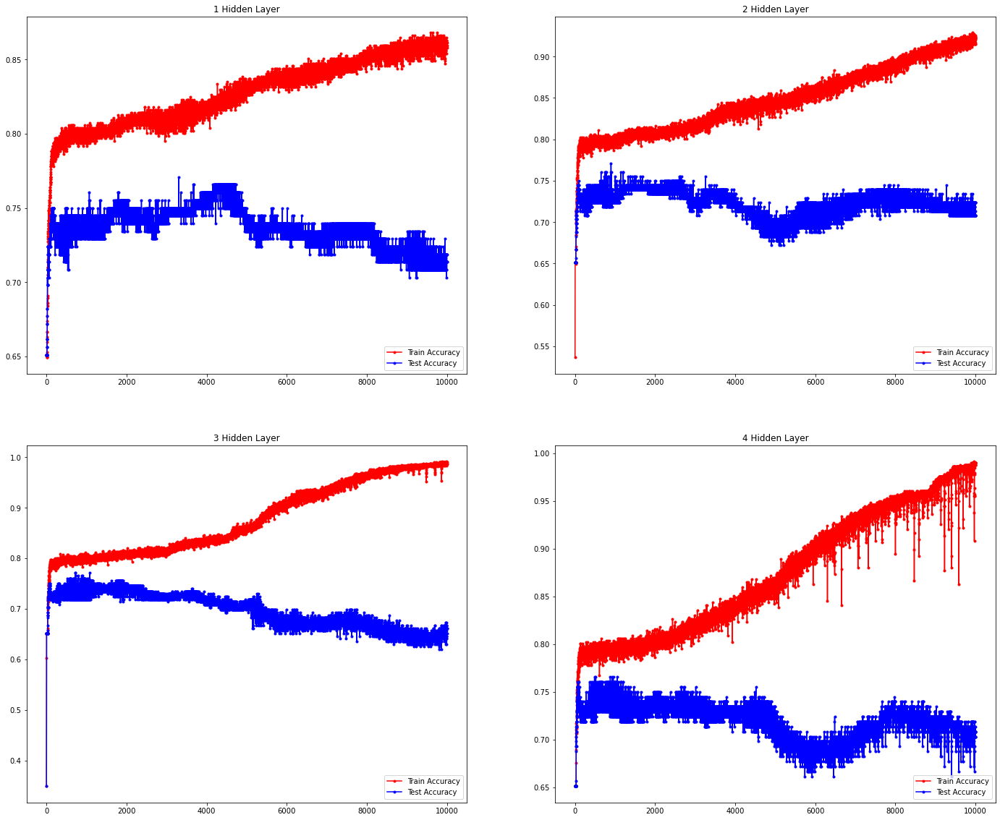

In [201]:
fig, axes = plt.subplots(2, 2, figsize=(24, 20))

for i in range (0, n_model):
    ax = plt.subplot(2, 2, i+1) 
    ax.plot(run_hist_Adam[i].history["accuracy"],'r', marker='.', label="Train Accuracy")
    ax.plot(run_hist_Adam[i].history["val_accuracy"],'b', marker='.', label="Test Accuracy")
    ax.legend(loc = 'lower right')
    title = str(i + 1) + ' Hidden Layer'
    ax.title.set_text(title)

In [220]:
print('Optimizer = Adam:\n')

for i in range (0, 4):
    print('Model [', i, '] (', str(i + 1), 'Hidden Layer(s)):')
    print(model_Adam[i].summary())
    print('\n')

Optimizer = Adam:

Model [ 0 ] ( 1 Hidden Layer(s)):
Model: "sequential_15"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_27 (Dense)             (None, 12)                108       
_________________________________________________________________
dense_28 (Dense)             (None, 1)                 13        
Total params: 121
Trainable params: 121
Non-trainable params: 0
_________________________________________________________________
None


Model [ 1 ] ( 2 Hidden Layer(s)):
Model: "sequential_16"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_29 (Dense)             (None, 12)                108       
_________________________________________________________________
dense_30 (Dense)             (None, 12)                156       
_________________________________________________________________
dens

In [222]:
print('Optimizer = Adam:\n')

print('Adam Train Accuracy:')
for i in range (0, 4):
    print(str(i + 1), ' Hidden Layer: ', max(run_hist_Adam[i].history["accuracy"]))
print('\n')
print('Adam Test Accuracy:')
for i in range (0, 4):
    print(str(i + 1), ' Hidden Layer: ', max(run_hist_Adam[i].history["val_accuracy"]))

Optimizer = Adam:

Adam Train Accuracy:
1  Hidden Layer:  0.8680556
2  Hidden Layer:  0.9288194
3  Hidden Layer:  0.9913194
4  Hidden Layer:  0.9913194


Adam Test Accuracy:
1  Hidden Layer:  0.7708333
2  Hidden Layer:  0.7708333
3  Hidden Layer:  0.7708333
4  Hidden Layer:  0.765625


### 5.3. OPTIMIZER = RMSPROP

In [223]:
model_rmsprop = []
run_hist_rmsprop = []

for i in range(0, n_model):
    # initialize the model
    model_rmsprop.append(Sequential())
    
    # add hidden layer
    for j in range(0, i + 1):
        model_rmsprop[i].add(Dense(12,input_shape = (8,),activation = 'sigmoid'))
    
    # add output layer
    model_rmsprop[i].add(Dense(1,activation='sigmoid'))
    
    model_rmsprop[i].compile(RMSprop(lr = .003), "binary_crossentropy", metrics = ["accuracy"])
    run_hist_rmsprop.append(model_rmsprop[i].fit(X_train, y_train, validation_data = (X_test, y_test), epochs = n_epoch))

Train on 576 samples, validate on 192 samples
Epoch 1/10000
576/576 [==============================] - 0s 620us/sample - loss: 0.7231 - accuracy: 0.4080 - val_loss: 0.6790 - val_accuracy: 0.6510
Epoch 2/10000
576/576 [==============================] - 0s 68us/sample - loss: 0.6665 - accuracy: 0.6510 - val_loss: 0.6562 - val_accuracy: 0.6510
Epoch 3/10000
576/576 [==============================] - 0s 78us/sample - loss: 0.6530 - accuracy: 0.6510 - val_loss: 0.6495 - val_accuracy: 0.6510
Epoch 4/10000
576/576 [==============================] - 0s 78us/sample - loss: 0.6484 - accuracy: 0.6510 - val_loss: 0.6454 - val_accuracy: 0.6510
Epoch 5/10000
576/576 [==============================] - 0s 73us/sample - loss: 0.6444 - accuracy: 0.6510 - val_loss: 0.6422 - val_accuracy: 0.6510
Epoch 6/10000
576/576 [==============================] - 0s 71us/sample - loss: 0.6408 - accuracy: 0.6510 - val_loss: 0.6386 - val_accuracy: 0.6510
Epoch 7/10000
576/576 [==============================] - 0s 75us/

Epoch 56/10000
576/576 [==============================] - 0s 62us/sample - loss: 0.5263 - accuracy: 0.7344 - val_loss: 0.5303 - val_accuracy: 0.7083
Epoch 57/10000
576/576 [==============================] - 0s 64us/sample - loss: 0.5240 - accuracy: 0.7344 - val_loss: 0.5297 - val_accuracy: 0.7135
Epoch 58/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.5235 - accuracy: 0.7378 - val_loss: 0.5286 - val_accuracy: 0.7135
Epoch 59/10000
576/576 [==============================] - 0s 68us/sample - loss: 0.5230 - accuracy: 0.7396 - val_loss: 0.5272 - val_accuracy: 0.7031
Epoch 60/10000
576/576 [==============================] - 0s 54us/sample - loss: 0.5210 - accuracy: 0.7361 - val_loss: 0.5265 - val_accuracy: 0.7083
Epoch 61/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.5204 - accuracy: 0.7396 - val_loss: 0.5250 - val_accuracy: 0.7031
Epoch 62/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.5195 - accuracy: 0.7448

Epoch 111/10000
576/576 [==============================] - 0s 68us/sample - loss: 0.4855 - accuracy: 0.7778 - val_loss: 0.4898 - val_accuracy: 0.7396
Epoch 112/10000
576/576 [==============================] - 0s 63us/sample - loss: 0.4852 - accuracy: 0.7795 - val_loss: 0.4888 - val_accuracy: 0.7344
Epoch 113/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.4851 - accuracy: 0.7726 - val_loss: 0.4886 - val_accuracy: 0.7448
Epoch 114/10000
576/576 [==============================] - 0s 64us/sample - loss: 0.4841 - accuracy: 0.7708 - val_loss: 0.4882 - val_accuracy: 0.7240
Epoch 115/10000
576/576 [==============================] - 0s 62us/sample - loss: 0.4835 - accuracy: 0.7778 - val_loss: 0.4883 - val_accuracy: 0.7396
Epoch 116/10000
576/576 [==============================] - 0s 69us/sample - loss: 0.4846 - accuracy: 0.7760 - val_loss: 0.4875 - val_accuracy: 0.7448
Epoch 117/10000
576/576 [==============================] - 0s 99us/sample - loss: 0.4830 - accuracy:

Epoch 220/10000
576/576 [==============================] - 0s 87us/sample - loss: 0.4676 - accuracy: 0.7969 - val_loss: 0.4708 - val_accuracy: 0.7448
Epoch 221/10000
576/576 [==============================] - 0s 82us/sample - loss: 0.4681 - accuracy: 0.7951 - val_loss: 0.4696 - val_accuracy: 0.7396
Epoch 222/10000
576/576 [==============================] - 0s 87us/sample - loss: 0.4678 - accuracy: 0.7917 - val_loss: 0.4697 - val_accuracy: 0.7448
Epoch 223/10000
576/576 [==============================] - 0s 80us/sample - loss: 0.4668 - accuracy: 0.7917 - val_loss: 0.4695 - val_accuracy: 0.7344
Epoch 224/10000
576/576 [==============================] - 0s 69us/sample - loss: 0.4683 - accuracy: 0.7969 - val_loss: 0.4697 - val_accuracy: 0.7240
Epoch 225/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.4678 - accuracy: 0.7899 - val_loss: 0.4694 - val_accuracy: 0.7344
Epoch 226/10000
576/576 [==============================] - 0s 54us/sample - loss: 0.4670 - accuracy:

Epoch 329/10000
576/576 [==============================] - 0s 56us/sample - loss: 0.4610 - accuracy: 0.7934 - val_loss: 0.4633 - val_accuracy: 0.7344
Epoch 330/10000
576/576 [==============================] - 0s 52us/sample - loss: 0.4609 - accuracy: 0.7917 - val_loss: 0.4639 - val_accuracy: 0.7344
Epoch 331/10000
576/576 [==============================] - 0s 56us/sample - loss: 0.4594 - accuracy: 0.7969 - val_loss: 0.4635 - val_accuracy: 0.7396
Epoch 332/10000
576/576 [==============================] - 0s 56us/sample - loss: 0.4619 - accuracy: 0.7934 - val_loss: 0.4628 - val_accuracy: 0.7240
Epoch 333/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.4605 - accuracy: 0.7986 - val_loss: 0.4632 - val_accuracy: 0.7344
Epoch 334/10000
576/576 [==============================] - 0s 54us/sample - loss: 0.4617 - accuracy: 0.7934 - val_loss: 0.4628 - val_accuracy: 0.7344
Epoch 335/10000
576/576 [==============================] - 0s 54us/sample - loss: 0.4610 - accuracy:

Epoch 438/10000
576/576 [==============================] - 0s 54us/sample - loss: 0.4544 - accuracy: 0.7969 - val_loss: 0.4580 - val_accuracy: 0.7344
Epoch 439/10000
576/576 [==============================] - 0s 54us/sample - loss: 0.4551 - accuracy: 0.7969 - val_loss: 0.4565 - val_accuracy: 0.7240
Epoch 440/10000
576/576 [==============================] - 0s 50us/sample - loss: 0.4555 - accuracy: 0.7951 - val_loss: 0.4558 - val_accuracy: 0.7500
Epoch 441/10000
576/576 [==============================] - 0s 54us/sample - loss: 0.4555 - accuracy: 0.7951 - val_loss: 0.4562 - val_accuracy: 0.7240
Epoch 442/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.4550 - accuracy: 0.7899 - val_loss: 0.4569 - val_accuracy: 0.7292
Epoch 443/10000
576/576 [==============================] - 0s 56us/sample - loss: 0.4540 - accuracy: 0.7951 - val_loss: 0.4562 - val_accuracy: 0.7500
Epoch 444/10000
576/576 [==============================] - 0s 54us/sample - loss: 0.4557 - accuracy:

Epoch 547/10000
576/576 [==============================] - 0s 54us/sample - loss: 0.4508 - accuracy: 0.7986 - val_loss: 0.4523 - val_accuracy: 0.7396
Epoch 548/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.4514 - accuracy: 0.8021 - val_loss: 0.4516 - val_accuracy: 0.7344
Epoch 549/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.4513 - accuracy: 0.8021 - val_loss: 0.4517 - val_accuracy: 0.7500
Epoch 550/10000
576/576 [==============================] - 0s 62us/sample - loss: 0.4507 - accuracy: 0.7899 - val_loss: 0.4521 - val_accuracy: 0.7500
Epoch 551/10000
576/576 [==============================] - 0s 56us/sample - loss: 0.4506 - accuracy: 0.7986 - val_loss: 0.4518 - val_accuracy: 0.7500
Epoch 552/10000
576/576 [==============================] - 0s 62us/sample - loss: 0.4515 - accuracy: 0.7986 - val_loss: 0.4516 - val_accuracy: 0.7448
Epoch 553/10000
576/576 [==============================] - 0s 64us/sample - loss: 0.4507 - accuracy:

576/576 [==============================] - 0s 54us/sample - loss: 0.4493 - accuracy: 0.8003 - val_loss: 0.4510 - val_accuracy: 0.7448
Epoch 656/10000
576/576 [==============================] - 0s 52us/sample - loss: 0.4480 - accuracy: 0.8003 - val_loss: 0.4515 - val_accuracy: 0.7396
Epoch 657/10000
576/576 [==============================] - 0s 56us/sample - loss: 0.4477 - accuracy: 0.7969 - val_loss: 0.4507 - val_accuracy: 0.7396
Epoch 658/10000
576/576 [==============================] - 0s 56us/sample - loss: 0.4477 - accuracy: 0.8021 - val_loss: 0.4527 - val_accuracy: 0.7344
Epoch 659/10000
576/576 [==============================] - 0s 56us/sample - loss: 0.4488 - accuracy: 0.7951 - val_loss: 0.4509 - val_accuracy: 0.7448
Epoch 660/10000
576/576 [==============================] - 0s 55us/sample - loss: 0.4463 - accuracy: 0.8038 - val_loss: 0.4511 - val_accuracy: 0.7448
Epoch 661/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.4480 - accuracy: 0.7986 - val_lo

Epoch 710/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.4474 - accuracy: 0.7934 - val_loss: 0.4509 - val_accuracy: 0.7500
Epoch 711/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.4462 - accuracy: 0.8003 - val_loss: 0.4507 - val_accuracy: 0.7448
Epoch 712/10000
576/576 [==============================] - ETA: 0s - loss: 0.3331 - accuracy: 0.93 - 0s 57us/sample - loss: 0.4469 - accuracy: 0.7986 - val_loss: 0.4510 - val_accuracy: 0.7500
Epoch 713/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.4461 - accuracy: 0.7934 - val_loss: 0.4509 - val_accuracy: 0.7448
Epoch 714/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.4472 - accuracy: 0.8003 - val_loss: 0.4510 - val_accuracy: 0.7500
Epoch 715/10000
576/576 [==============================] - 0s 56us/sample - loss: 0.4474 - accuracy: 0.7951 - val_loss: 0.4517 - val_accuracy: 0.7396
Epoch 716/10000
576/576 [==============================] -

576/576 [==============================] - 0s 57us/sample - loss: 0.4458 - accuracy: 0.7934 - val_loss: 0.4511 - val_accuracy: 0.7448
Epoch 765/10000
576/576 [==============================] - 0s 63us/sample - loss: 0.4455 - accuracy: 0.8003 - val_loss: 0.4513 - val_accuracy: 0.7448
Epoch 766/10000
576/576 [==============================] - 0s 63us/sample - loss: 0.4453 - accuracy: 0.7969 - val_loss: 0.4513 - val_accuracy: 0.7448
Epoch 767/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.4459 - accuracy: 0.7951 - val_loss: 0.4527 - val_accuracy: 0.7396
Epoch 768/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.4452 - accuracy: 0.7951 - val_loss: 0.4520 - val_accuracy: 0.7396
Epoch 769/10000
576/576 [==============================] - 0s 62us/sample - loss: 0.4453 - accuracy: 0.7969 - val_loss: 0.4513 - val_accuracy: 0.7396
Epoch 770/10000
576/576 [==============================] - 0s 63us/sample - loss: 0.4457 - accuracy: 0.7969 - val_lo

Epoch 819/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.4443 - accuracy: 0.7969 - val_loss: 0.4523 - val_accuracy: 0.7448
Epoch 820/10000
576/576 [==============================] - 0s 56us/sample - loss: 0.4444 - accuracy: 0.7969 - val_loss: 0.4522 - val_accuracy: 0.7448
Epoch 821/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.4434 - accuracy: 0.7934 - val_loss: 0.4535 - val_accuracy: 0.7344
Epoch 822/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.4449 - accuracy: 0.7986 - val_loss: 0.4524 - val_accuracy: 0.7500
Epoch 823/10000
576/576 [==============================] - 0s 56us/sample - loss: 0.4436 - accuracy: 0.7986 - val_loss: 0.4538 - val_accuracy: 0.7396
Epoch 824/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.4450 - accuracy: 0.7951 - val_loss: 0.4530 - val_accuracy: 0.7396
Epoch 825/10000
576/576 [==============================] - 0s 54us/sample - loss: 0.4441 - accuracy:

Epoch 928/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.4417 - accuracy: 0.8038 - val_loss: 0.4544 - val_accuracy: 0.7448
Epoch 929/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.4423 - accuracy: 0.7969 - val_loss: 0.4544 - val_accuracy: 0.7448
Epoch 930/10000
576/576 [==============================] - 0s 56us/sample - loss: 0.4424 - accuracy: 0.8021 - val_loss: 0.4544 - val_accuracy: 0.7448
Epoch 931/10000
576/576 [==============================] - 0s 54us/sample - loss: 0.4415 - accuracy: 0.7986 - val_loss: 0.4545 - val_accuracy: 0.7396
Epoch 932/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.4422 - accuracy: 0.7969 - val_loss: 0.4547 - val_accuracy: 0.7448
Epoch 933/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.4427 - accuracy: 0.7934 - val_loss: 0.4545 - val_accuracy: 0.7448
Epoch 934/10000
576/576 [==============================] - 0s 64us/sample - loss: 0.4419 - accuracy:

576/576 [==============================] - 0s 57us/sample - loss: 0.4404 - accuracy: 0.7917 - val_loss: 0.4570 - val_accuracy: 0.7448
Epoch 1037/10000
576/576 [==============================] - 0s 56us/sample - loss: 0.4393 - accuracy: 0.8021 - val_loss: 0.4571 - val_accuracy: 0.7396
Epoch 1038/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.4375 - accuracy: 0.8003 - val_loss: 0.4605 - val_accuracy: 0.7292
Epoch 1039/10000
576/576 [==============================] - 0s 56us/sample - loss: 0.4407 - accuracy: 0.8056 - val_loss: 0.4572 - val_accuracy: 0.7448
Epoch 1040/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.4397 - accuracy: 0.7951 - val_loss: 0.4576 - val_accuracy: 0.7396
Epoch 1041/10000
576/576 [==============================] - 0s 54us/sample - loss: 0.4393 - accuracy: 0.7969 - val_loss: 0.4574 - val_accuracy: 0.7344
Epoch 1042/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.4391 - accuracy: 0.7986 - 

576/576 [==============================] - 0s 59us/sample - loss: 0.4389 - accuracy: 0.7969 - val_loss: 0.4588 - val_accuracy: 0.7500
Epoch 1145/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.4382 - accuracy: 0.8003 - val_loss: 0.4590 - val_accuracy: 0.7448
Epoch 1146/10000
576/576 [==============================] - 0s 63us/sample - loss: 0.4376 - accuracy: 0.7951 - val_loss: 0.4605 - val_accuracy: 0.7240
Epoch 1147/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.4387 - accuracy: 0.7969 - val_loss: 0.4591 - val_accuracy: 0.7448
Epoch 1148/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.4376 - accuracy: 0.8003 - val_loss: 0.4590 - val_accuracy: 0.7448
Epoch 1149/10000
576/576 [==============================] - 0s 56us/sample - loss: 0.4377 - accuracy: 0.7986 - val_loss: 0.4591 - val_accuracy: 0.7396
Epoch 1150/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.4379 - accuracy: 0.7986 - 

576/576 [==============================] - 0s 57us/sample - loss: 0.4353 - accuracy: 0.8021 - val_loss: 0.4614 - val_accuracy: 0.7448
Epoch 1253/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.4369 - accuracy: 0.7934 - val_loss: 0.4613 - val_accuracy: 0.7448
Epoch 1254/10000
576/576 [==============================] - 0s 83us/sample - loss: 0.4353 - accuracy: 0.7951 - val_loss: 0.4618 - val_accuracy: 0.7500
Epoch 1255/10000
576/576 [==============================] - 0s 85us/sample - loss: 0.4364 - accuracy: 0.7951 - val_loss: 0.4615 - val_accuracy: 0.7396
Epoch 1256/10000
576/576 [==============================] - 0s 82us/sample - loss: 0.4359 - accuracy: 0.7986 - val_loss: 0.4615 - val_accuracy: 0.7396
Epoch 1257/10000
576/576 [==============================] - 0s 80us/sample - loss: 0.4376 - accuracy: 0.7951 - val_loss: 0.4615 - val_accuracy: 0.7448
Epoch 1258/10000
576/576 [==============================] - 0s 80us/sample - loss: 0.4363 - accuracy: 0.7934 - 

576/576 [==============================] - 0s 57us/sample - loss: 0.4343 - accuracy: 0.8056 - val_loss: 0.4629 - val_accuracy: 0.7344
Epoch 1361/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.4340 - accuracy: 0.8003 - val_loss: 0.4635 - val_accuracy: 0.7344
Epoch 1362/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.4346 - accuracy: 0.8021 - val_loss: 0.4628 - val_accuracy: 0.7500
Epoch 1363/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.4345 - accuracy: 0.7969 - val_loss: 0.4625 - val_accuracy: 0.7396
Epoch 1364/10000
576/576 [==============================] - ETA: 0s - loss: 0.4227 - accuracy: 0.78 - 0s 63us/sample - loss: 0.4341 - accuracy: 0.8021 - val_loss: 0.4626 - val_accuracy: 0.7344
Epoch 1365/10000
576/576 [==============================] - 0s 63us/sample - loss: 0.4345 - accuracy: 0.8021 - val_loss: 0.4628 - val_accuracy: 0.7448
Epoch 1366/10000
576/576 [==============================] - 0s 59us/s

576/576 [==============================] - 0s 68us/sample - loss: 0.4336 - accuracy: 0.7986 - val_loss: 0.4628 - val_accuracy: 0.7344
Epoch 1415/10000
576/576 [==============================] - 0s 62us/sample - loss: 0.4331 - accuracy: 0.8038 - val_loss: 0.4627 - val_accuracy: 0.7344
Epoch 1416/10000
576/576 [==============================] - 0s 73us/sample - loss: 0.4330 - accuracy: 0.7951 - val_loss: 0.4642 - val_accuracy: 0.7344
Epoch 1417/10000
576/576 [==============================] - 0s 76us/sample - loss: 0.4339 - accuracy: 0.7986 - val_loss: 0.4626 - val_accuracy: 0.7292
Epoch 1418/10000
576/576 [==============================] - 0s 89us/sample - loss: 0.4345 - accuracy: 0.7986 - val_loss: 0.4627 - val_accuracy: 0.7344
Epoch 1419/10000
576/576 [==============================] - 0s 75us/sample - loss: 0.4332 - accuracy: 0.7951 - val_loss: 0.4629 - val_accuracy: 0.7448
Epoch 1420/10000
576/576 [==============================] - 0s 71us/sample - loss: 0.4326 - accuracy: 0.7986 - 

576/576 [==============================] - 0s 94us/sample - loss: 0.4325 - accuracy: 0.7986 - val_loss: 0.4631 - val_accuracy: 0.7344
Epoch 1469/10000
576/576 [==============================] - 0s 95us/sample - loss: 0.4320 - accuracy: 0.8056 - val_loss: 0.4650 - val_accuracy: 0.7344
Epoch 1470/10000
576/576 [==============================] - 0s 95us/sample - loss: 0.4333 - accuracy: 0.7951 - val_loss: 0.4632 - val_accuracy: 0.7344
Epoch 1471/10000
576/576 [==============================] - 0s 75us/sample - loss: 0.4332 - accuracy: 0.7917 - val_loss: 0.4637 - val_accuracy: 0.7292
Epoch 1472/10000
576/576 [==============================] - 0s 62us/sample - loss: 0.4328 - accuracy: 0.8003 - val_loss: 0.4632 - val_accuracy: 0.7344
Epoch 1473/10000
576/576 [==============================] - 0s 64us/sample - loss: 0.4327 - accuracy: 0.8038 - val_loss: 0.4637 - val_accuracy: 0.7292
Epoch 1474/10000
576/576 [==============================] - 0s 64us/sample - loss: 0.4334 - accuracy: 0.7969 - 

576/576 [==============================] - 0s 80us/sample - loss: 0.4310 - accuracy: 0.8073 - val_loss: 0.4640 - val_accuracy: 0.7292
Epoch 1577/10000
576/576 [==============================] - 0s 71us/sample - loss: 0.4306 - accuracy: 0.7986 - val_loss: 0.4633 - val_accuracy: 0.7396
Epoch 1578/10000
576/576 [==============================] - 0s 87us/sample - loss: 0.4311 - accuracy: 0.8056 - val_loss: 0.4636 - val_accuracy: 0.7396
Epoch 1579/10000
576/576 [==============================] - 0s 68us/sample - loss: 0.4306 - accuracy: 0.8003 - val_loss: 0.4633 - val_accuracy: 0.7344
Epoch 1580/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.4303 - accuracy: 0.8003 - val_loss: 0.4633 - val_accuracy: 0.7240
Epoch 1581/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.4308 - accuracy: 0.8038 - val_loss: 0.4637 - val_accuracy: 0.7344
Epoch 1582/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.4296 - accuracy: 0.7969 - 

576/576 [==============================] - 0s 66us/sample - loss: 0.4297 - accuracy: 0.8003 - val_loss: 0.4632 - val_accuracy: 0.7396
Epoch 1685/10000
576/576 [==============================] - 0s 64us/sample - loss: 0.4296 - accuracy: 0.8021 - val_loss: 0.4632 - val_accuracy: 0.7396
Epoch 1686/10000
576/576 [==============================] - 0s 63us/sample - loss: 0.4289 - accuracy: 0.8038 - val_loss: 0.4637 - val_accuracy: 0.7344
Epoch 1687/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.4288 - accuracy: 0.7986 - val_loss: 0.4649 - val_accuracy: 0.7448
Epoch 1688/10000
576/576 [==============================] - 0s 63us/sample - loss: 0.4299 - accuracy: 0.7986 - val_loss: 0.4633 - val_accuracy: 0.7396
Epoch 1689/10000
576/576 [==============================] - 0s 63us/sample - loss: 0.4289 - accuracy: 0.7951 - val_loss: 0.4635 - val_accuracy: 0.7396
Epoch 1690/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.4288 - accuracy: 0.8021 - 

576/576 [==============================] - 0s 76us/sample - loss: 0.4273 - accuracy: 0.8003 - val_loss: 0.4632 - val_accuracy: 0.7396
Epoch 1793/10000
576/576 [==============================] - 0s 78us/sample - loss: 0.4279 - accuracy: 0.8056 - val_loss: 0.4630 - val_accuracy: 0.7396
Epoch 1794/10000
576/576 [==============================] - 0s 69us/sample - loss: 0.4276 - accuracy: 0.8038 - val_loss: 0.4633 - val_accuracy: 0.7396
Epoch 1795/10000
576/576 [==============================] - 0s 66us/sample - loss: 0.4286 - accuracy: 0.8003 - val_loss: 0.4631 - val_accuracy: 0.7396
Epoch 1796/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.4267 - accuracy: 0.8021 - val_loss: 0.4640 - val_accuracy: 0.7448
Epoch 1797/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.4283 - accuracy: 0.8021 - val_loss: 0.4632 - val_accuracy: 0.7396
Epoch 1798/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.4277 - accuracy: 0.8021 - 

576/576 [==============================] - 0s 57us/sample - loss: 0.4259 - accuracy: 0.8038 - val_loss: 0.4636 - val_accuracy: 0.7448
Epoch 1901/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.4254 - accuracy: 0.8003 - val_loss: 0.4632 - val_accuracy: 0.7448
Epoch 1902/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.4254 - accuracy: 0.8073 - val_loss: 0.4633 - val_accuracy: 0.7396
Epoch 1903/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.4259 - accuracy: 0.8108 - val_loss: 0.4631 - val_accuracy: 0.7396
Epoch 1904/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.4248 - accuracy: 0.8056 - val_loss: 0.4636 - val_accuracy: 0.7448
Epoch 1905/10000
576/576 [==============================] - 0s 63us/sample - loss: 0.4269 - accuracy: 0.8021 - val_loss: 0.4630 - val_accuracy: 0.7396
Epoch 1906/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.4258 - accuracy: 0.8073 - 

576/576 [==============================] - 0s 57us/sample - loss: 0.4235 - accuracy: 0.8056 - val_loss: 0.4638 - val_accuracy: 0.7500
Epoch 2009/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.4234 - accuracy: 0.8056 - val_loss: 0.4638 - val_accuracy: 0.7344
Epoch 2010/10000
576/576 [==============================] - 0s 54us/sample - loss: 0.4228 - accuracy: 0.8073 - val_loss: 0.4639 - val_accuracy: 0.7500
Epoch 2011/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.4239 - accuracy: 0.8056 - val_loss: 0.4640 - val_accuracy: 0.7292
Epoch 2012/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.4234 - accuracy: 0.8073 - val_loss: 0.4638 - val_accuracy: 0.7448
Epoch 2013/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.4234 - accuracy: 0.8021 - val_loss: 0.4641 - val_accuracy: 0.7396
Epoch 2014/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.4227 - accuracy: 0.8056 - 

576/576 [==============================] - 0s 63us/sample - loss: 0.4217 - accuracy: 0.8003 - val_loss: 0.4642 - val_accuracy: 0.7448
Epoch 2117/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.4213 - accuracy: 0.8038 - val_loss: 0.4643 - val_accuracy: 0.7500
Epoch 2118/10000
576/576 [==============================] - 0s 68us/sample - loss: 0.4211 - accuracy: 0.8073 - val_loss: 0.4645 - val_accuracy: 0.7240
Epoch 2119/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.4219 - accuracy: 0.8038 - val_loss: 0.4643 - val_accuracy: 0.7500
Epoch 2120/10000
576/576 [==============================] - 0s 63us/sample - loss: 0.4205 - accuracy: 0.8056 - val_loss: 0.4645 - val_accuracy: 0.7292
Epoch 2121/10000
576/576 [==============================] - 0s 62us/sample - loss: 0.4222 - accuracy: 0.8056 - val_loss: 0.4642 - val_accuracy: 0.7500
Epoch 2122/10000
576/576 [==============================] - 0s 66us/sample - loss: 0.4206 - accuracy: 0.8125 - 

576/576 [==============================] - 0s 62us/sample - loss: 0.4182 - accuracy: 0.8073 - val_loss: 0.4652 - val_accuracy: 0.7344
Epoch 2225/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.4188 - accuracy: 0.8056 - val_loss: 0.4654 - val_accuracy: 0.7396
Epoch 2226/10000
576/576 [==============================] - 0s 66us/sample - loss: 0.4184 - accuracy: 0.8090 - val_loss: 0.4652 - val_accuracy: 0.7500
Epoch 2227/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.4183 - accuracy: 0.8073 - val_loss: 0.4654 - val_accuracy: 0.7396
Epoch 2228/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.4187 - accuracy: 0.8125 - val_loss: 0.4652 - val_accuracy: 0.7344
Epoch 2229/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.4180 - accuracy: 0.8108 - val_loss: 0.4662 - val_accuracy: 0.7604
Epoch 2230/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.4183 - accuracy: 0.8142 - 

576/576 [==============================] - 0s 71us/sample - loss: 0.4173 - accuracy: 0.8090 - val_loss: 0.4663 - val_accuracy: 0.7448
Epoch 2333/10000
576/576 [==============================] - 0s 63us/sample - loss: 0.4164 - accuracy: 0.8038 - val_loss: 0.4664 - val_accuracy: 0.7448
Epoch 2334/10000
576/576 [==============================] - 0s 62us/sample - loss: 0.4165 - accuracy: 0.8090 - val_loss: 0.4664 - val_accuracy: 0.7448
Epoch 2335/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.4161 - accuracy: 0.8056 - val_loss: 0.4667 - val_accuracy: 0.7500
Epoch 2336/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.4170 - accuracy: 0.8090 - val_loss: 0.4664 - val_accuracy: 0.7448
Epoch 2337/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.4174 - accuracy: 0.8073 - val_loss: 0.4666 - val_accuracy: 0.7448
Epoch 2338/10000
576/576 [==============================] - 0s 63us/sample - loss: 0.4163 - accuracy: 0.8142 - 

576/576 [==============================] - 0s 56us/sample - loss: 0.4141 - accuracy: 0.8108 - val_loss: 0.4682 - val_accuracy: 0.7448
Epoch 2441/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.4135 - accuracy: 0.8108 - val_loss: 0.4688 - val_accuracy: 0.7552
Epoch 2442/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.4145 - accuracy: 0.8125 - val_loss: 0.4685 - val_accuracy: 0.7500
Epoch 2443/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.4130 - accuracy: 0.8090 - val_loss: 0.4686 - val_accuracy: 0.7500
Epoch 2444/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.4147 - accuracy: 0.8142 - val_loss: 0.4685 - val_accuracy: 0.7500
Epoch 2445/10000
576/576 [==============================] - 0s 56us/sample - loss: 0.4134 - accuracy: 0.8073 - val_loss: 0.4683 - val_accuracy: 0.7448
Epoch 2446/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.4138 - accuracy: 0.8090 - 

576/576 [==============================] - 0s 62us/sample - loss: 0.4114 - accuracy: 0.8108 - val_loss: 0.4708 - val_accuracy: 0.7448
Epoch 2549/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.4110 - accuracy: 0.8108 - val_loss: 0.4718 - val_accuracy: 0.7448
Epoch 2550/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.4117 - accuracy: 0.8142 - val_loss: 0.4710 - val_accuracy: 0.7500
Epoch 2551/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.4106 - accuracy: 0.8160 - val_loss: 0.4721 - val_accuracy: 0.7396
Epoch 2552/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.4114 - accuracy: 0.8108 - val_loss: 0.4720 - val_accuracy: 0.7396
Epoch 2553/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.4112 - accuracy: 0.8108 - val_loss: 0.4709 - val_accuracy: 0.7500
Epoch 2554/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.4107 - accuracy: 0.8090 - 

576/576 [==============================] - 0s 61us/sample - loss: 0.4086 - accuracy: 0.8125 - val_loss: 0.4732 - val_accuracy: 0.7448
Epoch 2657/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.4081 - accuracy: 0.8073 - val_loss: 0.4728 - val_accuracy: 0.7448
Epoch 2658/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.4091 - accuracy: 0.8142 - val_loss: 0.4727 - val_accuracy: 0.7500
Epoch 2659/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.4088 - accuracy: 0.8108 - val_loss: 0.4728 - val_accuracy: 0.7448
Epoch 2660/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.4094 - accuracy: 0.8142 - val_loss: 0.4729 - val_accuracy: 0.7500
Epoch 2661/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.4085 - accuracy: 0.8142 - val_loss: 0.4729 - val_accuracy: 0.7552
Epoch 2662/10000
576/576 [==============================] - 0s 63us/sample - loss: 0.4093 - accuracy: 0.8125 - 

576/576 [==============================] - 0s 64us/sample - loss: 0.4065 - accuracy: 0.8125 - val_loss: 0.4752 - val_accuracy: 0.7552
Epoch 2765/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.4062 - accuracy: 0.8142 - val_loss: 0.4753 - val_accuracy: 0.7500
Epoch 2766/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.4070 - accuracy: 0.8177 - val_loss: 0.4751 - val_accuracy: 0.7500
Epoch 2767/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.4059 - accuracy: 0.8160 - val_loss: 0.4750 - val_accuracy: 0.7448
Epoch 2768/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.4058 - accuracy: 0.8160 - val_loss: 0.4751 - val_accuracy: 0.7448
Epoch 2769/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.4058 - accuracy: 0.8108 - val_loss: 0.4751 - val_accuracy: 0.7500
Epoch 2770/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.4066 - accuracy: 0.8090 - 

576/576 [==============================] - 0s 61us/sample - loss: 0.4044 - accuracy: 0.8108 - val_loss: 0.4777 - val_accuracy: 0.7552
Epoch 2873/10000
576/576 [==============================] - 0s 69us/sample - loss: 0.4040 - accuracy: 0.8090 - val_loss: 0.4781 - val_accuracy: 0.7500
Epoch 2874/10000
576/576 [==============================] - 0s 63us/sample - loss: 0.4031 - accuracy: 0.8142 - val_loss: 0.4781 - val_accuracy: 0.7500
Epoch 2875/10000
576/576 [==============================] - 0s 64us/sample - loss: 0.4037 - accuracy: 0.8194 - val_loss: 0.4779 - val_accuracy: 0.7552
Epoch 2876/10000
576/576 [==============================] - 0s 69us/sample - loss: 0.4024 - accuracy: 0.8142 - val_loss: 0.4788 - val_accuracy: 0.7500
Epoch 2877/10000
576/576 [==============================] - 0s 62us/sample - loss: 0.4044 - accuracy: 0.8160 - val_loss: 0.4784 - val_accuracy: 0.7500
Epoch 2878/10000
576/576 [==============================] - 0s 68us/sample - loss: 0.4031 - accuracy: 0.8142 - 

576/576 [==============================] - 0s 64us/sample - loss: 0.4009 - accuracy: 0.8177 - val_loss: 0.4804 - val_accuracy: 0.7552
Epoch 2981/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.4009 - accuracy: 0.8090 - val_loss: 0.4803 - val_accuracy: 0.7500
Epoch 2982/10000
576/576 [==============================] - 0s 62us/sample - loss: 0.4011 - accuracy: 0.8125 - val_loss: 0.4804 - val_accuracy: 0.7500
Epoch 2983/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.4014 - accuracy: 0.8073 - val_loss: 0.4805 - val_accuracy: 0.7552
Epoch 2984/10000
576/576 [==============================] - 0s 68us/sample - loss: 0.4007 - accuracy: 0.8108 - val_loss: 0.4808 - val_accuracy: 0.7500
Epoch 2985/10000
576/576 [==============================] - 0s 62us/sample - loss: 0.4015 - accuracy: 0.8125 - val_loss: 0.4805 - val_accuracy: 0.7552
Epoch 2986/10000
576/576 [==============================] - 0s 63us/sample - loss: 0.4002 - accuracy: 0.8125 - 

576/576 [==============================] - 0s 61us/sample - loss: 0.3987 - accuracy: 0.8177 - val_loss: 0.4833 - val_accuracy: 0.7500
Epoch 3089/10000
576/576 [==============================] - 0s 56us/sample - loss: 0.3985 - accuracy: 0.8108 - val_loss: 0.4835 - val_accuracy: 0.7500
Epoch 3090/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.3988 - accuracy: 0.8212 - val_loss: 0.4847 - val_accuracy: 0.7500
Epoch 3091/10000
576/576 [==============================] - 0s 75us/sample - loss: 0.3987 - accuracy: 0.8108 - val_loss: 0.4833 - val_accuracy: 0.7552
Epoch 3092/10000
576/576 [==============================] - 0s 68us/sample - loss: 0.3985 - accuracy: 0.8125 - val_loss: 0.4832 - val_accuracy: 0.7552
Epoch 3093/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.3994 - accuracy: 0.8108 - val_loss: 0.4834 - val_accuracy: 0.7500
Epoch 3094/10000
576/576 [==============================] - 0s 69us/sample - loss: 0.3984 - accuracy: 0.8090 - 

576/576 [==============================] - 0s 56us/sample - loss: 0.3959 - accuracy: 0.8194 - val_loss: 0.4876 - val_accuracy: 0.7500
Epoch 3197/10000
576/576 [==============================] - 0s 54us/sample - loss: 0.3966 - accuracy: 0.8090 - val_loss: 0.4863 - val_accuracy: 0.7500
Epoch 3198/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.3973 - accuracy: 0.8073 - val_loss: 0.4863 - val_accuracy: 0.7552
Epoch 3199/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.3955 - accuracy: 0.8142 - val_loss: 0.4867 - val_accuracy: 0.7552
Epoch 3200/10000
576/576 [==============================] - 0s 62us/sample - loss: 0.3967 - accuracy: 0.8142 - val_loss: 0.4862 - val_accuracy: 0.7552
Epoch 3201/10000
576/576 [==============================] - 0s 56us/sample - loss: 0.3957 - accuracy: 0.8194 - val_loss: 0.4868 - val_accuracy: 0.7552
Epoch 3202/10000
576/576 [==============================] - 0s 56us/sample - loss: 0.3962 - accuracy: 0.8160 - 

576/576 [==============================] - 0s 59us/sample - loss: 0.3936 - accuracy: 0.8177 - val_loss: 0.4899 - val_accuracy: 0.7500
Epoch 3305/10000
576/576 [==============================] - 0s 62us/sample - loss: 0.3941 - accuracy: 0.8177 - val_loss: 0.4901 - val_accuracy: 0.7552
Epoch 3306/10000
576/576 [==============================] - 0s 54us/sample - loss: 0.3938 - accuracy: 0.8177 - val_loss: 0.4901 - val_accuracy: 0.7500
Epoch 3307/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.3923 - accuracy: 0.8229 - val_loss: 0.4915 - val_accuracy: 0.7448
Epoch 3308/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.3938 - accuracy: 0.8194 - val_loss: 0.4901 - val_accuracy: 0.7500
Epoch 3309/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.3936 - accuracy: 0.8177 - val_loss: 0.4902 - val_accuracy: 0.7552
Epoch 3310/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.3935 - accuracy: 0.8177 - 

576/576 [==============================] - 0s 61us/sample - loss: 0.3907 - accuracy: 0.8229 - val_loss: 0.4941 - val_accuracy: 0.7604
Epoch 3413/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.3910 - accuracy: 0.8229 - val_loss: 0.4944 - val_accuracy: 0.7500
Epoch 3414/10000
576/576 [==============================] - 0s 56us/sample - loss: 0.3917 - accuracy: 0.8160 - val_loss: 0.4943 - val_accuracy: 0.7500
Epoch 3415/10000
576/576 [==============================] - 0s 62us/sample - loss: 0.3914 - accuracy: 0.8212 - val_loss: 0.4939 - val_accuracy: 0.7552
Epoch 3416/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.3901 - accuracy: 0.8247 - val_loss: 0.4939 - val_accuracy: 0.7500
Epoch 3417/10000
576/576 [==============================] - 0s 62us/sample - loss: 0.3911 - accuracy: 0.8194 - val_loss: 0.4935 - val_accuracy: 0.7500
Epoch 3418/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.3912 - accuracy: 0.8160 - 

576/576 [==============================] - 0s 54us/sample - loss: 0.3890 - accuracy: 0.8212 - val_loss: 0.4984 - val_accuracy: 0.7448
Epoch 3521/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.3863 - accuracy: 0.8194 - val_loss: 0.4992 - val_accuracy: 0.7552
Epoch 3522/10000
576/576 [==============================] - 0s 55us/sample - loss: 0.3889 - accuracy: 0.8264 - val_loss: 0.4978 - val_accuracy: 0.7552
Epoch 3523/10000
576/576 [==============================] - 0s 54us/sample - loss: 0.3877 - accuracy: 0.8281 - val_loss: 0.4982 - val_accuracy: 0.7500
Epoch 3524/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.3882 - accuracy: 0.8212 - val_loss: 0.4984 - val_accuracy: 0.7448
Epoch 3525/10000
576/576 [==============================] - 0s 54us/sample - loss: 0.3888 - accuracy: 0.8229 - val_loss: 0.4980 - val_accuracy: 0.7448
Epoch 3526/10000
576/576 [==============================] - 0s 56us/sample - loss: 0.3888 - accuracy: 0.8316 - 

576/576 [==============================] - 0s 62us/sample - loss: 0.3872 - accuracy: 0.8194 - val_loss: 0.5012 - val_accuracy: 0.7500
Epoch 3629/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.3868 - accuracy: 0.8212 - val_loss: 0.5012 - val_accuracy: 0.7500
Epoch 3630/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.3867 - accuracy: 0.8281 - val_loss: 0.5014 - val_accuracy: 0.7500
Epoch 3631/10000
576/576 [==============================] - 0s 63us/sample - loss: 0.3858 - accuracy: 0.8247 - val_loss: 0.5015 - val_accuracy: 0.7448
Epoch 3632/10000
576/576 [==============================] - 0s 62us/sample - loss: 0.3863 - accuracy: 0.8247 - val_loss: 0.5013 - val_accuracy: 0.7500
Epoch 3633/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.3857 - accuracy: 0.8264 - val_loss: 0.5027 - val_accuracy: 0.7500
Epoch 3634/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.3848 - accuracy: 0.8212 - 

576/576 [==============================] - 0s 59us/sample - loss: 0.3838 - accuracy: 0.8247 - val_loss: 0.5049 - val_accuracy: 0.7500
Epoch 3737/10000
576/576 [==============================] - 0s 56us/sample - loss: 0.3840 - accuracy: 0.8212 - val_loss: 0.5047 - val_accuracy: 0.7500
Epoch 3738/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.3832 - accuracy: 0.8264 - val_loss: 0.5063 - val_accuracy: 0.7396
Epoch 3739/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.3830 - accuracy: 0.8229 - val_loss: 0.5052 - val_accuracy: 0.7500
Epoch 3740/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.3839 - accuracy: 0.8299 - val_loss: 0.5050 - val_accuracy: 0.7500
Epoch 3741/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.3842 - accuracy: 0.8247 - val_loss: 0.5048 - val_accuracy: 0.7500
Epoch 3742/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.3839 - accuracy: 0.8247 - 

576/576 [==============================] - 0s 61us/sample - loss: 0.3812 - accuracy: 0.8264 - val_loss: 0.5093 - val_accuracy: 0.7500
Epoch 3845/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.3807 - accuracy: 0.8281 - val_loss: 0.5084 - val_accuracy: 0.7500
Epoch 3846/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.3820 - accuracy: 0.8229 - val_loss: 0.5084 - val_accuracy: 0.7500
Epoch 3847/10000
576/576 [==============================] - 0s 62us/sample - loss: 0.3810 - accuracy: 0.8316 - val_loss: 0.5091 - val_accuracy: 0.7500
Epoch 3848/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3812 - accuracy: 0.8212 - val_loss: 0.5086 - val_accuracy: 0.7500
Epoch 3849/10000
576/576 [==============================] - 0s 75us/sample - loss: 0.3812 - accuracy: 0.8264 - val_loss: 0.5088 - val_accuracy: 0.7500
Epoch 3850/10000
576/576 [==============================] - 0s 56us/sample - loss: 0.3812 - accuracy: 0.8194 -

576/576 [==============================] - 0s 59us/sample - loss: 0.3785 - accuracy: 0.8264 - val_loss: 0.5127 - val_accuracy: 0.7552
Epoch 3953/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.3793 - accuracy: 0.8247 - val_loss: 0.5127 - val_accuracy: 0.7552
Epoch 3954/10000
576/576 [==============================] - 0s 55us/sample - loss: 0.3786 - accuracy: 0.8229 - val_loss: 0.5130 - val_accuracy: 0.7552
Epoch 3955/10000
576/576 [==============================] - 0s 56us/sample - loss: 0.3797 - accuracy: 0.8247 - val_loss: 0.5129 - val_accuracy: 0.7552
Epoch 3956/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.3786 - accuracy: 0.8299 - val_loss: 0.5136 - val_accuracy: 0.7448
Epoch 3957/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.3796 - accuracy: 0.8194 - val_loss: 0.5139 - val_accuracy: 0.7448
Epoch 3958/10000
576/576 [==============================] - 0s 56us/sample - loss: 0.3786 - accuracy: 0.8333 - 

576/576 [==============================] - 0s 59us/sample - loss: 0.3774 - accuracy: 0.8281 - val_loss: 0.5167 - val_accuracy: 0.7500
Epoch 4061/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.3767 - accuracy: 0.8299 - val_loss: 0.5165 - val_accuracy: 0.7500
Epoch 4062/10000
576/576 [==============================] - 0s 68us/sample - loss: 0.3760 - accuracy: 0.8299 - val_loss: 0.5165 - val_accuracy: 0.7552
Epoch 4063/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.3780 - accuracy: 0.8212 - val_loss: 0.5164 - val_accuracy: 0.7552
Epoch 4064/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.3765 - accuracy: 0.8247 - val_loss: 0.5167 - val_accuracy: 0.7500
Epoch 4065/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.3754 - accuracy: 0.8316 - val_loss: 0.5169 - val_accuracy: 0.7500
Epoch 4066/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.3764 - accuracy: 0.8316 - 

576/576 [==============================] - 0s 64us/sample - loss: 0.3740 - accuracy: 0.8299 - val_loss: 0.5216 - val_accuracy: 0.7292
Epoch 4169/10000
576/576 [==============================] - 0s 56us/sample - loss: 0.3749 - accuracy: 0.8351 - val_loss: 0.5201 - val_accuracy: 0.7448
Epoch 4170/10000
576/576 [==============================] - 0s 62us/sample - loss: 0.3740 - accuracy: 0.8299 - val_loss: 0.5199 - val_accuracy: 0.7604
Epoch 4171/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.3748 - accuracy: 0.8247 - val_loss: 0.5210 - val_accuracy: 0.7448
Epoch 4172/10000
576/576 [==============================] - 0s 64us/sample - loss: 0.3734 - accuracy: 0.8385 - val_loss: 0.5201 - val_accuracy: 0.7604
Epoch 4173/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.3743 - accuracy: 0.8229 - val_loss: 0.5211 - val_accuracy: 0.7448
Epoch 4174/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.3742 - accuracy: 0.8351 - 

576/576 [==============================] - 0s 56us/sample - loss: 0.3710 - accuracy: 0.8333 - val_loss: 0.5274 - val_accuracy: 0.7240
Epoch 4277/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.3731 - accuracy: 0.8385 - val_loss: 0.5256 - val_accuracy: 0.7344
Epoch 4278/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.3718 - accuracy: 0.8351 - val_loss: 0.5251 - val_accuracy: 0.7396
Epoch 4279/10000
576/576 [==============================] - 0s 54us/sample - loss: 0.3715 - accuracy: 0.8403 - val_loss: 0.5276 - val_accuracy: 0.7240
Epoch 4280/10000
576/576 [==============================] - 0s 63us/sample - loss: 0.3728 - accuracy: 0.8438 - val_loss: 0.5242 - val_accuracy: 0.7552
Epoch 4281/10000
576/576 [==============================] - 0s 64us/sample - loss: 0.3722 - accuracy: 0.8403 - val_loss: 0.5243 - val_accuracy: 0.7604
Epoch 4282/10000
576/576 [==============================] - 0s 64us/sample - loss: 0.3724 - accuracy: 0.8299 - 

576/576 [==============================] - 0s 59us/sample - loss: 0.3698 - accuracy: 0.8385 - val_loss: 0.5283 - val_accuracy: 0.7552
Epoch 4385/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.3710 - accuracy: 0.8385 - val_loss: 0.5285 - val_accuracy: 0.7500
Epoch 4386/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.3711 - accuracy: 0.8403 - val_loss: 0.5288 - val_accuracy: 0.7396
Epoch 4387/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.3703 - accuracy: 0.8351 - val_loss: 0.5285 - val_accuracy: 0.7500
Epoch 4388/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.3697 - accuracy: 0.8385 - val_loss: 0.5286 - val_accuracy: 0.7500
Epoch 4389/10000
576/576 [==============================] - 0s 62us/sample - loss: 0.3698 - accuracy: 0.8368 - val_loss: 0.5294 - val_accuracy: 0.7396
Epoch 4390/10000
576/576 [==============================] - 0s 56us/sample - loss: 0.3701 - accuracy: 0.8455 - 

576/576 [==============================] - 0s 66us/sample - loss: 0.3683 - accuracy: 0.8351 - val_loss: 0.5331 - val_accuracy: 0.7448
Epoch 4493/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.3687 - accuracy: 0.8385 - val_loss: 0.5330 - val_accuracy: 0.7448
Epoch 4494/10000
576/576 [==============================] - 0s 68us/sample - loss: 0.3690 - accuracy: 0.8420 - val_loss: 0.5330 - val_accuracy: 0.7448
Epoch 4495/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.3678 - accuracy: 0.8403 - val_loss: 0.5334 - val_accuracy: 0.7448
Epoch 4496/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.3679 - accuracy: 0.8438 - val_loss: 0.5333 - val_accuracy: 0.7448
Epoch 4497/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.3682 - accuracy: 0.8333 - val_loss: 0.5336 - val_accuracy: 0.7448
Epoch 4498/10000
576/576 [==============================] - 0s 69us/sample - loss: 0.3690 - accuracy: 0.8438 - 

576/576 [==============================] - 0s 62us/sample - loss: 0.3666 - accuracy: 0.8455 - val_loss: 0.5371 - val_accuracy: 0.7500
Epoch 4601/10000
576/576 [==============================] - 0s 62us/sample - loss: 0.3667 - accuracy: 0.8403 - val_loss: 0.5375 - val_accuracy: 0.7448
Epoch 4602/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.3655 - accuracy: 0.8351 - val_loss: 0.5384 - val_accuracy: 0.7396
Epoch 4603/10000
576/576 [==============================] - 0s 64us/sample - loss: 0.3661 - accuracy: 0.8438 - val_loss: 0.5375 - val_accuracy: 0.7448
Epoch 4604/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.3662 - accuracy: 0.8385 - val_loss: 0.5373 - val_accuracy: 0.7552
Epoch 4605/10000
576/576 [==============================] - 0s 69us/sample - loss: 0.3665 - accuracy: 0.8368 - val_loss: 0.5383 - val_accuracy: 0.7448
Epoch 4606/10000
576/576 [==============================] - 0s 69us/sample - loss: 0.3652 - accuracy: 0.8490 - 

576/576 [==============================] - 0s 61us/sample - loss: 0.3648 - accuracy: 0.8472 - val_loss: 0.5440 - val_accuracy: 0.7448
Epoch 4709/10000
576/576 [==============================] - 0s 66us/sample - loss: 0.3650 - accuracy: 0.8420 - val_loss: 0.5427 - val_accuracy: 0.7448
Epoch 4710/10000
576/576 [==============================] - 0s 62us/sample - loss: 0.3645 - accuracy: 0.8420 - val_loss: 0.5438 - val_accuracy: 0.7448
Epoch 4711/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.3650 - accuracy: 0.8385 - val_loss: 0.5438 - val_accuracy: 0.7448
Epoch 4712/10000
576/576 [==============================] - 0s 62us/sample - loss: 0.3638 - accuracy: 0.8455 - val_loss: 0.5439 - val_accuracy: 0.7448
Epoch 4713/10000
576/576 [==============================] - 0s 68us/sample - loss: 0.3649 - accuracy: 0.8420 - val_loss: 0.5443 - val_accuracy: 0.7448
Epoch 4714/10000
576/576 [==============================] - 0s 68us/sample - loss: 0.3651 - accuracy: 0.8438 - 

576/576 [==============================] - 0s 61us/sample - loss: 0.3629 - accuracy: 0.8455 - val_loss: 0.5479 - val_accuracy: 0.7448
Epoch 4817/10000
576/576 [==============================] - 0s 73us/sample - loss: 0.3636 - accuracy: 0.8455 - val_loss: 0.5490 - val_accuracy: 0.7448
Epoch 4818/10000
576/576 [==============================] - 0s 62us/sample - loss: 0.3630 - accuracy: 0.8455 - val_loss: 0.5494 - val_accuracy: 0.7448
Epoch 4819/10000
576/576 [==============================] - 0s 64us/sample - loss: 0.3632 - accuracy: 0.8455 - val_loss: 0.5479 - val_accuracy: 0.7448
Epoch 4820/10000
576/576 [==============================] - 0s 66us/sample - loss: 0.3626 - accuracy: 0.8438 - val_loss: 0.5477 - val_accuracy: 0.7500
Epoch 4821/10000
576/576 [==============================] - 0s 63us/sample - loss: 0.3637 - accuracy: 0.8438 - val_loss: 0.5480 - val_accuracy: 0.7448
Epoch 4822/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.3626 - accuracy: 0.8507 - 

576/576 [==============================] - 0s 78us/sample - loss: 0.3625 - accuracy: 0.8455 - val_loss: 0.5535 - val_accuracy: 0.7396
Epoch 4925/10000
576/576 [==============================] - 0s 85us/sample - loss: 0.3609 - accuracy: 0.8472 - val_loss: 0.5515 - val_accuracy: 0.7500
Epoch 4926/10000
576/576 [==============================] - 0s 80us/sample - loss: 0.3621 - accuracy: 0.8472 - val_loss: 0.5515 - val_accuracy: 0.7500
Epoch 4927/10000
576/576 [==============================] - 0s 82us/sample - loss: 0.3617 - accuracy: 0.8455 - val_loss: 0.5517 - val_accuracy: 0.7500
Epoch 4928/10000
576/576 [==============================] - 0s 75us/sample - loss: 0.3619 - accuracy: 0.8438 - val_loss: 0.5547 - val_accuracy: 0.7396
Epoch 4929/10000
576/576 [==============================] - 0s 78us/sample - loss: 0.3612 - accuracy: 0.8455 - val_loss: 0.5542 - val_accuracy: 0.7448
Epoch 4930/10000
576/576 [==============================] - 0s 85us/sample - loss: 0.3623 - accuracy: 0.8542 - 

576/576 [==============================] - 0s 57us/sample - loss: 0.3598 - accuracy: 0.8472 - val_loss: 0.5580 - val_accuracy: 0.7396
Epoch 5033/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.3600 - accuracy: 0.8438 - val_loss: 0.5596 - val_accuracy: 0.7344
Epoch 5034/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.3598 - accuracy: 0.8524 - val_loss: 0.5586 - val_accuracy: 0.7396
Epoch 5035/10000
576/576 [==============================] - 0s 66us/sample - loss: 0.3599 - accuracy: 0.8438 - val_loss: 0.5598 - val_accuracy: 0.7344
Epoch 5036/10000
576/576 [==============================] - 0s 62us/sample - loss: 0.3600 - accuracy: 0.8559 - val_loss: 0.5568 - val_accuracy: 0.7448
Epoch 5037/10000
576/576 [==============================] - 0s 71us/sample - loss: 0.3596 - accuracy: 0.8455 - val_loss: 0.5595 - val_accuracy: 0.7396
Epoch 5038/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.3589 - accuracy: 0.8403 - 

576/576 [==============================] - 0s 59us/sample - loss: 0.3583 - accuracy: 0.8455 - val_loss: 0.5619 - val_accuracy: 0.7448
Epoch 5141/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.3589 - accuracy: 0.8524 - val_loss: 0.5617 - val_accuracy: 0.7396
Epoch 5142/10000
576/576 [==============================] - 0s 56us/sample - loss: 0.3597 - accuracy: 0.8385 - val_loss: 0.5636 - val_accuracy: 0.7396
Epoch 5143/10000
576/576 [==============================] - 0s 54us/sample - loss: 0.3586 - accuracy: 0.8524 - val_loss: 0.5616 - val_accuracy: 0.7448
Epoch 5144/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.3583 - accuracy: 0.8490 - val_loss: 0.5628 - val_accuracy: 0.7396
Epoch 5145/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.3586 - accuracy: 0.8524 - val_loss: 0.5623 - val_accuracy: 0.7448
Epoch 5146/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.3582 - accuracy: 0.8472 - 

576/576 [==============================] - 0s 69us/sample - loss: 0.3577 - accuracy: 0.8490 - val_loss: 0.5670 - val_accuracy: 0.7396
Epoch 5249/10000
576/576 [==============================] - 0s 73us/sample - loss: 0.3574 - accuracy: 0.8490 - val_loss: 0.5669 - val_accuracy: 0.7396
Epoch 5250/10000
576/576 [==============================] - 0s 75us/sample - loss: 0.3581 - accuracy: 0.8455 - val_loss: 0.5674 - val_accuracy: 0.7396
Epoch 5251/10000
576/576 [==============================] - 0s 76us/sample - loss: 0.3577 - accuracy: 0.8472 - val_loss: 0.5661 - val_accuracy: 0.7448
Epoch 5252/10000
576/576 [==============================] - 0s 92us/sample - loss: 0.3578 - accuracy: 0.8507 - val_loss: 0.5661 - val_accuracy: 0.7448
Epoch 5253/10000
576/576 [==============================] - 0s 94us/sample - loss: 0.3568 - accuracy: 0.8438 - val_loss: 0.5691 - val_accuracy: 0.7344
Epoch 5254/10000
576/576 [==============================] - 0s 83us/sample - loss: 0.3580 - accuracy: 0.8542 - 

576/576 [==============================] - 0s 59us/sample - loss: 0.3557 - accuracy: 0.8542 - val_loss: 0.5706 - val_accuracy: 0.7396
Epoch 5357/10000
576/576 [==============================] - 0s 69us/sample - loss: 0.3556 - accuracy: 0.8420 - val_loss: 0.5728 - val_accuracy: 0.7344
Epoch 5358/10000
576/576 [==============================] - 0s 62us/sample - loss: 0.3554 - accuracy: 0.8472 - val_loss: 0.5757 - val_accuracy: 0.7344
Epoch 5359/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.3566 - accuracy: 0.8542 - val_loss: 0.5723 - val_accuracy: 0.7396
Epoch 5360/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.3562 - accuracy: 0.8507 - val_loss: 0.5708 - val_accuracy: 0.7396
Epoch 5361/10000
576/576 [==============================] - 0s 63us/sample - loss: 0.3561 - accuracy: 0.8490 - val_loss: 0.5720 - val_accuracy: 0.7344
Epoch 5362/10000
576/576 [==============================] - 0s 69us/sample - loss: 0.3554 - accuracy: 0.8472 - 

576/576 [==============================] - 0s 59us/sample - loss: 0.3544 - accuracy: 0.8472 - val_loss: 0.5755 - val_accuracy: 0.7396
Epoch 5465/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.3557 - accuracy: 0.8490 - val_loss: 0.5763 - val_accuracy: 0.7448
Epoch 5466/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.3541 - accuracy: 0.8542 - val_loss: 0.5768 - val_accuracy: 0.7396
Epoch 5467/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.3539 - accuracy: 0.8490 - val_loss: 0.5819 - val_accuracy: 0.7344
Epoch 5468/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.3553 - accuracy: 0.8490 - val_loss: 0.5768 - val_accuracy: 0.7396
Epoch 5469/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.3549 - accuracy: 0.8455 - val_loss: 0.5765 - val_accuracy: 0.7448
Epoch 5470/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.3552 - accuracy: 0.8507 - 

576/576 [==============================] - 0s 111us/sample - loss: 0.3545 - accuracy: 0.8507 - val_loss: 0.5817 - val_accuracy: 0.7344
Epoch 5573/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3537 - accuracy: 0.8490 - val_loss: 0.5803 - val_accuracy: 0.7396
Epoch 5574/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.3530 - accuracy: 0.8490 - val_loss: 0.5800 - val_accuracy: 0.7344
Epoch 5575/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3539 - accuracy: 0.8507 - val_loss: 0.5801 - val_accuracy: 0.7396
Epoch 5576/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3543 - accuracy: 0.8524 - val_loss: 0.5804 - val_accuracy: 0.7396
Epoch 5577/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3537 - accuracy: 0.8472 - val_loss: 0.5807 - val_accuracy: 0.7448
Epoch 5578/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.3527 - accuracy: 0.

576/576 [==============================] - 0s 102us/sample - loss: 0.3541 - accuracy: 0.8524 - val_loss: 0.5838 - val_accuracy: 0.7344
Epoch 5627/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3532 - accuracy: 0.8542 - val_loss: 0.5833 - val_accuracy: 0.7396
Epoch 5628/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.3523 - accuracy: 0.8524 - val_loss: 0.5829 - val_accuracy: 0.7448
Epoch 5629/10000
576/576 [==============================] - 0s 129us/sample - loss: 0.3534 - accuracy: 0.8490 - val_loss: 0.5832 - val_accuracy: 0.7396
Epoch 5630/10000
576/576 [==============================] - 0s 132us/sample - loss: 0.3537 - accuracy: 0.8490 - val_loss: 0.5848 - val_accuracy: 0.7292
Epoch 5631/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.3522 - accuracy: 0.8559 - val_loss: 0.5826 - val_accuracy: 0.7344
Epoch 5632/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3532 - accuracy: 0.

576/576 [==============================] - 0s 108us/sample - loss: 0.3520 - accuracy: 0.8559 - val_loss: 0.5846 - val_accuracy: 0.7344
Epoch 5681/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3538 - accuracy: 0.8542 - val_loss: 0.5845 - val_accuracy: 0.7396
Epoch 5682/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3529 - accuracy: 0.8524 - val_loss: 0.5851 - val_accuracy: 0.7448
Epoch 5683/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3524 - accuracy: 0.8542 - val_loss: 0.5856 - val_accuracy: 0.7448
Epoch 5684/10000
576/576 [==============================] - 0s 102us/sample - loss: 0.3525 - accuracy: 0.8524 - val_loss: 0.5850 - val_accuracy: 0.7448
Epoch 5685/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3523 - accuracy: 0.8559 - val_loss: 0.5849 - val_accuracy: 0.7344
Epoch 5686/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.3532 - accuracy: 0.

576/576 [==============================] - 0s 104us/sample - loss: 0.3527 - accuracy: 0.8490 - val_loss: 0.5882 - val_accuracy: 0.7396
Epoch 5735/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3520 - accuracy: 0.8559 - val_loss: 0.5890 - val_accuracy: 0.7344
Epoch 5736/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3516 - accuracy: 0.8455 - val_loss: 0.5877 - val_accuracy: 0.7396
Epoch 5737/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3518 - accuracy: 0.8628 - val_loss: 0.5875 - val_accuracy: 0.7344
Epoch 5738/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3513 - accuracy: 0.8455 - val_loss: 0.5876 - val_accuracy: 0.7344
Epoch 5739/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3525 - accuracy: 0.8455 - val_loss: 0.5899 - val_accuracy: 0.7240
Epoch 5740/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3519 - accuracy: 0.

576/576 [==============================] - 0s 132us/sample - loss: 0.3516 - accuracy: 0.8455 - val_loss: 0.5930 - val_accuracy: 0.7240
Epoch 5789/10000
576/576 [==============================] - 0s 132us/sample - loss: 0.3509 - accuracy: 0.8559 - val_loss: 0.5941 - val_accuracy: 0.7240
Epoch 5790/10000
576/576 [==============================] - 0s 129us/sample - loss: 0.3521 - accuracy: 0.8576 - val_loss: 0.5919 - val_accuracy: 0.7292
Epoch 5791/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3505 - accuracy: 0.8559 - val_loss: 0.5900 - val_accuracy: 0.7396
Epoch 5792/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3524 - accuracy: 0.8455 - val_loss: 0.5912 - val_accuracy: 0.7344
Epoch 5793/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3503 - accuracy: 0.8507 - val_loss: 0.5918 - val_accuracy: 0.7344
Epoch 5794/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.3516 - accuracy: 0.

576/576 [==============================] - 0s 122us/sample - loss: 0.3507 - accuracy: 0.8576 - val_loss: 0.5944 - val_accuracy: 0.7344
Epoch 5843/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.3506 - accuracy: 0.8559 - val_loss: 0.5935 - val_accuracy: 0.7344
Epoch 5844/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3524 - accuracy: 0.8490 - val_loss: 0.5933 - val_accuracy: 0.7448
Epoch 5845/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3505 - accuracy: 0.8542 - val_loss: 0.5935 - val_accuracy: 0.7344
Epoch 5846/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3507 - accuracy: 0.8559 - val_loss: 0.5928 - val_accuracy: 0.7448
Epoch 5847/10000
576/576 [==============================] - 0s 101us/sample - loss: 0.3501 - accuracy: 0.8594 - val_loss: 0.5970 - val_accuracy: 0.7240
Epoch 5848/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.3515 - accuracy: 0.

576/576 [==============================] - 0s 116us/sample - loss: 0.3506 - accuracy: 0.8576 - val_loss: 0.5952 - val_accuracy: 0.7448
Epoch 5897/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3504 - accuracy: 0.8594 - val_loss: 0.5953 - val_accuracy: 0.7448
Epoch 5898/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3499 - accuracy: 0.8542 - val_loss: 0.5948 - val_accuracy: 0.7292
Epoch 5899/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3494 - accuracy: 0.8576 - val_loss: 0.5951 - val_accuracy: 0.7292
Epoch 5900/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3504 - accuracy: 0.8507 - val_loss: 0.5965 - val_accuracy: 0.7344
Epoch 5901/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3499 - accuracy: 0.8559 - val_loss: 0.5987 - val_accuracy: 0.7240
Epoch 5902/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3504 - accuracy: 0.

576/576 [==============================] - 0s 115us/sample - loss: 0.3507 - accuracy: 0.8524 - val_loss: 0.6000 - val_accuracy: 0.7240
Epoch 5951/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.3497 - accuracy: 0.8559 - val_loss: 0.5984 - val_accuracy: 0.7344
Epoch 5952/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3499 - accuracy: 0.8559 - val_loss: 0.5980 - val_accuracy: 0.7396
Epoch 5953/10000
576/576 [==============================] - 0s 129us/sample - loss: 0.3493 - accuracy: 0.8542 - val_loss: 0.5984 - val_accuracy: 0.7396
Epoch 5954/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.3503 - accuracy: 0.8507 - val_loss: 0.5981 - val_accuracy: 0.7448
Epoch 5955/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.3503 - accuracy: 0.8559 - val_loss: 0.5978 - val_accuracy: 0.7448
Epoch 5956/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.3503 - accuracy: 0.

576/576 [==============================] - 0s 106us/sample - loss: 0.3499 - accuracy: 0.8594 - val_loss: 0.6009 - val_accuracy: 0.7344
Epoch 6005/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.3491 - accuracy: 0.8559 - val_loss: 0.6015 - val_accuracy: 0.7344
Epoch 6006/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3494 - accuracy: 0.8576 - val_loss: 0.6006 - val_accuracy: 0.7396
Epoch 6007/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.3502 - accuracy: 0.8576 - val_loss: 0.6004 - val_accuracy: 0.7448
Epoch 6008/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3490 - accuracy: 0.8542 - val_loss: 0.5996 - val_accuracy: 0.7396
Epoch 6009/10000
576/576 [==============================] - 0s 101us/sample - loss: 0.3490 - accuracy: 0.8524 - val_loss: 0.5997 - val_accuracy: 0.7448
Epoch 6010/10000
576/576 [==============================] - 0s 101us/sample - loss: 0.3488 - accuracy: 0.

Epoch 6058/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3485 - accuracy: 0.8576 - val_loss: 0.6066 - val_accuracy: 0.7188
Epoch 6059/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3493 - accuracy: 0.8576 - val_loss: 0.6033 - val_accuracy: 0.7344
Epoch 6060/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3477 - accuracy: 0.8490 - val_loss: 0.6077 - val_accuracy: 0.7188
Epoch 6061/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.3486 - accuracy: 0.8594 - val_loss: 0.6028 - val_accuracy: 0.7448
Epoch 6062/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3472 - accuracy: 0.8524 - val_loss: 0.6081 - val_accuracy: 0.7188
Epoch 6063/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3500 - accuracy: 0.8559 - val_loss: 0.6057 - val_accuracy: 0.7240
Epoch 6064/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.34

576/576 [==============================] - 0s 108us/sample - loss: 0.3484 - accuracy: 0.8594 - val_loss: 0.6071 - val_accuracy: 0.7396
Epoch 6166/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3473 - accuracy: 0.8594 - val_loss: 0.6080 - val_accuracy: 0.7344
Epoch 6167/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3485 - accuracy: 0.8559 - val_loss: 0.6064 - val_accuracy: 0.7448
Epoch 6168/10000
576/576 [==============================] - 0s 149us/sample - loss: 0.3476 - accuracy: 0.8524 - val_loss: 0.6061 - val_accuracy: 0.7448
Epoch 6169/10000
576/576 [==============================] - 0s 130us/sample - loss: 0.3481 - accuracy: 0.8559 - val_loss: 0.6060 - val_accuracy: 0.7448
Epoch 6170/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3469 - accuracy: 0.8559 - val_loss: 0.6075 - val_accuracy: 0.7344
Epoch 6171/10000
576/576 [==============================] - 0s 131us/sample - loss: 0.3478 - accuracy: 0.

576/576 [==============================] - 0s 109us/sample - loss: 0.3471 - accuracy: 0.8594 - val_loss: 0.6102 - val_accuracy: 0.7240
Epoch 6220/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.3480 - accuracy: 0.8524 - val_loss: 0.6105 - val_accuracy: 0.7240
Epoch 6221/10000
576/576 [==============================] - 0s 128us/sample - loss: 0.3465 - accuracy: 0.8507 - val_loss: 0.6107 - val_accuracy: 0.7240
Epoch 6222/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.3477 - accuracy: 0.8542 - val_loss: 0.6083 - val_accuracy: 0.7448
Epoch 6223/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.3476 - accuracy: 0.8542 - val_loss: 0.6091 - val_accuracy: 0.7448
Epoch 6224/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3475 - accuracy: 0.8524 - val_loss: 0.6097 - val_accuracy: 0.7396
Epoch 6225/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3476 - accuracy: 0.

576/576 [==============================] - 0s 116us/sample - loss: 0.3467 - accuracy: 0.8524 - val_loss: 0.6121 - val_accuracy: 0.7240
Epoch 6274/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.3470 - accuracy: 0.8490 - val_loss: 0.6128 - val_accuracy: 0.7240
Epoch 6275/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3463 - accuracy: 0.8663 - val_loss: 0.6118 - val_accuracy: 0.7344
Epoch 6276/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3470 - accuracy: 0.8559 - val_loss: 0.6117 - val_accuracy: 0.7396
Epoch 6277/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.3467 - accuracy: 0.8542 - val_loss: 0.6115 - val_accuracy: 0.7396
Epoch 6278/10000
576/576 [==============================] - 0s 137us/sample - loss: 0.3470 - accuracy: 0.8524 - val_loss: 0.6119 - val_accuracy: 0.7344
Epoch 6279/10000
576/576 [==============================] - 0s 132us/sample - loss: 0.3468 - accuracy: 0.

576/576 [==============================] - 0s 115us/sample - loss: 0.3459 - accuracy: 0.8594 - val_loss: 0.6127 - val_accuracy: 0.7448
Epoch 6328/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3458 - accuracy: 0.8576 - val_loss: 0.6130 - val_accuracy: 0.7448
Epoch 6329/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3461 - accuracy: 0.8576 - val_loss: 0.6126 - val_accuracy: 0.7448
Epoch 6330/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3468 - accuracy: 0.8594 - val_loss: 0.6122 - val_accuracy: 0.7448
Epoch 6331/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3476 - accuracy: 0.8559 - val_loss: 0.6124 - val_accuracy: 0.7448
Epoch 6332/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.3463 - accuracy: 0.8576 - val_loss: 0.6126 - val_accuracy: 0.7448
Epoch 6333/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.3451 - accuracy: 0.

576/576 [==============================] - 0s 120us/sample - loss: 0.3451 - accuracy: 0.8594 - val_loss: 0.6145 - val_accuracy: 0.7448
Epoch 6382/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3470 - accuracy: 0.8594 - val_loss: 0.6155 - val_accuracy: 0.7396
Epoch 6383/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.3460 - accuracy: 0.8611 - val_loss: 0.6153 - val_accuracy: 0.7448
Epoch 6384/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.3463 - accuracy: 0.8490 - val_loss: 0.6176 - val_accuracy: 0.7188
Epoch 6385/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3456 - accuracy: 0.8576 - val_loss: 0.6163 - val_accuracy: 0.7344
Epoch 6386/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.3452 - accuracy: 0.8628 - val_loss: 0.6147 - val_accuracy: 0.7448
Epoch 6387/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3453 - accuracy: 0.

576/576 [==============================] - 0s 113us/sample - loss: 0.3451 - accuracy: 0.8490 - val_loss: 0.6172 - val_accuracy: 0.7396
Epoch 6436/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.3447 - accuracy: 0.8576 - val_loss: 0.6170 - val_accuracy: 0.7448
Epoch 6437/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3457 - accuracy: 0.8611 - val_loss: 0.6162 - val_accuracy: 0.7448
Epoch 6438/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.3459 - accuracy: 0.8507 - val_loss: 0.6162 - val_accuracy: 0.7448
Epoch 6439/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3448 - accuracy: 0.8524 - val_loss: 0.6167 - val_accuracy: 0.7448
Epoch 6440/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3454 - accuracy: 0.8559 - val_loss: 0.6170 - val_accuracy: 0.7448
Epoch 6441/10000
576/576 [==============================] - 0s 181us/sample - loss: 0.3456 - accuracy: 0.

Epoch 6489/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3451 - accuracy: 0.8576 - val_loss: 0.6220 - val_accuracy: 0.7188
Epoch 6490/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3441 - accuracy: 0.8542 - val_loss: 0.6207 - val_accuracy: 0.7396
Epoch 6491/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3438 - accuracy: 0.8559 - val_loss: 0.6241 - val_accuracy: 0.7135
Epoch 6492/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3450 - accuracy: 0.8594 - val_loss: 0.6198 - val_accuracy: 0.7448
Epoch 6493/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3454 - accuracy: 0.8542 - val_loss: 0.6196 - val_accuracy: 0.7448
Epoch 6494/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3464 - accuracy: 0.8576 - val_loss: 0.6204 - val_accuracy: 0.7396
Epoch 6495/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.34

Epoch 6543/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.3439 - accuracy: 0.8524 - val_loss: 0.6230 - val_accuracy: 0.7292
Epoch 6544/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3453 - accuracy: 0.8611 - val_loss: 0.6220 - val_accuracy: 0.7448
Epoch 6545/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3440 - accuracy: 0.8524 - val_loss: 0.6232 - val_accuracy: 0.7240
Epoch 6546/10000
576/576 [==============================] - 0s 112us/sample - loss: 0.3435 - accuracy: 0.8576 - val_loss: 0.6208 - val_accuracy: 0.7396
Epoch 6547/10000
576/576 [==============================] - 0s 105us/sample - loss: 0.3444 - accuracy: 0.8559 - val_loss: 0.6220 - val_accuracy: 0.7448
Epoch 6548/10000
576/576 [==============================] - 0s 107us/sample - loss: 0.3441 - accuracy: 0.8507 - val_loss: 0.6233 - val_accuracy: 0.7292
Epoch 6549/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.34

Epoch 6597/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3436 - accuracy: 0.8542 - val_loss: 0.6231 - val_accuracy: 0.7448
Epoch 6598/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3440 - accuracy: 0.8542 - val_loss: 0.6232 - val_accuracy: 0.7396
Epoch 6599/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3433 - accuracy: 0.8559 - val_loss: 0.6244 - val_accuracy: 0.7448
Epoch 6600/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3438 - accuracy: 0.8646 - val_loss: 0.6259 - val_accuracy: 0.7292
Epoch 6601/10000
576/576 [==============================] - 0s 102us/sample - loss: 0.3437 - accuracy: 0.8559 - val_loss: 0.6246 - val_accuracy: 0.7396
Epoch 6602/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3438 - accuracy: 0.8542 - val_loss: 0.6234 - val_accuracy: 0.7448
Epoch 6603/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.34

Epoch 6651/10000
576/576 [==============================] - 0s 102us/sample - loss: 0.3437 - accuracy: 0.8524 - val_loss: 0.6282 - val_accuracy: 0.7135
Epoch 6652/10000
576/576 [==============================] - 0s 102us/sample - loss: 0.3431 - accuracy: 0.8490 - val_loss: 0.6287 - val_accuracy: 0.7135
Epoch 6653/10000
576/576 [==============================] - 0s 99us/sample - loss: 0.3425 - accuracy: 0.8594 - val_loss: 0.6250 - val_accuracy: 0.7448
Epoch 6654/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.3441 - accuracy: 0.8542 - val_loss: 0.6252 - val_accuracy: 0.7448
Epoch 6655/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3442 - accuracy: 0.8594 - val_loss: 0.6262 - val_accuracy: 0.7448
Epoch 6656/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3439 - accuracy: 0.8576 - val_loss: 0.6261 - val_accuracy: 0.7448
Epoch 6657/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.342

Epoch 6705/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.3434 - accuracy: 0.8507 - val_loss: 0.6281 - val_accuracy: 0.7448
Epoch 6706/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3422 - accuracy: 0.8542 - val_loss: 0.6274 - val_accuracy: 0.7448
Epoch 6707/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3434 - accuracy: 0.8490 - val_loss: 0.6287 - val_accuracy: 0.7396
Epoch 6708/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3421 - accuracy: 0.8663 - val_loss: 0.6326 - val_accuracy: 0.7188
Epoch 6709/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3429 - accuracy: 0.8611 - val_loss: 0.6297 - val_accuracy: 0.7292
Epoch 6710/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3425 - accuracy: 0.8542 - val_loss: 0.6318 - val_accuracy: 0.7135
Epoch 6711/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.34

Epoch 6759/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3417 - accuracy: 0.8611 - val_loss: 0.6291 - val_accuracy: 0.7344
Epoch 6760/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3411 - accuracy: 0.8559 - val_loss: 0.6355 - val_accuracy: 0.7188
Epoch 6761/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.3434 - accuracy: 0.8542 - val_loss: 0.6324 - val_accuracy: 0.7135
Epoch 6762/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3424 - accuracy: 0.8594 - val_loss: 0.6320 - val_accuracy: 0.7292
Epoch 6763/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3435 - accuracy: 0.8576 - val_loss: 0.6302 - val_accuracy: 0.7448
Epoch 6764/10000
576/576 [==============================] - 0s 102us/sample - loss: 0.3419 - accuracy: 0.8524 - val_loss: 0.6305 - val_accuracy: 0.7448
Epoch 6765/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.34

Epoch 6813/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3429 - accuracy: 0.8490 - val_loss: 0.6328 - val_accuracy: 0.7292
Epoch 6814/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3417 - accuracy: 0.8542 - val_loss: 0.6338 - val_accuracy: 0.7292
Epoch 6815/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3420 - accuracy: 0.8681 - val_loss: 0.6313 - val_accuracy: 0.7448
Epoch 6816/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3426 - accuracy: 0.8559 - val_loss: 0.6320 - val_accuracy: 0.7396
Epoch 6817/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3418 - accuracy: 0.8507 - val_loss: 0.6324 - val_accuracy: 0.7396
Epoch 6818/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3426 - accuracy: 0.8611 - val_loss: 0.6331 - val_accuracy: 0.7292
Epoch 6819/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.34

Epoch 6867/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3414 - accuracy: 0.8524 - val_loss: 0.6360 - val_accuracy: 0.7135
Epoch 6868/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3417 - accuracy: 0.8559 - val_loss: 0.6347 - val_accuracy: 0.7292
Epoch 6869/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.3429 - accuracy: 0.8594 - val_loss: 0.6344 - val_accuracy: 0.7344
Epoch 6870/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3416 - accuracy: 0.8524 - val_loss: 0.6352 - val_accuracy: 0.7240
Epoch 6871/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.3422 - accuracy: 0.8507 - val_loss: 0.6329 - val_accuracy: 0.7448
Epoch 6872/10000
576/576 [==============================] - 0s 134us/sample - loss: 0.3412 - accuracy: 0.8576 - val_loss: 0.6343 - val_accuracy: 0.7344
Epoch 6873/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.34

Epoch 6921/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3416 - accuracy: 0.8594 - val_loss: 0.6356 - val_accuracy: 0.7448
Epoch 6922/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.3406 - accuracy: 0.8594 - val_loss: 0.6363 - val_accuracy: 0.7344
Epoch 6923/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3416 - accuracy: 0.8576 - val_loss: 0.6350 - val_accuracy: 0.7448
Epoch 6924/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3408 - accuracy: 0.8490 - val_loss: 0.6351 - val_accuracy: 0.7448
Epoch 6925/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3413 - accuracy: 0.8628 - val_loss: 0.6349 - val_accuracy: 0.7344
Epoch 6926/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3419 - accuracy: 0.8611 - val_loss: 0.6365 - val_accuracy: 0.7396
Epoch 6927/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.34

Epoch 6975/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3410 - accuracy: 0.8576 - val_loss: 0.6376 - val_accuracy: 0.7448
Epoch 6976/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3407 - accuracy: 0.8524 - val_loss: 0.6390 - val_accuracy: 0.7344
Epoch 6977/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3405 - accuracy: 0.8542 - val_loss: 0.6410 - val_accuracy: 0.7135
Epoch 6978/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3409 - accuracy: 0.8594 - val_loss: 0.6370 - val_accuracy: 0.7396
Epoch 6979/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.3408 - accuracy: 0.8559 - val_loss: 0.6381 - val_accuracy: 0.7448
Epoch 6980/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3411 - accuracy: 0.8542 - val_loss: 0.6383 - val_accuracy: 0.7448
Epoch 6981/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.33

Epoch 7029/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.3407 - accuracy: 0.8628 - val_loss: 0.6404 - val_accuracy: 0.7240
Epoch 7030/10000
576/576 [==============================] - 0s 126us/sample - loss: 0.3410 - accuracy: 0.8576 - val_loss: 0.6400 - val_accuracy: 0.7396
Epoch 7031/10000
576/576 [==============================] - 0s 105us/sample - loss: 0.3406 - accuracy: 0.8542 - val_loss: 0.6423 - val_accuracy: 0.7240
Epoch 7032/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3409 - accuracy: 0.8542 - val_loss: 0.6399 - val_accuracy: 0.7396
Epoch 7033/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3400 - accuracy: 0.8594 - val_loss: 0.6388 - val_accuracy: 0.7448
Epoch 7034/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3404 - accuracy: 0.8490 - val_loss: 0.6391 - val_accuracy: 0.7448
Epoch 7035/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.33

Epoch 7083/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3401 - accuracy: 0.8542 - val_loss: 0.6423 - val_accuracy: 0.7240
Epoch 7084/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3392 - accuracy: 0.8594 - val_loss: 0.6439 - val_accuracy: 0.7240
Epoch 7085/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3408 - accuracy: 0.8542 - val_loss: 0.6396 - val_accuracy: 0.7448
Epoch 7086/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3389 - accuracy: 0.8542 - val_loss: 0.6396 - val_accuracy: 0.7240
Epoch 7087/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3404 - accuracy: 0.8559 - val_loss: 0.6417 - val_accuracy: 0.7240
Epoch 7088/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3401 - accuracy: 0.8542 - val_loss: 0.6419 - val_accuracy: 0.7240
Epoch 7089/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.33

Epoch 7137/10000
576/576 [==============================] - 0s 102us/sample - loss: 0.3403 - accuracy: 0.8490 - val_loss: 0.6451 - val_accuracy: 0.7240
Epoch 7138/10000
576/576 [==============================] - 0s 99us/sample - loss: 0.3395 - accuracy: 0.8594 - val_loss: 0.6464 - val_accuracy: 0.7240
Epoch 7139/10000
576/576 [==============================] - 0s 102us/sample - loss: 0.3396 - accuracy: 0.8611 - val_loss: 0.6468 - val_accuracy: 0.7135
Epoch 7140/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.3404 - accuracy: 0.8594 - val_loss: 0.6429 - val_accuracy: 0.7448
Epoch 7141/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3406 - accuracy: 0.8559 - val_loss: 0.6429 - val_accuracy: 0.7448
Epoch 7142/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3392 - accuracy: 0.8542 - val_loss: 0.6440 - val_accuracy: 0.7292
Epoch 7143/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.339

Epoch 7191/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3402 - accuracy: 0.8594 - val_loss: 0.6462 - val_accuracy: 0.7240
Epoch 7192/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3396 - accuracy: 0.8576 - val_loss: 0.6450 - val_accuracy: 0.7344
Epoch 7193/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.3381 - accuracy: 0.8559 - val_loss: 0.6433 - val_accuracy: 0.7240
Epoch 7194/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3391 - accuracy: 0.8542 - val_loss: 0.6435 - val_accuracy: 0.7292
Epoch 7195/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3397 - accuracy: 0.8611 - val_loss: 0.6463 - val_accuracy: 0.7240
Epoch 7196/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3398 - accuracy: 0.8594 - val_loss: 0.6446 - val_accuracy: 0.7344
Epoch 7197/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.33

Epoch 7245/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3389 - accuracy: 0.8594 - val_loss: 0.6438 - val_accuracy: 0.7292
Epoch 7246/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3392 - accuracy: 0.8576 - val_loss: 0.6467 - val_accuracy: 0.7240
Epoch 7247/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3383 - accuracy: 0.8542 - val_loss: 0.6441 - val_accuracy: 0.7448
Epoch 7248/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3392 - accuracy: 0.8507 - val_loss: 0.6446 - val_accuracy: 0.7448
Epoch 7249/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3390 - accuracy: 0.8524 - val_loss: 0.6446 - val_accuracy: 0.7448
Epoch 7250/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3395 - accuracy: 0.8507 - val_loss: 0.6455 - val_accuracy: 0.7344
Epoch 7251/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.33

Epoch 7299/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.3384 - accuracy: 0.8524 - val_loss: 0.6446 - val_accuracy: 0.7396
Epoch 7300/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3396 - accuracy: 0.8576 - val_loss: 0.6466 - val_accuracy: 0.7240
Epoch 7301/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3388 - accuracy: 0.8611 - val_loss: 0.6455 - val_accuracy: 0.7448
Epoch 7302/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.3387 - accuracy: 0.8576 - val_loss: 0.6454 - val_accuracy: 0.7448
Epoch 7303/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.3393 - accuracy: 0.8559 - val_loss: 0.6469 - val_accuracy: 0.7240
Epoch 7304/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3389 - accuracy: 0.8559 - val_loss: 0.6472 - val_accuracy: 0.7240
Epoch 7305/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.33

Epoch 7353/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3383 - accuracy: 0.8594 - val_loss: 0.6486 - val_accuracy: 0.7240
Epoch 7354/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3386 - accuracy: 0.8594 - val_loss: 0.6473 - val_accuracy: 0.7448
Epoch 7355/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3386 - accuracy: 0.8576 - val_loss: 0.6477 - val_accuracy: 0.7396
Epoch 7356/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3385 - accuracy: 0.8576 - val_loss: 0.6490 - val_accuracy: 0.7240
Epoch 7357/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.3381 - accuracy: 0.8576 - val_loss: 0.6498 - val_accuracy: 0.7240
Epoch 7358/10000
576/576 [==============================] - 0s 102us/sample - loss: 0.3384 - accuracy: 0.8576 - val_loss: 0.6494 - val_accuracy: 0.7240
Epoch 7359/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.33

Epoch 7407/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3371 - accuracy: 0.8524 - val_loss: 0.6477 - val_accuracy: 0.7240
Epoch 7408/10000
576/576 [==============================] - 0s 184us/sample - loss: 0.3379 - accuracy: 0.8524 - val_loss: 0.6504 - val_accuracy: 0.7240
Epoch 7409/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.3374 - accuracy: 0.8594 - val_loss: 0.6506 - val_accuracy: 0.7240
Epoch 7410/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3382 - accuracy: 0.8542 - val_loss: 0.6492 - val_accuracy: 0.7344
Epoch 7411/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3375 - accuracy: 0.8594 - val_loss: 0.6524 - val_accuracy: 0.7240
Epoch 7412/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3381 - accuracy: 0.8628 - val_loss: 0.6490 - val_accuracy: 0.7292
Epoch 7413/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.33

Epoch 7461/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3399 - accuracy: 0.8542 - val_loss: 0.6513 - val_accuracy: 0.7292
Epoch 7462/10000
576/576 [==============================] - 0s 102us/sample - loss: 0.3373 - accuracy: 0.8559 - val_loss: 0.6512 - val_accuracy: 0.7292
Epoch 7463/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3375 - accuracy: 0.8490 - val_loss: 0.6519 - val_accuracy: 0.7240
Epoch 7464/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3365 - accuracy: 0.8611 - val_loss: 0.6497 - val_accuracy: 0.7396
Epoch 7465/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3372 - accuracy: 0.8542 - val_loss: 0.6498 - val_accuracy: 0.7240
Epoch 7466/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.3376 - accuracy: 0.8524 - val_loss: 0.6521 - val_accuracy: 0.7240
Epoch 7467/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.33

Epoch 7515/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3373 - accuracy: 0.8611 - val_loss: 0.6518 - val_accuracy: 0.7292
Epoch 7516/10000
576/576 [==============================] - 0s 132us/sample - loss: 0.3370 - accuracy: 0.8559 - val_loss: 0.6516 - val_accuracy: 0.7344
Epoch 7517/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3375 - accuracy: 0.8576 - val_loss: 0.6511 - val_accuracy: 0.7396
Epoch 7518/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3384 - accuracy: 0.8559 - val_loss: 0.6510 - val_accuracy: 0.7396
Epoch 7519/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.3364 - accuracy: 0.8576 - val_loss: 0.6542 - val_accuracy: 0.7240
Epoch 7520/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.3366 - accuracy: 0.8542 - val_loss: 0.6538 - val_accuracy: 0.7240
Epoch 7521/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.33

Epoch 7569/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3370 - accuracy: 0.8576 - val_loss: 0.6531 - val_accuracy: 0.7344
Epoch 7570/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3368 - accuracy: 0.8576 - val_loss: 0.6528 - val_accuracy: 0.7344
Epoch 7571/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3367 - accuracy: 0.8507 - val_loss: 0.6528 - val_accuracy: 0.7396
Epoch 7572/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.3373 - accuracy: 0.8559 - val_loss: 0.6549 - val_accuracy: 0.7240
Epoch 7573/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.3368 - accuracy: 0.8594 - val_loss: 0.6548 - val_accuracy: 0.7240
Epoch 7574/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3367 - accuracy: 0.8542 - val_loss: 0.6534 - val_accuracy: 0.7344
Epoch 7575/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.33

Epoch 7623/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3359 - accuracy: 0.8594 - val_loss: 0.6537 - val_accuracy: 0.7240
Epoch 7624/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3372 - accuracy: 0.8542 - val_loss: 0.6559 - val_accuracy: 0.7240
Epoch 7625/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3364 - accuracy: 0.8594 - val_loss: 0.6550 - val_accuracy: 0.7344
Epoch 7626/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.3370 - accuracy: 0.8594 - val_loss: 0.6539 - val_accuracy: 0.7396
Epoch 7627/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3365 - accuracy: 0.8559 - val_loss: 0.6552 - val_accuracy: 0.7344
Epoch 7628/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3366 - accuracy: 0.8507 - val_loss: 0.6578 - val_accuracy: 0.7240
Epoch 7629/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.33

Epoch 7677/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3359 - accuracy: 0.8576 - val_loss: 0.6583 - val_accuracy: 0.7240
Epoch 7678/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.3358 - accuracy: 0.8611 - val_loss: 0.6563 - val_accuracy: 0.7344
Epoch 7679/10000
576/576 [==============================] - 0s 102us/sample - loss: 0.3355 - accuracy: 0.8594 - val_loss: 0.6551 - val_accuracy: 0.7240
Epoch 7680/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3363 - accuracy: 0.8576 - val_loss: 0.6560 - val_accuracy: 0.7292
Epoch 7681/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3361 - accuracy: 0.8594 - val_loss: 0.6563 - val_accuracy: 0.7292
Epoch 7682/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3372 - accuracy: 0.8542 - val_loss: 0.6575 - val_accuracy: 0.7240
Epoch 7683/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.33

Epoch 7731/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3357 - accuracy: 0.8576 - val_loss: 0.6565 - val_accuracy: 0.7344
Epoch 7732/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3359 - accuracy: 0.8594 - val_loss: 0.6583 - val_accuracy: 0.7292
Epoch 7733/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3369 - accuracy: 0.8576 - val_loss: 0.6578 - val_accuracy: 0.7292
Epoch 7734/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3362 - accuracy: 0.8594 - val_loss: 0.6579 - val_accuracy: 0.7292
Epoch 7735/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.3356 - accuracy: 0.8576 - val_loss: 0.6583 - val_accuracy: 0.7292
Epoch 7736/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3361 - accuracy: 0.8559 - val_loss: 0.6577 - val_accuracy: 0.7292
Epoch 7737/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.33

Epoch 7785/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3361 - accuracy: 0.8594 - val_loss: 0.6594 - val_accuracy: 0.7292
Epoch 7786/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3355 - accuracy: 0.8576 - val_loss: 0.6605 - val_accuracy: 0.7240
Epoch 7787/10000
576/576 [==============================] - 0s 102us/sample - loss: 0.3357 - accuracy: 0.8576 - val_loss: 0.6593 - val_accuracy: 0.7344
Epoch 7788/10000
576/576 [==============================] - 0s 101us/sample - loss: 0.3348 - accuracy: 0.8611 - val_loss: 0.6606 - val_accuracy: 0.7240
Epoch 7789/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.3353 - accuracy: 0.8576 - val_loss: 0.6610 - val_accuracy: 0.7240
Epoch 7790/10000
576/576 [==============================] - 0s 102us/sample - loss: 0.3355 - accuracy: 0.8542 - val_loss: 0.6604 - val_accuracy: 0.7240
Epoch 7791/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.33

Epoch 7839/10000
576/576 [==============================] - 0s 146us/sample - loss: 0.3345 - accuracy: 0.8576 - val_loss: 0.6598 - val_accuracy: 0.7240
Epoch 7840/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.3362 - accuracy: 0.8576 - val_loss: 0.6615 - val_accuracy: 0.7240
Epoch 7841/10000
576/576 [==============================] - 0s 141us/sample - loss: 0.3340 - accuracy: 0.8594 - val_loss: 0.6635 - val_accuracy: 0.7240
Epoch 7842/10000
576/576 [==============================] - 0s 130us/sample - loss: 0.3368 - accuracy: 0.8559 - val_loss: 0.6615 - val_accuracy: 0.7240
Epoch 7843/10000
576/576 [==============================] - 0s 132us/sample - loss: 0.3348 - accuracy: 0.8594 - val_loss: 0.6601 - val_accuracy: 0.7240
Epoch 7844/10000
576/576 [==============================] - 0s 128us/sample - loss: 0.3362 - accuracy: 0.8524 - val_loss: 0.6602 - val_accuracy: 0.7240
Epoch 7845/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.33

Epoch 7893/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3343 - accuracy: 0.8576 - val_loss: 0.6642 - val_accuracy: 0.7240
Epoch 7894/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3340 - accuracy: 0.8559 - val_loss: 0.6635 - val_accuracy: 0.7240
Epoch 7895/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3349 - accuracy: 0.8594 - val_loss: 0.6618 - val_accuracy: 0.7240
Epoch 7896/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3350 - accuracy: 0.8594 - val_loss: 0.6640 - val_accuracy: 0.7240
Epoch 7897/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3346 - accuracy: 0.8628 - val_loss: 0.6642 - val_accuracy: 0.7240
Epoch 7898/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3341 - accuracy: 0.8524 - val_loss: 0.6648 - val_accuracy: 0.7188
Epoch 7899/10000
576/576 [==============================] - 0s 102us/sample - loss: 0.33

Epoch 7947/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3354 - accuracy: 0.8576 - val_loss: 0.6627 - val_accuracy: 0.7240
Epoch 7948/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3347 - accuracy: 0.8611 - val_loss: 0.6627 - val_accuracy: 0.7240
Epoch 7949/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3343 - accuracy: 0.8576 - val_loss: 0.6619 - val_accuracy: 0.7240
Epoch 7950/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3348 - accuracy: 0.8542 - val_loss: 0.6633 - val_accuracy: 0.7292
Epoch 7951/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3338 - accuracy: 0.8472 - val_loss: 0.6663 - val_accuracy: 0.7188
Epoch 7952/10000
576/576 [==============================] - 0s 128us/sample - loss: 0.3354 - accuracy: 0.8646 - val_loss: 0.6650 - val_accuracy: 0.7240
Epoch 7953/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.33

Epoch 8001/10000
576/576 [==============================] - 0s 121us/sample - loss: 0.3340 - accuracy: 0.8576 - val_loss: 0.6652 - val_accuracy: 0.7240
Epoch 8002/10000
576/576 [==============================] - 0s 102us/sample - loss: 0.3348 - accuracy: 0.8559 - val_loss: 0.6646 - val_accuracy: 0.7240
Epoch 8003/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.3345 - accuracy: 0.8559 - val_loss: 0.6636 - val_accuracy: 0.7188
Epoch 8004/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3336 - accuracy: 0.8594 - val_loss: 0.6652 - val_accuracy: 0.7240
Epoch 8005/10000
576/576 [==============================] - 0s 102us/sample - loss: 0.3337 - accuracy: 0.8576 - val_loss: 0.6634 - val_accuracy: 0.7188
Epoch 8006/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3339 - accuracy: 0.8594 - val_loss: 0.6663 - val_accuracy: 0.7240
Epoch 8007/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.33

Epoch 8055/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3334 - accuracy: 0.8559 - val_loss: 0.6651 - val_accuracy: 0.7188
Epoch 8056/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.3352 - accuracy: 0.8576 - val_loss: 0.6658 - val_accuracy: 0.7240
Epoch 8057/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.3340 - accuracy: 0.8507 - val_loss: 0.6670 - val_accuracy: 0.7240
Epoch 8058/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3344 - accuracy: 0.8524 - val_loss: 0.6657 - val_accuracy: 0.7240
Epoch 8059/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3334 - accuracy: 0.8576 - val_loss: 0.6656 - val_accuracy: 0.7240
Epoch 8060/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3338 - accuracy: 0.8576 - val_loss: 0.6669 - val_accuracy: 0.7240
Epoch 8061/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.33

Epoch 8109/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.3329 - accuracy: 0.8646 - val_loss: 0.6655 - val_accuracy: 0.7135
Epoch 8110/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3336 - accuracy: 0.8611 - val_loss: 0.6660 - val_accuracy: 0.7188
Epoch 8111/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3337 - accuracy: 0.8542 - val_loss: 0.6680 - val_accuracy: 0.7188
Epoch 8112/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3341 - accuracy: 0.8542 - val_loss: 0.6661 - val_accuracy: 0.7240
Epoch 8113/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3338 - accuracy: 0.8542 - val_loss: 0.6679 - val_accuracy: 0.7240
Epoch 8114/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3337 - accuracy: 0.8576 - val_loss: 0.6657 - val_accuracy: 0.7292
Epoch 8115/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.33

Epoch 8163/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3319 - accuracy: 0.8542 - val_loss: 0.6731 - val_accuracy: 0.7292
Epoch 8164/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3336 - accuracy: 0.8542 - val_loss: 0.6710 - val_accuracy: 0.7240
Epoch 8165/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3334 - accuracy: 0.8594 - val_loss: 0.6690 - val_accuracy: 0.7240
Epoch 8166/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3328 - accuracy: 0.8594 - val_loss: 0.6704 - val_accuracy: 0.7240
Epoch 8167/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3328 - accuracy: 0.8559 - val_loss: 0.6681 - val_accuracy: 0.7188
Epoch 8168/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3336 - accuracy: 0.8628 - val_loss: 0.6670 - val_accuracy: 0.7188
Epoch 8169/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.33

Epoch 8217/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3318 - accuracy: 0.8576 - val_loss: 0.6698 - val_accuracy: 0.7240
Epoch 8218/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.3316 - accuracy: 0.8559 - val_loss: 0.6736 - val_accuracy: 0.7240
Epoch 8219/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3342 - accuracy: 0.8594 - val_loss: 0.6705 - val_accuracy: 0.7188
Epoch 8220/10000
576/576 [==============================] - 0s 130us/sample - loss: 0.3339 - accuracy: 0.8594 - val_loss: 0.6691 - val_accuracy: 0.7188
Epoch 8221/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3330 - accuracy: 0.8576 - val_loss: 0.6677 - val_accuracy: 0.7292
Epoch 8222/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3330 - accuracy: 0.8576 - val_loss: 0.6683 - val_accuracy: 0.7240
Epoch 8223/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.33

Epoch 8271/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.3323 - accuracy: 0.8628 - val_loss: 0.6694 - val_accuracy: 0.7292
Epoch 8272/10000
576/576 [==============================] - 0s 184us/sample - loss: 0.3324 - accuracy: 0.8594 - val_loss: 0.6692 - val_accuracy: 0.7188
Epoch 8273/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3333 - accuracy: 0.8611 - val_loss: 0.6710 - val_accuracy: 0.7188
Epoch 8274/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3320 - accuracy: 0.8559 - val_loss: 0.6693 - val_accuracy: 0.7240
Epoch 8275/10000
576/576 [==============================] - 0s 101us/sample - loss: 0.3334 - accuracy: 0.8559 - val_loss: 0.6699 - val_accuracy: 0.7188
Epoch 8276/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3323 - accuracy: 0.8524 - val_loss: 0.6730 - val_accuracy: 0.7135
Epoch 8277/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.33

Epoch 8325/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.3310 - accuracy: 0.8524 - val_loss: 0.6758 - val_accuracy: 0.7240
Epoch 8326/10000
576/576 [==============================] - 0s 101us/sample - loss: 0.3331 - accuracy: 0.8559 - val_loss: 0.6751 - val_accuracy: 0.7188
Epoch 8327/10000
576/576 [==============================] - 0s 101us/sample - loss: 0.3324 - accuracy: 0.8628 - val_loss: 0.6730 - val_accuracy: 0.7188
Epoch 8328/10000
576/576 [==============================] - 0s 101us/sample - loss: 0.3321 - accuracy: 0.8542 - val_loss: 0.6711 - val_accuracy: 0.7188
Epoch 8329/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3328 - accuracy: 0.8542 - val_loss: 0.6713 - val_accuracy: 0.7188
Epoch 8330/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3318 - accuracy: 0.8594 - val_loss: 0.6708 - val_accuracy: 0.7188
Epoch 8331/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.33

576/576 [==============================] - 0s 111us/sample - loss: 0.3315 - accuracy: 0.8611 - val_loss: 0.6729 - val_accuracy: 0.7188
Epoch 8433/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3324 - accuracy: 0.8576 - val_loss: 0.6742 - val_accuracy: 0.7188
Epoch 8434/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3321 - accuracy: 0.8559 - val_loss: 0.6735 - val_accuracy: 0.7188
Epoch 8435/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.3308 - accuracy: 0.8594 - val_loss: 0.6723 - val_accuracy: 0.7135
Epoch 8436/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3316 - accuracy: 0.8576 - val_loss: 0.6753 - val_accuracy: 0.7240
Epoch 8437/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3319 - accuracy: 0.8611 - val_loss: 0.6733 - val_accuracy: 0.7188
Epoch 8438/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3311 - accuracy: 0.

576/576 [==============================] - 0s 122us/sample - loss: 0.3313 - accuracy: 0.8542 - val_loss: 0.6759 - val_accuracy: 0.7135
Epoch 8487/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3316 - accuracy: 0.8628 - val_loss: 0.6746 - val_accuracy: 0.7188
Epoch 8488/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3311 - accuracy: 0.8524 - val_loss: 0.6743 - val_accuracy: 0.7188
Epoch 8489/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3316 - accuracy: 0.8524 - val_loss: 0.6742 - val_accuracy: 0.7188
Epoch 8490/10000
576/576 [==============================] - 0s 102us/sample - loss: 0.3310 - accuracy: 0.8576 - val_loss: 0.6757 - val_accuracy: 0.7240
Epoch 8491/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.3331 - accuracy: 0.8576 - val_loss: 0.6753 - val_accuracy: 0.7188
Epoch 8492/10000
576/576 [==============================] - 0s 134us/sample - loss: 0.3314 - accuracy: 0.

576/576 [==============================] - 0s 109us/sample - loss: 0.3310 - accuracy: 0.8576 - val_loss: 0.6793 - val_accuracy: 0.7240
Epoch 8541/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3317 - accuracy: 0.8559 - val_loss: 0.6765 - val_accuracy: 0.7188
Epoch 8542/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3308 - accuracy: 0.8663 - val_loss: 0.6750 - val_accuracy: 0.7292
Epoch 8543/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3312 - accuracy: 0.8576 - val_loss: 0.6749 - val_accuracy: 0.7292
Epoch 8544/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3310 - accuracy: 0.8542 - val_loss: 0.6757 - val_accuracy: 0.7188
Epoch 8545/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3303 - accuracy: 0.8576 - val_loss: 0.6795 - val_accuracy: 0.7188
Epoch 8546/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3315 - accuracy: 0.

576/576 [==============================] - 0s 109us/sample - loss: 0.3302 - accuracy: 0.8576 - val_loss: 0.6786 - val_accuracy: 0.7240
Epoch 8595/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3314 - accuracy: 0.8663 - val_loss: 0.6757 - val_accuracy: 0.7188
Epoch 8596/10000
576/576 [==============================] - 0s 102us/sample - loss: 0.3302 - accuracy: 0.8594 - val_loss: 0.6765 - val_accuracy: 0.7188
Epoch 8597/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.3308 - accuracy: 0.8576 - val_loss: 0.6755 - val_accuracy: 0.7188
Epoch 8598/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3292 - accuracy: 0.8490 - val_loss: 0.6826 - val_accuracy: 0.7083
Epoch 8599/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3306 - accuracy: 0.8628 - val_loss: 0.6772 - val_accuracy: 0.7240
Epoch 8600/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3297 - accuracy: 0.

576/576 [==============================] - 0s 102us/sample - loss: 0.3316 - accuracy: 0.8542 - val_loss: 0.6755 - val_accuracy: 0.7240
Epoch 8649/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3307 - accuracy: 0.8628 - val_loss: 0.6758 - val_accuracy: 0.7188
Epoch 8650/10000
576/576 [==============================] - 0s 110us/sample - loss: 0.3305 - accuracy: 0.8576 - val_loss: 0.6770 - val_accuracy: 0.7240
Epoch 8651/10000
576/576 [==============================] - 0s 101us/sample - loss: 0.3302 - accuracy: 0.8576 - val_loss: 0.6767 - val_accuracy: 0.7188
Epoch 8652/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3305 - accuracy: 0.8576 - val_loss: 0.6766 - val_accuracy: 0.7188
Epoch 8653/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3314 - accuracy: 0.8559 - val_loss: 0.6770 - val_accuracy: 0.7188
Epoch 8654/10000
576/576 [==============================] - 0s 102us/sample - loss: 0.3308 - accuracy: 0.

576/576 [==============================] - 0s 113us/sample - loss: 0.3312 - accuracy: 0.8559 - val_loss: 0.6777 - val_accuracy: 0.7188
Epoch 8703/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3298 - accuracy: 0.8628 - val_loss: 0.6775 - val_accuracy: 0.7188
Epoch 8704/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3308 - accuracy: 0.8524 - val_loss: 0.6794 - val_accuracy: 0.7240
Epoch 8705/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3288 - accuracy: 0.8628 - val_loss: 0.6771 - val_accuracy: 0.7083
Epoch 8706/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3297 - accuracy: 0.8611 - val_loss: 0.6808 - val_accuracy: 0.7135
Epoch 8707/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3299 - accuracy: 0.8524 - val_loss: 0.6806 - val_accuracy: 0.7135
Epoch 8708/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.3307 - accuracy: 0.

576/576 [==============================] - 0s 104us/sample - loss: 0.3304 - accuracy: 0.8559 - val_loss: 0.6777 - val_accuracy: 0.7188
Epoch 8757/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3293 - accuracy: 0.8576 - val_loss: 0.6819 - val_accuracy: 0.7083
Epoch 8758/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.3299 - accuracy: 0.8628 - val_loss: 0.6778 - val_accuracy: 0.7188
Epoch 8759/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3299 - accuracy: 0.8576 - val_loss: 0.6779 - val_accuracy: 0.7188
Epoch 8760/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3303 - accuracy: 0.8559 - val_loss: 0.6784 - val_accuracy: 0.7240
Epoch 8761/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.3296 - accuracy: 0.8524 - val_loss: 0.6797 - val_accuracy: 0.7240
Epoch 8762/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3298 - accuracy: 0.

576/576 [==============================] - 0s 108us/sample - loss: 0.3293 - accuracy: 0.8628 - val_loss: 0.6802 - val_accuracy: 0.7188
Epoch 8811/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3305 - accuracy: 0.8542 - val_loss: 0.6816 - val_accuracy: 0.7188
Epoch 8812/10000
576/576 [==============================] - 0s 102us/sample - loss: 0.3284 - accuracy: 0.8524 - val_loss: 0.6787 - val_accuracy: 0.7240
Epoch 8813/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3288 - accuracy: 0.8594 - val_loss: 0.6800 - val_accuracy: 0.7240
Epoch 8814/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3297 - accuracy: 0.8628 - val_loss: 0.6836 - val_accuracy: 0.7083
Epoch 8815/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3302 - accuracy: 0.8646 - val_loss: 0.6810 - val_accuracy: 0.7188
Epoch 8816/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3292 - accuracy: 0.

576/576 [==============================] - 0s 106us/sample - loss: 0.3307 - accuracy: 0.8611 - val_loss: 0.6792 - val_accuracy: 0.7240
Epoch 8865/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3293 - accuracy: 0.8559 - val_loss: 0.6803 - val_accuracy: 0.7188
Epoch 8866/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3293 - accuracy: 0.8542 - val_loss: 0.6807 - val_accuracy: 0.7240
Epoch 8867/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3287 - accuracy: 0.8628 - val_loss: 0.6827 - val_accuracy: 0.7188
Epoch 8868/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3298 - accuracy: 0.8611 - val_loss: 0.6807 - val_accuracy: 0.7188
Epoch 8869/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3290 - accuracy: 0.8576 - val_loss: 0.6814 - val_accuracy: 0.7188
Epoch 8870/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3289 - accuracy: 0.

576/576 [==============================] - 0s 104us/sample - loss: 0.3294 - accuracy: 0.8611 - val_loss: 0.6827 - val_accuracy: 0.7188
Epoch 8919/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3282 - accuracy: 0.8542 - val_loss: 0.6806 - val_accuracy: 0.7240
Epoch 8920/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3294 - accuracy: 0.8611 - val_loss: 0.6814 - val_accuracy: 0.7188
Epoch 8921/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3298 - accuracy: 0.8594 - val_loss: 0.6810 - val_accuracy: 0.7292
Epoch 8922/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3292 - accuracy: 0.8594 - val_loss: 0.6813 - val_accuracy: 0.7188
Epoch 8923/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3296 - accuracy: 0.8628 - val_loss: 0.6827 - val_accuracy: 0.7188
Epoch 8924/10000
576/576 [==============================] - 0s 130us/sample - loss: 0.3279 - accuracy: 0.

576/576 [==============================] - 0s 111us/sample - loss: 0.3290 - accuracy: 0.8594 - val_loss: 0.6827 - val_accuracy: 0.7188
Epoch 8973/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3290 - accuracy: 0.8576 - val_loss: 0.6818 - val_accuracy: 0.7292
Epoch 8974/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3291 - accuracy: 0.8611 - val_loss: 0.6817 - val_accuracy: 0.7240
Epoch 8975/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3279 - accuracy: 0.8594 - val_loss: 0.6841 - val_accuracy: 0.7188
Epoch 8976/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3283 - accuracy: 0.8628 - val_loss: 0.6876 - val_accuracy: 0.7083
Epoch 8977/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.3276 - accuracy: 0.8576 - val_loss: 0.6816 - val_accuracy: 0.7240
Epoch 8978/10000
576/576 [==============================] - 0s 130us/sample - loss: 0.3285 - accuracy: 0.

576/576 [==============================] - 0s 111us/sample - loss: 0.3287 - accuracy: 0.8576 - val_loss: 0.6827 - val_accuracy: 0.7292
Epoch 9027/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3270 - accuracy: 0.8646 - val_loss: 0.6869 - val_accuracy: 0.7083
Epoch 9028/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3289 - accuracy: 0.8576 - val_loss: 0.6843 - val_accuracy: 0.7188
Epoch 9029/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.3291 - accuracy: 0.8611 - val_loss: 0.6840 - val_accuracy: 0.7188
Epoch 9030/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3280 - accuracy: 0.8576 - val_loss: 0.6839 - val_accuracy: 0.7188
Epoch 9031/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3282 - accuracy: 0.8594 - val_loss: 0.6826 - val_accuracy: 0.7292
Epoch 9032/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3285 - accuracy: 0.

576/576 [==============================] - 0s 102us/sample - loss: 0.3294 - accuracy: 0.8576 - val_loss: 0.6850 - val_accuracy: 0.7188
Epoch 9081/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3277 - accuracy: 0.8559 - val_loss: 0.6856 - val_accuracy: 0.7188
Epoch 9082/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3288 - accuracy: 0.8559 - val_loss: 0.6862 - val_accuracy: 0.7188
Epoch 9083/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3291 - accuracy: 0.8542 - val_loss: 0.6863 - val_accuracy: 0.7188
Epoch 9084/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3278 - accuracy: 0.8576 - val_loss: 0.6851 - val_accuracy: 0.7188
Epoch 9085/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3277 - accuracy: 0.8576 - val_loss: 0.6895 - val_accuracy: 0.7031
Epoch 9086/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3288 - accuracy: 0.

576/576 [==============================] - 0s 104us/sample - loss: 0.3290 - accuracy: 0.8542 - val_loss: 0.6876 - val_accuracy: 0.7188
Epoch 9135/10000
576/576 [==============================] - 0s 102us/sample - loss: 0.3268 - accuracy: 0.8594 - val_loss: 0.6893 - val_accuracy: 0.7031
Epoch 9136/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3268 - accuracy: 0.8576 - val_loss: 0.6866 - val_accuracy: 0.7188
Epoch 9137/10000
576/576 [==============================] - 0s 102us/sample - loss: 0.3275 - accuracy: 0.8611 - val_loss: 0.6912 - val_accuracy: 0.7031
Epoch 9138/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.3292 - accuracy: 0.8594 - val_loss: 0.6871 - val_accuracy: 0.7188
Epoch 9139/10000
576/576 [==============================] - 0s 102us/sample - loss: 0.3272 - accuracy: 0.8628 - val_loss: 0.6873 - val_accuracy: 0.7188
Epoch 9140/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.3273 - accuracy: 0.

576/576 [==============================] - 0s 113us/sample - loss: 0.3277 - accuracy: 0.8576 - val_loss: 0.6891 - val_accuracy: 0.7135
Epoch 9189/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3267 - accuracy: 0.8559 - val_loss: 0.6860 - val_accuracy: 0.7292
Epoch 9190/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3273 - accuracy: 0.8594 - val_loss: 0.6899 - val_accuracy: 0.7083
Epoch 9191/10000
576/576 [==============================] - 0s 102us/sample - loss: 0.3277 - accuracy: 0.8594 - val_loss: 0.6883 - val_accuracy: 0.7135
Epoch 9192/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.3273 - accuracy: 0.8559 - val_loss: 0.6857 - val_accuracy: 0.7188
Epoch 9193/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.3280 - accuracy: 0.8594 - val_loss: 0.6870 - val_accuracy: 0.7188
Epoch 9194/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3282 - accuracy: 0.

576/576 [==============================] - 0s 111us/sample - loss: 0.3257 - accuracy: 0.8559 - val_loss: 0.6871 - val_accuracy: 0.7188
Epoch 9243/10000
576/576 [==============================] - 0s 103us/sample - loss: 0.3283 - accuracy: 0.8576 - val_loss: 0.6871 - val_accuracy: 0.7135
Epoch 9244/10000
576/576 [==============================] - 0s 101us/sample - loss: 0.3270 - accuracy: 0.8611 - val_loss: 0.6874 - val_accuracy: 0.7188
Epoch 9245/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3275 - accuracy: 0.8594 - val_loss: 0.6875 - val_accuracy: 0.7188
Epoch 9246/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3266 - accuracy: 0.8611 - val_loss: 0.6886 - val_accuracy: 0.7188
Epoch 9247/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3274 - accuracy: 0.8576 - val_loss: 0.6874 - val_accuracy: 0.7188
Epoch 9248/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3272 - accuracy: 0.

576/576 [==============================] - 0s 111us/sample - loss: 0.3261 - accuracy: 0.8594 - val_loss: 0.6888 - val_accuracy: 0.7188
Epoch 9350/10000
576/576 [==============================] - 0s 102us/sample - loss: 0.3263 - accuracy: 0.8559 - val_loss: 0.6929 - val_accuracy: 0.7083
Epoch 9351/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3268 - accuracy: 0.8559 - val_loss: 0.6902 - val_accuracy: 0.7083
Epoch 9352/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3266 - accuracy: 0.8611 - val_loss: 0.6909 - val_accuracy: 0.7135
Epoch 9353/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3263 - accuracy: 0.8594 - val_loss: 0.6894 - val_accuracy: 0.7188
Epoch 9354/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3267 - accuracy: 0.8594 - val_loss: 0.6903 - val_accuracy: 0.7083
Epoch 9355/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3262 - accuracy: 0.

576/576 [==============================] - 0s 106us/sample - loss: 0.3272 - accuracy: 0.8594 - val_loss: 0.6898 - val_accuracy: 0.7240
Epoch 9404/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.3258 - accuracy: 0.8628 - val_loss: 0.6909 - val_accuracy: 0.7188
Epoch 9405/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3263 - accuracy: 0.8576 - val_loss: 0.6902 - val_accuracy: 0.7240
Epoch 9406/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3265 - accuracy: 0.8594 - val_loss: 0.6888 - val_accuracy: 0.7240
Epoch 9407/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3248 - accuracy: 0.8611 - val_loss: 0.6942 - val_accuracy: 0.7083
Epoch 9408/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3265 - accuracy: 0.8576 - val_loss: 0.6935 - val_accuracy: 0.7135
Epoch 9409/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3260 - accuracy: 0.

576/576 [==============================] - 0s 108us/sample - loss: 0.3260 - accuracy: 0.8611 - val_loss: 0.6928 - val_accuracy: 0.7135
Epoch 9458/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.3259 - accuracy: 0.8594 - val_loss: 0.6914 - val_accuracy: 0.7188
Epoch 9459/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.3266 - accuracy: 0.8576 - val_loss: 0.6911 - val_accuracy: 0.7188
Epoch 9460/10000
576/576 [==============================] - 0s 117us/sample - loss: 0.3252 - accuracy: 0.8594 - val_loss: 0.6896 - val_accuracy: 0.7292
Epoch 9461/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.3263 - accuracy: 0.8594 - val_loss: 0.6914 - val_accuracy: 0.7135
Epoch 9462/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.3264 - accuracy: 0.8594 - val_loss: 0.6908 - val_accuracy: 0.7188
Epoch 9463/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.3264 - accuracy: 0.

576/576 [==============================] - 0s 111us/sample - loss: 0.3263 - accuracy: 0.8524 - val_loss: 0.6920 - val_accuracy: 0.7240
Epoch 9512/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3256 - accuracy: 0.8594 - val_loss: 0.6914 - val_accuracy: 0.7344
Epoch 9513/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3259 - accuracy: 0.8611 - val_loss: 0.6945 - val_accuracy: 0.7135
Epoch 9514/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.3256 - accuracy: 0.8576 - val_loss: 0.6919 - val_accuracy: 0.7292
Epoch 9515/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3255 - accuracy: 0.8559 - val_loss: 0.6918 - val_accuracy: 0.7240
Epoch 9516/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3253 - accuracy: 0.8646 - val_loss: 0.6931 - val_accuracy: 0.7135
Epoch 9517/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.3260 - accuracy: 0.

576/576 [==============================] - 0s 111us/sample - loss: 0.3247 - accuracy: 0.8594 - val_loss: 0.6932 - val_accuracy: 0.7240
Epoch 9566/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.3243 - accuracy: 0.8628 - val_loss: 0.6988 - val_accuracy: 0.7031
Epoch 9567/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3254 - accuracy: 0.8559 - val_loss: 0.6949 - val_accuracy: 0.7135
Epoch 9568/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3243 - accuracy: 0.8524 - val_loss: 0.6930 - val_accuracy: 0.7344
Epoch 9569/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3250 - accuracy: 0.8559 - val_loss: 0.6958 - val_accuracy: 0.7135
Epoch 9570/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3255 - accuracy: 0.8628 - val_loss: 0.6955 - val_accuracy: 0.7188
Epoch 9571/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3245 - accuracy: 0.

Epoch 9619/10000
576/576 [==============================] - 0s 126us/sample - loss: 0.3260 - accuracy: 0.8576 - val_loss: 0.6937 - val_accuracy: 0.7396
Epoch 9620/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3253 - accuracy: 0.8576 - val_loss: 0.6942 - val_accuracy: 0.7240
Epoch 9621/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3249 - accuracy: 0.8611 - val_loss: 0.6961 - val_accuracy: 0.7135
Epoch 9622/10000
576/576 [==============================] - 0s 101us/sample - loss: 0.3249 - accuracy: 0.8611 - val_loss: 0.6953 - val_accuracy: 0.7135
Epoch 9623/10000
576/576 [==============================] - 0s 94us/sample - loss: 0.3246 - accuracy: 0.8542 - val_loss: 0.6938 - val_accuracy: 0.7396
Epoch 9624/10000
576/576 [==============================] - 0s 99us/sample - loss: 0.3248 - accuracy: 0.8646 - val_loss: 0.6954 - val_accuracy: 0.7188
Epoch 9625/10000
576/576 [==============================] - 0s 103us/sample - loss: 0.3252

Epoch 9673/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.3234 - accuracy: 0.8576 - val_loss: 0.7014 - val_accuracy: 0.7031
Epoch 9674/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3257 - accuracy: 0.8594 - val_loss: 0.6962 - val_accuracy: 0.7188
Epoch 9675/10000
576/576 [==============================] - 0s 102us/sample - loss: 0.3247 - accuracy: 0.8628 - val_loss: 0.6970 - val_accuracy: 0.7135
Epoch 9676/10000
576/576 [==============================] - 0s 102us/sample - loss: 0.3250 - accuracy: 0.8594 - val_loss: 0.6959 - val_accuracy: 0.7240
Epoch 9677/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3249 - accuracy: 0.8559 - val_loss: 0.6951 - val_accuracy: 0.7292
Epoch 9678/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3253 - accuracy: 0.8576 - val_loss: 0.6963 - val_accuracy: 0.7240
Epoch 9679/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.32

Epoch 9727/10000
576/576 [==============================] - 0s 102us/sample - loss: 0.3244 - accuracy: 0.8594 - val_loss: 0.6969 - val_accuracy: 0.7240
Epoch 9728/10000
576/576 [==============================] - 0s 102us/sample - loss: 0.3245 - accuracy: 0.8559 - val_loss: 0.6961 - val_accuracy: 0.7396
Epoch 9729/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3252 - accuracy: 0.8542 - val_loss: 0.6961 - val_accuracy: 0.7396
Epoch 9730/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3237 - accuracy: 0.8628 - val_loss: 0.6973 - val_accuracy: 0.7240
Epoch 9731/10000
576/576 [==============================] - 0s 101us/sample - loss: 0.3243 - accuracy: 0.8576 - val_loss: 0.6974 - val_accuracy: 0.7240
Epoch 9732/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3236 - accuracy: 0.8594 - val_loss: 0.7021 - val_accuracy: 0.7083
Epoch 9733/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.32

Epoch 9781/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3250 - accuracy: 0.8559 - val_loss: 0.6982 - val_accuracy: 0.7240
Epoch 9782/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3233 - accuracy: 0.8681 - val_loss: 0.7016 - val_accuracy: 0.7083
Epoch 9783/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3239 - accuracy: 0.8628 - val_loss: 0.7002 - val_accuracy: 0.7135
Epoch 9784/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3247 - accuracy: 0.8594 - val_loss: 0.7008 - val_accuracy: 0.7135
Epoch 9785/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3245 - accuracy: 0.8594 - val_loss: 0.6989 - val_accuracy: 0.7135
Epoch 9786/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3249 - accuracy: 0.8576 - val_loss: 0.6981 - val_accuracy: 0.7135
Epoch 9787/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.32

Epoch 9835/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3242 - accuracy: 0.8611 - val_loss: 0.7000 - val_accuracy: 0.7188
Epoch 9836/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3243 - accuracy: 0.8594 - val_loss: 0.7018 - val_accuracy: 0.7083
Epoch 9837/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3230 - accuracy: 0.8559 - val_loss: 0.7010 - val_accuracy: 0.7188
Epoch 9838/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3251 - accuracy: 0.8559 - val_loss: 0.6990 - val_accuracy: 0.7135
Epoch 9839/10000
576/576 [==============================] - 0s 102us/sample - loss: 0.3230 - accuracy: 0.8611 - val_loss: 0.6982 - val_accuracy: 0.7396
Epoch 9840/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3242 - accuracy: 0.8576 - val_loss: 0.7012 - val_accuracy: 0.7135
Epoch 9841/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.32

Epoch 9889/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3238 - accuracy: 0.8628 - val_loss: 0.6998 - val_accuracy: 0.7292
Epoch 9890/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3241 - accuracy: 0.8611 - val_loss: 0.7012 - val_accuracy: 0.7188
Epoch 9891/10000
576/576 [==============================] - 0s 101us/sample - loss: 0.3228 - accuracy: 0.8576 - val_loss: 0.7006 - val_accuracy: 0.7240
Epoch 9892/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3244 - accuracy: 0.8576 - val_loss: 0.7004 - val_accuracy: 0.7188
Epoch 9893/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3235 - accuracy: 0.8542 - val_loss: 0.7016 - val_accuracy: 0.7188
Epoch 9894/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3226 - accuracy: 0.8628 - val_loss: 0.7053 - val_accuracy: 0.7083
Epoch 9895/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.32

Epoch 9943/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3234 - accuracy: 0.8611 - val_loss: 0.7012 - val_accuracy: 0.7292
Epoch 9944/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3243 - accuracy: 0.8559 - val_loss: 0.7015 - val_accuracy: 0.7240
Epoch 9945/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.3236 - accuracy: 0.8611 - val_loss: 0.7024 - val_accuracy: 0.7135
Epoch 9946/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.3237 - accuracy: 0.8611 - val_loss: 0.7027 - val_accuracy: 0.7135
Epoch 9947/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.3232 - accuracy: 0.8681 - val_loss: 0.7033 - val_accuracy: 0.7135
Epoch 9948/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3230 - accuracy: 0.8611 - val_loss: 0.7019 - val_accuracy: 0.7188
Epoch 9949/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.32

576/576 [==============================] - 0s 106us/sample - loss: 0.5165 - accuracy: 0.7170 - val_loss: 0.5230 - val_accuracy: 0.7083
Epoch 51/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.5152 - accuracy: 0.7378 - val_loss: 0.5203 - val_accuracy: 0.6979
Epoch 52/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.5133 - accuracy: 0.7240 - val_loss: 0.5203 - val_accuracy: 0.7135
Epoch 53/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.5126 - accuracy: 0.7361 - val_loss: 0.5178 - val_accuracy: 0.6823
Epoch 54/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.5130 - accuracy: 0.7344 - val_loss: 0.5168 - val_accuracy: 0.6979
Epoch 55/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.5086 - accuracy: 0.7240 - val_loss: 0.5156 - val_accuracy: 0.6979
Epoch 56/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.5083 - accuracy: 0.7326 - val_l

Epoch 105/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.4727 - accuracy: 0.7812 - val_loss: 0.4779 - val_accuracy: 0.7396
Epoch 106/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4746 - accuracy: 0.7830 - val_loss: 0.4776 - val_accuracy: 0.7344
Epoch 107/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.4715 - accuracy: 0.7830 - val_loss: 0.4777 - val_accuracy: 0.7396
Epoch 108/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.4722 - accuracy: 0.7830 - val_loss: 0.4815 - val_accuracy: 0.7552
Epoch 109/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.4750 - accuracy: 0.7760 - val_loss: 0.4769 - val_accuracy: 0.7396
Epoch 110/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.4715 - accuracy: 0.7847 - val_loss: 0.4786 - val_accuracy: 0.7448
Epoch 111/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4722 - ac

576/576 [==============================] - 0s 108us/sample - loss: 0.4643 - accuracy: 0.7882 - val_loss: 0.4799 - val_accuracy: 0.7344
Epoch 214/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.4687 - accuracy: 0.7934 - val_loss: 0.4729 - val_accuracy: 0.7448
Epoch 215/10000
576/576 [==============================] - 0s 130us/sample - loss: 0.4635 - accuracy: 0.7899 - val_loss: 0.4760 - val_accuracy: 0.7344
Epoch 216/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.4673 - accuracy: 0.7969 - val_loss: 0.4742 - val_accuracy: 0.7344
Epoch 217/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.4642 - accuracy: 0.7934 - val_loss: 0.4735 - val_accuracy: 0.7396
Epoch 218/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4650 - accuracy: 0.7847 - val_loss: 0.4719 - val_accuracy: 0.7292
Epoch 219/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.4652 - accuracy: 0.7934 -

576/576 [==============================] - 0s 130us/sample - loss: 0.4609 - accuracy: 0.7882 - val_loss: 0.4705 - val_accuracy: 0.7448
Epoch 322/10000
576/576 [==============================] - 0s 130us/sample - loss: 0.4599 - accuracy: 0.7917 - val_loss: 0.4706 - val_accuracy: 0.7292
Epoch 323/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.4604 - accuracy: 0.7934 - val_loss: 0.4688 - val_accuracy: 0.7188
Epoch 324/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.4601 - accuracy: 0.7951 - val_loss: 0.4685 - val_accuracy: 0.7188
Epoch 325/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.4583 - accuracy: 0.7969 - val_loss: 0.4705 - val_accuracy: 0.7292
Epoch 326/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.4587 - accuracy: 0.7882 - val_loss: 0.4739 - val_accuracy: 0.7344
Epoch 327/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.4619 - accuracy: 0.7951 -

576/576 [==============================] - 0s 106us/sample - loss: 0.4543 - accuracy: 0.7969 - val_loss: 0.4651 - val_accuracy: 0.7344
Epoch 430/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.4537 - accuracy: 0.7917 - val_loss: 0.4662 - val_accuracy: 0.7448
Epoch 431/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.4534 - accuracy: 0.7865 - val_loss: 0.4651 - val_accuracy: 0.7135
Epoch 432/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.4532 - accuracy: 0.7917 - val_loss: 0.4655 - val_accuracy: 0.7083
Epoch 433/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4548 - accuracy: 0.7899 - val_loss: 0.4666 - val_accuracy: 0.7083
Epoch 434/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4538 - accuracy: 0.8003 - val_loss: 0.4648 - val_accuracy: 0.7396
Epoch 435/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.4536 - accuracy: 0.7917 -

576/576 [==============================] - 0s 179us/sample - loss: 0.4482 - accuracy: 0.7847 - val_loss: 0.4648 - val_accuracy: 0.7448
Epoch 538/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.4472 - accuracy: 0.7865 - val_loss: 0.4646 - val_accuracy: 0.7448
Epoch 539/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.4505 - accuracy: 0.7917 - val_loss: 0.4630 - val_accuracy: 0.7396
Epoch 540/10000
576/576 [==============================] - 0s 130us/sample - loss: 0.4480 - accuracy: 0.7986 - val_loss: 0.4636 - val_accuracy: 0.7344
Epoch 541/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.4477 - accuracy: 0.7986 - val_loss: 0.4636 - val_accuracy: 0.7344
Epoch 542/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.4494 - accuracy: 0.7882 - val_loss: 0.4630 - val_accuracy: 0.7344
Epoch 543/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.4475 - accuracy: 0.7934 -

576/576 [==============================] - 0s 111us/sample - loss: 0.4465 - accuracy: 0.7917 - val_loss: 0.4633 - val_accuracy: 0.7448
Epoch 646/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.4469 - accuracy: 0.7847 - val_loss: 0.4628 - val_accuracy: 0.7344
Epoch 647/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.4449 - accuracy: 0.7934 - val_loss: 0.4633 - val_accuracy: 0.7292
Epoch 648/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.4470 - accuracy: 0.8108 - val_loss: 0.4631 - val_accuracy: 0.7292
Epoch 649/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.4461 - accuracy: 0.8021 - val_loss: 0.4630 - val_accuracy: 0.7396
Epoch 650/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4401 - accuracy: 0.8090 - val_loss: 0.4702 - val_accuracy: 0.7760
Epoch 651/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.4472 - accuracy: 0.7986 -

576/576 [==============================] - 0s 108us/sample - loss: 0.4458 - accuracy: 0.7986 - val_loss: 0.4638 - val_accuracy: 0.7344
Epoch 754/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.4463 - accuracy: 0.7951 - val_loss: 0.4642 - val_accuracy: 0.7448
Epoch 755/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.4447 - accuracy: 0.7934 - val_loss: 0.4640 - val_accuracy: 0.7344
Epoch 756/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.4430 - accuracy: 0.7917 - val_loss: 0.4649 - val_accuracy: 0.7500
Epoch 757/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.4466 - accuracy: 0.7830 - val_loss: 0.4640 - val_accuracy: 0.7344
Epoch 758/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.4424 - accuracy: 0.7951 - val_loss: 0.4665 - val_accuracy: 0.7240
Epoch 759/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4434 - accuracy: 0.7986 -

576/576 [==============================] - 0s 106us/sample - loss: 0.4390 - accuracy: 0.7882 - val_loss: 0.4716 - val_accuracy: 0.7500
Epoch 862/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.4446 - accuracy: 0.7865 - val_loss: 0.4671 - val_accuracy: 0.7240
Epoch 863/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4401 - accuracy: 0.7951 - val_loss: 0.4668 - val_accuracy: 0.7552
Epoch 864/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.4408 - accuracy: 0.7917 - val_loss: 0.4660 - val_accuracy: 0.7240
Epoch 865/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.4407 - accuracy: 0.7986 - val_loss: 0.4682 - val_accuracy: 0.7552
Epoch 866/10000
576/576 [==============================] - 0s 132us/sample - loss: 0.4423 - accuracy: 0.7934 - val_loss: 0.4658 - val_accuracy: 0.7240
Epoch 867/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.4406 - accuracy: 0.7865 -

576/576 [==============================] - 0s 109us/sample - loss: 0.4386 - accuracy: 0.8021 - val_loss: 0.4661 - val_accuracy: 0.7448
Epoch 970/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.4386 - accuracy: 0.8038 - val_loss: 0.4666 - val_accuracy: 0.7240
Epoch 971/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4392 - accuracy: 0.7917 - val_loss: 0.4669 - val_accuracy: 0.7500
Epoch 972/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.4386 - accuracy: 0.7951 - val_loss: 0.4702 - val_accuracy: 0.7344
Epoch 973/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4392 - accuracy: 0.7986 - val_loss: 0.4659 - val_accuracy: 0.7396
Epoch 974/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4388 - accuracy: 0.7951 - val_loss: 0.4666 - val_accuracy: 0.7240
Epoch 975/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.4376 - accuracy: 0.8003 -

576/576 [==============================] - 0s 128us/sample - loss: 0.4374 - accuracy: 0.7951 - val_loss: 0.4669 - val_accuracy: 0.7292
Epoch 1078/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.4349 - accuracy: 0.7934 - val_loss: 0.4718 - val_accuracy: 0.7448
Epoch 1079/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.4378 - accuracy: 0.8003 - val_loss: 0.4677 - val_accuracy: 0.7448
Epoch 1080/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.4370 - accuracy: 0.8003 - val_loss: 0.4672 - val_accuracy: 0.7292
Epoch 1081/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.4375 - accuracy: 0.8038 - val_loss: 0.4673 - val_accuracy: 0.7292
Epoch 1082/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.4379 - accuracy: 0.7969 - val_loss: 0.4683 - val_accuracy: 0.7188
Epoch 1083/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.4347 - accuracy: 0.

576/576 [==============================] - 0s 111us/sample - loss: 0.4369 - accuracy: 0.7934 - val_loss: 0.4700 - val_accuracy: 0.7656
Epoch 1132/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.4366 - accuracy: 0.7899 - val_loss: 0.4686 - val_accuracy: 0.7552
Epoch 1133/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.4366 - accuracy: 0.8021 - val_loss: 0.4684 - val_accuracy: 0.7240
Epoch 1134/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4360 - accuracy: 0.8003 - val_loss: 0.4676 - val_accuracy: 0.7292
Epoch 1135/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4365 - accuracy: 0.7969 - val_loss: 0.4676 - val_accuracy: 0.7292
Epoch 1136/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4360 - accuracy: 0.7882 - val_loss: 0.4675 - val_accuracy: 0.7292
Epoch 1137/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.4353 - accuracy: 0.

576/576 [==============================] - 0s 111us/sample - loss: 0.4359 - accuracy: 0.7951 - val_loss: 0.4681 - val_accuracy: 0.7292
Epoch 1186/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4345 - accuracy: 0.8003 - val_loss: 0.4689 - val_accuracy: 0.7500
Epoch 1187/10000
576/576 [==============================] - 0s 110us/sample - loss: 0.4375 - accuracy: 0.8003 - val_loss: 0.4694 - val_accuracy: 0.7292
Epoch 1188/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4336 - accuracy: 0.8003 - val_loss: 0.4715 - val_accuracy: 0.7396
Epoch 1189/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.4335 - accuracy: 0.8056 - val_loss: 0.4707 - val_accuracy: 0.7656
Epoch 1190/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.4344 - accuracy: 0.7882 - val_loss: 0.4704 - val_accuracy: 0.7396
Epoch 1191/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.4348 - accuracy: 0.

576/576 [==============================] - 0s 116us/sample - loss: 0.4333 - accuracy: 0.8021 - val_loss: 0.4682 - val_accuracy: 0.7344
Epoch 1240/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.4341 - accuracy: 0.8003 - val_loss: 0.4699 - val_accuracy: 0.7396
Epoch 1241/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.4335 - accuracy: 0.7882 - val_loss: 0.4683 - val_accuracy: 0.7396
Epoch 1242/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.4344 - accuracy: 0.7986 - val_loss: 0.4681 - val_accuracy: 0.7344
Epoch 1243/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4356 - accuracy: 0.7986 - val_loss: 0.4682 - val_accuracy: 0.7396
Epoch 1244/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.4345 - accuracy: 0.7986 - val_loss: 0.4707 - val_accuracy: 0.7396
Epoch 1245/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4348 - accuracy: 0.

576/576 [==============================] - 0s 109us/sample - loss: 0.4370 - accuracy: 0.7969 - val_loss: 0.4709 - val_accuracy: 0.7448
Epoch 1294/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.4330 - accuracy: 0.8108 - val_loss: 0.4717 - val_accuracy: 0.7396
Epoch 1295/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.4337 - accuracy: 0.8003 - val_loss: 0.4698 - val_accuracy: 0.7344
Epoch 1296/10000
576/576 [==============================] - 0s 121us/sample - loss: 0.4305 - accuracy: 0.8056 - val_loss: 0.4798 - val_accuracy: 0.7500
Epoch 1297/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.4345 - accuracy: 0.7969 - val_loss: 0.4701 - val_accuracy: 0.7344
Epoch 1298/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.4317 - accuracy: 0.8073 - val_loss: 0.4734 - val_accuracy: 0.7396
Epoch 1299/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.4321 - accuracy: 0.

576/576 [==============================] - 0s 101us/sample - loss: 0.4343 - accuracy: 0.8021 - val_loss: 0.4706 - val_accuracy: 0.7396
Epoch 1348/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.4311 - accuracy: 0.7969 - val_loss: 0.4705 - val_accuracy: 0.7396
Epoch 1349/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.4314 - accuracy: 0.8056 - val_loss: 0.4699 - val_accuracy: 0.7396
Epoch 1350/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.4278 - accuracy: 0.8021 - val_loss: 0.4811 - val_accuracy: 0.7448
Epoch 1351/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4310 - accuracy: 0.8056 - val_loss: 0.4713 - val_accuracy: 0.7500
Epoch 1352/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.4302 - accuracy: 0.8108 - val_loss: 0.4752 - val_accuracy: 0.7500
Epoch 1353/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4346 - accuracy: 0.

576/576 [==============================] - 0s 104us/sample - loss: 0.4305 - accuracy: 0.8003 - val_loss: 0.4737 - val_accuracy: 0.7500
Epoch 1402/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.4326 - accuracy: 0.7934 - val_loss: 0.4709 - val_accuracy: 0.7448
Epoch 1403/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4331 - accuracy: 0.7969 - val_loss: 0.4710 - val_accuracy: 0.7396
Epoch 1404/10000
576/576 [==============================] - 0s 102us/sample - loss: 0.4311 - accuracy: 0.8021 - val_loss: 0.4707 - val_accuracy: 0.7396
Epoch 1405/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.4285 - accuracy: 0.8090 - val_loss: 0.4741 - val_accuracy: 0.7448
Epoch 1406/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.4337 - accuracy: 0.7969 - val_loss: 0.4707 - val_accuracy: 0.7396
Epoch 1407/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.4291 - accuracy: 0.

576/576 [==============================] - 0s 109us/sample - loss: 0.4286 - accuracy: 0.8090 - val_loss: 0.4744 - val_accuracy: 0.7552
Epoch 1456/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4290 - accuracy: 0.8073 - val_loss: 0.4718 - val_accuracy: 0.7396
Epoch 1457/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4298 - accuracy: 0.7986 - val_loss: 0.4720 - val_accuracy: 0.7396
Epoch 1458/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.4321 - accuracy: 0.8021 - val_loss: 0.4720 - val_accuracy: 0.7396
Epoch 1459/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4298 - accuracy: 0.7986 - val_loss: 0.4722 - val_accuracy: 0.7396
Epoch 1460/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.4312 - accuracy: 0.8056 - val_loss: 0.4713 - val_accuracy: 0.7396
Epoch 1461/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.4299 - accuracy: 0.

576/576 [==============================] - 0s 109us/sample - loss: 0.4276 - accuracy: 0.8003 - val_loss: 0.4718 - val_accuracy: 0.7396
Epoch 1510/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4274 - accuracy: 0.8073 - val_loss: 0.4765 - val_accuracy: 0.7500
Epoch 1511/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4282 - accuracy: 0.8038 - val_loss: 0.4715 - val_accuracy: 0.7396
Epoch 1512/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.4292 - accuracy: 0.8090 - val_loss: 0.4729 - val_accuracy: 0.7396
Epoch 1513/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.4284 - accuracy: 0.8056 - val_loss: 0.4721 - val_accuracy: 0.7396
Epoch 1514/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4283 - accuracy: 0.8021 - val_loss: 0.4747 - val_accuracy: 0.7552
Epoch 1515/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.4263 - accuracy: 0.

576/576 [==============================] - 0s 123us/sample - loss: 0.4297 - accuracy: 0.8038 - val_loss: 0.4738 - val_accuracy: 0.7552
Epoch 1564/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.4286 - accuracy: 0.8125 - val_loss: 0.4716 - val_accuracy: 0.7396
Epoch 1565/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4260 - accuracy: 0.8073 - val_loss: 0.4718 - val_accuracy: 0.7396
Epoch 1566/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.4284 - accuracy: 0.8090 - val_loss: 0.4721 - val_accuracy: 0.7396
Epoch 1567/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.4276 - accuracy: 0.8038 - val_loss: 0.4714 - val_accuracy: 0.7396
Epoch 1568/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.4273 - accuracy: 0.8021 - val_loss: 0.4767 - val_accuracy: 0.7448
Epoch 1569/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.4290 - accuracy: 0.

576/576 [==============================] - 0s 122us/sample - loss: 0.4267 - accuracy: 0.8021 - val_loss: 0.4734 - val_accuracy: 0.7448
Epoch 1618/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.4275 - accuracy: 0.7986 - val_loss: 0.4732 - val_accuracy: 0.7396
Epoch 1619/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.4266 - accuracy: 0.8142 - val_loss: 0.4733 - val_accuracy: 0.7396
Epoch 1620/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4254 - accuracy: 0.8125 - val_loss: 0.4745 - val_accuracy: 0.7448
Epoch 1621/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4264 - accuracy: 0.8056 - val_loss: 0.4736 - val_accuracy: 0.7448
Epoch 1622/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.4270 - accuracy: 0.8090 - val_loss: 0.4738 - val_accuracy: 0.7396
Epoch 1623/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.4279 - accuracy: 0.

576/576 [==============================] - 0s 108us/sample - loss: 0.4228 - accuracy: 0.8090 - val_loss: 0.4750 - val_accuracy: 0.7500
Epoch 1672/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.4235 - accuracy: 0.8073 - val_loss: 0.4845 - val_accuracy: 0.7760
Epoch 1673/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.4244 - accuracy: 0.8160 - val_loss: 0.4732 - val_accuracy: 0.7448
Epoch 1674/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.4257 - accuracy: 0.8090 - val_loss: 0.4751 - val_accuracy: 0.7396
Epoch 1675/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.4266 - accuracy: 0.8021 - val_loss: 0.4735 - val_accuracy: 0.7396
Epoch 1676/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.4259 - accuracy: 0.8038 - val_loss: 0.4732 - val_accuracy: 0.7448
Epoch 1677/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4251 - accuracy: 0.

576/576 [==============================] - 0s 108us/sample - loss: 0.4240 - accuracy: 0.8003 - val_loss: 0.4750 - val_accuracy: 0.7396
Epoch 1726/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4246 - accuracy: 0.8125 - val_loss: 0.4753 - val_accuracy: 0.7500
Epoch 1727/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4236 - accuracy: 0.8142 - val_loss: 0.4743 - val_accuracy: 0.7396
Epoch 1728/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.4246 - accuracy: 0.8090 - val_loss: 0.4737 - val_accuracy: 0.7448
Epoch 1729/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.4253 - accuracy: 0.8177 - val_loss: 0.4737 - val_accuracy: 0.7448
Epoch 1730/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.4255 - accuracy: 0.8021 - val_loss: 0.4753 - val_accuracy: 0.7448
Epoch 1731/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4235 - accuracy: 0.

Epoch 1779/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.4229 - accuracy: 0.8056 - val_loss: 0.4744 - val_accuracy: 0.7448
Epoch 1780/10000
576/576 [==============================] - 0s 134us/sample - loss: 0.4252 - accuracy: 0.8056 - val_loss: 0.4766 - val_accuracy: 0.7500
Epoch 1781/10000
576/576 [==============================] - 0s 130us/sample - loss: 0.4244 - accuracy: 0.8003 - val_loss: 0.4780 - val_accuracy: 0.7500
Epoch 1782/10000
576/576 [==============================] - 0s 130us/sample - loss: 0.4209 - accuracy: 0.7986 - val_loss: 0.4760 - val_accuracy: 0.7344
Epoch 1783/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.4240 - accuracy: 0.8108 - val_loss: 0.4761 - val_accuracy: 0.7344
Epoch 1784/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.4231 - accuracy: 0.8125 - val_loss: 0.4763 - val_accuracy: 0.7448
Epoch 1785/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.42

Epoch 1833/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4201 - accuracy: 0.8038 - val_loss: 0.4774 - val_accuracy: 0.7552
Epoch 1834/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.4226 - accuracy: 0.8056 - val_loss: 0.4762 - val_accuracy: 0.7500
Epoch 1835/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.4238 - accuracy: 0.8021 - val_loss: 0.4751 - val_accuracy: 0.7448
Epoch 1836/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.4238 - accuracy: 0.8056 - val_loss: 0.4806 - val_accuracy: 0.7552
Epoch 1837/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.4222 - accuracy: 0.8038 - val_loss: 0.4751 - val_accuracy: 0.7448
Epoch 1838/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4229 - accuracy: 0.8003 - val_loss: 0.4752 - val_accuracy: 0.7448
Epoch 1839/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.42

Epoch 1887/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.4215 - accuracy: 0.7986 - val_loss: 0.4759 - val_accuracy: 0.7500
Epoch 1888/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.4234 - accuracy: 0.8038 - val_loss: 0.4748 - val_accuracy: 0.7448
Epoch 1889/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4215 - accuracy: 0.8021 - val_loss: 0.4757 - val_accuracy: 0.7396
Epoch 1890/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.4208 - accuracy: 0.8177 - val_loss: 0.4754 - val_accuracy: 0.7448
Epoch 1891/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.4208 - accuracy: 0.8073 - val_loss: 0.4771 - val_accuracy: 0.7552
Epoch 1892/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4200 - accuracy: 0.8073 - val_loss: 0.4754 - val_accuracy: 0.7448
Epoch 1893/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.42

Epoch 1941/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4218 - accuracy: 0.8073 - val_loss: 0.4774 - val_accuracy: 0.7396
Epoch 1942/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4215 - accuracy: 0.8142 - val_loss: 0.4811 - val_accuracy: 0.7552
Epoch 1943/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.4199 - accuracy: 0.8056 - val_loss: 0.4770 - val_accuracy: 0.7396
Epoch 1944/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.4189 - accuracy: 0.8125 - val_loss: 0.4812 - val_accuracy: 0.7552
Epoch 1945/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.4234 - accuracy: 0.8108 - val_loss: 0.4812 - val_accuracy: 0.7552
Epoch 1946/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.4201 - accuracy: 0.8108 - val_loss: 0.4828 - val_accuracy: 0.7552
Epoch 1947/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.41

Epoch 1995/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.4180 - accuracy: 0.8108 - val_loss: 0.4780 - val_accuracy: 0.7396
Epoch 1996/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.4190 - accuracy: 0.8056 - val_loss: 0.4777 - val_accuracy: 0.7396
Epoch 1997/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.4182 - accuracy: 0.8142 - val_loss: 0.4809 - val_accuracy: 0.7500
Epoch 1998/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.4193 - accuracy: 0.8090 - val_loss: 0.4782 - val_accuracy: 0.7448
Epoch 1999/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.4190 - accuracy: 0.8177 - val_loss: 0.4800 - val_accuracy: 0.7552
Epoch 2000/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.4192 - accuracy: 0.8073 - val_loss: 0.4789 - val_accuracy: 0.7344
Epoch 2001/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.41

Epoch 2049/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.4112 - accuracy: 0.8160 - val_loss: 0.4827 - val_accuracy: 0.7552
Epoch 2050/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4167 - accuracy: 0.8160 - val_loss: 0.4796 - val_accuracy: 0.7448
Epoch 2051/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4167 - accuracy: 0.8090 - val_loss: 0.4804 - val_accuracy: 0.7396
Epoch 2052/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.4200 - accuracy: 0.8021 - val_loss: 0.4793 - val_accuracy: 0.7396
Epoch 2053/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.4155 - accuracy: 0.8177 - val_loss: 0.4815 - val_accuracy: 0.7604
Epoch 2054/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.4161 - accuracy: 0.8194 - val_loss: 0.4828 - val_accuracy: 0.7500
Epoch 2055/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.41

Epoch 2103/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.4175 - accuracy: 0.8056 - val_loss: 0.4808 - val_accuracy: 0.7448
Epoch 2104/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.4147 - accuracy: 0.8177 - val_loss: 0.4815 - val_accuracy: 0.7552
Epoch 2105/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.4192 - accuracy: 0.8142 - val_loss: 0.4814 - val_accuracy: 0.7344
Epoch 2106/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.4157 - accuracy: 0.8160 - val_loss: 0.4805 - val_accuracy: 0.7448
Epoch 2107/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.4165 - accuracy: 0.8125 - val_loss: 0.4808 - val_accuracy: 0.7448
Epoch 2108/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.4182 - accuracy: 0.8073 - val_loss: 0.4808 - val_accuracy: 0.7448
Epoch 2109/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.41

Epoch 2157/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.4158 - accuracy: 0.8194 - val_loss: 0.4839 - val_accuracy: 0.7448
Epoch 2158/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.4149 - accuracy: 0.8125 - val_loss: 0.4835 - val_accuracy: 0.7552
Epoch 2159/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.4130 - accuracy: 0.8056 - val_loss: 0.4833 - val_accuracy: 0.7448
Epoch 2160/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.4157 - accuracy: 0.8073 - val_loss: 0.4832 - val_accuracy: 0.7448
Epoch 2161/10000
576/576 [==============================] - 0s 132us/sample - loss: 0.4150 - accuracy: 0.8073 - val_loss: 0.4851 - val_accuracy: 0.7552
Epoch 2162/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.4114 - accuracy: 0.8090 - val_loss: 0.4843 - val_accuracy: 0.7500
Epoch 2163/10000
576/576 [==============================] - 0s 130us/sample - loss: 0.41

Epoch 2211/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.4118 - accuracy: 0.8212 - val_loss: 0.4865 - val_accuracy: 0.7448
Epoch 2212/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.4136 - accuracy: 0.8194 - val_loss: 0.4840 - val_accuracy: 0.7448
Epoch 2213/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.4129 - accuracy: 0.8108 - val_loss: 0.4850 - val_accuracy: 0.7552
Epoch 2214/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.4178 - accuracy: 0.8125 - val_loss: 0.4853 - val_accuracy: 0.7552
Epoch 2215/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.4130 - accuracy: 0.8125 - val_loss: 0.4873 - val_accuracy: 0.7448
Epoch 2216/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.4127 - accuracy: 0.8160 - val_loss: 0.4872 - val_accuracy: 0.7396
Epoch 2217/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.41

Epoch 2265/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.4116 - accuracy: 0.8038 - val_loss: 0.4875 - val_accuracy: 0.7552
Epoch 2266/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.4107 - accuracy: 0.8160 - val_loss: 0.4949 - val_accuracy: 0.7500
Epoch 2267/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.4129 - accuracy: 0.8125 - val_loss: 0.4865 - val_accuracy: 0.7448
Epoch 2268/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.4111 - accuracy: 0.8212 - val_loss: 0.4924 - val_accuracy: 0.7396
Epoch 2269/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.4124 - accuracy: 0.8021 - val_loss: 0.4870 - val_accuracy: 0.7552
Epoch 2270/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4133 - accuracy: 0.8125 - val_loss: 0.4872 - val_accuracy: 0.7448
Epoch 2271/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.41

Epoch 2319/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.4130 - accuracy: 0.8073 - val_loss: 0.4910 - val_accuracy: 0.7448
Epoch 2320/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.4121 - accuracy: 0.8212 - val_loss: 0.4885 - val_accuracy: 0.7500
Epoch 2321/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.4120 - accuracy: 0.8090 - val_loss: 0.4887 - val_accuracy: 0.7552
Epoch 2322/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.4123 - accuracy: 0.8125 - val_loss: 0.4935 - val_accuracy: 0.7396
Epoch 2323/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.4107 - accuracy: 0.8194 - val_loss: 0.4980 - val_accuracy: 0.7552
Epoch 2324/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.4141 - accuracy: 0.8073 - val_loss: 0.4895 - val_accuracy: 0.7448
Epoch 2325/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.41

Epoch 2373/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.4114 - accuracy: 0.8073 - val_loss: 0.4910 - val_accuracy: 0.7500
Epoch 2374/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4111 - accuracy: 0.8142 - val_loss: 0.4900 - val_accuracy: 0.7396
Epoch 2375/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4101 - accuracy: 0.8108 - val_loss: 0.4909 - val_accuracy: 0.7396
Epoch 2376/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4092 - accuracy: 0.8194 - val_loss: 0.4931 - val_accuracy: 0.7448
Epoch 2377/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4072 - accuracy: 0.8194 - val_loss: 0.4941 - val_accuracy: 0.7656
Epoch 2378/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.4096 - accuracy: 0.8090 - val_loss: 0.4996 - val_accuracy: 0.7500
Epoch 2379/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.41

Epoch 2427/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4083 - accuracy: 0.8125 - val_loss: 0.4954 - val_accuracy: 0.7448
Epoch 2428/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.4089 - accuracy: 0.8229 - val_loss: 0.4944 - val_accuracy: 0.7448
Epoch 2429/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4079 - accuracy: 0.8108 - val_loss: 0.4943 - val_accuracy: 0.7500
Epoch 2430/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4087 - accuracy: 0.8177 - val_loss: 0.4972 - val_accuracy: 0.7448
Epoch 2431/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.4070 - accuracy: 0.8177 - val_loss: 0.4984 - val_accuracy: 0.7656
Epoch 2432/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.4054 - accuracy: 0.8125 - val_loss: 0.5086 - val_accuracy: 0.7656
Epoch 2433/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.40

Epoch 2481/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.4104 - accuracy: 0.8177 - val_loss: 0.4973 - val_accuracy: 0.7448
Epoch 2482/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4045 - accuracy: 0.8177 - val_loss: 0.4992 - val_accuracy: 0.7656
Epoch 2483/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4063 - accuracy: 0.8160 - val_loss: 0.4972 - val_accuracy: 0.7500
Epoch 2484/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.4058 - accuracy: 0.8142 - val_loss: 0.4983 - val_accuracy: 0.7448
Epoch 2485/10000
576/576 [==============================] - 0s 132us/sample - loss: 0.4074 - accuracy: 0.8125 - val_loss: 0.4981 - val_accuracy: 0.7656
Epoch 2486/10000
576/576 [==============================] - 0s 130us/sample - loss: 0.4064 - accuracy: 0.8090 - val_loss: 0.5041 - val_accuracy: 0.7396
Epoch 2487/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.40

Epoch 2535/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4066 - accuracy: 0.8212 - val_loss: 0.5007 - val_accuracy: 0.7604
Epoch 2536/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4050 - accuracy: 0.8194 - val_loss: 0.5004 - val_accuracy: 0.7500
Epoch 2537/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.4045 - accuracy: 0.8125 - val_loss: 0.5049 - val_accuracy: 0.7344
Epoch 2538/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.4056 - accuracy: 0.8160 - val_loss: 0.5003 - val_accuracy: 0.7500
Epoch 2539/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.4037 - accuracy: 0.8090 - val_loss: 0.5008 - val_accuracy: 0.7500
Epoch 2540/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.4033 - accuracy: 0.8212 - val_loss: 0.5091 - val_accuracy: 0.7604
Epoch 2541/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.40

Epoch 2589/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.4033 - accuracy: 0.8194 - val_loss: 0.5032 - val_accuracy: 0.7552
Epoch 2590/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.4052 - accuracy: 0.8194 - val_loss: 0.5030 - val_accuracy: 0.7552
Epoch 2591/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.4016 - accuracy: 0.8142 - val_loss: 0.5085 - val_accuracy: 0.7396
Epoch 2592/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.4054 - accuracy: 0.8160 - val_loss: 0.5048 - val_accuracy: 0.7396
Epoch 2593/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.4020 - accuracy: 0.8194 - val_loss: 0.5136 - val_accuracy: 0.7396
Epoch 2594/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.4047 - accuracy: 0.8177 - val_loss: 0.5034 - val_accuracy: 0.7448
Epoch 2595/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.40

Epoch 2643/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.4020 - accuracy: 0.8090 - val_loss: 0.5092 - val_accuracy: 0.7396
Epoch 2644/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.4021 - accuracy: 0.8160 - val_loss: 0.5165 - val_accuracy: 0.7396
Epoch 2645/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4027 - accuracy: 0.8160 - val_loss: 0.5059 - val_accuracy: 0.7656
Epoch 2646/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4038 - accuracy: 0.8090 - val_loss: 0.5082 - val_accuracy: 0.7552
Epoch 2647/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.4028 - accuracy: 0.8125 - val_loss: 0.5061 - val_accuracy: 0.7656
Epoch 2648/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3993 - accuracy: 0.8281 - val_loss: 0.5163 - val_accuracy: 0.7396
Epoch 2649/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.40

Epoch 2697/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.4003 - accuracy: 0.8142 - val_loss: 0.5136 - val_accuracy: 0.7396
Epoch 2698/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.4012 - accuracy: 0.8160 - val_loss: 0.5081 - val_accuracy: 0.7396
Epoch 2699/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.4000 - accuracy: 0.8194 - val_loss: 0.5083 - val_accuracy: 0.7396
Epoch 2700/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3987 - accuracy: 0.8108 - val_loss: 0.5139 - val_accuracy: 0.7604
Epoch 2701/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3999 - accuracy: 0.8108 - val_loss: 0.5081 - val_accuracy: 0.7448
Epoch 2702/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.4005 - accuracy: 0.8177 - val_loss: 0.5081 - val_accuracy: 0.7500
Epoch 2703/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.40

Epoch 2751/10000
576/576 [==============================] - 0s 149us/sample - loss: 0.3977 - accuracy: 0.8212 - val_loss: 0.5146 - val_accuracy: 0.7344
Epoch 2752/10000
576/576 [==============================] - ETA: 0s - loss: 0.4073 - accuracy: 0.81 - 0s 151us/sample - loss: 0.4023 - accuracy: 0.8125 - val_loss: 0.5111 - val_accuracy: 0.7604
Epoch 2753/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.4011 - accuracy: 0.8177 - val_loss: 0.5105 - val_accuracy: 0.7552
Epoch 2754/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.3986 - accuracy: 0.8194 - val_loss: 0.5113 - val_accuracy: 0.7448
Epoch 2755/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.4006 - accuracy: 0.8160 - val_loss: 0.5125 - val_accuracy: 0.7604
Epoch 2756/10000
576/576 [==============================] - 0s 110us/sample - loss: 0.4001 - accuracy: 0.8194 - val_loss: 0.5118 - val_accuracy: 0.7604
Epoch 2757/10000
576/576 [====================

576/576 [==============================] - 0s 130us/sample - loss: 0.3969 - accuracy: 0.8125 - val_loss: 0.5182 - val_accuracy: 0.7448
Epoch 2859/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3970 - accuracy: 0.8194 - val_loss: 0.5185 - val_accuracy: 0.7604
Epoch 2860/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3967 - accuracy: 0.8194 - val_loss: 0.5214 - val_accuracy: 0.7552
Epoch 2861/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3979 - accuracy: 0.8177 - val_loss: 0.5201 - val_accuracy: 0.7292
Epoch 2862/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3977 - accuracy: 0.8090 - val_loss: 0.5180 - val_accuracy: 0.7448
Epoch 2863/10000
576/576 [==============================] - 0s 139us/sample - loss: 0.3927 - accuracy: 0.8212 - val_loss: 0.5268 - val_accuracy: 0.7552
Epoch 2864/10000
576/576 [==============================] - 0s 141us/sample - loss: 0.3997 - accuracy: 0.

576/576 [==============================] - 0s 111us/sample - loss: 0.3968 - accuracy: 0.8247 - val_loss: 0.5191 - val_accuracy: 0.7656
Epoch 2913/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3921 - accuracy: 0.8281 - val_loss: 0.5205 - val_accuracy: 0.7396
Epoch 2914/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3940 - accuracy: 0.8160 - val_loss: 0.5209 - val_accuracy: 0.7396
Epoch 2915/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3959 - accuracy: 0.8142 - val_loss: 0.5200 - val_accuracy: 0.7604
Epoch 2916/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.3953 - accuracy: 0.8142 - val_loss: 0.5214 - val_accuracy: 0.7500
Epoch 2917/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.3959 - accuracy: 0.8160 - val_loss: 0.5292 - val_accuracy: 0.7396
Epoch 2918/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3964 - accuracy: 0.

576/576 [==============================] - 0s 135us/sample - loss: 0.3937 - accuracy: 0.8160 - val_loss: 0.5224 - val_accuracy: 0.7552
Epoch 2967/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.3967 - accuracy: 0.8021 - val_loss: 0.5219 - val_accuracy: 0.7552
Epoch 2968/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.3927 - accuracy: 0.8125 - val_loss: 0.5223 - val_accuracy: 0.7604
Epoch 2969/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.3937 - accuracy: 0.8160 - val_loss: 0.5284 - val_accuracy: 0.7396
Epoch 2970/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.3945 - accuracy: 0.8177 - val_loss: 0.5255 - val_accuracy: 0.7396
Epoch 2971/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.3943 - accuracy: 0.8142 - val_loss: 0.5243 - val_accuracy: 0.7552
Epoch 2972/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.3896 - accuracy: 0.

576/576 [==============================] - 0s 122us/sample - loss: 0.3957 - accuracy: 0.8160 - val_loss: 0.5259 - val_accuracy: 0.7604
Epoch 3021/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.3913 - accuracy: 0.8316 - val_loss: 0.5359 - val_accuracy: 0.7292
Epoch 3022/10000
576/576 [==============================] - 0s 128us/sample - loss: 0.3934 - accuracy: 0.8212 - val_loss: 0.5249 - val_accuracy: 0.7552
Epoch 3023/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3908 - accuracy: 0.8160 - val_loss: 0.5310 - val_accuracy: 0.7448
Epoch 3024/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.3921 - accuracy: 0.8194 - val_loss: 0.5240 - val_accuracy: 0.7552
Epoch 3025/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3941 - accuracy: 0.8142 - val_loss: 0.5305 - val_accuracy: 0.7396
Epoch 3026/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.3937 - accuracy: 0.

576/576 [==============================] - 0s 104us/sample - loss: 0.3915 - accuracy: 0.8194 - val_loss: 0.5270 - val_accuracy: 0.7552
Epoch 3075/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.3920 - accuracy: 0.8212 - val_loss: 0.5266 - val_accuracy: 0.7552
Epoch 3076/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3897 - accuracy: 0.8142 - val_loss: 0.5273 - val_accuracy: 0.7552
Epoch 3077/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.3911 - accuracy: 0.8264 - val_loss: 0.5286 - val_accuracy: 0.7500
Epoch 3078/10000
576/576 [==============================] - 0s 175us/sample - loss: 0.3912 - accuracy: 0.8142 - val_loss: 0.5262 - val_accuracy: 0.7552
Epoch 3079/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.3895 - accuracy: 0.8194 - val_loss: 0.5310 - val_accuracy: 0.7500
Epoch 3080/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3937 - accuracy: 0.

576/576 [==============================] - 0s 128us/sample - loss: 0.3915 - accuracy: 0.8073 - val_loss: 0.5273 - val_accuracy: 0.7552
Epoch 3129/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.3897 - accuracy: 0.8194 - val_loss: 0.5305 - val_accuracy: 0.7552
Epoch 3130/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.3909 - accuracy: 0.8160 - val_loss: 0.5309 - val_accuracy: 0.7552
Epoch 3131/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3906 - accuracy: 0.8229 - val_loss: 0.5326 - val_accuracy: 0.7396
Epoch 3132/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3933 - accuracy: 0.8073 - val_loss: 0.5292 - val_accuracy: 0.7552
Epoch 3133/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3873 - accuracy: 0.8247 - val_loss: 0.5316 - val_accuracy: 0.7552
Epoch 3134/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3935 - accuracy: 0.

576/576 [==============================] - 0s 113us/sample - loss: 0.3862 - accuracy: 0.8229 - val_loss: 0.5331 - val_accuracy: 0.7552
Epoch 3183/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.3912 - accuracy: 0.8177 - val_loss: 0.5301 - val_accuracy: 0.7552
Epoch 3184/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.3914 - accuracy: 0.8142 - val_loss: 0.5307 - val_accuracy: 0.7552
Epoch 3185/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.3892 - accuracy: 0.8160 - val_loss: 0.5312 - val_accuracy: 0.7448
Epoch 3186/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.3905 - accuracy: 0.8281 - val_loss: 0.5323 - val_accuracy: 0.7396
Epoch 3187/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.3864 - accuracy: 0.8212 - val_loss: 0.5382 - val_accuracy: 0.7448
Epoch 3188/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.3920 - accuracy: 0.

576/576 [==============================] - 0s 109us/sample - loss: 0.3898 - accuracy: 0.8073 - val_loss: 0.5367 - val_accuracy: 0.7500
Epoch 3237/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3887 - accuracy: 0.8264 - val_loss: 0.5334 - val_accuracy: 0.7552
Epoch 3238/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3865 - accuracy: 0.8194 - val_loss: 0.5346 - val_accuracy: 0.7500
Epoch 3239/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3863 - accuracy: 0.8316 - val_loss: 0.5377 - val_accuracy: 0.7396
Epoch 3240/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3838 - accuracy: 0.8212 - val_loss: 0.5537 - val_accuracy: 0.7344
Epoch 3241/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3884 - accuracy: 0.8229 - val_loss: 0.5406 - val_accuracy: 0.7448
Epoch 3242/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3904 - accuracy: 0.

576/576 [==============================] - 0s 106us/sample - loss: 0.3849 - accuracy: 0.8160 - val_loss: 0.5349 - val_accuracy: 0.7552
Epoch 3291/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3863 - accuracy: 0.8177 - val_loss: 0.5377 - val_accuracy: 0.7396
Epoch 3292/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3859 - accuracy: 0.8194 - val_loss: 0.5351 - val_accuracy: 0.7604
Epoch 3293/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3865 - accuracy: 0.8212 - val_loss: 0.5366 - val_accuracy: 0.7500
Epoch 3294/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3844 - accuracy: 0.8212 - val_loss: 0.5366 - val_accuracy: 0.7500
Epoch 3295/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3892 - accuracy: 0.8142 - val_loss: 0.5405 - val_accuracy: 0.7396
Epoch 3296/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3860 - accuracy: 0.

576/576 [==============================] - 0s 116us/sample - loss: 0.3825 - accuracy: 0.8212 - val_loss: 0.5532 - val_accuracy: 0.7292
Epoch 3345/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3846 - accuracy: 0.8125 - val_loss: 0.5453 - val_accuracy: 0.7396
Epoch 3346/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3866 - accuracy: 0.8160 - val_loss: 0.5387 - val_accuracy: 0.7500
Epoch 3347/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3824 - accuracy: 0.8160 - val_loss: 0.5400 - val_accuracy: 0.7448
Epoch 3348/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3851 - accuracy: 0.8160 - val_loss: 0.5388 - val_accuracy: 0.7448
Epoch 3349/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3860 - accuracy: 0.8194 - val_loss: 0.5396 - val_accuracy: 0.7448
Epoch 3350/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.3863 - accuracy: 0.

576/576 [==============================] - 0s 109us/sample - loss: 0.3814 - accuracy: 0.8160 - val_loss: 0.5436 - val_accuracy: 0.7448
Epoch 3399/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3840 - accuracy: 0.8229 - val_loss: 0.5427 - val_accuracy: 0.7344
Epoch 3400/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.3845 - accuracy: 0.8247 - val_loss: 0.5415 - val_accuracy: 0.7552
Epoch 3401/10000
576/576 [==============================] - 0s 128us/sample - loss: 0.3814 - accuracy: 0.8194 - val_loss: 0.5492 - val_accuracy: 0.7552
Epoch 3402/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.3857 - accuracy: 0.8160 - val_loss: 0.5426 - val_accuracy: 0.7448
Epoch 3403/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3832 - accuracy: 0.8229 - val_loss: 0.5416 - val_accuracy: 0.7448
Epoch 3404/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.3863 - accuracy: 0.

576/576 [==============================] - 0s 116us/sample - loss: 0.3848 - accuracy: 0.8194 - val_loss: 0.5447 - val_accuracy: 0.7448
Epoch 3453/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.3852 - accuracy: 0.8212 - val_loss: 0.5437 - val_accuracy: 0.7500
Epoch 3454/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3802 - accuracy: 0.8281 - val_loss: 0.5443 - val_accuracy: 0.7500
Epoch 3455/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3813 - accuracy: 0.8160 - val_loss: 0.5469 - val_accuracy: 0.7396
Epoch 3456/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3819 - accuracy: 0.8194 - val_loss: 0.5447 - val_accuracy: 0.7396
Epoch 3457/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3819 - accuracy: 0.8229 - val_loss: 0.5438 - val_accuracy: 0.7552
Epoch 3458/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3822 - accuracy: 0.

576/576 [==============================] - 0s 109us/sample - loss: 0.3807 - accuracy: 0.8299 - val_loss: 0.5462 - val_accuracy: 0.7448
Epoch 3507/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3815 - accuracy: 0.8212 - val_loss: 0.5484 - val_accuracy: 0.7344
Epoch 3508/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.3782 - accuracy: 0.8212 - val_loss: 0.5558 - val_accuracy: 0.7500
Epoch 3509/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3780 - accuracy: 0.8177 - val_loss: 0.5478 - val_accuracy: 0.7396
Epoch 3510/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3788 - accuracy: 0.8264 - val_loss: 0.5530 - val_accuracy: 0.7396
Epoch 3511/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.3829 - accuracy: 0.8229 - val_loss: 0.5474 - val_accuracy: 0.7448
Epoch 3512/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3804 - accuracy: 0.

576/576 [==============================] - 0s 109us/sample - loss: 0.3749 - accuracy: 0.8264 - val_loss: 0.5608 - val_accuracy: 0.7604
Epoch 3561/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3836 - accuracy: 0.8264 - val_loss: 0.5499 - val_accuracy: 0.7500
Epoch 3562/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3759 - accuracy: 0.8212 - val_loss: 0.5526 - val_accuracy: 0.7500
Epoch 3563/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3805 - accuracy: 0.8281 - val_loss: 0.5560 - val_accuracy: 0.7344
Epoch 3564/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.3750 - accuracy: 0.8299 - val_loss: 0.5531 - val_accuracy: 0.7552
Epoch 3565/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3779 - accuracy: 0.8212 - val_loss: 0.5519 - val_accuracy: 0.7448
Epoch 3566/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3815 - accuracy: 0.

576/576 [==============================] - 0s 122us/sample - loss: 0.3784 - accuracy: 0.8316 - val_loss: 0.5531 - val_accuracy: 0.7396
Epoch 3615/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3776 - accuracy: 0.8160 - val_loss: 0.5551 - val_accuracy: 0.7292
Epoch 3616/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3777 - accuracy: 0.8247 - val_loss: 0.5521 - val_accuracy: 0.7448
Epoch 3617/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3832 - accuracy: 0.8264 - val_loss: 0.5515 - val_accuracy: 0.7448
Epoch 3618/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3773 - accuracy: 0.8281 - val_loss: 0.5528 - val_accuracy: 0.7500
Epoch 3619/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3797 - accuracy: 0.8299 - val_loss: 0.5525 - val_accuracy: 0.7448
Epoch 3620/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3765 - accuracy: 0.

576/576 [==============================] - 0s 106us/sample - loss: 0.3795 - accuracy: 0.8299 - val_loss: 0.5552 - val_accuracy: 0.7500
Epoch 3669/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3733 - accuracy: 0.8351 - val_loss: 0.5641 - val_accuracy: 0.7292
Epoch 3670/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3779 - accuracy: 0.8299 - val_loss: 0.5544 - val_accuracy: 0.7448
Epoch 3671/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3764 - accuracy: 0.8194 - val_loss: 0.5563 - val_accuracy: 0.7448
Epoch 3672/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3754 - accuracy: 0.8281 - val_loss: 0.5565 - val_accuracy: 0.7448
Epoch 3673/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.3766 - accuracy: 0.8333 - val_loss: 0.5613 - val_accuracy: 0.7240
Epoch 3674/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3744 - accuracy: 0.

576/576 [==============================] - 0s 109us/sample - loss: 0.3773 - accuracy: 0.8299 - val_loss: 0.5577 - val_accuracy: 0.7448
Epoch 3723/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3742 - accuracy: 0.8299 - val_loss: 0.5594 - val_accuracy: 0.7448
Epoch 3724/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3754 - accuracy: 0.8229 - val_loss: 0.5578 - val_accuracy: 0.7448
Epoch 3725/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3693 - accuracy: 0.8299 - val_loss: 0.5730 - val_accuracy: 0.7604
Epoch 3726/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3774 - accuracy: 0.8299 - val_loss: 0.5595 - val_accuracy: 0.7448
Epoch 3727/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3776 - accuracy: 0.8247 - val_loss: 0.5592 - val_accuracy: 0.7448
Epoch 3728/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3760 - accuracy: 0.

576/576 [==============================] - 0s 113us/sample - loss: 0.3714 - accuracy: 0.8281 - val_loss: 0.5692 - val_accuracy: 0.7448
Epoch 3777/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3742 - accuracy: 0.8247 - val_loss: 0.5629 - val_accuracy: 0.7448
Epoch 3778/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3716 - accuracy: 0.8264 - val_loss: 0.5668 - val_accuracy: 0.7292
Epoch 3779/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.3720 - accuracy: 0.8333 - val_loss: 0.5653 - val_accuracy: 0.7448
Epoch 3780/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3740 - accuracy: 0.8212 - val_loss: 0.5674 - val_accuracy: 0.7240
Epoch 3781/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.3756 - accuracy: 0.8281 - val_loss: 0.5650 - val_accuracy: 0.7448
Epoch 3782/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3725 - accuracy: 0.

576/576 [==============================] - 0s 125us/sample - loss: 0.3721 - accuracy: 0.8247 - val_loss: 0.5661 - val_accuracy: 0.7344
Epoch 3831/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3690 - accuracy: 0.8385 - val_loss: 0.5785 - val_accuracy: 0.7292
Epoch 3832/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3731 - accuracy: 0.8264 - val_loss: 0.5698 - val_accuracy: 0.7240
Epoch 3833/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3722 - accuracy: 0.8281 - val_loss: 0.5660 - val_accuracy: 0.7396
Epoch 3834/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3734 - accuracy: 0.8299 - val_loss: 0.5669 - val_accuracy: 0.7292
Epoch 3835/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3722 - accuracy: 0.8333 - val_loss: 0.5682 - val_accuracy: 0.7344
Epoch 3836/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3702 - accuracy: 0.

576/576 [==============================] - 0s 123us/sample - loss: 0.3741 - accuracy: 0.8299 - val_loss: 0.5712 - val_accuracy: 0.7396
Epoch 3885/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3683 - accuracy: 0.8299 - val_loss: 0.5694 - val_accuracy: 0.7396
Epoch 3886/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.3690 - accuracy: 0.8229 - val_loss: 0.5703 - val_accuracy: 0.7344
Epoch 3887/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.3722 - accuracy: 0.8229 - val_loss: 0.5726 - val_accuracy: 0.7292
Epoch 3888/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3690 - accuracy: 0.8351 - val_loss: 0.5721 - val_accuracy: 0.7344
Epoch 3889/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.3668 - accuracy: 0.8351 - val_loss: 0.5914 - val_accuracy: 0.7188
Epoch 3890/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3732 - accuracy: 0.

576/576 [==============================] - 0s 109us/sample - loss: 0.3677 - accuracy: 0.8281 - val_loss: 0.5828 - val_accuracy: 0.7552
Epoch 3939/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3698 - accuracy: 0.8316 - val_loss: 0.5824 - val_accuracy: 0.7552
Epoch 3940/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3664 - accuracy: 0.8420 - val_loss: 0.5741 - val_accuracy: 0.7396
Epoch 3941/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3750 - accuracy: 0.8212 - val_loss: 0.5762 - val_accuracy: 0.7292
Epoch 3942/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.3652 - accuracy: 0.8403 - val_loss: 0.5794 - val_accuracy: 0.7552
Epoch 3943/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.3707 - accuracy: 0.8333 - val_loss: 0.5751 - val_accuracy: 0.7396
Epoch 3944/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3717 - accuracy: 0.

576/576 [==============================] - 0s 111us/sample - loss: 0.3674 - accuracy: 0.8316 - val_loss: 0.5800 - val_accuracy: 0.7396
Epoch 3993/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3719 - accuracy: 0.8351 - val_loss: 0.5848 - val_accuracy: 0.7292
Epoch 3994/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3704 - accuracy: 0.8385 - val_loss: 0.5798 - val_accuracy: 0.7396
Epoch 3995/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3693 - accuracy: 0.8333 - val_loss: 0.5894 - val_accuracy: 0.7292
Epoch 3996/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.3694 - accuracy: 0.8333 - val_loss: 0.5814 - val_accuracy: 0.7292
Epoch 3997/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.3694 - accuracy: 0.8264 - val_loss: 0.5844 - val_accuracy: 0.7344
Epoch 3998/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3674 - accuracy: 0.

576/576 [==============================] - 0s 125us/sample - loss: 0.3674 - accuracy: 0.8281 - val_loss: 0.5823 - val_accuracy: 0.7240
Epoch 4047/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3632 - accuracy: 0.8229 - val_loss: 0.5891 - val_accuracy: 0.7292
Epoch 4048/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3694 - accuracy: 0.8212 - val_loss: 0.5815 - val_accuracy: 0.7292
Epoch 4049/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3681 - accuracy: 0.8299 - val_loss: 0.5851 - val_accuracy: 0.7344
Epoch 4050/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3676 - accuracy: 0.8299 - val_loss: 0.5811 - val_accuracy: 0.7240
Epoch 4051/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3626 - accuracy: 0.8351 - val_loss: 0.5933 - val_accuracy: 0.7292
Epoch 4052/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.3665 - accuracy: 0.

Epoch 4100/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3663 - accuracy: 0.8299 - val_loss: 0.5853 - val_accuracy: 0.7448
Epoch 4101/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3647 - accuracy: 0.8299 - val_loss: 0.5978 - val_accuracy: 0.7500
Epoch 4102/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3662 - accuracy: 0.8368 - val_loss: 0.5862 - val_accuracy: 0.7344
Epoch 4103/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3657 - accuracy: 0.8420 - val_loss: 0.5895 - val_accuracy: 0.7240
Epoch 4104/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3665 - accuracy: 0.8351 - val_loss: 0.5889 - val_accuracy: 0.7344
Epoch 4105/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3673 - accuracy: 0.8264 - val_loss: 0.5944 - val_accuracy: 0.7240
Epoch 4106/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.36

Epoch 4154/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3641 - accuracy: 0.8316 - val_loss: 0.5900 - val_accuracy: 0.7292
Epoch 4155/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3632 - accuracy: 0.8333 - val_loss: 0.5884 - val_accuracy: 0.7292
Epoch 4156/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3654 - accuracy: 0.8368 - val_loss: 0.6062 - val_accuracy: 0.7240
Epoch 4157/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3647 - accuracy: 0.8247 - val_loss: 0.5915 - val_accuracy: 0.7188
Epoch 4158/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3643 - accuracy: 0.8438 - val_loss: 0.5882 - val_accuracy: 0.7240
Epoch 4159/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3676 - accuracy: 0.8281 - val_loss: 0.5932 - val_accuracy: 0.7396
Epoch 4160/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.36

Epoch 4208/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3647 - accuracy: 0.8333 - val_loss: 0.5967 - val_accuracy: 0.7188
Epoch 4209/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3608 - accuracy: 0.8299 - val_loss: 0.6032 - val_accuracy: 0.7344
Epoch 4210/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3639 - accuracy: 0.8333 - val_loss: 0.5944 - val_accuracy: 0.7135
Epoch 4211/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3627 - accuracy: 0.8385 - val_loss: 0.5942 - val_accuracy: 0.7240
Epoch 4212/10000
576/576 [==============================] - 0s 130us/sample - loss: 0.3633 - accuracy: 0.8385 - val_loss: 0.5935 - val_accuracy: 0.7240
Epoch 4213/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.3610 - accuracy: 0.8385 - val_loss: 0.5961 - val_accuracy: 0.7188
Epoch 4214/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.36

Epoch 4262/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.3651 - accuracy: 0.8333 - val_loss: 0.5983 - val_accuracy: 0.7396
Epoch 4263/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3617 - accuracy: 0.8368 - val_loss: 0.6001 - val_accuracy: 0.7188
Epoch 4264/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3608 - accuracy: 0.8403 - val_loss: 0.5963 - val_accuracy: 0.7292
Epoch 4265/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3621 - accuracy: 0.8420 - val_loss: 0.5998 - val_accuracy: 0.7188
Epoch 4266/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.3649 - accuracy: 0.8351 - val_loss: 0.5974 - val_accuracy: 0.7448
Epoch 4267/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3637 - accuracy: 0.8333 - val_loss: 0.5967 - val_accuracy: 0.7396
Epoch 4268/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.35

Epoch 4369/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3582 - accuracy: 0.8368 - val_loss: 0.6029 - val_accuracy: 0.7344
Epoch 4370/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.3600 - accuracy: 0.8351 - val_loss: 0.6029 - val_accuracy: 0.7240
Epoch 4371/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.3581 - accuracy: 0.8385 - val_loss: 0.6092 - val_accuracy: 0.7344
Epoch 4372/10000
576/576 [==============================] - 0s 130us/sample - loss: 0.3621 - accuracy: 0.8281 - val_loss: 0.6035 - val_accuracy: 0.7292
Epoch 4373/10000
576/576 [==============================] - 0s 128us/sample - loss: 0.3580 - accuracy: 0.8351 - val_loss: 0.6069 - val_accuracy: 0.7396
Epoch 4374/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3636 - accuracy: 0.8281 - val_loss: 0.6060 - val_accuracy: 0.7188
Epoch 4375/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.36

Epoch 4423/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.3619 - accuracy: 0.8351 - val_loss: 0.6086 - val_accuracy: 0.7292
Epoch 4424/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3568 - accuracy: 0.8455 - val_loss: 0.6085 - val_accuracy: 0.7292
Epoch 4425/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3516 - accuracy: 0.8420 - val_loss: 0.6261 - val_accuracy: 0.7240
Epoch 4426/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.3634 - accuracy: 0.8351 - val_loss: 0.6080 - val_accuracy: 0.7292
Epoch 4427/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3577 - accuracy: 0.8385 - val_loss: 0.6130 - val_accuracy: 0.7240
Epoch 4428/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.3629 - accuracy: 0.8299 - val_loss: 0.6074 - val_accuracy: 0.7292
Epoch 4429/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.36

Epoch 4477/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3590 - accuracy: 0.8455 - val_loss: 0.6139 - val_accuracy: 0.7344
Epoch 4478/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3620 - accuracy: 0.8368 - val_loss: 0.6127 - val_accuracy: 0.7083
Epoch 4479/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3585 - accuracy: 0.8438 - val_loss: 0.6096 - val_accuracy: 0.7292
Epoch 4480/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.3560 - accuracy: 0.8333 - val_loss: 0.6096 - val_accuracy: 0.7292
Epoch 4481/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3588 - accuracy: 0.8316 - val_loss: 0.6132 - val_accuracy: 0.7396
Epoch 4482/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3546 - accuracy: 0.8438 - val_loss: 0.6245 - val_accuracy: 0.7344
Epoch 4483/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.35

Epoch 4531/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3590 - accuracy: 0.8368 - val_loss: 0.6132 - val_accuracy: 0.7240
Epoch 4532/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3564 - accuracy: 0.8351 - val_loss: 0.6139 - val_accuracy: 0.7188
Epoch 4533/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3579 - accuracy: 0.8472 - val_loss: 0.6136 - val_accuracy: 0.7292
Epoch 4534/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3532 - accuracy: 0.8403 - val_loss: 0.6204 - val_accuracy: 0.7292
Epoch 4535/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3573 - accuracy: 0.8299 - val_loss: 0.6190 - val_accuracy: 0.7240
Epoch 4536/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3569 - accuracy: 0.8420 - val_loss: 0.6140 - val_accuracy: 0.7396
Epoch 4537/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.35

Epoch 4585/10000
576/576 [==============================] - 0s 134us/sample - loss: 0.3559 - accuracy: 0.8438 - val_loss: 0.6223 - val_accuracy: 0.7344
Epoch 4586/10000
576/576 [==============================] - 0s 139us/sample - loss: 0.3560 - accuracy: 0.8438 - val_loss: 0.6228 - val_accuracy: 0.7292
Epoch 4587/10000
576/576 [==============================] - 0s 135us/sample - loss: 0.3567 - accuracy: 0.8368 - val_loss: 0.6215 - val_accuracy: 0.7083
Epoch 4588/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.3545 - accuracy: 0.8385 - val_loss: 0.6190 - val_accuracy: 0.7292
Epoch 4589/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3518 - accuracy: 0.8333 - val_loss: 0.6338 - val_accuracy: 0.7344
Epoch 4590/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.3577 - accuracy: 0.8333 - val_loss: 0.6236 - val_accuracy: 0.7135
Epoch 4591/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.35

Epoch 4639/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3516 - accuracy: 0.8368 - val_loss: 0.6234 - val_accuracy: 0.7344
Epoch 4640/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3531 - accuracy: 0.8420 - val_loss: 0.6216 - val_accuracy: 0.7240
Epoch 4641/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3539 - accuracy: 0.8385 - val_loss: 0.6245 - val_accuracy: 0.7083
Epoch 4642/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3532 - accuracy: 0.8438 - val_loss: 0.6220 - val_accuracy: 0.7292
Epoch 4643/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3510 - accuracy: 0.8299 - val_loss: 0.6352 - val_accuracy: 0.7135
Epoch 4644/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3544 - accuracy: 0.8385 - val_loss: 0.6235 - val_accuracy: 0.7188
Epoch 4645/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.35

576/576 [==============================] - 0s 108us/sample - loss: 0.3500 - accuracy: 0.8438 - val_loss: 0.6299 - val_accuracy: 0.7083
Epoch 4747/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3522 - accuracy: 0.8420 - val_loss: 0.6328 - val_accuracy: 0.7292
Epoch 4748/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3543 - accuracy: 0.8351 - val_loss: 0.6308 - val_accuracy: 0.7135
Epoch 4749/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3500 - accuracy: 0.8333 - val_loss: 0.6337 - val_accuracy: 0.7240
Epoch 4750/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3528 - accuracy: 0.8455 - val_loss: 0.6315 - val_accuracy: 0.7083
Epoch 4751/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3502 - accuracy: 0.8438 - val_loss: 0.6315 - val_accuracy: 0.7135
Epoch 4752/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3542 - accuracy: 0.

576/576 [==============================] - 0s 115us/sample - loss: 0.3500 - accuracy: 0.8368 - val_loss: 0.6333 - val_accuracy: 0.7240
Epoch 4801/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3535 - accuracy: 0.8438 - val_loss: 0.6382 - val_accuracy: 0.7344
Epoch 4802/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3489 - accuracy: 0.8438 - val_loss: 0.6332 - val_accuracy: 0.7083
Epoch 4803/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3467 - accuracy: 0.8403 - val_loss: 0.6329 - val_accuracy: 0.7135
Epoch 4804/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.3490 - accuracy: 0.8455 - val_loss: 0.6330 - val_accuracy: 0.7083
Epoch 4805/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.3475 - accuracy: 0.8420 - val_loss: 0.6343 - val_accuracy: 0.7240
Epoch 4806/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3511 - accuracy: 0.

576/576 [==============================] - 0s 115us/sample - loss: 0.3483 - accuracy: 0.8438 - val_loss: 0.6493 - val_accuracy: 0.7396
Epoch 4855/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3518 - accuracy: 0.8351 - val_loss: 0.6378 - val_accuracy: 0.7135
Epoch 4856/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3449 - accuracy: 0.8507 - val_loss: 0.6526 - val_accuracy: 0.7240
Epoch 4857/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.3500 - accuracy: 0.8333 - val_loss: 0.6375 - val_accuracy: 0.7188
Epoch 4858/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3495 - accuracy: 0.8490 - val_loss: 0.6375 - val_accuracy: 0.7188
Epoch 4859/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.3440 - accuracy: 0.8559 - val_loss: 0.6422 - val_accuracy: 0.7292
Epoch 4860/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3518 - accuracy: 0.

576/576 [==============================] - 0s 122us/sample - loss: 0.3480 - accuracy: 0.8490 - val_loss: 0.6403 - val_accuracy: 0.7083
Epoch 4909/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.3490 - accuracy: 0.8368 - val_loss: 0.6410 - val_accuracy: 0.7135
Epoch 4910/10000
576/576 [==============================] - 0s 132us/sample - loss: 0.3451 - accuracy: 0.8472 - val_loss: 0.6491 - val_accuracy: 0.7344
Epoch 4911/10000
576/576 [==============================] - 0s 137us/sample - loss: 0.3490 - accuracy: 0.8472 - val_loss: 0.6392 - val_accuracy: 0.7135
Epoch 4912/10000
576/576 [==============================] - 0s 158us/sample - loss: 0.3465 - accuracy: 0.8472 - val_loss: 0.6475 - val_accuracy: 0.7344
Epoch 4913/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.3453 - accuracy: 0.8472 - val_loss: 0.6433 - val_accuracy: 0.7188
Epoch 4914/10000
576/576 [==============================] - 0s 141us/sample - loss: 0.3486 - accuracy: 0.

576/576 [==============================] - 0s 113us/sample - loss: 0.3466 - accuracy: 0.8490 - val_loss: 0.6450 - val_accuracy: 0.7031
Epoch 4963/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3465 - accuracy: 0.8490 - val_loss: 0.6470 - val_accuracy: 0.7188
Epoch 4964/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3453 - accuracy: 0.8403 - val_loss: 0.6545 - val_accuracy: 0.7292
Epoch 4965/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.3473 - accuracy: 0.8455 - val_loss: 0.6455 - val_accuracy: 0.7031
Epoch 4966/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.3459 - accuracy: 0.8507 - val_loss: 0.6446 - val_accuracy: 0.7031
Epoch 4967/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.3448 - accuracy: 0.8403 - val_loss: 0.6468 - val_accuracy: 0.7135
Epoch 4968/10000
576/576 [==============================] - 0s 146us/sample - loss: 0.3488 - accuracy: 0.

576/576 [==============================] - 0s 111us/sample - loss: 0.3455 - accuracy: 0.8420 - val_loss: 0.6492 - val_accuracy: 0.7031
Epoch 5017/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3456 - accuracy: 0.8507 - val_loss: 0.6525 - val_accuracy: 0.7240
Epoch 5018/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3441 - accuracy: 0.8385 - val_loss: 0.6513 - val_accuracy: 0.7240
Epoch 5019/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3433 - accuracy: 0.8524 - val_loss: 0.6465 - val_accuracy: 0.7083
Epoch 5020/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3445 - accuracy: 0.8559 - val_loss: 0.6478 - val_accuracy: 0.7031
Epoch 5021/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3452 - accuracy: 0.8438 - val_loss: 0.6564 - val_accuracy: 0.7292
Epoch 5022/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3447 - accuracy: 0.

576/576 [==============================] - 0s 109us/sample - loss: 0.3423 - accuracy: 0.8507 - val_loss: 0.6525 - val_accuracy: 0.7135
Epoch 5071/10000
576/576 [==============================] - 0s 130us/sample - loss: 0.3456 - accuracy: 0.8507 - val_loss: 0.6567 - val_accuracy: 0.7240
Epoch 5072/10000
576/576 [==============================] - 0s 135us/sample - loss: 0.3403 - accuracy: 0.8490 - val_loss: 0.6680 - val_accuracy: 0.7135
Epoch 5073/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3473 - accuracy: 0.8507 - val_loss: 0.6517 - val_accuracy: 0.7083
Epoch 5074/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3425 - accuracy: 0.8507 - val_loss: 0.6531 - val_accuracy: 0.7135
Epoch 5075/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3451 - accuracy: 0.8368 - val_loss: 0.6526 - val_accuracy: 0.7031
Epoch 5076/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3351 - accuracy: 0.

576/576 [==============================] - 0s 109us/sample - loss: 0.3422 - accuracy: 0.8507 - val_loss: 0.6565 - val_accuracy: 0.7135
Epoch 5125/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3399 - accuracy: 0.8472 - val_loss: 0.6582 - val_accuracy: 0.7135
Epoch 5126/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3440 - accuracy: 0.8542 - val_loss: 0.6599 - val_accuracy: 0.7240
Epoch 5127/10000
576/576 [==============================] - 0s 128us/sample - loss: 0.3434 - accuracy: 0.8420 - val_loss: 0.6580 - val_accuracy: 0.7135
Epoch 5128/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.3432 - accuracy: 0.8403 - val_loss: 0.6568 - val_accuracy: 0.6979
Epoch 5129/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3406 - accuracy: 0.8472 - val_loss: 0.6568 - val_accuracy: 0.7135
Epoch 5130/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.3405 - accuracy: 0.

576/576 [==============================] - 0s 111us/sample - loss: 0.3325 - accuracy: 0.8542 - val_loss: 0.6627 - val_accuracy: 0.7031
Epoch 5179/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3395 - accuracy: 0.8455 - val_loss: 0.6625 - val_accuracy: 0.7188
Epoch 5180/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3370 - accuracy: 0.8507 - val_loss: 0.6591 - val_accuracy: 0.7083
Epoch 5181/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3377 - accuracy: 0.8559 - val_loss: 0.6597 - val_accuracy: 0.6979
Epoch 5182/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3413 - accuracy: 0.8438 - val_loss: 0.6585 - val_accuracy: 0.7031
Epoch 5183/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3391 - accuracy: 0.8490 - val_loss: 0.6648 - val_accuracy: 0.7240
Epoch 5184/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.3396 - accuracy: 0.

576/576 [==============================] - 0s 109us/sample - loss: 0.3368 - accuracy: 0.8559 - val_loss: 0.6619 - val_accuracy: 0.7083
Epoch 5233/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3398 - accuracy: 0.8646 - val_loss: 0.6669 - val_accuracy: 0.7135
Epoch 5234/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3410 - accuracy: 0.8472 - val_loss: 0.6643 - val_accuracy: 0.7135
Epoch 5235/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3372 - accuracy: 0.8559 - val_loss: 0.6609 - val_accuracy: 0.6927
Epoch 5236/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3371 - accuracy: 0.8628 - val_loss: 0.6646 - val_accuracy: 0.7188
Epoch 5237/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3414 - accuracy: 0.8507 - val_loss: 0.6640 - val_accuracy: 0.7031
Epoch 5238/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.3350 - accuracy: 0.

Epoch 5286/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.3374 - accuracy: 0.8507 - val_loss: 0.6678 - val_accuracy: 0.6979
Epoch 5287/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3343 - accuracy: 0.8559 - val_loss: 0.6723 - val_accuracy: 0.7240
Epoch 5288/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3366 - accuracy: 0.8576 - val_loss: 0.6698 - val_accuracy: 0.6875
Epoch 5289/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3390 - accuracy: 0.8507 - val_loss: 0.6702 - val_accuracy: 0.6979
Epoch 5290/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3367 - accuracy: 0.8472 - val_loss: 0.6701 - val_accuracy: 0.7135
Epoch 5291/10000
576/576 [==============================] - 0s 119us/sample - loss: 0.3368 - accuracy: 0.8611 - val_loss: 0.6686 - val_accuracy: 0.7135
Epoch 5292/10000
576/576 [==============================] - 0s 110us/sample - loss: 0.33

Epoch 5340/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3363 - accuracy: 0.8542 - val_loss: 0.6713 - val_accuracy: 0.7031
Epoch 5341/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3323 - accuracy: 0.8524 - val_loss: 0.6669 - val_accuracy: 0.7083
Epoch 5342/10000
576/576 [==============================] - 0s 102us/sample - loss: 0.3360 - accuracy: 0.8559 - val_loss: 0.6714 - val_accuracy: 0.7188
Epoch 5343/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3352 - accuracy: 0.8542 - val_loss: 0.6750 - val_accuracy: 0.7240
Epoch 5344/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3358 - accuracy: 0.8542 - val_loss: 0.6705 - val_accuracy: 0.7135
Epoch 5345/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3348 - accuracy: 0.8524 - val_loss: 0.6716 - val_accuracy: 0.7135
Epoch 5346/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.33

Epoch 5394/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3304 - accuracy: 0.8663 - val_loss: 0.6774 - val_accuracy: 0.7135
Epoch 5395/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3331 - accuracy: 0.8507 - val_loss: 0.6784 - val_accuracy: 0.7188
Epoch 5396/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3329 - accuracy: 0.8611 - val_loss: 0.6844 - val_accuracy: 0.7240
Epoch 5397/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3283 - accuracy: 0.8628 - val_loss: 0.6788 - val_accuracy: 0.7188
Epoch 5398/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3281 - accuracy: 0.8611 - val_loss: 0.6800 - val_accuracy: 0.7188
Epoch 5399/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.3363 - accuracy: 0.8385 - val_loss: 0.6747 - val_accuracy: 0.6979
Epoch 5400/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.33

Epoch 5448/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3297 - accuracy: 0.8594 - val_loss: 0.6758 - val_accuracy: 0.7083
Epoch 5449/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3355 - accuracy: 0.8559 - val_loss: 0.6808 - val_accuracy: 0.7135
Epoch 5450/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3285 - accuracy: 0.8663 - val_loss: 0.6805 - val_accuracy: 0.7240
Epoch 5451/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3273 - accuracy: 0.8542 - val_loss: 0.6769 - val_accuracy: 0.7083
Epoch 5452/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3302 - accuracy: 0.8576 - val_loss: 0.6795 - val_accuracy: 0.7135
Epoch 5453/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3272 - accuracy: 0.8611 - val_loss: 0.6778 - val_accuracy: 0.7188
Epoch 5454/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.33

Epoch 5502/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3277 - accuracy: 0.8611 - val_loss: 0.6854 - val_accuracy: 0.7135
Epoch 5503/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.3286 - accuracy: 0.8646 - val_loss: 0.6833 - val_accuracy: 0.7135
Epoch 5504/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.3300 - accuracy: 0.8611 - val_loss: 0.6878 - val_accuracy: 0.7135
Epoch 5505/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3305 - accuracy: 0.8542 - val_loss: 0.6801 - val_accuracy: 0.7031
Epoch 5506/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3275 - accuracy: 0.8628 - val_loss: 0.6885 - val_accuracy: 0.7135
Epoch 5507/10000
576/576 [==============================] - 0s 102us/sample - loss: 0.3251 - accuracy: 0.8594 - val_loss: 0.6862 - val_accuracy: 0.7135
Epoch 5508/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.32

Epoch 5556/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3271 - accuracy: 0.8594 - val_loss: 0.6879 - val_accuracy: 0.7135
Epoch 5557/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3272 - accuracy: 0.8715 - val_loss: 0.6870 - val_accuracy: 0.7135
Epoch 5558/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3251 - accuracy: 0.8663 - val_loss: 0.6889 - val_accuracy: 0.7135
Epoch 5559/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.3274 - accuracy: 0.8628 - val_loss: 0.6855 - val_accuracy: 0.7135
Epoch 5560/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3282 - accuracy: 0.8681 - val_loss: 0.6872 - val_accuracy: 0.7188
Epoch 5561/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3291 - accuracy: 0.8559 - val_loss: 0.6915 - val_accuracy: 0.7240
Epoch 5562/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.32

Epoch 5610/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3273 - accuracy: 0.8646 - val_loss: 0.6901 - val_accuracy: 0.7240
Epoch 5611/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3239 - accuracy: 0.8576 - val_loss: 0.6885 - val_accuracy: 0.7083
Epoch 5612/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.3280 - accuracy: 0.8663 - val_loss: 0.6938 - val_accuracy: 0.7135
Epoch 5613/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3206 - accuracy: 0.8611 - val_loss: 0.6924 - val_accuracy: 0.7240
Epoch 5614/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3231 - accuracy: 0.8663 - val_loss: 0.6877 - val_accuracy: 0.7083
Epoch 5615/10000
576/576 [==============================] - 0s 101us/sample - loss: 0.3282 - accuracy: 0.8524 - val_loss: 0.6911 - val_accuracy: 0.7135
Epoch 5616/10000
576/576 [==============================] - 0s 101us/sample - loss: 0.32

Epoch 5664/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3208 - accuracy: 0.8646 - val_loss: 0.6948 - val_accuracy: 0.7083
Epoch 5665/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3228 - accuracy: 0.8559 - val_loss: 0.6928 - val_accuracy: 0.7083
Epoch 5666/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.3208 - accuracy: 0.8681 - val_loss: 0.6952 - val_accuracy: 0.7135
Epoch 5667/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3229 - accuracy: 0.8663 - val_loss: 0.6913 - val_accuracy: 0.7135
Epoch 5668/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3225 - accuracy: 0.8663 - val_loss: 0.6960 - val_accuracy: 0.7188
Epoch 5669/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3210 - accuracy: 0.8733 - val_loss: 0.6904 - val_accuracy: 0.7083
Epoch 5670/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.32

Epoch 5718/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3201 - accuracy: 0.8594 - val_loss: 0.6999 - val_accuracy: 0.7083
Epoch 5719/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3200 - accuracy: 0.8524 - val_loss: 0.6946 - val_accuracy: 0.7031
Epoch 5720/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.3231 - accuracy: 0.8663 - val_loss: 0.6959 - val_accuracy: 0.7083
Epoch 5721/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3185 - accuracy: 0.8715 - val_loss: 0.6989 - val_accuracy: 0.7292
Epoch 5722/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3235 - accuracy: 0.8681 - val_loss: 0.6958 - val_accuracy: 0.7135
Epoch 5723/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3239 - accuracy: 0.8698 - val_loss: 0.6968 - val_accuracy: 0.7083
Epoch 5724/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.32

Epoch 5826/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.3161 - accuracy: 0.8646 - val_loss: 0.7020 - val_accuracy: 0.7135
Epoch 5827/10000
576/576 [==============================] - 0s 54us/sample - loss: 0.3199 - accuracy: 0.8559 - val_loss: 0.7018 - val_accuracy: 0.7135
Epoch 5828/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.3149 - accuracy: 0.8611 - val_loss: 0.7042 - val_accuracy: 0.7135
Epoch 5829/10000
576/576 [==============================] - 0s 56us/sample - loss: 0.3185 - accuracy: 0.8663 - val_loss: 0.7012 - val_accuracy: 0.7135
Epoch 5830/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.3161 - accuracy: 0.8681 - val_loss: 0.7125 - val_accuracy: 0.7188
Epoch 5831/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.3201 - accuracy: 0.8646 - val_loss: 0.7034 - val_accuracy: 0.7083
Epoch 5832/10000
576/576 [==============================] - 0s 56us/sample - loss: 0.3161 - ac

Epoch 5880/10000
576/576 [==============================] - 0s 56us/sample - loss: 0.3179 - accuracy: 0.8576 - val_loss: 0.7130 - val_accuracy: 0.7240
Epoch 5881/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.3142 - accuracy: 0.8698 - val_loss: 0.7058 - val_accuracy: 0.7188
Epoch 5882/10000
576/576 [==============================] - 0s 54us/sample - loss: 0.3144 - accuracy: 0.8767 - val_loss: 0.7043 - val_accuracy: 0.7188
Epoch 5883/10000
576/576 [==============================] - 0s 56us/sample - loss: 0.3163 - accuracy: 0.8542 - val_loss: 0.7051 - val_accuracy: 0.7135
Epoch 5884/10000
576/576 [==============================] - 0s 54us/sample - loss: 0.3105 - accuracy: 0.8646 - val_loss: 0.7071 - val_accuracy: 0.7188
Epoch 5885/10000
576/576 [==============================] - 0s 56us/sample - loss: 0.3174 - accuracy: 0.8646 - val_loss: 0.7062 - val_accuracy: 0.7135
Epoch 5886/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.3190 - ac

Epoch 5934/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.3099 - accuracy: 0.8698 - val_loss: 0.7081 - val_accuracy: 0.7188
Epoch 5935/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.3055 - accuracy: 0.8837 - val_loss: 0.7260 - val_accuracy: 0.7083
Epoch 5936/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.3161 - accuracy: 0.8576 - val_loss: 0.7101 - val_accuracy: 0.7240
Epoch 5937/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.3119 - accuracy: 0.8681 - val_loss: 0.7091 - val_accuracy: 0.7240
Epoch 5938/10000
576/576 [==============================] - 0s 56us/sample - loss: 0.3104 - accuracy: 0.8681 - val_loss: 0.7087 - val_accuracy: 0.7188
Epoch 5939/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.3149 - accuracy: 0.8628 - val_loss: 0.7102 - val_accuracy: 0.7240
Epoch 5940/10000
576/576 [==============================] - 0s 56us/sample - loss: 0.3178 - ac

Epoch 5988/10000
576/576 [==============================] - 0s 52us/sample - loss: 0.3156 - accuracy: 0.8663 - val_loss: 0.7159 - val_accuracy: 0.7135
Epoch 5989/10000
576/576 [==============================] - 0s 50us/sample - loss: 0.3084 - accuracy: 0.8715 - val_loss: 0.7150 - val_accuracy: 0.7135
Epoch 5990/10000
576/576 [==============================] - 0s 52us/sample - loss: 0.3155 - accuracy: 0.8611 - val_loss: 0.7132 - val_accuracy: 0.7240
Epoch 5991/10000
576/576 [==============================] - 0s 52us/sample - loss: 0.3101 - accuracy: 0.8663 - val_loss: 0.7127 - val_accuracy: 0.7240
Epoch 5992/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.3157 - accuracy: 0.8455 - val_loss: 0.7146 - val_accuracy: 0.7188
Epoch 5993/10000
576/576 [==============================] - 0s 52us/sample - loss: 0.3104 - accuracy: 0.8594 - val_loss: 0.7127 - val_accuracy: 0.7240
Epoch 5994/10000
576/576 [==============================] - 0s 52us/sample - loss: 0.3121 - ac

576/576 [==============================] - 0s 54us/sample - loss: 0.3091 - accuracy: 0.8663 - val_loss: 0.7254 - val_accuracy: 0.7188
Epoch 6097/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.3060 - accuracy: 0.8698 - val_loss: 0.7217 - val_accuracy: 0.7188
Epoch 6098/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.3065 - accuracy: 0.8646 - val_loss: 0.7201 - val_accuracy: 0.7240
Epoch 6099/10000
576/576 [==============================] - 0s 54us/sample - loss: 0.3082 - accuracy: 0.8628 - val_loss: 0.7389 - val_accuracy: 0.7188
Epoch 6100/10000
576/576 [==============================] - 0s 54us/sample - loss: 0.3094 - accuracy: 0.8646 - val_loss: 0.7274 - val_accuracy: 0.7135
Epoch 6101/10000
576/576 [==============================] - 0s 56us/sample - loss: 0.3079 - accuracy: 0.8646 - val_loss: 0.7300 - val_accuracy: 0.7240
Epoch 6102/10000
576/576 [==============================] - 0s 56us/sample - loss: 0.3084 - accuracy: 0.8611 - 

576/576 [==============================] - 0s 54us/sample - loss: 0.3089 - accuracy: 0.8646 - val_loss: 0.7259 - val_accuracy: 0.7083
Epoch 6151/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.3099 - accuracy: 0.8646 - val_loss: 0.7258 - val_accuracy: 0.7240
Epoch 6152/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.3057 - accuracy: 0.8628 - val_loss: 0.7382 - val_accuracy: 0.7240
Epoch 6153/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.3066 - accuracy: 0.8698 - val_loss: 0.7342 - val_accuracy: 0.7240
Epoch 6154/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.3026 - accuracy: 0.8576 - val_loss: 0.7261 - val_accuracy: 0.7292
Epoch 6155/10000
576/576 [==============================] - 0s 56us/sample - loss: 0.3054 - accuracy: 0.8733 - val_loss: 0.7308 - val_accuracy: 0.7188
Epoch 6156/10000
576/576 [==============================] - 0s 66us/sample - loss: 0.3035 - accuracy: 0.8715 - 

576/576 [==============================] - 0s 61us/sample - loss: 0.2969 - accuracy: 0.8663 - val_loss: 0.7468 - val_accuracy: 0.7240
Epoch 6258/10000
576/576 [==============================] - 0s 75us/sample - loss: 0.3032 - accuracy: 0.8646 - val_loss: 0.7330 - val_accuracy: 0.7240
Epoch 6259/10000
576/576 [==============================] - 0s 64us/sample - loss: 0.3023 - accuracy: 0.8750 - val_loss: 0.7342 - val_accuracy: 0.7292
Epoch 6260/10000
576/576 [==============================] - 0s 66us/sample - loss: 0.3050 - accuracy: 0.8594 - val_loss: 0.7360 - val_accuracy: 0.7188
Epoch 6261/10000
576/576 [==============================] - 0s 64us/sample - loss: 0.2992 - accuracy: 0.8646 - val_loss: 0.7342 - val_accuracy: 0.7188
Epoch 6262/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.3020 - accuracy: 0.8576 - val_loss: 0.7347 - val_accuracy: 0.7240
Epoch 6263/10000
576/576 [==============================] - 0s 54us/sample - loss: 0.3026 - accuracy: 0.8750 - 

576/576 [==============================] - 0s 57us/sample - loss: 0.2988 - accuracy: 0.8733 - val_loss: 0.7415 - val_accuracy: 0.7240
Epoch 6366/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.2960 - accuracy: 0.8733 - val_loss: 0.7483 - val_accuracy: 0.7135
Epoch 6367/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.3004 - accuracy: 0.8628 - val_loss: 0.7441 - val_accuracy: 0.7240
Epoch 6368/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.2949 - accuracy: 0.8681 - val_loss: 0.7454 - val_accuracy: 0.7135
Epoch 6369/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.2967 - accuracy: 0.8750 - val_loss: 0.7473 - val_accuracy: 0.7135
Epoch 6370/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.2959 - accuracy: 0.8733 - val_loss: 0.7431 - val_accuracy: 0.7240
Epoch 6371/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.2959 - accuracy: 0.8646 - 

576/576 [==============================] - 0s 57us/sample - loss: 0.2999 - accuracy: 0.8628 - val_loss: 0.7515 - val_accuracy: 0.7135
Epoch 6474/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.2908 - accuracy: 0.8819 - val_loss: 0.7625 - val_accuracy: 0.7188
Epoch 6475/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.2941 - accuracy: 0.8628 - val_loss: 0.7476 - val_accuracy: 0.7240
Epoch 6476/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.2926 - accuracy: 0.8715 - val_loss: 0.7512 - val_accuracy: 0.7135
Epoch 6477/10000
576/576 [==============================] - 0s 55us/sample - loss: 0.2924 - accuracy: 0.8715 - val_loss: 0.7492 - val_accuracy: 0.7135
Epoch 6478/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.2929 - accuracy: 0.8663 - val_loss: 0.7495 - val_accuracy: 0.7083
Epoch 6479/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.2918 - accuracy: 0.8715 - 

576/576 [==============================] - 0s 57us/sample - loss: 0.2876 - accuracy: 0.8698 - val_loss: 0.7572 - val_accuracy: 0.7188
Epoch 6582/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.2879 - accuracy: 0.8837 - val_loss: 0.7588 - val_accuracy: 0.7083
Epoch 6583/10000
576/576 [==============================] - 0s 56us/sample - loss: 0.2968 - accuracy: 0.8715 - val_loss: 0.7571 - val_accuracy: 0.7188
Epoch 6584/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.2928 - accuracy: 0.8681 - val_loss: 0.7642 - val_accuracy: 0.7135
Epoch 6585/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.2911 - accuracy: 0.8715 - val_loss: 0.7586 - val_accuracy: 0.7188
Epoch 6586/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.2925 - accuracy: 0.8802 - val_loss: 0.7591 - val_accuracy: 0.7188
Epoch 6587/10000
576/576 [==============================] - 0s 56us/sample - loss: 0.2908 - accuracy: 0.8733 - 

576/576 [==============================] - 0s 57us/sample - loss: 0.2901 - accuracy: 0.8663 - val_loss: 0.7656 - val_accuracy: 0.7135
Epoch 6689/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.2851 - accuracy: 0.8715 - val_loss: 0.7711 - val_accuracy: 0.7188
Epoch 6690/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.2825 - accuracy: 0.8767 - val_loss: 0.7747 - val_accuracy: 0.7240
Epoch 6691/10000
576/576 [==============================] - 0s 56us/sample - loss: 0.2878 - accuracy: 0.8785 - val_loss: 0.7676 - val_accuracy: 0.7135
Epoch 6692/10000
576/576 [==============================] - 0s 54us/sample - loss: 0.2864 - accuracy: 0.8767 - val_loss: 0.7670 - val_accuracy: 0.7083
Epoch 6693/10000
576/576 [==============================] - 0s 54us/sample - loss: 0.2862 - accuracy: 0.8750 - val_loss: 0.7666 - val_accuracy: 0.7031
Epoch 6694/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.2865 - accuracy: 0.8715 - 

576/576 [==============================] - 0s 54us/sample - loss: 0.2843 - accuracy: 0.8715 - val_loss: 0.7748 - val_accuracy: 0.7083
Epoch 6797/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.2845 - accuracy: 0.8767 - val_loss: 0.7753 - val_accuracy: 0.7188
Epoch 6798/10000
576/576 [==============================] - 0s 54us/sample - loss: 0.2851 - accuracy: 0.8646 - val_loss: 0.7756 - val_accuracy: 0.7031
Epoch 6799/10000
576/576 [==============================] - 0s 56us/sample - loss: 0.2835 - accuracy: 0.8750 - val_loss: 0.7895 - val_accuracy: 0.7135
Epoch 6800/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.2861 - accuracy: 0.8767 - val_loss: 0.7795 - val_accuracy: 0.7083
Epoch 6801/10000
576/576 [==============================] - 0s 54us/sample - loss: 0.2898 - accuracy: 0.8681 - val_loss: 0.7828 - val_accuracy: 0.7135
Epoch 6802/10000
576/576 [==============================] - 0s 56us/sample - loss: 0.2818 - accuracy: 0.8767 - 

576/576 [==============================] - 0s 59us/sample - loss: 0.2791 - accuracy: 0.8802 - val_loss: 0.7838 - val_accuracy: 0.7083
Epoch 6905/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.2789 - accuracy: 0.8802 - val_loss: 0.7840 - val_accuracy: 0.7031
Epoch 6906/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.2834 - accuracy: 0.8715 - val_loss: 0.7874 - val_accuracy: 0.7031
Epoch 6907/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.2786 - accuracy: 0.8906 - val_loss: 0.7838 - val_accuracy: 0.7135
Epoch 6908/10000
576/576 [==============================] - 0s 63us/sample - loss: 0.2889 - accuracy: 0.8715 - val_loss: 0.7921 - val_accuracy: 0.7188
Epoch 6909/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.2816 - accuracy: 0.8767 - val_loss: 0.7882 - val_accuracy: 0.7135
Epoch 6910/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.2781 - accuracy: 0.8767 - 

576/576 [==============================] - 0s 54us/sample - loss: 0.2800 - accuracy: 0.8802 - val_loss: 0.7892 - val_accuracy: 0.7031
Epoch 7013/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.2743 - accuracy: 0.8906 - val_loss: 0.7893 - val_accuracy: 0.7031
Epoch 7014/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.2804 - accuracy: 0.8785 - val_loss: 0.7909 - val_accuracy: 0.6927
Epoch 7015/10000
576/576 [==============================] - 0s 54us/sample - loss: 0.2760 - accuracy: 0.8785 - val_loss: 0.7937 - val_accuracy: 0.7083
Epoch 7016/10000
576/576 [==============================] - 0s 55us/sample - loss: 0.2784 - accuracy: 0.8767 - val_loss: 0.7909 - val_accuracy: 0.7031
Epoch 7017/10000
576/576 [==============================] - 0s 52us/sample - loss: 0.2771 - accuracy: 0.8802 - val_loss: 0.7934 - val_accuracy: 0.7083
Epoch 7018/10000
576/576 [==============================] - 0s 54us/sample - loss: 0.2770 - accuracy: 0.8854 - 

576/576 [==============================] - 0s 63us/sample - loss: 0.2753 - accuracy: 0.8767 - val_loss: 0.8012 - val_accuracy: 0.7031
Epoch 7121/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.2796 - accuracy: 0.8785 - val_loss: 0.7989 - val_accuracy: 0.7031
Epoch 7122/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.2739 - accuracy: 0.8785 - val_loss: 0.8047 - val_accuracy: 0.7031
Epoch 7123/10000
576/576 [==============================] - 0s 56us/sample - loss: 0.2751 - accuracy: 0.8854 - val_loss: 0.7994 - val_accuracy: 0.6979
Epoch 7124/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.2781 - accuracy: 0.8785 - val_loss: 0.7998 - val_accuracy: 0.7083
Epoch 7125/10000
576/576 [==============================] - 0s 54us/sample - loss: 0.2749 - accuracy: 0.8767 - val_loss: 0.7976 - val_accuracy: 0.6927
Epoch 7126/10000
576/576 [==============================] - 0s 54us/sample - loss: 0.2731 - accuracy: 0.8924 - 

576/576 [==============================] - 0s 59us/sample - loss: 0.2756 - accuracy: 0.8750 - val_loss: 0.8074 - val_accuracy: 0.6927
Epoch 7229/10000
576/576 [==============================] - 0s 63us/sample - loss: 0.2720 - accuracy: 0.8872 - val_loss: 0.8148 - val_accuracy: 0.7031
Epoch 7230/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.2724 - accuracy: 0.8872 - val_loss: 0.8121 - val_accuracy: 0.6979
Epoch 7231/10000
576/576 [==============================] - 0s 64us/sample - loss: 0.2697 - accuracy: 0.8889 - val_loss: 0.8105 - val_accuracy: 0.7031
Epoch 7232/10000
576/576 [==============================] - 0s 63us/sample - loss: 0.2711 - accuracy: 0.8872 - val_loss: 0.8155 - val_accuracy: 0.7031
Epoch 7233/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.2721 - accuracy: 0.8872 - val_loss: 0.8174 - val_accuracy: 0.7031
Epoch 7234/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.2729 - accuracy: 0.8889 - 

576/576 [==============================] - 0s 54us/sample - loss: 0.2677 - accuracy: 0.8872 - val_loss: 0.8156 - val_accuracy: 0.6979
Epoch 7283/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.2650 - accuracy: 0.8837 - val_loss: 0.8322 - val_accuracy: 0.6979
Epoch 7284/10000
576/576 [==============================] - 0s 68us/sample - loss: 0.2727 - accuracy: 0.8872 - val_loss: 0.8217 - val_accuracy: 0.6979
Epoch 7285/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.2690 - accuracy: 0.8785 - val_loss: 0.8244 - val_accuracy: 0.7031
Epoch 7286/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.2699 - accuracy: 0.8906 - val_loss: 0.8178 - val_accuracy: 0.7031
Epoch 7287/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.2716 - accuracy: 0.8767 - val_loss: 0.8169 - val_accuracy: 0.7083
Epoch 7288/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.2675 - accuracy: 0.8802 - 

576/576 [==============================] - 0s 62us/sample - loss: 0.2691 - accuracy: 0.8906 - val_loss: 0.8274 - val_accuracy: 0.7083
Epoch 7391/10000
576/576 [==============================] - 0s 62us/sample - loss: 0.2593 - accuracy: 0.8941 - val_loss: 0.8515 - val_accuracy: 0.7083
Epoch 7392/10000
576/576 [==============================] - 0s 66us/sample - loss: 0.2703 - accuracy: 0.8837 - val_loss: 0.8248 - val_accuracy: 0.6927
Epoch 7393/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.2664 - accuracy: 0.8819 - val_loss: 0.8290 - val_accuracy: 0.7031
Epoch 7394/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.2674 - accuracy: 0.8802 - val_loss: 0.8269 - val_accuracy: 0.6979
Epoch 7395/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.2687 - accuracy: 0.8854 - val_loss: 0.8262 - val_accuracy: 0.7031
Epoch 7396/10000
576/576 [==============================] - 0s 62us/sample - loss: 0.2674 - accuracy: 0.8854 - 

576/576 [==============================] - 0s 56us/sample - loss: 0.2579 - accuracy: 0.8872 - val_loss: 0.8517 - val_accuracy: 0.7031
Epoch 7499/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.2618 - accuracy: 0.8854 - val_loss: 0.8326 - val_accuracy: 0.7083
Epoch 7500/10000
576/576 [==============================] - 0s 54us/sample - loss: 0.2643 - accuracy: 0.8924 - val_loss: 0.8375 - val_accuracy: 0.6927
Epoch 7501/10000
576/576 [==============================] - 0s 68us/sample - loss: 0.2645 - accuracy: 0.8854 - val_loss: 0.8380 - val_accuracy: 0.7083
Epoch 7502/10000
576/576 [==============================] - 0s 69us/sample - loss: 0.2581 - accuracy: 0.8924 - val_loss: 0.8423 - val_accuracy: 0.7031
Epoch 7503/10000
576/576 [==============================] - 0s 66us/sample - loss: 0.2560 - accuracy: 0.8976 - val_loss: 0.8573 - val_accuracy: 0.7031
Epoch 7504/10000
576/576 [==============================] - 0s 69us/sample - loss: 0.2608 - accuracy: 0.8872 - 

576/576 [==============================] - 0s 69us/sample - loss: 0.2590 - accuracy: 0.8906 - val_loss: 0.8577 - val_accuracy: 0.7031
Epoch 7607/10000
576/576 [==============================] - 0s 69us/sample - loss: 0.2569 - accuracy: 0.8924 - val_loss: 0.8514 - val_accuracy: 0.7031
Epoch 7608/10000
576/576 [==============================] - 0s 71us/sample - loss: 0.2644 - accuracy: 0.8889 - val_loss: 0.8505 - val_accuracy: 0.6927
Epoch 7609/10000
576/576 [==============================] - 0s 71us/sample - loss: 0.2574 - accuracy: 0.8837 - val_loss: 0.8550 - val_accuracy: 0.7031
Epoch 7610/10000
576/576 [==============================] - 0s 80us/sample - loss: 0.2570 - accuracy: 0.8976 - val_loss: 0.8473 - val_accuracy: 0.7031
Epoch 7611/10000
576/576 [==============================] - 0s 71us/sample - loss: 0.2598 - accuracy: 0.8854 - val_loss: 0.8465 - val_accuracy: 0.6927
Epoch 7612/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.2586 - accuracy: 0.8924 - 

576/576 [==============================] - 0s 61us/sample - loss: 0.2577 - accuracy: 0.8906 - val_loss: 0.8648 - val_accuracy: 0.7031
Epoch 7715/10000
576/576 [==============================] - 0s 62us/sample - loss: 0.2562 - accuracy: 0.8941 - val_loss: 0.8746 - val_accuracy: 0.6979
Epoch 7716/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.2607 - accuracy: 0.8819 - val_loss: 0.8638 - val_accuracy: 0.7031
Epoch 7717/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.2552 - accuracy: 0.9045 - val_loss: 0.8617 - val_accuracy: 0.6979
Epoch 7718/10000
576/576 [==============================] - 0s 66us/sample - loss: 0.2577 - accuracy: 0.8924 - val_loss: 0.8597 - val_accuracy: 0.7031
Epoch 7719/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.2561 - accuracy: 0.8976 - val_loss: 0.8622 - val_accuracy: 0.6979
Epoch 7720/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.2569 - accuracy: 0.8941 - 

576/576 [==============================] - 0s 62us/sample - loss: 0.2505 - accuracy: 0.9028 - val_loss: 0.8773 - val_accuracy: 0.6927
Epoch 7823/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.2550 - accuracy: 0.8958 - val_loss: 0.8844 - val_accuracy: 0.6979
Epoch 7824/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.2556 - accuracy: 0.8924 - val_loss: 0.8695 - val_accuracy: 0.6927
Epoch 7825/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.2554 - accuracy: 0.8941 - val_loss: 0.8751 - val_accuracy: 0.7031
Epoch 7826/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.2574 - accuracy: 0.8906 - val_loss: 0.8800 - val_accuracy: 0.6979
Epoch 7827/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.2538 - accuracy: 0.8976 - val_loss: 0.8743 - val_accuracy: 0.6979
Epoch 7828/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.2576 - accuracy: 0.8941 - 

576/576 [==============================] - 0s 59us/sample - loss: 0.2528 - accuracy: 0.8958 - val_loss: 0.8924 - val_accuracy: 0.7031
Epoch 7931/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.2546 - accuracy: 0.8924 - val_loss: 0.8893 - val_accuracy: 0.6927
Epoch 7932/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.2532 - accuracy: 0.8872 - val_loss: 0.8886 - val_accuracy: 0.6927
Epoch 7933/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.2473 - accuracy: 0.8872 - val_loss: 0.8902 - val_accuracy: 0.6979
Epoch 7934/10000
576/576 [==============================] - 0s 64us/sample - loss: 0.2533 - accuracy: 0.8767 - val_loss: 0.8850 - val_accuracy: 0.7083
Epoch 7935/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.2531 - accuracy: 0.8924 - val_loss: 0.8833 - val_accuracy: 0.6927
Epoch 7936/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.2497 - accuracy: 0.8941 - 

576/576 [==============================] - 0s 64us/sample - loss: 0.2499 - accuracy: 0.8958 - val_loss: 0.9106 - val_accuracy: 0.7135
Epoch 8039/10000
576/576 [==============================] - 0s 68us/sample - loss: 0.2495 - accuracy: 0.8958 - val_loss: 0.9007 - val_accuracy: 0.7083
Epoch 8040/10000
576/576 [==============================] - 0s 62us/sample - loss: 0.2469 - accuracy: 0.8924 - val_loss: 0.9075 - val_accuracy: 0.7031
Epoch 8041/10000
576/576 [==============================] - 0s 62us/sample - loss: 0.2490 - accuracy: 0.8924 - val_loss: 0.9066 - val_accuracy: 0.7031
Epoch 8042/10000
576/576 [==============================] - 0s 68us/sample - loss: 0.2453 - accuracy: 0.9080 - val_loss: 0.9067 - val_accuracy: 0.7083
Epoch 8043/10000
576/576 [==============================] - 0s 69us/sample - loss: 0.2459 - accuracy: 0.9080 - val_loss: 0.9045 - val_accuracy: 0.6979
Epoch 8044/10000
576/576 [==============================] - 0s 71us/sample - loss: 0.2478 - accuracy: 0.8958 - 

576/576 [==============================] - 0s 68us/sample - loss: 0.2476 - accuracy: 0.9028 - val_loss: 0.9212 - val_accuracy: 0.6979
Epoch 8147/10000
576/576 [==============================] - 0s 62us/sample - loss: 0.2470 - accuracy: 0.9045 - val_loss: 0.9187 - val_accuracy: 0.7031
Epoch 8148/10000
576/576 [==============================] - 0s 64us/sample - loss: 0.2426 - accuracy: 0.9010 - val_loss: 0.9192 - val_accuracy: 0.7031
Epoch 8149/10000
576/576 [==============================] - 0s 64us/sample - loss: 0.2455 - accuracy: 0.8958 - val_loss: 0.9298 - val_accuracy: 0.7240
Epoch 8150/10000
576/576 [==============================] - 0s 63us/sample - loss: 0.2504 - accuracy: 0.9010 - val_loss: 0.9231 - val_accuracy: 0.7135
Epoch 8151/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.2448 - accuracy: 0.8976 - val_loss: 0.9188 - val_accuracy: 0.7135
Epoch 8152/10000
576/576 [==============================] - 0s 64us/sample - loss: 0.2481 - accuracy: 0.9010 - 

576/576 [==============================] - 0s 68us/sample - loss: 0.2433 - accuracy: 0.8993 - val_loss: 0.9305 - val_accuracy: 0.7135
Epoch 8255/10000
576/576 [==============================] - 0s 68us/sample - loss: 0.2456 - accuracy: 0.8976 - val_loss: 0.9242 - val_accuracy: 0.6823
Epoch 8256/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.2426 - accuracy: 0.9010 - val_loss: 0.9296 - val_accuracy: 0.7083
Epoch 8257/10000
576/576 [==============================] - 0s 64us/sample - loss: 0.2449 - accuracy: 0.8906 - val_loss: 0.9271 - val_accuracy: 0.6927
Epoch 8258/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.2389 - accuracy: 0.9132 - val_loss: 0.9306 - val_accuracy: 0.7031
Epoch 8259/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.2418 - accuracy: 0.9010 - val_loss: 0.9366 - val_accuracy: 0.7083
Epoch 8260/10000
576/576 [==============================] - 0s 62us/sample - loss: 0.2436 - accuracy: 0.8993 - 

576/576 [==============================] - 0s 59us/sample - loss: 0.2401 - accuracy: 0.8993 - val_loss: 0.9437 - val_accuracy: 0.6927
Epoch 8363/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.2424 - accuracy: 0.8941 - val_loss: 0.9401 - val_accuracy: 0.7135
Epoch 8364/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.2382 - accuracy: 0.9097 - val_loss: 0.9378 - val_accuracy: 0.6927
Epoch 8365/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.2465 - accuracy: 0.8958 - val_loss: 0.9387 - val_accuracy: 0.6875
Epoch 8366/10000
576/576 [==============================] - 0s 63us/sample - loss: 0.2408 - accuracy: 0.9010 - val_loss: 0.9423 - val_accuracy: 0.6927
Epoch 8367/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.2372 - accuracy: 0.9028 - val_loss: 0.9435 - val_accuracy: 0.7135
Epoch 8368/10000
576/576 [==============================] - 0s 66us/sample - loss: 0.2422 - accuracy: 0.9010 - 

576/576 [==============================] - 0s 57us/sample - loss: 0.2406 - accuracy: 0.9028 - val_loss: 0.9587 - val_accuracy: 0.6979
Epoch 8471/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.2387 - accuracy: 0.8993 - val_loss: 0.9591 - val_accuracy: 0.6927
Epoch 8472/10000
576/576 [==============================] - 0s 56us/sample - loss: 0.2364 - accuracy: 0.8993 - val_loss: 0.9585 - val_accuracy: 0.6927
Epoch 8473/10000
576/576 [==============================] - 0s 56us/sample - loss: 0.2470 - accuracy: 0.8993 - val_loss: 0.9578 - val_accuracy: 0.6927
Epoch 8474/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.2379 - accuracy: 0.9045 - val_loss: 0.9610 - val_accuracy: 0.7135
Epoch 8475/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.2395 - accuracy: 0.9010 - val_loss: 0.9622 - val_accuracy: 0.7135
Epoch 8476/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.2345 - accuracy: 0.9028 - 

576/576 [==============================] - 0s 61us/sample - loss: 0.2324 - accuracy: 0.9062 - val_loss: 0.9782 - val_accuracy: 0.7135
Epoch 8525/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.2371 - accuracy: 0.8993 - val_loss: 0.9657 - val_accuracy: 0.6979
Epoch 8526/10000
576/576 [==============================] - 0s 62us/sample - loss: 0.2342 - accuracy: 0.9045 - val_loss: 0.9687 - val_accuracy: 0.7135
Epoch 8527/10000
576/576 [==============================] - 0s 62us/sample - loss: 0.2386 - accuracy: 0.8993 - val_loss: 0.9671 - val_accuracy: 0.6875
Epoch 8528/10000
576/576 [==============================] - 0s 62us/sample - loss: 0.2335 - accuracy: 0.9219 - val_loss: 0.9692 - val_accuracy: 0.7031
Epoch 8529/10000
576/576 [==============================] - 0s 66us/sample - loss: 0.2366 - accuracy: 0.9010 - val_loss: 0.9651 - val_accuracy: 0.6875
Epoch 8530/10000
576/576 [==============================] - 0s 63us/sample - loss: 0.2394 - accuracy: 0.8993 - 

576/576 [==============================] - 0s 62us/sample - loss: 0.2350 - accuracy: 0.8976 - val_loss: 0.9781 - val_accuracy: 0.6927
Epoch 8633/10000
576/576 [==============================] - 0s 66us/sample - loss: 0.2367 - accuracy: 0.9080 - val_loss: 0.9750 - val_accuracy: 0.7188
Epoch 8634/10000
576/576 [==============================] - 0s 63us/sample - loss: 0.2322 - accuracy: 0.9097 - val_loss: 0.9800 - val_accuracy: 0.7188
Epoch 8635/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.2370 - accuracy: 0.8993 - val_loss: 0.9757 - val_accuracy: 0.6875
Epoch 8636/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.2353 - accuracy: 0.8993 - val_loss: 0.9771 - val_accuracy: 0.7031
Epoch 8637/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.2345 - accuracy: 0.9115 - val_loss: 0.9788 - val_accuracy: 0.7083
Epoch 8638/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.2345 - accuracy: 0.8993 - 

576/576 [==============================] - 0s 66us/sample - loss: 0.2310 - accuracy: 0.9115 - val_loss: 0.9908 - val_accuracy: 0.7031
Epoch 8741/10000
576/576 [==============================] - 0s 73us/sample - loss: 0.2334 - accuracy: 0.9115 - val_loss: 0.9865 - val_accuracy: 0.6927
Epoch 8742/10000
576/576 [==============================] - 0s 66us/sample - loss: 0.2321 - accuracy: 0.9028 - val_loss: 0.9899 - val_accuracy: 0.6979
Epoch 8743/10000
576/576 [==============================] - 0s 69us/sample - loss: 0.2356 - accuracy: 0.9062 - val_loss: 0.9895 - val_accuracy: 0.7031
Epoch 8744/10000
576/576 [==============================] - 0s 71us/sample - loss: 0.2315 - accuracy: 0.9045 - val_loss: 1.0129 - val_accuracy: 0.7083
Epoch 8745/10000
576/576 [==============================] - 0s 71us/sample - loss: 0.2313 - accuracy: 0.9167 - val_loss: 0.9980 - val_accuracy: 0.7188
Epoch 8746/10000
576/576 [==============================] - 0s 55us/sample - loss: 0.2313 - accuracy: 0.9045 - 

576/576 [==============================] - 0s 55us/sample - loss: 0.2302 - accuracy: 0.9201 - val_loss: 1.0131 - val_accuracy: 0.7083
Epoch 8849/10000
576/576 [==============================] - 0s 56us/sample - loss: 0.2279 - accuracy: 0.9028 - val_loss: 1.0181 - val_accuracy: 0.7083
Epoch 8850/10000
576/576 [==============================] - 0s 56us/sample - loss: 0.2308 - accuracy: 0.9097 - val_loss: 1.0189 - val_accuracy: 0.7188
Epoch 8851/10000
576/576 [==============================] - 0s 54us/sample - loss: 0.2308 - accuracy: 0.9045 - val_loss: 1.0237 - val_accuracy: 0.7135
Epoch 8852/10000
576/576 [==============================] - 0s 52us/sample - loss: 0.2286 - accuracy: 0.9115 - val_loss: 1.0045 - val_accuracy: 0.6927
Epoch 8853/10000
576/576 [==============================] - 0s 52us/sample - loss: 0.2281 - accuracy: 0.9115 - val_loss: 1.0067 - val_accuracy: 0.6927
Epoch 8854/10000
576/576 [==============================] - 0s 52us/sample - loss: 0.2272 - accuracy: 0.9097 - 

576/576 [==============================] - 0s 64us/sample - loss: 0.2275 - accuracy: 0.9097 - val_loss: 1.0283 - val_accuracy: 0.7083
Epoch 8957/10000
576/576 [==============================] - 0s 64us/sample - loss: 0.2277 - accuracy: 0.9097 - val_loss: 1.0401 - val_accuracy: 0.7135
Epoch 8958/10000
576/576 [==============================] - 0s 64us/sample - loss: 0.2251 - accuracy: 0.9167 - val_loss: 1.0307 - val_accuracy: 0.7083
Epoch 8959/10000
576/576 [==============================] - 0s 63us/sample - loss: 0.2279 - accuracy: 0.9080 - val_loss: 1.0274 - val_accuracy: 0.7031
Epoch 8960/10000
576/576 [==============================] - 0s 62us/sample - loss: 0.2219 - accuracy: 0.9062 - val_loss: 1.0442 - val_accuracy: 0.7083
Epoch 8961/10000
576/576 [==============================] - 0s 62us/sample - loss: 0.2266 - accuracy: 0.9132 - val_loss: 1.0225 - val_accuracy: 0.6979
Epoch 8962/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.2287 - accuracy: 0.9080 - 

576/576 [==============================] - 0s 73us/sample - loss: 0.2275 - accuracy: 0.9097 - val_loss: 1.0337 - val_accuracy: 0.7031
Epoch 9065/10000
576/576 [==============================] - 0s 69us/sample - loss: 0.2230 - accuracy: 0.9115 - val_loss: 1.0408 - val_accuracy: 0.6979
Epoch 9066/10000
576/576 [==============================] - 0s 69us/sample - loss: 0.2270 - accuracy: 0.9028 - val_loss: 1.0370 - val_accuracy: 0.6875
Epoch 9067/10000
576/576 [==============================] - 0s 75us/sample - loss: 0.2221 - accuracy: 0.9184 - val_loss: 1.0375 - val_accuracy: 0.7188
Epoch 9068/10000
576/576 [==============================] - 0s 78us/sample - loss: 0.2255 - accuracy: 0.9080 - val_loss: 1.0383 - val_accuracy: 0.7135
Epoch 9069/10000
576/576 [==============================] - 0s 73us/sample - loss: 0.2242 - accuracy: 0.9080 - val_loss: 1.0426 - val_accuracy: 0.6875
Epoch 9070/10000
576/576 [==============================] - 0s 68us/sample - loss: 0.2245 - accuracy: 0.9115 - 

576/576 [==============================] - 0s 63us/sample - loss: 0.2213 - accuracy: 0.9045 - val_loss: 1.0808 - val_accuracy: 0.7135
Epoch 9119/10000
576/576 [==============================] - 0s 68us/sample - loss: 0.2236 - accuracy: 0.9097 - val_loss: 1.0459 - val_accuracy: 0.7083
Epoch 9120/10000
576/576 [==============================] - 0s 64us/sample - loss: 0.2229 - accuracy: 0.9097 - val_loss: 1.0898 - val_accuracy: 0.7188
Epoch 9121/10000
576/576 [==============================] - 0s 64us/sample - loss: 0.2280 - accuracy: 0.9184 - val_loss: 1.0453 - val_accuracy: 0.7031
Epoch 9122/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.2233 - accuracy: 0.9167 - val_loss: 1.0435 - val_accuracy: 0.7083
Epoch 9123/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.2258 - accuracy: 0.9132 - val_loss: 1.0653 - val_accuracy: 0.7083
Epoch 9124/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.2258 - accuracy: 0.9062 - 

576/576 [==============================] - 0s 66us/sample - loss: 0.2227 - accuracy: 0.9097 - val_loss: 1.0582 - val_accuracy: 0.7188
Epoch 9173/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.2234 - accuracy: 0.9097 - val_loss: 1.0630 - val_accuracy: 0.7188
Epoch 9174/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.2169 - accuracy: 0.9115 - val_loss: 1.0605 - val_accuracy: 0.7135
Epoch 9175/10000
576/576 [==============================] - 0s 60us/sample - loss: 0.2293 - accuracy: 0.8976 - val_loss: 1.0649 - val_accuracy: 0.7135
Epoch 9176/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.2190 - accuracy: 0.9184 - val_loss: 1.0635 - val_accuracy: 0.7135
Epoch 9177/10000
576/576 [==============================] - 0s 62us/sample - loss: 0.2221 - accuracy: 0.9097 - val_loss: 1.0498 - val_accuracy: 0.7031
Epoch 9178/10000
576/576 [==============================] - 0s 63us/sample - loss: 0.2246 - accuracy: 0.9097 - 

576/576 [==============================] - 0s 59us/sample - loss: 0.2208 - accuracy: 0.9097 - val_loss: 1.0657 - val_accuracy: 0.6979
Epoch 9281/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.2198 - accuracy: 0.9167 - val_loss: 1.0665 - val_accuracy: 0.7031
Epoch 9282/10000
576/576 [==============================] - ETA: 0s - loss: 0.2251 - accuracy: 0.90 - 0s 61us/sample - loss: 0.2180 - accuracy: 0.9184 - val_loss: 1.0957 - val_accuracy: 0.7240
Epoch 9283/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.2212 - accuracy: 0.9167 - val_loss: 1.0684 - val_accuracy: 0.7031
Epoch 9284/10000
576/576 [==============================] - 0s 64us/sample - loss: 0.2208 - accuracy: 0.9115 - val_loss: 1.0712 - val_accuracy: 0.7083
Epoch 9285/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.2178 - accuracy: 0.9097 - val_loss: 1.0636 - val_accuracy: 0.7031
Epoch 9286/10000
576/576 [==============================] - 0s 63us/s

576/576 [==============================] - 0s 57us/sample - loss: 0.2197 - accuracy: 0.9149 - val_loss: 1.0762 - val_accuracy: 0.7083
Epoch 9335/10000
576/576 [==============================] - 0s 63us/sample - loss: 0.2219 - accuracy: 0.9219 - val_loss: 1.0791 - val_accuracy: 0.7188
Epoch 9336/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.2165 - accuracy: 0.9167 - val_loss: 1.0722 - val_accuracy: 0.7031
Epoch 9337/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.2188 - accuracy: 0.9184 - val_loss: 1.0754 - val_accuracy: 0.7135
Epoch 9338/10000
576/576 [==============================] - 0s 62us/sample - loss: 0.2180 - accuracy: 0.9080 - val_loss: 1.0701 - val_accuracy: 0.7083
Epoch 9339/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.2192 - accuracy: 0.9184 - val_loss: 1.0776 - val_accuracy: 0.7135
Epoch 9340/10000
576/576 [==============================] - 0s 64us/sample - loss: 0.2158 - accuracy: 0.9115 - 

576/576 [==============================] - 0s 66us/sample - loss: 0.2138 - accuracy: 0.9080 - val_loss: 1.1010 - val_accuracy: 0.7135
Epoch 9443/10000
576/576 [==============================] - 0s 64us/sample - loss: 0.2128 - accuracy: 0.9097 - val_loss: 1.0819 - val_accuracy: 0.7031
Epoch 9444/10000
576/576 [==============================] - 0s 64us/sample - loss: 0.2177 - accuracy: 0.9115 - val_loss: 1.0843 - val_accuracy: 0.7135
Epoch 9445/10000
576/576 [==============================] - 0s 62us/sample - loss: 0.2117 - accuracy: 0.9184 - val_loss: 1.0764 - val_accuracy: 0.7031
Epoch 9446/10000
576/576 [==============================] - 0s 63us/sample - loss: 0.2179 - accuracy: 0.9115 - val_loss: 1.0793 - val_accuracy: 0.7083
Epoch 9447/10000
576/576 [==============================] - 0s 66us/sample - loss: 0.2161 - accuracy: 0.9167 - val_loss: 1.0841 - val_accuracy: 0.7135
Epoch 9448/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.2146 - accuracy: 0.9149 - 

576/576 [==============================] - 0s 59us/sample - loss: 0.2066 - accuracy: 0.9201 - val_loss: 1.0961 - val_accuracy: 0.6979
Epoch 9551/10000
576/576 [==============================] - 0s 62us/sample - loss: 0.2127 - accuracy: 0.9132 - val_loss: 1.0994 - val_accuracy: 0.7083
Epoch 9552/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.2106 - accuracy: 0.9132 - val_loss: 1.0953 - val_accuracy: 0.7083
Epoch 9553/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.2140 - accuracy: 0.9149 - val_loss: 1.0966 - val_accuracy: 0.7031
Epoch 9554/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.2117 - accuracy: 0.9115 - val_loss: 1.1130 - val_accuracy: 0.7135
Epoch 9555/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.2115 - accuracy: 0.9253 - val_loss: 1.0977 - val_accuracy: 0.7135
Epoch 9556/10000
576/576 [==============================] - 0s 66us/sample - loss: 0.2136 - accuracy: 0.9184 - 

576/576 [==============================] - 0s 61us/sample - loss: 0.2136 - accuracy: 0.9080 - val_loss: 1.1267 - val_accuracy: 0.7083
Epoch 9659/10000
576/576 [==============================] - 0s 62us/sample - loss: 0.2115 - accuracy: 0.9149 - val_loss: 1.1223 - val_accuracy: 0.7031
Epoch 9660/10000
576/576 [==============================] - 0s 62us/sample - loss: 0.2100 - accuracy: 0.9201 - val_loss: 1.1126 - val_accuracy: 0.7083
Epoch 9661/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.2146 - accuracy: 0.9149 - val_loss: 1.1046 - val_accuracy: 0.7135
Epoch 9662/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.2084 - accuracy: 0.9167 - val_loss: 1.1078 - val_accuracy: 0.7135
Epoch 9663/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.2107 - accuracy: 0.9184 - val_loss: 1.1044 - val_accuracy: 0.7083
Epoch 9664/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.2127 - accuracy: 0.9149 - 

576/576 [==============================] - 0s 61us/sample - loss: 0.2065 - accuracy: 0.9253 - val_loss: 1.1525 - val_accuracy: 0.7135
Epoch 9767/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.2068 - accuracy: 0.9167 - val_loss: 1.1495 - val_accuracy: 0.7135
Epoch 9768/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.2137 - accuracy: 0.9115 - val_loss: 1.1235 - val_accuracy: 0.7135
Epoch 9769/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.2053 - accuracy: 0.9167 - val_loss: 1.1280 - val_accuracy: 0.7188
Epoch 9770/10000
576/576 [==============================] - 0s 56us/sample - loss: 0.2052 - accuracy: 0.9219 - val_loss: 1.1383 - val_accuracy: 0.6979
Epoch 9771/10000
576/576 [==============================] - 0s 55us/sample - loss: 0.2068 - accuracy: 0.9167 - val_loss: 1.1239 - val_accuracy: 0.7188
Epoch 9772/10000
576/576 [==============================] - 0s 54us/sample - loss: 0.2079 - accuracy: 0.9149 - 

576/576 [==============================] - 0s 66us/sample - loss: 0.2025 - accuracy: 0.9253 - val_loss: 1.1505 - val_accuracy: 0.6979
Epoch 9875/10000
576/576 [==============================] - 0s 62us/sample - loss: 0.2063 - accuracy: 0.9149 - val_loss: 1.1585 - val_accuracy: 0.7135
Epoch 9876/10000
576/576 [==============================] - 0s 66us/sample - loss: 0.2044 - accuracy: 0.9184 - val_loss: 1.1286 - val_accuracy: 0.7240
Epoch 9877/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.2041 - accuracy: 0.9097 - val_loss: 1.1750 - val_accuracy: 0.7188
Epoch 9878/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.2072 - accuracy: 0.9132 - val_loss: 1.1292 - val_accuracy: 0.7188
Epoch 9879/10000
576/576 [==============================] - 0s 62us/sample - loss: 0.2070 - accuracy: 0.9201 - val_loss: 1.1414 - val_accuracy: 0.7031
Epoch 9880/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.2076 - accuracy: 0.9201 - 

576/576 [==============================] - 0s 59us/sample - loss: 0.2036 - accuracy: 0.9167 - val_loss: 1.1509 - val_accuracy: 0.7031
Epoch 9983/10000
576/576 [==============================] - 0s 63us/sample - loss: 0.2032 - accuracy: 0.9253 - val_loss: 1.1420 - val_accuracy: 0.7240
Epoch 9984/10000
576/576 [==============================] - 0s 64us/sample - loss: 0.1998 - accuracy: 0.9184 - val_loss: 1.1650 - val_accuracy: 0.6979
Epoch 9985/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.2083 - accuracy: 0.9149 - val_loss: 1.1640 - val_accuracy: 0.7083
Epoch 9986/10000
576/576 [==============================] - 0s 68us/sample - loss: 0.2057 - accuracy: 0.9236 - val_loss: 1.1521 - val_accuracy: 0.7083
Epoch 9987/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.1980 - accuracy: 0.9167 - val_loss: 1.1523 - val_accuracy: 0.7292
Epoch 9988/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.2054 - accuracy: 0.9167 - 

Epoch 91/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4768 - accuracy: 0.7726 - val_loss: 0.4831 - val_accuracy: 0.7344
Epoch 92/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.4763 - accuracy: 0.7830 - val_loss: 0.4821 - val_accuracy: 0.7448
Epoch 93/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.4782 - accuracy: 0.7656 - val_loss: 0.4824 - val_accuracy: 0.7344
Epoch 94/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.4768 - accuracy: 0.7847 - val_loss: 0.4813 - val_accuracy: 0.7396
Epoch 95/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.4769 - accuracy: 0.7830 - val_loss: 0.4838 - val_accuracy: 0.7344
Epoch 96/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.4770 - accuracy: 0.7743 - val_loss: 0.4818 - val_accuracy: 0.7344
Epoch 97/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4744 - accuracy:

576/576 [==============================] - 0s 104us/sample - loss: 0.4683 - accuracy: 0.7899 - val_loss: 0.4769 - val_accuracy: 0.7448
Epoch 200/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4642 - accuracy: 0.7812 - val_loss: 0.4806 - val_accuracy: 0.7344
Epoch 201/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.4665 - accuracy: 0.7934 - val_loss: 0.4739 - val_accuracy: 0.7188
Epoch 202/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.4643 - accuracy: 0.7934 - val_loss: 0.4738 - val_accuracy: 0.7188
Epoch 203/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.4673 - accuracy: 0.7830 - val_loss: 0.4741 - val_accuracy: 0.7240
Epoch 204/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.4627 - accuracy: 0.7899 - val_loss: 0.4738 - val_accuracy: 0.7240
Epoch 205/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.4639 - accuracy: 0.7865 -

576/576 [==============================] - 0s 114us/sample - loss: 0.4620 - accuracy: 0.7917 - val_loss: 0.4719 - val_accuracy: 0.7396
Epoch 308/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.4587 - accuracy: 0.7865 - val_loss: 0.4762 - val_accuracy: 0.7344
Epoch 309/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.4600 - accuracy: 0.7969 - val_loss: 0.4739 - val_accuracy: 0.7500
Epoch 310/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.4601 - accuracy: 0.7882 - val_loss: 0.4708 - val_accuracy: 0.7344
Epoch 311/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.4593 - accuracy: 0.7917 - val_loss: 0.4707 - val_accuracy: 0.7240
Epoch 312/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4586 - accuracy: 0.7917 - val_loss: 0.4771 - val_accuracy: 0.7344
Epoch 313/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4616 - accuracy: 0.7882 -

576/576 [==============================] - 0s 104us/sample - loss: 0.4558 - accuracy: 0.7847 - val_loss: 0.4665 - val_accuracy: 0.7292
Epoch 416/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4564 - accuracy: 0.7917 - val_loss: 0.4666 - val_accuracy: 0.7240
Epoch 417/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.4569 - accuracy: 0.8003 - val_loss: 0.4662 - val_accuracy: 0.7396
Epoch 418/10000
576/576 [==============================] - 0s 134us/sample - loss: 0.4519 - accuracy: 0.7951 - val_loss: 0.4684 - val_accuracy: 0.7135
Epoch 419/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.4528 - accuracy: 0.7951 - val_loss: 0.4727 - val_accuracy: 0.7708
Epoch 420/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.4568 - accuracy: 0.7986 - val_loss: 0.4743 - val_accuracy: 0.7448
Epoch 421/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4519 - accuracy: 0.7951 -

576/576 [==============================] - 0s 106us/sample - loss: 0.4514 - accuracy: 0.7917 - val_loss: 0.4647 - val_accuracy: 0.7344
Epoch 524/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.4543 - accuracy: 0.7917 - val_loss: 0.4644 - val_accuracy: 0.7344
Epoch 525/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.4507 - accuracy: 0.7986 - val_loss: 0.4638 - val_accuracy: 0.7344
Epoch 526/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.4535 - accuracy: 0.7917 - val_loss: 0.4643 - val_accuracy: 0.7344
Epoch 527/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.4515 - accuracy: 0.7917 - val_loss: 0.4703 - val_accuracy: 0.7240
Epoch 528/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.4519 - accuracy: 0.7969 - val_loss: 0.4661 - val_accuracy: 0.7240
Epoch 529/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4536 - accuracy: 0.7830 -

576/576 [==============================] - 0s 109us/sample - loss: 0.4502 - accuracy: 0.7986 - val_loss: 0.4646 - val_accuracy: 0.7396
Epoch 632/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4484 - accuracy: 0.7934 - val_loss: 0.4645 - val_accuracy: 0.7396
Epoch 633/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.4497 - accuracy: 0.8003 - val_loss: 0.4664 - val_accuracy: 0.7552
Epoch 634/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.4525 - accuracy: 0.7899 - val_loss: 0.4661 - val_accuracy: 0.7240
Epoch 635/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.4467 - accuracy: 0.7917 - val_loss: 0.4661 - val_accuracy: 0.7240
Epoch 636/10000
576/576 [==============================] - 0s 102us/sample - loss: 0.4498 - accuracy: 0.7934 - val_loss: 0.4646 - val_accuracy: 0.7396
Epoch 637/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.4459 - accuracy: 0.7986 -

576/576 [==============================] - 0s 111us/sample - loss: 0.4444 - accuracy: 0.7986 - val_loss: 0.4694 - val_accuracy: 0.7240
Epoch 740/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.4452 - accuracy: 0.7917 - val_loss: 0.4677 - val_accuracy: 0.7500
Epoch 741/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4443 - accuracy: 0.7986 - val_loss: 0.4692 - val_accuracy: 0.7552
Epoch 742/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4444 - accuracy: 0.7986 - val_loss: 0.4754 - val_accuracy: 0.7344
Epoch 743/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.4492 - accuracy: 0.7899 - val_loss: 0.4674 - val_accuracy: 0.7292
Epoch 744/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.4442 - accuracy: 0.7986 - val_loss: 0.4683 - val_accuracy: 0.7604
Epoch 745/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.4474 - accuracy: 0.7847 -

576/576 [==============================] - 0s 113us/sample - loss: 0.4455 - accuracy: 0.7986 - val_loss: 0.4700 - val_accuracy: 0.7292
Epoch 848/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.4373 - accuracy: 0.8021 - val_loss: 0.4863 - val_accuracy: 0.7708
Epoch 849/10000
576/576 [==============================] - 0s 135us/sample - loss: 0.4430 - accuracy: 0.8003 - val_loss: 0.4783 - val_accuracy: 0.7396
Epoch 850/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.4446 - accuracy: 0.7951 - val_loss: 0.4699 - val_accuracy: 0.7396
Epoch 851/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.4402 - accuracy: 0.8038 - val_loss: 0.4809 - val_accuracy: 0.7656
Epoch 852/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.4451 - accuracy: 0.7899 - val_loss: 0.4705 - val_accuracy: 0.7292
Epoch 853/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.4415 - accuracy: 0.8038 -

576/576 [==============================] - 0s 111us/sample - loss: 0.4400 - accuracy: 0.8003 - val_loss: 0.4723 - val_accuracy: 0.7292
Epoch 956/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.4442 - accuracy: 0.7934 - val_loss: 0.4757 - val_accuracy: 0.7240
Epoch 957/10000
576/576 [==============================] - ETA: 0s - loss: 0.5120 - accuracy: 0.75 - 0s 109us/sample - loss: 0.4421 - accuracy: 0.7969 - val_loss: 0.4724 - val_accuracy: 0.7396
Epoch 958/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.4417 - accuracy: 0.7969 - val_loss: 0.4743 - val_accuracy: 0.7552
Epoch 959/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.4409 - accuracy: 0.7917 - val_loss: 0.4770 - val_accuracy: 0.7292
Epoch 960/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.4420 - accuracy: 0.7951 - val_loss: 0.4723 - val_accuracy: 0.7396
Epoch 961/10000
576/576 [==============================] - 0s 109us/

Epoch 1009/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.4413 - accuracy: 0.8003 - val_loss: 0.4739 - val_accuracy: 0.7240
Epoch 1010/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.4413 - accuracy: 0.7934 - val_loss: 0.4771 - val_accuracy: 0.7240
Epoch 1011/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.4404 - accuracy: 0.7917 - val_loss: 0.4732 - val_accuracy: 0.7292
Epoch 1012/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.4388 - accuracy: 0.8021 - val_loss: 0.4740 - val_accuracy: 0.7240
Epoch 1013/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.4430 - accuracy: 0.7882 - val_loss: 0.4731 - val_accuracy: 0.7240
Epoch 1014/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4383 - accuracy: 0.8038 - val_loss: 0.4765 - val_accuracy: 0.7240
Epoch 1015/10000
576/576 [==============================] - 0s 102us/sample - loss: 0.44

Epoch 1063/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.4389 - accuracy: 0.7899 - val_loss: 0.4744 - val_accuracy: 0.7240
Epoch 1064/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4391 - accuracy: 0.8056 - val_loss: 0.4750 - val_accuracy: 0.7240
Epoch 1065/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4407 - accuracy: 0.7951 - val_loss: 0.4788 - val_accuracy: 0.7396
Epoch 1066/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.4428 - accuracy: 0.8003 - val_loss: 0.4742 - val_accuracy: 0.7240
Epoch 1067/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4399 - accuracy: 0.8003 - val_loss: 0.4819 - val_accuracy: 0.7396
Epoch 1068/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4408 - accuracy: 0.7969 - val_loss: 0.4866 - val_accuracy: 0.7552
Epoch 1069/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.44

Epoch 1117/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.4414 - accuracy: 0.7899 - val_loss: 0.4771 - val_accuracy: 0.7656
Epoch 1118/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4405 - accuracy: 0.8003 - val_loss: 0.4744 - val_accuracy: 0.7240
Epoch 1119/10000
576/576 [==============================] - 0s 130us/sample - loss: 0.4390 - accuracy: 0.8038 - val_loss: 0.4744 - val_accuracy: 0.7292
Epoch 1120/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.4400 - accuracy: 0.7899 - val_loss: 0.4841 - val_accuracy: 0.7448
Epoch 1121/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.4391 - accuracy: 0.7986 - val_loss: 0.4795 - val_accuracy: 0.7396
Epoch 1122/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.4405 - accuracy: 0.8038 - val_loss: 0.4813 - val_accuracy: 0.7448
Epoch 1123/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.44

Epoch 1171/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4411 - accuracy: 0.7934 - val_loss: 0.4752 - val_accuracy: 0.7188
Epoch 1172/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4421 - accuracy: 0.7830 - val_loss: 0.4762 - val_accuracy: 0.7448
Epoch 1173/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4385 - accuracy: 0.7951 - val_loss: 0.4751 - val_accuracy: 0.7240
Epoch 1174/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4406 - accuracy: 0.8003 - val_loss: 0.4752 - val_accuracy: 0.7240
Epoch 1175/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.4404 - accuracy: 0.7882 - val_loss: 0.4758 - val_accuracy: 0.7240
Epoch 1176/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.4413 - accuracy: 0.7934 - val_loss: 0.4773 - val_accuracy: 0.7292
Epoch 1177/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.44

Epoch 1225/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4387 - accuracy: 0.8003 - val_loss: 0.4766 - val_accuracy: 0.7396
Epoch 1226/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4430 - accuracy: 0.7951 - val_loss: 0.4801 - val_accuracy: 0.7344
Epoch 1227/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.4381 - accuracy: 0.7986 - val_loss: 0.4765 - val_accuracy: 0.7240
Epoch 1228/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4374 - accuracy: 0.8021 - val_loss: 0.4764 - val_accuracy: 0.7188
Epoch 1229/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.4357 - accuracy: 0.7969 - val_loss: 0.4772 - val_accuracy: 0.7448
Epoch 1230/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.4371 - accuracy: 0.8038 - val_loss: 0.4772 - val_accuracy: 0.7448
Epoch 1231/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.44

Epoch 1279/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.4386 - accuracy: 0.8003 - val_loss: 0.4770 - val_accuracy: 0.7240
Epoch 1280/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.4352 - accuracy: 0.7899 - val_loss: 0.4794 - val_accuracy: 0.7656
Epoch 1281/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.4356 - accuracy: 0.8090 - val_loss: 0.4802 - val_accuracy: 0.7344
Epoch 1282/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.4385 - accuracy: 0.7934 - val_loss: 0.4785 - val_accuracy: 0.7500
Epoch 1283/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4399 - accuracy: 0.7951 - val_loss: 0.4835 - val_accuracy: 0.7448
Epoch 1284/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4364 - accuracy: 0.7986 - val_loss: 0.4772 - val_accuracy: 0.7188
Epoch 1285/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.43

576/576 [==============================] - 0s 113us/sample - loss: 0.4348 - accuracy: 0.7969 - val_loss: 0.4847 - val_accuracy: 0.7396
Epoch 1387/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4387 - accuracy: 0.7969 - val_loss: 0.4781 - val_accuracy: 0.7396
Epoch 1388/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4393 - accuracy: 0.7969 - val_loss: 0.4794 - val_accuracy: 0.7344
Epoch 1389/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.4379 - accuracy: 0.7899 - val_loss: 0.4810 - val_accuracy: 0.7344
Epoch 1390/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.4387 - accuracy: 0.7951 - val_loss: 0.4783 - val_accuracy: 0.7240
Epoch 1391/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4349 - accuracy: 0.7986 - val_loss: 0.4792 - val_accuracy: 0.7500
Epoch 1392/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4377 - accuracy: 0.

576/576 [==============================] - 0s 115us/sample - loss: 0.4366 - accuracy: 0.7986 - val_loss: 0.4792 - val_accuracy: 0.7396
Epoch 1441/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.4360 - accuracy: 0.8056 - val_loss: 0.4790 - val_accuracy: 0.7240
Epoch 1442/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.4375 - accuracy: 0.8021 - val_loss: 0.4788 - val_accuracy: 0.7396
Epoch 1443/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.4359 - accuracy: 0.8003 - val_loss: 0.4790 - val_accuracy: 0.7344
Epoch 1444/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.4372 - accuracy: 0.7986 - val_loss: 0.4826 - val_accuracy: 0.7396
Epoch 1445/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.4377 - accuracy: 0.8003 - val_loss: 0.4792 - val_accuracy: 0.7344
Epoch 1446/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.4375 - accuracy: 0.

576/576 [==============================] - 0s 109us/sample - loss: 0.4369 - accuracy: 0.8073 - val_loss: 0.4785 - val_accuracy: 0.7292
Epoch 1495/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4369 - accuracy: 0.7986 - val_loss: 0.4793 - val_accuracy: 0.7292
Epoch 1496/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4360 - accuracy: 0.7917 - val_loss: 0.4798 - val_accuracy: 0.7552
Epoch 1497/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4365 - accuracy: 0.7951 - val_loss: 0.4785 - val_accuracy: 0.7292
Epoch 1498/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.4330 - accuracy: 0.8056 - val_loss: 0.4881 - val_accuracy: 0.7760
Epoch 1499/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.4364 - accuracy: 0.7951 - val_loss: 0.4791 - val_accuracy: 0.7240
Epoch 1500/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4362 - accuracy: 0.

576/576 [==============================] - 0s 118us/sample - loss: 0.4358 - accuracy: 0.7899 - val_loss: 0.4831 - val_accuracy: 0.7344
Epoch 1549/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.4335 - accuracy: 0.7951 - val_loss: 0.4824 - val_accuracy: 0.7552
Epoch 1550/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.4370 - accuracy: 0.7899 - val_loss: 0.4801 - val_accuracy: 0.7500
Epoch 1551/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4359 - accuracy: 0.8003 - val_loss: 0.4815 - val_accuracy: 0.7604
Epoch 1552/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4338 - accuracy: 0.8038 - val_loss: 0.4801 - val_accuracy: 0.7344
Epoch 1553/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4355 - accuracy: 0.7917 - val_loss: 0.4823 - val_accuracy: 0.7344
Epoch 1554/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4362 - accuracy: 0.

576/576 [==============================] - 0s 115us/sample - loss: 0.4366 - accuracy: 0.7934 - val_loss: 0.4808 - val_accuracy: 0.7344
Epoch 1603/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.4325 - accuracy: 0.7882 - val_loss: 0.4824 - val_accuracy: 0.7344
Epoch 1604/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.4348 - accuracy: 0.8056 - val_loss: 0.4817 - val_accuracy: 0.7344
Epoch 1605/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.4358 - accuracy: 0.8003 - val_loss: 0.4815 - val_accuracy: 0.7604
Epoch 1606/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.4338 - accuracy: 0.7969 - val_loss: 0.4818 - val_accuracy: 0.7344
Epoch 1607/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4361 - accuracy: 0.8003 - val_loss: 0.4807 - val_accuracy: 0.7344
Epoch 1608/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.4343 - accuracy: 0.

Epoch 1656/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.4334 - accuracy: 0.7917 - val_loss: 0.4805 - val_accuracy: 0.7240
Epoch 1657/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.4347 - accuracy: 0.7951 - val_loss: 0.4810 - val_accuracy: 0.7448
Epoch 1658/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4347 - accuracy: 0.7969 - val_loss: 0.4805 - val_accuracy: 0.7240
Epoch 1659/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.4355 - accuracy: 0.8003 - val_loss: 0.4807 - val_accuracy: 0.7292
Epoch 1660/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4328 - accuracy: 0.8056 - val_loss: 0.4806 - val_accuracy: 0.7292
Epoch 1661/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.4368 - accuracy: 0.7969 - val_loss: 0.4809 - val_accuracy: 0.7292
Epoch 1662/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.43

Epoch 1710/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4311 - accuracy: 0.8003 - val_loss: 0.4906 - val_accuracy: 0.7448
Epoch 1711/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4331 - accuracy: 0.8160 - val_loss: 0.4818 - val_accuracy: 0.7240
Epoch 1712/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4358 - accuracy: 0.7986 - val_loss: 0.4818 - val_accuracy: 0.7240
Epoch 1713/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.4341 - accuracy: 0.7986 - val_loss: 0.4824 - val_accuracy: 0.7500
Epoch 1714/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4336 - accuracy: 0.8038 - val_loss: 0.4814 - val_accuracy: 0.7240
Epoch 1715/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4349 - accuracy: 0.7986 - val_loss: 0.4820 - val_accuracy: 0.7292
Epoch 1716/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.43

Epoch 1764/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.4344 - accuracy: 0.7951 - val_loss: 0.4851 - val_accuracy: 0.7604
Epoch 1765/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.4303 - accuracy: 0.8021 - val_loss: 0.4836 - val_accuracy: 0.7344
Epoch 1766/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.4334 - accuracy: 0.8056 - val_loss: 0.4827 - val_accuracy: 0.7240
Epoch 1767/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.4328 - accuracy: 0.7986 - val_loss: 0.4832 - val_accuracy: 0.7448
Epoch 1768/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.4321 - accuracy: 0.8021 - val_loss: 0.4842 - val_accuracy: 0.7344
Epoch 1769/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.4301 - accuracy: 0.8021 - val_loss: 0.4880 - val_accuracy: 0.7396
Epoch 1770/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.43

Epoch 1818/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.4347 - accuracy: 0.8073 - val_loss: 0.4839 - val_accuracy: 0.7292
Epoch 1819/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.4305 - accuracy: 0.7969 - val_loss: 0.4837 - val_accuracy: 0.7292
Epoch 1820/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.4323 - accuracy: 0.7969 - val_loss: 0.4853 - val_accuracy: 0.7500
Epoch 1821/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.4317 - accuracy: 0.8056 - val_loss: 0.4874 - val_accuracy: 0.7500
Epoch 1822/10000
576/576 [==============================] - 0s 97us/sample - loss: 0.4313 - accuracy: 0.8021 - val_loss: 0.4836 - val_accuracy: 0.7292
Epoch 1823/10000
576/576 [==============================] - 0s 102us/sample - loss: 0.4330 - accuracy: 0.8003 - val_loss: 0.4837 - val_accuracy: 0.7292
Epoch 1824/10000
576/576 [==============================] - 0s 102us/sample - loss: 0.431

Epoch 1872/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.4295 - accuracy: 0.7969 - val_loss: 0.4854 - val_accuracy: 0.7292
Epoch 1873/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4315 - accuracy: 0.8021 - val_loss: 0.4859 - val_accuracy: 0.7344
Epoch 1874/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.4277 - accuracy: 0.8003 - val_loss: 0.4865 - val_accuracy: 0.7344
Epoch 1875/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.4286 - accuracy: 0.8003 - val_loss: 0.4858 - val_accuracy: 0.7344
Epoch 1876/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.4257 - accuracy: 0.7899 - val_loss: 0.4891 - val_accuracy: 0.7396
Epoch 1877/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.4294 - accuracy: 0.8003 - val_loss: 0.4876 - val_accuracy: 0.7344
Epoch 1878/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.42

Epoch 1926/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.4272 - accuracy: 0.8073 - val_loss: 0.4914 - val_accuracy: 0.7344
Epoch 1927/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.4280 - accuracy: 0.7934 - val_loss: 0.4882 - val_accuracy: 0.7396
Epoch 1928/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.4303 - accuracy: 0.8003 - val_loss: 0.4884 - val_accuracy: 0.7292
Epoch 1929/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4300 - accuracy: 0.8090 - val_loss: 0.4901 - val_accuracy: 0.7396
Epoch 1930/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.4281 - accuracy: 0.8021 - val_loss: 0.4887 - val_accuracy: 0.7344
Epoch 1931/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4294 - accuracy: 0.8021 - val_loss: 0.4883 - val_accuracy: 0.7344
Epoch 1932/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.43

Epoch 1980/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.4268 - accuracy: 0.8021 - val_loss: 0.4916 - val_accuracy: 0.7448
Epoch 1981/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.4274 - accuracy: 0.7986 - val_loss: 0.4892 - val_accuracy: 0.7344
Epoch 1982/10000
576/576 [==============================] - 0s 102us/sample - loss: 0.4283 - accuracy: 0.7986 - val_loss: 0.4895 - val_accuracy: 0.7344
Epoch 1983/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.4287 - accuracy: 0.8003 - val_loss: 0.4907 - val_accuracy: 0.7500
Epoch 1984/10000
576/576 [==============================] - 0s 102us/sample - loss: 0.4244 - accuracy: 0.8073 - val_loss: 0.4941 - val_accuracy: 0.7448
Epoch 1985/10000
576/576 [==============================] - 0s 103us/sample - loss: 0.4308 - accuracy: 0.8021 - val_loss: 0.4895 - val_accuracy: 0.7344
Epoch 1986/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.42

Epoch 2034/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4230 - accuracy: 0.8073 - val_loss: 0.4941 - val_accuracy: 0.7500
Epoch 2035/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4269 - accuracy: 0.8038 - val_loss: 0.4929 - val_accuracy: 0.7448
Epoch 2036/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4241 - accuracy: 0.8021 - val_loss: 0.4950 - val_accuracy: 0.7344
Epoch 2037/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.4263 - accuracy: 0.8073 - val_loss: 0.4942 - val_accuracy: 0.7500
Epoch 2038/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.4227 - accuracy: 0.8090 - val_loss: 0.4967 - val_accuracy: 0.7396
Epoch 2039/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4251 - accuracy: 0.8056 - val_loss: 0.4937 - val_accuracy: 0.7344
Epoch 2040/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.42

Epoch 2088/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4231 - accuracy: 0.8021 - val_loss: 0.4968 - val_accuracy: 0.7396
Epoch 2089/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.4214 - accuracy: 0.8212 - val_loss: 0.4970 - val_accuracy: 0.7344
Epoch 2090/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.4238 - accuracy: 0.7986 - val_loss: 0.4981 - val_accuracy: 0.7344
Epoch 2091/10000
576/576 [==============================] - 0s 101us/sample - loss: 0.4243 - accuracy: 0.8108 - val_loss: 0.4980 - val_accuracy: 0.7448
Epoch 2092/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.4246 - accuracy: 0.8003 - val_loss: 0.4954 - val_accuracy: 0.7344
Epoch 2093/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.4241 - accuracy: 0.8073 - val_loss: 0.4960 - val_accuracy: 0.7344
Epoch 2094/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.42

Epoch 2142/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.4199 - accuracy: 0.8003 - val_loss: 0.4983 - val_accuracy: 0.7396
Epoch 2143/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.4208 - accuracy: 0.8038 - val_loss: 0.4995 - val_accuracy: 0.7396
Epoch 2144/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.4198 - accuracy: 0.8038 - val_loss: 0.5005 - val_accuracy: 0.7448
Epoch 2145/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.4178 - accuracy: 0.8056 - val_loss: 0.5129 - val_accuracy: 0.7396
Epoch 2146/10000
576/576 [==============================] - 0s 102us/sample - loss: 0.4229 - accuracy: 0.8090 - val_loss: 0.5041 - val_accuracy: 0.7396
Epoch 2147/10000
576/576 [==============================] - 0s 102us/sample - loss: 0.4231 - accuracy: 0.8090 - val_loss: 0.4994 - val_accuracy: 0.7396
Epoch 2148/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.41

Epoch 2196/10000
576/576 [==============================] - 0s 103us/sample - loss: 0.4202 - accuracy: 0.8056 - val_loss: 0.5007 - val_accuracy: 0.7396
Epoch 2197/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.4184 - accuracy: 0.8108 - val_loss: 0.5013 - val_accuracy: 0.7396
Epoch 2198/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.4187 - accuracy: 0.8056 - val_loss: 0.5013 - val_accuracy: 0.7344
Epoch 2199/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.4203 - accuracy: 0.8090 - val_loss: 0.5025 - val_accuracy: 0.7396
Epoch 2200/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.4206 - accuracy: 0.8125 - val_loss: 0.5033 - val_accuracy: 0.7344
Epoch 2201/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4190 - accuracy: 0.8125 - val_loss: 0.5028 - val_accuracy: 0.7344
Epoch 2202/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.42

Epoch 2250/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.4193 - accuracy: 0.7951 - val_loss: 0.5023 - val_accuracy: 0.7396
Epoch 2251/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4175 - accuracy: 0.8038 - val_loss: 0.5002 - val_accuracy: 0.7448
Epoch 2252/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4180 - accuracy: 0.8056 - val_loss: 0.5042 - val_accuracy: 0.7448
Epoch 2253/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.4192 - accuracy: 0.8090 - val_loss: 0.5010 - val_accuracy: 0.7448
Epoch 2254/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.4181 - accuracy: 0.8108 - val_loss: 0.5031 - val_accuracy: 0.7396
Epoch 2255/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.4179 - accuracy: 0.7969 - val_loss: 0.5030 - val_accuracy: 0.7448
Epoch 2256/10000
576/576 [==============================] - 0s 128us/sample - loss: 0.42

Epoch 2304/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.4187 - accuracy: 0.8056 - val_loss: 0.5028 - val_accuracy: 0.7448
Epoch 2305/10000
576/576 [==============================] - 0s 128us/sample - loss: 0.4178 - accuracy: 0.8073 - val_loss: 0.5026 - val_accuracy: 0.7448
Epoch 2306/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.4148 - accuracy: 0.7986 - val_loss: 0.5068 - val_accuracy: 0.7448
Epoch 2307/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.4164 - accuracy: 0.8038 - val_loss: 0.5023 - val_accuracy: 0.7344
Epoch 2308/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.4180 - accuracy: 0.8142 - val_loss: 0.5026 - val_accuracy: 0.7396
Epoch 2309/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4159 - accuracy: 0.8038 - val_loss: 0.5049 - val_accuracy: 0.7396
Epoch 2310/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.41

Epoch 2358/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4147 - accuracy: 0.8108 - val_loss: 0.5109 - val_accuracy: 0.7396
Epoch 2359/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.4144 - accuracy: 0.8073 - val_loss: 0.5069 - val_accuracy: 0.7396
Epoch 2360/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.4114 - accuracy: 0.8038 - val_loss: 0.5323 - val_accuracy: 0.7552
Epoch 2361/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4177 - accuracy: 0.8056 - val_loss: 0.5083 - val_accuracy: 0.7344
Epoch 2362/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4172 - accuracy: 0.8056 - val_loss: 0.5106 - val_accuracy: 0.7448
Epoch 2363/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4150 - accuracy: 0.8108 - val_loss: 0.5150 - val_accuracy: 0.7344
Epoch 2364/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.41

Epoch 2412/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.4127 - accuracy: 0.8108 - val_loss: 0.5139 - val_accuracy: 0.7448
Epoch 2413/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.4147 - accuracy: 0.8090 - val_loss: 0.5154 - val_accuracy: 0.7396
Epoch 2414/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.4136 - accuracy: 0.8056 - val_loss: 0.5098 - val_accuracy: 0.7344
Epoch 2415/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4149 - accuracy: 0.8003 - val_loss: 0.5143 - val_accuracy: 0.7344
Epoch 2416/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.4153 - accuracy: 0.8021 - val_loss: 0.5092 - val_accuracy: 0.7396
Epoch 2417/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4121 - accuracy: 0.8194 - val_loss: 0.5087 - val_accuracy: 0.7448
Epoch 2418/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.41

Epoch 2466/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4142 - accuracy: 0.8090 - val_loss: 0.5125 - val_accuracy: 0.7448
Epoch 2467/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.4156 - accuracy: 0.8003 - val_loss: 0.5106 - val_accuracy: 0.7396
Epoch 2468/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4140 - accuracy: 0.8003 - val_loss: 0.5112 - val_accuracy: 0.7396
Epoch 2469/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.4100 - accuracy: 0.8160 - val_loss: 0.5214 - val_accuracy: 0.7344
Epoch 2470/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.4122 - accuracy: 0.8090 - val_loss: 0.5179 - val_accuracy: 0.7344
Epoch 2471/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.4151 - accuracy: 0.8073 - val_loss: 0.5130 - val_accuracy: 0.7448
Epoch 2472/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.41

576/576 [==============================] - 0s 109us/sample - loss: 0.4095 - accuracy: 0.8090 - val_loss: 0.5172 - val_accuracy: 0.7396
Epoch 2574/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4103 - accuracy: 0.8021 - val_loss: 0.5224 - val_accuracy: 0.7292
Epoch 2575/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.4109 - accuracy: 0.8108 - val_loss: 0.5161 - val_accuracy: 0.7396
Epoch 2576/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.4105 - accuracy: 0.8142 - val_loss: 0.5189 - val_accuracy: 0.7448
Epoch 2577/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4094 - accuracy: 0.8108 - val_loss: 0.5192 - val_accuracy: 0.7396
Epoch 2578/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.4089 - accuracy: 0.8125 - val_loss: 0.5199 - val_accuracy: 0.7448
Epoch 2579/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.4107 - accuracy: 0.

576/576 [==============================] - 0s 106us/sample - loss: 0.4089 - accuracy: 0.8090 - val_loss: 0.5196 - val_accuracy: 0.7396
Epoch 2628/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4103 - accuracy: 0.8090 - val_loss: 0.5220 - val_accuracy: 0.7448
Epoch 2629/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4082 - accuracy: 0.8056 - val_loss: 0.5201 - val_accuracy: 0.7448
Epoch 2630/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.4096 - accuracy: 0.8073 - val_loss: 0.5276 - val_accuracy: 0.7292
Epoch 2631/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.4072 - accuracy: 0.8073 - val_loss: 0.5189 - val_accuracy: 0.7344
Epoch 2632/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.4095 - accuracy: 0.8142 - val_loss: 0.5190 - val_accuracy: 0.7396
Epoch 2633/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.4083 - accuracy: 0.

576/576 [==============================] - 0s 108us/sample - loss: 0.4109 - accuracy: 0.8108 - val_loss: 0.5277 - val_accuracy: 0.7448
Epoch 2682/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4084 - accuracy: 0.8125 - val_loss: 0.5240 - val_accuracy: 0.7396
Epoch 2683/10000
576/576 [==============================] - 0s 168us/sample - loss: 0.4092 - accuracy: 0.8108 - val_loss: 0.5250 - val_accuracy: 0.7448
Epoch 2684/10000
576/576 [==============================] - 0s 134us/sample - loss: 0.4066 - accuracy: 0.8142 - val_loss: 0.5362 - val_accuracy: 0.7396
Epoch 2685/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.4113 - accuracy: 0.8194 - val_loss: 0.5259 - val_accuracy: 0.7448
Epoch 2686/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.4084 - accuracy: 0.8125 - val_loss: 0.5283 - val_accuracy: 0.7396
Epoch 2687/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.4074 - accuracy: 0.

576/576 [==============================] - 0s 118us/sample - loss: 0.4050 - accuracy: 0.8108 - val_loss: 0.5273 - val_accuracy: 0.7292
Epoch 2736/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.4084 - accuracy: 0.8090 - val_loss: 0.5253 - val_accuracy: 0.7396
Epoch 2737/10000
576/576 [==============================] - 0s 156us/sample - loss: 0.4069 - accuracy: 0.8160 - val_loss: 0.5258 - val_accuracy: 0.7448
Epoch 2738/10000
576/576 [==============================] - 0s 153us/sample - loss: 0.4064 - accuracy: 0.8160 - val_loss: 0.5248 - val_accuracy: 0.7448
Epoch 2739/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.4091 - accuracy: 0.8038 - val_loss: 0.5252 - val_accuracy: 0.7396
Epoch 2740/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.4059 - accuracy: 0.8160 - val_loss: 0.5326 - val_accuracy: 0.7344
Epoch 2741/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4098 - accuracy: 0.

576/576 [==============================] - 0s 108us/sample - loss: 0.4038 - accuracy: 0.8073 - val_loss: 0.5391 - val_accuracy: 0.7292
Epoch 2790/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4068 - accuracy: 0.8125 - val_loss: 0.5295 - val_accuracy: 0.7396
Epoch 2791/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.4061 - accuracy: 0.8160 - val_loss: 0.5390 - val_accuracy: 0.7292
Epoch 2792/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.4076 - accuracy: 0.8142 - val_loss: 0.5308 - val_accuracy: 0.7396
Epoch 2793/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.4064 - accuracy: 0.8090 - val_loss: 0.5343 - val_accuracy: 0.7396
Epoch 2794/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.4065 - accuracy: 0.8125 - val_loss: 0.5292 - val_accuracy: 0.7396
Epoch 2795/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.4045 - accuracy: 0.

576/576 [==============================] - 0s 108us/sample - loss: 0.4070 - accuracy: 0.8108 - val_loss: 0.5315 - val_accuracy: 0.7396
Epoch 2844/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4059 - accuracy: 0.8142 - val_loss: 0.5390 - val_accuracy: 0.7344
Epoch 2845/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4074 - accuracy: 0.8142 - val_loss: 0.5346 - val_accuracy: 0.7448
Epoch 2846/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4072 - accuracy: 0.8125 - val_loss: 0.5316 - val_accuracy: 0.7344
Epoch 2847/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.4042 - accuracy: 0.8090 - val_loss: 0.5376 - val_accuracy: 0.7396
Epoch 2848/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4055 - accuracy: 0.8160 - val_loss: 0.5333 - val_accuracy: 0.7344
Epoch 2849/10000
576/576 [==============================] - 0s 105us/sample - loss: 0.4047 - accuracy: 0.

576/576 [==============================] - 0s 113us/sample - loss: 0.4039 - accuracy: 0.8177 - val_loss: 0.5350 - val_accuracy: 0.7500
Epoch 2898/10000
576/576 [==============================] - 0s 128us/sample - loss: 0.4054 - accuracy: 0.8090 - val_loss: 0.5370 - val_accuracy: 0.7448
Epoch 2899/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4036 - accuracy: 0.8177 - val_loss: 0.5341 - val_accuracy: 0.7344
Epoch 2900/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4026 - accuracy: 0.8090 - val_loss: 0.5339 - val_accuracy: 0.7396
Epoch 2901/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.4067 - accuracy: 0.8177 - val_loss: 0.5337 - val_accuracy: 0.7344
Epoch 2902/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4022 - accuracy: 0.8229 - val_loss: 0.5351 - val_accuracy: 0.7344
Epoch 2903/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.4065 - accuracy: 0.

576/576 [==============================] - 0s 111us/sample - loss: 0.4041 - accuracy: 0.8177 - val_loss: 0.5367 - val_accuracy: 0.7448
Epoch 2952/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.4051 - accuracy: 0.8090 - val_loss: 0.5383 - val_accuracy: 0.7448
Epoch 2953/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.4022 - accuracy: 0.8177 - val_loss: 0.5456 - val_accuracy: 0.7292
Epoch 2954/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.4046 - accuracy: 0.8056 - val_loss: 0.5363 - val_accuracy: 0.7448
Epoch 2955/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.4042 - accuracy: 0.8160 - val_loss: 0.5417 - val_accuracy: 0.7396
Epoch 2956/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.4034 - accuracy: 0.8142 - val_loss: 0.5414 - val_accuracy: 0.7396
Epoch 2957/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.4009 - accuracy: 0.

576/576 [==============================] - 0s 123us/sample - loss: 0.4054 - accuracy: 0.8073 - val_loss: 0.5395 - val_accuracy: 0.7396
Epoch 3006/10000
576/576 [==============================] - 0s 128us/sample - loss: 0.4037 - accuracy: 0.8177 - val_loss: 0.5379 - val_accuracy: 0.7344
Epoch 3007/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.4021 - accuracy: 0.8177 - val_loss: 0.5386 - val_accuracy: 0.7344
Epoch 3008/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.4050 - accuracy: 0.8108 - val_loss: 0.5379 - val_accuracy: 0.7396
Epoch 3009/10000
576/576 [==============================] - 0s 137us/sample - loss: 0.3995 - accuracy: 0.8108 - val_loss: 0.5387 - val_accuracy: 0.7396
Epoch 3010/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.4042 - accuracy: 0.8177 - val_loss: 0.5464 - val_accuracy: 0.7344
Epoch 3011/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.4058 - accuracy: 0.

576/576 [==============================] - 0s 109us/sample - loss: 0.4071 - accuracy: 0.8212 - val_loss: 0.5457 - val_accuracy: 0.7292
Epoch 3060/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.4010 - accuracy: 0.8160 - val_loss: 0.5460 - val_accuracy: 0.7344
Epoch 3061/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4034 - accuracy: 0.8090 - val_loss: 0.5456 - val_accuracy: 0.7500
Epoch 3062/10000
576/576 [==============================] - 0s 102us/sample - loss: 0.4048 - accuracy: 0.8160 - val_loss: 0.5450 - val_accuracy: 0.7448
Epoch 3063/10000
576/576 [==============================] - 0s 102us/sample - loss: 0.4050 - accuracy: 0.8125 - val_loss: 0.5463 - val_accuracy: 0.7448
Epoch 3064/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3989 - accuracy: 0.8194 - val_loss: 0.5459 - val_accuracy: 0.7344
Epoch 3065/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4039 - accuracy: 0.

576/576 [==============================] - 0s 129us/sample - loss: 0.4016 - accuracy: 0.8160 - val_loss: 0.5483 - val_accuracy: 0.7396
Epoch 3114/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.4040 - accuracy: 0.8177 - val_loss: 0.5483 - val_accuracy: 0.7396
Epoch 3115/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4009 - accuracy: 0.8160 - val_loss: 0.5567 - val_accuracy: 0.7292
Epoch 3116/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3981 - accuracy: 0.8090 - val_loss: 0.5714 - val_accuracy: 0.7500
Epoch 3117/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4044 - accuracy: 0.8108 - val_loss: 0.5465 - val_accuracy: 0.7448
Epoch 3118/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3990 - accuracy: 0.8073 - val_loss: 0.5462 - val_accuracy: 0.7396
Epoch 3119/10000
576/576 [==============================] - 0s 184us/sample - loss: 0.4037 - accuracy: 0.

576/576 [==============================] - 0s 111us/sample - loss: 0.4019 - accuracy: 0.8142 - val_loss: 0.5505 - val_accuracy: 0.7344
Epoch 3168/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4024 - accuracy: 0.8125 - val_loss: 0.5506 - val_accuracy: 0.7396
Epoch 3169/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3996 - accuracy: 0.8194 - val_loss: 0.5619 - val_accuracy: 0.7396
Epoch 3170/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4029 - accuracy: 0.8177 - val_loss: 0.5552 - val_accuracy: 0.7448
Epoch 3171/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4019 - accuracy: 0.8125 - val_loss: 0.5495 - val_accuracy: 0.7344
Epoch 3172/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4003 - accuracy: 0.8160 - val_loss: 0.5511 - val_accuracy: 0.7396
Epoch 3173/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.4055 - accuracy: 0.

576/576 [==============================] - 0s 115us/sample - loss: 0.4014 - accuracy: 0.8108 - val_loss: 0.5541 - val_accuracy: 0.7344
Epoch 3222/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.4007 - accuracy: 0.8160 - val_loss: 0.5591 - val_accuracy: 0.7396
Epoch 3223/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4030 - accuracy: 0.8090 - val_loss: 0.5528 - val_accuracy: 0.7396
Epoch 3224/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4014 - accuracy: 0.8142 - val_loss: 0.5535 - val_accuracy: 0.7396
Epoch 3225/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.3996 - accuracy: 0.8125 - val_loss: 0.5574 - val_accuracy: 0.7396
Epoch 3226/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3988 - accuracy: 0.8160 - val_loss: 0.5554 - val_accuracy: 0.7396
Epoch 3227/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4021 - accuracy: 0.

576/576 [==============================] - 0s 109us/sample - loss: 0.3988 - accuracy: 0.8160 - val_loss: 0.5652 - val_accuracy: 0.7344
Epoch 3276/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.4004 - accuracy: 0.8229 - val_loss: 0.5663 - val_accuracy: 0.7344
Epoch 3277/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3981 - accuracy: 0.8142 - val_loss: 0.5726 - val_accuracy: 0.7292
Epoch 3278/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.4024 - accuracy: 0.8073 - val_loss: 0.5576 - val_accuracy: 0.7396
Epoch 3279/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4025 - accuracy: 0.8142 - val_loss: 0.5609 - val_accuracy: 0.7396
Epoch 3280/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4022 - accuracy: 0.8212 - val_loss: 0.5572 - val_accuracy: 0.7396
Epoch 3281/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3991 - accuracy: 0.

576/576 [==============================] - 0s 128us/sample - loss: 0.3993 - accuracy: 0.8229 - val_loss: 0.5589 - val_accuracy: 0.7344
Epoch 3330/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3984 - accuracy: 0.8212 - val_loss: 0.5666 - val_accuracy: 0.7396
Epoch 3331/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.4009 - accuracy: 0.8125 - val_loss: 0.5599 - val_accuracy: 0.7344
Epoch 3332/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.4020 - accuracy: 0.8090 - val_loss: 0.5624 - val_accuracy: 0.7292
Epoch 3333/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3985 - accuracy: 0.8142 - val_loss: 0.5582 - val_accuracy: 0.7396
Epoch 3334/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3967 - accuracy: 0.8073 - val_loss: 0.5601 - val_accuracy: 0.7396
Epoch 3335/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3994 - accuracy: 0.

576/576 [==============================] - 0s 108us/sample - loss: 0.4000 - accuracy: 0.8125 - val_loss: 0.5650 - val_accuracy: 0.7448
Epoch 3384/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3986 - accuracy: 0.8160 - val_loss: 0.5667 - val_accuracy: 0.7344
Epoch 3385/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3994 - accuracy: 0.8177 - val_loss: 0.5638 - val_accuracy: 0.7448
Epoch 3386/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.4023 - accuracy: 0.8142 - val_loss: 0.5681 - val_accuracy: 0.7396
Epoch 3387/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3999 - accuracy: 0.8194 - val_loss: 0.5644 - val_accuracy: 0.7396
Epoch 3388/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.4001 - accuracy: 0.8125 - val_loss: 0.5658 - val_accuracy: 0.7344
Epoch 3389/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4006 - accuracy: 0.

576/576 [==============================] - 0s 106us/sample - loss: 0.4029 - accuracy: 0.8090 - val_loss: 0.5675 - val_accuracy: 0.7344
Epoch 3438/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.3993 - accuracy: 0.8212 - val_loss: 0.5672 - val_accuracy: 0.7344
Epoch 3439/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.4016 - accuracy: 0.8108 - val_loss: 0.5775 - val_accuracy: 0.7396
Epoch 3440/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3962 - accuracy: 0.8160 - val_loss: 0.5822 - val_accuracy: 0.7240
Epoch 3441/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3994 - accuracy: 0.8142 - val_loss: 0.5707 - val_accuracy: 0.7344
Epoch 3442/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.4021 - accuracy: 0.8125 - val_loss: 0.5687 - val_accuracy: 0.7344
Epoch 3443/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3971 - accuracy: 0.

576/576 [==============================] - 0s 127us/sample - loss: 0.3995 - accuracy: 0.8142 - val_loss: 0.5723 - val_accuracy: 0.7396
Epoch 3492/10000
576/576 [==============================] - 0s 134us/sample - loss: 0.3969 - accuracy: 0.8160 - val_loss: 0.5717 - val_accuracy: 0.7344
Epoch 3493/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3990 - accuracy: 0.8125 - val_loss: 0.5807 - val_accuracy: 0.7292
Epoch 3494/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3980 - accuracy: 0.8108 - val_loss: 0.5766 - val_accuracy: 0.7396
Epoch 3495/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3985 - accuracy: 0.8160 - val_loss: 0.5698 - val_accuracy: 0.7344
Epoch 3496/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3990 - accuracy: 0.8194 - val_loss: 0.5710 - val_accuracy: 0.7344
Epoch 3497/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3994 - accuracy: 0.

576/576 [==============================] - 0s 115us/sample - loss: 0.3975 - accuracy: 0.8160 - val_loss: 0.5715 - val_accuracy: 0.7396
Epoch 3546/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3998 - accuracy: 0.8160 - val_loss: 0.5708 - val_accuracy: 0.7396
Epoch 3547/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.3999 - accuracy: 0.8177 - val_loss: 0.5731 - val_accuracy: 0.7344
Epoch 3548/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3970 - accuracy: 0.8056 - val_loss: 0.5744 - val_accuracy: 0.7344
Epoch 3549/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3964 - accuracy: 0.8142 - val_loss: 0.5818 - val_accuracy: 0.7448
Epoch 3550/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3991 - accuracy: 0.8090 - val_loss: 0.5779 - val_accuracy: 0.7344
Epoch 3551/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3978 - accuracy: 0.

576/576 [==============================] - 0s 104us/sample - loss: 0.3994 - accuracy: 0.8177 - val_loss: 0.5789 - val_accuracy: 0.7344
Epoch 3600/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3980 - accuracy: 0.8229 - val_loss: 0.5804 - val_accuracy: 0.7344
Epoch 3601/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3980 - accuracy: 0.8229 - val_loss: 0.5859 - val_accuracy: 0.7396
Epoch 3602/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3979 - accuracy: 0.8212 - val_loss: 0.5830 - val_accuracy: 0.7344
Epoch 3603/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3998 - accuracy: 0.8194 - val_loss: 0.5796 - val_accuracy: 0.7448
Epoch 3604/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3971 - accuracy: 0.8212 - val_loss: 0.5803 - val_accuracy: 0.7344
Epoch 3605/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3980 - accuracy: 0.

576/576 [==============================] - 0s 108us/sample - loss: 0.3970 - accuracy: 0.8212 - val_loss: 0.5839 - val_accuracy: 0.7396
Epoch 3654/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3956 - accuracy: 0.8264 - val_loss: 0.5817 - val_accuracy: 0.7344
Epoch 3655/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3992 - accuracy: 0.8108 - val_loss: 0.5826 - val_accuracy: 0.7344
Epoch 3656/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3992 - accuracy: 0.8125 - val_loss: 0.5797 - val_accuracy: 0.7344
Epoch 3657/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3977 - accuracy: 0.8177 - val_loss: 0.5894 - val_accuracy: 0.7448
Epoch 3658/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3993 - accuracy: 0.8177 - val_loss: 0.5795 - val_accuracy: 0.7344
Epoch 3659/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3960 - accuracy: 0.

576/576 [==============================] - 0s 120us/sample - loss: 0.3979 - accuracy: 0.8108 - val_loss: 0.5869 - val_accuracy: 0.7344
Epoch 3708/10000
576/576 [==============================] - 0s 128us/sample - loss: 0.3988 - accuracy: 0.8177 - val_loss: 0.5868 - val_accuracy: 0.7344
Epoch 3709/10000
576/576 [==============================] - 0s 132us/sample - loss: 0.3981 - accuracy: 0.8160 - val_loss: 0.5846 - val_accuracy: 0.7448
Epoch 3710/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.4008 - accuracy: 0.8142 - val_loss: 0.5859 - val_accuracy: 0.7344
Epoch 3711/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.3980 - accuracy: 0.8177 - val_loss: 0.5913 - val_accuracy: 0.7396
Epoch 3712/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3993 - accuracy: 0.8125 - val_loss: 0.5880 - val_accuracy: 0.7344
Epoch 3713/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.3934 - accuracy: 0.

576/576 [==============================] - 0s 120us/sample - loss: 0.3974 - accuracy: 0.8194 - val_loss: 0.5875 - val_accuracy: 0.7448
Epoch 3762/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.3963 - accuracy: 0.8247 - val_loss: 0.5905 - val_accuracy: 0.7344
Epoch 3763/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3985 - accuracy: 0.8212 - val_loss: 0.5884 - val_accuracy: 0.7396
Epoch 3764/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3958 - accuracy: 0.8194 - val_loss: 0.5871 - val_accuracy: 0.7396
Epoch 3765/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3962 - accuracy: 0.8264 - val_loss: 0.5950 - val_accuracy: 0.7396
Epoch 3766/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3972 - accuracy: 0.8177 - val_loss: 0.5904 - val_accuracy: 0.7396
Epoch 3767/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.4001 - accuracy: 0.

576/576 [==============================] - 0s 106us/sample - loss: 0.3979 - accuracy: 0.8125 - val_loss: 0.5927 - val_accuracy: 0.7396
Epoch 3816/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3968 - accuracy: 0.8177 - val_loss: 0.5946 - val_accuracy: 0.7344
Epoch 3817/10000
576/576 [==============================] - 0s 102us/sample - loss: 0.3982 - accuracy: 0.8142 - val_loss: 0.5954 - val_accuracy: 0.7396
Epoch 3818/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3968 - accuracy: 0.8177 - val_loss: 0.5968 - val_accuracy: 0.7344
Epoch 3819/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3980 - accuracy: 0.8177 - val_loss: 0.5949 - val_accuracy: 0.7344
Epoch 3820/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3953 - accuracy: 0.8160 - val_loss: 0.5935 - val_accuracy: 0.7344
Epoch 3821/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3958 - accuracy: 0.

576/576 [==============================] - 0s 111us/sample - loss: 0.3957 - accuracy: 0.8125 - val_loss: 0.5951 - val_accuracy: 0.7396
Epoch 3870/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3992 - accuracy: 0.8177 - val_loss: 0.5970 - val_accuracy: 0.7396
Epoch 3871/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.3970 - accuracy: 0.8177 - val_loss: 0.5964 - val_accuracy: 0.7344
Epoch 3872/10000
576/576 [==============================] - 0s 102us/sample - loss: 0.3964 - accuracy: 0.8160 - val_loss: 0.5957 - val_accuracy: 0.7448
Epoch 3873/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3964 - accuracy: 0.8194 - val_loss: 0.5969 - val_accuracy: 0.7344
Epoch 3874/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3951 - accuracy: 0.8177 - val_loss: 0.5954 - val_accuracy: 0.7448
Epoch 3875/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3989 - accuracy: 0.

576/576 [==============================] - 0s 111us/sample - loss: 0.3937 - accuracy: 0.8229 - val_loss: 0.6007 - val_accuracy: 0.7396
Epoch 3924/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3987 - accuracy: 0.8142 - val_loss: 0.5973 - val_accuracy: 0.7396
Epoch 3925/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3970 - accuracy: 0.8160 - val_loss: 0.5972 - val_accuracy: 0.7448
Epoch 3926/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3972 - accuracy: 0.8212 - val_loss: 0.6004 - val_accuracy: 0.7344
Epoch 3927/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3960 - accuracy: 0.8281 - val_loss: 0.5977 - val_accuracy: 0.7448
Epoch 3928/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3932 - accuracy: 0.8229 - val_loss: 0.6003 - val_accuracy: 0.7344
Epoch 3929/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3957 - accuracy: 0.

576/576 [==============================] - 0s 160us/sample - loss: 0.3925 - accuracy: 0.8177 - val_loss: 0.6030 - val_accuracy: 0.7344
Epoch 3978/10000
576/576 [==============================] - 0s 137us/sample - loss: 0.3953 - accuracy: 0.8247 - val_loss: 0.6025 - val_accuracy: 0.7344
Epoch 3979/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.3962 - accuracy: 0.8229 - val_loss: 0.6015 - val_accuracy: 0.7344
Epoch 3980/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.3956 - accuracy: 0.8142 - val_loss: 0.6019 - val_accuracy: 0.7448
Epoch 3981/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3910 - accuracy: 0.8194 - val_loss: 0.6154 - val_accuracy: 0.7448
Epoch 3982/10000
576/576 [==============================] - 0s 102us/sample - loss: 0.3963 - accuracy: 0.8229 - val_loss: 0.6015 - val_accuracy: 0.7396
Epoch 3983/10000
576/576 [==============================] - 0s 102us/sample - loss: 0.3974 - accuracy: 0.

576/576 [==============================] - 0s 108us/sample - loss: 0.3957 - accuracy: 0.8194 - val_loss: 0.6062 - val_accuracy: 0.7396
Epoch 4032/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3960 - accuracy: 0.8212 - val_loss: 0.6068 - val_accuracy: 0.7344
Epoch 4033/10000
576/576 [==============================] - 0s 101us/sample - loss: 0.3935 - accuracy: 0.8212 - val_loss: 0.6096 - val_accuracy: 0.7448
Epoch 4034/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.3954 - accuracy: 0.8108 - val_loss: 0.6091 - val_accuracy: 0.7344
Epoch 4035/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3962 - accuracy: 0.8160 - val_loss: 0.6072 - val_accuracy: 0.7396
Epoch 4036/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3941 - accuracy: 0.8108 - val_loss: 0.6060 - val_accuracy: 0.7448
Epoch 4037/10000
576/576 [==============================] - 0s 101us/sample - loss: 0.3946 - accuracy: 0.

576/576 [==============================] - 0s 115us/sample - loss: 0.3958 - accuracy: 0.8177 - val_loss: 0.6079 - val_accuracy: 0.7396
Epoch 4086/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3927 - accuracy: 0.8212 - val_loss: 0.6089 - val_accuracy: 0.7448
Epoch 4087/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3944 - accuracy: 0.8125 - val_loss: 0.6080 - val_accuracy: 0.7448
Epoch 4088/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3937 - accuracy: 0.8177 - val_loss: 0.6102 - val_accuracy: 0.7344
Epoch 4089/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3963 - accuracy: 0.8194 - val_loss: 0.6074 - val_accuracy: 0.7344
Epoch 4090/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3945 - accuracy: 0.8194 - val_loss: 0.6078 - val_accuracy: 0.7344
Epoch 4091/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3945 - accuracy: 0.

Epoch 4139/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3955 - accuracy: 0.8247 - val_loss: 0.6183 - val_accuracy: 0.7344
Epoch 4140/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3932 - accuracy: 0.8142 - val_loss: 0.6149 - val_accuracy: 0.7448
Epoch 4141/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3909 - accuracy: 0.8194 - val_loss: 0.6128 - val_accuracy: 0.7396
Epoch 4142/10000
576/576 [==============================] - 0s 102us/sample - loss: 0.3933 - accuracy: 0.8194 - val_loss: 0.6128 - val_accuracy: 0.7448
Epoch 4143/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3975 - accuracy: 0.8142 - val_loss: 0.6099 - val_accuracy: 0.7448
Epoch 4144/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3946 - accuracy: 0.8229 - val_loss: 0.6111 - val_accuracy: 0.7448
Epoch 4145/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.39

576/576 [==============================] - 0s 115us/sample - loss: 0.3958 - accuracy: 0.8194 - val_loss: 0.6205 - val_accuracy: 0.7344
Epoch 4247/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.3901 - accuracy: 0.8247 - val_loss: 0.6389 - val_accuracy: 0.7500
Epoch 4248/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3966 - accuracy: 0.8160 - val_loss: 0.6149 - val_accuracy: 0.7448
Epoch 4249/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.3904 - accuracy: 0.8108 - val_loss: 0.6194 - val_accuracy: 0.7344
Epoch 4250/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3950 - accuracy: 0.8264 - val_loss: 0.6182 - val_accuracy: 0.7448
Epoch 4251/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3955 - accuracy: 0.8281 - val_loss: 0.6189 - val_accuracy: 0.7396
Epoch 4252/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3937 - accuracy: 0.

576/576 [==============================] - 0s 134us/sample - loss: 0.3979 - accuracy: 0.8177 - val_loss: 0.6182 - val_accuracy: 0.7448
Epoch 4301/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3918 - accuracy: 0.8194 - val_loss: 0.6184 - val_accuracy: 0.7344
Epoch 4302/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.3934 - accuracy: 0.8264 - val_loss: 0.6220 - val_accuracy: 0.7344
Epoch 4303/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3936 - accuracy: 0.8212 - val_loss: 0.6280 - val_accuracy: 0.7396
Epoch 4304/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3903 - accuracy: 0.8229 - val_loss: 0.6163 - val_accuracy: 0.7448
Epoch 4305/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3944 - accuracy: 0.8142 - val_loss: 0.6224 - val_accuracy: 0.7344
Epoch 4306/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3942 - accuracy: 0.

576/576 [==============================] - 0s 115us/sample - loss: 0.3924 - accuracy: 0.8125 - val_loss: 0.6215 - val_accuracy: 0.7448
Epoch 4355/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3924 - accuracy: 0.8177 - val_loss: 0.6205 - val_accuracy: 0.7448
Epoch 4356/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3933 - accuracy: 0.8212 - val_loss: 0.6210 - val_accuracy: 0.7448
Epoch 4357/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3926 - accuracy: 0.8229 - val_loss: 0.6222 - val_accuracy: 0.7448
Epoch 4358/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3941 - accuracy: 0.8194 - val_loss: 0.6226 - val_accuracy: 0.7448
Epoch 4359/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3945 - accuracy: 0.8142 - val_loss: 0.6264 - val_accuracy: 0.7344
Epoch 4360/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3920 - accuracy: 0.

576/576 [==============================] - 0s 104us/sample - loss: 0.3898 - accuracy: 0.8247 - val_loss: 0.6296 - val_accuracy: 0.7292
Epoch 4409/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3940 - accuracy: 0.8212 - val_loss: 0.6276 - val_accuracy: 0.7344
Epoch 4410/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3943 - accuracy: 0.8177 - val_loss: 0.6247 - val_accuracy: 0.7396
Epoch 4411/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3909 - accuracy: 0.8264 - val_loss: 0.6338 - val_accuracy: 0.7344
Epoch 4412/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3908 - accuracy: 0.8194 - val_loss: 0.6278 - val_accuracy: 0.7396
Epoch 4413/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.3918 - accuracy: 0.8264 - val_loss: 0.6281 - val_accuracy: 0.7292
Epoch 4414/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.3928 - accuracy: 0.

576/576 [==============================] - 0s 113us/sample - loss: 0.3879 - accuracy: 0.8160 - val_loss: 0.6308 - val_accuracy: 0.7344
Epoch 4463/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3925 - accuracy: 0.8212 - val_loss: 0.6260 - val_accuracy: 0.7448
Epoch 4464/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.3930 - accuracy: 0.8177 - val_loss: 0.6288 - val_accuracy: 0.7344
Epoch 4465/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3915 - accuracy: 0.8177 - val_loss: 0.6329 - val_accuracy: 0.7292
Epoch 4466/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3914 - accuracy: 0.8142 - val_loss: 0.6301 - val_accuracy: 0.7448
Epoch 4467/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3938 - accuracy: 0.8177 - val_loss: 0.6313 - val_accuracy: 0.7396
Epoch 4468/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3915 - accuracy: 0.

576/576 [==============================] - 0s 118us/sample - loss: 0.3931 - accuracy: 0.8160 - val_loss: 0.6333 - val_accuracy: 0.7344
Epoch 4517/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3911 - accuracy: 0.8160 - val_loss: 0.6309 - val_accuracy: 0.7396
Epoch 4518/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3918 - accuracy: 0.8212 - val_loss: 0.6317 - val_accuracy: 0.7344
Epoch 4519/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3908 - accuracy: 0.8247 - val_loss: 0.6302 - val_accuracy: 0.7448
Epoch 4520/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3907 - accuracy: 0.8281 - val_loss: 0.6302 - val_accuracy: 0.7448
Epoch 4521/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3892 - accuracy: 0.8177 - val_loss: 0.6512 - val_accuracy: 0.7500
Epoch 4522/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3918 - accuracy: 0.

576/576 [==============================] - 0s 109us/sample - loss: 0.3909 - accuracy: 0.8247 - val_loss: 0.6381 - val_accuracy: 0.7344
Epoch 4571/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3893 - accuracy: 0.8177 - val_loss: 0.6371 - val_accuracy: 0.7448
Epoch 4572/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3887 - accuracy: 0.8177 - val_loss: 0.6386 - val_accuracy: 0.7448
Epoch 4573/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3911 - accuracy: 0.8212 - val_loss: 0.6442 - val_accuracy: 0.7344
Epoch 4574/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3904 - accuracy: 0.8212 - val_loss: 0.6364 - val_accuracy: 0.7396
Epoch 4575/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3925 - accuracy: 0.8212 - val_loss: 0.6375 - val_accuracy: 0.7344
Epoch 4576/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.3891 - accuracy: 0.

576/576 [==============================] - 0s 111us/sample - loss: 0.3925 - accuracy: 0.8160 - val_loss: 0.6378 - val_accuracy: 0.7344
Epoch 4625/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3877 - accuracy: 0.8212 - val_loss: 0.6370 - val_accuracy: 0.7396
Epoch 4626/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.3906 - accuracy: 0.8229 - val_loss: 0.6402 - val_accuracy: 0.7344
Epoch 4627/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3915 - accuracy: 0.8160 - val_loss: 0.6378 - val_accuracy: 0.7448
Epoch 4628/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3899 - accuracy: 0.8212 - val_loss: 0.6384 - val_accuracy: 0.7448
Epoch 4629/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3901 - accuracy: 0.8142 - val_loss: 0.6396 - val_accuracy: 0.7344
Epoch 4630/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3920 - accuracy: 0.

576/576 [==============================] - 0s 108us/sample - loss: 0.3907 - accuracy: 0.8229 - val_loss: 0.6412 - val_accuracy: 0.7500
Epoch 4679/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3952 - accuracy: 0.8264 - val_loss: 0.6409 - val_accuracy: 0.7344
Epoch 4680/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3901 - accuracy: 0.8229 - val_loss: 0.6403 - val_accuracy: 0.7448
Epoch 4681/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3883 - accuracy: 0.8247 - val_loss: 0.6408 - val_accuracy: 0.7500
Epoch 4682/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3919 - accuracy: 0.8264 - val_loss: 0.6421 - val_accuracy: 0.7500
Epoch 4683/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3881 - accuracy: 0.8247 - val_loss: 0.6457 - val_accuracy: 0.7344
Epoch 4684/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3909 - accuracy: 0.

576/576 [==============================] - 0s 108us/sample - loss: 0.3915 - accuracy: 0.8194 - val_loss: 0.6491 - val_accuracy: 0.7292
Epoch 4733/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3903 - accuracy: 0.8125 - val_loss: 0.6458 - val_accuracy: 0.7344
Epoch 4734/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3906 - accuracy: 0.8229 - val_loss: 0.6448 - val_accuracy: 0.7396
Epoch 4735/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3896 - accuracy: 0.8160 - val_loss: 0.6448 - val_accuracy: 0.7500
Epoch 4736/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.3925 - accuracy: 0.8247 - val_loss: 0.6451 - val_accuracy: 0.7396
Epoch 4737/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3881 - accuracy: 0.8264 - val_loss: 0.6427 - val_accuracy: 0.7344
Epoch 4738/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3893 - accuracy: 0.

576/576 [==============================] - 0s 115us/sample - loss: 0.3894 - accuracy: 0.8212 - val_loss: 0.6532 - val_accuracy: 0.7344
Epoch 4787/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3919 - accuracy: 0.8212 - val_loss: 0.6476 - val_accuracy: 0.7396
Epoch 4788/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3886 - accuracy: 0.8229 - val_loss: 0.6483 - val_accuracy: 0.7344
Epoch 4789/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3905 - accuracy: 0.8108 - val_loss: 0.6456 - val_accuracy: 0.7396
Epoch 4790/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3904 - accuracy: 0.8142 - val_loss: 0.6466 - val_accuracy: 0.7448
Epoch 4791/10000
576/576 [==============================] - 0s 114us/sample - loss: 0.3888 - accuracy: 0.8177 - val_loss: 0.6494 - val_accuracy: 0.7344
Epoch 4792/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3914 - accuracy: 0.

576/576 [==============================] - 0s 115us/sample - loss: 0.3891 - accuracy: 0.8212 - val_loss: 0.6491 - val_accuracy: 0.7292
Epoch 4841/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3891 - accuracy: 0.8160 - val_loss: 0.6496 - val_accuracy: 0.7500
Epoch 4842/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3828 - accuracy: 0.8247 - val_loss: 0.6694 - val_accuracy: 0.7500
Epoch 4843/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3931 - accuracy: 0.8125 - val_loss: 0.6567 - val_accuracy: 0.7344
Epoch 4844/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3885 - accuracy: 0.8142 - val_loss: 0.6487 - val_accuracy: 0.7344
Epoch 4845/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3853 - accuracy: 0.8108 - val_loss: 0.6509 - val_accuracy: 0.7448
Epoch 4846/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3884 - accuracy: 0.

576/576 [==============================] - 0s 128us/sample - loss: 0.3922 - accuracy: 0.8194 - val_loss: 0.6519 - val_accuracy: 0.7344
Epoch 4895/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3884 - accuracy: 0.8229 - val_loss: 0.6529 - val_accuracy: 0.7344
Epoch 4896/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.3841 - accuracy: 0.8229 - val_loss: 0.6630 - val_accuracy: 0.7396
Epoch 4897/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.3916 - accuracy: 0.8177 - val_loss: 0.6509 - val_accuracy: 0.7396
Epoch 4898/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.3871 - accuracy: 0.8212 - val_loss: 0.6578 - val_accuracy: 0.7292
Epoch 4899/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.3881 - accuracy: 0.8264 - val_loss: 0.6492 - val_accuracy: 0.7396
Epoch 4900/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.3903 - accuracy: 0.

576/576 [==============================] - 0s 113us/sample - loss: 0.3874 - accuracy: 0.8229 - val_loss: 0.6592 - val_accuracy: 0.7344
Epoch 4949/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3906 - accuracy: 0.8194 - val_loss: 0.6516 - val_accuracy: 0.7344
Epoch 4950/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3875 - accuracy: 0.8264 - val_loss: 0.6515 - val_accuracy: 0.7396
Epoch 4951/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.3879 - accuracy: 0.8264 - val_loss: 0.6510 - val_accuracy: 0.7344
Epoch 4952/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.3831 - accuracy: 0.8351 - val_loss: 0.6511 - val_accuracy: 0.7396
Epoch 4953/10000
576/576 [==============================] - 0s 101us/sample - loss: 0.3896 - accuracy: 0.8177 - val_loss: 0.6532 - val_accuracy: 0.7344
Epoch 4954/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.3856 - accuracy: 0.

576/576 [==============================] - 0s 109us/sample - loss: 0.3874 - accuracy: 0.8264 - val_loss: 0.6629 - val_accuracy: 0.7396
Epoch 5003/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3876 - accuracy: 0.8212 - val_loss: 0.6553 - val_accuracy: 0.7292
Epoch 5004/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.3886 - accuracy: 0.8212 - val_loss: 0.6575 - val_accuracy: 0.7396
Epoch 5005/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.3853 - accuracy: 0.8194 - val_loss: 0.6614 - val_accuracy: 0.7344
Epoch 5006/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3888 - accuracy: 0.8264 - val_loss: 0.6573 - val_accuracy: 0.7344
Epoch 5007/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.3885 - accuracy: 0.8212 - val_loss: 0.6589 - val_accuracy: 0.7344
Epoch 5008/10000
576/576 [==============================] - 0s 132us/sample - loss: 0.3905 - accuracy: 0.

576/576 [==============================] - 0s 115us/sample - loss: 0.3863 - accuracy: 0.8212 - val_loss: 0.6601 - val_accuracy: 0.7292
Epoch 5057/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3884 - accuracy: 0.8264 - val_loss: 0.6597 - val_accuracy: 0.7396
Epoch 5058/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3870 - accuracy: 0.8264 - val_loss: 0.6610 - val_accuracy: 0.7344
Epoch 5059/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3880 - accuracy: 0.8247 - val_loss: 0.6627 - val_accuracy: 0.7344
Epoch 5060/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3865 - accuracy: 0.8264 - val_loss: 0.6680 - val_accuracy: 0.7344
Epoch 5061/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3871 - accuracy: 0.8177 - val_loss: 0.6595 - val_accuracy: 0.7396
Epoch 5062/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3867 - accuracy: 0.

576/576 [==============================] - 0s 108us/sample - loss: 0.3861 - accuracy: 0.8177 - val_loss: 0.6574 - val_accuracy: 0.7292
Epoch 5111/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3873 - accuracy: 0.8194 - val_loss: 0.6623 - val_accuracy: 0.7344
Epoch 5112/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.3858 - accuracy: 0.8299 - val_loss: 0.6732 - val_accuracy: 0.7448
Epoch 5113/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.3893 - accuracy: 0.8194 - val_loss: 0.6577 - val_accuracy: 0.7344
Epoch 5114/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.3839 - accuracy: 0.8247 - val_loss: 0.6733 - val_accuracy: 0.7448
Epoch 5115/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3881 - accuracy: 0.8281 - val_loss: 0.6666 - val_accuracy: 0.7292
Epoch 5116/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3868 - accuracy: 0.

576/576 [==============================] - 0s 111us/sample - loss: 0.3893 - accuracy: 0.8142 - val_loss: 0.6645 - val_accuracy: 0.7292
Epoch 5165/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3858 - accuracy: 0.8264 - val_loss: 0.6664 - val_accuracy: 0.7344
Epoch 5166/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3853 - accuracy: 0.8247 - val_loss: 0.6676 - val_accuracy: 0.7344
Epoch 5167/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3855 - accuracy: 0.8247 - val_loss: 0.6729 - val_accuracy: 0.7344
Epoch 5168/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3871 - accuracy: 0.8108 - val_loss: 0.6617 - val_accuracy: 0.7344
Epoch 5169/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3862 - accuracy: 0.8160 - val_loss: 0.6668 - val_accuracy: 0.7396
Epoch 5170/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3863 - accuracy: 0.

576/576 [==============================] - 0s 115us/sample - loss: 0.3829 - accuracy: 0.8229 - val_loss: 0.6659 - val_accuracy: 0.7396
Epoch 5219/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3855 - accuracy: 0.8194 - val_loss: 0.6685 - val_accuracy: 0.7292
Epoch 5220/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3852 - accuracy: 0.8247 - val_loss: 0.6694 - val_accuracy: 0.7344
Epoch 5221/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3850 - accuracy: 0.8194 - val_loss: 0.6693 - val_accuracy: 0.7292
Epoch 5222/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3873 - accuracy: 0.8194 - val_loss: 0.6721 - val_accuracy: 0.7292
Epoch 5223/10000
576/576 [==============================] - 0s 188us/sample - loss: 0.3856 - accuracy: 0.8160 - val_loss: 0.6690 - val_accuracy: 0.7344
Epoch 5224/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3811 - accuracy: 0.

576/576 [==============================] - 0s 115us/sample - loss: 0.3858 - accuracy: 0.8247 - val_loss: 0.6747 - val_accuracy: 0.7292
Epoch 5273/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.3853 - accuracy: 0.8125 - val_loss: 0.6715 - val_accuracy: 0.7344
Epoch 5274/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3857 - accuracy: 0.8333 - val_loss: 0.6713 - val_accuracy: 0.7344
Epoch 5275/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3862 - accuracy: 0.8212 - val_loss: 0.6700 - val_accuracy: 0.7292
Epoch 5276/10000
576/576 [==============================] - 0s 112us/sample - loss: 0.3837 - accuracy: 0.8281 - val_loss: 0.6746 - val_accuracy: 0.7344
Epoch 5277/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.3815 - accuracy: 0.8229 - val_loss: 0.6756 - val_accuracy: 0.7292
Epoch 5278/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.3856 - accuracy: 0.

576/576 [==============================] - 0s 115us/sample - loss: 0.3855 - accuracy: 0.8108 - val_loss: 0.6783 - val_accuracy: 0.7292
Epoch 5327/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3877 - accuracy: 0.8194 - val_loss: 0.6710 - val_accuracy: 0.7344
Epoch 5328/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.3842 - accuracy: 0.8281 - val_loss: 0.6692 - val_accuracy: 0.7292
Epoch 5329/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3845 - accuracy: 0.8281 - val_loss: 0.6697 - val_accuracy: 0.7292
Epoch 5330/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3888 - accuracy: 0.8264 - val_loss: 0.6698 - val_accuracy: 0.7292
Epoch 5331/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3810 - accuracy: 0.8229 - val_loss: 0.6676 - val_accuracy: 0.7240
Epoch 5332/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3879 - accuracy: 0.

576/576 [==============================] - 0s 139us/sample - loss: 0.3836 - accuracy: 0.8229 - val_loss: 0.6719 - val_accuracy: 0.7188
Epoch 5381/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.3845 - accuracy: 0.8264 - val_loss: 0.6746 - val_accuracy: 0.7344
Epoch 5382/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3848 - accuracy: 0.8177 - val_loss: 0.6730 - val_accuracy: 0.7292
Epoch 5383/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3867 - accuracy: 0.8264 - val_loss: 0.6700 - val_accuracy: 0.7344
Epoch 5384/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.3817 - accuracy: 0.8229 - val_loss: 0.6711 - val_accuracy: 0.7188
Epoch 5385/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3819 - accuracy: 0.8316 - val_loss: 0.6718 - val_accuracy: 0.7188
Epoch 5386/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3835 - accuracy: 0.

576/576 [==============================] - 0s 118us/sample - loss: 0.3817 - accuracy: 0.8194 - val_loss: 0.6713 - val_accuracy: 0.7344
Epoch 5435/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3828 - accuracy: 0.8247 - val_loss: 0.6754 - val_accuracy: 0.7240
Epoch 5436/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3822 - accuracy: 0.8264 - val_loss: 0.6719 - val_accuracy: 0.7292
Epoch 5437/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3839 - accuracy: 0.8299 - val_loss: 0.6797 - val_accuracy: 0.7344
Epoch 5438/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3820 - accuracy: 0.8177 - val_loss: 0.6846 - val_accuracy: 0.7396
Epoch 5439/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3825 - accuracy: 0.8264 - val_loss: 0.6770 - val_accuracy: 0.7344
Epoch 5440/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3834 - accuracy: 0.

576/576 [==============================] - 0s 118us/sample - loss: 0.3801 - accuracy: 0.8229 - val_loss: 0.6733 - val_accuracy: 0.7292
Epoch 5489/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3851 - accuracy: 0.8212 - val_loss: 0.6742 - val_accuracy: 0.7240
Epoch 5490/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3843 - accuracy: 0.8299 - val_loss: 0.6775 - val_accuracy: 0.7344
Epoch 5491/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3834 - accuracy: 0.8264 - val_loss: 0.6788 - val_accuracy: 0.7344
Epoch 5492/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3825 - accuracy: 0.8194 - val_loss: 0.6754 - val_accuracy: 0.7240
Epoch 5493/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3827 - accuracy: 0.8229 - val_loss: 0.6748 - val_accuracy: 0.7240
Epoch 5494/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.3824 - accuracy: 0.

576/576 [==============================] - 0s 115us/sample - loss: 0.3818 - accuracy: 0.8194 - val_loss: 0.6746 - val_accuracy: 0.7188
Epoch 5543/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3811 - accuracy: 0.8299 - val_loss: 0.6739 - val_accuracy: 0.7292
Epoch 5544/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.3822 - accuracy: 0.8142 - val_loss: 0.6818 - val_accuracy: 0.7292
Epoch 5545/10000
576/576 [==============================] - 0s 186us/sample - loss: 0.3831 - accuracy: 0.8264 - val_loss: 0.6772 - val_accuracy: 0.7344
Epoch 5546/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3825 - accuracy: 0.8212 - val_loss: 0.6745 - val_accuracy: 0.7188
Epoch 5547/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3833 - accuracy: 0.8247 - val_loss: 0.6751 - val_accuracy: 0.7188
Epoch 5548/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.3824 - accuracy: 0.

576/576 [==============================] - 0s 113us/sample - loss: 0.3804 - accuracy: 0.8177 - val_loss: 0.6753 - val_accuracy: 0.7240
Epoch 5597/10000
576/576 [==============================] - 0s 134us/sample - loss: 0.3824 - accuracy: 0.8229 - val_loss: 0.6760 - val_accuracy: 0.7240
Epoch 5598/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3802 - accuracy: 0.8299 - val_loss: 0.6750 - val_accuracy: 0.7240
Epoch 5599/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3804 - accuracy: 0.8316 - val_loss: 0.6789 - val_accuracy: 0.7344
Epoch 5600/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3838 - accuracy: 0.8108 - val_loss: 0.6749 - val_accuracy: 0.7292
Epoch 5601/10000
576/576 [==============================] - 0s 134us/sample - loss: 0.3800 - accuracy: 0.8281 - val_loss: 0.6721 - val_accuracy: 0.7292
Epoch 5602/10000
576/576 [==============================] - 0s 134us/sample - loss: 0.3809 - accuracy: 0.

576/576 [==============================] - 0s 104us/sample - loss: 0.3815 - accuracy: 0.8229 - val_loss: 0.6759 - val_accuracy: 0.7188
Epoch 5651/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3770 - accuracy: 0.8281 - val_loss: 0.6875 - val_accuracy: 0.7292
Epoch 5652/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3794 - accuracy: 0.8108 - val_loss: 0.6723 - val_accuracy: 0.7292
Epoch 5653/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3795 - accuracy: 0.8281 - val_loss: 0.6723 - val_accuracy: 0.7240
Epoch 5654/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3789 - accuracy: 0.8299 - val_loss: 0.6764 - val_accuracy: 0.7344
Epoch 5655/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3808 - accuracy: 0.8333 - val_loss: 0.6794 - val_accuracy: 0.7292
Epoch 5656/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3802 - accuracy: 0.

576/576 [==============================] - 0s 125us/sample - loss: 0.3827 - accuracy: 0.8281 - val_loss: 0.6684 - val_accuracy: 0.7240
Epoch 5705/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.3792 - accuracy: 0.8281 - val_loss: 0.6692 - val_accuracy: 0.7188
Epoch 5706/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.3802 - accuracy: 0.8281 - val_loss: 0.6728 - val_accuracy: 0.7344
Epoch 5707/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3780 - accuracy: 0.8316 - val_loss: 0.6703 - val_accuracy: 0.7240
Epoch 5708/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3783 - accuracy: 0.8299 - val_loss: 0.6704 - val_accuracy: 0.7240
Epoch 5709/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3771 - accuracy: 0.8333 - val_loss: 0.6700 - val_accuracy: 0.7292
Epoch 5710/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3775 - accuracy: 0.

576/576 [==============================] - 0s 108us/sample - loss: 0.3794 - accuracy: 0.8142 - val_loss: 0.6683 - val_accuracy: 0.7188
Epoch 5759/10000
576/576 [==============================] - 0s 102us/sample - loss: 0.3758 - accuracy: 0.8316 - val_loss: 0.6731 - val_accuracy: 0.7240
Epoch 5760/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3791 - accuracy: 0.8316 - val_loss: 0.6707 - val_accuracy: 0.7240
Epoch 5761/10000
576/576 [==============================] - 0s 102us/sample - loss: 0.3782 - accuracy: 0.8299 - val_loss: 0.6689 - val_accuracy: 0.7240
Epoch 5762/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3750 - accuracy: 0.8264 - val_loss: 0.6693 - val_accuracy: 0.7188
Epoch 5763/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.3769 - accuracy: 0.8316 - val_loss: 0.6726 - val_accuracy: 0.7396
Epoch 5764/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3766 - accuracy: 0.

576/576 [==============================] - 0s 120us/sample - loss: 0.3769 - accuracy: 0.8160 - val_loss: 0.6790 - val_accuracy: 0.7448
Epoch 5813/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3749 - accuracy: 0.8212 - val_loss: 0.6682 - val_accuracy: 0.7188
Epoch 5814/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3773 - accuracy: 0.8177 - val_loss: 0.6707 - val_accuracy: 0.7240
Epoch 5815/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.3727 - accuracy: 0.8316 - val_loss: 0.6839 - val_accuracy: 0.7344
Epoch 5816/10000
576/576 [==============================] - 0s 132us/sample - loss: 0.3766 - accuracy: 0.8212 - val_loss: 0.6691 - val_accuracy: 0.7240
Epoch 5817/10000
576/576 [==============================] - 0s 128us/sample - loss: 0.3772 - accuracy: 0.8333 - val_loss: 0.6685 - val_accuracy: 0.7188
Epoch 5818/10000
576/576 [==============================] - 0s 134us/sample - loss: 0.3756 - accuracy: 0.

576/576 [==============================] - 0s 111us/sample - loss: 0.3774 - accuracy: 0.8247 - val_loss: 0.6685 - val_accuracy: 0.7292
Epoch 5867/10000
576/576 [==============================] - 0s 121us/sample - loss: 0.3746 - accuracy: 0.8264 - val_loss: 0.6661 - val_accuracy: 0.7292
Epoch 5868/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.3776 - accuracy: 0.8247 - val_loss: 0.6717 - val_accuracy: 0.7292
Epoch 5869/10000
576/576 [==============================] - ETA: 0s - loss: 0.4956 - accuracy: 0.75 - 0s 109us/sample - loss: 0.3707 - accuracy: 0.8194 - val_loss: 0.6677 - val_accuracy: 0.7240
Epoch 5870/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3756 - accuracy: 0.8247 - val_loss: 0.6670 - val_accuracy: 0.7240
Epoch 5871/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3753 - accuracy: 0.8281 - val_loss: 0.6695 - val_accuracy: 0.7292
Epoch 5872/10000
576/576 [==============================] - 0s 

Epoch 5920/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3788 - accuracy: 0.8212 - val_loss: 0.6584 - val_accuracy: 0.7292
Epoch 5921/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3715 - accuracy: 0.8281 - val_loss: 0.6597 - val_accuracy: 0.7344
Epoch 5922/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3736 - accuracy: 0.8125 - val_loss: 0.6596 - val_accuracy: 0.7240
Epoch 5923/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3744 - accuracy: 0.8299 - val_loss: 0.6604 - val_accuracy: 0.7292
Epoch 5924/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3739 - accuracy: 0.8229 - val_loss: 0.6587 - val_accuracy: 0.7188
Epoch 5925/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3746 - accuracy: 0.8247 - val_loss: 0.6583 - val_accuracy: 0.7240
Epoch 5926/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.36

Epoch 5974/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.3719 - accuracy: 0.8333 - val_loss: 0.6548 - val_accuracy: 0.7240
Epoch 5975/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.3767 - accuracy: 0.8299 - val_loss: 0.6549 - val_accuracy: 0.7240
Epoch 5976/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3717 - accuracy: 0.8281 - val_loss: 0.6532 - val_accuracy: 0.7240
Epoch 5977/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3703 - accuracy: 0.8247 - val_loss: 0.6541 - val_accuracy: 0.7344
Epoch 5978/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3718 - accuracy: 0.8299 - val_loss: 0.6513 - val_accuracy: 0.7240
Epoch 5979/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3708 - accuracy: 0.8264 - val_loss: 0.6558 - val_accuracy: 0.7240
Epoch 5980/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.37

Epoch 6028/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3696 - accuracy: 0.8281 - val_loss: 0.6535 - val_accuracy: 0.7240
Epoch 6029/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3692 - accuracy: 0.8472 - val_loss: 0.6498 - val_accuracy: 0.7344
Epoch 6030/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3714 - accuracy: 0.8212 - val_loss: 0.6512 - val_accuracy: 0.7292
Epoch 6031/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3698 - accuracy: 0.8247 - val_loss: 0.6498 - val_accuracy: 0.7292
Epoch 6032/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3697 - accuracy: 0.8333 - val_loss: 0.6499 - val_accuracy: 0.7344
Epoch 6033/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3698 - accuracy: 0.8316 - val_loss: 0.6560 - val_accuracy: 0.7292
Epoch 6034/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.37

Epoch 6082/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.3640 - accuracy: 0.8281 - val_loss: 0.6549 - val_accuracy: 0.7292
Epoch 6083/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.3690 - accuracy: 0.8316 - val_loss: 0.6511 - val_accuracy: 0.7188
Epoch 6084/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3665 - accuracy: 0.8351 - val_loss: 0.6495 - val_accuracy: 0.7240
Epoch 6085/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3667 - accuracy: 0.8299 - val_loss: 0.6472 - val_accuracy: 0.7188
Epoch 6086/10000
576/576 [==============================] - 0s 103us/sample - loss: 0.3668 - accuracy: 0.8299 - val_loss: 0.6503 - val_accuracy: 0.7240
Epoch 6087/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3624 - accuracy: 0.8299 - val_loss: 0.6607 - val_accuracy: 0.7448
Epoch 6088/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.36

Epoch 6189/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.3597 - accuracy: 0.8299 - val_loss: 0.6621 - val_accuracy: 0.7396
Epoch 6190/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3649 - accuracy: 0.8385 - val_loss: 0.6702 - val_accuracy: 0.7448
Epoch 6191/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3600 - accuracy: 0.8351 - val_loss: 0.6694 - val_accuracy: 0.7500
Epoch 6192/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3605 - accuracy: 0.8316 - val_loss: 0.6557 - val_accuracy: 0.7188
Epoch 6193/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3601 - accuracy: 0.8403 - val_loss: 0.6644 - val_accuracy: 0.7292
Epoch 6194/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3621 - accuracy: 0.8229 - val_loss: 0.6532 - val_accuracy: 0.7292
Epoch 6195/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.36

Epoch 6243/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3599 - accuracy: 0.8264 - val_loss: 0.6523 - val_accuracy: 0.7188
Epoch 6244/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3550 - accuracy: 0.8368 - val_loss: 0.6680 - val_accuracy: 0.7396
Epoch 6245/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3576 - accuracy: 0.8351 - val_loss: 0.6605 - val_accuracy: 0.7188
Epoch 6246/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3577 - accuracy: 0.8299 - val_loss: 0.6533 - val_accuracy: 0.7344
Epoch 6247/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3592 - accuracy: 0.8368 - val_loss: 0.6551 - val_accuracy: 0.7240
Epoch 6248/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3584 - accuracy: 0.8264 - val_loss: 0.6574 - val_accuracy: 0.7135
Epoch 6249/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.35

Epoch 6297/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3571 - accuracy: 0.8264 - val_loss: 0.6563 - val_accuracy: 0.7135
Epoch 6298/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3541 - accuracy: 0.8455 - val_loss: 0.6582 - val_accuracy: 0.7135
Epoch 6299/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3543 - accuracy: 0.8403 - val_loss: 0.6566 - val_accuracy: 0.7188
Epoch 6300/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3552 - accuracy: 0.8333 - val_loss: 0.6643 - val_accuracy: 0.7240
Epoch 6301/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.3563 - accuracy: 0.8368 - val_loss: 0.6840 - val_accuracy: 0.7396
Epoch 6302/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.3515 - accuracy: 0.8368 - val_loss: 0.6937 - val_accuracy: 0.7344
Epoch 6303/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.34

Epoch 6351/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3522 - accuracy: 0.8455 - val_loss: 0.6785 - val_accuracy: 0.7448
Epoch 6352/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3515 - accuracy: 0.8385 - val_loss: 0.6704 - val_accuracy: 0.7344
Epoch 6353/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3471 - accuracy: 0.8368 - val_loss: 0.7317 - val_accuracy: 0.7604
Epoch 6354/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3533 - accuracy: 0.8299 - val_loss: 0.6780 - val_accuracy: 0.7448
Epoch 6355/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.3532 - accuracy: 0.8333 - val_loss: 0.6845 - val_accuracy: 0.7344
Epoch 6356/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3514 - accuracy: 0.8385 - val_loss: 0.6437 - val_accuracy: 0.7135
Epoch 6357/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.35

576/576 [==============================] - 0s 106us/sample - loss: 0.3400 - accuracy: 0.8351 - val_loss: 0.6685 - val_accuracy: 0.7188
Epoch 6459/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3443 - accuracy: 0.8385 - val_loss: 0.6895 - val_accuracy: 0.7344
Epoch 6460/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3447 - accuracy: 0.8368 - val_loss: 0.6746 - val_accuracy: 0.7240
Epoch 6461/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.3434 - accuracy: 0.8403 - val_loss: 0.6784 - val_accuracy: 0.7240
Epoch 6462/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3446 - accuracy: 0.8316 - val_loss: 0.6624 - val_accuracy: 0.7240
Epoch 6463/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3431 - accuracy: 0.8385 - val_loss: 0.6917 - val_accuracy: 0.7500
Epoch 6464/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3426 - accuracy: 0.

576/576 [==============================] - 0s 104us/sample - loss: 0.3393 - accuracy: 0.8385 - val_loss: 0.7008 - val_accuracy: 0.7396
Epoch 6513/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3374 - accuracy: 0.8542 - val_loss: 0.6983 - val_accuracy: 0.7396
Epoch 6514/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3407 - accuracy: 0.8385 - val_loss: 0.6732 - val_accuracy: 0.7031
Epoch 6515/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3392 - accuracy: 0.8403 - val_loss: 0.6753 - val_accuracy: 0.7083
Epoch 6516/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.3403 - accuracy: 0.8507 - val_loss: 0.7101 - val_accuracy: 0.7500
Epoch 6517/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3370 - accuracy: 0.8403 - val_loss: 0.6752 - val_accuracy: 0.7188
Epoch 6518/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3396 - accuracy: 0.

576/576 [==============================] - 0s 125us/sample - loss: 0.3355 - accuracy: 0.8472 - val_loss: 0.6940 - val_accuracy: 0.7135
Epoch 6567/10000
576/576 [==============================] - 0s 137us/sample - loss: 0.3322 - accuracy: 0.8455 - val_loss: 0.7195 - val_accuracy: 0.7500
Epoch 6568/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.3328 - accuracy: 0.8420 - val_loss: 0.6955 - val_accuracy: 0.7135
Epoch 6569/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3399 - accuracy: 0.8507 - val_loss: 0.7112 - val_accuracy: 0.7448
Epoch 6570/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.3310 - accuracy: 0.8420 - val_loss: 0.7520 - val_accuracy: 0.7500
Epoch 6571/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3386 - accuracy: 0.8351 - val_loss: 0.6870 - val_accuracy: 0.7135
Epoch 6572/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3378 - accuracy: 0.

576/576 [==============================] - 0s 111us/sample - loss: 0.3312 - accuracy: 0.8316 - val_loss: 0.7079 - val_accuracy: 0.7188
Epoch 6621/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3317 - accuracy: 0.8455 - val_loss: 0.7127 - val_accuracy: 0.7188
Epoch 6622/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3324 - accuracy: 0.8438 - val_loss: 0.7073 - val_accuracy: 0.7083
Epoch 6623/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3295 - accuracy: 0.8420 - val_loss: 0.7096 - val_accuracy: 0.7083
Epoch 6624/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3305 - accuracy: 0.8472 - val_loss: 0.7114 - val_accuracy: 0.7135
Epoch 6625/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3293 - accuracy: 0.8507 - val_loss: 0.7545 - val_accuracy: 0.7344
Epoch 6626/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3299 - accuracy: 0.

576/576 [==============================] - 0s 115us/sample - loss: 0.3247 - accuracy: 0.8455 - val_loss: 0.7279 - val_accuracy: 0.7240
Epoch 6675/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3235 - accuracy: 0.8490 - val_loss: 0.7447 - val_accuracy: 0.7344
Epoch 6676/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3241 - accuracy: 0.8576 - val_loss: 0.7330 - val_accuracy: 0.7135
Epoch 6677/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3239 - accuracy: 0.8524 - val_loss: 0.7266 - val_accuracy: 0.7292
Epoch 6678/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.3233 - accuracy: 0.8524 - val_loss: 0.7250 - val_accuracy: 0.7083
Epoch 6679/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.3271 - accuracy: 0.8385 - val_loss: 0.7352 - val_accuracy: 0.7188
Epoch 6680/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.3264 - accuracy: 0.

576/576 [==============================] - 0s 108us/sample - loss: 0.3190 - accuracy: 0.8490 - val_loss: 0.7420 - val_accuracy: 0.7083
Epoch 6729/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3253 - accuracy: 0.8524 - val_loss: 0.7445 - val_accuracy: 0.7083
Epoch 6730/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3234 - accuracy: 0.8559 - val_loss: 0.7457 - val_accuracy: 0.7240
Epoch 6731/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3234 - accuracy: 0.8455 - val_loss: 0.7504 - val_accuracy: 0.7292
Epoch 6732/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3194 - accuracy: 0.8559 - val_loss: 0.7444 - val_accuracy: 0.7031
Epoch 6733/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3185 - accuracy: 0.8559 - val_loss: 0.7448 - val_accuracy: 0.7188
Epoch 6734/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3243 - accuracy: 0.

576/576 [==============================] - 0s 137us/sample - loss: 0.3193 - accuracy: 0.8490 - val_loss: 0.7904 - val_accuracy: 0.7188
Epoch 6783/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.3176 - accuracy: 0.8420 - val_loss: 0.7702 - val_accuracy: 0.7135
Epoch 6784/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.3137 - accuracy: 0.8698 - val_loss: 0.7813 - val_accuracy: 0.7135
Epoch 6785/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3177 - accuracy: 0.8542 - val_loss: 0.7843 - val_accuracy: 0.7188
Epoch 6786/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3180 - accuracy: 0.8559 - val_loss: 0.7658 - val_accuracy: 0.7031
Epoch 6787/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.3133 - accuracy: 0.8507 - val_loss: 0.7932 - val_accuracy: 0.7135
Epoch 6788/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.3235 - accuracy: 0.

576/576 [==============================] - 0s 109us/sample - loss: 0.3156 - accuracy: 0.8559 - val_loss: 0.7762 - val_accuracy: 0.7031
Epoch 6837/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.3142 - accuracy: 0.8507 - val_loss: 0.7776 - val_accuracy: 0.7083
Epoch 6838/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3151 - accuracy: 0.8524 - val_loss: 0.7926 - val_accuracy: 0.7083
Epoch 6839/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3105 - accuracy: 0.8576 - val_loss: 0.7847 - val_accuracy: 0.7188
Epoch 6840/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3126 - accuracy: 0.8524 - val_loss: 0.7899 - val_accuracy: 0.7240
Epoch 6841/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3148 - accuracy: 0.8594 - val_loss: 0.7815 - val_accuracy: 0.7031
Epoch 6842/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3101 - accuracy: 0.

576/576 [==============================] - 0s 108us/sample - loss: 0.3123 - accuracy: 0.8559 - val_loss: 0.7983 - val_accuracy: 0.7083
Epoch 6891/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3093 - accuracy: 0.8507 - val_loss: 0.7931 - val_accuracy: 0.7083
Epoch 6892/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3113 - accuracy: 0.8576 - val_loss: 0.8055 - val_accuracy: 0.7031
Epoch 6893/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3114 - accuracy: 0.8542 - val_loss: 0.7992 - val_accuracy: 0.7083
Epoch 6894/10000
576/576 [==============================] - 0s 130us/sample - loss: 0.3128 - accuracy: 0.8594 - val_loss: 0.7957 - val_accuracy: 0.7031
Epoch 6895/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3109 - accuracy: 0.8594 - val_loss: 0.8018 - val_accuracy: 0.7031
Epoch 6896/10000
576/576 [==============================] - 0s 158us/sample - loss: 0.3090 - accuracy: 0.

576/576 [==============================] - 0s 115us/sample - loss: 0.3037 - accuracy: 0.8628 - val_loss: 0.8273 - val_accuracy: 0.6927
Epoch 6945/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3043 - accuracy: 0.8628 - val_loss: 0.8192 - val_accuracy: 0.7083
Epoch 6946/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3049 - accuracy: 0.8611 - val_loss: 0.8328 - val_accuracy: 0.7135
Epoch 6947/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3063 - accuracy: 0.8646 - val_loss: 0.8117 - val_accuracy: 0.7135
Epoch 6948/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3076 - accuracy: 0.8594 - val_loss: 0.8497 - val_accuracy: 0.7135
Epoch 6949/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3047 - accuracy: 0.8681 - val_loss: 0.8210 - val_accuracy: 0.6979
Epoch 6950/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3092 - accuracy: 0.

576/576 [==============================] - 0s 109us/sample - loss: 0.3039 - accuracy: 0.8733 - val_loss: 0.8263 - val_accuracy: 0.6927
Epoch 6999/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3046 - accuracy: 0.8594 - val_loss: 0.8330 - val_accuracy: 0.6979
Epoch 7000/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3027 - accuracy: 0.8646 - val_loss: 0.8195 - val_accuracy: 0.7031
Epoch 7001/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3012 - accuracy: 0.8681 - val_loss: 0.8681 - val_accuracy: 0.7135
Epoch 7002/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3050 - accuracy: 0.8611 - val_loss: 0.8254 - val_accuracy: 0.6979
Epoch 7003/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3022 - accuracy: 0.8628 - val_loss: 0.8169 - val_accuracy: 0.7083
Epoch 7004/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3019 - accuracy: 0.

576/576 [==============================] - 0s 108us/sample - loss: 0.3040 - accuracy: 0.8628 - val_loss: 0.8466 - val_accuracy: 0.6979
Epoch 7053/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3040 - accuracy: 0.8576 - val_loss: 0.8446 - val_accuracy: 0.6979
Epoch 7054/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3047 - accuracy: 0.8594 - val_loss: 0.8438 - val_accuracy: 0.6979
Epoch 7055/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.2999 - accuracy: 0.8628 - val_loss: 0.8591 - val_accuracy: 0.6979
Epoch 7056/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3000 - accuracy: 0.8628 - val_loss: 0.8582 - val_accuracy: 0.6927
Epoch 7057/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3008 - accuracy: 0.8628 - val_loss: 0.8380 - val_accuracy: 0.7031
Epoch 7058/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.2996 - accuracy: 0.

576/576 [==============================] - 0s 108us/sample - loss: 0.2961 - accuracy: 0.8628 - val_loss: 0.8638 - val_accuracy: 0.6927
Epoch 7107/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.2990 - accuracy: 0.8646 - val_loss: 0.8617 - val_accuracy: 0.6979
Epoch 7108/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.2982 - accuracy: 0.8733 - val_loss: 0.8439 - val_accuracy: 0.7031
Epoch 7109/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.2955 - accuracy: 0.8663 - val_loss: 0.8658 - val_accuracy: 0.6927
Epoch 7110/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.2995 - accuracy: 0.8698 - val_loss: 0.9078 - val_accuracy: 0.7031
Epoch 7111/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.2984 - accuracy: 0.8524 - val_loss: 0.8614 - val_accuracy: 0.7031
Epoch 7112/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3003 - accuracy: 0.

576/576 [==============================] - 0s 109us/sample - loss: 0.2962 - accuracy: 0.8628 - val_loss: 0.8958 - val_accuracy: 0.6979
Epoch 7161/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.2957 - accuracy: 0.8698 - val_loss: 0.8594 - val_accuracy: 0.7031
Epoch 7162/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.2942 - accuracy: 0.8646 - val_loss: 0.9073 - val_accuracy: 0.6927
Epoch 7163/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.2944 - accuracy: 0.8733 - val_loss: 0.8723 - val_accuracy: 0.7083
Epoch 7164/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.2925 - accuracy: 0.8733 - val_loss: 0.9426 - val_accuracy: 0.7135
Epoch 7165/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.2983 - accuracy: 0.8611 - val_loss: 0.8967 - val_accuracy: 0.6927
Epoch 7166/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.2976 - accuracy: 0.

576/576 [==============================] - 0s 113us/sample - loss: 0.2923 - accuracy: 0.8698 - val_loss: 0.9171 - val_accuracy: 0.6875
Epoch 7215/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.2907 - accuracy: 0.8681 - val_loss: 0.8838 - val_accuracy: 0.6927
Epoch 7216/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.2925 - accuracy: 0.8733 - val_loss: 0.9066 - val_accuracy: 0.6875
Epoch 7217/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.2939 - accuracy: 0.8698 - val_loss: 0.8878 - val_accuracy: 0.6979
Epoch 7218/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.2912 - accuracy: 0.8767 - val_loss: 0.8906 - val_accuracy: 0.6927
Epoch 7219/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.2903 - accuracy: 0.8715 - val_loss: 0.8951 - val_accuracy: 0.6875
Epoch 7220/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.2936 - accuracy: 0.

576/576 [==============================] - 0s 59us/sample - loss: 0.2901 - accuracy: 0.8646 - val_loss: 0.9090 - val_accuracy: 0.6927
Epoch 7323/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.2873 - accuracy: 0.8681 - val_loss: 0.9345 - val_accuracy: 0.6927
Epoch 7324/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.2886 - accuracy: 0.8698 - val_loss: 0.9427 - val_accuracy: 0.6979
Epoch 7325/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.2867 - accuracy: 0.8628 - val_loss: 0.9117 - val_accuracy: 0.7031
Epoch 7326/10000
576/576 [==============================] - 0s 56us/sample - loss: 0.2885 - accuracy: 0.8715 - val_loss: 0.9259 - val_accuracy: 0.6979
Epoch 7327/10000
576/576 [==============================] - 0s 64us/sample - loss: 0.2889 - accuracy: 0.8628 - val_loss: 0.9130 - val_accuracy: 0.6979
Epoch 7328/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.2880 - accuracy: 0.8663 - 

576/576 [==============================] - 0s 54us/sample - loss: 0.2849 - accuracy: 0.8767 - val_loss: 0.9626 - val_accuracy: 0.6927
Epoch 7431/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.2820 - accuracy: 0.8750 - val_loss: 0.9626 - val_accuracy: 0.6927
Epoch 7432/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.2859 - accuracy: 0.8785 - val_loss: 0.9656 - val_accuracy: 0.6927
Epoch 7433/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.2851 - accuracy: 0.8663 - val_loss: 0.9488 - val_accuracy: 0.6927
Epoch 7434/10000
576/576 [==============================] - 0s 56us/sample - loss: 0.2853 - accuracy: 0.8611 - val_loss: 0.9476 - val_accuracy: 0.6927
Epoch 7435/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.2868 - accuracy: 0.8733 - val_loss: 0.9809 - val_accuracy: 0.6875
Epoch 7436/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.2827 - accuracy: 0.8767 - 

576/576 [==============================] - 0s 62us/sample - loss: 0.2827 - accuracy: 0.8594 - val_loss: 0.9733 - val_accuracy: 0.6927
Epoch 7485/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.2799 - accuracy: 0.8715 - val_loss: 0.9918 - val_accuracy: 0.6823
Epoch 7486/10000
576/576 [==============================] - 0s 56us/sample - loss: 0.2812 - accuracy: 0.8715 - val_loss: 1.0023 - val_accuracy: 0.6875
Epoch 7487/10000
576/576 [==============================] - 0s 62us/sample - loss: 0.2803 - accuracy: 0.8785 - val_loss: 0.9671 - val_accuracy: 0.6979
Epoch 7488/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.2821 - accuracy: 0.8698 - val_loss: 0.9963 - val_accuracy: 0.6875
Epoch 7489/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.2800 - accuracy: 0.8733 - val_loss: 0.9791 - val_accuracy: 0.6927
Epoch 7490/10000
576/576 [==============================] - 0s 56us/sample - loss: 0.2798 - accuracy: 0.8785 - 

576/576 [==============================] - 0s 57us/sample - loss: 0.2752 - accuracy: 0.8750 - val_loss: 0.9923 - val_accuracy: 0.6927
Epoch 7593/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.2781 - accuracy: 0.8646 - val_loss: 0.9962 - val_accuracy: 0.6927
Epoch 7594/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.2777 - accuracy: 0.8733 - val_loss: 1.0095 - val_accuracy: 0.6979
Epoch 7595/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.2785 - accuracy: 0.8646 - val_loss: 1.0380 - val_accuracy: 0.6927
Epoch 7596/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.2735 - accuracy: 0.8767 - val_loss: 1.0037 - val_accuracy: 0.6927
Epoch 7597/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.2783 - accuracy: 0.8698 - val_loss: 1.0096 - val_accuracy: 0.6875
Epoch 7598/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.2737 - accuracy: 0.8698 - 

576/576 [==============================] - 0s 56us/sample - loss: 0.2750 - accuracy: 0.8663 - val_loss: 1.0558 - val_accuracy: 0.6979
Epoch 7701/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.2758 - accuracy: 0.8646 - val_loss: 1.0491 - val_accuracy: 0.6927
Epoch 7702/10000
576/576 [==============================] - 0s 50us/sample - loss: 0.2713 - accuracy: 0.8733 - val_loss: 1.0222 - val_accuracy: 0.6927
Epoch 7703/10000
576/576 [==============================] - 0s 56us/sample - loss: 0.2714 - accuracy: 0.8681 - val_loss: 1.0012 - val_accuracy: 0.7083
Epoch 7704/10000
576/576 [==============================] - 0s 52us/sample - loss: 0.2766 - accuracy: 0.8681 - val_loss: 1.0471 - val_accuracy: 0.6927
Epoch 7705/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.2701 - accuracy: 0.8715 - val_loss: 1.0169 - val_accuracy: 0.6979
Epoch 7706/10000
576/576 [==============================] - 0s 56us/sample - loss: 0.2742 - accuracy: 0.8715 - 

576/576 [==============================] - 0s 55us/sample - loss: 0.2664 - accuracy: 0.8785 - val_loss: 1.0523 - val_accuracy: 0.6927
Epoch 7809/10000
576/576 [==============================] - 0s 54us/sample - loss: 0.2693 - accuracy: 0.8733 - val_loss: 1.0656 - val_accuracy: 0.6875
Epoch 7810/10000
576/576 [==============================] - 0s 56us/sample - loss: 0.2673 - accuracy: 0.8733 - val_loss: 1.0779 - val_accuracy: 0.6719
Epoch 7811/10000
576/576 [==============================] - 0s 56us/sample - loss: 0.2709 - accuracy: 0.8733 - val_loss: 1.0755 - val_accuracy: 0.6927
Epoch 7812/10000
576/576 [==============================] - 0s 55us/sample - loss: 0.2649 - accuracy: 0.8681 - val_loss: 1.0686 - val_accuracy: 0.6875
Epoch 7813/10000
576/576 [==============================] - 0s 68us/sample - loss: 0.2676 - accuracy: 0.8750 - val_loss: 1.0759 - val_accuracy: 0.6979
Epoch 7814/10000
576/576 [==============================] - 0s 71us/sample - loss: 0.2730 - accuracy: 0.8733 - 

576/576 [==============================] - 0s 52us/sample - loss: 0.2669 - accuracy: 0.8715 - val_loss: 1.0820 - val_accuracy: 0.6979
Epoch 7917/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.2651 - accuracy: 0.8681 - val_loss: 1.0645 - val_accuracy: 0.6927
Epoch 7918/10000
576/576 [==============================] - 0s 54us/sample - loss: 0.2651 - accuracy: 0.8750 - val_loss: 1.0767 - val_accuracy: 0.7031
Epoch 7919/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.2627 - accuracy: 0.8785 - val_loss: 1.0475 - val_accuracy: 0.6823
Epoch 7920/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.2665 - accuracy: 0.8750 - val_loss: 1.0678 - val_accuracy: 0.6927
Epoch 7921/10000
576/576 [==============================] - 0s 62us/sample - loss: 0.2652 - accuracy: 0.8663 - val_loss: 1.0531 - val_accuracy: 0.6823
Epoch 7922/10000
576/576 [==============================] - 0s 50us/sample - loss: 0.2655 - accuracy: 0.8750 - 

576/576 [==============================] - 0s 57us/sample - loss: 0.2619 - accuracy: 0.8681 - val_loss: 1.1213 - val_accuracy: 0.7083
Epoch 7971/10000
576/576 [==============================] - 0s 55us/sample - loss: 0.2670 - accuracy: 0.8750 - val_loss: 1.1280 - val_accuracy: 0.7083
Epoch 7972/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.2626 - accuracy: 0.8681 - val_loss: 1.0698 - val_accuracy: 0.6927
Epoch 7973/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.2628 - accuracy: 0.8715 - val_loss: 1.0624 - val_accuracy: 0.6927
Epoch 7974/10000
576/576 [==============================] - 0s 54us/sample - loss: 0.2615 - accuracy: 0.8750 - val_loss: 1.1048 - val_accuracy: 0.7031
Epoch 7975/10000
576/576 [==============================] - 0s 56us/sample - loss: 0.2648 - accuracy: 0.8715 - val_loss: 1.0682 - val_accuracy: 0.6927
Epoch 7976/10000
576/576 [==============================] - 0s 56us/sample - loss: 0.2607 - accuracy: 0.8750 - 

576/576 [==============================] - 0s 61us/sample - loss: 0.2598 - accuracy: 0.8750 - val_loss: 1.0865 - val_accuracy: 0.7031
Epoch 8079/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.2582 - accuracy: 0.8750 - val_loss: 1.0729 - val_accuracy: 0.6927
Epoch 8080/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.2563 - accuracy: 0.8750 - val_loss: 1.0900 - val_accuracy: 0.6927
Epoch 8081/10000
576/576 [==============================] - 0s 66us/sample - loss: 0.2593 - accuracy: 0.8733 - val_loss: 1.0933 - val_accuracy: 0.6979
Epoch 8082/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.2544 - accuracy: 0.8715 - val_loss: 1.0698 - val_accuracy: 0.6927
Epoch 8083/10000
576/576 [==============================] - 0s 62us/sample - loss: 0.2597 - accuracy: 0.8837 - val_loss: 1.1222 - val_accuracy: 0.6927
Epoch 8084/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.2603 - accuracy: 0.8785 - 

576/576 [==============================] - 0s 76us/sample - loss: 0.2536 - accuracy: 0.8872 - val_loss: 1.0839 - val_accuracy: 0.6875
Epoch 8187/10000
576/576 [==============================] - 0s 62us/sample - loss: 0.2554 - accuracy: 0.8837 - val_loss: 1.1187 - val_accuracy: 0.6979
Epoch 8188/10000
576/576 [==============================] - 0s 63us/sample - loss: 0.2554 - accuracy: 0.8767 - val_loss: 1.1090 - val_accuracy: 0.6927
Epoch 8189/10000
576/576 [==============================] - 0s 63us/sample - loss: 0.2521 - accuracy: 0.8837 - val_loss: 1.1151 - val_accuracy: 0.7031
Epoch 8190/10000
576/576 [==============================] - 0s 66us/sample - loss: 0.2516 - accuracy: 0.8785 - val_loss: 1.0668 - val_accuracy: 0.6927
Epoch 8191/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.2546 - accuracy: 0.8802 - val_loss: 1.0782 - val_accuracy: 0.6875
Epoch 8192/10000
576/576 [==============================] - 0s 66us/sample - loss: 0.2517 - accuracy: 0.8819 - 

576/576 [==============================] - 0s 61us/sample - loss: 0.2486 - accuracy: 0.8819 - val_loss: 1.1139 - val_accuracy: 0.7135
Epoch 8295/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.2493 - accuracy: 0.8802 - val_loss: 1.0919 - val_accuracy: 0.6979
Epoch 8296/10000
576/576 [==============================] - 0s 62us/sample - loss: 0.2457 - accuracy: 0.8872 - val_loss: 1.1086 - val_accuracy: 0.6979
Epoch 8297/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.2484 - accuracy: 0.8854 - val_loss: 1.0873 - val_accuracy: 0.6979
Epoch 8298/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.2468 - accuracy: 0.8819 - val_loss: 1.1474 - val_accuracy: 0.6979
Epoch 8299/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.2482 - accuracy: 0.8854 - val_loss: 1.0797 - val_accuracy: 0.6823
Epoch 8300/10000
576/576 [==============================] - 0s 64us/sample - loss: 0.2500 - accuracy: 0.8733 - 

576/576 [==============================] - 0s 62us/sample - loss: 0.2483 - accuracy: 0.8889 - val_loss: 1.0652 - val_accuracy: 0.6927
Epoch 8349/10000
576/576 [==============================] - 0s 56us/sample - loss: 0.2455 - accuracy: 0.8854 - val_loss: 1.0856 - val_accuracy: 0.6927
Epoch 8350/10000
576/576 [==============================] - 0s 56us/sample - loss: 0.2480 - accuracy: 0.8837 - val_loss: 1.0707 - val_accuracy: 0.6875
Epoch 8351/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.2415 - accuracy: 0.8872 - val_loss: 1.2377 - val_accuracy: 0.7135
Epoch 8352/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.2472 - accuracy: 0.8872 - val_loss: 1.1004 - val_accuracy: 0.6979
Epoch 8353/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.2445 - accuracy: 0.8854 - val_loss: 1.0904 - val_accuracy: 0.6927
Epoch 8354/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.2442 - accuracy: 0.8819 - 

576/576 [==============================] - 0s 57us/sample - loss: 0.2440 - accuracy: 0.8819 - val_loss: 1.1062 - val_accuracy: 0.6875
Epoch 8403/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.2428 - accuracy: 0.8819 - val_loss: 1.0904 - val_accuracy: 0.6927
Epoch 8404/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.2431 - accuracy: 0.8872 - val_loss: 1.0842 - val_accuracy: 0.6979
Epoch 8405/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.2455 - accuracy: 0.8802 - val_loss: 1.1447 - val_accuracy: 0.7031
Epoch 8406/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.2450 - accuracy: 0.8802 - val_loss: 1.0997 - val_accuracy: 0.6927
Epoch 8407/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.2416 - accuracy: 0.8767 - val_loss: 1.1018 - val_accuracy: 0.7083
Epoch 8408/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.2414 - accuracy: 0.8906 - 

576/576 [==============================] - 0s 59us/sample - loss: 0.2385 - accuracy: 0.8837 - val_loss: 1.1363 - val_accuracy: 0.6979
Epoch 8511/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.2362 - accuracy: 0.8924 - val_loss: 1.1397 - val_accuracy: 0.7031
Epoch 8512/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.2398 - accuracy: 0.8889 - val_loss: 1.1111 - val_accuracy: 0.6979
Epoch 8513/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.2345 - accuracy: 0.8958 - val_loss: 1.1680 - val_accuracy: 0.7188
Epoch 8514/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.2375 - accuracy: 0.8854 - val_loss: 1.1087 - val_accuracy: 0.7135
Epoch 8515/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.2382 - accuracy: 0.8889 - val_loss: 1.1565 - val_accuracy: 0.6979
Epoch 8516/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.2395 - accuracy: 0.8872 - 

576/576 [==============================] - 0s 61us/sample - loss: 0.2336 - accuracy: 0.8872 - val_loss: 1.1517 - val_accuracy: 0.7031
Epoch 8619/10000
576/576 [==============================] - 0s 66us/sample - loss: 0.2296 - accuracy: 0.8941 - val_loss: 1.1640 - val_accuracy: 0.6979
Epoch 8620/10000
576/576 [==============================] - 0s 56us/sample - loss: 0.2335 - accuracy: 0.8837 - val_loss: 1.1775 - val_accuracy: 0.6927
Epoch 8621/10000
576/576 [==============================] - 0s 64us/sample - loss: 0.2306 - accuracy: 0.8924 - val_loss: 1.1327 - val_accuracy: 0.7031
Epoch 8622/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.2337 - accuracy: 0.8906 - val_loss: 1.1829 - val_accuracy: 0.6927
Epoch 8623/10000
576/576 [==============================] - 0s 63us/sample - loss: 0.2277 - accuracy: 0.8958 - val_loss: 1.1648 - val_accuracy: 0.7031
Epoch 8624/10000
576/576 [==============================] - 0s 66us/sample - loss: 0.2272 - accuracy: 0.8889 - 

576/576 [==============================] - 0s 63us/sample - loss: 0.2220 - accuracy: 0.8924 - val_loss: 1.1469 - val_accuracy: 0.7135
Epoch 8727/10000
576/576 [==============================] - 0s 64us/sample - loss: 0.2267 - accuracy: 0.8906 - val_loss: 1.2147 - val_accuracy: 0.6979
Epoch 8728/10000
576/576 [==============================] - 0s 56us/sample - loss: 0.2265 - accuracy: 0.8976 - val_loss: 1.2413 - val_accuracy: 0.7240
Epoch 8729/10000
576/576 [==============================] - 0s 68us/sample - loss: 0.2257 - accuracy: 0.8872 - val_loss: 1.1700 - val_accuracy: 0.7031
Epoch 8730/10000
576/576 [==============================] - 0s 68us/sample - loss: 0.2280 - accuracy: 0.8924 - val_loss: 1.1698 - val_accuracy: 0.6927
Epoch 8731/10000
576/576 [==============================] - 0s 70us/sample - loss: 0.2242 - accuracy: 0.8906 - val_loss: 1.1941 - val_accuracy: 0.7031
Epoch 8732/10000
576/576 [==============================] - 0s 66us/sample - loss: 0.2288 - accuracy: 0.8889 - 

576/576 [==============================] - 0s 56us/sample - loss: 0.2195 - accuracy: 0.8906 - val_loss: 1.1827 - val_accuracy: 0.7083
Epoch 8835/10000
576/576 [==============================] - 0s 56us/sample - loss: 0.2200 - accuracy: 0.8958 - val_loss: 1.2167 - val_accuracy: 0.7083
Epoch 8836/10000
576/576 [==============================] - 0s 56us/sample - loss: 0.2186 - accuracy: 0.8889 - val_loss: 1.1754 - val_accuracy: 0.7031
Epoch 8837/10000
576/576 [==============================] - 0s 54us/sample - loss: 0.2197 - accuracy: 0.8958 - val_loss: 1.1927 - val_accuracy: 0.7083
Epoch 8838/10000
576/576 [==============================] - 0s 64us/sample - loss: 0.2238 - accuracy: 0.8958 - val_loss: 1.2214 - val_accuracy: 0.7083
Epoch 8839/10000
576/576 [==============================] - 0s 62us/sample - loss: 0.2181 - accuracy: 0.8924 - val_loss: 1.2179 - val_accuracy: 0.7083
Epoch 8840/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.2176 - accuracy: 0.8906 - 

576/576 [==============================] - 0s 59us/sample - loss: 0.2123 - accuracy: 0.8924 - val_loss: 1.2095 - val_accuracy: 0.7031
Epoch 8943/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.2126 - accuracy: 0.8958 - val_loss: 1.2906 - val_accuracy: 0.7135
Epoch 8944/10000
576/576 [==============================] - 0s 66us/sample - loss: 0.2115 - accuracy: 0.9010 - val_loss: 1.2797 - val_accuracy: 0.7135
Epoch 8945/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.2114 - accuracy: 0.9010 - val_loss: 1.2766 - val_accuracy: 0.7083
Epoch 8946/10000
576/576 [==============================] - 0s 64us/sample - loss: 0.2115 - accuracy: 0.8941 - val_loss: 1.2767 - val_accuracy: 0.7135
Epoch 8947/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.2143 - accuracy: 0.8993 - val_loss: 1.2940 - val_accuracy: 0.7135
Epoch 8948/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.2102 - accuracy: 0.9010 - 

576/576 [==============================] - 0s 59us/sample - loss: 0.2057 - accuracy: 0.8958 - val_loss: 1.3083 - val_accuracy: 0.7083
Epoch 9051/10000
576/576 [==============================] - 0s 64us/sample - loss: 0.2052 - accuracy: 0.9028 - val_loss: 1.3412 - val_accuracy: 0.7031
Epoch 9052/10000
576/576 [==============================] - 0s 64us/sample - loss: 0.2088 - accuracy: 0.8976 - val_loss: 1.3330 - val_accuracy: 0.7031
Epoch 9053/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.2076 - accuracy: 0.8976 - val_loss: 1.3001 - val_accuracy: 0.7083
Epoch 9054/10000
576/576 [==============================] - 0s 64us/sample - loss: 0.2046 - accuracy: 0.9028 - val_loss: 1.3340 - val_accuracy: 0.7031
Epoch 9055/10000
576/576 [==============================] - 0s 62us/sample - loss: 0.2079 - accuracy: 0.8993 - val_loss: 1.3384 - val_accuracy: 0.7031
Epoch 9056/10000
576/576 [==============================] - 0s 64us/sample - loss: 0.2047 - accuracy: 0.8976 - 

576/576 [==============================] - 0s 59us/sample - loss: 0.2001 - accuracy: 0.9010 - val_loss: 1.4169 - val_accuracy: 0.6979
Epoch 9159/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.2003 - accuracy: 0.9062 - val_loss: 1.3781 - val_accuracy: 0.6979
Epoch 9160/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.1988 - accuracy: 0.8993 - val_loss: 1.4120 - val_accuracy: 0.6979
Epoch 9161/10000
576/576 [==============================] - 0s 63us/sample - loss: 0.2021 - accuracy: 0.9010 - val_loss: 1.3988 - val_accuracy: 0.6979
Epoch 9162/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.1997 - accuracy: 0.9028 - val_loss: 1.4357 - val_accuracy: 0.7031
Epoch 9163/10000
576/576 [==============================] - 0s 62us/sample - loss: 0.1995 - accuracy: 0.9045 - val_loss: 1.4173 - val_accuracy: 0.7031
Epoch 9164/10000
576/576 [==============================] - 0s 64us/sample - loss: 0.2013 - accuracy: 0.9028 - 

576/576 [==============================] - 0s 63us/sample - loss: 0.1977 - accuracy: 0.9062 - val_loss: 1.4617 - val_accuracy: 0.6979
Epoch 9267/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.1955 - accuracy: 0.9080 - val_loss: 1.5042 - val_accuracy: 0.6927
Epoch 9268/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.1934 - accuracy: 0.9062 - val_loss: 1.4571 - val_accuracy: 0.6927
Epoch 9269/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.1982 - accuracy: 0.9080 - val_loss: 1.5091 - val_accuracy: 0.6875
Epoch 9270/10000
576/576 [==============================] - 0s 54us/sample - loss: 0.1946 - accuracy: 0.9028 - val_loss: 1.4908 - val_accuracy: 0.6875
Epoch 9271/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.1941 - accuracy: 0.9062 - val_loss: 1.4628 - val_accuracy: 0.7031
Epoch 9272/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.1955 - accuracy: 0.9097 - 

576/576 [==============================] - 0s 59us/sample - loss: 0.1904 - accuracy: 0.9132 - val_loss: 1.5475 - val_accuracy: 0.7031
Epoch 9375/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.1938 - accuracy: 0.9115 - val_loss: 1.5124 - val_accuracy: 0.6927
Epoch 9376/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.1896 - accuracy: 0.9097 - val_loss: 1.6549 - val_accuracy: 0.6823
Epoch 9377/10000
576/576 [==============================] - 0s 62us/sample - loss: 0.1921 - accuracy: 0.8993 - val_loss: 1.5308 - val_accuracy: 0.6927
Epoch 9378/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.1919 - accuracy: 0.9045 - val_loss: 1.5234 - val_accuracy: 0.6927
Epoch 9379/10000
576/576 [==============================] - 0s 62us/sample - loss: 0.1912 - accuracy: 0.9045 - val_loss: 1.5036 - val_accuracy: 0.7031
Epoch 9380/10000
576/576 [==============================] - 0s 64us/sample - loss: 0.1941 - accuracy: 0.9115 - 

576/576 [==============================] - 0s 63us/sample - loss: 0.1864 - accuracy: 0.9080 - val_loss: 1.5997 - val_accuracy: 0.6979
Epoch 9483/10000
576/576 [==============================] - 0s 62us/sample - loss: 0.1861 - accuracy: 0.9097 - val_loss: 1.5887 - val_accuracy: 0.6875
Epoch 9484/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.1872 - accuracy: 0.9062 - val_loss: 1.6584 - val_accuracy: 0.6979
Epoch 9485/10000
576/576 [==============================] - 0s 63us/sample - loss: 0.1890 - accuracy: 0.9149 - val_loss: 1.6459 - val_accuracy: 0.6823
Epoch 9486/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.1884 - accuracy: 0.9080 - val_loss: 1.6040 - val_accuracy: 0.7083
Epoch 9487/10000
576/576 [==============================] - 0s 63us/sample - loss: 0.1855 - accuracy: 0.9132 - val_loss: 1.5978 - val_accuracy: 0.6927
Epoch 9488/10000
576/576 [==============================] - 0s 62us/sample - loss: 0.1863 - accuracy: 0.9115 - 

576/576 [==============================] - 0s 63us/sample - loss: 0.1828 - accuracy: 0.9149 - val_loss: 1.6831 - val_accuracy: 0.6979
Epoch 9591/10000
576/576 [==============================] - 0s 66us/sample - loss: 0.1835 - accuracy: 0.9062 - val_loss: 1.7055 - val_accuracy: 0.6927
Epoch 9592/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.1831 - accuracy: 0.9097 - val_loss: 1.7007 - val_accuracy: 0.6979
Epoch 9593/10000
576/576 [==============================] - 0s 69us/sample - loss: 0.1853 - accuracy: 0.9149 - val_loss: 1.6839 - val_accuracy: 0.6927
Epoch 9594/10000
576/576 [==============================] - 0s 64us/sample - loss: 0.1828 - accuracy: 0.9149 - val_loss: 1.7087 - val_accuracy: 0.6979
Epoch 9595/10000
576/576 [==============================] - 0s 62us/sample - loss: 0.1815 - accuracy: 0.9132 - val_loss: 1.6898 - val_accuracy: 0.6875
Epoch 9596/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.1816 - accuracy: 0.9080 - 

Epoch 9698/10000
576/576 [==============================] - 0s 64us/sample - loss: 0.1782 - accuracy: 0.9115 - val_loss: 1.7773 - val_accuracy: 0.6875
Epoch 9699/10000
576/576 [==============================] - 0s 52us/sample - loss: 0.1789 - accuracy: 0.9132 - val_loss: 1.7768 - val_accuracy: 0.6927
Epoch 9700/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.1800 - accuracy: 0.9149 - val_loss: 1.7357 - val_accuracy: 0.6875
Epoch 9701/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.1789 - accuracy: 0.9080 - val_loss: 1.7578 - val_accuracy: 0.6927
Epoch 9702/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.1807 - accuracy: 0.9184 - val_loss: 1.7563 - val_accuracy: 0.6927
Epoch 9703/10000
576/576 [==============================] - 0s 66us/sample - loss: 0.1787 - accuracy: 0.9115 - val_loss: 1.8062 - val_accuracy: 0.6875
Epoch 9704/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.1782 - ac

576/576 [==============================] - 0s 62us/sample - loss: 0.1767 - accuracy: 0.9167 - val_loss: 1.8709 - val_accuracy: 0.6875
Epoch 9807/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.1764 - accuracy: 0.9236 - val_loss: 1.8866 - val_accuracy: 0.6875
Epoch 9808/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.1754 - accuracy: 0.9149 - val_loss: 1.8370 - val_accuracy: 0.6875
Epoch 9809/10000
576/576 [==============================] - 0s 66us/sample - loss: 0.1744 - accuracy: 0.9149 - val_loss: 1.8972 - val_accuracy: 0.6927
Epoch 9810/10000
576/576 [==============================] - 0s 75us/sample - loss: 0.1730 - accuracy: 0.9184 - val_loss: 1.8969 - val_accuracy: 0.6875
Epoch 9811/10000
576/576 [==============================] - 0s 63us/sample - loss: 0.1738 - accuracy: 0.9149 - val_loss: 1.8850 - val_accuracy: 0.6875
Epoch 9812/10000
576/576 [==============================] - 0s 62us/sample - loss: 0.1767 - accuracy: 0.9097 - 

576/576 [==============================] - 0s 59us/sample - loss: 0.1699 - accuracy: 0.9201 - val_loss: 1.9608 - val_accuracy: 0.6875
Epoch 9915/10000
576/576 [==============================] - 0s 63us/sample - loss: 0.1674 - accuracy: 0.9219 - val_loss: 1.9915 - val_accuracy: 0.6875
Epoch 9916/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.1749 - accuracy: 0.9201 - val_loss: 1.9545 - val_accuracy: 0.6875
Epoch 9917/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.1680 - accuracy: 0.9184 - val_loss: 1.9736 - val_accuracy: 0.6823
Epoch 9918/10000
576/576 [==============================] - 0s 63us/sample - loss: 0.1732 - accuracy: 0.9184 - val_loss: 1.9139 - val_accuracy: 0.6875
Epoch 9919/10000
576/576 [==============================] - 0s 68us/sample - loss: 0.1687 - accuracy: 0.9149 - val_loss: 2.0198 - val_accuracy: 0.6823
Epoch 9920/10000
576/576 [==============================] - 0s 64us/sample - loss: 0.1719 - accuracy: 0.9201 - 

576/576 [==============================] - 0s 61us/sample - loss: 0.6206 - accuracy: 0.6510 - val_loss: 0.6167 - val_accuracy: 0.6510
Epoch 23/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.6136 - accuracy: 0.6510 - val_loss: 0.6095 - val_accuracy: 0.6510
Epoch 24/10000
576/576 [==============================] - 0s 62us/sample - loss: 0.6056 - accuracy: 0.6510 - val_loss: 0.6024 - val_accuracy: 0.6510
Epoch 25/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.5978 - accuracy: 0.6528 - val_loss: 0.5932 - val_accuracy: 0.6562
Epoch 26/10000
576/576 [==============================] - 0s 73us/sample - loss: 0.5886 - accuracy: 0.6562 - val_loss: 0.5849 - val_accuracy: 0.6719
Epoch 27/10000
576/576 [==============================] - 0s 66us/sample - loss: 0.5777 - accuracy: 0.6719 - val_loss: 0.5831 - val_accuracy: 0.7031
Epoch 28/10000
576/576 [==============================] - 0s 66us/sample - loss: 0.5705 - accuracy: 0.6997 - val_loss: 0.

576/576 [==============================] - 0s 64us/sample - loss: 0.4802 - accuracy: 0.7795 - val_loss: 0.4922 - val_accuracy: 0.7292
Epoch 78/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.4788 - accuracy: 0.7743 - val_loss: 0.4922 - val_accuracy: 0.7292
Epoch 79/10000
576/576 [==============================] - 0s 64us/sample - loss: 0.4788 - accuracy: 0.7639 - val_loss: 0.4886 - val_accuracy: 0.7500
Epoch 80/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.4789 - accuracy: 0.7708 - val_loss: 0.4892 - val_accuracy: 0.7344
Epoch 81/10000
576/576 [==============================] - 0s 63us/sample - loss: 0.4786 - accuracy: 0.7778 - val_loss: 0.4897 - val_accuracy: 0.7292
Epoch 82/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.4773 - accuracy: 0.7726 - val_loss: 0.4877 - val_accuracy: 0.7396
Epoch 83/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.4766 - accuracy: 0.7812 - val_loss: 0.

Epoch 132/10000
576/576 [==============================] - 0s 62us/sample - loss: 0.4651 - accuracy: 0.7865 - val_loss: 0.4774 - val_accuracy: 0.7396
Epoch 133/10000
576/576 [==============================] - 0s 62us/sample - loss: 0.4680 - accuracy: 0.7812 - val_loss: 0.4793 - val_accuracy: 0.7240
Epoch 134/10000
576/576 [==============================] - 0s 63us/sample - loss: 0.4694 - accuracy: 0.7795 - val_loss: 0.4769 - val_accuracy: 0.7344
Epoch 135/10000
576/576 [==============================] - 0s 68us/sample - loss: 0.4672 - accuracy: 0.7969 - val_loss: 0.4805 - val_accuracy: 0.7500
Epoch 136/10000
576/576 [==============================] - 0s 68us/sample - loss: 0.4664 - accuracy: 0.7778 - val_loss: 0.4904 - val_accuracy: 0.7396
Epoch 137/10000
576/576 [==============================] - 0s 68us/sample - loss: 0.4675 - accuracy: 0.7882 - val_loss: 0.4802 - val_accuracy: 0.7344
Epoch 138/10000
576/576 [==============================] - 0s 64us/sample - loss: 0.4697 - accuracy:

Epoch 241/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.4645 - accuracy: 0.7882 - val_loss: 0.4768 - val_accuracy: 0.7344
Epoch 242/10000
576/576 [==============================] - 0s 68us/sample - loss: 0.4609 - accuracy: 0.7917 - val_loss: 0.4756 - val_accuracy: 0.7396
Epoch 243/10000
576/576 [==============================] - 0s 63us/sample - loss: 0.4611 - accuracy: 0.7795 - val_loss: 0.4806 - val_accuracy: 0.7240
Epoch 244/10000
576/576 [==============================] - 0s 68us/sample - loss: 0.4657 - accuracy: 0.7865 - val_loss: 0.4769 - val_accuracy: 0.7344
Epoch 245/10000
576/576 [==============================] - 0s 63us/sample - loss: 0.4652 - accuracy: 0.7917 - val_loss: 0.4762 - val_accuracy: 0.7344
Epoch 246/10000
576/576 [==============================] - 0s 71us/sample - loss: 0.4623 - accuracy: 0.7899 - val_loss: 0.4756 - val_accuracy: 0.7292
Epoch 247/10000
576/576 [==============================] - 0s 63us/sample - loss: 0.4619 - accuracy:

576/576 [==============================] - 0s 78us/sample - loss: 0.4568 - accuracy: 0.7865 - val_loss: 0.4683 - val_accuracy: 0.7344
Epoch 350/10000
576/576 [==============================] - 0s 63us/sample - loss: 0.4615 - accuracy: 0.7830 - val_loss: 0.4792 - val_accuracy: 0.7344
Epoch 351/10000
576/576 [==============================] - 0s 56us/sample - loss: 0.4577 - accuracy: 0.7882 - val_loss: 0.4694 - val_accuracy: 0.7240
Epoch 352/10000
576/576 [==============================] - 0s 64us/sample - loss: 0.4563 - accuracy: 0.7934 - val_loss: 0.4713 - val_accuracy: 0.7240
Epoch 353/10000
576/576 [==============================] - 0s 63us/sample - loss: 0.4600 - accuracy: 0.7830 - val_loss: 0.4713 - val_accuracy: 0.7240
Epoch 354/10000
576/576 [==============================] - 0s 63us/sample - loss: 0.4542 - accuracy: 0.7951 - val_loss: 0.4694 - val_accuracy: 0.7604
Epoch 355/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.4522 - accuracy: 0.7899 - val_lo

Epoch 404/10000
576/576 [==============================] - 0s 66us/sample - loss: 0.4574 - accuracy: 0.7899 - val_loss: 0.4643 - val_accuracy: 0.7396
Epoch 405/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.4572 - accuracy: 0.7899 - val_loss: 0.4661 - val_accuracy: 0.7188
Epoch 406/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.4546 - accuracy: 0.7882 - val_loss: 0.4682 - val_accuracy: 0.7656
Epoch 407/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.4600 - accuracy: 0.7934 - val_loss: 0.4682 - val_accuracy: 0.7292
Epoch 408/10000
576/576 [==============================] - 0s 63us/sample - loss: 0.4536 - accuracy: 0.7951 - val_loss: 0.4635 - val_accuracy: 0.7448
Epoch 409/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.4574 - accuracy: 0.7951 - val_loss: 0.4635 - val_accuracy: 0.7448
Epoch 410/10000
576/576 [==============================] - 0s 68us/sample - loss: 0.4558 - accuracy:

Epoch 513/10000
576/576 [==============================] - 0s 64us/sample - loss: 0.4551 - accuracy: 0.7812 - val_loss: 0.4595 - val_accuracy: 0.7552
Epoch 514/10000
576/576 [==============================] - 0s 66us/sample - loss: 0.4529 - accuracy: 0.7934 - val_loss: 0.4591 - val_accuracy: 0.7604
Epoch 515/10000
576/576 [==============================] - ETA: 0s - loss: 0.5491 - accuracy: 0.75 - 0s 68us/sample - loss: 0.4505 - accuracy: 0.7951 - val_loss: 0.4620 - val_accuracy: 0.7656
Epoch 516/10000
576/576 [==============================] - 0s 62us/sample - loss: 0.4579 - accuracy: 0.7795 - val_loss: 0.4646 - val_accuracy: 0.7292
Epoch 517/10000
576/576 [==============================] - 0s 66us/sample - loss: 0.4557 - accuracy: 0.7951 - val_loss: 0.4618 - val_accuracy: 0.7292
Epoch 518/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.4525 - accuracy: 0.7882 - val_loss: 0.4622 - val_accuracy: 0.7240
Epoch 519/10000
576/576 [==============================] -

Epoch 622/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.4511 - accuracy: 0.7899 - val_loss: 0.4601 - val_accuracy: 0.7292
Epoch 623/10000
576/576 [==============================] - 0s 68us/sample - loss: 0.4490 - accuracy: 0.7969 - val_loss: 0.4576 - val_accuracy: 0.7708
Epoch 624/10000
576/576 [==============================] - 0s 66us/sample - loss: 0.4503 - accuracy: 0.7951 - val_loss: 0.4578 - val_accuracy: 0.7708
Epoch 625/10000
576/576 [==============================] - 0s 62us/sample - loss: 0.4526 - accuracy: 0.7917 - val_loss: 0.4576 - val_accuracy: 0.7708
Epoch 626/10000
576/576 [==============================] - 0s 64us/sample - loss: 0.4496 - accuracy: 0.7986 - val_loss: 0.4575 - val_accuracy: 0.7656
Epoch 627/10000
576/576 [==============================] - 0s 69us/sample - loss: 0.4504 - accuracy: 0.7934 - val_loss: 0.4597 - val_accuracy: 0.7344
Epoch 628/10000
576/576 [==============================] - 0s 63us/sample - loss: 0.4536 - accuracy:

Epoch 731/10000
576/576 [==============================] - 0s 68us/sample - loss: 0.4496 - accuracy: 0.7934 - val_loss: 0.4639 - val_accuracy: 0.7240
Epoch 732/10000
576/576 [==============================] - 0s 63us/sample - loss: 0.4485 - accuracy: 0.7934 - val_loss: 0.4663 - val_accuracy: 0.7292
Epoch 733/10000
576/576 [==============================] - 0s 64us/sample - loss: 0.4490 - accuracy: 0.7917 - val_loss: 0.4680 - val_accuracy: 0.7292
Epoch 734/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.4488 - accuracy: 0.7934 - val_loss: 0.4582 - val_accuracy: 0.7552
Epoch 735/10000
576/576 [==============================] - 0s 64us/sample - loss: 0.4520 - accuracy: 0.8003 - val_loss: 0.4580 - val_accuracy: 0.7708
Epoch 736/10000
576/576 [==============================] - 0s 73us/sample - loss: 0.4474 - accuracy: 0.7969 - val_loss: 0.4714 - val_accuracy: 0.7448
Epoch 737/10000
576/576 [==============================] - 0s 64us/sample - loss: 0.4484 - accuracy:

576/576 [==============================] - 0s 115us/sample - loss: 0.4458 - accuracy: 0.8038 - val_loss: 0.4656 - val_accuracy: 0.7240
Epoch 840/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4478 - accuracy: 0.8003 - val_loss: 0.4617 - val_accuracy: 0.7344
Epoch 841/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.4497 - accuracy: 0.7899 - val_loss: 0.4595 - val_accuracy: 0.7552
Epoch 842/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.4485 - accuracy: 0.7969 - val_loss: 0.4611 - val_accuracy: 0.7344
Epoch 843/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.4499 - accuracy: 0.7847 - val_loss: 0.4633 - val_accuracy: 0.7292
Epoch 844/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4483 - accuracy: 0.7986 - val_loss: 0.4610 - val_accuracy: 0.7396
Epoch 845/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4469 - accuracy: 0.8003 -

576/576 [==============================] - 0s 116us/sample - loss: 0.4446 - accuracy: 0.7986 - val_loss: 0.4611 - val_accuracy: 0.7708
Epoch 894/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.4486 - accuracy: 0.8021 - val_loss: 0.4610 - val_accuracy: 0.7708
Epoch 895/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.4489 - accuracy: 0.7917 - val_loss: 0.4601 - val_accuracy: 0.7552
Epoch 896/10000
576/576 [==============================] - 0s 158us/sample - loss: 0.4458 - accuracy: 0.7969 - val_loss: 0.4723 - val_accuracy: 0.7292
Epoch 897/10000
576/576 [==============================] - 0s 132us/sample - loss: 0.4508 - accuracy: 0.7899 - val_loss: 0.4605 - val_accuracy: 0.7500
Epoch 898/10000
576/576 [==============================] - 0s 153us/sample - loss: 0.4492 - accuracy: 0.7882 - val_loss: 0.4634 - val_accuracy: 0.7292
Epoch 899/10000
576/576 [==============================] - 0s 128us/sample - loss: 0.4471 - accuracy: 0.7934 -

576/576 [==============================] - 0s 113us/sample - loss: 0.4459 - accuracy: 0.7969 - val_loss: 0.4609 - val_accuracy: 0.7396
Epoch 948/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4492 - accuracy: 0.7969 - val_loss: 0.4624 - val_accuracy: 0.7396
Epoch 949/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.4472 - accuracy: 0.8056 - val_loss: 0.4631 - val_accuracy: 0.7344
Epoch 950/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.4468 - accuracy: 0.7778 - val_loss: 0.4673 - val_accuracy: 0.7240
Epoch 951/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4482 - accuracy: 0.7865 - val_loss: 0.4601 - val_accuracy: 0.7760
Epoch 952/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.4484 - accuracy: 0.7934 - val_loss: 0.4605 - val_accuracy: 0.7448
Epoch 953/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.4445 - accuracy: 0.7951 -

576/576 [==============================] - 0s 118us/sample - loss: 0.4480 - accuracy: 0.7917 - val_loss: 0.4620 - val_accuracy: 0.7656
Epoch 1056/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.4443 - accuracy: 0.7969 - val_loss: 0.4621 - val_accuracy: 0.7448
Epoch 1057/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.4458 - accuracy: 0.7951 - val_loss: 0.4811 - val_accuracy: 0.7448
Epoch 1058/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.4476 - accuracy: 0.7882 - val_loss: 0.4658 - val_accuracy: 0.7292
Epoch 1059/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.4469 - accuracy: 0.7917 - val_loss: 0.4656 - val_accuracy: 0.7240
Epoch 1060/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.4418 - accuracy: 0.8073 - val_loss: 0.4675 - val_accuracy: 0.7760
Epoch 1061/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4484 - accuracy: 0.

576/576 [==============================] - 0s 115us/sample - loss: 0.4452 - accuracy: 0.7882 - val_loss: 0.4630 - val_accuracy: 0.7552
Epoch 1110/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.4489 - accuracy: 0.7865 - val_loss: 0.4650 - val_accuracy: 0.7344
Epoch 1111/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.4441 - accuracy: 0.7969 - val_loss: 0.4710 - val_accuracy: 0.7188
Epoch 1112/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.4427 - accuracy: 0.7969 - val_loss: 0.4656 - val_accuracy: 0.7865
Epoch 1113/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.4412 - accuracy: 0.7969 - val_loss: 0.4686 - val_accuracy: 0.7812
Epoch 1114/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.4479 - accuracy: 0.7934 - val_loss: 0.4665 - val_accuracy: 0.7240
Epoch 1115/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.4436 - accuracy: 0.

576/576 [==============================] - 0s 118us/sample - loss: 0.4423 - accuracy: 0.7969 - val_loss: 0.4745 - val_accuracy: 0.7240
Epoch 1164/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.4436 - accuracy: 0.7986 - val_loss: 0.4643 - val_accuracy: 0.7604
Epoch 1165/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.4456 - accuracy: 0.8073 - val_loss: 0.4649 - val_accuracy: 0.7500
Epoch 1166/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.4438 - accuracy: 0.8003 - val_loss: 0.4655 - val_accuracy: 0.7344
Epoch 1167/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.4432 - accuracy: 0.7951 - val_loss: 0.4668 - val_accuracy: 0.7240
Epoch 1168/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.4439 - accuracy: 0.7951 - val_loss: 0.4653 - val_accuracy: 0.7656
Epoch 1169/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4457 - accuracy: 0.

576/576 [==============================] - 0s 137us/sample - loss: 0.4440 - accuracy: 0.7882 - val_loss: 0.4694 - val_accuracy: 0.7188
Epoch 1218/10000
576/576 [==============================] - 0s 141us/sample - loss: 0.4460 - accuracy: 0.8003 - val_loss: 0.4664 - val_accuracy: 0.7500
Epoch 1219/10000
576/576 [==============================] - 0s 128us/sample - loss: 0.4433 - accuracy: 0.7934 - val_loss: 0.4665 - val_accuracy: 0.7448
Epoch 1220/10000
576/576 [==============================] - 0s 130us/sample - loss: 0.4407 - accuracy: 0.8003 - val_loss: 0.4808 - val_accuracy: 0.7344
Epoch 1221/10000
576/576 [==============================] - 0s 130us/sample - loss: 0.4456 - accuracy: 0.7934 - val_loss: 0.4659 - val_accuracy: 0.7604
Epoch 1222/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.4452 - accuracy: 0.8021 - val_loss: 0.4680 - val_accuracy: 0.7240
Epoch 1223/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.4438 - accuracy: 0.

576/576 [==============================] - 0s 116us/sample - loss: 0.4420 - accuracy: 0.8003 - val_loss: 0.4683 - val_accuracy: 0.7292
Epoch 1272/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.4418 - accuracy: 0.8108 - val_loss: 0.4716 - val_accuracy: 0.7188
Epoch 1273/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.4413 - accuracy: 0.7917 - val_loss: 0.4716 - val_accuracy: 0.7760
Epoch 1274/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.4452 - accuracy: 0.8003 - val_loss: 0.4682 - val_accuracy: 0.7604
Epoch 1275/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.4420 - accuracy: 0.7969 - val_loss: 0.4714 - val_accuracy: 0.7188
Epoch 1276/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.4418 - accuracy: 0.7969 - val_loss: 0.4687 - val_accuracy: 0.7344
Epoch 1277/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.4449 - accuracy: 0.

576/576 [==============================] - 0s 116us/sample - loss: 0.4434 - accuracy: 0.8003 - val_loss: 0.4708 - val_accuracy: 0.7240
Epoch 1326/10000
576/576 [==============================] - 0s 130us/sample - loss: 0.4364 - accuracy: 0.8038 - val_loss: 0.4812 - val_accuracy: 0.7708
Epoch 1327/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.4453 - accuracy: 0.7899 - val_loss: 0.4710 - val_accuracy: 0.7240
Epoch 1328/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.4427 - accuracy: 0.7899 - val_loss: 0.4704 - val_accuracy: 0.7708
Epoch 1329/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.4391 - accuracy: 0.7986 - val_loss: 0.4705 - val_accuracy: 0.7344
Epoch 1330/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.4453 - accuracy: 0.7951 - val_loss: 0.4700 - val_accuracy: 0.7604
Epoch 1331/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.4415 - accuracy: 0.

576/576 [==============================] - 0s 118us/sample - loss: 0.4391 - accuracy: 0.7934 - val_loss: 0.4728 - val_accuracy: 0.7188
Epoch 1380/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.4425 - accuracy: 0.7986 - val_loss: 0.4720 - val_accuracy: 0.7240
Epoch 1381/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.4387 - accuracy: 0.8038 - val_loss: 0.4772 - val_accuracy: 0.7188
Epoch 1382/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.4436 - accuracy: 0.7899 - val_loss: 0.4717 - val_accuracy: 0.7448
Epoch 1383/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.4400 - accuracy: 0.8021 - val_loss: 0.4725 - val_accuracy: 0.7240
Epoch 1384/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.4420 - accuracy: 0.8003 - val_loss: 0.4737 - val_accuracy: 0.7188
Epoch 1385/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.4370 - accuracy: 0.

576/576 [==============================] - 0s 128us/sample - loss: 0.4360 - accuracy: 0.8056 - val_loss: 0.4766 - val_accuracy: 0.7188
Epoch 1434/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.4404 - accuracy: 0.7882 - val_loss: 0.4749 - val_accuracy: 0.7188
Epoch 1435/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4394 - accuracy: 0.7917 - val_loss: 0.4749 - val_accuracy: 0.7188
Epoch 1436/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.4408 - accuracy: 0.8003 - val_loss: 0.4741 - val_accuracy: 0.7240
Epoch 1437/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.4406 - accuracy: 0.8090 - val_loss: 0.4766 - val_accuracy: 0.7188
Epoch 1438/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.4399 - accuracy: 0.7917 - val_loss: 0.4735 - val_accuracy: 0.7292
Epoch 1439/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4390 - accuracy: 0.

576/576 [==============================] - 0s 111us/sample - loss: 0.4391 - accuracy: 0.8003 - val_loss: 0.4755 - val_accuracy: 0.7188
Epoch 1488/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.4375 - accuracy: 0.8021 - val_loss: 0.4760 - val_accuracy: 0.7188
Epoch 1489/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.4391 - accuracy: 0.8021 - val_loss: 0.4757 - val_accuracy: 0.7188
Epoch 1490/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.4411 - accuracy: 0.8056 - val_loss: 0.4773 - val_accuracy: 0.7188
Epoch 1491/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.4391 - accuracy: 0.8003 - val_loss: 0.4792 - val_accuracy: 0.7708
Epoch 1492/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.4386 - accuracy: 0.7986 - val_loss: 0.4764 - val_accuracy: 0.7188
Epoch 1493/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.4375 - accuracy: 0.

576/576 [==============================] - 0s 123us/sample - loss: 0.4387 - accuracy: 0.7899 - val_loss: 0.4777 - val_accuracy: 0.7396
Epoch 1542/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.4388 - accuracy: 0.7917 - val_loss: 0.4830 - val_accuracy: 0.7708
Epoch 1543/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.4390 - accuracy: 0.7847 - val_loss: 0.4859 - val_accuracy: 0.7396
Epoch 1544/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.4389 - accuracy: 0.7934 - val_loss: 0.4797 - val_accuracy: 0.7188
Epoch 1545/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.4357 - accuracy: 0.8021 - val_loss: 0.4780 - val_accuracy: 0.7292
Epoch 1546/10000
576/576 [==============================] - 0s 117us/sample - loss: 0.4374 - accuracy: 0.7951 - val_loss: 0.4788 - val_accuracy: 0.7552
Epoch 1547/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.4374 - accuracy: 0.

576/576 [==============================] - 0s 109us/sample - loss: 0.4370 - accuracy: 0.8003 - val_loss: 0.4799 - val_accuracy: 0.7188
Epoch 1596/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.4368 - accuracy: 0.8021 - val_loss: 0.4816 - val_accuracy: 0.7240
Epoch 1597/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.4360 - accuracy: 0.7969 - val_loss: 0.4846 - val_accuracy: 0.7292
Epoch 1598/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.4352 - accuracy: 0.7969 - val_loss: 0.4812 - val_accuracy: 0.7552
Epoch 1599/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.4407 - accuracy: 0.7951 - val_loss: 0.4793 - val_accuracy: 0.7188
Epoch 1600/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.4391 - accuracy: 0.7969 - val_loss: 0.4794 - val_accuracy: 0.7188
Epoch 1601/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.4383 - accuracy: 0.

576/576 [==============================] - 0s 113us/sample - loss: 0.4386 - accuracy: 0.8003 - val_loss: 0.4831 - val_accuracy: 0.7552
Epoch 1650/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.4346 - accuracy: 0.7969 - val_loss: 0.4805 - val_accuracy: 0.7188
Epoch 1651/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.4358 - accuracy: 0.7986 - val_loss: 0.4831 - val_accuracy: 0.7292
Epoch 1652/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.4370 - accuracy: 0.8108 - val_loss: 0.4822 - val_accuracy: 0.7552
Epoch 1653/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.4381 - accuracy: 0.7830 - val_loss: 0.4807 - val_accuracy: 0.7240
Epoch 1654/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.4367 - accuracy: 0.7951 - val_loss: 0.4823 - val_accuracy: 0.7240
Epoch 1655/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.4371 - accuracy: 0.

576/576 [==============================] - 0s 118us/sample - loss: 0.4357 - accuracy: 0.8003 - val_loss: 0.4830 - val_accuracy: 0.7448
Epoch 1704/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.4359 - accuracy: 0.8003 - val_loss: 0.4830 - val_accuracy: 0.7552
Epoch 1705/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4340 - accuracy: 0.8003 - val_loss: 0.4838 - val_accuracy: 0.7500
Epoch 1706/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4386 - accuracy: 0.7986 - val_loss: 0.4838 - val_accuracy: 0.7500
Epoch 1707/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.4318 - accuracy: 0.7969 - val_loss: 0.4840 - val_accuracy: 0.7240
Epoch 1708/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4355 - accuracy: 0.7951 - val_loss: 0.4833 - val_accuracy: 0.7500
Epoch 1709/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.4377 - accuracy: 0.

576/576 [==============================] - 0s 111us/sample - loss: 0.4338 - accuracy: 0.8003 - val_loss: 0.4859 - val_accuracy: 0.7448
Epoch 1758/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.4354 - accuracy: 0.8003 - val_loss: 0.4858 - val_accuracy: 0.7240
Epoch 1759/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.4352 - accuracy: 0.7951 - val_loss: 0.4881 - val_accuracy: 0.7552
Epoch 1760/10000
576/576 [==============================] - 0s 102us/sample - loss: 0.4333 - accuracy: 0.7969 - val_loss: 0.4857 - val_accuracy: 0.7240
Epoch 1761/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.4342 - accuracy: 0.7951 - val_loss: 0.4861 - val_accuracy: 0.7240
Epoch 1762/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.4373 - accuracy: 0.7917 - val_loss: 0.4853 - val_accuracy: 0.7344
Epoch 1763/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.4343 - accuracy: 0.

576/576 [==============================] - 0s 115us/sample - loss: 0.4302 - accuracy: 0.8021 - val_loss: 0.4904 - val_accuracy: 0.7292
Epoch 1812/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.4340 - accuracy: 0.7951 - val_loss: 0.4882 - val_accuracy: 0.7448
Epoch 1813/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.4324 - accuracy: 0.7986 - val_loss: 0.4888 - val_accuracy: 0.7396
Epoch 1814/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.4324 - accuracy: 0.8021 - val_loss: 0.4880 - val_accuracy: 0.7240
Epoch 1815/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4336 - accuracy: 0.8056 - val_loss: 0.4876 - val_accuracy: 0.7240
Epoch 1816/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.4329 - accuracy: 0.8073 - val_loss: 0.4892 - val_accuracy: 0.7448
Epoch 1817/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.4282 - accuracy: 0.

576/576 [==============================] - 0s 113us/sample - loss: 0.4340 - accuracy: 0.7986 - val_loss: 0.4896 - val_accuracy: 0.7240
Epoch 1866/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4315 - accuracy: 0.8003 - val_loss: 0.4964 - val_accuracy: 0.7448
Epoch 1867/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.4314 - accuracy: 0.7951 - val_loss: 0.4909 - val_accuracy: 0.7396
Epoch 1868/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.4318 - accuracy: 0.8056 - val_loss: 0.4917 - val_accuracy: 0.7500
Epoch 1869/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.4300 - accuracy: 0.8021 - val_loss: 0.4904 - val_accuracy: 0.7292
Epoch 1870/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.4311 - accuracy: 0.7986 - val_loss: 0.4928 - val_accuracy: 0.7500
Epoch 1871/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.4337 - accuracy: 0.

576/576 [==============================] - 0s 123us/sample - loss: 0.4295 - accuracy: 0.7969 - val_loss: 0.4964 - val_accuracy: 0.7500
Epoch 1920/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.4323 - accuracy: 0.8003 - val_loss: 0.4946 - val_accuracy: 0.7344
Epoch 1921/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.4296 - accuracy: 0.7917 - val_loss: 0.4939 - val_accuracy: 0.7344
Epoch 1922/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.4285 - accuracy: 0.8073 - val_loss: 0.4979 - val_accuracy: 0.7396
Epoch 1923/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.4318 - accuracy: 0.8003 - val_loss: 0.4936 - val_accuracy: 0.7396
Epoch 1924/10000
576/576 [==============================] - 0s 110us/sample - loss: 0.4303 - accuracy: 0.8038 - val_loss: 0.4930 - val_accuracy: 0.7240
Epoch 1925/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4292 - accuracy: 0.

576/576 [==============================] - 0s 116us/sample - loss: 0.4304 - accuracy: 0.8073 - val_loss: 0.4993 - val_accuracy: 0.7500
Epoch 1974/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4285 - accuracy: 0.8056 - val_loss: 0.4956 - val_accuracy: 0.7344
Epoch 1975/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.4284 - accuracy: 0.8056 - val_loss: 0.4974 - val_accuracy: 0.7344
Epoch 1976/10000
576/576 [==============================] - 0s 135us/sample - loss: 0.4310 - accuracy: 0.8021 - val_loss: 0.4953 - val_accuracy: 0.7344
Epoch 1977/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.4305 - accuracy: 0.7951 - val_loss: 0.4979 - val_accuracy: 0.7344
Epoch 1978/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4266 - accuracy: 0.8056 - val_loss: 0.4974 - val_accuracy: 0.7396
Epoch 1979/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.4246 - accuracy: 0.

576/576 [==============================] - 0s 113us/sample - loss: 0.4252 - accuracy: 0.8038 - val_loss: 0.5016 - val_accuracy: 0.7396
Epoch 2028/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.4274 - accuracy: 0.8003 - val_loss: 0.4991 - val_accuracy: 0.7396
Epoch 2029/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.4287 - accuracy: 0.8108 - val_loss: 0.4997 - val_accuracy: 0.7344
Epoch 2030/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.4268 - accuracy: 0.8090 - val_loss: 0.5007 - val_accuracy: 0.7344
Epoch 2031/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4291 - accuracy: 0.7969 - val_loss: 0.4998 - val_accuracy: 0.7344
Epoch 2032/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.4268 - accuracy: 0.8003 - val_loss: 0.5042 - val_accuracy: 0.7448
Epoch 2033/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.4277 - accuracy: 0.

576/576 [==============================] - 0s 116us/sample - loss: 0.4250 - accuracy: 0.7969 - val_loss: 0.5055 - val_accuracy: 0.7240
Epoch 2082/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.4250 - accuracy: 0.8038 - val_loss: 0.5040 - val_accuracy: 0.7396
Epoch 2083/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.4263 - accuracy: 0.7934 - val_loss: 0.5045 - val_accuracy: 0.7344
Epoch 2084/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.4261 - accuracy: 0.7951 - val_loss: 0.5024 - val_accuracy: 0.7344
Epoch 2085/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.4276 - accuracy: 0.7917 - val_loss: 0.5050 - val_accuracy: 0.7292
Epoch 2086/10000
576/576 [==============================] - 0s 128us/sample - loss: 0.4287 - accuracy: 0.8073 - val_loss: 0.5030 - val_accuracy: 0.7292
Epoch 2087/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.4259 - accuracy: 0.

576/576 [==============================] - 0s 109us/sample - loss: 0.4240 - accuracy: 0.7986 - val_loss: 0.5050 - val_accuracy: 0.7396
Epoch 2136/10000
576/576 [==============================] - 0s 132us/sample - loss: 0.4228 - accuracy: 0.7951 - val_loss: 0.5125 - val_accuracy: 0.7448
Epoch 2137/10000
576/576 [==============================] - 0s 128us/sample - loss: 0.4244 - accuracy: 0.8038 - val_loss: 0.5046 - val_accuracy: 0.7448
Epoch 2138/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.4256 - accuracy: 0.8056 - val_loss: 0.5059 - val_accuracy: 0.7396
Epoch 2139/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.4243 - accuracy: 0.7969 - val_loss: 0.5061 - val_accuracy: 0.7396
Epoch 2140/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.4254 - accuracy: 0.7951 - val_loss: 0.5060 - val_accuracy: 0.7396
Epoch 2141/10000
576/576 [==============================] - 0s 128us/sample - loss: 0.4240 - accuracy: 0.

Epoch 2189/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.4216 - accuracy: 0.8073 - val_loss: 0.5074 - val_accuracy: 0.7396
Epoch 2190/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.4210 - accuracy: 0.7986 - val_loss: 0.5297 - val_accuracy: 0.7500
Epoch 2191/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4271 - accuracy: 0.8038 - val_loss: 0.5106 - val_accuracy: 0.7240
Epoch 2192/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.4194 - accuracy: 0.8108 - val_loss: 0.5227 - val_accuracy: 0.7344
Epoch 2193/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.4240 - accuracy: 0.8021 - val_loss: 0.5085 - val_accuracy: 0.7396
Epoch 2194/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.4228 - accuracy: 0.8038 - val_loss: 0.5109 - val_accuracy: 0.7240
Epoch 2195/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.42

Epoch 2243/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.4238 - accuracy: 0.8003 - val_loss: 0.5178 - val_accuracy: 0.7292
Epoch 2244/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.4218 - accuracy: 0.7917 - val_loss: 0.5141 - val_accuracy: 0.7292
Epoch 2245/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.4234 - accuracy: 0.8108 - val_loss: 0.5111 - val_accuracy: 0.7396
Epoch 2246/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.4215 - accuracy: 0.8038 - val_loss: 0.5138 - val_accuracy: 0.7344
Epoch 2247/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.4223 - accuracy: 0.8056 - val_loss: 0.5150 - val_accuracy: 0.7292
Epoch 2248/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.4216 - accuracy: 0.8056 - val_loss: 0.5174 - val_accuracy: 0.7292
Epoch 2249/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.42

Epoch 2297/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.4212 - accuracy: 0.8073 - val_loss: 0.5139 - val_accuracy: 0.7396
Epoch 2298/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.4197 - accuracy: 0.8021 - val_loss: 0.5158 - val_accuracy: 0.7344
Epoch 2299/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.4207 - accuracy: 0.8021 - val_loss: 0.5165 - val_accuracy: 0.7344
Epoch 2300/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.4217 - accuracy: 0.8003 - val_loss: 0.5143 - val_accuracy: 0.7396
Epoch 2301/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.4215 - accuracy: 0.7986 - val_loss: 0.5202 - val_accuracy: 0.7344
Epoch 2302/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.4201 - accuracy: 0.8125 - val_loss: 0.5153 - val_accuracy: 0.7396
Epoch 2303/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.42

Epoch 2351/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.4158 - accuracy: 0.8108 - val_loss: 0.5155 - val_accuracy: 0.7344
Epoch 2352/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.4193 - accuracy: 0.8056 - val_loss: 0.5154 - val_accuracy: 0.7292
Epoch 2353/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4209 - accuracy: 0.8073 - val_loss: 0.5134 - val_accuracy: 0.7448
Epoch 2354/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.4192 - accuracy: 0.8073 - val_loss: 0.5156 - val_accuracy: 0.7344
Epoch 2355/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4204 - accuracy: 0.8125 - val_loss: 0.5145 - val_accuracy: 0.7292
Epoch 2356/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.4235 - accuracy: 0.7969 - val_loss: 0.5177 - val_accuracy: 0.7292
Epoch 2357/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.41

Epoch 2405/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.4200 - accuracy: 0.8073 - val_loss: 0.5181 - val_accuracy: 0.7344
Epoch 2406/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.4211 - accuracy: 0.8003 - val_loss: 0.5178 - val_accuracy: 0.7344
Epoch 2407/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.4145 - accuracy: 0.8090 - val_loss: 0.5320 - val_accuracy: 0.7344
Epoch 2408/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.4206 - accuracy: 0.8021 - val_loss: 0.5159 - val_accuracy: 0.7292
Epoch 2409/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.4190 - accuracy: 0.7986 - val_loss: 0.5157 - val_accuracy: 0.7396
Epoch 2410/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.4167 - accuracy: 0.8003 - val_loss: 0.5183 - val_accuracy: 0.7344
Epoch 2411/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.41

Epoch 2459/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.4158 - accuracy: 0.8090 - val_loss: 0.5157 - val_accuracy: 0.7448
Epoch 2460/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.4173 - accuracy: 0.8003 - val_loss: 0.5165 - val_accuracy: 0.7396
Epoch 2461/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.4188 - accuracy: 0.8038 - val_loss: 0.5155 - val_accuracy: 0.7396
Epoch 2462/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.4174 - accuracy: 0.8056 - val_loss: 0.5208 - val_accuracy: 0.7344
Epoch 2463/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.4198 - accuracy: 0.8003 - val_loss: 0.5163 - val_accuracy: 0.7396
Epoch 2464/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.4201 - accuracy: 0.7986 - val_loss: 0.5159 - val_accuracy: 0.7396
Epoch 2465/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.41

576/576 [==============================] - 0s 116us/sample - loss: 0.4151 - accuracy: 0.8073 - val_loss: 0.5234 - val_accuracy: 0.7344
Epoch 2567/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.4142 - accuracy: 0.8108 - val_loss: 0.5199 - val_accuracy: 0.7396
Epoch 2568/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.4169 - accuracy: 0.8073 - val_loss: 0.5256 - val_accuracy: 0.7396
Epoch 2569/10000
576/576 [==============================] - 0s 102us/sample - loss: 0.4149 - accuracy: 0.8038 - val_loss: 0.5195 - val_accuracy: 0.7448
Epoch 2570/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4149 - accuracy: 0.8090 - val_loss: 0.5210 - val_accuracy: 0.7344
Epoch 2571/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.4147 - accuracy: 0.8125 - val_loss: 0.5200 - val_accuracy: 0.7396
Epoch 2572/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.4124 - accuracy: 0.

576/576 [==============================] - 0s 120us/sample - loss: 0.4111 - accuracy: 0.8125 - val_loss: 0.5267 - val_accuracy: 0.7396
Epoch 2621/10000
576/576 [==============================] - 0s 130us/sample - loss: 0.4145 - accuracy: 0.8090 - val_loss: 0.5203 - val_accuracy: 0.7396
Epoch 2622/10000
576/576 [==============================] - 0s 141us/sample - loss: 0.4132 - accuracy: 0.8073 - val_loss: 0.5211 - val_accuracy: 0.7448
Epoch 2623/10000
576/576 [==============================] - 0s 151us/sample - loss: 0.4147 - accuracy: 0.8108 - val_loss: 0.5245 - val_accuracy: 0.7344
Epoch 2624/10000
576/576 [==============================] - 0s 214us/sample - loss: 0.4115 - accuracy: 0.8073 - val_loss: 0.5350 - val_accuracy: 0.7240
Epoch 2625/10000
576/576 [==============================] - 0s 137us/sample - loss: 0.4128 - accuracy: 0.8073 - val_loss: 0.5261 - val_accuracy: 0.7396
Epoch 2626/10000
576/576 [==============================] - 0s 165us/sample - loss: 0.4129 - accuracy: 0.

Epoch 2674/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.4127 - accuracy: 0.8090 - val_loss: 0.5255 - val_accuracy: 0.7344
Epoch 2675/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.4129 - accuracy: 0.8090 - val_loss: 0.5205 - val_accuracy: 0.7396
Epoch 2676/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.4112 - accuracy: 0.8125 - val_loss: 0.5222 - val_accuracy: 0.7448
Epoch 2677/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4121 - accuracy: 0.8056 - val_loss: 0.5235 - val_accuracy: 0.7344
Epoch 2678/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4150 - accuracy: 0.8229 - val_loss: 0.5205 - val_accuracy: 0.7344
Epoch 2679/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4096 - accuracy: 0.8073 - val_loss: 0.5189 - val_accuracy: 0.7292
Epoch 2680/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.41

Epoch 2728/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.4127 - accuracy: 0.8090 - val_loss: 0.5240 - val_accuracy: 0.7344
Epoch 2729/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.4096 - accuracy: 0.8038 - val_loss: 0.5259 - val_accuracy: 0.7292
Epoch 2730/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.4147 - accuracy: 0.8073 - val_loss: 0.5294 - val_accuracy: 0.7344
Epoch 2731/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.4115 - accuracy: 0.8073 - val_loss: 0.5283 - val_accuracy: 0.7344
Epoch 2732/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.4116 - accuracy: 0.8073 - val_loss: 0.5240 - val_accuracy: 0.7396
Epoch 2733/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.4123 - accuracy: 0.8056 - val_loss: 0.5257 - val_accuracy: 0.7344
Epoch 2734/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.40

Epoch 2782/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.4121 - accuracy: 0.8142 - val_loss: 0.5299 - val_accuracy: 0.7292
Epoch 2783/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.4099 - accuracy: 0.8073 - val_loss: 0.5274 - val_accuracy: 0.7344
Epoch 2784/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.4102 - accuracy: 0.8142 - val_loss: 0.5276 - val_accuracy: 0.7344
Epoch 2785/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.4096 - accuracy: 0.8090 - val_loss: 0.5269 - val_accuracy: 0.7240
Epoch 2786/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.4106 - accuracy: 0.8125 - val_loss: 0.5242 - val_accuracy: 0.7292
Epoch 2787/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.4065 - accuracy: 0.8125 - val_loss: 0.5383 - val_accuracy: 0.7188
Epoch 2788/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.40

Epoch 2836/10000
576/576 [==============================] - 0s 130us/sample - loss: 0.4062 - accuracy: 0.8073 - val_loss: 0.5408 - val_accuracy: 0.7240
Epoch 2837/10000
576/576 [==============================] - 0s 132us/sample - loss: 0.4105 - accuracy: 0.8142 - val_loss: 0.5295 - val_accuracy: 0.7396
Epoch 2838/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.4099 - accuracy: 0.8108 - val_loss: 0.5298 - val_accuracy: 0.7396
Epoch 2839/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.4077 - accuracy: 0.8108 - val_loss: 0.5298 - val_accuracy: 0.7344
Epoch 2840/10000
576/576 [==============================] - 0s 130us/sample - loss: 0.4072 - accuracy: 0.8056 - val_loss: 0.5290 - val_accuracy: 0.7240
Epoch 2841/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.4055 - accuracy: 0.8108 - val_loss: 0.5322 - val_accuracy: 0.7344
Epoch 2842/10000
576/576 [==============================] - 0s 130us/sample - loss: 0.40

Epoch 2890/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.4103 - accuracy: 0.8108 - val_loss: 0.5328 - val_accuracy: 0.7240
Epoch 2891/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.4088 - accuracy: 0.8142 - val_loss: 0.5310 - val_accuracy: 0.7292
Epoch 2892/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.4051 - accuracy: 0.8194 - val_loss: 0.5328 - val_accuracy: 0.7240
Epoch 2893/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.4076 - accuracy: 0.8108 - val_loss: 0.5342 - val_accuracy: 0.7240
Epoch 2894/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.4082 - accuracy: 0.8108 - val_loss: 0.5353 - val_accuracy: 0.7344
Epoch 2895/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.4064 - accuracy: 0.8073 - val_loss: 0.5348 - val_accuracy: 0.7240
Epoch 2896/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.40

Epoch 2944/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.4083 - accuracy: 0.8125 - val_loss: 0.5334 - val_accuracy: 0.7344
Epoch 2945/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.4062 - accuracy: 0.8194 - val_loss: 0.5383 - val_accuracy: 0.7344
Epoch 2946/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.4035 - accuracy: 0.8108 - val_loss: 0.5315 - val_accuracy: 0.7292
Epoch 2947/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.4077 - accuracy: 0.8125 - val_loss: 0.5384 - val_accuracy: 0.7344
Epoch 2948/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.4052 - accuracy: 0.8125 - val_loss: 0.5444 - val_accuracy: 0.7188
Epoch 2949/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.4071 - accuracy: 0.8073 - val_loss: 0.5346 - val_accuracy: 0.7292
Epoch 2950/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.40

Epoch 2998/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.4040 - accuracy: 0.8090 - val_loss: 0.5463 - val_accuracy: 0.7344
Epoch 2999/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.4064 - accuracy: 0.8194 - val_loss: 0.5401 - val_accuracy: 0.7292
Epoch 3000/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4046 - accuracy: 0.8160 - val_loss: 0.5388 - val_accuracy: 0.7396
Epoch 3001/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.4051 - accuracy: 0.8177 - val_loss: 0.5388 - val_accuracy: 0.7240
Epoch 3002/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4051 - accuracy: 0.8142 - val_loss: 0.5364 - val_accuracy: 0.7448
Epoch 3003/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.4057 - accuracy: 0.8142 - val_loss: 0.5405 - val_accuracy: 0.7292
Epoch 3004/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.40

Epoch 3052/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.4052 - accuracy: 0.8108 - val_loss: 0.5434 - val_accuracy: 0.7344
Epoch 3053/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.4058 - accuracy: 0.8142 - val_loss: 0.5417 - val_accuracy: 0.7344
Epoch 3054/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.4024 - accuracy: 0.8142 - val_loss: 0.5486 - val_accuracy: 0.7292
Epoch 3055/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.4040 - accuracy: 0.8125 - val_loss: 0.5466 - val_accuracy: 0.7292
Epoch 3056/10000
576/576 [==============================] - 0s 134us/sample - loss: 0.4094 - accuracy: 0.8142 - val_loss: 0.5432 - val_accuracy: 0.7240
Epoch 3057/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.4054 - accuracy: 0.8021 - val_loss: 0.5420 - val_accuracy: 0.7344
Epoch 3058/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.40

Epoch 3106/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4056 - accuracy: 0.8142 - val_loss: 0.5509 - val_accuracy: 0.7240
Epoch 3107/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.4022 - accuracy: 0.8073 - val_loss: 0.5455 - val_accuracy: 0.7240
Epoch 3108/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.4041 - accuracy: 0.8160 - val_loss: 0.5473 - val_accuracy: 0.7292
Epoch 3109/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.4067 - accuracy: 0.8142 - val_loss: 0.5448 - val_accuracy: 0.7292
Epoch 3110/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.4059 - accuracy: 0.8056 - val_loss: 0.5455 - val_accuracy: 0.7396
Epoch 3111/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.4055 - accuracy: 0.8108 - val_loss: 0.5436 - val_accuracy: 0.7292
Epoch 3112/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.40

Epoch 3160/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4017 - accuracy: 0.8108 - val_loss: 0.5477 - val_accuracy: 0.7396
Epoch 3161/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.4031 - accuracy: 0.8056 - val_loss: 0.5539 - val_accuracy: 0.7344
Epoch 3162/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.4045 - accuracy: 0.8142 - val_loss: 0.5467 - val_accuracy: 0.7292
Epoch 3163/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.4033 - accuracy: 0.8212 - val_loss: 0.5477 - val_accuracy: 0.7292
Epoch 3164/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.4054 - accuracy: 0.8038 - val_loss: 0.5461 - val_accuracy: 0.7188
Epoch 3165/10000
576/576 [==============================] - 0s 128us/sample - loss: 0.4039 - accuracy: 0.8090 - val_loss: 0.5499 - val_accuracy: 0.7240
Epoch 3166/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.40

Epoch 3214/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3984 - accuracy: 0.8108 - val_loss: 0.5507 - val_accuracy: 0.7292
Epoch 3215/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.4017 - accuracy: 0.8090 - val_loss: 0.5472 - val_accuracy: 0.7188
Epoch 3216/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.4027 - accuracy: 0.8073 - val_loss: 0.5558 - val_accuracy: 0.7396
Epoch 3217/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.4043 - accuracy: 0.8090 - val_loss: 0.5494 - val_accuracy: 0.7292
Epoch 3218/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.4049 - accuracy: 0.8160 - val_loss: 0.5479 - val_accuracy: 0.7292
Epoch 3219/10000
576/576 [==============================] - 0s 121us/sample - loss: 0.4010 - accuracy: 0.8177 - val_loss: 0.5501 - val_accuracy: 0.7344
Epoch 3220/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.40

Epoch 3268/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4000 - accuracy: 0.8125 - val_loss: 0.5582 - val_accuracy: 0.7292
Epoch 3269/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.4000 - accuracy: 0.8229 - val_loss: 0.5531 - val_accuracy: 0.7188
Epoch 3270/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.4021 - accuracy: 0.8108 - val_loss: 0.5518 - val_accuracy: 0.7344
Epoch 3271/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3995 - accuracy: 0.8108 - val_loss: 0.5522 - val_accuracy: 0.7344
Epoch 3272/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4018 - accuracy: 0.8142 - val_loss: 0.5512 - val_accuracy: 0.7344
Epoch 3273/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.4019 - accuracy: 0.8090 - val_loss: 0.5522 - val_accuracy: 0.7344
Epoch 3274/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.40

Epoch 3322/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4008 - accuracy: 0.8108 - val_loss: 0.5535 - val_accuracy: 0.7240
Epoch 3323/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.4015 - accuracy: 0.8125 - val_loss: 0.5513 - val_accuracy: 0.7292
Epoch 3324/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3989 - accuracy: 0.8177 - val_loss: 0.5622 - val_accuracy: 0.7396
Epoch 3325/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3986 - accuracy: 0.8142 - val_loss: 0.5611 - val_accuracy: 0.7396
Epoch 3326/10000
576/576 [==============================] - 0s 110us/sample - loss: 0.4038 - accuracy: 0.8038 - val_loss: 0.5539 - val_accuracy: 0.7344
Epoch 3327/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.4012 - accuracy: 0.8160 - val_loss: 0.5581 - val_accuracy: 0.7292
Epoch 3328/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.40

Epoch 3376/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3981 - accuracy: 0.8212 - val_loss: 0.5598 - val_accuracy: 0.7344
Epoch 3377/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.3988 - accuracy: 0.8125 - val_loss: 0.5598 - val_accuracy: 0.7344
Epoch 3378/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3997 - accuracy: 0.8142 - val_loss: 0.5558 - val_accuracy: 0.7292
Epoch 3379/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.3999 - accuracy: 0.8142 - val_loss: 0.5622 - val_accuracy: 0.7188
Epoch 3380/10000
576/576 [==============================] - 0s 121us/sample - loss: 0.3992 - accuracy: 0.8212 - val_loss: 0.5589 - val_accuracy: 0.7188
Epoch 3381/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3983 - accuracy: 0.8108 - val_loss: 0.5571 - val_accuracy: 0.7292
Epoch 3382/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.40

Epoch 3430/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3973 - accuracy: 0.8160 - val_loss: 0.5613 - val_accuracy: 0.7292
Epoch 3431/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.4006 - accuracy: 0.8194 - val_loss: 0.5564 - val_accuracy: 0.7240
Epoch 3432/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.3983 - accuracy: 0.8177 - val_loss: 0.5583 - val_accuracy: 0.7344
Epoch 3433/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3999 - accuracy: 0.8108 - val_loss: 0.5536 - val_accuracy: 0.7292
Epoch 3434/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.4016 - accuracy: 0.8142 - val_loss: 0.5564 - val_accuracy: 0.7396
Epoch 3435/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3995 - accuracy: 0.8125 - val_loss: 0.5576 - val_accuracy: 0.7240
Epoch 3436/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.39

576/576 [==============================] - 0s 111us/sample - loss: 0.3959 - accuracy: 0.8090 - val_loss: 0.5577 - val_accuracy: 0.7344
Epoch 3538/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.3999 - accuracy: 0.8160 - val_loss: 0.5641 - val_accuracy: 0.7135
Epoch 3539/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.3958 - accuracy: 0.8247 - val_loss: 0.5588 - val_accuracy: 0.7344
Epoch 3540/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.3997 - accuracy: 0.8125 - val_loss: 0.5622 - val_accuracy: 0.7396
Epoch 3541/10000
576/576 [==============================] - 0s 102us/sample - loss: 0.3939 - accuracy: 0.8142 - val_loss: 0.5752 - val_accuracy: 0.7500
Epoch 3542/10000
576/576 [==============================] - ETA: 0s - loss: 0.3491 - accuracy: 0.87 - 0s 115us/sample - loss: 0.4002 - accuracy: 0.8212 - val_loss: 0.5622 - val_accuracy: 0.7292
Epoch 3543/10000
576/576 [==============================] - 0s 

Epoch 3591/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3956 - accuracy: 0.8160 - val_loss: 0.5623 - val_accuracy: 0.7292
Epoch 3592/10000
576/576 [==============================] - 0s 128us/sample - loss: 0.3970 - accuracy: 0.8177 - val_loss: 0.5631 - val_accuracy: 0.7344
Epoch 3593/10000
576/576 [==============================] - 0s 132us/sample - loss: 0.3960 - accuracy: 0.8108 - val_loss: 0.5617 - val_accuracy: 0.7240
Epoch 3594/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.3998 - accuracy: 0.8038 - val_loss: 0.5604 - val_accuracy: 0.7240
Epoch 3595/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3949 - accuracy: 0.8142 - val_loss: 0.5611 - val_accuracy: 0.7344
Epoch 3596/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.3954 - accuracy: 0.8160 - val_loss: 0.5728 - val_accuracy: 0.7448
Epoch 3597/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.39

Epoch 3645/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3948 - accuracy: 0.8194 - val_loss: 0.5625 - val_accuracy: 0.7292
Epoch 3646/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3952 - accuracy: 0.8229 - val_loss: 0.5679 - val_accuracy: 0.7396
Epoch 3647/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3959 - accuracy: 0.8142 - val_loss: 0.5711 - val_accuracy: 0.7344
Epoch 3648/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.3942 - accuracy: 0.8229 - val_loss: 0.5693 - val_accuracy: 0.7396
Epoch 3649/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.3896 - accuracy: 0.8125 - val_loss: 0.5780 - val_accuracy: 0.7448
Epoch 3650/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.3981 - accuracy: 0.8142 - val_loss: 0.5659 - val_accuracy: 0.7292
Epoch 3651/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.39

Epoch 3699/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3975 - accuracy: 0.8160 - val_loss: 0.5628 - val_accuracy: 0.7240
Epoch 3700/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.3943 - accuracy: 0.8247 - val_loss: 0.5639 - val_accuracy: 0.7396
Epoch 3701/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.3925 - accuracy: 0.8160 - val_loss: 0.5761 - val_accuracy: 0.7448
Epoch 3702/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.3966 - accuracy: 0.8090 - val_loss: 0.5650 - val_accuracy: 0.7344
Epoch 3703/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3974 - accuracy: 0.8299 - val_loss: 0.5640 - val_accuracy: 0.7292
Epoch 3704/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3924 - accuracy: 0.8212 - val_loss: 0.5702 - val_accuracy: 0.7396
Epoch 3705/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.39

Epoch 3753/10000
576/576 [==============================] - 0s 128us/sample - loss: 0.3930 - accuracy: 0.8229 - val_loss: 0.5645 - val_accuracy: 0.7292
Epoch 3754/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.3925 - accuracy: 0.8160 - val_loss: 0.5624 - val_accuracy: 0.7240
Epoch 3755/10000
576/576 [==============================] - 0s 134us/sample - loss: 0.3957 - accuracy: 0.8142 - val_loss: 0.5680 - val_accuracy: 0.7396
Epoch 3756/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.3908 - accuracy: 0.8212 - val_loss: 0.5680 - val_accuracy: 0.7448
Epoch 3757/10000
576/576 [==============================] - 0s 130us/sample - loss: 0.3926 - accuracy: 0.8108 - val_loss: 0.5615 - val_accuracy: 0.7292
Epoch 3758/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.3933 - accuracy: 0.8160 - val_loss: 0.5633 - val_accuracy: 0.7240
Epoch 3759/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.39

Epoch 3807/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3920 - accuracy: 0.8160 - val_loss: 0.5678 - val_accuracy: 0.7240
Epoch 3808/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.3946 - accuracy: 0.8160 - val_loss: 0.5674 - val_accuracy: 0.7396
Epoch 3809/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3922 - accuracy: 0.8108 - val_loss: 0.5674 - val_accuracy: 0.7240
Epoch 3810/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3931 - accuracy: 0.8177 - val_loss: 0.5678 - val_accuracy: 0.7188
Epoch 3811/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3935 - accuracy: 0.8177 - val_loss: 0.5673 - val_accuracy: 0.7240
Epoch 3812/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.3939 - accuracy: 0.8212 - val_loss: 0.5688 - val_accuracy: 0.7396
Epoch 3813/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.39

Epoch 3861/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3907 - accuracy: 0.8229 - val_loss: 0.5693 - val_accuracy: 0.7344
Epoch 3862/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3919 - accuracy: 0.8264 - val_loss: 0.5788 - val_accuracy: 0.7344
Epoch 3863/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3915 - accuracy: 0.8212 - val_loss: 0.5706 - val_accuracy: 0.7292
Epoch 3864/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3909 - accuracy: 0.8142 - val_loss: 0.5717 - val_accuracy: 0.7396
Epoch 3865/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.3918 - accuracy: 0.8247 - val_loss: 0.5684 - val_accuracy: 0.7344
Epoch 3866/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3888 - accuracy: 0.8212 - val_loss: 0.5784 - val_accuracy: 0.7396
Epoch 3867/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.39

Epoch 3915/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3882 - accuracy: 0.8194 - val_loss: 0.5678 - val_accuracy: 0.7344
Epoch 3916/10000
576/576 [==============================] - 0s 128us/sample - loss: 0.3868 - accuracy: 0.8264 - val_loss: 0.5688 - val_accuracy: 0.7240
Epoch 3917/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.3902 - accuracy: 0.8160 - val_loss: 0.5684 - val_accuracy: 0.7292
Epoch 3918/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3899 - accuracy: 0.8247 - val_loss: 0.5701 - val_accuracy: 0.7240
Epoch 3919/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3901 - accuracy: 0.8247 - val_loss: 0.5702 - val_accuracy: 0.7292
Epoch 3920/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.3888 - accuracy: 0.8212 - val_loss: 0.5734 - val_accuracy: 0.7396
Epoch 3921/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.38

Epoch 3969/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.3857 - accuracy: 0.8160 - val_loss: 0.5781 - val_accuracy: 0.7344
Epoch 3970/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.3899 - accuracy: 0.8194 - val_loss: 0.5728 - val_accuracy: 0.7240
Epoch 3971/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.3869 - accuracy: 0.8160 - val_loss: 0.5744 - val_accuracy: 0.7240
Epoch 3972/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.3877 - accuracy: 0.8281 - val_loss: 0.5801 - val_accuracy: 0.7396
Epoch 3973/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.3869 - accuracy: 0.8212 - val_loss: 0.5764 - val_accuracy: 0.7292
Epoch 3974/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.3906 - accuracy: 0.8194 - val_loss: 0.5766 - val_accuracy: 0.7344
Epoch 3975/10000
576/576 [==============================] - 0s 134us/sample - loss: 0.38

Epoch 4023/10000
576/576 [==============================] - 0s 146us/sample - loss: 0.3870 - accuracy: 0.8212 - val_loss: 0.5780 - val_accuracy: 0.7344
Epoch 4024/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.3868 - accuracy: 0.8247 - val_loss: 0.5785 - val_accuracy: 0.7344
Epoch 4025/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3866 - accuracy: 0.8229 - val_loss: 0.5844 - val_accuracy: 0.7240
Epoch 4026/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3854 - accuracy: 0.8142 - val_loss: 0.5825 - val_accuracy: 0.7240
Epoch 4027/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3884 - accuracy: 0.8281 - val_loss: 0.5806 - val_accuracy: 0.7344
Epoch 4028/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3863 - accuracy: 0.8299 - val_loss: 0.5840 - val_accuracy: 0.7344
Epoch 4029/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.38

Epoch 4077/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3833 - accuracy: 0.8229 - val_loss: 0.5931 - val_accuracy: 0.7396
Epoch 4078/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3835 - accuracy: 0.8212 - val_loss: 0.5924 - val_accuracy: 0.7344
Epoch 4079/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3853 - accuracy: 0.8160 - val_loss: 0.5846 - val_accuracy: 0.7240
Epoch 4080/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.3808 - accuracy: 0.8247 - val_loss: 0.5913 - val_accuracy: 0.7292
Epoch 4081/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3817 - accuracy: 0.8247 - val_loss: 0.6077 - val_accuracy: 0.7344
Epoch 4082/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3895 - accuracy: 0.8177 - val_loss: 0.5925 - val_accuracy: 0.7344
Epoch 4083/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.38

Epoch 4131/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3801 - accuracy: 0.8247 - val_loss: 0.5891 - val_accuracy: 0.7344
Epoch 4132/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3808 - accuracy: 0.8264 - val_loss: 0.6056 - val_accuracy: 0.7396
Epoch 4133/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.3777 - accuracy: 0.8316 - val_loss: 0.5931 - val_accuracy: 0.7500
Epoch 4134/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3815 - accuracy: 0.8194 - val_loss: 0.6000 - val_accuracy: 0.7396
Epoch 4135/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.3852 - accuracy: 0.8351 - val_loss: 0.5915 - val_accuracy: 0.7604
Epoch 4136/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3815 - accuracy: 0.8247 - val_loss: 0.5907 - val_accuracy: 0.7292
Epoch 4137/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.38

Epoch 4185/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3852 - accuracy: 0.8160 - val_loss: 0.5956 - val_accuracy: 0.7240
Epoch 4186/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3796 - accuracy: 0.8299 - val_loss: 0.6045 - val_accuracy: 0.7344
Epoch 4187/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3845 - accuracy: 0.8229 - val_loss: 0.5987 - val_accuracy: 0.7344
Epoch 4188/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3800 - accuracy: 0.8299 - val_loss: 0.5990 - val_accuracy: 0.7396
Epoch 4189/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3849 - accuracy: 0.8229 - val_loss: 0.6020 - val_accuracy: 0.7344
Epoch 4190/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3803 - accuracy: 0.8229 - val_loss: 0.6042 - val_accuracy: 0.7448
Epoch 4191/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.38

576/576 [==============================] - 0s 116us/sample - loss: 0.3777 - accuracy: 0.8368 - val_loss: 0.6071 - val_accuracy: 0.7344
Epoch 4293/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3767 - accuracy: 0.8299 - val_loss: 0.6079 - val_accuracy: 0.7344
Epoch 4294/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.3783 - accuracy: 0.8299 - val_loss: 0.6058 - val_accuracy: 0.7344
Epoch 4295/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3737 - accuracy: 0.8247 - val_loss: 0.6292 - val_accuracy: 0.7396
Epoch 4296/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3802 - accuracy: 0.8299 - val_loss: 0.6148 - val_accuracy: 0.7396
Epoch 4297/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3753 - accuracy: 0.8281 - val_loss: 0.6075 - val_accuracy: 0.7240
Epoch 4298/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3781 - accuracy: 0.

576/576 [==============================] - 0s 104us/sample - loss: 0.3783 - accuracy: 0.8316 - val_loss: 0.6152 - val_accuracy: 0.7396
Epoch 4347/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3740 - accuracy: 0.8351 - val_loss: 0.6132 - val_accuracy: 0.7396
Epoch 4348/10000
576/576 [==============================] - 0s 102us/sample - loss: 0.3752 - accuracy: 0.8247 - val_loss: 0.6151 - val_accuracy: 0.7396
Epoch 4349/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3775 - accuracy: 0.8264 - val_loss: 0.6136 - val_accuracy: 0.7396
Epoch 4350/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3728 - accuracy: 0.8351 - val_loss: 0.6263 - val_accuracy: 0.7344
Epoch 4351/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3773 - accuracy: 0.8385 - val_loss: 0.6262 - val_accuracy: 0.7344
Epoch 4352/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3775 - accuracy: 0.

576/576 [==============================] - 0s 109us/sample - loss: 0.3732 - accuracy: 0.8264 - val_loss: 0.6296 - val_accuracy: 0.7396
Epoch 4401/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3767 - accuracy: 0.8385 - val_loss: 0.6176 - val_accuracy: 0.7344
Epoch 4402/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3729 - accuracy: 0.8351 - val_loss: 0.6240 - val_accuracy: 0.7344
Epoch 4403/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3733 - accuracy: 0.8385 - val_loss: 0.6188 - val_accuracy: 0.7292
Epoch 4404/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3757 - accuracy: 0.8299 - val_loss: 0.6168 - val_accuracy: 0.7396
Epoch 4405/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.3752 - accuracy: 0.8351 - val_loss: 0.6198 - val_accuracy: 0.7344
Epoch 4406/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.3713 - accuracy: 0.

576/576 [==============================] - 0s 111us/sample - loss: 0.3732 - accuracy: 0.8368 - val_loss: 0.6203 - val_accuracy: 0.7292
Epoch 4455/10000
576/576 [==============================] - 0s 117us/sample - loss: 0.3732 - accuracy: 0.8368 - val_loss: 0.6239 - val_accuracy: 0.7448
Epoch 4456/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3701 - accuracy: 0.8351 - val_loss: 0.6303 - val_accuracy: 0.7396
Epoch 4457/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3728 - accuracy: 0.8229 - val_loss: 0.6219 - val_accuracy: 0.7240
Epoch 4458/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3703 - accuracy: 0.8351 - val_loss: 0.6250 - val_accuracy: 0.7500
Epoch 4459/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3710 - accuracy: 0.8368 - val_loss: 0.6196 - val_accuracy: 0.7448
Epoch 4460/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.3738 - accuracy: 0.

Epoch 4508/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3687 - accuracy: 0.8438 - val_loss: 0.6272 - val_accuracy: 0.7396
Epoch 4509/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3749 - accuracy: 0.8333 - val_loss: 0.6250 - val_accuracy: 0.7448
Epoch 4510/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3707 - accuracy: 0.8420 - val_loss: 0.6292 - val_accuracy: 0.7344
Epoch 4511/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3706 - accuracy: 0.8368 - val_loss: 0.6246 - val_accuracy: 0.7344
Epoch 4512/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3683 - accuracy: 0.8420 - val_loss: 0.6258 - val_accuracy: 0.7500
Epoch 4513/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.3708 - accuracy: 0.8385 - val_loss: 0.6345 - val_accuracy: 0.7552
Epoch 4514/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.37

Epoch 4562/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.3677 - accuracy: 0.8385 - val_loss: 0.6319 - val_accuracy: 0.7344
Epoch 4563/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3694 - accuracy: 0.8385 - val_loss: 0.6250 - val_accuracy: 0.7396
Epoch 4564/10000
576/576 [==============================] - 0s 103us/sample - loss: 0.3668 - accuracy: 0.8490 - val_loss: 0.6289 - val_accuracy: 0.7292
Epoch 4565/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3692 - accuracy: 0.8333 - val_loss: 0.6254 - val_accuracy: 0.7448
Epoch 4566/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3691 - accuracy: 0.8368 - val_loss: 0.6304 - val_accuracy: 0.7500
Epoch 4567/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.3687 - accuracy: 0.8420 - val_loss: 0.6249 - val_accuracy: 0.7292
Epoch 4568/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.36

Epoch 4616/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3655 - accuracy: 0.8403 - val_loss: 0.6308 - val_accuracy: 0.7344
Epoch 4617/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3646 - accuracy: 0.8472 - val_loss: 0.6301 - val_accuracy: 0.7344
Epoch 4618/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.3656 - accuracy: 0.8368 - val_loss: 0.6244 - val_accuracy: 0.7344
Epoch 4619/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3668 - accuracy: 0.8333 - val_loss: 0.6285 - val_accuracy: 0.7396
Epoch 4620/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3636 - accuracy: 0.8385 - val_loss: 0.6275 - val_accuracy: 0.7396
Epoch 4621/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.3643 - accuracy: 0.8351 - val_loss: 0.6241 - val_accuracy: 0.7344
Epoch 4622/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.36

Epoch 4670/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.3627 - accuracy: 0.8368 - val_loss: 0.6431 - val_accuracy: 0.7344
Epoch 4671/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.3657 - accuracy: 0.8299 - val_loss: 0.6306 - val_accuracy: 0.7292
Epoch 4672/10000
576/576 [==============================] - 0s 132us/sample - loss: 0.3623 - accuracy: 0.8420 - val_loss: 0.6322 - val_accuracy: 0.7188
Epoch 4673/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3613 - accuracy: 0.8472 - val_loss: 0.6346 - val_accuracy: 0.7500
Epoch 4674/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3635 - accuracy: 0.8490 - val_loss: 0.6395 - val_accuracy: 0.7604
Epoch 4675/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.3651 - accuracy: 0.8455 - val_loss: 0.6318 - val_accuracy: 0.7344
Epoch 4676/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.36

Epoch 4724/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.3655 - accuracy: 0.8385 - val_loss: 0.6397 - val_accuracy: 0.7292
Epoch 4725/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.3583 - accuracy: 0.8472 - val_loss: 0.6346 - val_accuracy: 0.7396
Epoch 4726/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3609 - accuracy: 0.8507 - val_loss: 0.6319 - val_accuracy: 0.7448
Epoch 4727/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.3610 - accuracy: 0.8438 - val_loss: 0.6366 - val_accuracy: 0.7448
Epoch 4728/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.3594 - accuracy: 0.8438 - val_loss: 0.6395 - val_accuracy: 0.7135
Epoch 4729/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.3582 - accuracy: 0.8403 - val_loss: 0.6415 - val_accuracy: 0.7188
Epoch 4730/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.36

Epoch 4778/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.3605 - accuracy: 0.8385 - val_loss: 0.6447 - val_accuracy: 0.7135
Epoch 4779/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.3591 - accuracy: 0.8420 - val_loss: 0.6546 - val_accuracy: 0.7292
Epoch 4780/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.3578 - accuracy: 0.8524 - val_loss: 0.6539 - val_accuracy: 0.7135
Epoch 4781/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3582 - accuracy: 0.8524 - val_loss: 0.6387 - val_accuracy: 0.7344
Epoch 4782/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3583 - accuracy: 0.8403 - val_loss: 0.6459 - val_accuracy: 0.7292
Epoch 4783/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3565 - accuracy: 0.8420 - val_loss: 0.6409 - val_accuracy: 0.7448
Epoch 4784/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.35

Epoch 4832/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.3540 - accuracy: 0.8472 - val_loss: 0.6540 - val_accuracy: 0.7188
Epoch 4833/10000
576/576 [==============================] - 0s 101us/sample - loss: 0.3582 - accuracy: 0.8542 - val_loss: 0.6572 - val_accuracy: 0.7188
Epoch 4834/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3556 - accuracy: 0.8455 - val_loss: 0.6712 - val_accuracy: 0.7344
Epoch 4835/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.3601 - accuracy: 0.8438 - val_loss: 0.6488 - val_accuracy: 0.7135
Epoch 4836/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3549 - accuracy: 0.8403 - val_loss: 0.6519 - val_accuracy: 0.7396
Epoch 4837/10000
576/576 [==============================] - 0s 141us/sample - loss: 0.3576 - accuracy: 0.8472 - val_loss: 0.6483 - val_accuracy: 0.7240
Epoch 4838/10000
576/576 [==============================] - 0s 128us/sample - loss: 0.35

576/576 [==============================] - 0s 118us/sample - loss: 0.3495 - accuracy: 0.8507 - val_loss: 0.6681 - val_accuracy: 0.7240
Epoch 4940/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3495 - accuracy: 0.8455 - val_loss: 0.6667 - val_accuracy: 0.7188
Epoch 4941/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3547 - accuracy: 0.8438 - val_loss: 0.6722 - val_accuracy: 0.7240
Epoch 4942/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3504 - accuracy: 0.8524 - val_loss: 0.6681 - val_accuracy: 0.7188
Epoch 4943/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3483 - accuracy: 0.8472 - val_loss: 0.6690 - val_accuracy: 0.7188
Epoch 4944/10000
576/576 [==============================] - 0s 134us/sample - loss: 0.3487 - accuracy: 0.8472 - val_loss: 0.6711 - val_accuracy: 0.7240
Epoch 4945/10000
576/576 [==============================] - 0s 132us/sample - loss: 0.3479 - accuracy: 0.

576/576 [==============================] - 0s 118us/sample - loss: 0.3488 - accuracy: 0.8455 - val_loss: 0.6901 - val_accuracy: 0.7240
Epoch 4994/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.3472 - accuracy: 0.8507 - val_loss: 0.6985 - val_accuracy: 0.7188
Epoch 4995/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3476 - accuracy: 0.8542 - val_loss: 0.7074 - val_accuracy: 0.7240
Epoch 4996/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.3493 - accuracy: 0.8507 - val_loss: 0.6901 - val_accuracy: 0.7188
Epoch 4997/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.3458 - accuracy: 0.8455 - val_loss: 0.6979 - val_accuracy: 0.7448
Epoch 4998/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3475 - accuracy: 0.8472 - val_loss: 0.6880 - val_accuracy: 0.7240
Epoch 4999/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3488 - accuracy: 0.

576/576 [==============================] - 0s 122us/sample - loss: 0.3445 - accuracy: 0.8490 - val_loss: 0.7027 - val_accuracy: 0.7188
Epoch 5048/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3456 - accuracy: 0.8490 - val_loss: 0.7112 - val_accuracy: 0.7292
Epoch 5049/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3466 - accuracy: 0.8472 - val_loss: 0.7170 - val_accuracy: 0.7188
Epoch 5050/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.3447 - accuracy: 0.8472 - val_loss: 0.7060 - val_accuracy: 0.7240
Epoch 5051/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.3444 - accuracy: 0.8490 - val_loss: 0.7036 - val_accuracy: 0.7240
Epoch 5052/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.3466 - accuracy: 0.8611 - val_loss: 0.7047 - val_accuracy: 0.7188
Epoch 5053/10000
576/576 [==============================] - 0s 130us/sample - loss: 0.3433 - accuracy: 0.

576/576 [==============================] - 0s 116us/sample - loss: 0.3424 - accuracy: 0.8490 - val_loss: 0.7080 - val_accuracy: 0.7240
Epoch 5102/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3446 - accuracy: 0.8507 - val_loss: 0.7151 - val_accuracy: 0.7188
Epoch 5103/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3418 - accuracy: 0.8524 - val_loss: 0.7144 - val_accuracy: 0.7344
Epoch 5104/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3437 - accuracy: 0.8524 - val_loss: 0.7273 - val_accuracy: 0.7135
Epoch 5105/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3470 - accuracy: 0.8472 - val_loss: 0.7141 - val_accuracy: 0.7188
Epoch 5106/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3344 - accuracy: 0.8559 - val_loss: 0.7370 - val_accuracy: 0.7292
Epoch 5107/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3415 - accuracy: 0.

576/576 [==============================] - 0s 125us/sample - loss: 0.3404 - accuracy: 0.8490 - val_loss: 0.7236 - val_accuracy: 0.7188
Epoch 5156/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.3381 - accuracy: 0.8542 - val_loss: 0.7386 - val_accuracy: 0.7135
Epoch 5157/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.3424 - accuracy: 0.8524 - val_loss: 0.7312 - val_accuracy: 0.7188
Epoch 5158/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3418 - accuracy: 0.8576 - val_loss: 0.7298 - val_accuracy: 0.7344
Epoch 5159/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.3402 - accuracy: 0.8507 - val_loss: 0.7358 - val_accuracy: 0.7135
Epoch 5160/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.3386 - accuracy: 0.8507 - val_loss: 0.7265 - val_accuracy: 0.7188
Epoch 5161/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3374 - accuracy: 0.

576/576 [==============================] - 0s 113us/sample - loss: 0.3393 - accuracy: 0.8576 - val_loss: 0.7468 - val_accuracy: 0.7135
Epoch 5210/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.3399 - accuracy: 0.8438 - val_loss: 0.7424 - val_accuracy: 0.7135
Epoch 5211/10000
576/576 [==============================] - 0s 106us/sample - loss: 0.3328 - accuracy: 0.8594 - val_loss: 0.7454 - val_accuracy: 0.7344
Epoch 5212/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3371 - accuracy: 0.8524 - val_loss: 0.7450 - val_accuracy: 0.7083
Epoch 5213/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3388 - accuracy: 0.8628 - val_loss: 0.7376 - val_accuracy: 0.7188
Epoch 5214/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.3356 - accuracy: 0.8559 - val_loss: 0.7481 - val_accuracy: 0.7240
Epoch 5215/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3390 - accuracy: 0.

576/576 [==============================] - 0s 116us/sample - loss: 0.3317 - accuracy: 0.8681 - val_loss: 0.7447 - val_accuracy: 0.7240
Epoch 5264/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3354 - accuracy: 0.8507 - val_loss: 0.7502 - val_accuracy: 0.7083
Epoch 5265/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3395 - accuracy: 0.8507 - val_loss: 0.7494 - val_accuracy: 0.7240
Epoch 5266/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3325 - accuracy: 0.8524 - val_loss: 0.7476 - val_accuracy: 0.7188
Epoch 5267/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.3329 - accuracy: 0.8576 - val_loss: 0.7728 - val_accuracy: 0.7292
Epoch 5268/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.3350 - accuracy: 0.8559 - val_loss: 0.7621 - val_accuracy: 0.7135
Epoch 5269/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3372 - accuracy: 0.

576/576 [==============================] - 0s 113us/sample - loss: 0.3346 - accuracy: 0.8559 - val_loss: 0.7465 - val_accuracy: 0.7135
Epoch 5318/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3316 - accuracy: 0.8524 - val_loss: 0.7601 - val_accuracy: 0.7135
Epoch 5319/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3308 - accuracy: 0.8559 - val_loss: 0.7675 - val_accuracy: 0.7135
Epoch 5320/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3307 - accuracy: 0.8628 - val_loss: 0.7641 - val_accuracy: 0.7240
Epoch 5321/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3305 - accuracy: 0.8507 - val_loss: 0.7670 - val_accuracy: 0.7083
Epoch 5322/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3350 - accuracy: 0.8542 - val_loss: 0.7716 - val_accuracy: 0.7292
Epoch 5323/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3274 - accuracy: 0.

576/576 [==============================] - 0s 113us/sample - loss: 0.3304 - accuracy: 0.8542 - val_loss: 0.7848 - val_accuracy: 0.7083
Epoch 5372/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3276 - accuracy: 0.8542 - val_loss: 0.7845 - val_accuracy: 0.7135
Epoch 5373/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.3263 - accuracy: 0.8542 - val_loss: 0.7831 - val_accuracy: 0.7188
Epoch 5374/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3294 - accuracy: 0.8542 - val_loss: 0.7847 - val_accuracy: 0.7135
Epoch 5375/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.3238 - accuracy: 0.8576 - val_loss: 0.7668 - val_accuracy: 0.7240
Epoch 5376/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3297 - accuracy: 0.8524 - val_loss: 0.7800 - val_accuracy: 0.7135
Epoch 5377/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3280 - accuracy: 0.

576/576 [==============================] - 0s 113us/sample - loss: 0.3235 - accuracy: 0.8576 - val_loss: 0.8031 - val_accuracy: 0.7344
Epoch 5426/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3281 - accuracy: 0.8507 - val_loss: 0.8046 - val_accuracy: 0.7083
Epoch 5427/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.3210 - accuracy: 0.8611 - val_loss: 0.7935 - val_accuracy: 0.7292
Epoch 5428/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.3257 - accuracy: 0.8628 - val_loss: 0.7849 - val_accuracy: 0.7083
Epoch 5429/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.3221 - accuracy: 0.8524 - val_loss: 0.8264 - val_accuracy: 0.7240
Epoch 5430/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3244 - accuracy: 0.8628 - val_loss: 0.7942 - val_accuracy: 0.7240
Epoch 5431/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3262 - accuracy: 0.

576/576 [==============================] - 0s 115us/sample - loss: 0.3224 - accuracy: 0.8611 - val_loss: 0.8093 - val_accuracy: 0.7083
Epoch 5480/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.3204 - accuracy: 0.8576 - val_loss: 0.8070 - val_accuracy: 0.7292
Epoch 5481/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3208 - accuracy: 0.8576 - val_loss: 0.8026 - val_accuracy: 0.7083
Epoch 5482/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3246 - accuracy: 0.8507 - val_loss: 0.8179 - val_accuracy: 0.7344
Epoch 5483/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3246 - accuracy: 0.8524 - val_loss: 0.8105 - val_accuracy: 0.7344
Epoch 5484/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.3195 - accuracy: 0.8611 - val_loss: 0.8276 - val_accuracy: 0.7344
Epoch 5485/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3197 - accuracy: 0.

576/576 [==============================] - 0s 118us/sample - loss: 0.3234 - accuracy: 0.8507 - val_loss: 0.8382 - val_accuracy: 0.7135
Epoch 5534/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.3162 - accuracy: 0.8611 - val_loss: 0.8323 - val_accuracy: 0.7083
Epoch 5535/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.3203 - accuracy: 0.8594 - val_loss: 0.8378 - val_accuracy: 0.7031
Epoch 5536/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3142 - accuracy: 0.8628 - val_loss: 0.8211 - val_accuracy: 0.7083
Epoch 5537/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.3209 - accuracy: 0.8507 - val_loss: 0.8311 - val_accuracy: 0.7135
Epoch 5538/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3184 - accuracy: 0.8611 - val_loss: 0.8453 - val_accuracy: 0.7240
Epoch 5539/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3176 - accuracy: 0.

576/576 [==============================] - 0s 118us/sample - loss: 0.3108 - accuracy: 0.8750 - val_loss: 0.8601 - val_accuracy: 0.7083
Epoch 5588/10000
576/576 [==============================] - 0s 123us/sample - loss: 0.3197 - accuracy: 0.8594 - val_loss: 0.8685 - val_accuracy: 0.7031
Epoch 5589/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.3100 - accuracy: 0.8559 - val_loss: 0.8647 - val_accuracy: 0.7031
Epoch 5590/10000
576/576 [==============================] - 0s 112us/sample - loss: 0.3118 - accuracy: 0.8559 - val_loss: 0.8598 - val_accuracy: 0.7240
Epoch 5591/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3155 - accuracy: 0.8576 - val_loss: 0.8803 - val_accuracy: 0.7240
Epoch 5592/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3109 - accuracy: 0.8559 - val_loss: 0.8716 - val_accuracy: 0.7083
Epoch 5593/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3134 - accuracy: 0.

576/576 [==============================] - 0s 120us/sample - loss: 0.3072 - accuracy: 0.8559 - val_loss: 0.8936 - val_accuracy: 0.7083
Epoch 5642/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.3087 - accuracy: 0.8611 - val_loss: 0.8818 - val_accuracy: 0.7135
Epoch 5643/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3086 - accuracy: 0.8611 - val_loss: 0.8942 - val_accuracy: 0.7135
Epoch 5644/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.3062 - accuracy: 0.8646 - val_loss: 0.9093 - val_accuracy: 0.7031
Epoch 5645/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.3087 - accuracy: 0.8698 - val_loss: 0.8808 - val_accuracy: 0.7031
Epoch 5646/10000
576/576 [==============================] - 0s 118us/sample - loss: 0.3118 - accuracy: 0.8594 - val_loss: 0.8819 - val_accuracy: 0.7083
Epoch 5647/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.3073 - accuracy: 0.

576/576 [==============================] - 0s 113us/sample - loss: 0.3028 - accuracy: 0.8628 - val_loss: 0.9312 - val_accuracy: 0.7031
Epoch 5696/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.2984 - accuracy: 0.8715 - val_loss: 0.9191 - val_accuracy: 0.7083
Epoch 5697/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.3041 - accuracy: 0.8663 - val_loss: 0.9269 - val_accuracy: 0.6979
Epoch 5698/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.2990 - accuracy: 0.8698 - val_loss: 0.9182 - val_accuracy: 0.7083
Epoch 5699/10000
576/576 [==============================] - 0s 120us/sample - loss: 0.3026 - accuracy: 0.8663 - val_loss: 0.9271 - val_accuracy: 0.7031
Epoch 5700/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.2988 - accuracy: 0.8733 - val_loss: 0.9531 - val_accuracy: 0.7083
Epoch 5701/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.3042 - accuracy: 0.

576/576 [==============================] - 0s 118us/sample - loss: 0.2986 - accuracy: 0.8681 - val_loss: 0.9541 - val_accuracy: 0.7031
Epoch 5750/10000
576/576 [==============================] - 0s 113us/sample - loss: 0.2935 - accuracy: 0.8646 - val_loss: 0.9527 - val_accuracy: 0.7083
Epoch 5751/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.2950 - accuracy: 0.8646 - val_loss: 0.9561 - val_accuracy: 0.7031
Epoch 5752/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.2982 - accuracy: 0.8628 - val_loss: 0.9753 - val_accuracy: 0.7031
Epoch 5753/10000
576/576 [==============================] - 0s 104us/sample - loss: 0.2880 - accuracy: 0.8698 - val_loss: 0.9646 - val_accuracy: 0.7135
Epoch 5754/10000
576/576 [==============================] - 0s 111us/sample - loss: 0.3008 - accuracy: 0.8594 - val_loss: 0.9651 - val_accuracy: 0.7083
Epoch 5755/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.2912 - accuracy: 0.

576/576 [==============================] - 0s 123us/sample - loss: 0.2888 - accuracy: 0.8698 - val_loss: 0.9844 - val_accuracy: 0.7083
Epoch 5804/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.2918 - accuracy: 0.8750 - val_loss: 0.9948 - val_accuracy: 0.7031
Epoch 5805/10000
576/576 [==============================] - 0s 125us/sample - loss: 0.2930 - accuracy: 0.8733 - val_loss: 1.0203 - val_accuracy: 0.7083
Epoch 5806/10000
576/576 [==============================] - 0s 128us/sample - loss: 0.2916 - accuracy: 0.8715 - val_loss: 0.9770 - val_accuracy: 0.7031
Epoch 5807/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.2908 - accuracy: 0.8698 - val_loss: 1.0040 - val_accuracy: 0.7031
Epoch 5808/10000
576/576 [==============================] - 0s 122us/sample - loss: 0.2906 - accuracy: 0.8802 - val_loss: 1.0477 - val_accuracy: 0.7135
Epoch 5809/10000
576/576 [==============================] - 0s 132us/sample - loss: 0.2912 - accuracy: 0.

576/576 [==============================] - 0s 115us/sample - loss: 0.2861 - accuracy: 0.8854 - val_loss: 1.0034 - val_accuracy: 0.7083
Epoch 5858/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.2902 - accuracy: 0.8837 - val_loss: 1.0011 - val_accuracy: 0.7083
Epoch 5859/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.2869 - accuracy: 0.8715 - val_loss: 1.0180 - val_accuracy: 0.7083
Epoch 5860/10000
576/576 [==============================] - 0s 116us/sample - loss: 0.2850 - accuracy: 0.8837 - val_loss: 1.0392 - val_accuracy: 0.7135
Epoch 5861/10000
576/576 [==============================] - 0s 115us/sample - loss: 0.2846 - accuracy: 0.8733 - val_loss: 1.0616 - val_accuracy: 0.7135
Epoch 5862/10000
576/576 [==============================] - 0s 109us/sample - loss: 0.2865 - accuracy: 0.8802 - val_loss: 1.0235 - val_accuracy: 0.7031
Epoch 5863/10000
576/576 [==============================] - 0s 108us/sample - loss: 0.2825 - accuracy: 0.

576/576 [==============================] - 0s 61us/sample - loss: 0.2787 - accuracy: 0.8802 - val_loss: 1.0284 - val_accuracy: 0.7031
Epoch 5912/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.2843 - accuracy: 0.8819 - val_loss: 1.0441 - val_accuracy: 0.7083
Epoch 5913/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.2803 - accuracy: 0.8785 - val_loss: 1.0649 - val_accuracy: 0.7031
Epoch 5914/10000
576/576 [==============================] - 0s 64us/sample - loss: 0.2853 - accuracy: 0.8767 - val_loss: 1.0606 - val_accuracy: 0.7083
Epoch 5915/10000
576/576 [==============================] - 0s 62us/sample - loss: 0.2814 - accuracy: 0.8733 - val_loss: 1.0679 - val_accuracy: 0.6927
Epoch 5916/10000
576/576 [==============================] - 0s 63us/sample - loss: 0.2816 - accuracy: 0.8854 - val_loss: 1.0319 - val_accuracy: 0.7031
Epoch 5917/10000
576/576 [==============================] - 0s 64us/sample - loss: 0.2829 - accuracy: 0.8767 - 

576/576 [==============================] - 0s 57us/sample - loss: 0.2718 - accuracy: 0.8872 - val_loss: 1.1029 - val_accuracy: 0.7135
Epoch 6020/10000
576/576 [==============================] - 0s 64us/sample - loss: 0.2770 - accuracy: 0.8854 - val_loss: 1.0378 - val_accuracy: 0.7188
Epoch 6021/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.2736 - accuracy: 0.8819 - val_loss: 1.1175 - val_accuracy: 0.7083
Epoch 6022/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.2741 - accuracy: 0.8854 - val_loss: 1.0460 - val_accuracy: 0.7135
Epoch 6023/10000
576/576 [==============================] - 0s 63us/sample - loss: 0.2710 - accuracy: 0.8906 - val_loss: 1.1167 - val_accuracy: 0.7031
Epoch 6024/10000
576/576 [==============================] - 0s 62us/sample - loss: 0.2675 - accuracy: 0.8854 - val_loss: 1.0915 - val_accuracy: 0.7031
Epoch 6025/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.2717 - accuracy: 0.8889 - 

576/576 [==============================] - 0s 59us/sample - loss: 0.2614 - accuracy: 0.8976 - val_loss: 1.1050 - val_accuracy: 0.6979
Epoch 6128/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.2643 - accuracy: 0.8872 - val_loss: 1.1378 - val_accuracy: 0.6979
Epoch 6129/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.2609 - accuracy: 0.9010 - val_loss: 1.1190 - val_accuracy: 0.6979
Epoch 6130/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.2685 - accuracy: 0.8837 - val_loss: 1.1397 - val_accuracy: 0.6927
Epoch 6131/10000
576/576 [==============================] - 0s 66us/sample - loss: 0.2609 - accuracy: 0.8958 - val_loss: 1.1391 - val_accuracy: 0.6927
Epoch 6132/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.2637 - accuracy: 0.8976 - val_loss: 1.1710 - val_accuracy: 0.6979
Epoch 6133/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.2655 - accuracy: 0.8941 - 

576/576 [==============================] - 0s 61us/sample - loss: 0.2577 - accuracy: 0.8941 - val_loss: 1.1437 - val_accuracy: 0.7083
Epoch 6182/10000
576/576 [==============================] - 0s 63us/sample - loss: 0.2578 - accuracy: 0.8924 - val_loss: 1.1736 - val_accuracy: 0.6979
Epoch 6183/10000
576/576 [==============================] - 0s 127us/sample - loss: 0.2599 - accuracy: 0.8906 - val_loss: 1.1733 - val_accuracy: 0.7083
Epoch 6184/10000
576/576 [==============================] - 0s 71us/sample - loss: 0.2588 - accuracy: 0.8889 - val_loss: 1.2075 - val_accuracy: 0.6875
Epoch 6185/10000
576/576 [==============================] - 0s 71us/sample - loss: 0.2610 - accuracy: 0.8941 - val_loss: 1.2089 - val_accuracy: 0.6875
Epoch 6186/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.2653 - accuracy: 0.8854 - val_loss: 1.1600 - val_accuracy: 0.7031
Epoch 6187/10000
576/576 [==============================] - 0s 69us/sample - loss: 0.2629 - accuracy: 0.8958 -

576/576 [==============================] - 0s 76us/sample - loss: 0.2491 - accuracy: 0.8924 - val_loss: 1.2035 - val_accuracy: 0.6927
Epoch 6290/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.2584 - accuracy: 0.8976 - val_loss: 1.2247 - val_accuracy: 0.6927
Epoch 6291/10000
576/576 [==============================] - 0s 56us/sample - loss: 0.2492 - accuracy: 0.8958 - val_loss: 1.2581 - val_accuracy: 0.6875
Epoch 6292/10000
576/576 [==============================] - 0s 54us/sample - loss: 0.2527 - accuracy: 0.8976 - val_loss: 1.2628 - val_accuracy: 0.6823
Epoch 6293/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.2526 - accuracy: 0.8924 - val_loss: 1.2423 - val_accuracy: 0.6823
Epoch 6294/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.2496 - accuracy: 0.8906 - val_loss: 1.2329 - val_accuracy: 0.6771
Epoch 6295/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.2523 - accuracy: 0.8872 - 

576/576 [==============================] - 0s 59us/sample - loss: 0.2529 - accuracy: 0.8889 - val_loss: 1.2276 - val_accuracy: 0.6875
Epoch 6344/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.2512 - accuracy: 0.8941 - val_loss: 1.2464 - val_accuracy: 0.6979
Epoch 6345/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.2466 - accuracy: 0.8941 - val_loss: 1.2531 - val_accuracy: 0.6823
Epoch 6346/10000
576/576 [==============================] - 0s 62us/sample - loss: 0.2492 - accuracy: 0.8993 - val_loss: 1.2679 - val_accuracy: 0.6875
Epoch 6347/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.2482 - accuracy: 0.8941 - val_loss: 1.2780 - val_accuracy: 0.6823
Epoch 6348/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.2551 - accuracy: 0.8941 - val_loss: 1.2214 - val_accuracy: 0.6823
Epoch 6349/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.2492 - accuracy: 0.8924 - 

576/576 [==============================] - 0s 61us/sample - loss: 0.2442 - accuracy: 0.8941 - val_loss: 1.2832 - val_accuracy: 0.6823
Epoch 6452/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.2405 - accuracy: 0.8958 - val_loss: 1.3014 - val_accuracy: 0.6823
Epoch 6453/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.2463 - accuracy: 0.8976 - val_loss: 1.2698 - val_accuracy: 0.6927
Epoch 6454/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.2423 - accuracy: 0.8924 - val_loss: 1.3084 - val_accuracy: 0.6771
Epoch 6455/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.2414 - accuracy: 0.9010 - val_loss: 1.3273 - val_accuracy: 0.6719
Epoch 6456/10000
576/576 [==============================] - 0s 66us/sample - loss: 0.2406 - accuracy: 0.9010 - val_loss: 1.2841 - val_accuracy: 0.6823
Epoch 6457/10000
576/576 [==============================] - 0s 54us/sample - loss: 0.2393 - accuracy: 0.9010 - 

576/576 [==============================] - 0s 61us/sample - loss: 0.2393 - accuracy: 0.8924 - val_loss: 1.2979 - val_accuracy: 0.6823
Epoch 6560/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.2326 - accuracy: 0.9028 - val_loss: 1.3088 - val_accuracy: 0.6823
Epoch 6561/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.2402 - accuracy: 0.9062 - val_loss: 1.3141 - val_accuracy: 0.6667
Epoch 6562/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.2362 - accuracy: 0.9045 - val_loss: 1.3172 - val_accuracy: 0.6875
Epoch 6563/10000
576/576 [==============================] - 0s 62us/sample - loss: 0.2304 - accuracy: 0.8924 - val_loss: 1.3663 - val_accuracy: 0.6927
Epoch 6564/10000
576/576 [==============================] - 0s 62us/sample - loss: 0.2398 - accuracy: 0.8958 - val_loss: 1.3536 - val_accuracy: 0.6719
Epoch 6565/10000
576/576 [==============================] - 0s 63us/sample - loss: 0.2416 - accuracy: 0.8906 - 

576/576 [==============================] - 0s 59us/sample - loss: 0.2316 - accuracy: 0.8993 - val_loss: 1.3718 - val_accuracy: 0.6875
Epoch 6668/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.2322 - accuracy: 0.9080 - val_loss: 1.3345 - val_accuracy: 0.6875
Epoch 6669/10000
576/576 [==============================] - 0s 63us/sample - loss: 0.2241 - accuracy: 0.9062 - val_loss: 1.3572 - val_accuracy: 0.6875
Epoch 6670/10000
576/576 [==============================] - 0s 66us/sample - loss: 0.2346 - accuracy: 0.8872 - val_loss: 1.3612 - val_accuracy: 0.6927
Epoch 6671/10000
576/576 [==============================] - 0s 62us/sample - loss: 0.2254 - accuracy: 0.8924 - val_loss: 1.3419 - val_accuracy: 0.6875
Epoch 6672/10000
576/576 [==============================] - 0s 64us/sample - loss: 0.2373 - accuracy: 0.8924 - val_loss: 1.3450 - val_accuracy: 0.6927
Epoch 6673/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.2263 - accuracy: 0.9080 - 

576/576 [==============================] - 0s 61us/sample - loss: 0.2292 - accuracy: 0.8993 - val_loss: 1.4133 - val_accuracy: 0.6823
Epoch 6776/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.2199 - accuracy: 0.9097 - val_loss: 1.3624 - val_accuracy: 0.6823
Epoch 6777/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.2342 - accuracy: 0.9097 - val_loss: 1.3760 - val_accuracy: 0.6875
Epoch 6778/10000
576/576 [==============================] - 0s 63us/sample - loss: 0.2193 - accuracy: 0.9167 - val_loss: 1.4174 - val_accuracy: 0.6927
Epoch 6779/10000
576/576 [==============================] - 0s 62us/sample - loss: 0.2190 - accuracy: 0.9115 - val_loss: 1.3850 - val_accuracy: 0.6927
Epoch 6780/10000
576/576 [==============================] - 0s 62us/sample - loss: 0.2262 - accuracy: 0.9062 - val_loss: 1.4081 - val_accuracy: 0.6875
Epoch 6781/10000
576/576 [==============================] - 0s 62us/sample - loss: 0.2230 - accuracy: 0.9080 - 

576/576 [==============================] - 0s 64us/sample - loss: 0.2171 - accuracy: 0.9167 - val_loss: 1.4116 - val_accuracy: 0.6823
Epoch 6884/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.2179 - accuracy: 0.9167 - val_loss: 1.4292 - val_accuracy: 0.6771
Epoch 6885/10000
576/576 [==============================] - 0s 69us/sample - loss: 0.2171 - accuracy: 0.9080 - val_loss: 1.3921 - val_accuracy: 0.6979
Epoch 6886/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.2198 - accuracy: 0.9132 - val_loss: 1.4115 - val_accuracy: 0.6927
Epoch 6887/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.2194 - accuracy: 0.9115 - val_loss: 1.4513 - val_accuracy: 0.6823
Epoch 6888/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.2228 - accuracy: 0.9062 - val_loss: 1.4193 - val_accuracy: 0.7083
Epoch 6889/10000
576/576 [==============================] - 0s 64us/sample - loss: 0.2182 - accuracy: 0.9097 - 

576/576 [==============================] - 0s 59us/sample - loss: 0.2109 - accuracy: 0.9132 - val_loss: 1.4703 - val_accuracy: 0.6875
Epoch 6992/10000
576/576 [==============================] - 0s 68us/sample - loss: 0.2194 - accuracy: 0.9097 - val_loss: 1.4458 - val_accuracy: 0.6927
Epoch 6993/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.2101 - accuracy: 0.9184 - val_loss: 1.4944 - val_accuracy: 0.6927
Epoch 6994/10000
576/576 [==============================] - 0s 64us/sample - loss: 0.2157 - accuracy: 0.9080 - val_loss: 1.4717 - val_accuracy: 0.6979
Epoch 6995/10000
576/576 [==============================] - 0s 64us/sample - loss: 0.2156 - accuracy: 0.9045 - val_loss: 1.4762 - val_accuracy: 0.6875
Epoch 6996/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.2205 - accuracy: 0.8993 - val_loss: 1.4664 - val_accuracy: 0.6927
Epoch 6997/10000
576/576 [==============================] - 0s 64us/sample - loss: 0.2131 - accuracy: 0.9132 - 

576/576 [==============================] - 0s 64us/sample - loss: 0.2029 - accuracy: 0.9253 - val_loss: 1.5372 - val_accuracy: 0.6719
Epoch 7100/10000
576/576 [==============================] - 0s 56us/sample - loss: 0.2065 - accuracy: 0.9132 - val_loss: 1.5497 - val_accuracy: 0.6719
Epoch 7101/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.2089 - accuracy: 0.9271 - val_loss: 1.5148 - val_accuracy: 0.6771
Epoch 7102/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.2074 - accuracy: 0.9201 - val_loss: 1.5199 - val_accuracy: 0.6823
Epoch 7103/10000
576/576 [==============================] - 0s 62us/sample - loss: 0.2065 - accuracy: 0.9219 - val_loss: 1.5457 - val_accuracy: 0.6615
Epoch 7104/10000
576/576 [==============================] - 0s 63us/sample - loss: 0.2080 - accuracy: 0.9219 - val_loss: 1.6007 - val_accuracy: 0.6875
Epoch 7105/10000
576/576 [==============================] - 0s 63us/sample - loss: 0.2082 - accuracy: 0.9201 - 

576/576 [==============================] - 0s 68us/sample - loss: 0.2031 - accuracy: 0.9201 - val_loss: 1.6179 - val_accuracy: 0.6562
Epoch 7208/10000
576/576 [==============================] - 0s 64us/sample - loss: 0.1954 - accuracy: 0.9201 - val_loss: 1.5780 - val_accuracy: 0.6719
Epoch 7209/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.2007 - accuracy: 0.9236 - val_loss: 1.6318 - val_accuracy: 0.6667
Epoch 7210/10000
576/576 [==============================] - 0s 64us/sample - loss: 0.2032 - accuracy: 0.9184 - val_loss: 1.6130 - val_accuracy: 0.6667
Epoch 7211/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.1975 - accuracy: 0.9253 - val_loss: 1.5674 - val_accuracy: 0.6667
Epoch 7212/10000
576/576 [==============================] - 0s 64us/sample - loss: 0.1970 - accuracy: 0.9201 - val_loss: 1.5552 - val_accuracy: 0.6771
Epoch 7213/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.2106 - accuracy: 0.9149 - 

576/576 [==============================] - 0s 61us/sample - loss: 0.1999 - accuracy: 0.9271 - val_loss: 1.6811 - val_accuracy: 0.6667
Epoch 7316/10000
576/576 [==============================] - 0s 63us/sample - loss: 0.1947 - accuracy: 0.9271 - val_loss: 1.6791 - val_accuracy: 0.6510
Epoch 7317/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.2024 - accuracy: 0.9236 - val_loss: 1.6593 - val_accuracy: 0.6562
Epoch 7318/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.1936 - accuracy: 0.9219 - val_loss: 1.7184 - val_accuracy: 0.6615
Epoch 7319/10000
576/576 [==============================] - 0s 62us/sample - loss: 0.1938 - accuracy: 0.9271 - val_loss: 1.7145 - val_accuracy: 0.6615
Epoch 7320/10000
576/576 [==============================] - 0s 64us/sample - loss: 0.1927 - accuracy: 0.9236 - val_loss: 1.7226 - val_accuracy: 0.6562
Epoch 7321/10000
576/576 [==============================] - 0s 71us/sample - loss: 0.1948 - accuracy: 0.9201 - 

576/576 [==============================] - 0s 62us/sample - loss: 0.1961 - accuracy: 0.9219 - val_loss: 1.7699 - val_accuracy: 0.6510
Epoch 7424/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.1868 - accuracy: 0.9375 - val_loss: 1.7129 - val_accuracy: 0.6354
Epoch 7425/10000
576/576 [==============================] - 0s 64us/sample - loss: 0.1859 - accuracy: 0.9340 - val_loss: 1.7584 - val_accuracy: 0.6510
Epoch 7426/10000
576/576 [==============================] - 0s 63us/sample - loss: 0.1903 - accuracy: 0.9288 - val_loss: 1.7350 - val_accuracy: 0.6510
Epoch 7427/10000
576/576 [==============================] - 0s 71us/sample - loss: 0.1801 - accuracy: 0.9375 - val_loss: 1.7726 - val_accuracy: 0.6615
Epoch 7428/10000
576/576 [==============================] - 0s 69us/sample - loss: 0.1901 - accuracy: 0.9236 - val_loss: 1.7674 - val_accuracy: 0.6354
Epoch 7429/10000
576/576 [==============================] - 0s 66us/sample - loss: 0.1865 - accuracy: 0.9306 - 

576/576 [==============================] - 0s 66us/sample - loss: 0.1800 - accuracy: 0.9358 - val_loss: 1.7922 - val_accuracy: 0.6198
Epoch 7532/10000
576/576 [==============================] - 0s 66us/sample - loss: 0.1774 - accuracy: 0.9375 - val_loss: 1.8320 - val_accuracy: 0.6406
Epoch 7533/10000
576/576 [==============================] - 0s 66us/sample - loss: 0.1978 - accuracy: 0.9306 - val_loss: 1.8390 - val_accuracy: 0.6354
Epoch 7534/10000
576/576 [==============================] - 0s 63us/sample - loss: 0.1727 - accuracy: 0.9462 - val_loss: 1.8373 - val_accuracy: 0.6458
Epoch 7535/10000
576/576 [==============================] - 0s 66us/sample - loss: 0.1815 - accuracy: 0.9323 - val_loss: 1.8451 - val_accuracy: 0.6510
Epoch 7536/10000
576/576 [==============================] - 0s 64us/sample - loss: 0.1779 - accuracy: 0.9375 - val_loss: 1.8160 - val_accuracy: 0.6354
Epoch 7537/10000
576/576 [==============================] - 0s 64us/sample - loss: 0.1847 - accuracy: 0.9306 - 

576/576 [==============================] - 0s 61us/sample - loss: 0.1705 - accuracy: 0.9410 - val_loss: 1.8441 - val_accuracy: 0.6406
Epoch 7640/10000
576/576 [==============================] - 0s 62us/sample - loss: 0.1695 - accuracy: 0.9479 - val_loss: 1.8988 - val_accuracy: 0.6354
Epoch 7641/10000
576/576 [==============================] - 0s 63us/sample - loss: 0.1696 - accuracy: 0.9358 - val_loss: 1.8795 - val_accuracy: 0.6302
Epoch 7642/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.1818 - accuracy: 0.9340 - val_loss: 1.8683 - val_accuracy: 0.6354
Epoch 7643/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.1768 - accuracy: 0.9375 - val_loss: 1.8822 - val_accuracy: 0.6302
Epoch 7644/10000
576/576 [==============================] - 0s 66us/sample - loss: 0.1667 - accuracy: 0.9566 - val_loss: 1.8723 - val_accuracy: 0.6406
Epoch 7645/10000
576/576 [==============================] - 0s 69us/sample - loss: 0.1683 - accuracy: 0.9358 - 

576/576 [==============================] - 0s 61us/sample - loss: 0.1785 - accuracy: 0.9306 - val_loss: 1.9227 - val_accuracy: 0.6406
Epoch 7748/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.1631 - accuracy: 0.9375 - val_loss: 1.9129 - val_accuracy: 0.6354
Epoch 7749/10000
576/576 [==============================] - 0s 64us/sample - loss: 0.1693 - accuracy: 0.9358 - val_loss: 1.9082 - val_accuracy: 0.6510
Epoch 7750/10000
576/576 [==============================] - 0s 64us/sample - loss: 0.1667 - accuracy: 0.9375 - val_loss: 1.8990 - val_accuracy: 0.6354
Epoch 7751/10000
576/576 [==============================] - 0s 63us/sample - loss: 0.1651 - accuracy: 0.9306 - val_loss: 1.9506 - val_accuracy: 0.6458
Epoch 7752/10000
576/576 [==============================] - 0s 63us/sample - loss: 0.1558 - accuracy: 0.9479 - val_loss: 1.9410 - val_accuracy: 0.6406
Epoch 7753/10000
576/576 [==============================] - 0s 66us/sample - loss: 0.1649 - accuracy: 0.9427 - 

576/576 [==============================] - 0s 68us/sample - loss: 0.1522 - accuracy: 0.9462 - val_loss: 1.9485 - val_accuracy: 0.6354
Epoch 7856/10000
576/576 [==============================] - 0s 62us/sample - loss: 0.1497 - accuracy: 0.9479 - val_loss: 1.9506 - val_accuracy: 0.6354
Epoch 7857/10000
576/576 [==============================] - 0s 62us/sample - loss: 0.1513 - accuracy: 0.9549 - val_loss: 1.9440 - val_accuracy: 0.6510
Epoch 7858/10000
576/576 [==============================] - 0s 64us/sample - loss: 0.1535 - accuracy: 0.9375 - val_loss: 1.9825 - val_accuracy: 0.6354
Epoch 7859/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.1537 - accuracy: 0.9462 - val_loss: 1.9347 - val_accuracy: 0.6354
Epoch 7860/10000
576/576 [==============================] - 0s 64us/sample - loss: 0.1597 - accuracy: 0.9392 - val_loss: 1.9277 - val_accuracy: 0.6406
Epoch 7861/10000
576/576 [==============================] - 0s 66us/sample - loss: 0.1487 - accuracy: 0.9497 - 

576/576 [==============================] - 0s 61us/sample - loss: 0.1482 - accuracy: 0.9514 - val_loss: 2.0025 - val_accuracy: 0.6458
Epoch 7964/10000
576/576 [==============================] - 0s 63us/sample - loss: 0.1498 - accuracy: 0.9427 - val_loss: 1.9662 - val_accuracy: 0.6458
Epoch 7965/10000
576/576 [==============================] - 0s 62us/sample - loss: 0.1565 - accuracy: 0.9444 - val_loss: 1.9059 - val_accuracy: 0.6406
Epoch 7966/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.1476 - accuracy: 0.9497 - val_loss: 1.9465 - val_accuracy: 0.6406
Epoch 7967/10000
576/576 [==============================] - 0s 64us/sample - loss: 0.1586 - accuracy: 0.9392 - val_loss: 1.9458 - val_accuracy: 0.6458
Epoch 7968/10000
576/576 [==============================] - 0s 63us/sample - loss: 0.1410 - accuracy: 0.9514 - val_loss: 1.9815 - val_accuracy: 0.6510
Epoch 7969/10000
576/576 [==============================] - 0s 64us/sample - loss: 0.1429 - accuracy: 0.9566 - 

576/576 [==============================] - 0s 61us/sample - loss: 0.1385 - accuracy: 0.9531 - val_loss: 2.0331 - val_accuracy: 0.6302
Epoch 8072/10000
576/576 [==============================] - 0s 63us/sample - loss: 0.1392 - accuracy: 0.9497 - val_loss: 1.9765 - val_accuracy: 0.6406
Epoch 8073/10000
576/576 [==============================] - 0s 63us/sample - loss: 0.1361 - accuracy: 0.9549 - val_loss: 1.9715 - val_accuracy: 0.6406
Epoch 8074/10000
576/576 [==============================] - 0s 63us/sample - loss: 0.1380 - accuracy: 0.9566 - val_loss: 1.9905 - val_accuracy: 0.6510
Epoch 8075/10000
576/576 [==============================] - 0s 71us/sample - loss: 0.1366 - accuracy: 0.9601 - val_loss: 2.0159 - val_accuracy: 0.6458
Epoch 8076/10000
576/576 [==============================] - 0s 62us/sample - loss: 0.1463 - accuracy: 0.9497 - val_loss: 1.9792 - val_accuracy: 0.6406
Epoch 8077/10000
576/576 [==============================] - 0s 66us/sample - loss: 0.1441 - accuracy: 0.9497 - 

576/576 [==============================] - 0s 64us/sample - loss: 0.1399 - accuracy: 0.9566 - val_loss: 2.0148 - val_accuracy: 0.6354
Epoch 8180/10000
576/576 [==============================] - 0s 68us/sample - loss: 0.1226 - accuracy: 0.9653 - val_loss: 2.0305 - val_accuracy: 0.6510
Epoch 8181/10000
576/576 [==============================] - 0s 64us/sample - loss: 0.1259 - accuracy: 0.9566 - val_loss: 2.0130 - val_accuracy: 0.6562
Epoch 8182/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.1401 - accuracy: 0.9601 - val_loss: 2.0211 - val_accuracy: 0.6406
Epoch 8183/10000
576/576 [==============================] - 0s 63us/sample - loss: 0.1292 - accuracy: 0.9549 - val_loss: 2.0325 - val_accuracy: 0.6406
Epoch 8184/10000
576/576 [==============================] - 0s 68us/sample - loss: 0.1372 - accuracy: 0.9566 - val_loss: 2.0394 - val_accuracy: 0.6510
Epoch 8185/10000
576/576 [==============================] - 0s 64us/sample - loss: 0.1293 - accuracy: 0.9601 - 

576/576 [==============================] - 0s 59us/sample - loss: 0.1202 - accuracy: 0.9635 - val_loss: 2.0409 - val_accuracy: 0.6458
Epoch 8288/10000
576/576 [==============================] - 0s 66us/sample - loss: 0.1248 - accuracy: 0.9618 - val_loss: 2.0327 - val_accuracy: 0.6510
Epoch 8289/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.1267 - accuracy: 0.9653 - val_loss: 2.0434 - val_accuracy: 0.6458
Epoch 8290/10000
576/576 [==============================] - 0s 66us/sample - loss: 0.1191 - accuracy: 0.9670 - val_loss: 2.0343 - val_accuracy: 0.6458
Epoch 8291/10000
576/576 [==============================] - 0s 68us/sample - loss: 0.1318 - accuracy: 0.9549 - val_loss: 2.0873 - val_accuracy: 0.6406
Epoch 8292/10000
576/576 [==============================] - 0s 66us/sample - loss: 0.1210 - accuracy: 0.9670 - val_loss: 2.0322 - val_accuracy: 0.6510
Epoch 8293/10000
576/576 [==============================] - 0s 63us/sample - loss: 0.1274 - accuracy: 0.9566 - 

576/576 [==============================] - 0s 68us/sample - loss: 0.1227 - accuracy: 0.9653 - val_loss: 2.0144 - val_accuracy: 0.6615
Epoch 8396/10000
576/576 [==============================] - 0s 63us/sample - loss: 0.1305 - accuracy: 0.9497 - val_loss: 2.0725 - val_accuracy: 0.6562
Epoch 8397/10000
576/576 [==============================] - 0s 64us/sample - loss: 0.1132 - accuracy: 0.9705 - val_loss: 2.0513 - val_accuracy: 0.6562
Epoch 8398/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.1202 - accuracy: 0.9618 - val_loss: 2.0745 - val_accuracy: 0.6562
Epoch 8399/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.1152 - accuracy: 0.9722 - val_loss: 2.0675 - val_accuracy: 0.6458
Epoch 8400/10000
576/576 [==============================] - 0s 64us/sample - loss: 0.1178 - accuracy: 0.9670 - val_loss: 2.1008 - val_accuracy: 0.6354
Epoch 8401/10000
576/576 [==============================] - 0s 62us/sample - loss: 0.1259 - accuracy: 0.9670 - 

576/576 [==============================] - 0s 61us/sample - loss: 0.1184 - accuracy: 0.9653 - val_loss: 2.1120 - val_accuracy: 0.6406
Epoch 8504/10000
576/576 [==============================] - 0s 63us/sample - loss: 0.1110 - accuracy: 0.9757 - val_loss: 2.1324 - val_accuracy: 0.6510
Epoch 8505/10000
576/576 [==============================] - 0s 63us/sample - loss: 0.1278 - accuracy: 0.9583 - val_loss: 2.1169 - val_accuracy: 0.6510
Epoch 8506/10000
576/576 [==============================] - 0s 64us/sample - loss: 0.1068 - accuracy: 0.9705 - val_loss: 2.1173 - val_accuracy: 0.6562
Epoch 8507/10000
576/576 [==============================] - 0s 63us/sample - loss: 0.1184 - accuracy: 0.9705 - val_loss: 2.1037 - val_accuracy: 0.6615
Epoch 8508/10000
576/576 [==============================] - 0s 66us/sample - loss: 0.1116 - accuracy: 0.9688 - val_loss: 2.1051 - val_accuracy: 0.6562
Epoch 8509/10000
576/576 [==============================] - 0s 69us/sample - loss: 0.1126 - accuracy: 0.9722 - 

576/576 [==============================] - 0s 63us/sample - loss: 0.1057 - accuracy: 0.9688 - val_loss: 2.0856 - val_accuracy: 0.6615
Epoch 8612/10000
576/576 [==============================] - 0s 66us/sample - loss: 0.1079 - accuracy: 0.9653 - val_loss: 2.1184 - val_accuracy: 0.6615
Epoch 8613/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.1045 - accuracy: 0.9740 - val_loss: 2.1439 - val_accuracy: 0.6615
Epoch 8614/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.1127 - accuracy: 0.9722 - val_loss: 2.1237 - val_accuracy: 0.6615
Epoch 8615/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.1095 - accuracy: 0.9740 - val_loss: 2.0740 - val_accuracy: 0.6667
Epoch 8616/10000
576/576 [==============================] - 0s 64us/sample - loss: 0.1053 - accuracy: 0.9705 - val_loss: 2.1217 - val_accuracy: 0.6667
Epoch 8617/10000
576/576 [==============================] - 0s 64us/sample - loss: 0.1040 - accuracy: 0.9740 - 

576/576 [==============================] - 0s 59us/sample - loss: 0.0978 - accuracy: 0.9774 - val_loss: 2.1409 - val_accuracy: 0.6562
Epoch 8720/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.1164 - accuracy: 0.9653 - val_loss: 2.1250 - val_accuracy: 0.6615
Epoch 8721/10000
576/576 [==============================] - 0s 68us/sample - loss: 0.0972 - accuracy: 0.9809 - val_loss: 2.1589 - val_accuracy: 0.6510
Epoch 8722/10000
576/576 [==============================] - 0s 64us/sample - loss: 0.1130 - accuracy: 0.9722 - val_loss: 2.1218 - val_accuracy: 0.6615
Epoch 8723/10000
576/576 [==============================] - 0s 66us/sample - loss: 0.0953 - accuracy: 0.9792 - val_loss: 2.1820 - val_accuracy: 0.6510
Epoch 8724/10000
576/576 [==============================] - 0s 85us/sample - loss: 0.1009 - accuracy: 0.9722 - val_loss: 2.1448 - val_accuracy: 0.6562
Epoch 8725/10000
576/576 [==============================] - 0s 83us/sample - loss: 0.1089 - accuracy: 0.9740 - 

576/576 [==============================] - 0s 69us/sample - loss: 0.0989 - accuracy: 0.9774 - val_loss: 2.1924 - val_accuracy: 0.6510
Epoch 8828/10000
576/576 [==============================] - 0s 66us/sample - loss: 0.1228 - accuracy: 0.9653 - val_loss: 2.1697 - val_accuracy: 0.6562
Epoch 8829/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.0910 - accuracy: 0.9757 - val_loss: 2.1682 - val_accuracy: 0.6510
Epoch 8830/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.0958 - accuracy: 0.9792 - val_loss: 2.1314 - val_accuracy: 0.6562
Epoch 8831/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.0986 - accuracy: 0.9722 - val_loss: 2.1988 - val_accuracy: 0.6510
Epoch 8832/10000
576/576 [==============================] - 0s 64us/sample - loss: 0.0961 - accuracy: 0.9740 - val_loss: 2.1705 - val_accuracy: 0.6562
Epoch 8833/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.1022 - accuracy: 0.9740 - 

576/576 [==============================] - 0s 61us/sample - loss: 0.0936 - accuracy: 0.9722 - val_loss: 2.1556 - val_accuracy: 0.6615
Epoch 8936/10000
576/576 [==============================] - 0s 66us/sample - loss: 0.0884 - accuracy: 0.9774 - val_loss: 2.1797 - val_accuracy: 0.6510
Epoch 8937/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.0936 - accuracy: 0.9792 - val_loss: 2.2220 - val_accuracy: 0.6510
Epoch 8938/10000
576/576 [==============================] - 0s 66us/sample - loss: 0.0910 - accuracy: 0.9757 - val_loss: 2.2578 - val_accuracy: 0.6510
Epoch 8939/10000
576/576 [==============================] - 0s 64us/sample - loss: 0.0970 - accuracy: 0.9740 - val_loss: 2.1648 - val_accuracy: 0.6562
Epoch 8940/10000
576/576 [==============================] - 0s 64us/sample - loss: 0.0962 - accuracy: 0.9809 - val_loss: 2.2124 - val_accuracy: 0.6458
Epoch 8941/10000
576/576 [==============================] - 0s 62us/sample - loss: 0.0953 - accuracy: 0.9740 - 

576/576 [==============================] - 0s 62us/sample - loss: 0.0930 - accuracy: 0.9757 - val_loss: 2.2067 - val_accuracy: 0.6458
Epoch 9044/10000
576/576 [==============================] - 0s 62us/sample - loss: 0.0851 - accuracy: 0.9809 - val_loss: 2.3064 - val_accuracy: 0.6562
Epoch 9045/10000
576/576 [==============================] - 0s 64us/sample - loss: 0.0881 - accuracy: 0.9774 - val_loss: 2.1887 - val_accuracy: 0.6562
Epoch 9046/10000
576/576 [==============================] - 0s 57us/sample - loss: 0.0874 - accuracy: 0.9792 - val_loss: 2.1592 - val_accuracy: 0.6667
Epoch 9047/10000
576/576 [==============================] - 0s 63us/sample - loss: 0.1043 - accuracy: 0.9722 - val_loss: 2.2243 - val_accuracy: 0.6510
Epoch 9048/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.0845 - accuracy: 0.9792 - val_loss: 2.2257 - val_accuracy: 0.6562
Epoch 9049/10000
576/576 [==============================] - ETA: 0s - loss: 0.1172 - accuracy: 0.93 - 0s 69us/s

Epoch 9097/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.0914 - accuracy: 0.9705 - val_loss: 2.2340 - val_accuracy: 0.6562
Epoch 9098/10000
576/576 [==============================] - 0s 62us/sample - loss: 0.0860 - accuracy: 0.9809 - val_loss: 2.2469 - val_accuracy: 0.6458
Epoch 9099/10000
576/576 [==============================] - 0s 62us/sample - loss: 0.0980 - accuracy: 0.9740 - val_loss: 2.2701 - val_accuracy: 0.6562
Epoch 9100/10000
576/576 [==============================] - 0s 73us/sample - loss: 0.0828 - accuracy: 0.9809 - val_loss: 2.3355 - val_accuracy: 0.6406
Epoch 9101/10000
576/576 [==============================] - 0s 62us/sample - loss: 0.0910 - accuracy: 0.9705 - val_loss: 2.2884 - val_accuracy: 0.6458
Epoch 9102/10000
576/576 [==============================] - 0s 70us/sample - loss: 0.0954 - accuracy: 0.9688 - val_loss: 2.2825 - val_accuracy: 0.6510
Epoch 9103/10000
576/576 [==============================] - 0s 68us/sample - loss: 0.0815 - ac

576/576 [==============================] - 0s 68us/sample - loss: 0.0791 - accuracy: 0.9826 - val_loss: 2.3467 - val_accuracy: 0.6667
Epoch 9206/10000
576/576 [==============================] - 0s 63us/sample - loss: 0.0800 - accuracy: 0.9774 - val_loss: 2.3091 - val_accuracy: 0.6562
Epoch 9207/10000
576/576 [==============================] - 0s 66us/sample - loss: 0.0993 - accuracy: 0.9705 - val_loss: 2.3023 - val_accuracy: 0.6510
Epoch 9208/10000
576/576 [==============================] - 0s 64us/sample - loss: 0.0761 - accuracy: 0.9861 - val_loss: 2.3584 - val_accuracy: 0.6562
Epoch 9209/10000
576/576 [==============================] - 0s 63us/sample - loss: 0.1018 - accuracy: 0.9722 - val_loss: 2.3163 - val_accuracy: 0.6510
Epoch 9210/10000
576/576 [==============================] - 0s 66us/sample - loss: 0.0747 - accuracy: 0.9826 - val_loss: 2.3824 - val_accuracy: 0.6510
Epoch 9211/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.0857 - accuracy: 0.9740 - 

576/576 [==============================] - 0s 68us/sample - loss: 0.0803 - accuracy: 0.9774 - val_loss: 2.3830 - val_accuracy: 0.6510
Epoch 9314/10000
576/576 [==============================] - 0s 64us/sample - loss: 0.0758 - accuracy: 0.9844 - val_loss: 2.4074 - val_accuracy: 0.6562
Epoch 9315/10000
576/576 [==============================] - 0s 68us/sample - loss: 0.0801 - accuracy: 0.9774 - val_loss: 2.2981 - val_accuracy: 0.6510
Epoch 9316/10000
576/576 [==============================] - 0s 64us/sample - loss: 0.0966 - accuracy: 0.9722 - val_loss: 2.3391 - val_accuracy: 0.6562
Epoch 9317/10000
576/576 [==============================] - 0s 64us/sample - loss: 0.0728 - accuracy: 0.9792 - val_loss: 2.3219 - val_accuracy: 0.6615
Epoch 9318/10000
576/576 [==============================] - 0s 64us/sample - loss: 0.0730 - accuracy: 0.9844 - val_loss: 2.4103 - val_accuracy: 0.6458
Epoch 9319/10000
576/576 [==============================] - 0s 66us/sample - loss: 0.0834 - accuracy: 0.9740 - 

576/576 [==============================] - 0s 71us/sample - loss: 0.0684 - accuracy: 0.9826 - val_loss: 2.4636 - val_accuracy: 0.6510
Epoch 9422/10000
576/576 [==============================] - 0s 64us/sample - loss: 0.0737 - accuracy: 0.9792 - val_loss: 2.4349 - val_accuracy: 0.6562
Epoch 9423/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.0842 - accuracy: 0.9757 - val_loss: 2.4250 - val_accuracy: 0.6562
Epoch 9424/10000
576/576 [==============================] - 0s 66us/sample - loss: 0.0695 - accuracy: 0.9844 - val_loss: 2.4407 - val_accuracy: 0.6510
Epoch 9425/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.0783 - accuracy: 0.9757 - val_loss: 2.4575 - val_accuracy: 0.6458
Epoch 9426/10000
576/576 [==============================] - 0s 64us/sample - loss: 0.0798 - accuracy: 0.9774 - val_loss: 2.4688 - val_accuracy: 0.6562
Epoch 9427/10000
576/576 [==============================] - 0s 64us/sample - loss: 0.0712 - accuracy: 0.9792 - 

576/576 [==============================] - 0s 66us/sample - loss: 0.0736 - accuracy: 0.9809 - val_loss: 2.4830 - val_accuracy: 0.6406
Epoch 9476/10000
576/576 [==============================] - 0s 73us/sample - loss: 0.0666 - accuracy: 0.9826 - val_loss: 2.5144 - val_accuracy: 0.6510
Epoch 9477/10000
576/576 [==============================] - 0s 73us/sample - loss: 0.0834 - accuracy: 0.9688 - val_loss: 2.4643 - val_accuracy: 0.6562
Epoch 9478/10000
576/576 [==============================] - 0s 82us/sample - loss: 0.0765 - accuracy: 0.9792 - val_loss: 2.4768 - val_accuracy: 0.6562
Epoch 9479/10000
576/576 [==============================] - 0s 82us/sample - loss: 0.0649 - accuracy: 0.9844 - val_loss: 2.4613 - val_accuracy: 0.6562
Epoch 9480/10000
576/576 [==============================] - 0s 89us/sample - loss: 0.0728 - accuracy: 0.9757 - val_loss: 2.4752 - val_accuracy: 0.6562
Epoch 9481/10000
576/576 [==============================] - 0s 92us/sample - loss: 0.0751 - accuracy: 0.9792 - 

576/576 [==============================] - 0s 66us/sample - loss: 0.0786 - accuracy: 0.9722 - val_loss: 2.5059 - val_accuracy: 0.6615
Epoch 9584/10000
576/576 [==============================] - 0s 68us/sample - loss: 0.0796 - accuracy: 0.9722 - val_loss: 2.5225 - val_accuracy: 0.6562
Epoch 9585/10000
576/576 [==============================] - 0s 69us/sample - loss: 0.0680 - accuracy: 0.9757 - val_loss: 2.5656 - val_accuracy: 0.6510
Epoch 9586/10000
576/576 [==============================] - 0s 73us/sample - loss: 0.0650 - accuracy: 0.9809 - val_loss: 2.5371 - val_accuracy: 0.6562
Epoch 9587/10000
576/576 [==============================] - 0s 78us/sample - loss: 0.0730 - accuracy: 0.9826 - val_loss: 2.5264 - val_accuracy: 0.6562
Epoch 9588/10000
576/576 [==============================] - 0s 64us/sample - loss: 0.0745 - accuracy: 0.9757 - val_loss: 2.4438 - val_accuracy: 0.6406
Epoch 9589/10000
576/576 [==============================] - 0s 59us/sample - loss: 0.0699 - accuracy: 0.9792 - 

576/576 [==============================] - 0s 66us/sample - loss: 0.0712 - accuracy: 0.9774 - val_loss: 2.5658 - val_accuracy: 0.6510
Epoch 9692/10000
576/576 [==============================] - 0s 62us/sample - loss: 0.0643 - accuracy: 0.9774 - val_loss: 2.5892 - val_accuracy: 0.6510
Epoch 9693/10000
576/576 [==============================] - 0s 65us/sample - loss: 0.0670 - accuracy: 0.9774 - val_loss: 2.5835 - val_accuracy: 0.6406
Epoch 9694/10000
576/576 [==============================] - 0s 63us/sample - loss: 0.0641 - accuracy: 0.9809 - val_loss: 2.5531 - val_accuracy: 0.6510
Epoch 9695/10000
576/576 [==============================] - 0s 66us/sample - loss: 0.0699 - accuracy: 0.9740 - val_loss: 2.5194 - val_accuracy: 0.6302
Epoch 9696/10000
576/576 [==============================] - 0s 62us/sample - loss: 0.0594 - accuracy: 0.9844 - val_loss: 2.5754 - val_accuracy: 0.6510
Epoch 9697/10000
576/576 [==============================] - 0s 66us/sample - loss: 0.0690 - accuracy: 0.9757 - 

576/576 [==============================] - 0s 66us/sample - loss: 0.0639 - accuracy: 0.9774 - val_loss: 2.6140 - val_accuracy: 0.6615
Epoch 9800/10000
576/576 [==============================] - 0s 63us/sample - loss: 0.0550 - accuracy: 0.9861 - val_loss: 2.6462 - val_accuracy: 0.6562
Epoch 9801/10000
576/576 [==============================] - 0s 62us/sample - loss: 0.0572 - accuracy: 0.9826 - val_loss: 2.6724 - val_accuracy: 0.6510
Epoch 9802/10000
576/576 [==============================] - 0s 66us/sample - loss: 0.0620 - accuracy: 0.9809 - val_loss: 2.6353 - val_accuracy: 0.6562
Epoch 9803/10000
576/576 [==============================] - 0s 71us/sample - loss: 0.0693 - accuracy: 0.9792 - val_loss: 2.6368 - val_accuracy: 0.6510
Epoch 9804/10000
576/576 [==============================] - 0s 64us/sample - loss: 0.0559 - accuracy: 0.9809 - val_loss: 2.6388 - val_accuracy: 0.6562
Epoch 9805/10000
576/576 [==============================] - 0s 66us/sample - loss: 0.0544 - accuracy: 0.9844 - 

576/576 [==============================] - 0s 63us/sample - loss: 0.0632 - accuracy: 0.9792 - val_loss: 2.6714 - val_accuracy: 0.6510
Epoch 9854/10000
576/576 [==============================] - 0s 61us/sample - loss: 0.0649 - accuracy: 0.9757 - val_loss: 2.6664 - val_accuracy: 0.6562
Epoch 9855/10000
576/576 [==============================] - 0s 66us/sample - loss: 0.0516 - accuracy: 0.9861 - val_loss: 2.6958 - val_accuracy: 0.6510
Epoch 9856/10000
576/576 [==============================] - 0s 64us/sample - loss: 0.0585 - accuracy: 0.9844 - val_loss: 2.6956 - val_accuracy: 0.6510
Epoch 9857/10000
576/576 [==============================] - 0s 63us/sample - loss: 0.0686 - accuracy: 0.9826 - val_loss: 2.6686 - val_accuracy: 0.6510
Epoch 9858/10000
576/576 [==============================] - 0s 64us/sample - loss: 0.0558 - accuracy: 0.9792 - val_loss: 2.6960 - val_accuracy: 0.6458
Epoch 9859/10000
576/576 [==============================] - 0s 62us/sample - loss: 0.0532 - accuracy: 0.9844 - 

576/576 [==============================] - 0s 62us/sample - loss: 0.0747 - accuracy: 0.9826 - val_loss: 2.7705 - val_accuracy: 0.6406
Epoch 9962/10000
576/576 [==============================] - 0s 64us/sample - loss: 0.0465 - accuracy: 0.9861 - val_loss: 2.7382 - val_accuracy: 0.6458
Epoch 9963/10000
576/576 [==============================] - 0s 68us/sample - loss: 0.0575 - accuracy: 0.9826 - val_loss: 2.7583 - val_accuracy: 0.6458
Epoch 9964/10000
576/576 [==============================] - 0s 62us/sample - loss: 0.0524 - accuracy: 0.9878 - val_loss: 2.7308 - val_accuracy: 0.6510
Epoch 9965/10000
576/576 [==============================] - 0s 62us/sample - loss: 0.0599 - accuracy: 0.9809 - val_loss: 2.7143 - val_accuracy: 0.6510
Epoch 9966/10000
576/576 [==============================] - 0s 63us/sample - loss: 0.0486 - accuracy: 0.9878 - val_loss: 2.7480 - val_accuracy: 0.6406
Epoch 9967/10000
576/576 [==============================] - 0s 66us/sample - loss: 0.0489 - accuracy: 0.9878 - 

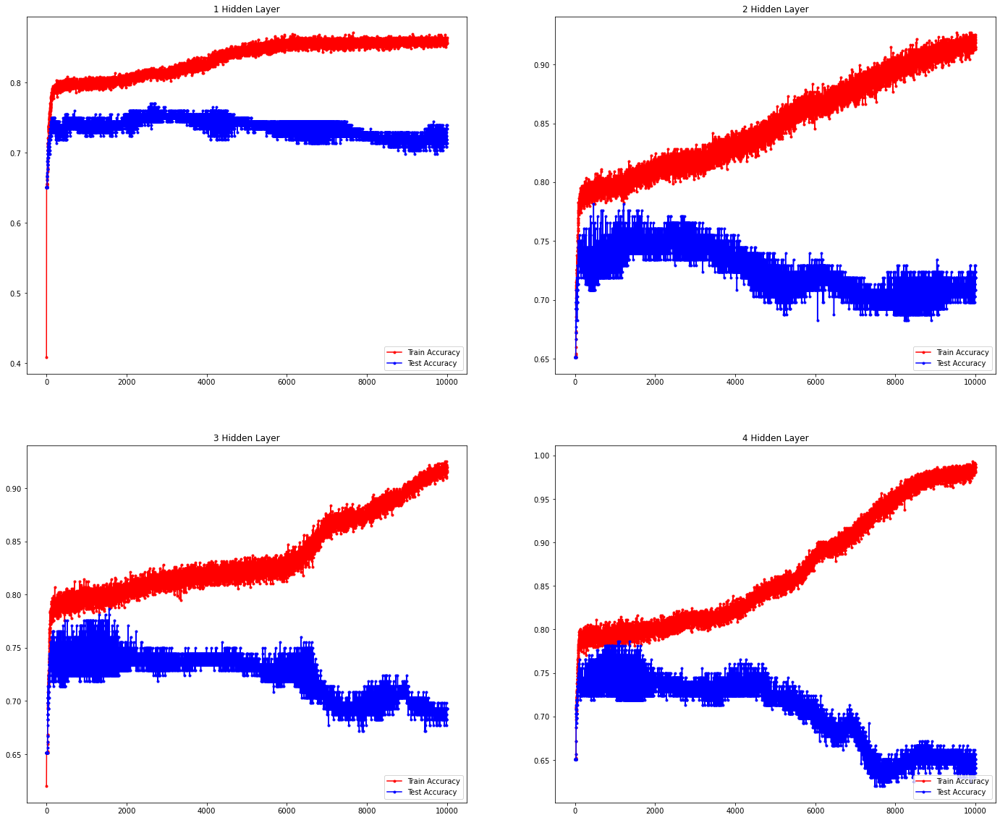

In [228]:
fig, axes = plt.subplots(2, 2, figsize=(24, 20))

for i in range (0, n_model):
    ax = plt.subplot(2, 2, i+1) 
    ax.plot(run_hist_rmsprop[i].history["accuracy"],'r', marker='.', label="Train Accuracy")
    ax.plot(run_hist_rmsprop[i].history["val_accuracy"],'b', marker='.', label="Test Accuracy")
    ax.legend(loc = 'lower right')
    title = str(i + 1) + ' Hidden Layer'
    ax.title.set_text(title)

In [229]:
print('Optimizer = RMSprop:\n')

for i in range (0, 4):
    print('Model [', i, '] (', str(i + 1), 'Hidden Layer(s)):')
    print(model_rmsprop[i].summary())
    print('\n')

Optimizer = RMSprop:

Model [ 0 ] ( 1 Hidden Layer(s)):
Model: "sequential_24"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_57 (Dense)             (None, 12)                108       
_________________________________________________________________
dense_58 (Dense)             (None, 1)                 13        
Total params: 121
Trainable params: 121
Non-trainable params: 0
_________________________________________________________________
None


Model [ 1 ] ( 2 Hidden Layer(s)):
Model: "sequential_25"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_59 (Dense)             (None, 12)                108       
_________________________________________________________________
dense_60 (Dense)             (None, 12)                156       
_________________________________________________________________
d

In [230]:
print('Optimizer = RMSprop:\n')

print('RMSprop Train Accuracy:')
for i in range (0, 4):
    print(str(i + 1), ' Hidden Layer: ', max(run_hist_rmsprop[i].history["accuracy"]))
print('\n')
print('RMSprop Test Accuracy:')
for i in range (0, 4):
    print(str(i + 1), ' Hidden Layer: ', max(run_hist_rmsprop[i].history["val_accuracy"]))

Optimizer = RMSprop:

RMSprop Train Accuracy:
1  Hidden Layer:  0.8715278
2  Hidden Layer:  0.9270833
3  Hidden Layer:  0.9253472
4  Hidden Layer:  0.9930556


RMSprop Test Accuracy:
1  Hidden Layer:  0.7708333
2  Hidden Layer:  0.78125
3  Hidden Layer:  0.7864583
4  Hidden Layer:  0.7864583


## 6. MODEL SUMMARY

In [277]:
pd_hist_mean_train = pd.DataFrame()

for i in range (0, n_model):
    pd_hist_mean_train.loc[i + 1, 'Adam'] = np.mean(run_hist_Adam[i].history["accuracy"])
    pd_hist_mean_train.loc[i + 1, 'SGD'] = np.mean(run_hist_SGD[i].history["accuracy"])
    pd_hist_mean_train.loc[i + 1, 'RMSprop'] = np.mean(run_hist_rmsprop[i].history["accuracy"])
    
pd_hist_mean_test = pd.DataFrame()

for i in range (0, n_model):
    pd_hist_mean_test.loc[i + 1, 'Adam'] = np.mean(run_hist_Adam[i].history["val_accuracy"])
    pd_hist_mean_test.loc[i + 1, 'SGD'] = np.mean(run_hist_SGD[i].history["val_accuracy"])
    pd_hist_mean_test.loc[i + 1 , 'RMSprop'] = np.mean(run_hist_rmsprop[i].history["val_accuracy"])

In [278]:
print('Mean Accuracy for Train Dataset:')
pd_hist_mean_train

Mean Accuracy for Train Dataset:


,Adam,SGD,RMSprop
1,0.827270,0.736129,0.833877
2,0.848484,0.709313,0.850149
3,0.878646,0.650618,0.836251
4,0.874230,0.651042,0.867688


In [279]:
print('Mean Accuracy for Test Dataset:')
pd_hist_mean_test

Mean Accuracy for Test Dataset:


,Adam,SGD,RMSprop
1,0.736247,0.710490,0.736125
2,0.722925,0.686009,0.723683
3,0.696694,0.650643,0.722700
4,0.719351,0.651042,0.703260


In [280]:
pd_hist_max_train = pd.DataFrame()

for i in range (0, n_model):
    pd_hist_max_train.loc[i + 1, 'Adam'] = np.max(run_hist_Adam[i].history["accuracy"])
    pd_hist_max_train.loc[i + 1, 'SGD'] = np.max(run_hist_SGD[i].history["accuracy"])
    pd_hist_max_train.loc[i + 1, 'RMSprop'] = np.max(run_hist_rmsprop[i].history["accuracy"])
    
pd_hist_max_test = pd.DataFrame()

for i in range (0, n_model):
    pd_hist_max_test.loc[i + 1, 'Adam'] = np.max(run_hist_Adam[i].history["val_accuracy"])
    pd_hist_max_test.loc[i + 1, 'SGD'] = np.max(run_hist_SGD[i].history["val_accuracy"])
    pd_hist_max_test.loc[i + 1, 'RMSprop'] = np.max(run_hist_rmsprop[i].history["val_accuracy"])

In [281]:
print('Max Accuracy for Train Dataset:')
pd_hist_max_train

Max Accuracy for Train Dataset:


,Adam,SGD,RMSprop
1,0.868056,0.786458,0.871528
2,0.928819,0.788194,0.927083
3,0.991319,0.651042,0.925347
4,0.991319,0.651042,0.993056


In [282]:
print('Max Accuracy for Test Dataset:')
pd_hist_max_test

Max Accuracy for Test Dataset:


,Adam,SGD,RMSprop
1,0.770833,0.744792,0.770833
2,0.770833,0.734375,0.781250
3,0.770833,0.651042,0.786458
4,0.765625,0.651042,0.786458
